In [3]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="0"
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"

In [4]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from sklearn import metrics
import matplotlib.pyplot as plt
import numpy as np
import cv2
import time
import math

In [3]:
from matplotlib.lines import Line2D      

def plot_grad_flow(named_parameters, epoch, loss, acc, savepath):
    '''Plots the gradients flowing through different layers in the net during training.
    Can be used for checking for possible gradient vanishing / exploding problems.
    
    Usage: Plug this function in Trainer class after loss.backwards() as 
    "plot_grad_flow(self.model.named_parameters())" to visualize the gradient flow'''
    ave_grads = []
    max_grads= []
    layers = []
    for n, p in named_parameters:
        if(p.requires_grad) and ("bias" not in n):

            try:
                ave_grads.append(p.grad.abs().mean())
                max_grads.append(p.grad.abs().max())
                layers.append(n)
            except:
                continue
#                 ave_grads.append(0.)
#                 max_grads.append(0.)
#                 layers.append(n)
                
    plt.figure(figsize=(10,10))
    plt.bar(np.arange(len(max_grads)), max_grads, alpha=0.5, lw=1, color="c")
    plt.bar(np.arange(len(max_grads)), ave_grads, alpha=0.5, lw=1, color="b")
    plt.hlines(0, 0, len(ave_grads)+1, lw=2, color="k" )
    plt.xticks(range(0,len(ave_grads), 1), layers, rotation="vertical")
    plt.xlim(left=0, right=len(ave_grads))
    plt.ylim(bottom = -0.001, top=0.02) # zoom in on the lower gradient regions
    plt.xlabel("Layers")
    plt.ylabel("average gradient")
    plt.title("Gradient flow | Epoch " + str(epoch) + " | ls: " + str(loss) + " | ac: " + str(acc))
    plt.tight_layout()
    plt.grid(True)
    plt.legend([Line2D([0], [0], color="c", lw=4),
                Line2D([0], [0], color="b", lw=4),
                Line2D([0], [0], color="k", lw=4)], ['max-gradient', 'mean-gradient', 'zero-gradient'])
    
    if not savepath is None:
        plt.savefig(savepath)
        
    plt.close()
    
    

In [4]:
import torch
from torchvision import transforms, datasets

train_data_transform = transforms.Compose([
        
#         transforms.Lambda(lbp_transform),
#         transforms.Lambda(combine_lbp_hog),
#         transforms.ToPILImage(),
        # transforms.RandomSizedCrop(224),
        transforms.RandomHorizontalFlip(),
#         transforms.RandomVerticalFlip(),
        transforms.RandomRotation(degrees=150),
        transforms.Grayscale(num_output_channels=1),
        transforms.ToTensor(),
        transforms.Normalize((0.5,), (0.5,))
    ])

test_data_transform = transforms.Compose([
        transforms.Grayscale(num_output_channels=1),
        transforms.ToTensor(),
        transforms.Normalize((0.5,), (0.5,))
    ])

train_fer = datasets.ImageFolder(root='/tf/data/Quan/fer2013/data/train', transform=train_data_transform)
val_fer = datasets.ImageFolder(root='/tf/data/Quan/fer2013/data/val', transform=test_data_transform)
test_fer = datasets.ImageFolder(root='/tf/data/Quan/fer2013/data/test', transform=test_data_transform)

batch_size = 64
train_loader = torch.utils.data.DataLoader(train_fer,
                                             batch_size=batch_size, shuffle=True,
                                             num_workers=8)
val_loader = torch.utils.data.DataLoader(val_fer,
                                             batch_size=batch_size, shuffle=True,
                                             num_workers=8)
test_loader = torch.utils.data.DataLoader(test_fer,
                                             batch_size=batch_size, shuffle=True,
                                             num_workers=8)

It seems like SVGG3 is the most optimal model. I think we would enhance the model more.
Starting from WeightedFeature layer, 

### SVGG 7

In [5]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [25]:
class WeightFeature(nn.Module):
    def __init__(self, feature_depth, target_depth):
        super(WeightFeature, self).__init__()

        self.target_depth = target_depth
        self.fc = nn.Linear(feature_depth*target_depth, target_depth)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x1, x2):
        x1_avg = nn.AvgPool2d(kernel_size=(x1.size(-2), x1.size(-1)))(x1)
        x1_avg = nn.Flatten()(x1_avg)
        x2_avg = nn.AvgPool2d(kernel_size=(x2.size(-2), x2.size(-1)))(x2)
        x2_avg = nn.Flatten()(x2_avg)
        
        cor = torch.matmul(x1_avg.unsqueeze(-1), x2_avg.unsqueeze(1)) # shape feature_depth x target_depth
        cor = nn.Flatten()(cor)
        cor = self.fc(cor)
        cor = self.sigmoid(cor)
        cor = cor.unsqueeze(-1).unsqueeze(-1)

        x_out = x2 * cor

        return x_out

In [26]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)

        self.wf1 = WeightFeature(64, 128).to(self.device)
        self.wf2 = WeightFeature(128, 256).to(self.device)
        self.wf3 = WeightFeature(256, 512).to(self.device)

        self.fc1 = nn.Linear(512, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)

        x1 = self.sv1(x0)
        x_wf1 = self.wf1(x0, x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x1, x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x2, x3)

        x_wf3 = nn.AvgPool2d(kernel_size=(x_wf3.size(-2), x_wf3.size(-1)))(x_wf3)
    
        x = nn.Flatten()(x_wf3)

        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [27]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-3)


cuda


Epoch:  1
	 - Step 1: loss: 2.215 acc: 0.156
	 - Step 2: loss: 2.335 acc: 0.172
	 - Step 3: loss: 2.361 acc: 0.156
	 - Step 4: loss: 2.277 acc: 0.219
	 - Step 5: loss: 2.232 acc: 0.125
	 - Step 6: loss: 2.252 acc: 0.203
	 - Step 7: loss: 2.049 acc: 0.203
	 - Step 8: loss: 1.919 acc: 0.234
	 - Step 9: loss: 2.011 acc: 0.188
	 - Step 10: loss: 2.013 acc: 0.188
	 - Step 11: loss: 1.958 acc: 0.266
	 - Step 12: loss: 2.201 acc: 0.047
	 - Step 13: loss: 2.043 acc: 0.234
	 - Step 14: loss: 2.155 acc: 0.250
	 - Step 15: loss: 1.925 acc: 0.250
	 - Step 16: loss: 1.917 acc: 0.250
	 - Step 17: loss: 2.036 acc: 0.250
	 - Step 18: loss: 1.877 acc: 0.312
	 - Step 19: loss: 2.002 acc: 0.172
	 - Step 20: loss: 1.829 acc: 0.266
	 - Step 21: loss: 1.894 acc: 0.156
	 - Step 22: loss: 2.006 acc: 0.344
	 - Step 23: loss: 2.066 acc: 0.203
	 - Step 24: loss: 1.794 acc: 0.375
	 - Step 25: loss: 1.919 acc: 0.250
	 - Step 26: loss: 1.872 acc: 0.219
	 - Step 27: loss: 1.948 acc: 0.203
	 - Step 28: loss: 1.868 ac

	 - Step 227: loss: 1.805 acc: 0.297
	 - Step 228: loss: 1.770 acc: 0.328
	 - Step 229: loss: 1.836 acc: 0.250
	 - Step 230: loss: 1.785 acc: 0.344
	 - Step 231: loss: 1.826 acc: 0.234
	 - Step 232: loss: 1.851 acc: 0.297
	 - Step 233: loss: 1.794 acc: 0.312
	 - Step 234: loss: 1.916 acc: 0.297
	 - Step 235: loss: 1.793 acc: 0.312
	 - Step 236: loss: 1.930 acc: 0.156
	 - Step 237: loss: 1.783 acc: 0.266
	 - Step 238: loss: 1.855 acc: 0.234
	 - Step 239: loss: 1.881 acc: 0.234
	 - Step 240: loss: 1.831 acc: 0.281
	 - Step 241: loss: 1.820 acc: 0.359
	 - Step 242: loss: 1.802 acc: 0.250
	 - Step 243: loss: 1.794 acc: 0.359
	 - Step 244: loss: 1.857 acc: 0.297
	 - Step 245: loss: 1.930 acc: 0.172
	 - Step 246: loss: 1.822 acc: 0.312
	 - Step 247: loss: 1.860 acc: 0.266
	 - Step 248: loss: 1.740 acc: 0.391
	 - Step 249: loss: 1.888 acc: 0.312
	 - Step 250: loss: 1.819 acc: 0.281
	 - Step 251: loss: 1.867 acc: 0.219
	 - Step 252: loss: 1.788 acc: 0.312
	 - Step 253: loss: 1.841 acc: 0.266
	

	 - Step 449: loss: 2.034 acc: 0.216
- Avg.loss: 1.871  | Avg.acc: 0.248
- Avg. val_loss: 1.868  | Avg. val_acc: 0.267


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type WeightFeature. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


* Update optimal model
Epoch:  2
	 - Step 1: loss: 1.913 acc: 0.219
	 - Step 2: loss: 1.883 acc: 0.234
	 - Step 3: loss: 1.816 acc: 0.234
	 - Step 4: loss: 1.785 acc: 0.344
	 - Step 5: loss: 1.702 acc: 0.406
	 - Step 6: loss: 1.833 acc: 0.234
	 - Step 7: loss: 1.824 acc: 0.297
	 - Step 8: loss: 1.791 acc: 0.328
	 - Step 9: loss: 1.819 acc: 0.234
	 - Step 10: loss: 1.852 acc: 0.234
	 - Step 11: loss: 1.822 acc: 0.328
	 - Step 12: loss: 1.768 acc: 0.281
	 - Step 13: loss: 1.857 acc: 0.203
	 - Step 14: loss: 1.778 acc: 0.266
	 - Step 15: loss: 1.778 acc: 0.344
	 - Step 16: loss: 1.837 acc: 0.281
	 - Step 17: loss: 1.738 acc: 0.406
	 - Step 18: loss: 1.760 acc: 0.312
	 - Step 19: loss: 1.878 acc: 0.219
	 - Step 20: loss: 1.877 acc: 0.234
	 - Step 21: loss: 1.798 acc: 0.281
	 - Step 22: loss: 1.905 acc: 0.234
	 - Step 23: loss: 1.846 acc: 0.156
	 - Step 24: loss: 1.870 acc: 0.203
	 - Step 25: loss: 1.821 acc: 0.250
	 - Step 26: loss: 1.788 acc: 0.266
	 - Step 27: loss: 1.785 acc: 0.297
	 - 

	 - Step 225: loss: 1.774 acc: 0.312
	 - Step 226: loss: 1.812 acc: 0.188
	 - Step 227: loss: 1.781 acc: 0.281
	 - Step 228: loss: 1.682 acc: 0.391
	 - Step 229: loss: 1.772 acc: 0.297
	 - Step 230: loss: 1.874 acc: 0.250
	 - Step 231: loss: 1.777 acc: 0.297
	 - Step 232: loss: 1.816 acc: 0.203
	 - Step 233: loss: 1.787 acc: 0.250
	 - Step 234: loss: 1.846 acc: 0.250
	 - Step 235: loss: 1.842 acc: 0.203
	 - Step 236: loss: 1.847 acc: 0.250
	 - Step 237: loss: 1.742 acc: 0.344
	 - Step 238: loss: 1.802 acc: 0.266
	 - Step 239: loss: 1.835 acc: 0.234
	 - Step 240: loss: 1.727 acc: 0.344
	 - Step 241: loss: 1.760 acc: 0.250
	 - Step 242: loss: 1.783 acc: 0.281
	 - Step 243: loss: 1.794 acc: 0.297
	 - Step 244: loss: 1.758 acc: 0.297
	 - Step 245: loss: 1.773 acc: 0.297
	 - Step 246: loss: 1.738 acc: 0.359
	 - Step 247: loss: 1.848 acc: 0.219
	 - Step 248: loss: 1.801 acc: 0.203
	 - Step 249: loss: 1.828 acc: 0.266
	 - Step 250: loss: 1.744 acc: 0.297
	 - Step 251: loss: 1.788 acc: 0.250
	

	 - Step 447: loss: 1.691 acc: 0.422
	 - Step 448: loss: 1.659 acc: 0.359
	 - Step 449: loss: 1.591 acc: 0.432
- Avg.loss: 1.777  | Avg.acc: 0.290
- Avg. val_loss: 1.830  | Avg. val_acc: 0.265
Epoch:  3
	 - Step 1: loss: 1.876 acc: 0.234
	 - Step 2: loss: 1.704 acc: 0.297
	 - Step 3: loss: 1.816 acc: 0.312
	 - Step 4: loss: 1.713 acc: 0.266
	 - Step 5: loss: 1.702 acc: 0.297
	 - Step 6: loss: 1.731 acc: 0.328
	 - Step 7: loss: 1.767 acc: 0.344
	 - Step 8: loss: 1.760 acc: 0.297
	 - Step 9: loss: 1.724 acc: 0.344
	 - Step 10: loss: 1.678 acc: 0.391
	 - Step 11: loss: 1.716 acc: 0.281
	 - Step 12: loss: 1.719 acc: 0.281
	 - Step 13: loss: 1.804 acc: 0.281
	 - Step 14: loss: 1.625 acc: 0.344
	 - Step 15: loss: 1.703 acc: 0.391
	 - Step 16: loss: 1.832 acc: 0.312
	 - Step 17: loss: 1.559 acc: 0.453
	 - Step 18: loss: 1.591 acc: 0.422
	 - Step 19: loss: 1.717 acc: 0.328
	 - Step 20: loss: 1.704 acc: 0.375
	 - Step 21: loss: 1.679 acc: 0.312
	 - Step 22: loss: 1.751 acc: 0.250
	 - Step 23: l

	 - Step 221: loss: 1.787 acc: 0.297
	 - Step 222: loss: 1.608 acc: 0.406
	 - Step 223: loss: 1.864 acc: 0.219
	 - Step 224: loss: 1.590 acc: 0.422
	 - Step 225: loss: 1.841 acc: 0.219
	 - Step 226: loss: 1.572 acc: 0.422
	 - Step 227: loss: 1.798 acc: 0.328
	 - Step 228: loss: 1.679 acc: 0.328
	 - Step 229: loss: 1.716 acc: 0.312
	 - Step 230: loss: 1.733 acc: 0.219
	 - Step 231: loss: 1.720 acc: 0.234
	 - Step 232: loss: 1.667 acc: 0.375
	 - Step 233: loss: 1.675 acc: 0.344
	 - Step 234: loss: 1.640 acc: 0.375
	 - Step 235: loss: 1.582 acc: 0.391
	 - Step 236: loss: 1.758 acc: 0.328
	 - Step 237: loss: 1.698 acc: 0.297
	 - Step 238: loss: 1.583 acc: 0.359
	 - Step 239: loss: 1.636 acc: 0.453
	 - Step 240: loss: 1.639 acc: 0.344
	 - Step 241: loss: 1.635 acc: 0.359
	 - Step 242: loss: 1.748 acc: 0.312
	 - Step 243: loss: 1.766 acc: 0.250
	 - Step 244: loss: 1.673 acc: 0.281
	 - Step 245: loss: 1.723 acc: 0.359
	 - Step 246: loss: 1.722 acc: 0.344
	 - Step 247: loss: 1.564 acc: 0.344
	

	 - Step 443: loss: 1.797 acc: 0.266
	 - Step 444: loss: 1.761 acc: 0.328
	 - Step 445: loss: 1.600 acc: 0.391
	 - Step 446: loss: 1.586 acc: 0.438
	 - Step 447: loss: 1.756 acc: 0.375
	 - Step 448: loss: 1.430 acc: 0.516
	 - Step 449: loss: 1.708 acc: 0.297
- Avg.loss: 1.692  | Avg.acc: 0.332
- Avg. val_loss: 1.872  | Avg. val_acc: 0.226
Epoch:  4
	 - Step 1: loss: 1.626 acc: 0.359
	 - Step 2: loss: 1.592 acc: 0.359
	 - Step 3: loss: 1.616 acc: 0.328
	 - Step 4: loss: 1.510 acc: 0.391
	 - Step 5: loss: 1.451 acc: 0.484
	 - Step 6: loss: 1.646 acc: 0.375
	 - Step 7: loss: 1.616 acc: 0.375
	 - Step 8: loss: 1.775 acc: 0.297
	 - Step 9: loss: 1.538 acc: 0.453
	 - Step 10: loss: 1.828 acc: 0.234
	 - Step 11: loss: 1.624 acc: 0.391
	 - Step 12: loss: 1.928 acc: 0.203
	 - Step 13: loss: 1.835 acc: 0.234
	 - Step 14: loss: 1.627 acc: 0.328
	 - Step 15: loss: 1.836 acc: 0.203
	 - Step 16: loss: 1.687 acc: 0.344
	 - Step 17: loss: 1.607 acc: 0.359
	 - Step 18: loss: 1.734 acc: 0.250
	 - Step 1

	 - Step 217: loss: 1.583 acc: 0.375
	 - Step 218: loss: 1.676 acc: 0.281
	 - Step 219: loss: 1.715 acc: 0.344
	 - Step 220: loss: 1.748 acc: 0.266
	 - Step 221: loss: 1.673 acc: 0.391
	 - Step 222: loss: 1.553 acc: 0.328
	 - Step 223: loss: 1.678 acc: 0.312
	 - Step 224: loss: 1.598 acc: 0.406
	 - Step 225: loss: 1.606 acc: 0.328
	 - Step 226: loss: 1.753 acc: 0.328
	 - Step 227: loss: 1.486 acc: 0.453
	 - Step 228: loss: 1.605 acc: 0.328
	 - Step 229: loss: 1.719 acc: 0.359
	 - Step 230: loss: 1.593 acc: 0.391
	 - Step 231: loss: 1.642 acc: 0.266
	 - Step 232: loss: 1.690 acc: 0.359
	 - Step 233: loss: 1.754 acc: 0.281
	 - Step 234: loss: 1.717 acc: 0.266
	 - Step 235: loss: 1.548 acc: 0.375
	 - Step 236: loss: 1.547 acc: 0.312
	 - Step 237: loss: 1.570 acc: 0.344
	 - Step 238: loss: 1.648 acc: 0.406
	 - Step 239: loss: 1.586 acc: 0.391
	 - Step 240: loss: 1.741 acc: 0.312
	 - Step 241: loss: 1.649 acc: 0.391
	 - Step 242: loss: 1.639 acc: 0.344
	 - Step 243: loss: 1.449 acc: 0.469
	

	 - Step 439: loss: 1.562 acc: 0.391
	 - Step 440: loss: 1.720 acc: 0.328
	 - Step 441: loss: 1.707 acc: 0.328
	 - Step 442: loss: 1.857 acc: 0.219
	 - Step 443: loss: 1.659 acc: 0.328
	 - Step 444: loss: 1.661 acc: 0.359
	 - Step 445: loss: 1.594 acc: 0.359
	 - Step 446: loss: 1.666 acc: 0.281
	 - Step 447: loss: 1.637 acc: 0.328
	 - Step 448: loss: 1.579 acc: 0.359
	 - Step 449: loss: 1.614 acc: 0.351
- Avg.loss: 1.644  | Avg.acc: 0.348
- Avg. val_loss: 1.722  | Avg. val_acc: 0.330
* Update optimal model
Epoch:  5
	 - Step 1: loss: 1.528 acc: 0.406
	 - Step 2: loss: 1.628 acc: 0.312
	 - Step 3: loss: 1.579 acc: 0.266
	 - Step 4: loss: 1.575 acc: 0.375
	 - Step 5: loss: 1.665 acc: 0.359
	 - Step 6: loss: 1.597 acc: 0.422
	 - Step 7: loss: 1.752 acc: 0.328
	 - Step 8: loss: 1.734 acc: 0.344
	 - Step 9: loss: 1.653 acc: 0.375
	 - Step 10: loss: 1.610 acc: 0.359
	 - Step 11: loss: 1.614 acc: 0.391
	 - Step 12: loss: 1.454 acc: 0.422
	 - Step 13: loss: 1.579 acc: 0.422
	 - Step 14: loss: 

	 - Step 213: loss: 1.554 acc: 0.422
	 - Step 214: loss: 1.558 acc: 0.453
	 - Step 215: loss: 1.661 acc: 0.297
	 - Step 216: loss: 1.851 acc: 0.188
	 - Step 217: loss: 1.621 acc: 0.344
	 - Step 218: loss: 1.595 acc: 0.328
	 - Step 219: loss: 1.701 acc: 0.328
	 - Step 220: loss: 1.610 acc: 0.312
	 - Step 221: loss: 1.639 acc: 0.359
	 - Step 222: loss: 1.489 acc: 0.438
	 - Step 223: loss: 1.858 acc: 0.281
	 - Step 224: loss: 1.634 acc: 0.359
	 - Step 225: loss: 1.735 acc: 0.266
	 - Step 226: loss: 1.521 acc: 0.469
	 - Step 227: loss: 1.448 acc: 0.453
	 - Step 228: loss: 1.539 acc: 0.406
	 - Step 229: loss: 1.744 acc: 0.312
	 - Step 230: loss: 1.568 acc: 0.328
	 - Step 231: loss: 1.561 acc: 0.375
	 - Step 232: loss: 1.662 acc: 0.469
	 - Step 233: loss: 1.594 acc: 0.328
	 - Step 234: loss: 1.683 acc: 0.297
	 - Step 235: loss: 1.683 acc: 0.312
	 - Step 236: loss: 1.682 acc: 0.328
	 - Step 237: loss: 1.510 acc: 0.359
	 - Step 238: loss: 1.452 acc: 0.484
	 - Step 239: loss: 1.637 acc: 0.406
	

	 - Step 435: loss: 1.565 acc: 0.422
	 - Step 436: loss: 1.579 acc: 0.406
	 - Step 437: loss: 1.683 acc: 0.234
	 - Step 438: loss: 1.661 acc: 0.344
	 - Step 439: loss: 1.648 acc: 0.359
	 - Step 440: loss: 1.585 acc: 0.312
	 - Step 441: loss: 1.608 acc: 0.375
	 - Step 442: loss: 1.690 acc: 0.406
	 - Step 443: loss: 1.585 acc: 0.359
	 - Step 444: loss: 1.734 acc: 0.297
	 - Step 445: loss: 1.572 acc: 0.359
	 - Step 446: loss: 1.653 acc: 0.344
	 - Step 447: loss: 1.645 acc: 0.328
	 - Step 448: loss: 1.531 acc: 0.375
	 - Step 449: loss: 1.483 acc: 0.378
- Avg.loss: 1.614  | Avg.acc: 0.365
- Avg. val_loss: 1.685  | Avg. val_acc: 0.336
* Update optimal model
Epoch:  6
	 - Step 1: loss: 1.422 acc: 0.406
	 - Step 2: loss: 1.782 acc: 0.328
	 - Step 3: loss: 1.487 acc: 0.406
	 - Step 4: loss: 1.527 acc: 0.375
	 - Step 5: loss: 1.490 acc: 0.375
	 - Step 6: loss: 1.768 acc: 0.203
	 - Step 7: loss: 1.551 acc: 0.438
	 - Step 8: loss: 1.650 acc: 0.359
	 - Step 9: loss: 1.560 acc: 0.391
	 - Step 10: lo

	 - Step 209: loss: 1.374 acc: 0.516
	 - Step 210: loss: 1.704 acc: 0.312
	 - Step 211: loss: 1.513 acc: 0.422
	 - Step 212: loss: 1.502 acc: 0.469
	 - Step 213: loss: 1.637 acc: 0.344
	 - Step 214: loss: 1.526 acc: 0.375
	 - Step 215: loss: 1.498 acc: 0.422
	 - Step 216: loss: 1.556 acc: 0.391
	 - Step 217: loss: 1.441 acc: 0.484
	 - Step 218: loss: 1.546 acc: 0.328
	 - Step 219: loss: 1.406 acc: 0.453
	 - Step 220: loss: 1.525 acc: 0.391
	 - Step 221: loss: 1.765 acc: 0.266
	 - Step 222: loss: 1.684 acc: 0.391
	 - Step 223: loss: 1.491 acc: 0.391
	 - Step 224: loss: 1.605 acc: 0.375
	 - Step 225: loss: 1.449 acc: 0.469
	 - Step 226: loss: 1.562 acc: 0.344
	 - Step 227: loss: 1.482 acc: 0.359
	 - Step 228: loss: 1.497 acc: 0.484
	 - Step 229: loss: 1.583 acc: 0.359
	 - Step 230: loss: 1.556 acc: 0.391
	 - Step 231: loss: 1.440 acc: 0.422
	 - Step 232: loss: 1.532 acc: 0.406
	 - Step 233: loss: 1.519 acc: 0.391
	 - Step 234: loss: 1.553 acc: 0.359
	 - Step 235: loss: 1.639 acc: 0.375
	

	 - Step 431: loss: 1.786 acc: 0.234
	 - Step 432: loss: 1.768 acc: 0.266
	 - Step 433: loss: 1.555 acc: 0.422
	 - Step 434: loss: 1.525 acc: 0.453
	 - Step 435: loss: 1.571 acc: 0.406
	 - Step 436: loss: 1.527 acc: 0.391
	 - Step 437: loss: 1.475 acc: 0.406
	 - Step 438: loss: 1.620 acc: 0.359
	 - Step 439: loss: 1.435 acc: 0.422
	 - Step 440: loss: 1.487 acc: 0.422
	 - Step 441: loss: 1.508 acc: 0.297
	 - Step 442: loss: 1.400 acc: 0.484
	 - Step 443: loss: 1.708 acc: 0.344
	 - Step 444: loss: 1.522 acc: 0.328
	 - Step 445: loss: 1.556 acc: 0.312
	 - Step 446: loss: 1.515 acc: 0.406
	 - Step 447: loss: 1.547 acc: 0.328
	 - Step 448: loss: 1.544 acc: 0.359
	 - Step 449: loss: 1.444 acc: 0.486
- Avg.loss: 1.570  | Avg.acc: 0.384
- Avg. val_loss: 1.597  | Avg. val_acc: 0.382
* Update optimal model
Epoch:  7
	 - Step 1: loss: 1.497 acc: 0.484
	 - Step 2: loss: 1.619 acc: 0.359
	 - Step 3: loss: 1.564 acc: 0.453
	 - Step 4: loss: 1.374 acc: 0.547
	 - Step 5: loss: 1.482 acc: 0.422
	 - Ste

	 - Step 205: loss: 1.574 acc: 0.375
	 - Step 206: loss: 1.580 acc: 0.359
	 - Step 207: loss: 1.635 acc: 0.391
	 - Step 208: loss: 1.598 acc: 0.344
	 - Step 209: loss: 1.491 acc: 0.422
	 - Step 210: loss: 1.478 acc: 0.438
	 - Step 211: loss: 1.460 acc: 0.516
	 - Step 212: loss: 1.563 acc: 0.406
	 - Step 213: loss: 1.376 acc: 0.469
	 - Step 214: loss: 1.558 acc: 0.438
	 - Step 215: loss: 1.594 acc: 0.406
	 - Step 216: loss: 1.483 acc: 0.484
	 - Step 217: loss: 1.630 acc: 0.359
	 - Step 218: loss: 1.595 acc: 0.375
	 - Step 219: loss: 1.482 acc: 0.469
	 - Step 220: loss: 1.582 acc: 0.406
	 - Step 221: loss: 1.562 acc: 0.375
	 - Step 222: loss: 1.470 acc: 0.406
	 - Step 223: loss: 1.532 acc: 0.406
	 - Step 224: loss: 1.479 acc: 0.438
	 - Step 225: loss: 1.452 acc: 0.375
	 - Step 226: loss: 1.466 acc: 0.359
	 - Step 227: loss: 1.310 acc: 0.469
	 - Step 228: loss: 1.360 acc: 0.547
	 - Step 229: loss: 1.640 acc: 0.391
	 - Step 230: loss: 1.493 acc: 0.406
	 - Step 231: loss: 1.458 acc: 0.453
	

	 - Step 427: loss: 1.439 acc: 0.422
	 - Step 428: loss: 1.431 acc: 0.453
	 - Step 429: loss: 1.501 acc: 0.438
	 - Step 430: loss: 1.463 acc: 0.547
	 - Step 431: loss: 1.536 acc: 0.453
	 - Step 432: loss: 1.505 acc: 0.406
	 - Step 433: loss: 1.483 acc: 0.406
	 - Step 434: loss: 1.540 acc: 0.375
	 - Step 435: loss: 1.619 acc: 0.391
	 - Step 436: loss: 1.512 acc: 0.422
	 - Step 437: loss: 1.456 acc: 0.406
	 - Step 438: loss: 1.483 acc: 0.328
	 - Step 439: loss: 1.471 acc: 0.469
	 - Step 440: loss: 1.474 acc: 0.438
	 - Step 441: loss: 1.428 acc: 0.422
	 - Step 442: loss: 1.424 acc: 0.469
	 - Step 443: loss: 1.534 acc: 0.359
	 - Step 444: loss: 1.601 acc: 0.391
	 - Step 445: loss: 1.417 acc: 0.484
	 - Step 446: loss: 1.640 acc: 0.359
	 - Step 447: loss: 1.328 acc: 0.531
	 - Step 448: loss: 1.351 acc: 0.531
	 - Step 449: loss: 1.489 acc: 0.324
- Avg.loss: 1.519  | Avg.acc: 0.413
- Avg. val_loss: 1.595  | Avg. val_acc: 0.396
* Update optimal model
Epoch:  8
	 - Step 1: loss: 1.458 acc: 0.438

	 - Step 201: loss: 1.584 acc: 0.375
	 - Step 202: loss: 1.424 acc: 0.500
	 - Step 203: loss: 1.402 acc: 0.438
	 - Step 204: loss: 1.504 acc: 0.422
	 - Step 205: loss: 1.333 acc: 0.469
	 - Step 206: loss: 1.509 acc: 0.391
	 - Step 207: loss: 1.679 acc: 0.344
	 - Step 208: loss: 1.537 acc: 0.391
	 - Step 209: loss: 1.253 acc: 0.516
	 - Step 210: loss: 1.383 acc: 0.438
	 - Step 211: loss: 1.584 acc: 0.359
	 - Step 212: loss: 1.468 acc: 0.406
	 - Step 213: loss: 1.420 acc: 0.500
	 - Step 214: loss: 1.529 acc: 0.422
	 - Step 215: loss: 1.445 acc: 0.438
	 - Step 216: loss: 1.555 acc: 0.391
	 - Step 217: loss: 1.507 acc: 0.406
	 - Step 218: loss: 1.474 acc: 0.391
	 - Step 219: loss: 1.340 acc: 0.453
	 - Step 220: loss: 1.447 acc: 0.500
	 - Step 221: loss: 1.413 acc: 0.516
	 - Step 222: loss: 1.499 acc: 0.375
	 - Step 223: loss: 1.464 acc: 0.438
	 - Step 224: loss: 1.597 acc: 0.328
	 - Step 225: loss: 1.527 acc: 0.406
	 - Step 226: loss: 1.478 acc: 0.438
	 - Step 227: loss: 1.424 acc: 0.438
	

	 - Step 423: loss: 1.400 acc: 0.531
	 - Step 424: loss: 1.421 acc: 0.422
	 - Step 425: loss: 1.482 acc: 0.453
	 - Step 426: loss: 1.383 acc: 0.406
	 - Step 427: loss: 1.500 acc: 0.359
	 - Step 428: loss: 1.486 acc: 0.406
	 - Step 429: loss: 1.337 acc: 0.453
	 - Step 430: loss: 1.349 acc: 0.516
	 - Step 431: loss: 1.522 acc: 0.391
	 - Step 432: loss: 1.474 acc: 0.406
	 - Step 433: loss: 1.489 acc: 0.453
	 - Step 434: loss: 1.675 acc: 0.344
	 - Step 435: loss: 1.542 acc: 0.406
	 - Step 436: loss: 1.488 acc: 0.453
	 - Step 437: loss: 1.574 acc: 0.453
	 - Step 438: loss: 1.650 acc: 0.328
	 - Step 439: loss: 1.394 acc: 0.484
	 - Step 440: loss: 1.516 acc: 0.422
	 - Step 441: loss: 1.520 acc: 0.422
	 - Step 442: loss: 1.471 acc: 0.422
	 - Step 443: loss: 1.441 acc: 0.391
	 - Step 444: loss: 1.484 acc: 0.359
	 - Step 445: loss: 1.637 acc: 0.359
	 - Step 446: loss: 1.643 acc: 0.422
	 - Step 447: loss: 1.525 acc: 0.391
	 - Step 448: loss: 1.469 acc: 0.453
	 - Step 449: loss: 1.495 acc: 0.432
-

	 - Step 197: loss: 1.424 acc: 0.469
	 - Step 198: loss: 1.389 acc: 0.422
	 - Step 199: loss: 1.391 acc: 0.469
	 - Step 200: loss: 1.477 acc: 0.438
	 - Step 201: loss: 1.372 acc: 0.453
	 - Step 202: loss: 1.405 acc: 0.531
	 - Step 203: loss: 1.499 acc: 0.375
	 - Step 204: loss: 1.419 acc: 0.469
	 - Step 205: loss: 1.355 acc: 0.500
	 - Step 206: loss: 1.475 acc: 0.469
	 - Step 207: loss: 1.232 acc: 0.516
	 - Step 208: loss: 1.402 acc: 0.438
	 - Step 209: loss: 1.571 acc: 0.453
	 - Step 210: loss: 1.289 acc: 0.484
	 - Step 211: loss: 1.414 acc: 0.469
	 - Step 212: loss: 1.385 acc: 0.406
	 - Step 213: loss: 1.381 acc: 0.469
	 - Step 214: loss: 1.346 acc: 0.500
	 - Step 215: loss: 1.455 acc: 0.469
	 - Step 216: loss: 1.775 acc: 0.344
	 - Step 217: loss: 1.438 acc: 0.438
	 - Step 218: loss: 1.505 acc: 0.391
	 - Step 219: loss: 1.410 acc: 0.438
	 - Step 220: loss: 1.365 acc: 0.516
	 - Step 221: loss: 1.385 acc: 0.422
	 - Step 222: loss: 1.396 acc: 0.438
	 - Step 223: loss: 1.639 acc: 0.406
	

	 - Step 419: loss: 1.485 acc: 0.500
	 - Step 420: loss: 1.460 acc: 0.484
	 - Step 421: loss: 1.453 acc: 0.531
	 - Step 422: loss: 1.427 acc: 0.406
	 - Step 423: loss: 1.362 acc: 0.484
	 - Step 424: loss: 1.362 acc: 0.453
	 - Step 425: loss: 1.217 acc: 0.469
	 - Step 426: loss: 1.295 acc: 0.578
	 - Step 427: loss: 1.502 acc: 0.359
	 - Step 428: loss: 1.375 acc: 0.453
	 - Step 429: loss: 1.376 acc: 0.469
	 - Step 430: loss: 1.478 acc: 0.453
	 - Step 431: loss: 1.423 acc: 0.359
	 - Step 432: loss: 1.584 acc: 0.375
	 - Step 433: loss: 1.315 acc: 0.516
	 - Step 434: loss: 1.336 acc: 0.547
	 - Step 435: loss: 1.317 acc: 0.500
	 - Step 436: loss: 1.476 acc: 0.453
	 - Step 437: loss: 1.641 acc: 0.328
	 - Step 438: loss: 1.160 acc: 0.609
	 - Step 439: loss: 1.689 acc: 0.297
	 - Step 440: loss: 1.257 acc: 0.484
	 - Step 441: loss: 1.552 acc: 0.359
	 - Step 442: loss: 1.259 acc: 0.406
	 - Step 443: loss: 1.368 acc: 0.453
	 - Step 444: loss: 1.410 acc: 0.453
	 - Step 445: loss: 1.526 acc: 0.359
	

	 - Step 193: loss: 1.419 acc: 0.391
	 - Step 194: loss: 1.422 acc: 0.453
	 - Step 195: loss: 1.551 acc: 0.297
	 - Step 196: loss: 1.531 acc: 0.438
	 - Step 197: loss: 1.411 acc: 0.438
	 - Step 198: loss: 1.520 acc: 0.391
	 - Step 199: loss: 1.674 acc: 0.359
	 - Step 200: loss: 1.421 acc: 0.438
	 - Step 201: loss: 1.608 acc: 0.359
	 - Step 202: loss: 1.466 acc: 0.391
	 - Step 203: loss: 1.406 acc: 0.453
	 - Step 204: loss: 1.487 acc: 0.406
	 - Step 205: loss: 1.551 acc: 0.453
	 - Step 206: loss: 1.407 acc: 0.500
	 - Step 207: loss: 1.434 acc: 0.406
	 - Step 208: loss: 1.290 acc: 0.516
	 - Step 209: loss: 1.314 acc: 0.500
	 - Step 210: loss: 1.401 acc: 0.406
	 - Step 211: loss: 1.562 acc: 0.359
	 - Step 212: loss: 1.370 acc: 0.438
	 - Step 213: loss: 1.407 acc: 0.438
	 - Step 214: loss: 1.467 acc: 0.359
	 - Step 215: loss: 1.271 acc: 0.547
	 - Step 216: loss: 1.323 acc: 0.531
	 - Step 217: loss: 1.567 acc: 0.391
	 - Step 218: loss: 1.255 acc: 0.547
	 - Step 219: loss: 1.426 acc: 0.438
	

	 - Step 415: loss: 1.529 acc: 0.359
	 - Step 416: loss: 1.575 acc: 0.422
	 - Step 417: loss: 1.336 acc: 0.422
	 - Step 418: loss: 1.342 acc: 0.484
	 - Step 419: loss: 1.342 acc: 0.484
	 - Step 420: loss: 1.434 acc: 0.406
	 - Step 421: loss: 1.514 acc: 0.484
	 - Step 422: loss: 1.364 acc: 0.516
	 - Step 423: loss: 1.404 acc: 0.406
	 - Step 424: loss: 1.372 acc: 0.438
	 - Step 425: loss: 1.361 acc: 0.453
	 - Step 426: loss: 1.465 acc: 0.438
	 - Step 427: loss: 1.622 acc: 0.359
	 - Step 428: loss: 1.515 acc: 0.438
	 - Step 429: loss: 1.210 acc: 0.562
	 - Step 430: loss: 1.423 acc: 0.547
	 - Step 431: loss: 1.480 acc: 0.438
	 - Step 432: loss: 1.476 acc: 0.344
	 - Step 433: loss: 1.298 acc: 0.469
	 - Step 434: loss: 1.320 acc: 0.500
	 - Step 435: loss: 1.290 acc: 0.500
	 - Step 436: loss: 1.275 acc: 0.484
	 - Step 437: loss: 1.506 acc: 0.375
	 - Step 438: loss: 1.272 acc: 0.500
	 - Step 439: loss: 1.511 acc: 0.328
	 - Step 440: loss: 1.345 acc: 0.547
	 - Step 441: loss: 1.368 acc: 0.484
	

	 - Step 189: loss: 1.303 acc: 0.469
	 - Step 190: loss: 1.471 acc: 0.453
	 - Step 191: loss: 1.440 acc: 0.391
	 - Step 192: loss: 1.545 acc: 0.344
	 - Step 193: loss: 1.334 acc: 0.500
	 - Step 194: loss: 1.547 acc: 0.359
	 - Step 195: loss: 1.325 acc: 0.516
	 - Step 196: loss: 1.454 acc: 0.422
	 - Step 197: loss: 1.541 acc: 0.375
	 - Step 198: loss: 1.625 acc: 0.391
	 - Step 199: loss: 1.553 acc: 0.453
	 - Step 200: loss: 1.323 acc: 0.469
	 - Step 201: loss: 1.396 acc: 0.469
	 - Step 202: loss: 1.346 acc: 0.531
	 - Step 203: loss: 1.575 acc: 0.344
	 - Step 204: loss: 1.256 acc: 0.594
	 - Step 205: loss: 1.333 acc: 0.547
	 - Step 206: loss: 1.313 acc: 0.422
	 - Step 207: loss: 1.176 acc: 0.531
	 - Step 208: loss: 1.389 acc: 0.484
	 - Step 209: loss: 1.324 acc: 0.562
	 - Step 210: loss: 1.346 acc: 0.453
	 - Step 211: loss: 1.572 acc: 0.328
	 - Step 212: loss: 1.305 acc: 0.500
	 - Step 213: loss: 1.406 acc: 0.484
	 - Step 214: loss: 1.161 acc: 0.578
	 - Step 215: loss: 1.490 acc: 0.438
	

	 - Step 411: loss: 1.354 acc: 0.453
	 - Step 412: loss: 1.350 acc: 0.391
	 - Step 413: loss: 1.218 acc: 0.547
	 - Step 414: loss: 1.505 acc: 0.359
	 - Step 415: loss: 1.304 acc: 0.516
	 - Step 416: loss: 1.488 acc: 0.359
	 - Step 417: loss: 1.497 acc: 0.375
	 - Step 418: loss: 1.211 acc: 0.578
	 - Step 419: loss: 1.303 acc: 0.484
	 - Step 420: loss: 1.530 acc: 0.344
	 - Step 421: loss: 1.457 acc: 0.406
	 - Step 422: loss: 1.272 acc: 0.453
	 - Step 423: loss: 1.297 acc: 0.484
	 - Step 424: loss: 1.205 acc: 0.641
	 - Step 425: loss: 1.294 acc: 0.469
	 - Step 426: loss: 1.533 acc: 0.438
	 - Step 427: loss: 1.412 acc: 0.500
	 - Step 428: loss: 1.448 acc: 0.422
	 - Step 429: loss: 1.297 acc: 0.469
	 - Step 430: loss: 1.398 acc: 0.391
	 - Step 431: loss: 1.397 acc: 0.344
	 - Step 432: loss: 1.218 acc: 0.531
	 - Step 433: loss: 1.191 acc: 0.516
	 - Step 434: loss: 1.612 acc: 0.328
	 - Step 435: loss: 1.479 acc: 0.469
	 - Step 436: loss: 1.477 acc: 0.391
	 - Step 437: loss: 1.239 acc: 0.531
	

	 - Step 185: loss: 1.216 acc: 0.547
	 - Step 186: loss: 1.389 acc: 0.438
	 - Step 187: loss: 1.251 acc: 0.500
	 - Step 188: loss: 1.546 acc: 0.453
	 - Step 189: loss: 1.334 acc: 0.438
	 - Step 190: loss: 1.206 acc: 0.516
	 - Step 191: loss: 1.270 acc: 0.578
	 - Step 192: loss: 1.330 acc: 0.516
	 - Step 193: loss: 1.307 acc: 0.438
	 - Step 194: loss: 1.527 acc: 0.453
	 - Step 195: loss: 1.322 acc: 0.531
	 - Step 196: loss: 1.494 acc: 0.375
	 - Step 197: loss: 1.334 acc: 0.469
	 - Step 198: loss: 1.553 acc: 0.453
	 - Step 199: loss: 1.352 acc: 0.484
	 - Step 200: loss: 1.320 acc: 0.453
	 - Step 201: loss: 1.496 acc: 0.484
	 - Step 202: loss: 1.364 acc: 0.453
	 - Step 203: loss: 1.406 acc: 0.500
	 - Step 204: loss: 1.424 acc: 0.438
	 - Step 205: loss: 1.474 acc: 0.438
	 - Step 206: loss: 1.321 acc: 0.469
	 - Step 207: loss: 1.373 acc: 0.500
	 - Step 208: loss: 1.267 acc: 0.469
	 - Step 209: loss: 1.452 acc: 0.328
	 - Step 210: loss: 1.391 acc: 0.484
	 - Step 211: loss: 1.455 acc: 0.391
	

	 - Step 407: loss: 1.362 acc: 0.453
	 - Step 408: loss: 1.393 acc: 0.453
	 - Step 409: loss: 1.297 acc: 0.406
	 - Step 410: loss: 1.441 acc: 0.375
	 - Step 411: loss: 1.331 acc: 0.484
	 - Step 412: loss: 1.270 acc: 0.531
	 - Step 413: loss: 1.288 acc: 0.547
	 - Step 414: loss: 1.458 acc: 0.406
	 - Step 415: loss: 1.211 acc: 0.625
	 - Step 416: loss: 1.458 acc: 0.422
	 - Step 417: loss: 1.505 acc: 0.484
	 - Step 418: loss: 1.410 acc: 0.453
	 - Step 419: loss: 1.310 acc: 0.516
	 - Step 420: loss: 1.371 acc: 0.531
	 - Step 421: loss: 1.448 acc: 0.453
	 - Step 422: loss: 1.416 acc: 0.438
	 - Step 423: loss: 1.271 acc: 0.500
	 - Step 424: loss: 1.266 acc: 0.516
	 - Step 425: loss: 1.452 acc: 0.406
	 - Step 426: loss: 1.350 acc: 0.547
	 - Step 427: loss: 1.279 acc: 0.531
	 - Step 428: loss: 1.433 acc: 0.406
	 - Step 429: loss: 1.485 acc: 0.438
	 - Step 430: loss: 1.302 acc: 0.516
	 - Step 431: loss: 1.278 acc: 0.531
	 - Step 432: loss: 1.494 acc: 0.391
	 - Step 433: loss: 1.477 acc: 0.375
	

	 - Step 181: loss: 1.358 acc: 0.438
	 - Step 182: loss: 1.502 acc: 0.359
	 - Step 183: loss: 1.772 acc: 0.234
	 - Step 184: loss: 1.382 acc: 0.438
	 - Step 185: loss: 1.328 acc: 0.469
	 - Step 186: loss: 1.388 acc: 0.500
	 - Step 187: loss: 1.191 acc: 0.578
	 - Step 188: loss: 1.480 acc: 0.453
	 - Step 189: loss: 1.259 acc: 0.547
	 - Step 190: loss: 1.672 acc: 0.359
	 - Step 191: loss: 1.492 acc: 0.422
	 - Step 192: loss: 1.186 acc: 0.531
	 - Step 193: loss: 1.459 acc: 0.500
	 - Step 194: loss: 1.304 acc: 0.578
	 - Step 195: loss: 1.270 acc: 0.500
	 - Step 196: loss: 1.425 acc: 0.469
	 - Step 197: loss: 1.334 acc: 0.531
	 - Step 198: loss: 1.287 acc: 0.531
	 - Step 199: loss: 1.376 acc: 0.469
	 - Step 200: loss: 1.260 acc: 0.516
	 - Step 201: loss: 1.276 acc: 0.516
	 - Step 202: loss: 1.403 acc: 0.453
	 - Step 203: loss: 1.267 acc: 0.531
	 - Step 204: loss: 1.379 acc: 0.375
	 - Step 205: loss: 1.433 acc: 0.391
	 - Step 206: loss: 1.383 acc: 0.484
	 - Step 207: loss: 1.332 acc: 0.438
	

	 - Step 403: loss: 1.321 acc: 0.531
	 - Step 404: loss: 1.349 acc: 0.484
	 - Step 405: loss: 1.438 acc: 0.453
	 - Step 406: loss: 1.508 acc: 0.391
	 - Step 407: loss: 1.124 acc: 0.562
	 - Step 408: loss: 1.315 acc: 0.500
	 - Step 409: loss: 1.396 acc: 0.453
	 - Step 410: loss: 1.229 acc: 0.531
	 - Step 411: loss: 1.496 acc: 0.375
	 - Step 412: loss: 1.349 acc: 0.375
	 - Step 413: loss: 1.395 acc: 0.500
	 - Step 414: loss: 1.438 acc: 0.422
	 - Step 415: loss: 1.263 acc: 0.547
	 - Step 416: loss: 1.297 acc: 0.406
	 - Step 417: loss: 1.447 acc: 0.438
	 - Step 418: loss: 1.444 acc: 0.391
	 - Step 419: loss: 1.623 acc: 0.281
	 - Step 420: loss: 1.190 acc: 0.562
	 - Step 421: loss: 1.258 acc: 0.516
	 - Step 422: loss: 1.407 acc: 0.484
	 - Step 423: loss: 1.245 acc: 0.562
	 - Step 424: loss: 1.625 acc: 0.359
	 - Step 425: loss: 1.386 acc: 0.453
	 - Step 426: loss: 1.523 acc: 0.422
	 - Step 427: loss: 1.326 acc: 0.453
	 - Step 428: loss: 1.254 acc: 0.578
	 - Step 429: loss: 1.272 acc: 0.469
	

	 - Step 177: loss: 1.330 acc: 0.562
	 - Step 178: loss: 1.494 acc: 0.391
	 - Step 179: loss: 1.510 acc: 0.422
	 - Step 180: loss: 1.219 acc: 0.547
	 - Step 181: loss: 1.522 acc: 0.438
	 - Step 182: loss: 1.294 acc: 0.453
	 - Step 183: loss: 1.396 acc: 0.453
	 - Step 184: loss: 1.537 acc: 0.406
	 - Step 185: loss: 1.253 acc: 0.500
	 - Step 186: loss: 1.203 acc: 0.500
	 - Step 187: loss: 1.463 acc: 0.469
	 - Step 188: loss: 1.356 acc: 0.484
	 - Step 189: loss: 1.424 acc: 0.469
	 - Step 190: loss: 1.306 acc: 0.562
	 - Step 191: loss: 1.407 acc: 0.375
	 - Step 192: loss: 1.353 acc: 0.484
	 - Step 193: loss: 1.487 acc: 0.453
	 - Step 194: loss: 1.267 acc: 0.547
	 - Step 195: loss: 1.364 acc: 0.484
	 - Step 196: loss: 1.381 acc: 0.391
	 - Step 197: loss: 1.391 acc: 0.516
	 - Step 198: loss: 1.262 acc: 0.500
	 - Step 199: loss: 1.402 acc: 0.484
	 - Step 200: loss: 1.383 acc: 0.438
	 - Step 201: loss: 1.307 acc: 0.484
	 - Step 202: loss: 1.595 acc: 0.391
	 - Step 203: loss: 1.323 acc: 0.578
	

	 - Step 399: loss: 1.235 acc: 0.531
	 - Step 400: loss: 1.378 acc: 0.422
	 - Step 401: loss: 1.404 acc: 0.406
	 - Step 402: loss: 1.475 acc: 0.406
	 - Step 403: loss: 1.414 acc: 0.391
	 - Step 404: loss: 1.358 acc: 0.406
	 - Step 405: loss: 1.270 acc: 0.516
	 - Step 406: loss: 1.388 acc: 0.406
	 - Step 407: loss: 1.417 acc: 0.500
	 - Step 408: loss: 1.515 acc: 0.438
	 - Step 409: loss: 1.361 acc: 0.422
	 - Step 410: loss: 1.112 acc: 0.609
	 - Step 411: loss: 1.150 acc: 0.609
	 - Step 412: loss: 1.462 acc: 0.422
	 - Step 413: loss: 1.331 acc: 0.391
	 - Step 414: loss: 1.284 acc: 0.484
	 - Step 415: loss: 1.592 acc: 0.375
	 - Step 416: loss: 1.285 acc: 0.562
	 - Step 417: loss: 1.260 acc: 0.594
	 - Step 418: loss: 1.221 acc: 0.594
	 - Step 419: loss: 1.225 acc: 0.531
	 - Step 420: loss: 1.246 acc: 0.484
	 - Step 421: loss: 1.441 acc: 0.406
	 - Step 422: loss: 1.107 acc: 0.641
	 - Step 423: loss: 1.328 acc: 0.531
	 - Step 424: loss: 1.488 acc: 0.422
	 - Step 425: loss: 1.238 acc: 0.531
	

	 - Step 173: loss: 1.340 acc: 0.531
	 - Step 174: loss: 1.426 acc: 0.516
	 - Step 175: loss: 1.357 acc: 0.453
	 - Step 176: loss: 1.239 acc: 0.547
	 - Step 177: loss: 1.300 acc: 0.484
	 - Step 178: loss: 1.347 acc: 0.453
	 - Step 179: loss: 1.323 acc: 0.500
	 - Step 180: loss: 1.300 acc: 0.469
	 - Step 181: loss: 1.309 acc: 0.500
	 - Step 182: loss: 1.268 acc: 0.500
	 - Step 183: loss: 1.305 acc: 0.516
	 - Step 184: loss: 1.270 acc: 0.484
	 - Step 185: loss: 1.413 acc: 0.438
	 - Step 186: loss: 1.316 acc: 0.469
	 - Step 187: loss: 1.450 acc: 0.469
	 - Step 188: loss: 1.395 acc: 0.422
	 - Step 189: loss: 1.232 acc: 0.547
	 - Step 190: loss: 1.246 acc: 0.562
	 - Step 191: loss: 1.358 acc: 0.453
	 - Step 192: loss: 1.393 acc: 0.406
	 - Step 193: loss: 1.360 acc: 0.422
	 - Step 194: loss: 1.365 acc: 0.500
	 - Step 195: loss: 1.297 acc: 0.484
	 - Step 196: loss: 1.310 acc: 0.422
	 - Step 197: loss: 1.379 acc: 0.453
	 - Step 198: loss: 1.550 acc: 0.312
	 - Step 199: loss: 1.417 acc: 0.500
	

	 - Step 395: loss: 1.168 acc: 0.562
	 - Step 396: loss: 1.343 acc: 0.469
	 - Step 397: loss: 1.520 acc: 0.406
	 - Step 398: loss: 1.300 acc: 0.594
	 - Step 399: loss: 1.490 acc: 0.438
	 - Step 400: loss: 1.340 acc: 0.500
	 - Step 401: loss: 1.488 acc: 0.500
	 - Step 402: loss: 1.386 acc: 0.453
	 - Step 403: loss: 1.395 acc: 0.422
	 - Step 404: loss: 1.430 acc: 0.453
	 - Step 405: loss: 1.400 acc: 0.500
	 - Step 406: loss: 1.254 acc: 0.500
	 - Step 407: loss: 1.368 acc: 0.469
	 - Step 408: loss: 1.074 acc: 0.672
	 - Step 409: loss: 1.475 acc: 0.375
	 - Step 410: loss: 1.298 acc: 0.469
	 - Step 411: loss: 1.296 acc: 0.453
	 - Step 412: loss: 1.233 acc: 0.547
	 - Step 413: loss: 1.252 acc: 0.516
	 - Step 414: loss: 1.511 acc: 0.422
	 - Step 415: loss: 1.453 acc: 0.375
	 - Step 416: loss: 1.236 acc: 0.562
	 - Step 417: loss: 1.419 acc: 0.484
	 - Step 418: loss: 1.427 acc: 0.438
	 - Step 419: loss: 1.429 acc: 0.375
	 - Step 420: loss: 1.552 acc: 0.359
	 - Step 421: loss: 1.253 acc: 0.500
	

	 - Step 169: loss: 1.506 acc: 0.469
	 - Step 170: loss: 1.369 acc: 0.469
	 - Step 171: loss: 1.448 acc: 0.391
	 - Step 172: loss: 1.363 acc: 0.375
	 - Step 173: loss: 1.312 acc: 0.406
	 - Step 174: loss: 1.304 acc: 0.469
	 - Step 175: loss: 1.347 acc: 0.500
	 - Step 176: loss: 1.234 acc: 0.578
	 - Step 177: loss: 1.482 acc: 0.406
	 - Step 178: loss: 1.428 acc: 0.516
	 - Step 179: loss: 1.510 acc: 0.453
	 - Step 180: loss: 1.212 acc: 0.500
	 - Step 181: loss: 1.199 acc: 0.516
	 - Step 182: loss: 1.403 acc: 0.375
	 - Step 183: loss: 1.278 acc: 0.422
	 - Step 184: loss: 1.436 acc: 0.453
	 - Step 185: loss: 1.343 acc: 0.547
	 - Step 186: loss: 1.241 acc: 0.562
	 - Step 187: loss: 1.251 acc: 0.500
	 - Step 188: loss: 1.290 acc: 0.500
	 - Step 189: loss: 1.268 acc: 0.547
	 - Step 190: loss: 1.259 acc: 0.531
	 - Step 191: loss: 1.484 acc: 0.375
	 - Step 192: loss: 1.395 acc: 0.500
	 - Step 193: loss: 1.415 acc: 0.469
	 - Step 194: loss: 1.184 acc: 0.578
	 - Step 195: loss: 1.190 acc: 0.641
	

	 - Step 391: loss: 1.449 acc: 0.406
	 - Step 392: loss: 1.378 acc: 0.484
	 - Step 393: loss: 1.382 acc: 0.516
	 - Step 394: loss: 1.416 acc: 0.453
	 - Step 395: loss: 1.381 acc: 0.516
	 - Step 396: loss: 1.240 acc: 0.547
	 - Step 397: loss: 1.323 acc: 0.531
	 - Step 398: loss: 1.303 acc: 0.500
	 - Step 399: loss: 1.178 acc: 0.484
	 - Step 400: loss: 1.423 acc: 0.500
	 - Step 401: loss: 1.349 acc: 0.531
	 - Step 402: loss: 1.304 acc: 0.391
	 - Step 403: loss: 1.377 acc: 0.469
	 - Step 404: loss: 1.201 acc: 0.547
	 - Step 405: loss: 1.363 acc: 0.469
	 - Step 406: loss: 1.438 acc: 0.422
	 - Step 407: loss: 1.271 acc: 0.484
	 - Step 408: loss: 1.407 acc: 0.422
	 - Step 409: loss: 1.440 acc: 0.406
	 - Step 410: loss: 1.309 acc: 0.531
	 - Step 411: loss: 1.284 acc: 0.547
	 - Step 412: loss: 1.390 acc: 0.391
	 - Step 413: loss: 1.373 acc: 0.453
	 - Step 414: loss: 1.404 acc: 0.406
	 - Step 415: loss: 1.187 acc: 0.562
	 - Step 416: loss: 1.217 acc: 0.609
	 - Step 417: loss: 1.182 acc: 0.516
	

	 - Step 165: loss: 1.240 acc: 0.531
	 - Step 166: loss: 1.263 acc: 0.594
	 - Step 167: loss: 1.118 acc: 0.547
	 - Step 168: loss: 1.296 acc: 0.547
	 - Step 169: loss: 1.503 acc: 0.422
	 - Step 170: loss: 1.237 acc: 0.531
	 - Step 171: loss: 1.299 acc: 0.516
	 - Step 172: loss: 1.193 acc: 0.531
	 - Step 173: loss: 1.381 acc: 0.438
	 - Step 174: loss: 1.259 acc: 0.500
	 - Step 175: loss: 1.440 acc: 0.500
	 - Step 176: loss: 1.391 acc: 0.453
	 - Step 177: loss: 1.267 acc: 0.438
	 - Step 178: loss: 1.404 acc: 0.391
	 - Step 179: loss: 1.506 acc: 0.406
	 - Step 180: loss: 1.421 acc: 0.484
	 - Step 181: loss: 1.276 acc: 0.562
	 - Step 182: loss: 1.565 acc: 0.391
	 - Step 183: loss: 1.098 acc: 0.609
	 - Step 184: loss: 1.481 acc: 0.484
	 - Step 185: loss: 1.212 acc: 0.562
	 - Step 186: loss: 1.134 acc: 0.578
	 - Step 187: loss: 1.497 acc: 0.328
	 - Step 188: loss: 1.252 acc: 0.531
	 - Step 189: loss: 1.313 acc: 0.500
	 - Step 190: loss: 1.324 acc: 0.438
	 - Step 191: loss: 1.414 acc: 0.406
	

	 - Step 387: loss: 1.190 acc: 0.594
	 - Step 388: loss: 1.373 acc: 0.469
	 - Step 389: loss: 1.102 acc: 0.562
	 - Step 390: loss: 1.239 acc: 0.547
	 - Step 391: loss: 1.256 acc: 0.516
	 - Step 392: loss: 1.402 acc: 0.406
	 - Step 393: loss: 1.081 acc: 0.562
	 - Step 394: loss: 1.266 acc: 0.547
	 - Step 395: loss: 1.275 acc: 0.594
	 - Step 396: loss: 1.408 acc: 0.438
	 - Step 397: loss: 1.459 acc: 0.391
	 - Step 398: loss: 1.525 acc: 0.391
	 - Step 399: loss: 1.296 acc: 0.484
	 - Step 400: loss: 1.246 acc: 0.500
	 - Step 401: loss: 1.145 acc: 0.531
	 - Step 402: loss: 1.332 acc: 0.516
	 - Step 403: loss: 1.444 acc: 0.484
	 - Step 404: loss: 1.253 acc: 0.469
	 - Step 405: loss: 1.185 acc: 0.531
	 - Step 406: loss: 1.146 acc: 0.578
	 - Step 407: loss: 1.285 acc: 0.453
	 - Step 408: loss: 1.230 acc: 0.469
	 - Step 409: loss: 1.327 acc: 0.547
	 - Step 410: loss: 1.307 acc: 0.516
	 - Step 411: loss: 1.454 acc: 0.328
	 - Step 412: loss: 1.301 acc: 0.500
	 - Step 413: loss: 1.253 acc: 0.500
	

	 - Step 161: loss: 1.251 acc: 0.500
	 - Step 162: loss: 1.425 acc: 0.469
	 - Step 163: loss: 1.257 acc: 0.531
	 - Step 164: loss: 1.263 acc: 0.547
	 - Step 165: loss: 1.358 acc: 0.516
	 - Step 166: loss: 1.331 acc: 0.453
	 - Step 167: loss: 1.292 acc: 0.484
	 - Step 168: loss: 1.161 acc: 0.609
	 - Step 169: loss: 1.468 acc: 0.422
	 - Step 170: loss: 1.331 acc: 0.547
	 - Step 171: loss: 1.377 acc: 0.469
	 - Step 172: loss: 1.344 acc: 0.484
	 - Step 173: loss: 1.370 acc: 0.531
	 - Step 174: loss: 1.394 acc: 0.391
	 - Step 175: loss: 1.286 acc: 0.562
	 - Step 176: loss: 1.181 acc: 0.516
	 - Step 177: loss: 1.136 acc: 0.594
	 - Step 178: loss: 1.366 acc: 0.422
	 - Step 179: loss: 1.173 acc: 0.578
	 - Step 180: loss: 1.385 acc: 0.438
	 - Step 181: loss: 1.519 acc: 0.453
	 - Step 182: loss: 1.326 acc: 0.516
	 - Step 183: loss: 1.268 acc: 0.500
	 - Step 184: loss: 1.248 acc: 0.531
	 - Step 185: loss: 1.177 acc: 0.531
	 - Step 186: loss: 1.365 acc: 0.469
	 - Step 187: loss: 1.332 acc: 0.453
	

	 - Step 383: loss: 1.191 acc: 0.594
	 - Step 384: loss: 1.583 acc: 0.406
	 - Step 385: loss: 1.264 acc: 0.516
	 - Step 386: loss: 1.239 acc: 0.453
	 - Step 387: loss: 1.249 acc: 0.484
	 - Step 388: loss: 1.310 acc: 0.500
	 - Step 389: loss: 1.186 acc: 0.516
	 - Step 390: loss: 1.419 acc: 0.406
	 - Step 391: loss: 1.277 acc: 0.562
	 - Step 392: loss: 1.212 acc: 0.578
	 - Step 393: loss: 1.397 acc: 0.500
	 - Step 394: loss: 1.351 acc: 0.438
	 - Step 395: loss: 1.479 acc: 0.375
	 - Step 396: loss: 1.305 acc: 0.469
	 - Step 397: loss: 1.492 acc: 0.453
	 - Step 398: loss: 1.419 acc: 0.469
	 - Step 399: loss: 1.310 acc: 0.438
	 - Step 400: loss: 1.349 acc: 0.547
	 - Step 401: loss: 1.277 acc: 0.531
	 - Step 402: loss: 1.421 acc: 0.391
	 - Step 403: loss: 1.251 acc: 0.469
	 - Step 404: loss: 1.361 acc: 0.406
	 - Step 405: loss: 1.321 acc: 0.484
	 - Step 406: loss: 1.314 acc: 0.484
	 - Step 407: loss: 1.054 acc: 0.703
	 - Step 408: loss: 1.507 acc: 0.391
	 - Step 409: loss: 1.463 acc: 0.438
	

	 - Step 157: loss: 1.296 acc: 0.547
	 - Step 158: loss: 1.236 acc: 0.562
	 - Step 159: loss: 1.453 acc: 0.391
	 - Step 160: loss: 1.463 acc: 0.453
	 - Step 161: loss: 1.351 acc: 0.438
	 - Step 162: loss: 1.089 acc: 0.578
	 - Step 163: loss: 1.336 acc: 0.531
	 - Step 164: loss: 1.362 acc: 0.531
	 - Step 165: loss: 1.297 acc: 0.516
	 - Step 166: loss: 1.158 acc: 0.531
	 - Step 167: loss: 1.377 acc: 0.422
	 - Step 168: loss: 1.278 acc: 0.500
	 - Step 169: loss: 1.402 acc: 0.422
	 - Step 170: loss: 1.399 acc: 0.422
	 - Step 171: loss: 1.465 acc: 0.469
	 - Step 172: loss: 1.431 acc: 0.469
	 - Step 173: loss: 1.126 acc: 0.609
	 - Step 174: loss: 1.407 acc: 0.500
	 - Step 175: loss: 1.139 acc: 0.594
	 - Step 176: loss: 1.235 acc: 0.531
	 - Step 177: loss: 1.297 acc: 0.453
	 - Step 178: loss: 1.277 acc: 0.516
	 - Step 179: loss: 1.174 acc: 0.516
	 - Step 180: loss: 1.145 acc: 0.594
	 - Step 181: loss: 1.316 acc: 0.469
	 - Step 182: loss: 1.440 acc: 0.406
	 - Step 183: loss: 1.135 acc: 0.641
	

	 - Step 379: loss: 1.333 acc: 0.547
	 - Step 380: loss: 1.306 acc: 0.484
	 - Step 381: loss: 1.405 acc: 0.453
	 - Step 382: loss: 1.263 acc: 0.531
	 - Step 383: loss: 1.471 acc: 0.438
	 - Step 384: loss: 1.405 acc: 0.391
	 - Step 385: loss: 1.204 acc: 0.547
	 - Step 386: loss: 1.249 acc: 0.531
	 - Step 387: loss: 1.340 acc: 0.438
	 - Step 388: loss: 1.320 acc: 0.438
	 - Step 389: loss: 1.221 acc: 0.484
	 - Step 390: loss: 1.420 acc: 0.438
	 - Step 391: loss: 1.295 acc: 0.500
	 - Step 392: loss: 1.269 acc: 0.484
	 - Step 393: loss: 1.116 acc: 0.562
	 - Step 394: loss: 1.332 acc: 0.500
	 - Step 395: loss: 1.302 acc: 0.453
	 - Step 396: loss: 1.310 acc: 0.484
	 - Step 397: loss: 1.209 acc: 0.516
	 - Step 398: loss: 1.317 acc: 0.531
	 - Step 399: loss: 1.212 acc: 0.578
	 - Step 400: loss: 1.341 acc: 0.469
	 - Step 401: loss: 1.302 acc: 0.484
	 - Step 402: loss: 1.220 acc: 0.547
	 - Step 403: loss: 1.257 acc: 0.469
	 - Step 404: loss: 1.326 acc: 0.500
	 - Step 405: loss: 1.522 acc: 0.438
	

	 - Step 153: loss: 1.440 acc: 0.469
	 - Step 154: loss: 1.356 acc: 0.453
	 - Step 155: loss: 1.227 acc: 0.547
	 - Step 156: loss: 1.427 acc: 0.453
	 - Step 157: loss: 1.144 acc: 0.484
	 - Step 158: loss: 1.408 acc: 0.453
	 - Step 159: loss: 1.276 acc: 0.469
	 - Step 160: loss: 1.220 acc: 0.500
	 - Step 161: loss: 1.330 acc: 0.469
	 - Step 162: loss: 1.210 acc: 0.562
	 - Step 163: loss: 1.213 acc: 0.531
	 - Step 164: loss: 1.254 acc: 0.469
	 - Step 165: loss: 1.286 acc: 0.484
	 - Step 166: loss: 1.216 acc: 0.547
	 - Step 167: loss: 1.304 acc: 0.531
	 - Step 168: loss: 1.251 acc: 0.484
	 - Step 169: loss: 1.188 acc: 0.500
	 - Step 170: loss: 1.318 acc: 0.438
	 - Step 171: loss: 1.202 acc: 0.531
	 - Step 172: loss: 1.299 acc: 0.453
	 - Step 173: loss: 1.188 acc: 0.500
	 - Step 174: loss: 1.247 acc: 0.469
	 - Step 175: loss: 1.564 acc: 0.469
	 - Step 176: loss: 1.516 acc: 0.438
	 - Step 177: loss: 1.479 acc: 0.422
	 - Step 178: loss: 1.438 acc: 0.453
	 - Step 179: loss: 1.524 acc: 0.438
	

	 - Step 375: loss: 1.279 acc: 0.469
	 - Step 376: loss: 1.194 acc: 0.547
	 - Step 377: loss: 1.253 acc: 0.516
	 - Step 378: loss: 1.234 acc: 0.500
	 - Step 379: loss: 1.309 acc: 0.484
	 - Step 380: loss: 1.444 acc: 0.422
	 - Step 381: loss: 1.308 acc: 0.484
	 - Step 382: loss: 1.350 acc: 0.453
	 - Step 383: loss: 1.220 acc: 0.531
	 - Step 384: loss: 1.378 acc: 0.516
	 - Step 385: loss: 1.149 acc: 0.594
	 - Step 386: loss: 1.490 acc: 0.422
	 - Step 387: loss: 1.115 acc: 0.594
	 - Step 388: loss: 1.406 acc: 0.484
	 - Step 389: loss: 1.332 acc: 0.500
	 - Step 390: loss: 1.352 acc: 0.453
	 - Step 391: loss: 1.351 acc: 0.453
	 - Step 392: loss: 1.202 acc: 0.547
	 - Step 393: loss: 1.242 acc: 0.594
	 - Step 394: loss: 1.303 acc: 0.531
	 - Step 395: loss: 1.473 acc: 0.438
	 - Step 396: loss: 1.479 acc: 0.406
	 - Step 397: loss: 1.375 acc: 0.406
	 - Step 398: loss: 1.463 acc: 0.453
	 - Step 399: loss: 1.224 acc: 0.547
	 - Step 400: loss: 1.386 acc: 0.516
	 - Step 401: loss: 1.117 acc: 0.656
	

	 - Step 149: loss: 1.140 acc: 0.500
	 - Step 150: loss: 1.446 acc: 0.453
	 - Step 151: loss: 1.397 acc: 0.484
	 - Step 152: loss: 1.338 acc: 0.453
	 - Step 153: loss: 1.217 acc: 0.531
	 - Step 154: loss: 1.237 acc: 0.500
	 - Step 155: loss: 1.232 acc: 0.562
	 - Step 156: loss: 1.316 acc: 0.531
	 - Step 157: loss: 1.262 acc: 0.500
	 - Step 158: loss: 1.530 acc: 0.453
	 - Step 159: loss: 1.629 acc: 0.328
	 - Step 160: loss: 1.277 acc: 0.484
	 - Step 161: loss: 1.143 acc: 0.578
	 - Step 162: loss: 1.184 acc: 0.594
	 - Step 163: loss: 1.347 acc: 0.453
	 - Step 164: loss: 1.337 acc: 0.406
	 - Step 165: loss: 1.340 acc: 0.500
	 - Step 166: loss: 1.230 acc: 0.594
	 - Step 167: loss: 1.314 acc: 0.469
	 - Step 168: loss: 1.415 acc: 0.422
	 - Step 169: loss: 1.126 acc: 0.609
	 - Step 170: loss: 1.200 acc: 0.484
	 - Step 171: loss: 1.275 acc: 0.531
	 - Step 172: loss: 1.097 acc: 0.594
	 - Step 173: loss: 1.355 acc: 0.453
	 - Step 174: loss: 1.158 acc: 0.594
	 - Step 175: loss: 1.140 acc: 0.594
	

	 - Step 371: loss: 1.228 acc: 0.547
	 - Step 372: loss: 1.252 acc: 0.500
	 - Step 373: loss: 1.371 acc: 0.375
	 - Step 374: loss: 1.412 acc: 0.438
	 - Step 375: loss: 1.124 acc: 0.562
	 - Step 376: loss: 1.308 acc: 0.453
	 - Step 377: loss: 1.367 acc: 0.453
	 - Step 378: loss: 1.141 acc: 0.547
	 - Step 379: loss: 1.335 acc: 0.516
	 - Step 380: loss: 1.320 acc: 0.516
	 - Step 381: loss: 1.370 acc: 0.438
	 - Step 382: loss: 1.327 acc: 0.484
	 - Step 383: loss: 1.115 acc: 0.578
	 - Step 384: loss: 1.263 acc: 0.453
	 - Step 385: loss: 1.463 acc: 0.422
	 - Step 386: loss: 1.279 acc: 0.531
	 - Step 387: loss: 1.210 acc: 0.562
	 - Step 388: loss: 1.162 acc: 0.516
	 - Step 389: loss: 1.390 acc: 0.406
	 - Step 390: loss: 1.338 acc: 0.484
	 - Step 391: loss: 1.200 acc: 0.562
	 - Step 392: loss: 1.348 acc: 0.500
	 - Step 393: loss: 1.286 acc: 0.500
	 - Step 394: loss: 1.454 acc: 0.484
	 - Step 395: loss: 1.509 acc: 0.391
	 - Step 396: loss: 1.292 acc: 0.516
	 - Step 397: loss: 1.403 acc: 0.484
	

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


- Avg. val_loss: 1.350  | Avg. val_acc: 0.469
Epoch:  22
	 - Step 1: loss: 1.322 acc: 0.438
	 - Step 2: loss: 1.328 acc: 0.438
	 - Step 3: loss: 1.256 acc: 0.484
	 - Step 4: loss: 1.230 acc: 0.609
	 - Step 5: loss: 1.187 acc: 0.500
	 - Step 6: loss: 1.339 acc: 0.469
	 - Step 7: loss: 1.286 acc: 0.578
	 - Step 8: loss: 1.380 acc: 0.453
	 - Step 9: loss: 1.134 acc: 0.562
	 - Step 10: loss: 1.337 acc: 0.516
	 - Step 11: loss: 1.330 acc: 0.484
	 - Step 12: loss: 1.168 acc: 0.516
	 - Step 13: loss: 1.335 acc: 0.500
	 - Step 14: loss: 1.181 acc: 0.469
	 - Step 15: loss: 1.505 acc: 0.422
	 - Step 16: loss: 1.343 acc: 0.547
	 - Step 17: loss: 1.447 acc: 0.438
	 - Step 18: loss: 1.273 acc: 0.469
	 - Step 19: loss: 1.454 acc: 0.422
	 - Step 20: loss: 1.464 acc: 0.438
	 - Step 21: loss: 1.474 acc: 0.469
	 - Step 22: loss: 1.433 acc: 0.406
	 - Step 23: loss: 1.257 acc: 0.484
	 - Step 24: loss: 1.412 acc: 0.484
	 - Step 25: loss: 1.179 acc: 0.562
	 - Step 26: loss: 1.390 acc: 0.453
	 - Step 27: los

	 - Step 225: loss: 1.471 acc: 0.422
	 - Step 226: loss: 1.232 acc: 0.531
	 - Step 227: loss: 1.388 acc: 0.453
	 - Step 228: loss: 1.353 acc: 0.500
	 - Step 229: loss: 1.165 acc: 0.516
	 - Step 230: loss: 1.060 acc: 0.578
	 - Step 231: loss: 1.340 acc: 0.484
	 - Step 232: loss: 1.047 acc: 0.609
	 - Step 233: loss: 1.502 acc: 0.406
	 - Step 234: loss: 1.295 acc: 0.500
	 - Step 235: loss: 1.304 acc: 0.500
	 - Step 236: loss: 1.451 acc: 0.453
	 - Step 237: loss: 1.231 acc: 0.531
	 - Step 238: loss: 1.381 acc: 0.453
	 - Step 239: loss: 1.407 acc: 0.438
	 - Step 240: loss: 1.495 acc: 0.438
	 - Step 241: loss: 1.358 acc: 0.453
	 - Step 242: loss: 1.265 acc: 0.516
	 - Step 243: loss: 1.278 acc: 0.516
	 - Step 244: loss: 1.196 acc: 0.484
	 - Step 245: loss: 1.529 acc: 0.375
	 - Step 246: loss: 1.309 acc: 0.547
	 - Step 247: loss: 1.228 acc: 0.547
	 - Step 248: loss: 1.204 acc: 0.469
	 - Step 249: loss: 1.503 acc: 0.391
	 - Step 250: loss: 1.300 acc: 0.484
	 - Step 251: loss: 1.370 acc: 0.469
	

	 - Step 447: loss: 1.167 acc: 0.562
	 - Step 448: loss: 1.272 acc: 0.578
	 - Step 449: loss: 1.318 acc: 0.432
- Avg.loss: 1.295  | Avg.acc: 0.500
- Avg. val_loss: 1.354  | Avg. val_acc: 0.498
* Update optimal model
Epoch:  23
	 - Step 1: loss: 1.297 acc: 0.547
	 - Step 2: loss: 1.324 acc: 0.469
	 - Step 3: loss: 1.041 acc: 0.578
	 - Step 4: loss: 1.254 acc: 0.422
	 - Step 5: loss: 1.346 acc: 0.484
	 - Step 6: loss: 1.227 acc: 0.547
	 - Step 7: loss: 1.424 acc: 0.422
	 - Step 8: loss: 1.168 acc: 0.562
	 - Step 9: loss: 1.152 acc: 0.562
	 - Step 10: loss: 1.254 acc: 0.453
	 - Step 11: loss: 1.057 acc: 0.656
	 - Step 12: loss: 1.263 acc: 0.500
	 - Step 13: loss: 1.547 acc: 0.375
	 - Step 14: loss: 1.156 acc: 0.500
	 - Step 15: loss: 1.382 acc: 0.438
	 - Step 16: loss: 1.463 acc: 0.438
	 - Step 17: loss: 1.391 acc: 0.422
	 - Step 18: loss: 1.304 acc: 0.516
	 - Step 19: loss: 1.361 acc: 0.516
	 - Step 20: loss: 1.295 acc: 0.500
	 - Step 21: loss: 1.233 acc: 0.594
	 - Step 22: loss: 1.239 a

	 - Step 221: loss: 1.185 acc: 0.531
	 - Step 222: loss: 1.236 acc: 0.594
	 - Step 223: loss: 1.404 acc: 0.422
	 - Step 224: loss: 1.265 acc: 0.500
	 - Step 225: loss: 1.162 acc: 0.531
	 - Step 226: loss: 1.266 acc: 0.484
	 - Step 227: loss: 1.439 acc: 0.422
	 - Step 228: loss: 1.260 acc: 0.484
	 - Step 229: loss: 1.314 acc: 0.516
	 - Step 230: loss: 1.224 acc: 0.594
	 - Step 231: loss: 1.057 acc: 0.562
	 - Step 232: loss: 1.163 acc: 0.609
	 - Step 233: loss: 1.377 acc: 0.516
	 - Step 234: loss: 1.283 acc: 0.438
	 - Step 235: loss: 1.214 acc: 0.500
	 - Step 236: loss: 1.302 acc: 0.484
	 - Step 237: loss: 1.307 acc: 0.438
	 - Step 238: loss: 1.343 acc: 0.547
	 - Step 239: loss: 1.314 acc: 0.484
	 - Step 240: loss: 1.230 acc: 0.453
	 - Step 241: loss: 1.390 acc: 0.562
	 - Step 242: loss: 1.360 acc: 0.500
	 - Step 243: loss: 1.309 acc: 0.438
	 - Step 244: loss: 1.096 acc: 0.562
	 - Step 245: loss: 1.116 acc: 0.625
	 - Step 246: loss: 1.391 acc: 0.500
	 - Step 247: loss: 1.200 acc: 0.562
	

	 - Step 443: loss: 1.402 acc: 0.500
	 - Step 444: loss: 1.282 acc: 0.531
	 - Step 445: loss: 1.387 acc: 0.453
	 - Step 446: loss: 1.361 acc: 0.438
	 - Step 447: loss: 1.154 acc: 0.516
	 - Step 448: loss: 1.278 acc: 0.516
	 - Step 449: loss: 1.152 acc: 0.622
- Avg.loss: 1.290  | Avg.acc: 0.502
- Avg. val_loss: 1.341  | Avg. val_acc: 0.476
Epoch:  24
	 - Step 1: loss: 1.299 acc: 0.484
	 - Step 2: loss: 1.164 acc: 0.547
	 - Step 3: loss: 1.228 acc: 0.469
	 - Step 4: loss: 1.473 acc: 0.312
	 - Step 5: loss: 1.388 acc: 0.562
	 - Step 6: loss: 1.234 acc: 0.422
	 - Step 7: loss: 1.344 acc: 0.391
	 - Step 8: loss: 1.357 acc: 0.438
	 - Step 9: loss: 1.276 acc: 0.484
	 - Step 10: loss: 1.388 acc: 0.438
	 - Step 11: loss: 1.184 acc: 0.609
	 - Step 12: loss: 1.537 acc: 0.453
	 - Step 13: loss: 1.425 acc: 0.484
	 - Step 14: loss: 1.343 acc: 0.406
	 - Step 15: loss: 1.241 acc: 0.516
	 - Step 16: loss: 1.152 acc: 0.594
	 - Step 17: loss: 1.329 acc: 0.500
	 - Step 18: loss: 1.423 acc: 0.453
	 - Step 

	 - Step 217: loss: 1.379 acc: 0.453
	 - Step 218: loss: 1.221 acc: 0.516
	 - Step 219: loss: 1.075 acc: 0.578
	 - Step 220: loss: 1.285 acc: 0.484
	 - Step 221: loss: 1.298 acc: 0.453
	 - Step 222: loss: 1.312 acc: 0.469
	 - Step 223: loss: 1.332 acc: 0.500
	 - Step 224: loss: 1.263 acc: 0.531
	 - Step 225: loss: 1.366 acc: 0.516
	 - Step 226: loss: 1.246 acc: 0.469
	 - Step 227: loss: 1.277 acc: 0.516
	 - Step 228: loss: 1.170 acc: 0.578
	 - Step 229: loss: 1.256 acc: 0.484
	 - Step 230: loss: 1.395 acc: 0.453
	 - Step 231: loss: 1.282 acc: 0.484
	 - Step 232: loss: 1.285 acc: 0.531
	 - Step 233: loss: 1.193 acc: 0.531
	 - Step 234: loss: 1.394 acc: 0.453
	 - Step 235: loss: 1.263 acc: 0.500
	 - Step 236: loss: 1.342 acc: 0.469
	 - Step 237: loss: 1.304 acc: 0.469
	 - Step 238: loss: 1.596 acc: 0.453
	 - Step 239: loss: 1.224 acc: 0.531
	 - Step 240: loss: 1.329 acc: 0.438
	 - Step 241: loss: 1.317 acc: 0.516
	 - Step 242: loss: 1.461 acc: 0.391
	 - Step 243: loss: 1.411 acc: 0.453
	

	 - Step 439: loss: 1.211 acc: 0.516
	 - Step 440: loss: 1.290 acc: 0.516
	 - Step 441: loss: 1.214 acc: 0.641
	 - Step 442: loss: 1.436 acc: 0.469
	 - Step 443: loss: 1.289 acc: 0.438
	 - Step 444: loss: 1.307 acc: 0.547
	 - Step 445: loss: 1.406 acc: 0.406
	 - Step 446: loss: 1.377 acc: 0.438
	 - Step 447: loss: 1.269 acc: 0.562
	 - Step 448: loss: 1.354 acc: 0.438
	 - Step 449: loss: 1.233 acc: 0.541
- Avg.loss: 1.283  | Avg.acc: 0.508
- Avg. val_loss: 1.355  | Avg. val_acc: 0.486
Epoch:  25
	 - Step 1: loss: 1.537 acc: 0.406
	 - Step 2: loss: 1.306 acc: 0.484
	 - Step 3: loss: 1.165 acc: 0.594
	 - Step 4: loss: 1.423 acc: 0.484
	 - Step 5: loss: 1.513 acc: 0.469
	 - Step 6: loss: 1.349 acc: 0.422
	 - Step 7: loss: 1.500 acc: 0.469
	 - Step 8: loss: 1.373 acc: 0.500
	 - Step 9: loss: 1.212 acc: 0.469
	 - Step 10: loss: 1.195 acc: 0.594
	 - Step 11: loss: 1.331 acc: 0.562
	 - Step 12: loss: 1.280 acc: 0.453
	 - Step 13: loss: 1.196 acc: 0.578
	 - Step 14: loss: 1.270 acc: 0.516
	 - S

	 - Step 213: loss: 1.277 acc: 0.578
	 - Step 214: loss: 1.307 acc: 0.500
	 - Step 215: loss: 1.322 acc: 0.438
	 - Step 216: loss: 1.247 acc: 0.547
	 - Step 217: loss: 1.288 acc: 0.469
	 - Step 218: loss: 1.250 acc: 0.469
	 - Step 219: loss: 1.050 acc: 0.625
	 - Step 220: loss: 1.354 acc: 0.453
	 - Step 221: loss: 1.377 acc: 0.422
	 - Step 222: loss: 1.383 acc: 0.453
	 - Step 223: loss: 1.201 acc: 0.516
	 - Step 224: loss: 1.199 acc: 0.484
	 - Step 225: loss: 1.320 acc: 0.453
	 - Step 226: loss: 1.160 acc: 0.578
	 - Step 227: loss: 1.214 acc: 0.578
	 - Step 228: loss: 1.160 acc: 0.562
	 - Step 229: loss: 1.074 acc: 0.562
	 - Step 230: loss: 1.287 acc: 0.547
	 - Step 231: loss: 1.339 acc: 0.484
	 - Step 232: loss: 1.146 acc: 0.594
	 - Step 233: loss: 1.046 acc: 0.641
	 - Step 234: loss: 1.266 acc: 0.516
	 - Step 235: loss: 1.248 acc: 0.531
	 - Step 236: loss: 1.371 acc: 0.469
	 - Step 237: loss: 1.348 acc: 0.516
	 - Step 238: loss: 1.260 acc: 0.500
	 - Step 239: loss: 1.228 acc: 0.500
	

	 - Step 435: loss: 1.200 acc: 0.594
	 - Step 436: loss: 1.261 acc: 0.500
	 - Step 437: loss: 1.309 acc: 0.438
	 - Step 438: loss: 1.144 acc: 0.484
	 - Step 439: loss: 1.196 acc: 0.531
	 - Step 440: loss: 1.041 acc: 0.609
	 - Step 441: loss: 1.296 acc: 0.438
	 - Step 442: loss: 1.297 acc: 0.422
	 - Step 443: loss: 1.240 acc: 0.594
	 - Step 444: loss: 1.217 acc: 0.500
	 - Step 445: loss: 1.348 acc: 0.438
	 - Step 446: loss: 1.357 acc: 0.516
	 - Step 447: loss: 1.295 acc: 0.500
	 - Step 448: loss: 1.379 acc: 0.516
	 - Step 449: loss: 1.368 acc: 0.459
- Avg.loss: 1.277  | Avg.acc: 0.509
- Avg. val_loss: 1.336  | Avg. val_acc: 0.483
Epoch:  26
	 - Step 1: loss: 1.071 acc: 0.578
	 - Step 2: loss: 1.251 acc: 0.516
	 - Step 3: loss: 1.202 acc: 0.516
	 - Step 4: loss: 1.395 acc: 0.500
	 - Step 5: loss: 1.336 acc: 0.531
	 - Step 6: loss: 1.383 acc: 0.438
	 - Step 7: loss: 1.156 acc: 0.594
	 - Step 8: loss: 1.213 acc: 0.531
	 - Step 9: loss: 1.220 acc: 0.438
	 - Step 10: loss: 1.148 acc: 0.531
	

	 - Step 209: loss: 1.156 acc: 0.547
	 - Step 210: loss: 1.418 acc: 0.438
	 - Step 211: loss: 1.315 acc: 0.484
	 - Step 212: loss: 1.192 acc: 0.438
	 - Step 213: loss: 1.180 acc: 0.562
	 - Step 214: loss: 1.407 acc: 0.406
	 - Step 215: loss: 1.364 acc: 0.438
	 - Step 216: loss: 1.311 acc: 0.500
	 - Step 217: loss: 1.121 acc: 0.609
	 - Step 218: loss: 1.122 acc: 0.531
	 - Step 219: loss: 1.075 acc: 0.625
	 - Step 220: loss: 1.263 acc: 0.406
	 - Step 221: loss: 1.310 acc: 0.516
	 - Step 222: loss: 1.485 acc: 0.422
	 - Step 223: loss: 1.375 acc: 0.500
	 - Step 224: loss: 1.264 acc: 0.484
	 - Step 225: loss: 1.426 acc: 0.453
	 - Step 226: loss: 1.147 acc: 0.625
	 - Step 227: loss: 1.233 acc: 0.547
	 - Step 228: loss: 1.237 acc: 0.516
	 - Step 229: loss: 1.169 acc: 0.578
	 - Step 230: loss: 1.286 acc: 0.547
	 - Step 231: loss: 1.298 acc: 0.484
	 - Step 232: loss: 1.252 acc: 0.531
	 - Step 233: loss: 1.165 acc: 0.594
	 - Step 234: loss: 1.336 acc: 0.438
	 - Step 235: loss: 1.232 acc: 0.484
	

	 - Step 431: loss: 1.262 acc: 0.500
	 - Step 432: loss: 1.107 acc: 0.578
	 - Step 433: loss: 1.147 acc: 0.547
	 - Step 434: loss: 1.217 acc: 0.438
	 - Step 435: loss: 1.211 acc: 0.547
	 - Step 436: loss: 1.215 acc: 0.500
	 - Step 437: loss: 1.324 acc: 0.531
	 - Step 438: loss: 1.202 acc: 0.562
	 - Step 439: loss: 1.202 acc: 0.625
	 - Step 440: loss: 1.257 acc: 0.469
	 - Step 441: loss: 1.357 acc: 0.469
	 - Step 442: loss: 1.248 acc: 0.562
	 - Step 443: loss: 1.382 acc: 0.469
	 - Step 444: loss: 1.008 acc: 0.672
	 - Step 445: loss: 1.482 acc: 0.469
	 - Step 446: loss: 1.280 acc: 0.531
	 - Step 447: loss: 1.082 acc: 0.562
	 - Step 448: loss: 1.324 acc: 0.531
	 - Step 449: loss: 1.253 acc: 0.486
- Avg.loss: 1.268  | Avg.acc: 0.510
- Avg. val_loss: 1.315  | Avg. val_acc: 0.487
Epoch:  27
	 - Step 1: loss: 1.224 acc: 0.516
	 - Step 2: loss: 1.354 acc: 0.469
	 - Step 3: loss: 1.345 acc: 0.438
	 - Step 4: loss: 1.665 acc: 0.328
	 - Step 5: loss: 1.210 acc: 0.609
	 - Step 6: loss: 1.272 acc: 

	 - Step 205: loss: 1.377 acc: 0.516
	 - Step 206: loss: 1.185 acc: 0.453
	 - Step 207: loss: 1.326 acc: 0.484
	 - Step 208: loss: 1.316 acc: 0.547
	 - Step 209: loss: 1.331 acc: 0.484
	 - Step 210: loss: 1.280 acc: 0.453
	 - Step 211: loss: 1.178 acc: 0.500
	 - Step 212: loss: 1.213 acc: 0.531
	 - Step 213: loss: 1.207 acc: 0.578
	 - Step 214: loss: 1.207 acc: 0.625
	 - Step 215: loss: 1.415 acc: 0.453
	 - Step 216: loss: 1.056 acc: 0.641
	 - Step 217: loss: 1.389 acc: 0.500
	 - Step 218: loss: 1.296 acc: 0.469
	 - Step 219: loss: 1.142 acc: 0.578
	 - Step 220: loss: 1.153 acc: 0.562
	 - Step 221: loss: 1.097 acc: 0.625
	 - Step 222: loss: 1.326 acc: 0.453
	 - Step 223: loss: 1.311 acc: 0.500
	 - Step 224: loss: 1.377 acc: 0.469
	 - Step 225: loss: 1.429 acc: 0.500
	 - Step 226: loss: 1.123 acc: 0.578
	 - Step 227: loss: 1.170 acc: 0.578
	 - Step 228: loss: 1.311 acc: 0.438
	 - Step 229: loss: 1.091 acc: 0.594
	 - Step 230: loss: 1.039 acc: 0.656
	 - Step 231: loss: 1.269 acc: 0.453
	

	 - Step 427: loss: 1.097 acc: 0.578
	 - Step 428: loss: 1.278 acc: 0.469
	 - Step 429: loss: 1.188 acc: 0.531
	 - Step 430: loss: 1.166 acc: 0.547
	 - Step 431: loss: 1.121 acc: 0.562
	 - Step 432: loss: 1.380 acc: 0.531
	 - Step 433: loss: 1.288 acc: 0.500
	 - Step 434: loss: 1.341 acc: 0.484
	 - Step 435: loss: 1.348 acc: 0.469
	 - Step 436: loss: 1.250 acc: 0.609
	 - Step 437: loss: 1.202 acc: 0.562
	 - Step 438: loss: 1.128 acc: 0.547
	 - Step 439: loss: 1.158 acc: 0.531
	 - Step 440: loss: 1.262 acc: 0.500
	 - Step 441: loss: 1.388 acc: 0.500
	 - Step 442: loss: 1.103 acc: 0.609
	 - Step 443: loss: 1.283 acc: 0.531
	 - Step 444: loss: 1.203 acc: 0.562
	 - Step 445: loss: 1.128 acc: 0.609
	 - Step 446: loss: 1.221 acc: 0.500
	 - Step 447: loss: 1.306 acc: 0.453
	 - Step 448: loss: 1.336 acc: 0.438
	 - Step 449: loss: 1.702 acc: 0.351
- Avg.loss: 1.266  | Avg.acc: 0.515
- Avg. val_loss: 1.340  | Avg. val_acc: 0.492
Epoch:  28
	 - Step 1: loss: 1.214 acc: 0.578
	 - Step 2: loss: 1.2

	 - Step 201: loss: 1.233 acc: 0.516
	 - Step 202: loss: 1.149 acc: 0.688
	 - Step 203: loss: 1.097 acc: 0.547
	 - Step 204: loss: 1.226 acc: 0.516
	 - Step 205: loss: 1.133 acc: 0.625
	 - Step 206: loss: 1.243 acc: 0.547
	 - Step 207: loss: 1.337 acc: 0.562
	 - Step 208: loss: 1.296 acc: 0.453
	 - Step 209: loss: 1.484 acc: 0.484
	 - Step 210: loss: 1.344 acc: 0.469
	 - Step 211: loss: 1.381 acc: 0.469
	 - Step 212: loss: 1.361 acc: 0.484
	 - Step 213: loss: 1.357 acc: 0.453
	 - Step 214: loss: 1.183 acc: 0.484
	 - Step 215: loss: 1.225 acc: 0.531
	 - Step 216: loss: 1.495 acc: 0.344
	 - Step 217: loss: 1.263 acc: 0.531
	 - Step 218: loss: 1.230 acc: 0.578
	 - Step 219: loss: 1.267 acc: 0.516
	 - Step 220: loss: 1.609 acc: 0.422
	 - Step 221: loss: 1.455 acc: 0.422
	 - Step 222: loss: 1.067 acc: 0.672
	 - Step 223: loss: 1.327 acc: 0.469
	 - Step 224: loss: 1.332 acc: 0.531
	 - Step 225: loss: 1.160 acc: 0.594
	 - Step 226: loss: 1.171 acc: 0.609
	 - Step 227: loss: 1.126 acc: 0.531
	

	 - Step 423: loss: 1.343 acc: 0.438
	 - Step 424: loss: 1.372 acc: 0.531
	 - Step 425: loss: 1.192 acc: 0.578
	 - Step 426: loss: 1.287 acc: 0.547
	 - Step 427: loss: 1.386 acc: 0.500
	 - Step 428: loss: 1.545 acc: 0.438
	 - Step 429: loss: 1.422 acc: 0.406
	 - Step 430: loss: 1.173 acc: 0.594
	 - Step 431: loss: 1.308 acc: 0.578
	 - Step 432: loss: 1.332 acc: 0.516
	 - Step 433: loss: 1.025 acc: 0.625
	 - Step 434: loss: 1.461 acc: 0.438
	 - Step 435: loss: 1.345 acc: 0.500
	 - Step 436: loss: 1.299 acc: 0.500
	 - Step 437: loss: 1.140 acc: 0.547
	 - Step 438: loss: 1.171 acc: 0.531
	 - Step 439: loss: 1.216 acc: 0.562
	 - Step 440: loss: 1.217 acc: 0.609
	 - Step 441: loss: 1.234 acc: 0.609
	 - Step 442: loss: 1.195 acc: 0.578
	 - Step 443: loss: 1.159 acc: 0.562
	 - Step 444: loss: 1.245 acc: 0.562
	 - Step 445: loss: 1.124 acc: 0.625
	 - Step 446: loss: 1.106 acc: 0.609
	 - Step 447: loss: 1.342 acc: 0.484
	 - Step 448: loss: 1.464 acc: 0.406
	 - Step 449: loss: 1.089 acc: 0.649
-

	 - Step 197: loss: 1.295 acc: 0.484
	 - Step 198: loss: 1.311 acc: 0.484
	 - Step 199: loss: 1.395 acc: 0.453
	 - Step 200: loss: 1.183 acc: 0.562
	 - Step 201: loss: 1.465 acc: 0.391
	 - Step 202: loss: 1.320 acc: 0.516
	 - Step 203: loss: 1.229 acc: 0.516
	 - Step 204: loss: 1.196 acc: 0.594
	 - Step 205: loss: 1.087 acc: 0.594
	 - Step 206: loss: 1.360 acc: 0.406
	 - Step 207: loss: 1.298 acc: 0.531
	 - Step 208: loss: 1.436 acc: 0.422
	 - Step 209: loss: 1.175 acc: 0.594
	 - Step 210: loss: 1.243 acc: 0.562
	 - Step 211: loss: 1.118 acc: 0.562
	 - Step 212: loss: 1.165 acc: 0.547
	 - Step 213: loss: 1.404 acc: 0.453
	 - Step 214: loss: 1.206 acc: 0.516
	 - Step 215: loss: 1.152 acc: 0.578
	 - Step 216: loss: 1.276 acc: 0.453
	 - Step 217: loss: 1.349 acc: 0.469
	 - Step 218: loss: 1.045 acc: 0.609
	 - Step 219: loss: 1.212 acc: 0.578
	 - Step 220: loss: 1.299 acc: 0.531
	 - Step 221: loss: 1.342 acc: 0.469
	 - Step 222: loss: 1.198 acc: 0.469
	 - Step 223: loss: 1.191 acc: 0.484
	

	 - Step 419: loss: 1.091 acc: 0.578
	 - Step 420: loss: 1.117 acc: 0.562
	 - Step 421: loss: 1.252 acc: 0.578
	 - Step 422: loss: 1.136 acc: 0.609
	 - Step 423: loss: 1.391 acc: 0.469
	 - Step 424: loss: 1.353 acc: 0.422
	 - Step 425: loss: 1.070 acc: 0.656
	 - Step 426: loss: 1.208 acc: 0.484
	 - Step 427: loss: 1.236 acc: 0.562
	 - Step 428: loss: 1.173 acc: 0.594
	 - Step 429: loss: 1.423 acc: 0.469
	 - Step 430: loss: 1.459 acc: 0.469
	 - Step 431: loss: 1.330 acc: 0.531
	 - Step 432: loss: 1.522 acc: 0.344
	 - Step 433: loss: 1.325 acc: 0.484
	 - Step 434: loss: 1.243 acc: 0.531
	 - Step 435: loss: 1.275 acc: 0.469
	 - Step 436: loss: 1.352 acc: 0.453
	 - Step 437: loss: 1.321 acc: 0.484
	 - Step 438: loss: 1.395 acc: 0.484
	 - Step 439: loss: 1.248 acc: 0.484
	 - Step 440: loss: 1.380 acc: 0.438
	 - Step 441: loss: 1.198 acc: 0.531
	 - Step 442: loss: 1.253 acc: 0.531
	 - Step 443: loss: 1.200 acc: 0.609
	 - Step 444: loss: 1.261 acc: 0.484
	 - Step 445: loss: 1.034 acc: 0.609
	

	 - Step 193: loss: 1.235 acc: 0.500
	 - Step 194: loss: 1.315 acc: 0.516
	 - Step 195: loss: 1.412 acc: 0.500
	 - Step 196: loss: 1.347 acc: 0.516
	 - Step 197: loss: 1.323 acc: 0.438
	 - Step 198: loss: 1.127 acc: 0.609
	 - Step 199: loss: 1.203 acc: 0.562
	 - Step 200: loss: 1.201 acc: 0.547
	 - Step 201: loss: 1.217 acc: 0.531
	 - Step 202: loss: 1.166 acc: 0.516
	 - Step 203: loss: 1.237 acc: 0.406
	 - Step 204: loss: 1.316 acc: 0.484
	 - Step 205: loss: 1.168 acc: 0.562
	 - Step 206: loss: 1.267 acc: 0.500
	 - Step 207: loss: 1.053 acc: 0.609
	 - Step 208: loss: 1.275 acc: 0.484
	 - Step 209: loss: 1.168 acc: 0.531
	 - Step 210: loss: 1.343 acc: 0.531
	 - Step 211: loss: 1.146 acc: 0.562
	 - Step 212: loss: 1.357 acc: 0.484
	 - Step 213: loss: 1.268 acc: 0.516
	 - Step 214: loss: 1.102 acc: 0.609
	 - Step 215: loss: 1.105 acc: 0.562
	 - Step 216: loss: 1.310 acc: 0.516
	 - Step 217: loss: 1.271 acc: 0.516
	 - Step 218: loss: 1.242 acc: 0.531
	 - Step 219: loss: 1.124 acc: 0.484
	

	 - Step 415: loss: 1.279 acc: 0.500
	 - Step 416: loss: 1.171 acc: 0.531
	 - Step 417: loss: 1.382 acc: 0.484
	 - Step 418: loss: 1.127 acc: 0.609
	 - Step 419: loss: 1.373 acc: 0.453
	 - Step 420: loss: 1.258 acc: 0.484
	 - Step 421: loss: 1.045 acc: 0.641
	 - Step 422: loss: 1.065 acc: 0.641
	 - Step 423: loss: 1.171 acc: 0.484
	 - Step 424: loss: 1.393 acc: 0.453
	 - Step 425: loss: 1.213 acc: 0.500
	 - Step 426: loss: 1.274 acc: 0.453
	 - Step 427: loss: 1.123 acc: 0.562
	 - Step 428: loss: 1.279 acc: 0.500
	 - Step 429: loss: 1.482 acc: 0.500
	 - Step 430: loss: 1.007 acc: 0.625
	 - Step 431: loss: 1.307 acc: 0.500
	 - Step 432: loss: 1.327 acc: 0.422
	 - Step 433: loss: 1.341 acc: 0.422
	 - Step 434: loss: 1.348 acc: 0.438
	 - Step 435: loss: 1.135 acc: 0.609
	 - Step 436: loss: 1.268 acc: 0.562
	 - Step 437: loss: 1.184 acc: 0.562
	 - Step 438: loss: 1.093 acc: 0.578
	 - Step 439: loss: 1.256 acc: 0.484
	 - Step 440: loss: 1.099 acc: 0.531
	 - Step 441: loss: 1.352 acc: 0.453
	

	 - Step 189: loss: 1.124 acc: 0.578
	 - Step 190: loss: 1.180 acc: 0.531
	 - Step 191: loss: 1.249 acc: 0.547
	 - Step 192: loss: 1.262 acc: 0.547
	 - Step 193: loss: 1.365 acc: 0.453
	 - Step 194: loss: 1.189 acc: 0.516
	 - Step 195: loss: 1.452 acc: 0.453
	 - Step 196: loss: 1.306 acc: 0.469
	 - Step 197: loss: 1.234 acc: 0.562
	 - Step 198: loss: 1.312 acc: 0.469
	 - Step 199: loss: 1.284 acc: 0.562
	 - Step 200: loss: 1.237 acc: 0.500
	 - Step 201: loss: 1.236 acc: 0.453
	 - Step 202: loss: 1.297 acc: 0.484
	 - Step 203: loss: 1.284 acc: 0.625
	 - Step 204: loss: 1.195 acc: 0.531
	 - Step 205: loss: 1.069 acc: 0.547
	 - Step 206: loss: 1.161 acc: 0.547
	 - Step 207: loss: 1.110 acc: 0.625
	 - Step 208: loss: 1.240 acc: 0.531
	 - Step 209: loss: 1.155 acc: 0.531
	 - Step 210: loss: 1.670 acc: 0.375
	 - Step 211: loss: 1.461 acc: 0.422
	 - Step 212: loss: 1.177 acc: 0.578
	 - Step 213: loss: 1.269 acc: 0.547
	 - Step 214: loss: 1.373 acc: 0.484
	 - Step 215: loss: 1.373 acc: 0.531
	

	 - Step 411: loss: 1.313 acc: 0.516
	 - Step 412: loss: 1.374 acc: 0.594
	 - Step 413: loss: 1.266 acc: 0.484
	 - Step 414: loss: 1.188 acc: 0.516
	 - Step 415: loss: 1.227 acc: 0.516
	 - Step 416: loss: 1.115 acc: 0.594
	 - Step 417: loss: 1.218 acc: 0.547
	 - Step 418: loss: 1.208 acc: 0.500
	 - Step 419: loss: 1.070 acc: 0.578
	 - Step 420: loss: 1.253 acc: 0.531
	 - Step 421: loss: 1.362 acc: 0.438
	 - Step 422: loss: 1.064 acc: 0.562
	 - Step 423: loss: 1.169 acc: 0.594
	 - Step 424: loss: 1.249 acc: 0.469
	 - Step 425: loss: 1.258 acc: 0.484
	 - Step 426: loss: 1.299 acc: 0.484
	 - Step 427: loss: 1.432 acc: 0.406
	 - Step 428: loss: 1.140 acc: 0.609
	 - Step 429: loss: 1.306 acc: 0.422
	 - Step 430: loss: 1.134 acc: 0.578
	 - Step 431: loss: 1.367 acc: 0.453
	 - Step 432: loss: 1.306 acc: 0.562
	 - Step 433: loss: 1.239 acc: 0.609
	 - Step 434: loss: 1.252 acc: 0.469
	 - Step 435: loss: 1.667 acc: 0.359
	 - Step 436: loss: 1.415 acc: 0.422
	 - Step 437: loss: 1.124 acc: 0.594
	

	 - Step 185: loss: 1.400 acc: 0.484
	 - Step 186: loss: 1.255 acc: 0.531
	 - Step 187: loss: 1.307 acc: 0.469
	 - Step 188: loss: 1.237 acc: 0.578
	 - Step 189: loss: 1.245 acc: 0.469
	 - Step 190: loss: 1.424 acc: 0.484
	 - Step 191: loss: 1.178 acc: 0.562
	 - Step 192: loss: 1.184 acc: 0.516
	 - Step 193: loss: 1.259 acc: 0.438
	 - Step 194: loss: 1.133 acc: 0.453
	 - Step 195: loss: 1.114 acc: 0.594
	 - Step 196: loss: 1.305 acc: 0.469
	 - Step 197: loss: 1.453 acc: 0.469
	 - Step 198: loss: 1.328 acc: 0.453
	 - Step 199: loss: 1.221 acc: 0.516
	 - Step 200: loss: 1.125 acc: 0.562
	 - Step 201: loss: 1.347 acc: 0.516
	 - Step 202: loss: 1.227 acc: 0.516
	 - Step 203: loss: 1.097 acc: 0.641
	 - Step 204: loss: 1.199 acc: 0.547
	 - Step 205: loss: 1.228 acc: 0.531
	 - Step 206: loss: 1.419 acc: 0.469
	 - Step 207: loss: 1.272 acc: 0.484
	 - Step 208: loss: 1.563 acc: 0.469
	 - Step 209: loss: 1.122 acc: 0.656
	 - Step 210: loss: 1.217 acc: 0.484
	 - Step 211: loss: 1.319 acc: 0.438
	

	 - Step 407: loss: 1.302 acc: 0.516
	 - Step 408: loss: 1.249 acc: 0.609
	 - Step 409: loss: 1.173 acc: 0.562
	 - Step 410: loss: 1.461 acc: 0.406
	 - Step 411: loss: 1.412 acc: 0.484
	 - Step 412: loss: 1.209 acc: 0.484
	 - Step 413: loss: 1.318 acc: 0.453
	 - Step 414: loss: 1.248 acc: 0.500
	 - Step 415: loss: 1.196 acc: 0.547
	 - Step 416: loss: 1.121 acc: 0.625
	 - Step 417: loss: 1.216 acc: 0.516
	 - Step 418: loss: 1.276 acc: 0.516
	 - Step 419: loss: 1.138 acc: 0.531
	 - Step 420: loss: 1.326 acc: 0.500
	 - Step 421: loss: 1.327 acc: 0.469
	 - Step 422: loss: 1.126 acc: 0.547
	 - Step 423: loss: 1.293 acc: 0.531
	 - Step 424: loss: 1.319 acc: 0.547
	 - Step 425: loss: 1.023 acc: 0.641
	 - Step 426: loss: 1.203 acc: 0.516
	 - Step 427: loss: 1.419 acc: 0.406
	 - Step 428: loss: 1.128 acc: 0.609
	 - Step 429: loss: 1.225 acc: 0.578
	 - Step 430: loss: 1.328 acc: 0.516
	 - Step 431: loss: 1.319 acc: 0.438
	 - Step 432: loss: 1.138 acc: 0.562
	 - Step 433: loss: 1.257 acc: 0.531
	

	 - Step 181: loss: 1.245 acc: 0.562
	 - Step 182: loss: 1.421 acc: 0.469
	 - Step 183: loss: 1.235 acc: 0.500
	 - Step 184: loss: 1.160 acc: 0.531
	 - Step 185: loss: 1.249 acc: 0.500
	 - Step 186: loss: 1.202 acc: 0.516
	 - Step 187: loss: 1.345 acc: 0.469
	 - Step 188: loss: 1.115 acc: 0.562
	 - Step 189: loss: 1.123 acc: 0.547
	 - Step 190: loss: 1.167 acc: 0.578
	 - Step 191: loss: 1.180 acc: 0.547
	 - Step 192: loss: 1.138 acc: 0.516
	 - Step 193: loss: 1.356 acc: 0.531
	 - Step 194: loss: 1.307 acc: 0.453
	 - Step 195: loss: 1.233 acc: 0.547
	 - Step 196: loss: 1.130 acc: 0.594
	 - Step 197: loss: 1.232 acc: 0.594
	 - Step 198: loss: 1.426 acc: 0.469
	 - Step 199: loss: 1.047 acc: 0.625
	 - Step 200: loss: 1.195 acc: 0.531
	 - Step 201: loss: 1.117 acc: 0.594
	 - Step 202: loss: 1.412 acc: 0.453
	 - Step 203: loss: 1.122 acc: 0.594
	 - Step 204: loss: 1.295 acc: 0.562
	 - Step 205: loss: 1.346 acc: 0.438
	 - Step 206: loss: 1.099 acc: 0.609
	 - Step 207: loss: 1.195 acc: 0.484
	

	 - Step 403: loss: 1.228 acc: 0.562
	 - Step 404: loss: 1.179 acc: 0.500
	 - Step 405: loss: 1.107 acc: 0.562
	 - Step 406: loss: 1.056 acc: 0.609
	 - Step 407: loss: 1.185 acc: 0.562
	 - Step 408: loss: 1.206 acc: 0.578
	 - Step 409: loss: 1.299 acc: 0.500
	 - Step 410: loss: 1.524 acc: 0.438
	 - Step 411: loss: 1.265 acc: 0.516
	 - Step 412: loss: 1.517 acc: 0.391
	 - Step 413: loss: 1.354 acc: 0.578
	 - Step 414: loss: 1.386 acc: 0.453
	 - Step 415: loss: 1.184 acc: 0.500
	 - Step 416: loss: 1.313 acc: 0.516
	 - Step 417: loss: 1.225 acc: 0.484
	 - Step 418: loss: 1.309 acc: 0.547
	 - Step 419: loss: 1.127 acc: 0.594
	 - Step 420: loss: 1.087 acc: 0.562
	 - Step 421: loss: 1.199 acc: 0.516
	 - Step 422: loss: 1.051 acc: 0.562
	 - Step 423: loss: 1.430 acc: 0.484
	 - Step 424: loss: 1.167 acc: 0.562
	 - Step 425: loss: 1.297 acc: 0.516
	 - Step 426: loss: 1.190 acc: 0.516
	 - Step 427: loss: 1.323 acc: 0.469
	 - Step 428: loss: 1.095 acc: 0.625
	 - Step 429: loss: 1.404 acc: 0.469
	

	 - Step 177: loss: 1.477 acc: 0.500
	 - Step 178: loss: 1.310 acc: 0.531
	 - Step 179: loss: 1.427 acc: 0.391
	 - Step 180: loss: 1.083 acc: 0.625
	 - Step 181: loss: 1.157 acc: 0.438
	 - Step 182: loss: 1.304 acc: 0.469
	 - Step 183: loss: 1.165 acc: 0.469
	 - Step 184: loss: 1.022 acc: 0.562
	 - Step 185: loss: 1.387 acc: 0.391
	 - Step 186: loss: 1.096 acc: 0.578
	 - Step 187: loss: 1.146 acc: 0.547
	 - Step 188: loss: 1.146 acc: 0.578
	 - Step 189: loss: 1.194 acc: 0.531
	 - Step 190: loss: 1.199 acc: 0.562
	 - Step 191: loss: 1.330 acc: 0.500
	 - Step 192: loss: 1.193 acc: 0.516
	 - Step 193: loss: 1.195 acc: 0.469
	 - Step 194: loss: 1.363 acc: 0.484
	 - Step 195: loss: 1.363 acc: 0.484
	 - Step 196: loss: 1.212 acc: 0.531
	 - Step 197: loss: 1.063 acc: 0.531
	 - Step 198: loss: 1.294 acc: 0.531
	 - Step 199: loss: 1.212 acc: 0.531
	 - Step 200: loss: 1.456 acc: 0.438
	 - Step 201: loss: 1.327 acc: 0.438
	 - Step 202: loss: 1.219 acc: 0.562
	 - Step 203: loss: 1.309 acc: 0.500
	

	 - Step 399: loss: 1.614 acc: 0.438
	 - Step 400: loss: 1.157 acc: 0.625
	 - Step 401: loss: 1.037 acc: 0.641
	 - Step 402: loss: 1.203 acc: 0.547
	 - Step 403: loss: 1.321 acc: 0.422
	 - Step 404: loss: 1.137 acc: 0.562
	 - Step 405: loss: 1.306 acc: 0.500
	 - Step 406: loss: 1.205 acc: 0.531
	 - Step 407: loss: 1.314 acc: 0.469
	 - Step 408: loss: 1.263 acc: 0.594
	 - Step 409: loss: 1.271 acc: 0.469
	 - Step 410: loss: 1.373 acc: 0.500
	 - Step 411: loss: 1.092 acc: 0.609
	 - Step 412: loss: 1.150 acc: 0.594
	 - Step 413: loss: 1.332 acc: 0.516
	 - Step 414: loss: 1.149 acc: 0.594
	 - Step 415: loss: 1.373 acc: 0.469
	 - Step 416: loss: 1.238 acc: 0.531
	 - Step 417: loss: 1.297 acc: 0.500
	 - Step 418: loss: 1.114 acc: 0.609
	 - Step 419: loss: 1.246 acc: 0.516
	 - Step 420: loss: 1.191 acc: 0.594
	 - Step 421: loss: 1.201 acc: 0.516
	 - Step 422: loss: 1.281 acc: 0.531
	 - Step 423: loss: 1.290 acc: 0.562
	 - Step 424: loss: 1.221 acc: 0.547
	 - Step 425: loss: 1.082 acc: 0.656
	

	 - Step 173: loss: 1.257 acc: 0.500
	 - Step 174: loss: 1.317 acc: 0.469
	 - Step 175: loss: 1.015 acc: 0.703
	 - Step 176: loss: 1.326 acc: 0.500
	 - Step 177: loss: 1.183 acc: 0.547
	 - Step 178: loss: 1.192 acc: 0.500
	 - Step 179: loss: 1.272 acc: 0.484
	 - Step 180: loss: 1.278 acc: 0.516
	 - Step 181: loss: 1.350 acc: 0.516
	 - Step 182: loss: 1.397 acc: 0.422
	 - Step 183: loss: 1.181 acc: 0.547
	 - Step 184: loss: 1.246 acc: 0.484
	 - Step 185: loss: 1.404 acc: 0.406
	 - Step 186: loss: 1.025 acc: 0.594
	 - Step 187: loss: 1.244 acc: 0.516
	 - Step 188: loss: 1.375 acc: 0.500
	 - Step 189: loss: 1.392 acc: 0.531
	 - Step 190: loss: 1.568 acc: 0.422
	 - Step 191: loss: 1.312 acc: 0.516
	 - Step 192: loss: 1.139 acc: 0.562
	 - Step 193: loss: 1.085 acc: 0.594
	 - Step 194: loss: 1.199 acc: 0.594
	 - Step 195: loss: 1.392 acc: 0.422
	 - Step 196: loss: 1.169 acc: 0.578
	 - Step 197: loss: 1.249 acc: 0.547
	 - Step 198: loss: 1.180 acc: 0.531
	 - Step 199: loss: 1.163 acc: 0.516
	

	 - Step 395: loss: 1.220 acc: 0.562
	 - Step 396: loss: 1.379 acc: 0.484
	 - Step 397: loss: 1.224 acc: 0.516
	 - Step 398: loss: 1.157 acc: 0.547
	 - Step 399: loss: 1.418 acc: 0.406
	 - Step 400: loss: 1.383 acc: 0.438
	 - Step 401: loss: 1.181 acc: 0.594
	 - Step 402: loss: 1.239 acc: 0.484
	 - Step 403: loss: 1.222 acc: 0.484
	 - Step 404: loss: 1.084 acc: 0.547
	 - Step 405: loss: 1.306 acc: 0.531
	 - Step 406: loss: 1.220 acc: 0.594
	 - Step 407: loss: 1.314 acc: 0.531
	 - Step 408: loss: 1.290 acc: 0.484
	 - Step 409: loss: 1.151 acc: 0.578
	 - Step 410: loss: 1.143 acc: 0.594
	 - Step 411: loss: 1.431 acc: 0.391
	 - Step 412: loss: 1.112 acc: 0.578
	 - Step 413: loss: 1.260 acc: 0.391
	 - Step 414: loss: 1.014 acc: 0.594
	 - Step 415: loss: 1.118 acc: 0.562
	 - Step 416: loss: 1.058 acc: 0.656
	 - Step 417: loss: 1.284 acc: 0.500
	 - Step 418: loss: 1.148 acc: 0.562
	 - Step 419: loss: 1.453 acc: 0.391
	 - Step 420: loss: 1.132 acc: 0.547
	 - Step 421: loss: 1.085 acc: 0.547
	

	 - Step 169: loss: 1.272 acc: 0.500
	 - Step 170: loss: 1.318 acc: 0.438
	 - Step 171: loss: 1.472 acc: 0.422
	 - Step 172: loss: 1.276 acc: 0.500
	 - Step 173: loss: 1.176 acc: 0.547
	 - Step 174: loss: 1.242 acc: 0.531
	 - Step 175: loss: 1.136 acc: 0.625
	 - Step 176: loss: 1.238 acc: 0.484
	 - Step 177: loss: 1.325 acc: 0.406
	 - Step 178: loss: 1.303 acc: 0.516
	 - Step 179: loss: 1.310 acc: 0.516
	 - Step 180: loss: 1.150 acc: 0.531
	 - Step 181: loss: 1.170 acc: 0.500
	 - Step 182: loss: 1.347 acc: 0.469
	 - Step 183: loss: 1.246 acc: 0.438
	 - Step 184: loss: 1.100 acc: 0.562
	 - Step 185: loss: 1.015 acc: 0.609
	 - Step 186: loss: 1.221 acc: 0.578
	 - Step 187: loss: 1.189 acc: 0.531
	 - Step 188: loss: 1.146 acc: 0.578
	 - Step 189: loss: 1.245 acc: 0.531
	 - Step 190: loss: 1.081 acc: 0.625
	 - Step 191: loss: 1.400 acc: 0.469
	 - Step 192: loss: 1.185 acc: 0.547
	 - Step 193: loss: 1.319 acc: 0.391
	 - Step 194: loss: 1.252 acc: 0.484
	 - Step 195: loss: 1.128 acc: 0.562
	

	 - Step 391: loss: 1.240 acc: 0.516
	 - Step 392: loss: 1.247 acc: 0.516
	 - Step 393: loss: 1.374 acc: 0.453
	 - Step 394: loss: 1.263 acc: 0.594
	 - Step 395: loss: 1.251 acc: 0.500
	 - Step 396: loss: 1.108 acc: 0.547
	 - Step 397: loss: 1.239 acc: 0.453
	 - Step 398: loss: 1.410 acc: 0.484
	 - Step 399: loss: 1.309 acc: 0.516
	 - Step 400: loss: 1.079 acc: 0.609
	 - Step 401: loss: 1.285 acc: 0.453
	 - Step 402: loss: 1.365 acc: 0.438
	 - Step 403: loss: 1.309 acc: 0.516
	 - Step 404: loss: 1.244 acc: 0.547
	 - Step 405: loss: 1.337 acc: 0.453
	 - Step 406: loss: 1.283 acc: 0.547
	 - Step 407: loss: 1.110 acc: 0.609
	 - Step 408: loss: 1.145 acc: 0.500
	 - Step 409: loss: 1.214 acc: 0.609
	 - Step 410: loss: 1.169 acc: 0.516
	 - Step 411: loss: 1.302 acc: 0.516
	 - Step 412: loss: 1.002 acc: 0.656
	 - Step 413: loss: 1.280 acc: 0.547
	 - Step 414: loss: 1.111 acc: 0.609
	 - Step 415: loss: 1.230 acc: 0.500
	 - Step 416: loss: 1.277 acc: 0.469
	 - Step 417: loss: 1.053 acc: 0.531
	

	 - Step 165: loss: 1.404 acc: 0.453
	 - Step 166: loss: 1.204 acc: 0.516
	 - Step 167: loss: 1.335 acc: 0.438
	 - Step 168: loss: 1.179 acc: 0.531
	 - Step 169: loss: 1.088 acc: 0.562
	 - Step 170: loss: 1.135 acc: 0.656
	 - Step 171: loss: 1.140 acc: 0.531
	 - Step 172: loss: 1.105 acc: 0.578
	 - Step 173: loss: 1.079 acc: 0.578
	 - Step 174: loss: 1.288 acc: 0.484
	 - Step 175: loss: 1.348 acc: 0.469
	 - Step 176: loss: 1.336 acc: 0.438
	 - Step 177: loss: 1.223 acc: 0.547
	 - Step 178: loss: 1.175 acc: 0.516
	 - Step 179: loss: 1.233 acc: 0.500
	 - Step 180: loss: 1.176 acc: 0.500
	 - Step 181: loss: 1.268 acc: 0.469
	 - Step 182: loss: 1.113 acc: 0.578
	 - Step 183: loss: 1.083 acc: 0.594
	 - Step 184: loss: 1.227 acc: 0.500
	 - Step 185: loss: 1.203 acc: 0.516
	 - Step 186: loss: 1.194 acc: 0.594
	 - Step 187: loss: 0.988 acc: 0.625
	 - Step 188: loss: 1.387 acc: 0.469
	 - Step 189: loss: 1.234 acc: 0.609
	 - Step 190: loss: 1.190 acc: 0.531
	 - Step 191: loss: 1.272 acc: 0.516
	

	 - Step 387: loss: 1.250 acc: 0.562
	 - Step 388: loss: 0.997 acc: 0.625
	 - Step 389: loss: 1.336 acc: 0.469
	 - Step 390: loss: 1.315 acc: 0.469
	 - Step 391: loss: 1.189 acc: 0.547
	 - Step 392: loss: 1.197 acc: 0.531
	 - Step 393: loss: 0.995 acc: 0.672
	 - Step 394: loss: 1.149 acc: 0.562
	 - Step 395: loss: 1.224 acc: 0.484
	 - Step 396: loss: 1.244 acc: 0.547
	 - Step 397: loss: 1.304 acc: 0.484
	 - Step 398: loss: 1.183 acc: 0.562
	 - Step 399: loss: 1.287 acc: 0.453
	 - Step 400: loss: 1.199 acc: 0.547
	 - Step 401: loss: 1.212 acc: 0.484
	 - Step 402: loss: 1.107 acc: 0.578
	 - Step 403: loss: 1.223 acc: 0.547
	 - Step 404: loss: 1.094 acc: 0.609
	 - Step 405: loss: 1.042 acc: 0.578
	 - Step 406: loss: 1.221 acc: 0.500
	 - Step 407: loss: 1.124 acc: 0.625
	 - Step 408: loss: 1.155 acc: 0.609
	 - Step 409: loss: 1.402 acc: 0.484
	 - Step 410: loss: 1.282 acc: 0.500
	 - Step 411: loss: 1.017 acc: 0.641
	 - Step 412: loss: 1.569 acc: 0.500
	 - Step 413: loss: 1.290 acc: 0.469
	

	 - Step 161: loss: 1.012 acc: 0.547
	 - Step 162: loss: 1.344 acc: 0.453
	 - Step 163: loss: 1.367 acc: 0.469
	 - Step 164: loss: 1.038 acc: 0.656
	 - Step 165: loss: 1.472 acc: 0.422
	 - Step 166: loss: 1.029 acc: 0.594
	 - Step 167: loss: 1.180 acc: 0.625
	 - Step 168: loss: 1.351 acc: 0.500
	 - Step 169: loss: 1.247 acc: 0.516
	 - Step 170: loss: 1.100 acc: 0.672
	 - Step 171: loss: 1.233 acc: 0.547
	 - Step 172: loss: 1.350 acc: 0.562
	 - Step 173: loss: 1.209 acc: 0.547
	 - Step 174: loss: 1.156 acc: 0.516
	 - Step 175: loss: 1.220 acc: 0.531
	 - Step 176: loss: 1.413 acc: 0.438
	 - Step 177: loss: 1.141 acc: 0.578
	 - Step 178: loss: 1.472 acc: 0.391
	 - Step 179: loss: 1.187 acc: 0.625
	 - Step 180: loss: 1.311 acc: 0.578
	 - Step 181: loss: 1.276 acc: 0.547
	 - Step 182: loss: 1.315 acc: 0.484
	 - Step 183: loss: 1.289 acc: 0.484
	 - Step 184: loss: 1.267 acc: 0.547
	 - Step 185: loss: 1.243 acc: 0.547
	 - Step 186: loss: 1.246 acc: 0.516
	 - Step 187: loss: 1.169 acc: 0.547
	

	 - Step 383: loss: 1.316 acc: 0.516
	 - Step 384: loss: 1.205 acc: 0.469
	 - Step 385: loss: 1.267 acc: 0.547
	 - Step 386: loss: 1.053 acc: 0.625
	 - Step 387: loss: 1.184 acc: 0.547
	 - Step 388: loss: 1.278 acc: 0.469
	 - Step 389: loss: 1.185 acc: 0.516
	 - Step 390: loss: 1.308 acc: 0.516
	 - Step 391: loss: 1.395 acc: 0.453
	 - Step 392: loss: 1.071 acc: 0.547
	 - Step 393: loss: 1.199 acc: 0.516
	 - Step 394: loss: 1.052 acc: 0.594
	 - Step 395: loss: 1.269 acc: 0.453
	 - Step 396: loss: 0.994 acc: 0.672
	 - Step 397: loss: 1.156 acc: 0.578
	 - Step 398: loss: 1.236 acc: 0.547
	 - Step 399: loss: 1.199 acc: 0.547
	 - Step 400: loss: 1.371 acc: 0.500
	 - Step 401: loss: 1.146 acc: 0.547
	 - Step 402: loss: 1.315 acc: 0.453
	 - Step 403: loss: 1.114 acc: 0.594
	 - Step 404: loss: 1.056 acc: 0.562
	 - Step 405: loss: 1.270 acc: 0.516
	 - Step 406: loss: 1.322 acc: 0.531
	 - Step 407: loss: 1.316 acc: 0.516
	 - Step 408: loss: 1.403 acc: 0.422
	 - Step 409: loss: 1.092 acc: 0.578
	

	 - Step 157: loss: 1.262 acc: 0.422
	 - Step 158: loss: 1.211 acc: 0.562
	 - Step 159: loss: 1.444 acc: 0.438
	 - Step 160: loss: 1.307 acc: 0.547
	 - Step 161: loss: 1.401 acc: 0.469
	 - Step 162: loss: 1.107 acc: 0.625
	 - Step 163: loss: 1.218 acc: 0.578
	 - Step 164: loss: 1.281 acc: 0.531
	 - Step 165: loss: 1.153 acc: 0.547
	 - Step 166: loss: 1.277 acc: 0.469
	 - Step 167: loss: 0.987 acc: 0.703
	 - Step 168: loss: 1.250 acc: 0.516
	 - Step 169: loss: 1.163 acc: 0.578
	 - Step 170: loss: 1.131 acc: 0.578
	 - Step 171: loss: 1.393 acc: 0.484
	 - Step 172: loss: 1.242 acc: 0.531
	 - Step 173: loss: 1.093 acc: 0.594
	 - Step 174: loss: 1.270 acc: 0.484
	 - Step 175: loss: 1.112 acc: 0.578
	 - Step 176: loss: 0.991 acc: 0.609
	 - Step 177: loss: 1.281 acc: 0.500
	 - Step 178: loss: 1.257 acc: 0.547
	 - Step 179: loss: 1.277 acc: 0.438
	 - Step 180: loss: 1.195 acc: 0.547
	 - Step 181: loss: 1.445 acc: 0.406
	 - Step 182: loss: 1.279 acc: 0.500
	 - Step 183: loss: 1.236 acc: 0.594
	

	 - Step 379: loss: 1.219 acc: 0.469
	 - Step 380: loss: 1.107 acc: 0.641
	 - Step 381: loss: 1.114 acc: 0.484
	 - Step 382: loss: 1.357 acc: 0.359
	 - Step 383: loss: 1.112 acc: 0.578
	 - Step 384: loss: 1.287 acc: 0.484
	 - Step 385: loss: 1.230 acc: 0.516
	 - Step 386: loss: 1.139 acc: 0.641
	 - Step 387: loss: 1.079 acc: 0.609
	 - Step 388: loss: 1.255 acc: 0.578
	 - Step 389: loss: 1.455 acc: 0.375
	 - Step 390: loss: 1.044 acc: 0.656
	 - Step 391: loss: 1.091 acc: 0.578
	 - Step 392: loss: 1.315 acc: 0.453
	 - Step 393: loss: 1.315 acc: 0.547
	 - Step 394: loss: 1.211 acc: 0.578
	 - Step 395: loss: 1.253 acc: 0.422
	 - Step 396: loss: 1.172 acc: 0.547
	 - Step 397: loss: 1.106 acc: 0.547
	 - Step 398: loss: 1.297 acc: 0.500
	 - Step 399: loss: 1.084 acc: 0.609
	 - Step 400: loss: 1.227 acc: 0.484
	 - Step 401: loss: 1.127 acc: 0.562
	 - Step 402: loss: 1.145 acc: 0.594
	 - Step 403: loss: 1.005 acc: 0.656
	 - Step 404: loss: 1.205 acc: 0.578
	 - Step 405: loss: 1.233 acc: 0.547
	

	 - Step 153: loss: 1.337 acc: 0.484
	 - Step 154: loss: 1.180 acc: 0.531
	 - Step 155: loss: 1.182 acc: 0.516
	 - Step 156: loss: 1.126 acc: 0.547
	 - Step 157: loss: 1.209 acc: 0.562
	 - Step 158: loss: 1.148 acc: 0.562
	 - Step 159: loss: 1.126 acc: 0.656
	 - Step 160: loss: 1.057 acc: 0.625
	 - Step 161: loss: 1.191 acc: 0.516
	 - Step 162: loss: 1.114 acc: 0.609
	 - Step 163: loss: 1.357 acc: 0.531
	 - Step 164: loss: 1.142 acc: 0.609
	 - Step 165: loss: 1.232 acc: 0.484
	 - Step 166: loss: 1.399 acc: 0.500
	 - Step 167: loss: 1.254 acc: 0.562
	 - Step 168: loss: 1.291 acc: 0.500
	 - Step 169: loss: 1.199 acc: 0.469
	 - Step 170: loss: 1.117 acc: 0.531
	 - Step 171: loss: 0.958 acc: 0.703
	 - Step 172: loss: 1.269 acc: 0.516
	 - Step 173: loss: 1.169 acc: 0.562
	 - Step 174: loss: 1.090 acc: 0.594
	 - Step 175: loss: 1.372 acc: 0.438
	 - Step 176: loss: 1.195 acc: 0.594
	 - Step 177: loss: 1.212 acc: 0.531
	 - Step 178: loss: 1.291 acc: 0.531
	 - Step 179: loss: 1.213 acc: 0.562
	

	 - Step 375: loss: 1.012 acc: 0.656
	 - Step 376: loss: 1.141 acc: 0.562
	 - Step 377: loss: 1.006 acc: 0.625
	 - Step 378: loss: 1.072 acc: 0.656
	 - Step 379: loss: 1.212 acc: 0.562
	 - Step 380: loss: 1.163 acc: 0.547
	 - Step 381: loss: 1.463 acc: 0.422
	 - Step 382: loss: 1.180 acc: 0.562
	 - Step 383: loss: 1.482 acc: 0.422
	 - Step 384: loss: 1.300 acc: 0.453
	 - Step 385: loss: 1.034 acc: 0.609
	 - Step 386: loss: 1.229 acc: 0.562
	 - Step 387: loss: 1.226 acc: 0.469
	 - Step 388: loss: 1.246 acc: 0.500
	 - Step 389: loss: 1.146 acc: 0.609
	 - Step 390: loss: 1.095 acc: 0.594
	 - Step 391: loss: 1.297 acc: 0.562
	 - Step 392: loss: 1.138 acc: 0.500
	 - Step 393: loss: 1.385 acc: 0.500
	 - Step 394: loss: 1.312 acc: 0.484
	 - Step 395: loss: 1.375 acc: 0.422
	 - Step 396: loss: 1.141 acc: 0.531
	 - Step 397: loss: 1.194 acc: 0.578
	 - Step 398: loss: 1.414 acc: 0.469
	 - Step 399: loss: 1.032 acc: 0.562
	 - Step 400: loss: 1.348 acc: 0.438
	 - Step 401: loss: 1.433 acc: 0.547
	

	 - Step 149: loss: 1.295 acc: 0.469
	 - Step 150: loss: 1.389 acc: 0.531
	 - Step 151: loss: 1.198 acc: 0.562
	 - Step 152: loss: 1.240 acc: 0.578
	 - Step 153: loss: 1.428 acc: 0.422
	 - Step 154: loss: 1.186 acc: 0.594
	 - Step 155: loss: 1.324 acc: 0.469
	 - Step 156: loss: 1.120 acc: 0.547
	 - Step 157: loss: 1.116 acc: 0.562
	 - Step 158: loss: 1.623 acc: 0.359
	 - Step 159: loss: 1.182 acc: 0.516
	 - Step 160: loss: 0.974 acc: 0.609
	 - Step 161: loss: 1.501 acc: 0.469
	 - Step 162: loss: 1.208 acc: 0.562
	 - Step 163: loss: 1.180 acc: 0.547
	 - Step 164: loss: 1.218 acc: 0.531
	 - Step 165: loss: 1.345 acc: 0.484
	 - Step 166: loss: 1.338 acc: 0.516
	 - Step 167: loss: 1.288 acc: 0.500
	 - Step 168: loss: 1.307 acc: 0.484
	 - Step 169: loss: 1.374 acc: 0.516
	 - Step 170: loss: 1.045 acc: 0.609
	 - Step 171: loss: 1.246 acc: 0.547
	 - Step 172: loss: 1.244 acc: 0.516
	 - Step 173: loss: 1.231 acc: 0.531
	 - Step 174: loss: 1.251 acc: 0.516
	 - Step 175: loss: 1.398 acc: 0.500
	

	 - Step 371: loss: 1.281 acc: 0.500
	 - Step 372: loss: 1.594 acc: 0.422
	 - Step 373: loss: 1.052 acc: 0.562
	 - Step 374: loss: 1.105 acc: 0.578
	 - Step 375: loss: 1.314 acc: 0.438
	 - Step 376: loss: 1.019 acc: 0.625
	 - Step 377: loss: 1.375 acc: 0.516
	 - Step 378: loss: 1.287 acc: 0.406
	 - Step 379: loss: 1.429 acc: 0.438
	 - Step 380: loss: 1.194 acc: 0.562
	 - Step 381: loss: 1.093 acc: 0.594
	 - Step 382: loss: 1.159 acc: 0.547
	 - Step 383: loss: 1.012 acc: 0.547
	 - Step 384: loss: 1.344 acc: 0.453
	 - Step 385: loss: 1.165 acc: 0.547
	 - Step 386: loss: 1.071 acc: 0.672
	 - Step 387: loss: 1.040 acc: 0.625
	 - Step 388: loss: 1.023 acc: 0.625
	 - Step 389: loss: 1.154 acc: 0.578
	 - Step 390: loss: 1.014 acc: 0.609
	 - Step 391: loss: 1.301 acc: 0.594
	 - Step 392: loss: 1.152 acc: 0.594
	 - Step 393: loss: 1.014 acc: 0.625
	 - Step 394: loss: 1.201 acc: 0.547
	 - Step 395: loss: 1.414 acc: 0.484
	 - Step 396: loss: 1.050 acc: 0.609
	 - Step 397: loss: 1.224 acc: 0.500
	

	 - Step 145: loss: 1.238 acc: 0.516
	 - Step 146: loss: 1.320 acc: 0.547
	 - Step 147: loss: 1.198 acc: 0.562
	 - Step 148: loss: 1.277 acc: 0.500
	 - Step 149: loss: 1.157 acc: 0.531
	 - Step 150: loss: 1.381 acc: 0.469
	 - Step 151: loss: 1.015 acc: 0.703
	 - Step 152: loss: 1.249 acc: 0.500
	 - Step 153: loss: 1.424 acc: 0.484
	 - Step 154: loss: 1.165 acc: 0.578
	 - Step 155: loss: 1.084 acc: 0.594
	 - Step 156: loss: 1.079 acc: 0.578
	 - Step 157: loss: 1.226 acc: 0.516
	 - Step 158: loss: 1.234 acc: 0.562
	 - Step 159: loss: 1.124 acc: 0.656
	 - Step 160: loss: 1.041 acc: 0.625
	 - Step 161: loss: 1.312 acc: 0.484
	 - Step 162: loss: 1.324 acc: 0.484
	 - Step 163: loss: 1.164 acc: 0.547
	 - Step 164: loss: 1.322 acc: 0.516
	 - Step 165: loss: 1.203 acc: 0.562
	 - Step 166: loss: 1.417 acc: 0.500
	 - Step 167: loss: 1.128 acc: 0.562
	 - Step 168: loss: 1.244 acc: 0.484
	 - Step 169: loss: 1.134 acc: 0.594
	 - Step 170: loss: 1.107 acc: 0.625
	 - Step 171: loss: 0.899 acc: 0.766
	

	 - Step 367: loss: 1.182 acc: 0.516
	 - Step 368: loss: 1.210 acc: 0.578
	 - Step 369: loss: 1.331 acc: 0.453
	 - Step 370: loss: 1.410 acc: 0.453
	 - Step 371: loss: 1.164 acc: 0.578
	 - Step 372: loss: 1.234 acc: 0.578
	 - Step 373: loss: 1.255 acc: 0.500
	 - Step 374: loss: 1.182 acc: 0.547
	 - Step 375: loss: 1.109 acc: 0.594
	 - Step 376: loss: 1.229 acc: 0.578
	 - Step 377: loss: 1.190 acc: 0.516
	 - Step 378: loss: 1.301 acc: 0.562
	 - Step 379: loss: 0.987 acc: 0.656
	 - Step 380: loss: 1.285 acc: 0.469
	 - Step 381: loss: 1.275 acc: 0.516
	 - Step 382: loss: 1.406 acc: 0.469
	 - Step 383: loss: 1.281 acc: 0.516
	 - Step 384: loss: 1.059 acc: 0.609
	 - Step 385: loss: 1.440 acc: 0.547
	 - Step 386: loss: 1.291 acc: 0.453
	 - Step 387: loss: 1.268 acc: 0.500
	 - Step 388: loss: 1.118 acc: 0.531
	 - Step 389: loss: 1.330 acc: 0.609
	 - Step 390: loss: 1.274 acc: 0.516
	 - Step 391: loss: 1.179 acc: 0.562
	 - Step 392: loss: 1.187 acc: 0.547
	 - Step 393: loss: 1.333 acc: 0.531
	

	 - Step 141: loss: 1.381 acc: 0.484
	 - Step 142: loss: 1.090 acc: 0.594
	 - Step 143: loss: 1.062 acc: 0.625
	 - Step 144: loss: 1.358 acc: 0.484
	 - Step 145: loss: 1.268 acc: 0.469
	 - Step 146: loss: 1.005 acc: 0.609
	 - Step 147: loss: 0.999 acc: 0.609
	 - Step 148: loss: 1.494 acc: 0.359
	 - Step 149: loss: 1.221 acc: 0.531
	 - Step 150: loss: 1.248 acc: 0.562
	 - Step 151: loss: 1.442 acc: 0.422
	 - Step 152: loss: 1.067 acc: 0.547
	 - Step 153: loss: 1.154 acc: 0.578
	 - Step 154: loss: 1.090 acc: 0.547
	 - Step 155: loss: 1.023 acc: 0.594
	 - Step 156: loss: 1.016 acc: 0.625
	 - Step 157: loss: 1.064 acc: 0.625
	 - Step 158: loss: 1.047 acc: 0.609
	 - Step 159: loss: 1.131 acc: 0.594
	 - Step 160: loss: 1.225 acc: 0.562
	 - Step 161: loss: 1.264 acc: 0.500
	 - Step 162: loss: 1.201 acc: 0.516
	 - Step 163: loss: 1.211 acc: 0.562
	 - Step 164: loss: 1.115 acc: 0.516
	 - Step 165: loss: 1.063 acc: 0.562
	 - Step 166: loss: 1.320 acc: 0.453
	 - Step 167: loss: 1.255 acc: 0.484
	

	 - Step 363: loss: 1.188 acc: 0.531
	 - Step 364: loss: 0.995 acc: 0.656
	 - Step 365: loss: 0.992 acc: 0.625
	 - Step 366: loss: 1.182 acc: 0.578
	 - Step 367: loss: 1.143 acc: 0.562
	 - Step 368: loss: 1.186 acc: 0.562
	 - Step 369: loss: 1.163 acc: 0.531
	 - Step 370: loss: 1.298 acc: 0.406
	 - Step 371: loss: 1.286 acc: 0.438
	 - Step 372: loss: 1.238 acc: 0.562
	 - Step 373: loss: 1.289 acc: 0.484
	 - Step 374: loss: 1.153 acc: 0.594
	 - Step 375: loss: 1.160 acc: 0.578
	 - Step 376: loss: 1.251 acc: 0.531
	 - Step 377: loss: 1.204 acc: 0.625
	 - Step 378: loss: 1.113 acc: 0.594
	 - Step 379: loss: 1.248 acc: 0.531
	 - Step 380: loss: 1.439 acc: 0.438
	 - Step 381: loss: 1.181 acc: 0.484
	 - Step 382: loss: 1.304 acc: 0.500
	 - Step 383: loss: 1.170 acc: 0.609
	 - Step 384: loss: 1.057 acc: 0.594
	 - Step 385: loss: 1.129 acc: 0.562
	 - Step 386: loss: 1.253 acc: 0.500
	 - Step 387: loss: 1.215 acc: 0.516
	 - Step 388: loss: 1.233 acc: 0.531
	 - Step 389: loss: 1.276 acc: 0.484
	

	 - Step 137: loss: 1.191 acc: 0.547
	 - Step 138: loss: 1.489 acc: 0.391
	 - Step 139: loss: 1.204 acc: 0.594
	 - Step 140: loss: 1.282 acc: 0.484
	 - Step 141: loss: 0.983 acc: 0.656
	 - Step 142: loss: 1.567 acc: 0.391
	 - Step 143: loss: 1.481 acc: 0.453
	 - Step 144: loss: 1.354 acc: 0.438
	 - Step 145: loss: 1.217 acc: 0.531
	 - Step 146: loss: 1.202 acc: 0.531
	 - Step 147: loss: 1.279 acc: 0.562
	 - Step 148: loss: 1.320 acc: 0.531
	 - Step 149: loss: 0.998 acc: 0.625
	 - Step 150: loss: 1.122 acc: 0.578
	 - Step 151: loss: 1.094 acc: 0.578
	 - Step 152: loss: 1.222 acc: 0.484
	 - Step 153: loss: 1.163 acc: 0.531
	 - Step 154: loss: 1.247 acc: 0.500
	 - Step 155: loss: 1.029 acc: 0.641
	 - Step 156: loss: 1.014 acc: 0.625
	 - Step 157: loss: 1.267 acc: 0.500
	 - Step 158: loss: 1.336 acc: 0.438
	 - Step 159: loss: 1.173 acc: 0.609
	 - Step 160: loss: 1.178 acc: 0.531
	 - Step 161: loss: 1.293 acc: 0.484
	 - Step 162: loss: 1.225 acc: 0.609
	 - Step 163: loss: 1.222 acc: 0.516
	

	 - Step 359: loss: 1.175 acc: 0.531
	 - Step 360: loss: 0.966 acc: 0.609
	 - Step 361: loss: 1.276 acc: 0.562
	 - Step 362: loss: 1.164 acc: 0.609
	 - Step 363: loss: 1.349 acc: 0.406
	 - Step 364: loss: 1.070 acc: 0.688
	 - Step 365: loss: 1.200 acc: 0.547
	 - Step 366: loss: 1.295 acc: 0.531
	 - Step 367: loss: 1.098 acc: 0.625
	 - Step 368: loss: 1.007 acc: 0.516
	 - Step 369: loss: 1.227 acc: 0.453
	 - Step 370: loss: 1.050 acc: 0.594
	 - Step 371: loss: 1.219 acc: 0.547
	 - Step 372: loss: 1.206 acc: 0.547
	 - Step 373: loss: 1.192 acc: 0.500
	 - Step 374: loss: 1.076 acc: 0.594
	 - Step 375: loss: 1.119 acc: 0.547
	 - Step 376: loss: 1.400 acc: 0.484
	 - Step 377: loss: 1.147 acc: 0.562
	 - Step 378: loss: 0.997 acc: 0.594
	 - Step 379: loss: 1.165 acc: 0.562
	 - Step 380: loss: 1.012 acc: 0.594
	 - Step 381: loss: 1.248 acc: 0.547
	 - Step 382: loss: 1.032 acc: 0.703
	 - Step 383: loss: 1.324 acc: 0.531
	 - Step 384: loss: 1.175 acc: 0.516
	 - Step 385: loss: 1.155 acc: 0.547
	

	 - Step 133: loss: 1.158 acc: 0.562
	 - Step 134: loss: 1.156 acc: 0.578
	 - Step 135: loss: 1.291 acc: 0.562
	 - Step 136: loss: 1.221 acc: 0.578
	 - Step 137: loss: 1.134 acc: 0.625
	 - Step 138: loss: 1.110 acc: 0.516
	 - Step 139: loss: 1.146 acc: 0.641
	 - Step 140: loss: 1.306 acc: 0.469
	 - Step 141: loss: 1.419 acc: 0.484
	 - Step 142: loss: 1.247 acc: 0.547
	 - Step 143: loss: 1.129 acc: 0.594
	 - Step 144: loss: 1.260 acc: 0.516
	 - Step 145: loss: 1.311 acc: 0.469
	 - Step 146: loss: 1.318 acc: 0.516
	 - Step 147: loss: 1.248 acc: 0.562
	 - Step 148: loss: 1.318 acc: 0.438
	 - Step 149: loss: 1.178 acc: 0.578
	 - Step 150: loss: 1.215 acc: 0.469
	 - Step 151: loss: 1.193 acc: 0.516
	 - Step 152: loss: 1.109 acc: 0.547
	 - Step 153: loss: 1.026 acc: 0.594
	 - Step 154: loss: 1.430 acc: 0.516
	 - Step 155: loss: 1.089 acc: 0.578
	 - Step 156: loss: 1.120 acc: 0.609
	 - Step 157: loss: 1.203 acc: 0.547
	 - Step 158: loss: 1.265 acc: 0.484
	 - Step 159: loss: 1.379 acc: 0.484
	

	 - Step 355: loss: 1.035 acc: 0.625
	 - Step 356: loss: 1.233 acc: 0.516
	 - Step 357: loss: 1.262 acc: 0.484
	 - Step 358: loss: 1.210 acc: 0.484
	 - Step 359: loss: 1.172 acc: 0.562
	 - Step 360: loss: 1.100 acc: 0.656
	 - Step 361: loss: 1.100 acc: 0.562
	 - Step 362: loss: 1.139 acc: 0.625
	 - Step 363: loss: 1.305 acc: 0.406
	 - Step 364: loss: 1.190 acc: 0.547
	 - Step 365: loss: 1.089 acc: 0.609
	 - Step 366: loss: 1.092 acc: 0.578
	 - Step 367: loss: 1.153 acc: 0.484
	 - Step 368: loss: 1.232 acc: 0.500
	 - Step 369: loss: 1.024 acc: 0.609
	 - Step 370: loss: 1.188 acc: 0.531
	 - Step 371: loss: 1.181 acc: 0.547
	 - Step 372: loss: 1.126 acc: 0.547
	 - Step 373: loss: 1.173 acc: 0.484
	 - Step 374: loss: 1.217 acc: 0.578
	 - Step 375: loss: 1.339 acc: 0.516
	 - Step 376: loss: 1.055 acc: 0.656
	 - Step 377: loss: 1.097 acc: 0.625
	 - Step 378: loss: 1.251 acc: 0.484
	 - Step 379: loss: 1.061 acc: 0.594
	 - Step 380: loss: 1.297 acc: 0.453
	 - Step 381: loss: 1.160 acc: 0.562
	

	 - Step 129: loss: 1.181 acc: 0.547
	 - Step 130: loss: 1.346 acc: 0.469
	 - Step 131: loss: 1.255 acc: 0.484
	 - Step 132: loss: 1.219 acc: 0.578
	 - Step 133: loss: 1.327 acc: 0.469
	 - Step 134: loss: 1.208 acc: 0.562
	 - Step 135: loss: 1.237 acc: 0.516
	 - Step 136: loss: 1.199 acc: 0.609
	 - Step 137: loss: 1.397 acc: 0.469
	 - Step 138: loss: 1.213 acc: 0.516
	 - Step 139: loss: 1.360 acc: 0.500
	 - Step 140: loss: 1.091 acc: 0.625
	 - Step 141: loss: 1.072 acc: 0.594
	 - Step 142: loss: 1.054 acc: 0.594
	 - Step 143: loss: 1.148 acc: 0.547
	 - Step 144: loss: 1.305 acc: 0.500
	 - Step 145: loss: 1.210 acc: 0.531
	 - Step 146: loss: 1.320 acc: 0.500
	 - Step 147: loss: 1.402 acc: 0.484
	 - Step 148: loss: 1.207 acc: 0.578
	 - Step 149: loss: 1.110 acc: 0.578
	 - Step 150: loss: 1.268 acc: 0.500
	 - Step 151: loss: 1.089 acc: 0.516
	 - Step 152: loss: 1.265 acc: 0.484
	 - Step 153: loss: 1.308 acc: 0.578
	 - Step 154: loss: 1.069 acc: 0.656
	 - Step 155: loss: 1.239 acc: 0.469
	

	 - Step 351: loss: 1.119 acc: 0.609
	 - Step 352: loss: 1.086 acc: 0.547
	 - Step 353: loss: 1.521 acc: 0.422
	 - Step 354: loss: 1.227 acc: 0.422
	 - Step 355: loss: 1.153 acc: 0.516
	 - Step 356: loss: 1.113 acc: 0.609
	 - Step 357: loss: 1.187 acc: 0.516
	 - Step 358: loss: 1.324 acc: 0.484
	 - Step 359: loss: 1.079 acc: 0.625
	 - Step 360: loss: 1.056 acc: 0.625
	 - Step 361: loss: 1.226 acc: 0.500
	 - Step 362: loss: 1.233 acc: 0.531
	 - Step 363: loss: 1.022 acc: 0.609
	 - Step 364: loss: 1.124 acc: 0.531
	 - Step 365: loss: 1.099 acc: 0.594
	 - Step 366: loss: 1.248 acc: 0.578
	 - Step 367: loss: 1.217 acc: 0.547
	 - Step 368: loss: 1.200 acc: 0.547
	 - Step 369: loss: 1.184 acc: 0.609
	 - Step 370: loss: 1.284 acc: 0.594
	 - Step 371: loss: 1.068 acc: 0.625
	 - Step 372: loss: 1.240 acc: 0.531
	 - Step 373: loss: 1.072 acc: 0.609
	 - Step 374: loss: 1.269 acc: 0.609
	 - Step 375: loss: 1.072 acc: 0.641
	 - Step 376: loss: 1.137 acc: 0.547
	 - Step 377: loss: 1.274 acc: 0.484
	

	 - Step 125: loss: 1.258 acc: 0.453
	 - Step 126: loss: 1.149 acc: 0.516
	 - Step 127: loss: 1.088 acc: 0.578
	 - Step 128: loss: 1.082 acc: 0.641
	 - Step 129: loss: 1.305 acc: 0.500
	 - Step 130: loss: 1.389 acc: 0.469
	 - Step 131: loss: 1.111 acc: 0.578
	 - Step 132: loss: 1.155 acc: 0.562
	 - Step 133: loss: 1.171 acc: 0.609
	 - Step 134: loss: 1.340 acc: 0.516
	 - Step 135: loss: 1.458 acc: 0.422
	 - Step 136: loss: 1.342 acc: 0.406
	 - Step 137: loss: 1.217 acc: 0.547
	 - Step 138: loss: 1.233 acc: 0.594
	 - Step 139: loss: 1.226 acc: 0.531
	 - Step 140: loss: 1.157 acc: 0.594
	 - Step 141: loss: 1.285 acc: 0.531
	 - Step 142: loss: 1.016 acc: 0.656
	 - Step 143: loss: 1.210 acc: 0.609
	 - Step 144: loss: 1.179 acc: 0.547
	 - Step 145: loss: 1.226 acc: 0.531
	 - Step 146: loss: 1.337 acc: 0.484
	 - Step 147: loss: 1.140 acc: 0.547
	 - Step 148: loss: 1.165 acc: 0.516
	 - Step 149: loss: 0.980 acc: 0.703
	 - Step 150: loss: 1.269 acc: 0.531
	 - Step 151: loss: 1.247 acc: 0.578
	

	 - Step 347: loss: 1.132 acc: 0.531
	 - Step 348: loss: 1.141 acc: 0.562
	 - Step 349: loss: 1.266 acc: 0.562
	 - Step 350: loss: 1.340 acc: 0.531
	 - Step 351: loss: 1.220 acc: 0.516
	 - Step 352: loss: 1.280 acc: 0.531
	 - Step 353: loss: 1.137 acc: 0.578
	 - Step 354: loss: 1.175 acc: 0.516
	 - Step 355: loss: 1.282 acc: 0.469
	 - Step 356: loss: 1.121 acc: 0.547
	 - Step 357: loss: 1.063 acc: 0.609
	 - Step 358: loss: 1.381 acc: 0.500
	 - Step 359: loss: 1.263 acc: 0.500
	 - Step 360: loss: 1.319 acc: 0.484
	 - Step 361: loss: 1.367 acc: 0.391
	 - Step 362: loss: 1.139 acc: 0.609
	 - Step 363: loss: 1.265 acc: 0.562
	 - Step 364: loss: 1.097 acc: 0.625
	 - Step 365: loss: 1.255 acc: 0.516
	 - Step 366: loss: 1.032 acc: 0.625
	 - Step 367: loss: 1.154 acc: 0.547
	 - Step 368: loss: 1.228 acc: 0.594
	 - Step 369: loss: 1.281 acc: 0.484
	 - Step 370: loss: 1.143 acc: 0.547
	 - Step 371: loss: 1.143 acc: 0.531
	 - Step 372: loss: 1.114 acc: 0.547
	 - Step 373: loss: 1.215 acc: 0.516
	

	 - Step 121: loss: 1.065 acc: 0.641
	 - Step 122: loss: 1.140 acc: 0.562
	 - Step 123: loss: 1.431 acc: 0.406
	 - Step 124: loss: 1.161 acc: 0.531
	 - Step 125: loss: 1.236 acc: 0.562
	 - Step 126: loss: 1.214 acc: 0.547
	 - Step 127: loss: 1.102 acc: 0.656
	 - Step 128: loss: 1.033 acc: 0.672
	 - Step 129: loss: 1.089 acc: 0.562
	 - Step 130: loss: 1.171 acc: 0.469
	 - Step 131: loss: 1.019 acc: 0.578
	 - Step 132: loss: 1.082 acc: 0.578
	 - Step 133: loss: 1.308 acc: 0.500
	 - Step 134: loss: 1.136 acc: 0.594
	 - Step 135: loss: 1.350 acc: 0.438
	 - Step 136: loss: 1.342 acc: 0.531
	 - Step 137: loss: 1.329 acc: 0.438
	 - Step 138: loss: 1.243 acc: 0.438
	 - Step 139: loss: 1.009 acc: 0.609
	 - Step 140: loss: 1.507 acc: 0.391
	 - Step 141: loss: 1.182 acc: 0.516
	 - Step 142: loss: 1.163 acc: 0.500
	 - Step 143: loss: 1.253 acc: 0.547
	 - Step 144: loss: 1.141 acc: 0.562
	 - Step 145: loss: 1.490 acc: 0.438
	 - Step 146: loss: 1.244 acc: 0.500
	 - Step 147: loss: 1.140 acc: 0.609
	

	 - Step 343: loss: 1.268 acc: 0.516
	 - Step 344: loss: 0.990 acc: 0.609
	 - Step 345: loss: 1.293 acc: 0.531
	 - Step 346: loss: 1.065 acc: 0.609
	 - Step 347: loss: 1.239 acc: 0.531
	 - Step 348: loss: 1.296 acc: 0.438
	 - Step 349: loss: 1.088 acc: 0.594
	 - Step 350: loss: 0.977 acc: 0.656
	 - Step 351: loss: 1.234 acc: 0.547
	 - Step 352: loss: 0.938 acc: 0.703
	 - Step 353: loss: 1.367 acc: 0.406
	 - Step 354: loss: 1.195 acc: 0.562
	 - Step 355: loss: 1.270 acc: 0.531
	 - Step 356: loss: 1.209 acc: 0.562
	 - Step 357: loss: 1.218 acc: 0.453
	 - Step 358: loss: 1.312 acc: 0.484
	 - Step 359: loss: 1.298 acc: 0.500
	 - Step 360: loss: 1.346 acc: 0.391
	 - Step 361: loss: 1.011 acc: 0.609
	 - Step 362: loss: 1.249 acc: 0.484
	 - Step 363: loss: 1.082 acc: 0.547
	 - Step 364: loss: 1.347 acc: 0.500
	 - Step 365: loss: 1.167 acc: 0.484
	 - Step 366: loss: 1.184 acc: 0.500
	 - Step 367: loss: 1.049 acc: 0.562
	 - Step 368: loss: 1.125 acc: 0.578
	 - Step 369: loss: 1.180 acc: 0.531
	

	 - Step 117: loss: 1.288 acc: 0.609
	 - Step 118: loss: 1.171 acc: 0.500
	 - Step 119: loss: 1.309 acc: 0.547
	 - Step 120: loss: 1.184 acc: 0.516
	 - Step 121: loss: 1.284 acc: 0.516
	 - Step 122: loss: 1.289 acc: 0.453
	 - Step 123: loss: 1.372 acc: 0.453
	 - Step 124: loss: 1.247 acc: 0.516
	 - Step 125: loss: 1.332 acc: 0.438
	 - Step 126: loss: 0.987 acc: 0.641
	 - Step 127: loss: 1.004 acc: 0.625
	 - Step 128: loss: 1.482 acc: 0.375
	 - Step 129: loss: 1.083 acc: 0.547
	 - Step 130: loss: 1.168 acc: 0.562
	 - Step 131: loss: 1.201 acc: 0.625
	 - Step 132: loss: 1.196 acc: 0.516
	 - Step 133: loss: 1.301 acc: 0.484
	 - Step 134: loss: 1.249 acc: 0.562
	 - Step 135: loss: 1.196 acc: 0.453
	 - Step 136: loss: 1.251 acc: 0.484
	 - Step 137: loss: 1.221 acc: 0.500
	 - Step 138: loss: 1.406 acc: 0.453
	 - Step 139: loss: 1.106 acc: 0.578
	 - Step 140: loss: 1.201 acc: 0.562
	 - Step 141: loss: 1.139 acc: 0.562
	 - Step 142: loss: 1.048 acc: 0.641
	 - Step 143: loss: 1.169 acc: 0.594
	

	 - Step 339: loss: 0.973 acc: 0.672
	 - Step 340: loss: 1.153 acc: 0.531
	 - Step 341: loss: 1.228 acc: 0.531
	 - Step 342: loss: 1.164 acc: 0.484
	 - Step 343: loss: 1.131 acc: 0.641
	 - Step 344: loss: 1.244 acc: 0.484
	 - Step 345: loss: 1.222 acc: 0.547
	 - Step 346: loss: 1.103 acc: 0.562
	 - Step 347: loss: 1.115 acc: 0.594
	 - Step 348: loss: 1.276 acc: 0.484
	 - Step 349: loss: 1.235 acc: 0.594
	 - Step 350: loss: 1.223 acc: 0.562
	 - Step 351: loss: 1.342 acc: 0.484
	 - Step 352: loss: 1.222 acc: 0.516
	 - Step 353: loss: 1.053 acc: 0.656
	 - Step 354: loss: 1.172 acc: 0.500
	 - Step 355: loss: 1.223 acc: 0.500
	 - Step 356: loss: 1.215 acc: 0.562
	 - Step 357: loss: 1.154 acc: 0.484
	 - Step 358: loss: 1.128 acc: 0.562
	 - Step 359: loss: 1.090 acc: 0.531
	 - Step 360: loss: 1.342 acc: 0.516
	 - Step 361: loss: 1.349 acc: 0.531
	 - Step 362: loss: 1.233 acc: 0.562
	 - Step 363: loss: 1.194 acc: 0.500
	 - Step 364: loss: 1.283 acc: 0.484
	 - Step 365: loss: 1.293 acc: 0.484
	

	 - Step 113: loss: 1.096 acc: 0.578
	 - Step 114: loss: 1.093 acc: 0.625
	 - Step 115: loss: 1.057 acc: 0.641
	 - Step 116: loss: 1.208 acc: 0.484
	 - Step 117: loss: 1.014 acc: 0.641
	 - Step 118: loss: 1.220 acc: 0.438
	 - Step 119: loss: 1.242 acc: 0.531
	 - Step 120: loss: 1.397 acc: 0.453
	 - Step 121: loss: 1.209 acc: 0.531
	 - Step 122: loss: 1.104 acc: 0.609
	 - Step 123: loss: 1.186 acc: 0.562
	 - Step 124: loss: 1.159 acc: 0.594
	 - Step 125: loss: 1.280 acc: 0.531
	 - Step 126: loss: 1.136 acc: 0.609
	 - Step 127: loss: 1.153 acc: 0.594
	 - Step 128: loss: 1.250 acc: 0.484
	 - Step 129: loss: 1.265 acc: 0.469
	 - Step 130: loss: 1.331 acc: 0.453
	 - Step 131: loss: 1.178 acc: 0.547
	 - Step 132: loss: 1.114 acc: 0.625
	 - Step 133: loss: 1.324 acc: 0.516
	 - Step 134: loss: 1.168 acc: 0.594
	 - Step 135: loss: 1.561 acc: 0.438
	 - Step 136: loss: 1.138 acc: 0.641
	 - Step 137: loss: 1.207 acc: 0.500
	 - Step 138: loss: 1.169 acc: 0.609
	 - Step 139: loss: 1.255 acc: 0.531
	

	 - Step 335: loss: 1.135 acc: 0.609
	 - Step 336: loss: 1.369 acc: 0.406
	 - Step 337: loss: 1.342 acc: 0.422
	 - Step 338: loss: 1.072 acc: 0.594
	 - Step 339: loss: 1.012 acc: 0.703
	 - Step 340: loss: 1.093 acc: 0.500
	 - Step 341: loss: 1.217 acc: 0.609
	 - Step 342: loss: 1.187 acc: 0.469
	 - Step 343: loss: 1.229 acc: 0.500
	 - Step 344: loss: 1.192 acc: 0.516
	 - Step 345: loss: 1.174 acc: 0.516
	 - Step 346: loss: 1.289 acc: 0.516
	 - Step 347: loss: 1.138 acc: 0.531
	 - Step 348: loss: 1.284 acc: 0.469
	 - Step 349: loss: 1.310 acc: 0.500
	 - Step 350: loss: 1.271 acc: 0.500
	 - Step 351: loss: 1.273 acc: 0.484
	 - Step 352: loss: 1.146 acc: 0.562
	 - Step 353: loss: 1.074 acc: 0.562
	 - Step 354: loss: 1.099 acc: 0.609
	 - Step 355: loss: 1.044 acc: 0.562
	 - Step 356: loss: 1.153 acc: 0.562
	 - Step 357: loss: 1.134 acc: 0.562
	 - Step 358: loss: 1.440 acc: 0.484
	 - Step 359: loss: 1.294 acc: 0.453
	 - Step 360: loss: 1.386 acc: 0.484
	 - Step 361: loss: 1.202 acc: 0.484
	

	 - Step 109: loss: 1.020 acc: 0.594
	 - Step 110: loss: 1.479 acc: 0.422
	 - Step 111: loss: 1.320 acc: 0.516
	 - Step 112: loss: 1.485 acc: 0.406
	 - Step 113: loss: 1.066 acc: 0.625
	 - Step 114: loss: 1.120 acc: 0.656
	 - Step 115: loss: 1.140 acc: 0.531
	 - Step 116: loss: 1.226 acc: 0.562
	 - Step 117: loss: 1.357 acc: 0.516
	 - Step 118: loss: 1.176 acc: 0.562
	 - Step 119: loss: 1.044 acc: 0.594
	 - Step 120: loss: 1.233 acc: 0.516
	 - Step 121: loss: 1.140 acc: 0.578
	 - Step 122: loss: 1.138 acc: 0.562
	 - Step 123: loss: 1.250 acc: 0.547
	 - Step 124: loss: 1.376 acc: 0.453
	 - Step 125: loss: 1.257 acc: 0.547
	 - Step 126: loss: 1.175 acc: 0.516
	 - Step 127: loss: 1.373 acc: 0.547
	 - Step 128: loss: 1.229 acc: 0.500
	 - Step 129: loss: 1.409 acc: 0.500
	 - Step 130: loss: 1.237 acc: 0.547
	 - Step 131: loss: 1.098 acc: 0.625
	 - Step 132: loss: 1.220 acc: 0.547
	 - Step 133: loss: 1.178 acc: 0.594
	 - Step 134: loss: 1.228 acc: 0.516
	 - Step 135: loss: 1.168 acc: 0.438
	

	 - Step 331: loss: 1.227 acc: 0.562
	 - Step 332: loss: 1.207 acc: 0.469
	 - Step 333: loss: 1.165 acc: 0.594
	 - Step 334: loss: 1.091 acc: 0.609
	 - Step 335: loss: 1.216 acc: 0.562
	 - Step 336: loss: 1.255 acc: 0.547
	 - Step 337: loss: 1.204 acc: 0.609
	 - Step 338: loss: 1.254 acc: 0.547
	 - Step 339: loss: 1.180 acc: 0.547
	 - Step 340: loss: 1.202 acc: 0.578
	 - Step 341: loss: 1.049 acc: 0.594
	 - Step 342: loss: 1.163 acc: 0.609
	 - Step 343: loss: 1.165 acc: 0.594
	 - Step 344: loss: 1.276 acc: 0.531
	 - Step 345: loss: 1.048 acc: 0.672
	 - Step 346: loss: 1.285 acc: 0.453
	 - Step 347: loss: 1.197 acc: 0.562
	 - Step 348: loss: 1.254 acc: 0.547
	 - Step 349: loss: 1.352 acc: 0.422
	 - Step 350: loss: 1.294 acc: 0.453
	 - Step 351: loss: 1.470 acc: 0.453
	 - Step 352: loss: 1.205 acc: 0.531
	 - Step 353: loss: 1.285 acc: 0.531
	 - Step 354: loss: 1.074 acc: 0.609
	 - Step 355: loss: 1.097 acc: 0.562
	 - Step 356: loss: 1.265 acc: 0.500
	 - Step 357: loss: 1.276 acc: 0.609
	

	 - Step 105: loss: 1.052 acc: 0.625
	 - Step 106: loss: 1.306 acc: 0.531
	 - Step 107: loss: 1.265 acc: 0.500
	 - Step 108: loss: 1.228 acc: 0.500
	 - Step 109: loss: 1.074 acc: 0.578
	 - Step 110: loss: 1.071 acc: 0.609
	 - Step 111: loss: 1.134 acc: 0.531
	 - Step 112: loss: 1.259 acc: 0.562
	 - Step 113: loss: 1.246 acc: 0.531
	 - Step 114: loss: 1.105 acc: 0.562
	 - Step 115: loss: 1.152 acc: 0.562
	 - Step 116: loss: 1.009 acc: 0.672
	 - Step 117: loss: 1.194 acc: 0.594
	 - Step 118: loss: 1.305 acc: 0.578
	 - Step 119: loss: 1.115 acc: 0.578
	 - Step 120: loss: 1.233 acc: 0.484
	 - Step 121: loss: 1.183 acc: 0.562
	 - Step 122: loss: 1.044 acc: 0.609
	 - Step 123: loss: 1.234 acc: 0.500
	 - Step 124: loss: 1.111 acc: 0.625
	 - Step 125: loss: 1.073 acc: 0.625
	 - Step 126: loss: 1.418 acc: 0.469
	 - Step 127: loss: 1.060 acc: 0.594
	 - Step 128: loss: 1.177 acc: 0.562
	 - Step 129: loss: 1.161 acc: 0.516
	 - Step 130: loss: 1.278 acc: 0.516
	 - Step 131: loss: 1.217 acc: 0.547
	

	 - Step 327: loss: 1.190 acc: 0.578
	 - Step 328: loss: 1.174 acc: 0.516
	 - Step 329: loss: 1.290 acc: 0.547
	 - Step 330: loss: 1.094 acc: 0.609
	 - Step 331: loss: 0.973 acc: 0.625
	 - Step 332: loss: 1.260 acc: 0.516
	 - Step 333: loss: 1.315 acc: 0.547
	 - Step 334: loss: 1.194 acc: 0.578
	 - Step 335: loss: 1.240 acc: 0.516
	 - Step 336: loss: 0.991 acc: 0.625
	 - Step 337: loss: 1.233 acc: 0.531
	 - Step 338: loss: 1.231 acc: 0.406
	 - Step 339: loss: 1.237 acc: 0.484
	 - Step 340: loss: 1.338 acc: 0.453
	 - Step 341: loss: 1.124 acc: 0.594
	 - Step 342: loss: 1.488 acc: 0.484
	 - Step 343: loss: 1.170 acc: 0.484
	 - Step 344: loss: 1.151 acc: 0.578
	 - Step 345: loss: 1.201 acc: 0.609
	 - Step 346: loss: 1.058 acc: 0.625
	 - Step 347: loss: 1.217 acc: 0.422
	 - Step 348: loss: 1.186 acc: 0.516
	 - Step 349: loss: 1.196 acc: 0.547
	 - Step 350: loss: 1.051 acc: 0.609
	 - Step 351: loss: 1.357 acc: 0.359
	 - Step 352: loss: 1.025 acc: 0.672
	 - Step 353: loss: 1.219 acc: 0.547
	

	 - Step 101: loss: 1.067 acc: 0.594
	 - Step 102: loss: 1.212 acc: 0.578
	 - Step 103: loss: 1.145 acc: 0.547
	 - Step 104: loss: 1.247 acc: 0.531
	 - Step 105: loss: 1.225 acc: 0.516
	 - Step 106: loss: 1.216 acc: 0.469
	 - Step 107: loss: 1.226 acc: 0.516
	 - Step 108: loss: 1.066 acc: 0.672
	 - Step 109: loss: 1.290 acc: 0.547
	 - Step 110: loss: 1.294 acc: 0.484
	 - Step 111: loss: 1.288 acc: 0.500
	 - Step 112: loss: 1.233 acc: 0.500
	 - Step 113: loss: 1.133 acc: 0.547
	 - Step 114: loss: 1.056 acc: 0.594
	 - Step 115: loss: 1.294 acc: 0.484
	 - Step 116: loss: 1.181 acc: 0.516
	 - Step 117: loss: 1.065 acc: 0.562
	 - Step 118: loss: 1.167 acc: 0.625
	 - Step 119: loss: 1.342 acc: 0.500
	 - Step 120: loss: 1.073 acc: 0.578
	 - Step 121: loss: 1.176 acc: 0.578
	 - Step 122: loss: 1.363 acc: 0.453
	 - Step 123: loss: 1.160 acc: 0.516
	 - Step 124: loss: 1.017 acc: 0.625
	 - Step 125: loss: 1.325 acc: 0.516
	 - Step 126: loss: 1.174 acc: 0.500
	 - Step 127: loss: 1.164 acc: 0.531
	

	 - Step 323: loss: 1.216 acc: 0.594
	 - Step 324: loss: 1.157 acc: 0.594
	 - Step 325: loss: 1.305 acc: 0.438
	 - Step 326: loss: 1.257 acc: 0.516
	 - Step 327: loss: 1.218 acc: 0.500
	 - Step 328: loss: 1.262 acc: 0.438
	 - Step 329: loss: 1.215 acc: 0.531
	 - Step 330: loss: 0.978 acc: 0.609
	 - Step 331: loss: 1.184 acc: 0.531
	 - Step 332: loss: 1.096 acc: 0.656
	 - Step 333: loss: 1.341 acc: 0.500
	 - Step 334: loss: 1.285 acc: 0.469
	 - Step 335: loss: 1.211 acc: 0.500
	 - Step 336: loss: 1.295 acc: 0.453
	 - Step 337: loss: 1.081 acc: 0.578
	 - Step 338: loss: 1.230 acc: 0.484
	 - Step 339: loss: 1.179 acc: 0.562
	 - Step 340: loss: 1.174 acc: 0.562
	 - Step 341: loss: 1.151 acc: 0.562
	 - Step 342: loss: 1.043 acc: 0.578
	 - Step 343: loss: 1.003 acc: 0.641
	 - Step 344: loss: 1.270 acc: 0.516
	 - Step 345: loss: 1.302 acc: 0.500
	 - Step 346: loss: 1.162 acc: 0.641
	 - Step 347: loss: 1.195 acc: 0.531
	 - Step 348: loss: 1.348 acc: 0.469
	 - Step 349: loss: 1.228 acc: 0.562
	

	 - Step 97: loss: 0.977 acc: 0.656
	 - Step 98: loss: 1.354 acc: 0.484
	 - Step 99: loss: 1.331 acc: 0.438
	 - Step 100: loss: 1.004 acc: 0.594
	 - Step 101: loss: 1.418 acc: 0.484
	 - Step 102: loss: 1.281 acc: 0.438
	 - Step 103: loss: 1.336 acc: 0.438
	 - Step 104: loss: 1.212 acc: 0.500
	 - Step 105: loss: 1.256 acc: 0.484
	 - Step 106: loss: 1.184 acc: 0.547
	 - Step 107: loss: 1.171 acc: 0.578
	 - Step 108: loss: 0.995 acc: 0.656
	 - Step 109: loss: 1.167 acc: 0.531
	 - Step 110: loss: 1.176 acc: 0.500
	 - Step 111: loss: 1.084 acc: 0.625
	 - Step 112: loss: 1.107 acc: 0.594
	 - Step 113: loss: 1.221 acc: 0.500
	 - Step 114: loss: 1.173 acc: 0.469
	 - Step 115: loss: 1.232 acc: 0.484
	 - Step 116: loss: 1.057 acc: 0.625
	 - Step 117: loss: 1.194 acc: 0.547
	 - Step 118: loss: 1.272 acc: 0.500
	 - Step 119: loss: 1.350 acc: 0.453
	 - Step 120: loss: 1.259 acc: 0.469
	 - Step 121: loss: 1.247 acc: 0.469
	 - Step 122: loss: 1.239 acc: 0.500
	 - Step 123: loss: 1.150 acc: 0.547
	 - 

	 - Step 319: loss: 1.233 acc: 0.500
	 - Step 320: loss: 1.081 acc: 0.641
	 - Step 321: loss: 1.472 acc: 0.438
	 - Step 322: loss: 1.324 acc: 0.500
	 - Step 323: loss: 1.431 acc: 0.453
	 - Step 324: loss: 0.938 acc: 0.641
	 - Step 325: loss: 1.400 acc: 0.438
	 - Step 326: loss: 1.179 acc: 0.500
	 - Step 327: loss: 1.090 acc: 0.500
	 - Step 328: loss: 1.048 acc: 0.594
	 - Step 329: loss: 1.239 acc: 0.531
	 - Step 330: loss: 1.329 acc: 0.500
	 - Step 331: loss: 1.113 acc: 0.562
	 - Step 332: loss: 1.293 acc: 0.516
	 - Step 333: loss: 1.207 acc: 0.516
	 - Step 334: loss: 1.041 acc: 0.609
	 - Step 335: loss: 1.084 acc: 0.578
	 - Step 336: loss: 1.071 acc: 0.516
	 - Step 337: loss: 1.191 acc: 0.547
	 - Step 338: loss: 1.259 acc: 0.516
	 - Step 339: loss: 1.242 acc: 0.531
	 - Step 340: loss: 1.154 acc: 0.547
	 - Step 341: loss: 1.202 acc: 0.547
	 - Step 342: loss: 1.205 acc: 0.531
	 - Step 343: loss: 1.126 acc: 0.641
	 - Step 344: loss: 1.194 acc: 0.500
	 - Step 345: loss: 1.120 acc: 0.562
	

	 - Step 93: loss: 1.205 acc: 0.500
	 - Step 94: loss: 1.056 acc: 0.609
	 - Step 95: loss: 1.230 acc: 0.516
	 - Step 96: loss: 1.117 acc: 0.516
	 - Step 97: loss: 1.297 acc: 0.578
	 - Step 98: loss: 1.021 acc: 0.625
	 - Step 99: loss: 1.302 acc: 0.516
	 - Step 100: loss: 1.106 acc: 0.562
	 - Step 101: loss: 1.070 acc: 0.609
	 - Step 102: loss: 1.183 acc: 0.547
	 - Step 103: loss: 1.389 acc: 0.438
	 - Step 104: loss: 1.234 acc: 0.562
	 - Step 105: loss: 1.265 acc: 0.500
	 - Step 106: loss: 1.192 acc: 0.531
	 - Step 107: loss: 1.164 acc: 0.531
	 - Step 108: loss: 1.388 acc: 0.469
	 - Step 109: loss: 1.159 acc: 0.469
	 - Step 110: loss: 1.001 acc: 0.625
	 - Step 111: loss: 1.176 acc: 0.453
	 - Step 112: loss: 1.281 acc: 0.484
	 - Step 113: loss: 1.089 acc: 0.625
	 - Step 114: loss: 1.228 acc: 0.578
	 - Step 115: loss: 0.986 acc: 0.594
	 - Step 116: loss: 1.260 acc: 0.484
	 - Step 117: loss: 0.938 acc: 0.672
	 - Step 118: loss: 1.225 acc: 0.531
	 - Step 119: loss: 1.194 acc: 0.594
	 - Step

	 - Step 315: loss: 1.323 acc: 0.500
	 - Step 316: loss: 1.259 acc: 0.500
	 - Step 317: loss: 1.129 acc: 0.594
	 - Step 318: loss: 1.528 acc: 0.391
	 - Step 319: loss: 1.163 acc: 0.500
	 - Step 320: loss: 1.216 acc: 0.484
	 - Step 321: loss: 1.018 acc: 0.562
	 - Step 322: loss: 1.154 acc: 0.547
	 - Step 323: loss: 1.322 acc: 0.484
	 - Step 324: loss: 1.089 acc: 0.578
	 - Step 325: loss: 0.999 acc: 0.609
	 - Step 326: loss: 1.335 acc: 0.500
	 - Step 327: loss: 1.134 acc: 0.578
	 - Step 328: loss: 1.234 acc: 0.516
	 - Step 329: loss: 1.132 acc: 0.609
	 - Step 330: loss: 0.933 acc: 0.719
	 - Step 331: loss: 1.162 acc: 0.516
	 - Step 332: loss: 1.091 acc: 0.531
	 - Step 333: loss: 1.150 acc: 0.578
	 - Step 334: loss: 1.293 acc: 0.500
	 - Step 335: loss: 1.148 acc: 0.562
	 - Step 336: loss: 1.025 acc: 0.641
	 - Step 337: loss: 1.409 acc: 0.406
	 - Step 338: loss: 1.224 acc: 0.531
	 - Step 339: loss: 1.142 acc: 0.516
	 - Step 340: loss: 1.222 acc: 0.531
	 - Step 341: loss: 1.050 acc: 0.672
	

	 - Step 89: loss: 1.156 acc: 0.531
	 - Step 90: loss: 1.180 acc: 0.562
	 - Step 91: loss: 1.138 acc: 0.562
	 - Step 92: loss: 1.328 acc: 0.391
	 - Step 93: loss: 1.144 acc: 0.547
	 - Step 94: loss: 1.197 acc: 0.531
	 - Step 95: loss: 1.314 acc: 0.438
	 - Step 96: loss: 1.196 acc: 0.547
	 - Step 97: loss: 1.321 acc: 0.453
	 - Step 98: loss: 1.274 acc: 0.516
	 - Step 99: loss: 1.278 acc: 0.578
	 - Step 100: loss: 1.211 acc: 0.578
	 - Step 101: loss: 1.173 acc: 0.578
	 - Step 102: loss: 1.117 acc: 0.500
	 - Step 103: loss: 1.373 acc: 0.484
	 - Step 104: loss: 1.143 acc: 0.562
	 - Step 105: loss: 1.143 acc: 0.562
	 - Step 106: loss: 1.284 acc: 0.516
	 - Step 107: loss: 1.010 acc: 0.609
	 - Step 108: loss: 1.097 acc: 0.625
	 - Step 109: loss: 1.105 acc: 0.562
	 - Step 110: loss: 1.126 acc: 0.656
	 - Step 111: loss: 1.057 acc: 0.594
	 - Step 112: loss: 1.286 acc: 0.484
	 - Step 113: loss: 1.229 acc: 0.578
	 - Step 114: loss: 1.093 acc: 0.594
	 - Step 115: loss: 1.113 acc: 0.578
	 - Step 116

	 - Step 311: loss: 1.183 acc: 0.578
	 - Step 312: loss: 1.164 acc: 0.562
	 - Step 313: loss: 1.219 acc: 0.547
	 - Step 314: loss: 1.337 acc: 0.422
	 - Step 315: loss: 1.284 acc: 0.516
	 - Step 316: loss: 1.298 acc: 0.516
	 - Step 317: loss: 1.124 acc: 0.531
	 - Step 318: loss: 1.105 acc: 0.562
	 - Step 319: loss: 1.354 acc: 0.453
	 - Step 320: loss: 1.395 acc: 0.484
	 - Step 321: loss: 1.370 acc: 0.516
	 - Step 322: loss: 1.211 acc: 0.562
	 - Step 323: loss: 1.041 acc: 0.656
	 - Step 324: loss: 1.287 acc: 0.500
	 - Step 325: loss: 1.087 acc: 0.578
	 - Step 326: loss: 1.211 acc: 0.531
	 - Step 327: loss: 1.192 acc: 0.516
	 - Step 328: loss: 1.325 acc: 0.438
	 - Step 329: loss: 1.062 acc: 0.656
	 - Step 330: loss: 1.179 acc: 0.578
	 - Step 331: loss: 1.037 acc: 0.547
	 - Step 332: loss: 1.179 acc: 0.594
	 - Step 333: loss: 1.198 acc: 0.578
	 - Step 334: loss: 1.283 acc: 0.516
	 - Step 335: loss: 1.571 acc: 0.406
	 - Step 336: loss: 1.240 acc: 0.516
	 - Step 337: loss: 1.382 acc: 0.422
	

	 - Step 85: loss: 1.271 acc: 0.484
	 - Step 86: loss: 1.238 acc: 0.484
	 - Step 87: loss: 1.150 acc: 0.531
	 - Step 88: loss: 0.988 acc: 0.641
	 - Step 89: loss: 1.210 acc: 0.531
	 - Step 90: loss: 1.171 acc: 0.562
	 - Step 91: loss: 1.141 acc: 0.531
	 - Step 92: loss: 1.420 acc: 0.375
	 - Step 93: loss: 1.227 acc: 0.500
	 - Step 94: loss: 1.090 acc: 0.594
	 - Step 95: loss: 1.217 acc: 0.516
	 - Step 96: loss: 1.222 acc: 0.547
	 - Step 97: loss: 1.201 acc: 0.547
	 - Step 98: loss: 1.166 acc: 0.562
	 - Step 99: loss: 1.318 acc: 0.453
	 - Step 100: loss: 1.222 acc: 0.547
	 - Step 101: loss: 1.075 acc: 0.578
	 - Step 102: loss: 1.223 acc: 0.547
	 - Step 103: loss: 1.196 acc: 0.562
	 - Step 104: loss: 1.355 acc: 0.453
	 - Step 105: loss: 1.086 acc: 0.625
	 - Step 106: loss: 1.075 acc: 0.531
	 - Step 107: loss: 1.308 acc: 0.484
	 - Step 108: loss: 1.240 acc: 0.531
	 - Step 109: loss: 1.052 acc: 0.672
	 - Step 110: loss: 1.165 acc: 0.609
	 - Step 111: loss: 1.234 acc: 0.562
	 - Step 112: lo

	 - Step 307: loss: 1.308 acc: 0.516
	 - Step 308: loss: 1.032 acc: 0.625
	 - Step 309: loss: 1.064 acc: 0.641
	 - Step 310: loss: 1.287 acc: 0.484
	 - Step 311: loss: 1.103 acc: 0.609
	 - Step 312: loss: 1.270 acc: 0.500
	 - Step 313: loss: 1.202 acc: 0.484
	 - Step 314: loss: 1.203 acc: 0.531
	 - Step 315: loss: 1.134 acc: 0.594
	 - Step 316: loss: 1.288 acc: 0.516
	 - Step 317: loss: 1.275 acc: 0.484
	 - Step 318: loss: 1.231 acc: 0.500
	 - Step 319: loss: 1.357 acc: 0.484
	 - Step 320: loss: 1.115 acc: 0.547
	 - Step 321: loss: 1.444 acc: 0.516
	 - Step 322: loss: 1.088 acc: 0.594
	 - Step 323: loss: 1.402 acc: 0.438
	 - Step 324: loss: 1.037 acc: 0.547
	 - Step 325: loss: 1.224 acc: 0.422
	 - Step 326: loss: 1.280 acc: 0.484
	 - Step 327: loss: 1.371 acc: 0.438
	 - Step 328: loss: 0.940 acc: 0.688
	 - Step 329: loss: 1.156 acc: 0.562
	 - Step 330: loss: 1.191 acc: 0.547
	 - Step 331: loss: 0.962 acc: 0.578
	 - Step 332: loss: 1.018 acc: 0.656
	 - Step 333: loss: 1.489 acc: 0.422
	

	 - Step 81: loss: 1.215 acc: 0.531
	 - Step 82: loss: 1.169 acc: 0.547
	 - Step 83: loss: 1.151 acc: 0.594
	 - Step 84: loss: 1.563 acc: 0.391
	 - Step 85: loss: 1.179 acc: 0.547
	 - Step 86: loss: 1.350 acc: 0.500
	 - Step 87: loss: 1.383 acc: 0.469
	 - Step 88: loss: 1.109 acc: 0.609
	 - Step 89: loss: 1.088 acc: 0.594
	 - Step 90: loss: 1.320 acc: 0.516
	 - Step 91: loss: 1.220 acc: 0.500
	 - Step 92: loss: 1.286 acc: 0.469
	 - Step 93: loss: 1.196 acc: 0.531
	 - Step 94: loss: 1.115 acc: 0.625
	 - Step 95: loss: 1.216 acc: 0.609
	 - Step 96: loss: 1.106 acc: 0.578
	 - Step 97: loss: 1.104 acc: 0.531
	 - Step 98: loss: 1.267 acc: 0.500
	 - Step 99: loss: 1.107 acc: 0.547
	 - Step 100: loss: 1.160 acc: 0.562
	 - Step 101: loss: 1.125 acc: 0.547
	 - Step 102: loss: 1.162 acc: 0.594
	 - Step 103: loss: 1.159 acc: 0.641
	 - Step 104: loss: 1.346 acc: 0.500
	 - Step 105: loss: 1.090 acc: 0.578
	 - Step 106: loss: 1.096 acc: 0.531
	 - Step 107: loss: 1.206 acc: 0.516
	 - Step 108: loss: 

	 - Step 303: loss: 1.011 acc: 0.656
	 - Step 304: loss: 1.246 acc: 0.500
	 - Step 305: loss: 1.128 acc: 0.547
	 - Step 306: loss: 1.426 acc: 0.469
	 - Step 307: loss: 1.319 acc: 0.531
	 - Step 308: loss: 1.249 acc: 0.594
	 - Step 309: loss: 1.565 acc: 0.422
	 - Step 310: loss: 1.186 acc: 0.531
	 - Step 311: loss: 1.317 acc: 0.547
	 - Step 312: loss: 1.391 acc: 0.406
	 - Step 313: loss: 1.298 acc: 0.516
	 - Step 314: loss: 1.167 acc: 0.594
	 - Step 315: loss: 1.349 acc: 0.562
	 - Step 316: loss: 1.297 acc: 0.438
	 - Step 317: loss: 1.176 acc: 0.562
	 - Step 318: loss: 1.081 acc: 0.594
	 - Step 319: loss: 0.956 acc: 0.641
	 - Step 320: loss: 0.907 acc: 0.672
	 - Step 321: loss: 1.076 acc: 0.594
	 - Step 322: loss: 1.197 acc: 0.484
	 - Step 323: loss: 0.950 acc: 0.578
	 - Step 324: loss: 1.488 acc: 0.469
	 - Step 325: loss: 1.278 acc: 0.484
	 - Step 326: loss: 1.298 acc: 0.516
	 - Step 327: loss: 1.368 acc: 0.500
	 - Step 328: loss: 1.058 acc: 0.609
	 - Step 329: loss: 1.144 acc: 0.531
	

	 - Step 77: loss: 1.037 acc: 0.594
	 - Step 78: loss: 1.377 acc: 0.484
	 - Step 79: loss: 0.965 acc: 0.625
	 - Step 80: loss: 1.178 acc: 0.531
	 - Step 81: loss: 1.015 acc: 0.609
	 - Step 82: loss: 1.346 acc: 0.531
	 - Step 83: loss: 1.145 acc: 0.578
	 - Step 84: loss: 1.028 acc: 0.656
	 - Step 85: loss: 1.353 acc: 0.422
	 - Step 86: loss: 1.395 acc: 0.438
	 - Step 87: loss: 1.161 acc: 0.531
	 - Step 88: loss: 0.983 acc: 0.656
	 - Step 89: loss: 1.070 acc: 0.594
	 - Step 90: loss: 1.247 acc: 0.453
	 - Step 91: loss: 1.117 acc: 0.500
	 - Step 92: loss: 1.156 acc: 0.516
	 - Step 93: loss: 1.069 acc: 0.625
	 - Step 94: loss: 1.097 acc: 0.609
	 - Step 95: loss: 1.166 acc: 0.703
	 - Step 96: loss: 1.185 acc: 0.578
	 - Step 97: loss: 0.913 acc: 0.719
	 - Step 98: loss: 1.384 acc: 0.422
	 - Step 99: loss: 1.099 acc: 0.547
	 - Step 100: loss: 1.168 acc: 0.500
	 - Step 101: loss: 1.298 acc: 0.547
	 - Step 102: loss: 1.089 acc: 0.547
	 - Step 103: loss: 1.344 acc: 0.438
	 - Step 104: loss: 1.35

	 - Step 301: loss: 1.057 acc: 0.594
	 - Step 302: loss: 1.079 acc: 0.562
	 - Step 303: loss: 1.251 acc: 0.516
	 - Step 304: loss: 1.231 acc: 0.516
	 - Step 305: loss: 1.234 acc: 0.469
	 - Step 306: loss: 1.229 acc: 0.516
	 - Step 307: loss: 1.137 acc: 0.609
	 - Step 308: loss: 1.195 acc: 0.609
	 - Step 309: loss: 1.142 acc: 0.609
	 - Step 310: loss: 1.220 acc: 0.484
	 - Step 311: loss: 1.343 acc: 0.500
	 - Step 312: loss: 1.090 acc: 0.609
	 - Step 313: loss: 1.084 acc: 0.500
	 - Step 314: loss: 1.148 acc: 0.547
	 - Step 315: loss: 1.233 acc: 0.469
	 - Step 316: loss: 1.090 acc: 0.625
	 - Step 317: loss: 1.154 acc: 0.516
	 - Step 318: loss: 1.245 acc: 0.594
	 - Step 319: loss: 1.072 acc: 0.719
	 - Step 320: loss: 1.172 acc: 0.609
	 - Step 321: loss: 1.159 acc: 0.531
	 - Step 322: loss: 1.157 acc: 0.516
	 - Step 323: loss: 1.512 acc: 0.391
	 - Step 324: loss: 1.183 acc: 0.516
	 - Step 325: loss: 1.193 acc: 0.500
	 - Step 326: loss: 1.271 acc: 0.547
	 - Step 327: loss: 1.340 acc: 0.422
	

	 - Step 75: loss: 1.113 acc: 0.578
	 - Step 76: loss: 1.136 acc: 0.625
	 - Step 77: loss: 1.236 acc: 0.562
	 - Step 78: loss: 1.125 acc: 0.547
	 - Step 79: loss: 0.960 acc: 0.672
	 - Step 80: loss: 1.120 acc: 0.547
	 - Step 81: loss: 1.154 acc: 0.578
	 - Step 82: loss: 1.184 acc: 0.547
	 - Step 83: loss: 1.106 acc: 0.594
	 - Step 84: loss: 1.188 acc: 0.484
	 - Step 85: loss: 1.207 acc: 0.594
	 - Step 86: loss: 1.098 acc: 0.516
	 - Step 87: loss: 1.077 acc: 0.594
	 - Step 88: loss: 1.139 acc: 0.594
	 - Step 89: loss: 1.268 acc: 0.469
	 - Step 90: loss: 1.318 acc: 0.500
	 - Step 91: loss: 1.190 acc: 0.578
	 - Step 92: loss: 1.072 acc: 0.594
	 - Step 93: loss: 1.028 acc: 0.578
	 - Step 94: loss: 1.203 acc: 0.516
	 - Step 95: loss: 1.407 acc: 0.453
	 - Step 96: loss: 1.087 acc: 0.547
	 - Step 97: loss: 0.970 acc: 0.641
	 - Step 98: loss: 1.346 acc: 0.422
	 - Step 99: loss: 1.135 acc: 0.562
	 - Step 100: loss: 1.239 acc: 0.484
	 - Step 101: loss: 1.226 acc: 0.531
	 - Step 102: loss: 1.113 

	 - Step 299: loss: 1.211 acc: 0.500
	 - Step 300: loss: 1.201 acc: 0.547
	 - Step 301: loss: 1.153 acc: 0.562
	 - Step 302: loss: 1.406 acc: 0.406
	 - Step 303: loss: 1.320 acc: 0.578
	 - Step 304: loss: 0.987 acc: 0.625
	 - Step 305: loss: 1.149 acc: 0.531
	 - Step 306: loss: 1.460 acc: 0.438
	 - Step 307: loss: 1.334 acc: 0.438
	 - Step 308: loss: 1.309 acc: 0.500
	 - Step 309: loss: 1.307 acc: 0.484
	 - Step 310: loss: 1.155 acc: 0.562
	 - Step 311: loss: 1.256 acc: 0.578
	 - Step 312: loss: 1.029 acc: 0.625
	 - Step 313: loss: 1.212 acc: 0.547
	 - Step 314: loss: 1.439 acc: 0.469
	 - Step 315: loss: 1.262 acc: 0.516
	 - Step 316: loss: 1.240 acc: 0.531
	 - Step 317: loss: 1.309 acc: 0.500
	 - Step 318: loss: 1.005 acc: 0.609
	 - Step 319: loss: 1.055 acc: 0.547
	 - Step 320: loss: 1.361 acc: 0.500
	 - Step 321: loss: 1.205 acc: 0.453
	 - Step 322: loss: 1.164 acc: 0.547
	 - Step 323: loss: 1.162 acc: 0.609
	 - Step 324: loss: 1.076 acc: 0.562
	 - Step 325: loss: 1.205 acc: 0.547
	

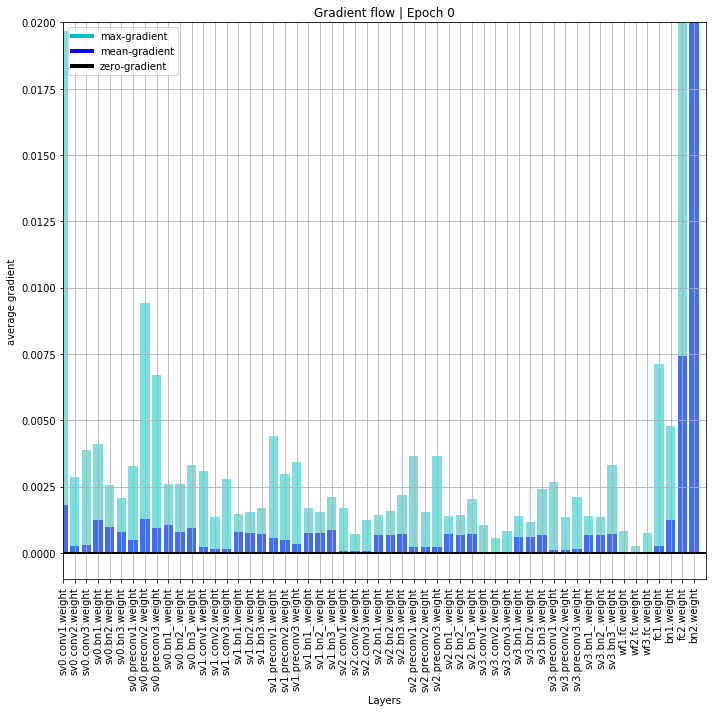

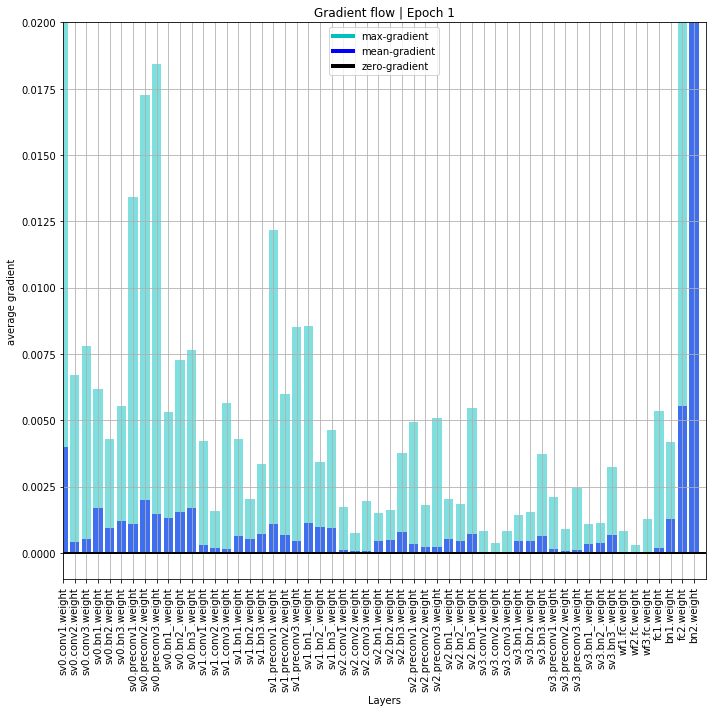

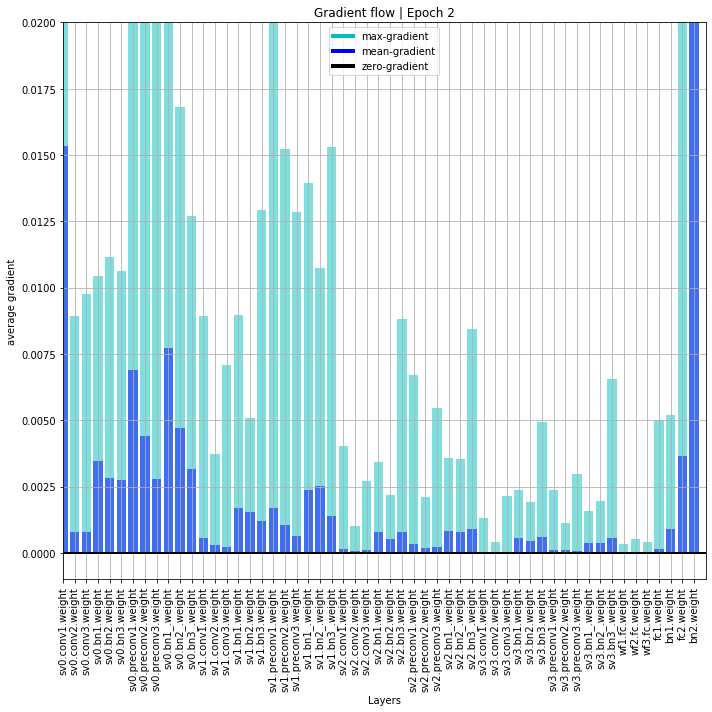

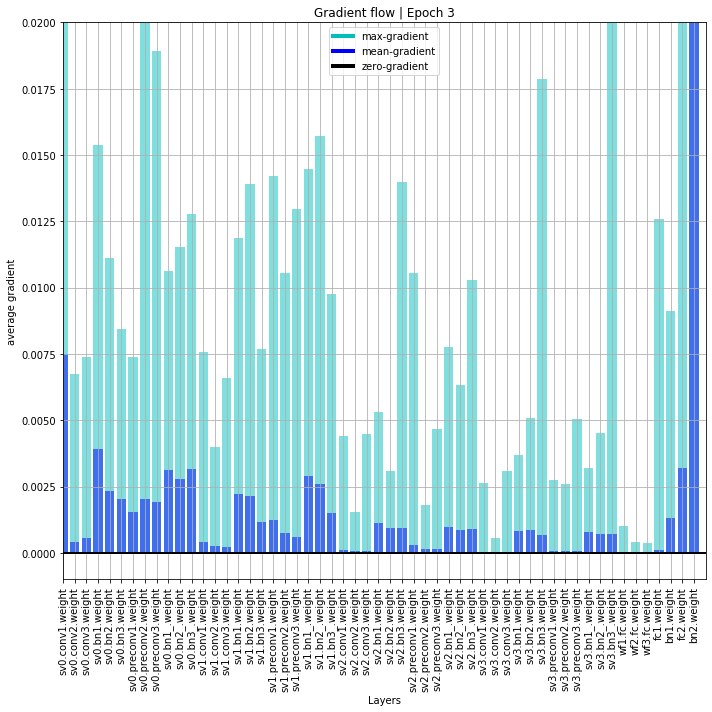

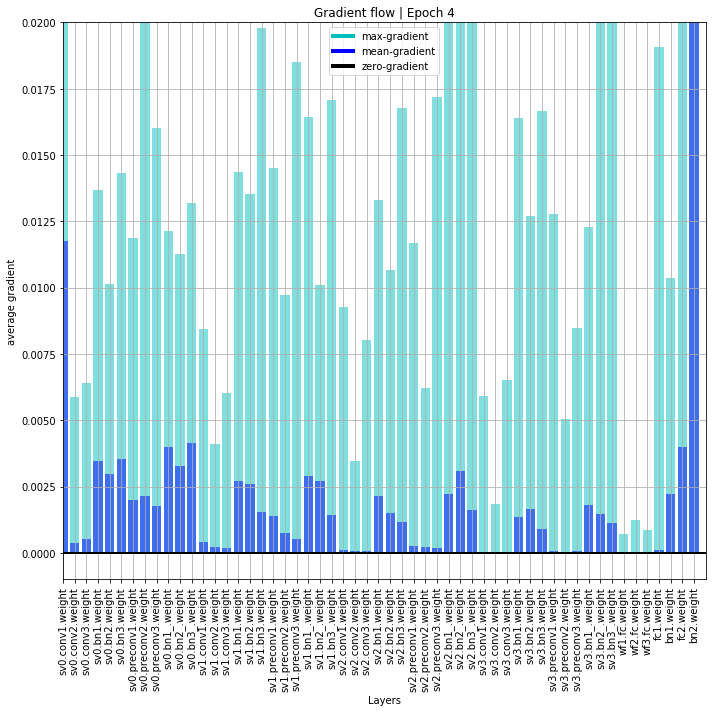

...

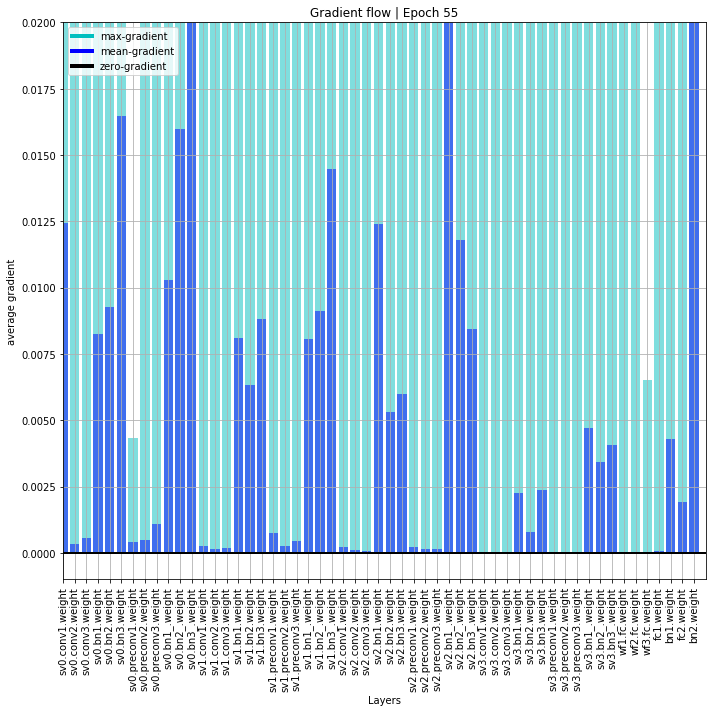

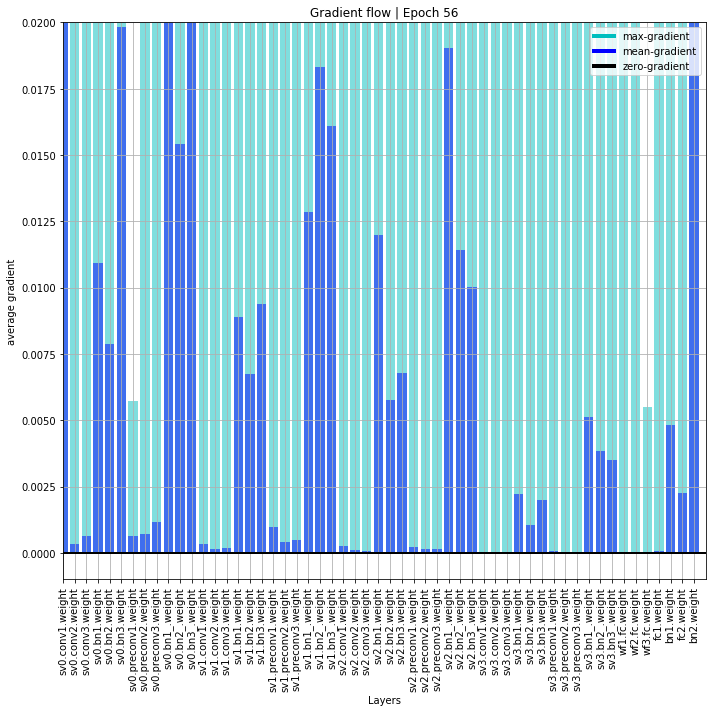

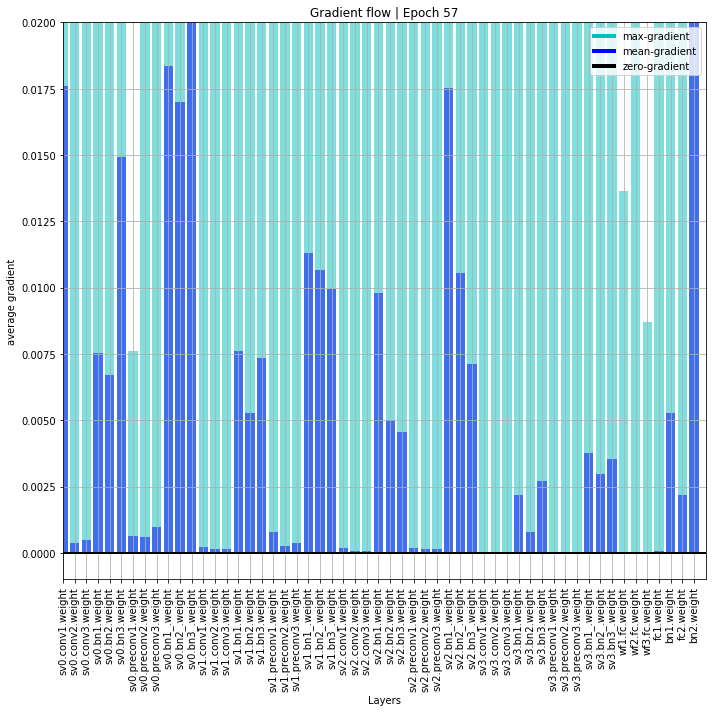

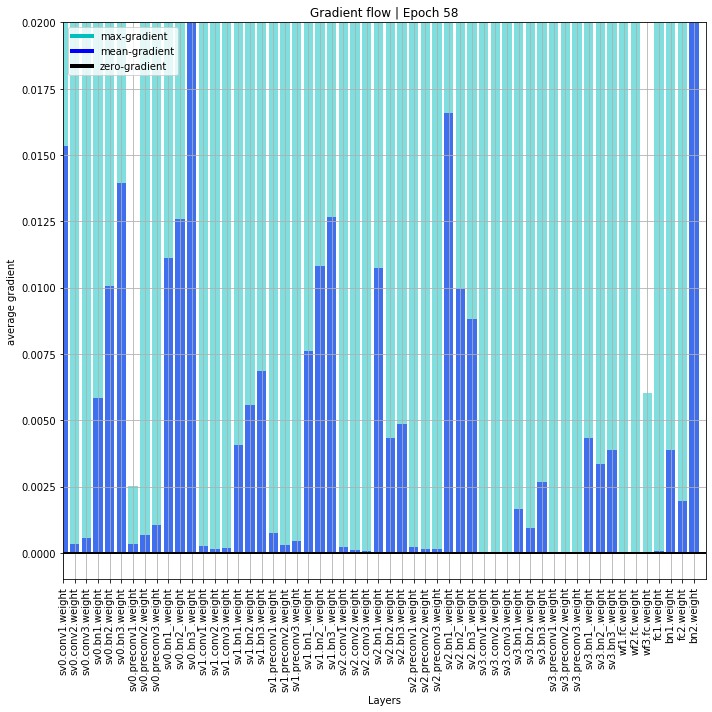

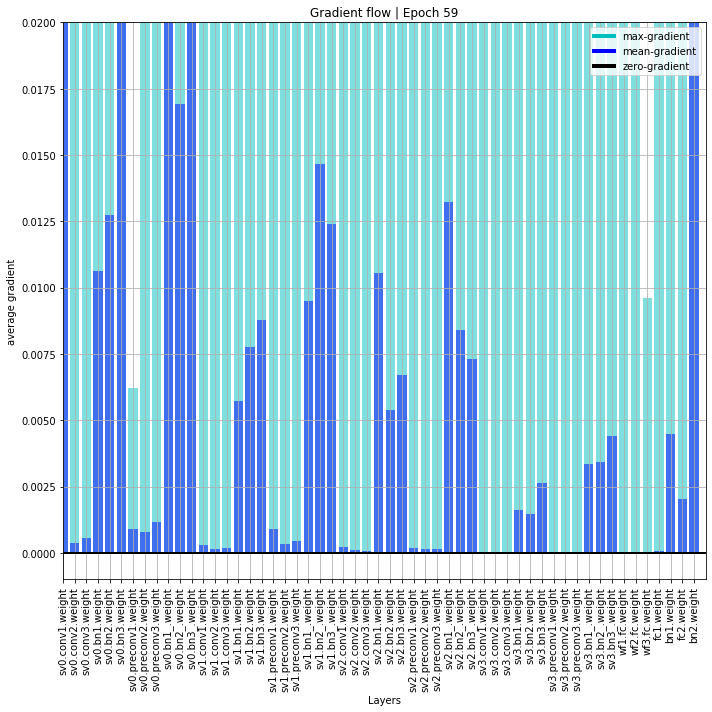

In [28]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(60):  # loop over the dataset multiple times
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
        print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

Epoch:  61
	 - Step 1: loss: 1.162 acc: 0.562
	 - Step 2: loss: 1.103 acc: 0.625
	 - Step 3: loss: 1.175 acc: 0.531
	 - Step 4: loss: 1.367 acc: 0.516
	 - Step 5: loss: 1.186 acc: 0.594
	 - Step 6: loss: 1.356 acc: 0.500
	 - Step 7: loss: 1.362 acc: 0.453
	 - Step 8: loss: 1.093 acc: 0.641
	 - Step 9: loss: 1.241 acc: 0.547
	 - Step 10: loss: 1.179 acc: 0.500
	 - Step 11: loss: 1.159 acc: 0.531
	 - Step 12: loss: 1.123 acc: 0.594
	 - Step 13: loss: 1.537 acc: 0.516
	 - Step 14: loss: 1.100 acc: 0.594
	 - Step 15: loss: 1.067 acc: 0.578
	 - Step 16: loss: 1.463 acc: 0.406
	 - Step 17: loss: 1.212 acc: 0.438
	 - Step 18: loss: 1.365 acc: 0.484
	 - Step 19: loss: 1.124 acc: 0.562
	 - Step 20: loss: 1.068 acc: 0.609
	 - Step 21: loss: 1.161 acc: 0.594
	 - Step 22: loss: 1.236 acc: 0.547
	 - Step 23: loss: 1.153 acc: 0.531
	 - Step 24: loss: 1.125 acc: 0.531
	 - Step 25: loss: 1.048 acc: 0.641
	 - Step 26: loss: 1.264 acc: 0.547
	 - Step 27: loss: 1.287 acc: 0.500
	 - Step 28: loss: 1.248 a

	 - Step 227: loss: 0.933 acc: 0.641
	 - Step 228: loss: 1.259 acc: 0.500
	 - Step 229: loss: 1.147 acc: 0.547
	 - Step 230: loss: 1.090 acc: 0.578
	 - Step 231: loss: 1.130 acc: 0.578
	 - Step 232: loss: 1.145 acc: 0.562
	 - Step 233: loss: 1.188 acc: 0.578
	 - Step 234: loss: 1.261 acc: 0.484
	 - Step 235: loss: 1.235 acc: 0.578
	 - Step 236: loss: 1.234 acc: 0.531
	 - Step 237: loss: 0.957 acc: 0.625
	 - Step 238: loss: 1.305 acc: 0.547
	 - Step 239: loss: 1.189 acc: 0.578
	 - Step 240: loss: 1.148 acc: 0.641
	 - Step 241: loss: 1.428 acc: 0.422
	 - Step 242: loss: 1.245 acc: 0.547
	 - Step 243: loss: 1.147 acc: 0.500
	 - Step 244: loss: 1.399 acc: 0.422
	 - Step 245: loss: 1.211 acc: 0.578
	 - Step 246: loss: 1.158 acc: 0.516
	 - Step 247: loss: 1.266 acc: 0.453
	 - Step 248: loss: 1.329 acc: 0.562
	 - Step 249: loss: 1.080 acc: 0.578
	 - Step 250: loss: 1.234 acc: 0.516
	 - Step 251: loss: 0.955 acc: 0.609
	 - Step 252: loss: 1.424 acc: 0.484
	 - Step 253: loss: 1.288 acc: 0.484
	

	 - Step 449: loss: 1.068 acc: 0.649
- Avg.loss: 1.184  | Avg.acc: 0.551
- Avg. val_loss: 1.215  | Avg. val_acc: 0.534
Epoch:  62
	 - Step 1: loss: 1.092 acc: 0.562
	 - Step 2: loss: 1.246 acc: 0.547
	 - Step 3: loss: 1.209 acc: 0.422
	 - Step 4: loss: 1.050 acc: 0.594
	 - Step 5: loss: 1.155 acc: 0.609
	 - Step 6: loss: 1.027 acc: 0.641
	 - Step 7: loss: 1.265 acc: 0.500
	 - Step 8: loss: 1.023 acc: 0.719
	 - Step 9: loss: 1.093 acc: 0.531
	 - Step 10: loss: 1.197 acc: 0.594
	 - Step 11: loss: 1.083 acc: 0.531
	 - Step 12: loss: 0.974 acc: 0.641
	 - Step 13: loss: 0.979 acc: 0.594
	 - Step 14: loss: 1.156 acc: 0.578
	 - Step 15: loss: 1.092 acc: 0.578
	 - Step 16: loss: 0.934 acc: 0.656
	 - Step 17: loss: 1.008 acc: 0.625
	 - Step 18: loss: 1.103 acc: 0.484
	 - Step 19: loss: 1.272 acc: 0.562
	 - Step 20: loss: 1.391 acc: 0.500
	 - Step 21: loss: 1.177 acc: 0.516
	 - Step 22: loss: 1.155 acc: 0.531
	 - Step 23: loss: 1.498 acc: 0.406
	 - Step 24: loss: 1.034 acc: 0.609
	 - Step 25: lo

	 - Step 223: loss: 1.160 acc: 0.578
	 - Step 224: loss: 1.012 acc: 0.547
	 - Step 225: loss: 1.158 acc: 0.500
	 - Step 226: loss: 1.163 acc: 0.562
	 - Step 227: loss: 1.339 acc: 0.469
	 - Step 228: loss: 1.349 acc: 0.516
	 - Step 229: loss: 1.318 acc: 0.547
	 - Step 230: loss: 1.183 acc: 0.531
	 - Step 231: loss: 1.414 acc: 0.438
	 - Step 232: loss: 1.146 acc: 0.594
	 - Step 233: loss: 1.355 acc: 0.453
	 - Step 234: loss: 1.108 acc: 0.609
	 - Step 235: loss: 1.152 acc: 0.609
	 - Step 236: loss: 1.305 acc: 0.531
	 - Step 237: loss: 1.149 acc: 0.594
	 - Step 238: loss: 0.980 acc: 0.609
	 - Step 239: loss: 1.312 acc: 0.547
	 - Step 240: loss: 1.104 acc: 0.625
	 - Step 241: loss: 1.286 acc: 0.547
	 - Step 242: loss: 1.223 acc: 0.500
	 - Step 243: loss: 1.235 acc: 0.469
	 - Step 244: loss: 0.950 acc: 0.688
	 - Step 245: loss: 1.184 acc: 0.484
	 - Step 246: loss: 1.252 acc: 0.516
	 - Step 247: loss: 1.143 acc: 0.516
	 - Step 248: loss: 1.184 acc: 0.547
	 - Step 249: loss: 1.211 acc: 0.500
	

	 - Step 445: loss: 1.079 acc: 0.609
	 - Step 446: loss: 1.192 acc: 0.562
	 - Step 447: loss: 1.284 acc: 0.547
	 - Step 448: loss: 1.127 acc: 0.531
	 - Step 449: loss: 1.359 acc: 0.514
- Avg.loss: 1.183  | Avg.acc: 0.547
- Avg. val_loss: 1.272  | Avg. val_acc: 0.519
Epoch:  63
	 - Step 1: loss: 1.123 acc: 0.562
	 - Step 2: loss: 1.102 acc: 0.594
	 - Step 3: loss: 1.047 acc: 0.672
	 - Step 4: loss: 1.184 acc: 0.469
	 - Step 5: loss: 1.310 acc: 0.422
	 - Step 6: loss: 1.110 acc: 0.578
	 - Step 7: loss: 1.069 acc: 0.594
	 - Step 8: loss: 1.122 acc: 0.594
	 - Step 9: loss: 1.132 acc: 0.562
	 - Step 10: loss: 1.368 acc: 0.406
	 - Step 11: loss: 1.407 acc: 0.500
	 - Step 12: loss: 1.255 acc: 0.453
	 - Step 13: loss: 1.278 acc: 0.500
	 - Step 14: loss: 1.184 acc: 0.547
	 - Step 15: loss: 1.175 acc: 0.500
	 - Step 16: loss: 1.291 acc: 0.516
	 - Step 17: loss: 1.227 acc: 0.578
	 - Step 18: loss: 1.247 acc: 0.516
	 - Step 19: loss: 1.170 acc: 0.500
	 - Step 20: loss: 1.109 acc: 0.547
	 - Step 21

	 - Step 219: loss: 1.079 acc: 0.594
	 - Step 220: loss: 1.318 acc: 0.453
	 - Step 221: loss: 1.075 acc: 0.594
	 - Step 222: loss: 1.162 acc: 0.531
	 - Step 223: loss: 1.143 acc: 0.609
	 - Step 224: loss: 1.293 acc: 0.484
	 - Step 225: loss: 1.202 acc: 0.578
	 - Step 226: loss: 1.254 acc: 0.500
	 - Step 227: loss: 1.168 acc: 0.500
	 - Step 228: loss: 1.199 acc: 0.531
	 - Step 229: loss: 1.167 acc: 0.562
	 - Step 230: loss: 1.313 acc: 0.516
	 - Step 231: loss: 1.151 acc: 0.562
	 - Step 232: loss: 1.119 acc: 0.531
	 - Step 233: loss: 1.145 acc: 0.547
	 - Step 234: loss: 1.124 acc: 0.594
	 - Step 235: loss: 1.095 acc: 0.625
	 - Step 236: loss: 1.205 acc: 0.562
	 - Step 237: loss: 1.324 acc: 0.391
	 - Step 238: loss: 1.167 acc: 0.547
	 - Step 239: loss: 1.357 acc: 0.438
	 - Step 240: loss: 1.180 acc: 0.547
	 - Step 241: loss: 1.189 acc: 0.547
	 - Step 242: loss: 1.049 acc: 0.609
	 - Step 243: loss: 1.214 acc: 0.562
	 - Step 244: loss: 1.349 acc: 0.469
	 - Step 245: loss: 1.138 acc: 0.547
	

	 - Step 441: loss: 1.289 acc: 0.547
	 - Step 442: loss: 1.183 acc: 0.500
	 - Step 443: loss: 1.032 acc: 0.625
	 - Step 444: loss: 1.124 acc: 0.578
	 - Step 445: loss: 1.256 acc: 0.531
	 - Step 446: loss: 1.116 acc: 0.578
	 - Step 447: loss: 1.213 acc: 0.516
	 - Step 448: loss: 1.145 acc: 0.609
	 - Step 449: loss: 1.155 acc: 0.595
- Avg.loss: 1.178  | Avg.acc: 0.549
- Avg. val_loss: 1.200  | Avg. val_acc: 0.535
Epoch:  64
	 - Step 1: loss: 1.434 acc: 0.469
	 - Step 2: loss: 1.057 acc: 0.641
	 - Step 3: loss: 1.125 acc: 0.578
	 - Step 4: loss: 1.158 acc: 0.594
	 - Step 5: loss: 1.318 acc: 0.469
	 - Step 6: loss: 1.014 acc: 0.641
	 - Step 7: loss: 1.129 acc: 0.562
	 - Step 8: loss: 1.099 acc: 0.531
	 - Step 9: loss: 1.135 acc: 0.594
	 - Step 10: loss: 0.889 acc: 0.625
	 - Step 11: loss: 1.224 acc: 0.516
	 - Step 12: loss: 1.129 acc: 0.594
	 - Step 13: loss: 1.202 acc: 0.500
	 - Step 14: loss: 1.221 acc: 0.484
	 - Step 15: loss: 1.111 acc: 0.609
	 - Step 16: loss: 1.278 acc: 0.531
	 - Ste

	 - Step 215: loss: 1.160 acc: 0.531
	 - Step 216: loss: 1.146 acc: 0.562
	 - Step 217: loss: 1.249 acc: 0.547
	 - Step 218: loss: 1.286 acc: 0.484
	 - Step 219: loss: 1.212 acc: 0.438
	 - Step 220: loss: 1.237 acc: 0.531
	 - Step 221: loss: 1.149 acc: 0.625
	 - Step 222: loss: 1.210 acc: 0.562
	 - Step 223: loss: 1.234 acc: 0.562
	 - Step 224: loss: 1.125 acc: 0.578
	 - Step 225: loss: 1.105 acc: 0.609
	 - Step 226: loss: 0.960 acc: 0.672
	 - Step 227: loss: 1.196 acc: 0.516
	 - Step 228: loss: 1.133 acc: 0.641
	 - Step 229: loss: 1.334 acc: 0.500
	 - Step 230: loss: 1.118 acc: 0.594
	 - Step 231: loss: 1.159 acc: 0.531
	 - Step 232: loss: 1.278 acc: 0.500
	 - Step 233: loss: 1.318 acc: 0.484
	 - Step 234: loss: 1.139 acc: 0.547
	 - Step 235: loss: 1.266 acc: 0.438
	 - Step 236: loss: 1.002 acc: 0.656
	 - Step 237: loss: 1.056 acc: 0.641
	 - Step 238: loss: 1.036 acc: 0.641
	 - Step 239: loss: 1.029 acc: 0.641
	 - Step 240: loss: 1.127 acc: 0.547
	 - Step 241: loss: 0.933 acc: 0.672
	

	 - Step 437: loss: 1.053 acc: 0.594
	 - Step 438: loss: 1.115 acc: 0.578
	 - Step 439: loss: 1.265 acc: 0.500
	 - Step 440: loss: 1.206 acc: 0.531
	 - Step 441: loss: 1.085 acc: 0.516
	 - Step 442: loss: 0.978 acc: 0.672
	 - Step 443: loss: 0.950 acc: 0.594
	 - Step 444: loss: 1.271 acc: 0.641
	 - Step 445: loss: 1.569 acc: 0.438
	 - Step 446: loss: 1.271 acc: 0.484
	 - Step 447: loss: 1.142 acc: 0.547
	 - Step 448: loss: 1.370 acc: 0.438
	 - Step 449: loss: 1.192 acc: 0.541
- Avg.loss: 1.180  | Avg.acc: 0.552
- Avg. val_loss: 1.222  | Avg. val_acc: 0.536
Epoch:  65
	 - Step 1: loss: 1.135 acc: 0.562
	 - Step 2: loss: 1.113 acc: 0.500
	 - Step 3: loss: 0.884 acc: 0.656
	 - Step 4: loss: 1.247 acc: 0.562
	 - Step 5: loss: 1.159 acc: 0.578
	 - Step 6: loss: 1.146 acc: 0.547
	 - Step 7: loss: 1.129 acc: 0.594
	 - Step 8: loss: 1.166 acc: 0.516
	 - Step 9: loss: 1.181 acc: 0.500
	 - Step 10: loss: 1.228 acc: 0.531
	 - Step 11: loss: 1.246 acc: 0.484
	 - Step 12: loss: 1.110 acc: 0.531
	 -

	 - Step 211: loss: 0.974 acc: 0.703
	 - Step 212: loss: 1.138 acc: 0.594
	 - Step 213: loss: 1.296 acc: 0.406
	 - Step 214: loss: 1.140 acc: 0.594
	 - Step 215: loss: 1.161 acc: 0.500
	 - Step 216: loss: 1.086 acc: 0.609
	 - Step 217: loss: 1.319 acc: 0.547
	 - Step 218: loss: 1.285 acc: 0.484
	 - Step 219: loss: 1.297 acc: 0.422
	 - Step 220: loss: 1.456 acc: 0.438
	 - Step 221: loss: 1.479 acc: 0.391
	 - Step 222: loss: 1.191 acc: 0.609
	 - Step 223: loss: 1.076 acc: 0.688
	 - Step 224: loss: 1.268 acc: 0.547
	 - Step 225: loss: 1.301 acc: 0.406
	 - Step 226: loss: 1.007 acc: 0.625
	 - Step 227: loss: 1.126 acc: 0.547
	 - Step 228: loss: 1.075 acc: 0.672
	 - Step 229: loss: 1.159 acc: 0.562
	 - Step 230: loss: 1.059 acc: 0.625
	 - Step 231: loss: 1.316 acc: 0.438
	 - Step 232: loss: 1.088 acc: 0.547
	 - Step 233: loss: 1.018 acc: 0.562
	 - Step 234: loss: 1.024 acc: 0.625
	 - Step 235: loss: 1.308 acc: 0.516
	 - Step 236: loss: 1.050 acc: 0.594
	 - Step 237: loss: 1.232 acc: 0.547
	

	 - Step 433: loss: 1.014 acc: 0.641
	 - Step 434: loss: 1.043 acc: 0.578
	 - Step 435: loss: 1.198 acc: 0.562
	 - Step 436: loss: 0.998 acc: 0.594
	 - Step 437: loss: 0.974 acc: 0.656
	 - Step 438: loss: 1.147 acc: 0.641
	 - Step 439: loss: 1.118 acc: 0.578
	 - Step 440: loss: 0.936 acc: 0.734
	 - Step 441: loss: 1.213 acc: 0.484
	 - Step 442: loss: 1.080 acc: 0.641
	 - Step 443: loss: 1.523 acc: 0.391
	 - Step 444: loss: 1.297 acc: 0.516
	 - Step 445: loss: 1.156 acc: 0.531
	 - Step 446: loss: 0.979 acc: 0.688
	 - Step 447: loss: 1.200 acc: 0.531
	 - Step 448: loss: 1.010 acc: 0.547
	 - Step 449: loss: 1.261 acc: 0.622
- Avg.loss: 1.179  | Avg.acc: 0.550
- Avg. val_loss: 1.221  | Avg. val_acc: 0.536
Epoch:  66
	 - Step 1: loss: 1.166 acc: 0.562
	 - Step 2: loss: 1.374 acc: 0.453
	 - Step 3: loss: 0.975 acc: 0.688
	 - Step 4: loss: 0.997 acc: 0.625
	 - Step 5: loss: 1.082 acc: 0.516
	 - Step 6: loss: 1.071 acc: 0.609
	 - Step 7: loss: 1.138 acc: 0.562
	 - Step 8: loss: 1.380 acc: 0.40

	 - Step 207: loss: 0.895 acc: 0.688
	 - Step 208: loss: 1.133 acc: 0.594
	 - Step 209: loss: 1.277 acc: 0.469
	 - Step 210: loss: 1.159 acc: 0.578
	 - Step 211: loss: 1.247 acc: 0.500
	 - Step 212: loss: 1.200 acc: 0.578
	 - Step 213: loss: 0.860 acc: 0.656
	 - Step 214: loss: 1.259 acc: 0.500
	 - Step 215: loss: 1.042 acc: 0.609
	 - Step 216: loss: 1.286 acc: 0.484
	 - Step 217: loss: 1.146 acc: 0.547
	 - Step 218: loss: 1.165 acc: 0.547
	 - Step 219: loss: 1.118 acc: 0.578
	 - Step 220: loss: 1.061 acc: 0.578
	 - Step 221: loss: 0.981 acc: 0.672
	 - Step 222: loss: 1.244 acc: 0.438
	 - Step 223: loss: 1.277 acc: 0.500
	 - Step 224: loss: 1.084 acc: 0.672
	 - Step 225: loss: 0.963 acc: 0.672
	 - Step 226: loss: 1.261 acc: 0.500
	 - Step 227: loss: 1.071 acc: 0.641
	 - Step 228: loss: 1.357 acc: 0.453
	 - Step 229: loss: 1.316 acc: 0.516
	 - Step 230: loss: 1.431 acc: 0.469
	 - Step 231: loss: 1.281 acc: 0.469
	 - Step 232: loss: 1.216 acc: 0.484
	 - Step 233: loss: 1.390 acc: 0.438
	

	 - Step 429: loss: 1.386 acc: 0.469
	 - Step 430: loss: 1.269 acc: 0.500
	 - Step 431: loss: 1.041 acc: 0.641
	 - Step 432: loss: 1.186 acc: 0.500
	 - Step 433: loss: 1.316 acc: 0.500
	 - Step 434: loss: 1.100 acc: 0.578
	 - Step 435: loss: 1.212 acc: 0.531
	 - Step 436: loss: 0.968 acc: 0.625
	 - Step 437: loss: 1.029 acc: 0.625
	 - Step 438: loss: 1.225 acc: 0.578
	 - Step 439: loss: 1.206 acc: 0.469
	 - Step 440: loss: 1.166 acc: 0.484
	 - Step 441: loss: 1.001 acc: 0.625
	 - Step 442: loss: 1.235 acc: 0.438
	 - Step 443: loss: 1.107 acc: 0.609
	 - Step 444: loss: 1.149 acc: 0.531
	 - Step 445: loss: 1.268 acc: 0.500
	 - Step 446: loss: 1.014 acc: 0.594
	 - Step 447: loss: 1.280 acc: 0.469
	 - Step 448: loss: 1.179 acc: 0.531
	 - Step 449: loss: 1.293 acc: 0.514
- Avg.loss: 1.178  | Avg.acc: 0.550
- Avg. val_loss: 1.225  | Avg. val_acc: 0.530
Epoch:  67
	 - Step 1: loss: 1.171 acc: 0.531
	 - Step 2: loss: 1.168 acc: 0.516
	 - Step 3: loss: 1.009 acc: 0.688
	 - Step 4: loss: 1.304 a

	 - Step 203: loss: 1.200 acc: 0.531
	 - Step 204: loss: 1.060 acc: 0.562
	 - Step 205: loss: 1.334 acc: 0.547
	 - Step 206: loss: 1.200 acc: 0.578
	 - Step 207: loss: 1.340 acc: 0.484
	 - Step 208: loss: 1.153 acc: 0.531
	 - Step 209: loss: 1.349 acc: 0.562
	 - Step 210: loss: 0.988 acc: 0.609
	 - Step 211: loss: 1.141 acc: 0.500
	 - Step 212: loss: 1.187 acc: 0.484
	 - Step 213: loss: 1.233 acc: 0.562
	 - Step 214: loss: 1.029 acc: 0.656
	 - Step 215: loss: 0.942 acc: 0.672
	 - Step 216: loss: 1.282 acc: 0.516
	 - Step 217: loss: 1.187 acc: 0.609
	 - Step 218: loss: 1.198 acc: 0.484
	 - Step 219: loss: 1.501 acc: 0.438
	 - Step 220: loss: 1.370 acc: 0.438
	 - Step 221: loss: 0.962 acc: 0.578
	 - Step 222: loss: 1.209 acc: 0.609
	 - Step 223: loss: 1.290 acc: 0.531
	 - Step 224: loss: 1.293 acc: 0.484
	 - Step 225: loss: 1.064 acc: 0.562
	 - Step 226: loss: 1.136 acc: 0.578
	 - Step 227: loss: 1.192 acc: 0.484
	 - Step 228: loss: 1.180 acc: 0.578
	 - Step 229: loss: 1.208 acc: 0.594
	

	 - Step 425: loss: 1.116 acc: 0.547
	 - Step 426: loss: 1.509 acc: 0.484
	 - Step 427: loss: 1.190 acc: 0.531
	 - Step 428: loss: 1.020 acc: 0.625
	 - Step 429: loss: 1.092 acc: 0.578
	 - Step 430: loss: 1.229 acc: 0.531
	 - Step 431: loss: 1.323 acc: 0.391
	 - Step 432: loss: 1.164 acc: 0.516
	 - Step 433: loss: 1.100 acc: 0.578
	 - Step 434: loss: 1.052 acc: 0.578
	 - Step 435: loss: 0.986 acc: 0.625
	 - Step 436: loss: 1.259 acc: 0.547
	 - Step 437: loss: 1.095 acc: 0.562
	 - Step 438: loss: 1.199 acc: 0.500
	 - Step 439: loss: 1.281 acc: 0.531
	 - Step 440: loss: 1.104 acc: 0.562
	 - Step 441: loss: 1.116 acc: 0.516
	 - Step 442: loss: 1.373 acc: 0.438
	 - Step 443: loss: 1.184 acc: 0.547
	 - Step 444: loss: 1.266 acc: 0.547
	 - Step 445: loss: 1.063 acc: 0.578
	 - Step 446: loss: 1.236 acc: 0.469
	 - Step 447: loss: 1.218 acc: 0.531
	 - Step 448: loss: 1.300 acc: 0.453
	 - Step 449: loss: 1.159 acc: 0.568
- Avg.loss: 1.177  | Avg.acc: 0.553
- Avg. val_loss: 1.239  | Avg. val_acc:

	 - Step 199: loss: 1.035 acc: 0.609
	 - Step 200: loss: 1.109 acc: 0.625
	 - Step 201: loss: 1.237 acc: 0.516
	 - Step 202: loss: 1.210 acc: 0.531
	 - Step 203: loss: 1.186 acc: 0.484
	 - Step 204: loss: 1.053 acc: 0.562
	 - Step 205: loss: 1.193 acc: 0.594
	 - Step 206: loss: 1.196 acc: 0.500
	 - Step 207: loss: 1.532 acc: 0.453
	 - Step 208: loss: 0.992 acc: 0.688
	 - Step 209: loss: 1.021 acc: 0.562
	 - Step 210: loss: 1.067 acc: 0.578
	 - Step 211: loss: 1.111 acc: 0.562
	 - Step 212: loss: 1.181 acc: 0.547
	 - Step 213: loss: 1.223 acc: 0.609
	 - Step 214: loss: 0.929 acc: 0.625
	 - Step 215: loss: 1.208 acc: 0.547
	 - Step 216: loss: 1.078 acc: 0.625
	 - Step 217: loss: 1.326 acc: 0.625
	 - Step 218: loss: 1.044 acc: 0.625
	 - Step 219: loss: 1.128 acc: 0.578
	 - Step 220: loss: 1.337 acc: 0.500
	 - Step 221: loss: 1.033 acc: 0.609
	 - Step 222: loss: 1.226 acc: 0.562
	 - Step 223: loss: 0.970 acc: 0.609
	 - Step 224: loss: 1.160 acc: 0.500
	 - Step 225: loss: 0.994 acc: 0.625
	

	 - Step 421: loss: 1.123 acc: 0.547
	 - Step 422: loss: 1.116 acc: 0.500
	 - Step 423: loss: 1.188 acc: 0.500
	 - Step 424: loss: 1.095 acc: 0.578
	 - Step 425: loss: 1.318 acc: 0.422
	 - Step 426: loss: 1.102 acc: 0.594
	 - Step 427: loss: 1.271 acc: 0.516
	 - Step 428: loss: 1.052 acc: 0.625
	 - Step 429: loss: 1.189 acc: 0.547
	 - Step 430: loss: 1.313 acc: 0.469
	 - Step 431: loss: 1.220 acc: 0.516
	 - Step 432: loss: 1.205 acc: 0.531
	 - Step 433: loss: 1.132 acc: 0.578
	 - Step 434: loss: 1.254 acc: 0.484
	 - Step 435: loss: 0.991 acc: 0.688
	 - Step 436: loss: 1.060 acc: 0.594
	 - Step 437: loss: 1.255 acc: 0.516
	 - Step 438: loss: 1.039 acc: 0.578
	 - Step 439: loss: 1.170 acc: 0.531
	 - Step 440: loss: 1.001 acc: 0.672
	 - Step 441: loss: 1.187 acc: 0.531
	 - Step 442: loss: 1.242 acc: 0.438
	 - Step 443: loss: 1.124 acc: 0.625
	 - Step 444: loss: 1.223 acc: 0.500
	 - Step 445: loss: 1.114 acc: 0.562
	 - Step 446: loss: 1.312 acc: 0.484
	 - Step 447: loss: 1.338 acc: 0.500
	

	 - Step 195: loss: 1.354 acc: 0.578
	 - Step 196: loss: 1.078 acc: 0.625
	 - Step 197: loss: 1.271 acc: 0.516
	 - Step 198: loss: 1.196 acc: 0.609
	 - Step 199: loss: 1.191 acc: 0.562
	 - Step 200: loss: 1.075 acc: 0.516
	 - Step 201: loss: 1.289 acc: 0.500
	 - Step 202: loss: 1.205 acc: 0.516
	 - Step 203: loss: 1.255 acc: 0.469
	 - Step 204: loss: 1.028 acc: 0.562
	 - Step 205: loss: 1.221 acc: 0.562
	 - Step 206: loss: 1.112 acc: 0.578
	 - Step 207: loss: 1.062 acc: 0.562
	 - Step 208: loss: 1.201 acc: 0.438
	 - Step 209: loss: 1.106 acc: 0.531
	 - Step 210: loss: 1.256 acc: 0.484
	 - Step 211: loss: 1.222 acc: 0.547
	 - Step 212: loss: 1.253 acc: 0.500
	 - Step 213: loss: 1.179 acc: 0.500
	 - Step 214: loss: 1.385 acc: 0.453
	 - Step 215: loss: 1.064 acc: 0.609
	 - Step 216: loss: 1.082 acc: 0.609
	 - Step 217: loss: 1.103 acc: 0.516
	 - Step 218: loss: 1.342 acc: 0.531
	 - Step 219: loss: 1.103 acc: 0.516
	 - Step 220: loss: 1.148 acc: 0.531
	 - Step 221: loss: 1.180 acc: 0.531
	

	 - Step 417: loss: 1.140 acc: 0.531
	 - Step 418: loss: 1.122 acc: 0.547
	 - Step 419: loss: 1.253 acc: 0.516
	 - Step 420: loss: 1.022 acc: 0.578
	 - Step 421: loss: 1.586 acc: 0.438
	 - Step 422: loss: 1.225 acc: 0.484
	 - Step 423: loss: 1.270 acc: 0.469
	 - Step 424: loss: 0.977 acc: 0.641
	 - Step 425: loss: 1.196 acc: 0.578
	 - Step 426: loss: 1.127 acc: 0.641
	 - Step 427: loss: 1.248 acc: 0.562
	 - Step 428: loss: 1.161 acc: 0.531
	 - Step 429: loss: 1.128 acc: 0.547
	 - Step 430: loss: 1.166 acc: 0.625
	 - Step 431: loss: 1.085 acc: 0.516
	 - Step 432: loss: 1.207 acc: 0.531
	 - Step 433: loss: 1.393 acc: 0.484
	 - Step 434: loss: 1.198 acc: 0.609
	 - Step 435: loss: 1.359 acc: 0.422
	 - Step 436: loss: 1.216 acc: 0.547
	 - Step 437: loss: 0.940 acc: 0.641
	 - Step 438: loss: 1.190 acc: 0.516
	 - Step 439: loss: 1.302 acc: 0.500
	 - Step 440: loss: 1.161 acc: 0.547
	 - Step 441: loss: 1.179 acc: 0.453
	 - Step 442: loss: 1.187 acc: 0.562
	 - Step 443: loss: 1.203 acc: 0.500
	

	 - Step 191: loss: 1.120 acc: 0.609
	 - Step 192: loss: 1.352 acc: 0.500
	 - Step 193: loss: 1.260 acc: 0.500
	 - Step 194: loss: 1.150 acc: 0.531
	 - Step 195: loss: 1.344 acc: 0.500
	 - Step 196: loss: 1.153 acc: 0.484
	 - Step 197: loss: 1.269 acc: 0.531
	 - Step 198: loss: 1.160 acc: 0.531
	 - Step 199: loss: 1.105 acc: 0.531
	 - Step 200: loss: 1.290 acc: 0.578
	 - Step 201: loss: 1.167 acc: 0.562
	 - Step 202: loss: 1.175 acc: 0.562
	 - Step 203: loss: 1.095 acc: 0.547
	 - Step 204: loss: 0.985 acc: 0.672
	 - Step 205: loss: 1.231 acc: 0.531
	 - Step 206: loss: 1.099 acc: 0.578
	 - Step 207: loss: 1.301 acc: 0.500
	 - Step 208: loss: 0.996 acc: 0.578
	 - Step 209: loss: 0.996 acc: 0.656
	 - Step 210: loss: 1.208 acc: 0.531
	 - Step 211: loss: 1.162 acc: 0.562
	 - Step 212: loss: 1.344 acc: 0.469
	 - Step 213: loss: 1.335 acc: 0.500
	 - Step 214: loss: 1.256 acc: 0.547
	 - Step 215: loss: 1.041 acc: 0.594
	 - Step 216: loss: 1.162 acc: 0.562
	 - Step 217: loss: 1.140 acc: 0.562
	

	 - Step 413: loss: 1.375 acc: 0.422
	 - Step 414: loss: 1.219 acc: 0.578
	 - Step 415: loss: 1.238 acc: 0.516
	 - Step 416: loss: 1.197 acc: 0.516
	 - Step 417: loss: 1.331 acc: 0.453
	 - Step 418: loss: 1.083 acc: 0.578
	 - Step 419: loss: 1.136 acc: 0.562
	 - Step 420: loss: 1.082 acc: 0.562
	 - Step 421: loss: 1.006 acc: 0.688
	 - Step 422: loss: 1.176 acc: 0.500
	 - Step 423: loss: 1.119 acc: 0.609
	 - Step 424: loss: 1.247 acc: 0.516
	 - Step 425: loss: 1.357 acc: 0.500
	 - Step 426: loss: 1.205 acc: 0.500
	 - Step 427: loss: 1.435 acc: 0.453
	 - Step 428: loss: 1.074 acc: 0.625
	 - Step 429: loss: 1.413 acc: 0.438
	 - Step 430: loss: 1.310 acc: 0.500
	 - Step 431: loss: 1.215 acc: 0.562
	 - Step 432: loss: 1.207 acc: 0.547
	 - Step 433: loss: 1.286 acc: 0.484
	 - Step 434: loss: 1.325 acc: 0.469
	 - Step 435: loss: 1.020 acc: 0.656
	 - Step 436: loss: 1.254 acc: 0.484
	 - Step 437: loss: 1.161 acc: 0.531
	 - Step 438: loss: 1.138 acc: 0.516
	 - Step 439: loss: 1.261 acc: 0.562
	

	 - Step 187: loss: 1.212 acc: 0.484
	 - Step 188: loss: 1.094 acc: 0.594
	 - Step 189: loss: 1.192 acc: 0.562
	 - Step 190: loss: 1.194 acc: 0.562
	 - Step 191: loss: 1.238 acc: 0.531
	 - Step 192: loss: 1.174 acc: 0.625
	 - Step 193: loss: 1.088 acc: 0.609
	 - Step 194: loss: 1.020 acc: 0.656
	 - Step 195: loss: 1.238 acc: 0.547
	 - Step 196: loss: 1.237 acc: 0.516
	 - Step 197: loss: 1.091 acc: 0.609
	 - Step 198: loss: 1.085 acc: 0.578
	 - Step 199: loss: 1.067 acc: 0.656
	 - Step 200: loss: 0.965 acc: 0.688
	 - Step 201: loss: 1.182 acc: 0.547
	 - Step 202: loss: 1.189 acc: 0.625
	 - Step 203: loss: 1.085 acc: 0.609
	 - Step 204: loss: 1.180 acc: 0.594
	 - Step 205: loss: 1.076 acc: 0.594
	 - Step 206: loss: 1.188 acc: 0.469
	 - Step 207: loss: 0.910 acc: 0.594
	 - Step 208: loss: 1.003 acc: 0.625
	 - Step 209: loss: 0.970 acc: 0.641
	 - Step 210: loss: 1.246 acc: 0.500
	 - Step 211: loss: 1.266 acc: 0.469
	 - Step 212: loss: 1.314 acc: 0.562
	 - Step 213: loss: 0.942 acc: 0.578
	

	 - Step 409: loss: 1.008 acc: 0.625
	 - Step 410: loss: 1.102 acc: 0.641
	 - Step 411: loss: 1.139 acc: 0.562
	 - Step 412: loss: 1.308 acc: 0.500
	 - Step 413: loss: 1.129 acc: 0.609
	 - Step 414: loss: 1.286 acc: 0.469
	 - Step 415: loss: 1.217 acc: 0.625
	 - Step 416: loss: 1.215 acc: 0.500
	 - Step 417: loss: 1.050 acc: 0.594
	 - Step 418: loss: 0.984 acc: 0.609
	 - Step 419: loss: 1.225 acc: 0.531
	 - Step 420: loss: 1.161 acc: 0.594
	 - Step 421: loss: 1.144 acc: 0.625
	 - Step 422: loss: 1.232 acc: 0.531
	 - Step 423: loss: 0.892 acc: 0.688
	 - Step 424: loss: 1.168 acc: 0.562
	 - Step 425: loss: 1.243 acc: 0.547
	 - Step 426: loss: 0.955 acc: 0.594
	 - Step 427: loss: 1.308 acc: 0.484
	 - Step 428: loss: 1.157 acc: 0.500
	 - Step 429: loss: 1.130 acc: 0.547
	 - Step 430: loss: 1.189 acc: 0.547
	 - Step 431: loss: 1.201 acc: 0.562
	 - Step 432: loss: 1.181 acc: 0.500
	 - Step 433: loss: 1.286 acc: 0.516
	 - Step 434: loss: 0.983 acc: 0.641
	 - Step 435: loss: 1.283 acc: 0.422
	

	 - Step 183: loss: 1.043 acc: 0.594
	 - Step 184: loss: 1.315 acc: 0.484
	 - Step 185: loss: 1.065 acc: 0.547
	 - Step 186: loss: 1.279 acc: 0.547
	 - Step 187: loss: 1.165 acc: 0.578
	 - Step 188: loss: 1.203 acc: 0.500
	 - Step 189: loss: 1.082 acc: 0.594
	 - Step 190: loss: 1.181 acc: 0.547
	 - Step 191: loss: 1.029 acc: 0.641
	 - Step 192: loss: 1.304 acc: 0.516
	 - Step 193: loss: 1.013 acc: 0.641
	 - Step 194: loss: 1.101 acc: 0.609
	 - Step 195: loss: 1.335 acc: 0.438
	 - Step 196: loss: 1.119 acc: 0.641
	 - Step 197: loss: 1.172 acc: 0.578
	 - Step 198: loss: 1.170 acc: 0.578
	 - Step 199: loss: 1.345 acc: 0.469
	 - Step 200: loss: 1.045 acc: 0.641
	 - Step 201: loss: 1.172 acc: 0.547
	 - Step 202: loss: 1.172 acc: 0.500
	 - Step 203: loss: 1.170 acc: 0.578
	 - Step 204: loss: 1.158 acc: 0.547
	 - Step 205: loss: 1.101 acc: 0.594
	 - Step 206: loss: 1.206 acc: 0.484
	 - Step 207: loss: 1.110 acc: 0.531
	 - Step 208: loss: 0.956 acc: 0.641
	 - Step 209: loss: 1.224 acc: 0.547
	

	 - Step 405: loss: 1.236 acc: 0.562
	 - Step 406: loss: 1.238 acc: 0.547
	 - Step 407: loss: 1.100 acc: 0.594
	 - Step 408: loss: 1.331 acc: 0.500
	 - Step 409: loss: 0.955 acc: 0.734
	 - Step 410: loss: 1.134 acc: 0.609
	 - Step 411: loss: 1.313 acc: 0.609
	 - Step 412: loss: 0.953 acc: 0.594
	 - Step 413: loss: 1.256 acc: 0.516
	 - Step 414: loss: 1.432 acc: 0.438
	 - Step 415: loss: 1.106 acc: 0.469
	 - Step 416: loss: 1.271 acc: 0.453
	 - Step 417: loss: 1.118 acc: 0.531
	 - Step 418: loss: 1.079 acc: 0.656
	 - Step 419: loss: 1.160 acc: 0.547
	 - Step 420: loss: 1.059 acc: 0.656
	 - Step 421: loss: 1.192 acc: 0.578
	 - Step 422: loss: 1.247 acc: 0.500
	 - Step 423: loss: 1.299 acc: 0.469
	 - Step 424: loss: 1.120 acc: 0.609
	 - Step 425: loss: 1.311 acc: 0.484
	 - Step 426: loss: 1.349 acc: 0.453
	 - Step 427: loss: 1.297 acc: 0.531
	 - Step 428: loss: 1.366 acc: 0.500
	 - Step 429: loss: 1.076 acc: 0.672
	 - Step 430: loss: 1.188 acc: 0.578
	 - Step 431: loss: 1.232 acc: 0.547
	

	 - Step 179: loss: 1.309 acc: 0.469
	 - Step 180: loss: 1.184 acc: 0.547
	 - Step 181: loss: 1.051 acc: 0.578
	 - Step 182: loss: 1.275 acc: 0.453
	 - Step 183: loss: 1.151 acc: 0.562
	 - Step 184: loss: 1.090 acc: 0.562
	 - Step 185: loss: 1.223 acc: 0.547
	 - Step 186: loss: 1.177 acc: 0.594
	 - Step 187: loss: 1.145 acc: 0.453
	 - Step 188: loss: 1.099 acc: 0.578
	 - Step 189: loss: 1.321 acc: 0.438
	 - Step 190: loss: 1.043 acc: 0.609
	 - Step 191: loss: 1.199 acc: 0.484
	 - Step 192: loss: 1.282 acc: 0.547
	 - Step 193: loss: 1.058 acc: 0.562
	 - Step 194: loss: 1.027 acc: 0.641
	 - Step 195: loss: 1.125 acc: 0.562
	 - Step 196: loss: 1.432 acc: 0.422
	 - Step 197: loss: 1.154 acc: 0.562
	 - Step 198: loss: 0.956 acc: 0.734
	 - Step 199: loss: 1.270 acc: 0.547
	 - Step 200: loss: 1.185 acc: 0.500
	 - Step 201: loss: 1.035 acc: 0.625
	 - Step 202: loss: 1.272 acc: 0.516
	 - Step 203: loss: 1.039 acc: 0.641
	 - Step 204: loss: 1.144 acc: 0.531
	 - Step 205: loss: 1.256 acc: 0.500
	

	 - Step 401: loss: 1.376 acc: 0.469
	 - Step 402: loss: 1.312 acc: 0.547
	 - Step 403: loss: 1.157 acc: 0.547
	 - Step 404: loss: 1.129 acc: 0.547
	 - Step 405: loss: 0.925 acc: 0.672
	 - Step 406: loss: 1.138 acc: 0.625
	 - Step 407: loss: 1.118 acc: 0.578
	 - Step 408: loss: 0.918 acc: 0.656
	 - Step 409: loss: 1.037 acc: 0.578
	 - Step 410: loss: 1.008 acc: 0.656
	 - Step 411: loss: 1.109 acc: 0.578
	 - Step 412: loss: 1.248 acc: 0.562
	 - Step 413: loss: 1.072 acc: 0.578
	 - Step 414: loss: 1.192 acc: 0.578
	 - Step 415: loss: 1.032 acc: 0.609
	 - Step 416: loss: 1.181 acc: 0.547
	 - Step 417: loss: 1.189 acc: 0.531
	 - Step 418: loss: 1.041 acc: 0.609
	 - Step 419: loss: 1.133 acc: 0.547
	 - Step 420: loss: 1.163 acc: 0.531
	 - Step 421: loss: 1.136 acc: 0.641
	 - Step 422: loss: 1.434 acc: 0.469
	 - Step 423: loss: 1.400 acc: 0.422
	 - Step 424: loss: 0.996 acc: 0.609
	 - Step 425: loss: 0.931 acc: 0.609
	 - Step 426: loss: 1.164 acc: 0.594
	 - Step 427: loss: 1.123 acc: 0.547
	

	 - Step 175: loss: 1.282 acc: 0.547
	 - Step 176: loss: 1.215 acc: 0.484
	 - Step 177: loss: 1.104 acc: 0.516
	 - Step 178: loss: 1.306 acc: 0.453
	 - Step 179: loss: 1.218 acc: 0.547
	 - Step 180: loss: 1.191 acc: 0.578
	 - Step 181: loss: 1.184 acc: 0.609
	 - Step 182: loss: 1.176 acc: 0.516
	 - Step 183: loss: 1.116 acc: 0.562
	 - Step 184: loss: 1.072 acc: 0.516
	 - Step 185: loss: 1.035 acc: 0.594
	 - Step 186: loss: 1.137 acc: 0.547
	 - Step 187: loss: 1.065 acc: 0.578
	 - Step 188: loss: 1.263 acc: 0.500
	 - Step 189: loss: 1.047 acc: 0.594
	 - Step 190: loss: 1.122 acc: 0.547
	 - Step 191: loss: 1.121 acc: 0.688
	 - Step 192: loss: 1.273 acc: 0.484
	 - Step 193: loss: 1.061 acc: 0.609
	 - Step 194: loss: 1.308 acc: 0.484
	 - Step 195: loss: 1.021 acc: 0.625
	 - Step 196: loss: 1.122 acc: 0.562
	 - Step 197: loss: 1.039 acc: 0.625
	 - Step 198: loss: 1.032 acc: 0.578
	 - Step 199: loss: 1.265 acc: 0.453
	 - Step 200: loss: 1.232 acc: 0.484
	 - Step 201: loss: 1.303 acc: 0.453
	

	 - Step 397: loss: 1.113 acc: 0.594
	 - Step 398: loss: 1.279 acc: 0.531
	 - Step 399: loss: 0.989 acc: 0.609
	 - Step 400: loss: 1.100 acc: 0.547
	 - Step 401: loss: 1.292 acc: 0.516
	 - Step 402: loss: 1.123 acc: 0.609
	 - Step 403: loss: 1.177 acc: 0.562
	 - Step 404: loss: 0.926 acc: 0.641
	 - Step 405: loss: 1.088 acc: 0.562
	 - Step 406: loss: 1.243 acc: 0.484
	 - Step 407: loss: 1.148 acc: 0.500
	 - Step 408: loss: 0.989 acc: 0.609
	 - Step 409: loss: 1.217 acc: 0.500
	 - Step 410: loss: 1.417 acc: 0.516
	 - Step 411: loss: 1.065 acc: 0.578
	 - Step 412: loss: 1.072 acc: 0.594
	 - Step 413: loss: 1.312 acc: 0.516
	 - Step 414: loss: 1.142 acc: 0.594
	 - Step 415: loss: 1.117 acc: 0.578
	 - Step 416: loss: 0.984 acc: 0.594
	 - Step 417: loss: 1.161 acc: 0.578
	 - Step 418: loss: 0.997 acc: 0.594
	 - Step 419: loss: 1.183 acc: 0.484
	 - Step 420: loss: 1.373 acc: 0.453
	 - Step 421: loss: 1.228 acc: 0.547
	 - Step 422: loss: 1.189 acc: 0.594
	 - Step 423: loss: 1.126 acc: 0.531
	

	 - Step 171: loss: 0.989 acc: 0.594
	 - Step 172: loss: 1.124 acc: 0.500
	 - Step 173: loss: 1.172 acc: 0.594
	 - Step 174: loss: 1.355 acc: 0.438
	 - Step 175: loss: 1.339 acc: 0.422
	 - Step 176: loss: 1.153 acc: 0.562
	 - Step 177: loss: 1.119 acc: 0.594
	 - Step 178: loss: 1.262 acc: 0.453
	 - Step 179: loss: 1.015 acc: 0.625
	 - Step 180: loss: 1.089 acc: 0.578
	 - Step 181: loss: 1.233 acc: 0.500
	 - Step 182: loss: 1.022 acc: 0.688
	 - Step 183: loss: 1.162 acc: 0.562
	 - Step 184: loss: 1.341 acc: 0.484
	 - Step 185: loss: 1.045 acc: 0.594
	 - Step 186: loss: 1.139 acc: 0.625
	 - Step 187: loss: 1.044 acc: 0.672
	 - Step 188: loss: 1.071 acc: 0.547
	 - Step 189: loss: 1.179 acc: 0.547
	 - Step 190: loss: 1.094 acc: 0.562
	 - Step 191: loss: 1.078 acc: 0.609
	 - Step 192: loss: 1.408 acc: 0.484
	 - Step 193: loss: 1.252 acc: 0.594
	 - Step 194: loss: 0.965 acc: 0.641
	 - Step 195: loss: 1.088 acc: 0.578
	 - Step 196: loss: 1.237 acc: 0.500
	 - Step 197: loss: 1.252 acc: 0.531
	

	 - Step 393: loss: 1.019 acc: 0.578
	 - Step 394: loss: 1.331 acc: 0.469
	 - Step 395: loss: 1.184 acc: 0.500
	 - Step 396: loss: 1.446 acc: 0.375
	 - Step 397: loss: 1.216 acc: 0.484
	 - Step 398: loss: 0.980 acc: 0.641
	 - Step 399: loss: 1.134 acc: 0.609
	 - Step 400: loss: 1.019 acc: 0.625
	 - Step 401: loss: 1.147 acc: 0.578
	 - Step 402: loss: 1.203 acc: 0.609
	 - Step 403: loss: 1.118 acc: 0.562
	 - Step 404: loss: 1.253 acc: 0.562
	 - Step 405: loss: 1.013 acc: 0.641
	 - Step 406: loss: 1.087 acc: 0.547
	 - Step 407: loss: 1.292 acc: 0.516
	 - Step 408: loss: 1.055 acc: 0.516
	 - Step 409: loss: 1.278 acc: 0.453
	 - Step 410: loss: 1.169 acc: 0.625
	 - Step 411: loss: 1.197 acc: 0.484
	 - Step 412: loss: 1.129 acc: 0.625
	 - Step 413: loss: 1.229 acc: 0.562
	 - Step 414: loss: 1.145 acc: 0.562
	 - Step 415: loss: 1.181 acc: 0.500
	 - Step 416: loss: 1.057 acc: 0.625
	 - Step 417: loss: 1.257 acc: 0.516
	 - Step 418: loss: 1.027 acc: 0.625
	 - Step 419: loss: 1.021 acc: 0.594
	

	 - Step 167: loss: 1.166 acc: 0.531
	 - Step 168: loss: 1.238 acc: 0.531
	 - Step 169: loss: 1.067 acc: 0.562
	 - Step 170: loss: 1.024 acc: 0.531
	 - Step 171: loss: 1.011 acc: 0.641
	 - Step 172: loss: 1.247 acc: 0.469
	 - Step 173: loss: 0.972 acc: 0.578
	 - Step 174: loss: 1.110 acc: 0.562
	 - Step 175: loss: 1.178 acc: 0.562
	 - Step 176: loss: 1.168 acc: 0.562
	 - Step 177: loss: 1.111 acc: 0.562
	 - Step 178: loss: 1.238 acc: 0.500
	 - Step 179: loss: 1.207 acc: 0.547
	 - Step 180: loss: 1.152 acc: 0.562
	 - Step 181: loss: 1.115 acc: 0.562
	 - Step 182: loss: 1.216 acc: 0.594
	 - Step 183: loss: 0.978 acc: 0.672
	 - Step 184: loss: 1.222 acc: 0.531
	 - Step 185: loss: 1.207 acc: 0.531
	 - Step 186: loss: 1.087 acc: 0.547
	 - Step 187: loss: 1.167 acc: 0.547
	 - Step 188: loss: 1.017 acc: 0.625
	 - Step 189: loss: 1.109 acc: 0.500
	 - Step 190: loss: 1.159 acc: 0.516
	 - Step 191: loss: 1.166 acc: 0.578
	 - Step 192: loss: 1.256 acc: 0.516
	 - Step 193: loss: 1.180 acc: 0.516
	

	 - Step 389: loss: 1.038 acc: 0.594
	 - Step 390: loss: 1.288 acc: 0.562
	 - Step 391: loss: 1.182 acc: 0.500
	 - Step 392: loss: 1.379 acc: 0.453
	 - Step 393: loss: 1.277 acc: 0.453
	 - Step 394: loss: 1.110 acc: 0.578
	 - Step 395: loss: 1.096 acc: 0.531
	 - Step 396: loss: 1.214 acc: 0.562
	 - Step 397: loss: 1.183 acc: 0.484
	 - Step 398: loss: 1.122 acc: 0.609
	 - Step 399: loss: 1.290 acc: 0.531
	 - Step 400: loss: 1.262 acc: 0.469
	 - Step 401: loss: 1.237 acc: 0.469
	 - Step 402: loss: 0.983 acc: 0.609
	 - Step 403: loss: 1.285 acc: 0.484
	 - Step 404: loss: 1.037 acc: 0.609
	 - Step 405: loss: 1.219 acc: 0.609
	 - Step 406: loss: 1.024 acc: 0.641
	 - Step 407: loss: 1.120 acc: 0.562
	 - Step 408: loss: 1.120 acc: 0.641
	 - Step 409: loss: 1.232 acc: 0.516
	 - Step 410: loss: 1.090 acc: 0.594
	 - Step 411: loss: 1.229 acc: 0.516
	 - Step 412: loss: 1.183 acc: 0.562
	 - Step 413: loss: 1.117 acc: 0.609
	 - Step 414: loss: 1.368 acc: 0.469
	 - Step 415: loss: 1.282 acc: 0.531
	

	 - Step 163: loss: 1.248 acc: 0.516
	 - Step 164: loss: 1.241 acc: 0.516
	 - Step 165: loss: 1.136 acc: 0.547
	 - Step 166: loss: 1.246 acc: 0.594
	 - Step 167: loss: 1.218 acc: 0.516
	 - Step 168: loss: 1.152 acc: 0.562
	 - Step 169: loss: 1.078 acc: 0.562
	 - Step 170: loss: 1.186 acc: 0.547
	 - Step 171: loss: 0.998 acc: 0.656
	 - Step 172: loss: 1.148 acc: 0.578
	 - Step 173: loss: 0.992 acc: 0.641
	 - Step 174: loss: 1.156 acc: 0.625
	 - Step 175: loss: 1.257 acc: 0.469
	 - Step 176: loss: 1.381 acc: 0.500
	 - Step 177: loss: 0.983 acc: 0.688
	 - Step 178: loss: 1.170 acc: 0.594
	 - Step 179: loss: 1.191 acc: 0.516
	 - Step 180: loss: 1.351 acc: 0.469
	 - Step 181: loss: 1.006 acc: 0.703
	 - Step 182: loss: 0.885 acc: 0.656
	 - Step 183: loss: 1.140 acc: 0.594
	 - Step 184: loss: 1.161 acc: 0.531
	 - Step 185: loss: 0.946 acc: 0.672
	 - Step 186: loss: 1.014 acc: 0.625
	 - Step 187: loss: 1.092 acc: 0.594
	 - Step 188: loss: 1.099 acc: 0.609
	 - Step 189: loss: 1.054 acc: 0.547
	

	 - Step 385: loss: 1.037 acc: 0.641
	 - Step 386: loss: 1.056 acc: 0.641
	 - Step 387: loss: 1.070 acc: 0.531
	 - Step 388: loss: 1.404 acc: 0.453
	 - Step 389: loss: 1.195 acc: 0.578
	 - Step 390: loss: 1.159 acc: 0.547
	 - Step 391: loss: 1.223 acc: 0.484
	 - Step 392: loss: 1.294 acc: 0.516
	 - Step 393: loss: 0.999 acc: 0.656
	 - Step 394: loss: 1.295 acc: 0.484
	 - Step 395: loss: 1.016 acc: 0.641
	 - Step 396: loss: 1.172 acc: 0.562
	 - Step 397: loss: 1.142 acc: 0.531
	 - Step 398: loss: 1.291 acc: 0.469
	 - Step 399: loss: 1.191 acc: 0.547
	 - Step 400: loss: 1.108 acc: 0.562
	 - Step 401: loss: 1.303 acc: 0.516
	 - Step 402: loss: 1.082 acc: 0.609
	 - Step 403: loss: 1.122 acc: 0.578
	 - Step 404: loss: 1.185 acc: 0.562
	 - Step 405: loss: 1.114 acc: 0.656
	 - Step 406: loss: 1.193 acc: 0.562
	 - Step 407: loss: 1.033 acc: 0.578
	 - Step 408: loss: 1.103 acc: 0.562
	 - Step 409: loss: 1.162 acc: 0.562
	 - Step 410: loss: 1.144 acc: 0.594
	 - Step 411: loss: 1.148 acc: 0.500
	

	 - Step 159: loss: 1.212 acc: 0.500
	 - Step 160: loss: 1.048 acc: 0.594
	 - Step 161: loss: 1.018 acc: 0.594
	 - Step 162: loss: 1.166 acc: 0.641
	 - Step 163: loss: 1.287 acc: 0.547
	 - Step 164: loss: 1.289 acc: 0.516
	 - Step 165: loss: 1.138 acc: 0.594
	 - Step 166: loss: 1.085 acc: 0.672
	 - Step 167: loss: 1.200 acc: 0.484
	 - Step 168: loss: 1.134 acc: 0.531
	 - Step 169: loss: 1.313 acc: 0.531
	 - Step 170: loss: 1.013 acc: 0.625
	 - Step 171: loss: 1.047 acc: 0.609
	 - Step 172: loss: 1.216 acc: 0.516
	 - Step 173: loss: 1.238 acc: 0.438
	 - Step 174: loss: 1.089 acc: 0.531
	 - Step 175: loss: 1.269 acc: 0.484
	 - Step 176: loss: 1.158 acc: 0.562
	 - Step 177: loss: 1.034 acc: 0.641
	 - Step 178: loss: 1.147 acc: 0.516
	 - Step 179: loss: 1.002 acc: 0.641
	 - Step 180: loss: 1.191 acc: 0.547
	 - Step 181: loss: 1.191 acc: 0.500
	 - Step 182: loss: 0.949 acc: 0.688
	 - Step 183: loss: 1.342 acc: 0.438
	 - Step 184: loss: 1.284 acc: 0.438
	 - Step 185: loss: 1.236 acc: 0.484
	

	 - Step 381: loss: 1.097 acc: 0.547
	 - Step 382: loss: 1.102 acc: 0.484
	 - Step 383: loss: 1.166 acc: 0.547
	 - Step 384: loss: 1.358 acc: 0.453
	 - Step 385: loss: 1.251 acc: 0.500
	 - Step 386: loss: 1.082 acc: 0.656
	 - Step 387: loss: 1.144 acc: 0.500
	 - Step 388: loss: 1.310 acc: 0.516
	 - Step 389: loss: 1.089 acc: 0.656
	 - Step 390: loss: 1.298 acc: 0.484
	 - Step 391: loss: 1.159 acc: 0.609
	 - Step 392: loss: 1.233 acc: 0.516
	 - Step 393: loss: 1.272 acc: 0.578
	 - Step 394: loss: 1.317 acc: 0.500
	 - Step 395: loss: 1.068 acc: 0.609
	 - Step 396: loss: 1.213 acc: 0.531
	 - Step 397: loss: 1.232 acc: 0.516
	 - Step 398: loss: 1.293 acc: 0.500
	 - Step 399: loss: 1.107 acc: 0.516
	 - Step 400: loss: 1.381 acc: 0.469
	 - Step 401: loss: 1.169 acc: 0.484
	 - Step 402: loss: 1.301 acc: 0.531
	 - Step 403: loss: 1.116 acc: 0.594
	 - Step 404: loss: 1.255 acc: 0.562
	 - Step 405: loss: 1.243 acc: 0.469
	 - Step 406: loss: 1.000 acc: 0.578
	 - Step 407: loss: 1.228 acc: 0.547
	

	 - Step 155: loss: 1.031 acc: 0.562
	 - Step 156: loss: 1.121 acc: 0.562
	 - Step 157: loss: 1.100 acc: 0.594
	 - Step 158: loss: 1.065 acc: 0.641
	 - Step 159: loss: 1.072 acc: 0.516
	 - Step 160: loss: 1.186 acc: 0.531
	 - Step 161: loss: 1.177 acc: 0.562
	 - Step 162: loss: 1.198 acc: 0.453
	 - Step 163: loss: 1.050 acc: 0.641
	 - Step 164: loss: 1.341 acc: 0.422
	 - Step 165: loss: 1.098 acc: 0.609
	 - Step 166: loss: 1.214 acc: 0.516
	 - Step 167: loss: 0.884 acc: 0.672
	 - Step 168: loss: 1.253 acc: 0.500
	 - Step 169: loss: 1.156 acc: 0.500
	 - Step 170: loss: 1.121 acc: 0.578
	 - Step 171: loss: 1.101 acc: 0.578
	 - Step 172: loss: 1.162 acc: 0.562
	 - Step 173: loss: 1.086 acc: 0.641
	 - Step 174: loss: 1.373 acc: 0.469
	 - Step 175: loss: 1.215 acc: 0.531
	 - Step 176: loss: 1.201 acc: 0.516
	 - Step 177: loss: 0.776 acc: 0.719
	 - Step 178: loss: 1.505 acc: 0.453
	 - Step 179: loss: 1.143 acc: 0.562
	 - Step 180: loss: 0.967 acc: 0.672
	 - Step 181: loss: 1.449 acc: 0.469
	

	 - Step 377: loss: 1.389 acc: 0.469
	 - Step 378: loss: 1.062 acc: 0.594
	 - Step 379: loss: 1.341 acc: 0.484
	 - Step 380: loss: 1.137 acc: 0.672
	 - Step 381: loss: 1.103 acc: 0.547
	 - Step 382: loss: 1.276 acc: 0.453
	 - Step 383: loss: 1.063 acc: 0.578
	 - Step 384: loss: 1.162 acc: 0.625
	 - Step 385: loss: 0.925 acc: 0.625
	 - Step 386: loss: 1.092 acc: 0.516
	 - Step 387: loss: 1.141 acc: 0.547
	 - Step 388: loss: 0.947 acc: 0.641
	 - Step 389: loss: 1.304 acc: 0.531
	 - Step 390: loss: 1.015 acc: 0.594
	 - Step 391: loss: 0.979 acc: 0.641
	 - Step 392: loss: 1.210 acc: 0.578
	 - Step 393: loss: 1.255 acc: 0.609
	 - Step 394: loss: 1.477 acc: 0.469
	 - Step 395: loss: 1.281 acc: 0.531
	 - Step 396: loss: 1.263 acc: 0.500
	 - Step 397: loss: 1.141 acc: 0.578
	 - Step 398: loss: 1.258 acc: 0.406
	 - Step 399: loss: 1.232 acc: 0.547
	 - Step 400: loss: 1.497 acc: 0.516
	 - Step 401: loss: 1.090 acc: 0.594
	 - Step 402: loss: 0.964 acc: 0.625
	 - Step 403: loss: 1.092 acc: 0.625
	

	 - Step 151: loss: 1.098 acc: 0.578
	 - Step 152: loss: 1.166 acc: 0.562
	 - Step 153: loss: 1.373 acc: 0.438
	 - Step 154: loss: 1.120 acc: 0.500
	 - Step 155: loss: 1.235 acc: 0.484
	 - Step 156: loss: 1.093 acc: 0.594
	 - Step 157: loss: 1.350 acc: 0.469
	 - Step 158: loss: 0.875 acc: 0.719
	 - Step 159: loss: 1.482 acc: 0.453
	 - Step 160: loss: 1.141 acc: 0.562
	 - Step 161: loss: 1.178 acc: 0.531
	 - Step 162: loss: 1.102 acc: 0.500
	 - Step 163: loss: 1.083 acc: 0.609
	 - Step 164: loss: 1.037 acc: 0.594
	 - Step 165: loss: 1.110 acc: 0.547
	 - Step 166: loss: 1.137 acc: 0.516
	 - Step 167: loss: 0.999 acc: 0.734
	 - Step 168: loss: 1.217 acc: 0.484
	 - Step 169: loss: 1.155 acc: 0.547
	 - Step 170: loss: 1.203 acc: 0.469
	 - Step 171: loss: 1.254 acc: 0.500
	 - Step 172: loss: 1.276 acc: 0.469
	 - Step 173: loss: 1.353 acc: 0.453
	 - Step 174: loss: 1.367 acc: 0.438
	 - Step 175: loss: 1.041 acc: 0.656
	 - Step 176: loss: 1.179 acc: 0.547
	 - Step 177: loss: 1.228 acc: 0.531
	

	 - Step 373: loss: 1.301 acc: 0.469
	 - Step 374: loss: 1.508 acc: 0.422
	 - Step 375: loss: 1.138 acc: 0.531
	 - Step 376: loss: 1.239 acc: 0.469
	 - Step 377: loss: 1.431 acc: 0.547
	 - Step 378: loss: 1.031 acc: 0.609
	 - Step 379: loss: 1.011 acc: 0.641
	 - Step 380: loss: 1.178 acc: 0.547
	 - Step 381: loss: 1.020 acc: 0.688
	 - Step 382: loss: 1.224 acc: 0.469
	 - Step 383: loss: 1.294 acc: 0.438
	 - Step 384: loss: 1.160 acc: 0.547
	 - Step 385: loss: 1.386 acc: 0.438
	 - Step 386: loss: 1.230 acc: 0.453
	 - Step 387: loss: 1.055 acc: 0.609
	 - Step 388: loss: 1.269 acc: 0.547
	 - Step 389: loss: 0.994 acc: 0.609
	 - Step 390: loss: 1.187 acc: 0.562
	 - Step 391: loss: 1.144 acc: 0.625
	 - Step 392: loss: 1.104 acc: 0.625
	 - Step 393: loss: 0.989 acc: 0.609
	 - Step 394: loss: 1.358 acc: 0.531
	 - Step 395: loss: 1.046 acc: 0.641
	 - Step 396: loss: 1.116 acc: 0.516
	 - Step 397: loss: 1.181 acc: 0.516
	 - Step 398: loss: 1.122 acc: 0.531
	 - Step 399: loss: 1.258 acc: 0.516
	

	 - Step 147: loss: 0.995 acc: 0.609
	 - Step 148: loss: 1.258 acc: 0.531
	 - Step 149: loss: 1.271 acc: 0.469
	 - Step 150: loss: 1.361 acc: 0.531
	 - Step 151: loss: 1.107 acc: 0.609
	 - Step 152: loss: 1.207 acc: 0.578
	 - Step 153: loss: 1.146 acc: 0.484
	 - Step 154: loss: 1.137 acc: 0.578
	 - Step 155: loss: 1.253 acc: 0.516
	 - Step 156: loss: 1.115 acc: 0.625
	 - Step 157: loss: 1.197 acc: 0.547
	 - Step 158: loss: 1.103 acc: 0.609
	 - Step 159: loss: 1.104 acc: 0.625
	 - Step 160: loss: 1.387 acc: 0.469
	 - Step 161: loss: 1.153 acc: 0.578
	 - Step 162: loss: 1.207 acc: 0.453
	 - Step 163: loss: 1.125 acc: 0.641
	 - Step 164: loss: 1.152 acc: 0.609
	 - Step 165: loss: 1.131 acc: 0.531
	 - Step 166: loss: 1.232 acc: 0.547
	 - Step 167: loss: 1.107 acc: 0.578
	 - Step 168: loss: 1.202 acc: 0.609
	 - Step 169: loss: 1.069 acc: 0.578
	 - Step 170: loss: 0.936 acc: 0.656
	 - Step 171: loss: 1.167 acc: 0.531
	 - Step 172: loss: 1.119 acc: 0.625
	 - Step 173: loss: 1.164 acc: 0.578
	

	 - Step 369: loss: 1.192 acc: 0.562
	 - Step 370: loss: 1.333 acc: 0.438
	 - Step 371: loss: 1.065 acc: 0.625
	 - Step 372: loss: 1.049 acc: 0.594
	 - Step 373: loss: 1.313 acc: 0.484
	 - Step 374: loss: 0.973 acc: 0.641
	 - Step 375: loss: 1.070 acc: 0.547
	 - Step 376: loss: 1.102 acc: 0.578
	 - Step 377: loss: 1.047 acc: 0.594
	 - Step 378: loss: 1.092 acc: 0.594
	 - Step 379: loss: 1.193 acc: 0.578
	 - Step 380: loss: 1.414 acc: 0.500
	 - Step 381: loss: 1.288 acc: 0.500
	 - Step 382: loss: 1.063 acc: 0.484
	 - Step 383: loss: 1.206 acc: 0.531
	 - Step 384: loss: 1.071 acc: 0.547
	 - Step 385: loss: 1.166 acc: 0.562
	 - Step 386: loss: 1.124 acc: 0.578
	 - Step 387: loss: 1.170 acc: 0.531
	 - Step 388: loss: 1.182 acc: 0.578
	 - Step 389: loss: 1.277 acc: 0.531
	 - Step 390: loss: 1.123 acc: 0.562
	 - Step 391: loss: 1.017 acc: 0.625
	 - Step 392: loss: 1.199 acc: 0.484
	 - Step 393: loss: 1.017 acc: 0.562
	 - Step 394: loss: 1.153 acc: 0.547
	 - Step 395: loss: 1.249 acc: 0.516
	

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


- Avg. val_loss: 1.207  | Avg. val_acc: 0.540
Epoch:  82
	 - Step 1: loss: 1.204 acc: 0.547
	 - Step 2: loss: 1.113 acc: 0.594
	 - Step 3: loss: 1.099 acc: 0.609
	 - Step 4: loss: 1.079 acc: 0.594
	 - Step 5: loss: 1.012 acc: 0.641
	 - Step 6: loss: 1.410 acc: 0.500
	 - Step 7: loss: 0.919 acc: 0.750
	 - Step 8: loss: 1.024 acc: 0.594
	 - Step 9: loss: 1.046 acc: 0.578
	 - Step 10: loss: 1.194 acc: 0.562
	 - Step 11: loss: 1.020 acc: 0.594
	 - Step 12: loss: 1.040 acc: 0.609
	 - Step 13: loss: 1.004 acc: 0.625
	 - Step 14: loss: 1.104 acc: 0.531
	 - Step 15: loss: 1.065 acc: 0.578
	 - Step 16: loss: 1.432 acc: 0.406
	 - Step 17: loss: 1.381 acc: 0.531
	 - Step 18: loss: 1.355 acc: 0.438
	 - Step 19: loss: 1.250 acc: 0.578
	 - Step 20: loss: 1.200 acc: 0.516
	 - Step 21: loss: 1.361 acc: 0.438
	 - Step 22: loss: 1.276 acc: 0.500
	 - Step 23: loss: 1.004 acc: 0.609
	 - Step 24: loss: 1.038 acc: 0.656
	 - Step 25: loss: 1.169 acc: 0.516
	 - Step 26: loss: 1.017 acc: 0.641
	 - Step 27: los

	 - Step 225: loss: 1.245 acc: 0.547
	 - Step 226: loss: 1.136 acc: 0.625
	 - Step 227: loss: 1.232 acc: 0.516
	 - Step 228: loss: 0.931 acc: 0.641
	 - Step 229: loss: 1.205 acc: 0.500
	 - Step 230: loss: 1.163 acc: 0.594
	 - Step 231: loss: 1.218 acc: 0.562
	 - Step 232: loss: 0.940 acc: 0.609
	 - Step 233: loss: 1.049 acc: 0.594
	 - Step 234: loss: 1.489 acc: 0.438
	 - Step 235: loss: 1.144 acc: 0.625
	 - Step 236: loss: 1.168 acc: 0.594
	 - Step 237: loss: 1.256 acc: 0.547
	 - Step 238: loss: 1.265 acc: 0.484
	 - Step 239: loss: 1.105 acc: 0.609
	 - Step 240: loss: 1.139 acc: 0.516
	 - Step 241: loss: 1.103 acc: 0.594
	 - Step 242: loss: 1.011 acc: 0.609
	 - Step 243: loss: 1.047 acc: 0.656
	 - Step 244: loss: 1.114 acc: 0.562
	 - Step 245: loss: 1.210 acc: 0.562
	 - Step 246: loss: 1.269 acc: 0.469
	 - Step 247: loss: 1.049 acc: 0.578
	 - Step 248: loss: 1.149 acc: 0.484
	 - Step 249: loss: 1.013 acc: 0.594
	 - Step 250: loss: 1.069 acc: 0.641
	 - Step 251: loss: 1.218 acc: 0.484
	

	 - Step 447: loss: 1.093 acc: 0.609
	 - Step 448: loss: 1.355 acc: 0.531
	 - Step 449: loss: 1.186 acc: 0.514
- Avg.loss: 1.165  | Avg.acc: 0.556
- Avg. val_loss: 1.219  | Avg. val_acc: 0.543
Epoch:  83
	 - Step 1: loss: 1.539 acc: 0.328
	 - Step 2: loss: 1.232 acc: 0.594
	 - Step 3: loss: 1.081 acc: 0.578
	 - Step 4: loss: 1.008 acc: 0.641
	 - Step 5: loss: 1.221 acc: 0.484
	 - Step 6: loss: 1.058 acc: 0.703
	 - Step 7: loss: 1.031 acc: 0.625
	 - Step 8: loss: 1.106 acc: 0.562
	 - Step 9: loss: 1.319 acc: 0.531
	 - Step 10: loss: 1.104 acc: 0.578
	 - Step 11: loss: 1.135 acc: 0.531
	 - Step 12: loss: 1.159 acc: 0.531
	 - Step 13: loss: 1.299 acc: 0.453
	 - Step 14: loss: 1.041 acc: 0.609
	 - Step 15: loss: 1.069 acc: 0.625
	 - Step 16: loss: 0.982 acc: 0.656
	 - Step 17: loss: 1.030 acc: 0.641
	 - Step 18: loss: 1.051 acc: 0.656
	 - Step 19: loss: 0.995 acc: 0.688
	 - Step 20: loss: 1.243 acc: 0.531
	 - Step 21: loss: 1.166 acc: 0.531
	 - Step 22: loss: 1.179 acc: 0.578
	 - Step 23: 

	 - Step 221: loss: 0.970 acc: 0.578
	 - Step 222: loss: 1.101 acc: 0.594
	 - Step 223: loss: 1.246 acc: 0.531
	 - Step 224: loss: 0.962 acc: 0.688
	 - Step 225: loss: 1.092 acc: 0.609
	 - Step 226: loss: 1.239 acc: 0.547
	 - Step 227: loss: 1.105 acc: 0.578
	 - Step 228: loss: 1.242 acc: 0.469
	 - Step 229: loss: 1.213 acc: 0.531
	 - Step 230: loss: 1.031 acc: 0.641
	 - Step 231: loss: 1.003 acc: 0.641
	 - Step 232: loss: 1.119 acc: 0.609
	 - Step 233: loss: 0.995 acc: 0.672
	 - Step 234: loss: 1.025 acc: 0.609
	 - Step 235: loss: 1.360 acc: 0.484
	 - Step 236: loss: 1.179 acc: 0.516
	 - Step 237: loss: 1.174 acc: 0.609
	 - Step 238: loss: 1.197 acc: 0.531
	 - Step 239: loss: 1.397 acc: 0.469
	 - Step 240: loss: 1.227 acc: 0.453
	 - Step 241: loss: 1.204 acc: 0.531
	 - Step 242: loss: 1.102 acc: 0.609
	 - Step 243: loss: 1.145 acc: 0.562
	 - Step 244: loss: 1.308 acc: 0.484
	 - Step 245: loss: 1.195 acc: 0.531
	 - Step 246: loss: 1.115 acc: 0.594
	 - Step 247: loss: 1.187 acc: 0.547
	

	 - Step 443: loss: 1.193 acc: 0.516
	 - Step 444: loss: 1.173 acc: 0.484
	 - Step 445: loss: 1.194 acc: 0.547
	 - Step 446: loss: 1.317 acc: 0.484
	 - Step 447: loss: 1.203 acc: 0.594
	 - Step 448: loss: 1.163 acc: 0.594
	 - Step 449: loss: 1.323 acc: 0.378
- Avg.loss: 1.164  | Avg.acc: 0.554
- Avg. val_loss: 1.205  | Avg. val_acc: 0.537
Epoch:  84
	 - Step 1: loss: 1.064 acc: 0.547
	 - Step 2: loss: 1.350 acc: 0.453
	 - Step 3: loss: 1.113 acc: 0.547
	 - Step 4: loss: 1.311 acc: 0.516
	 - Step 5: loss: 0.889 acc: 0.703
	 - Step 6: loss: 0.980 acc: 0.594
	 - Step 7: loss: 1.193 acc: 0.516
	 - Step 8: loss: 1.052 acc: 0.547
	 - Step 9: loss: 0.938 acc: 0.672
	 - Step 10: loss: 1.408 acc: 0.438
	 - Step 11: loss: 1.313 acc: 0.500
	 - Step 12: loss: 1.092 acc: 0.656
	 - Step 13: loss: 1.057 acc: 0.609
	 - Step 14: loss: 1.009 acc: 0.594
	 - Step 15: loss: 1.241 acc: 0.500
	 - Step 16: loss: 1.134 acc: 0.562
	 - Step 17: loss: 1.157 acc: 0.484
	 - Step 18: loss: 1.343 acc: 0.469
	 - Step 

	 - Step 217: loss: 1.041 acc: 0.562
	 - Step 218: loss: 1.322 acc: 0.562
	 - Step 219: loss: 1.022 acc: 0.578
	 - Step 220: loss: 0.983 acc: 0.625
	 - Step 221: loss: 1.229 acc: 0.516
	 - Step 222: loss: 1.243 acc: 0.516
	 - Step 223: loss: 1.150 acc: 0.547
	 - Step 224: loss: 1.148 acc: 0.547
	 - Step 225: loss: 1.094 acc: 0.641
	 - Step 226: loss: 1.110 acc: 0.594
	 - Step 227: loss: 1.169 acc: 0.609
	 - Step 228: loss: 1.149 acc: 0.562
	 - Step 229: loss: 1.174 acc: 0.562
	 - Step 230: loss: 1.136 acc: 0.578
	 - Step 231: loss: 1.267 acc: 0.484
	 - Step 232: loss: 1.407 acc: 0.438
	 - Step 233: loss: 1.221 acc: 0.531
	 - Step 234: loss: 1.278 acc: 0.547
	 - Step 235: loss: 1.167 acc: 0.484
	 - Step 236: loss: 1.037 acc: 0.609
	 - Step 237: loss: 1.221 acc: 0.531
	 - Step 238: loss: 1.153 acc: 0.500
	 - Step 239: loss: 1.057 acc: 0.609
	 - Step 240: loss: 1.208 acc: 0.500
	 - Step 241: loss: 1.017 acc: 0.672
	 - Step 242: loss: 1.079 acc: 0.625
	 - Step 243: loss: 1.343 acc: 0.516
	

	 - Step 439: loss: 1.113 acc: 0.578
	 - Step 440: loss: 1.202 acc: 0.500
	 - Step 441: loss: 0.955 acc: 0.672
	 - Step 442: loss: 1.242 acc: 0.547
	 - Step 443: loss: 1.284 acc: 0.469
	 - Step 444: loss: 1.080 acc: 0.562
	 - Step 445: loss: 1.064 acc: 0.594
	 - Step 446: loss: 1.444 acc: 0.438
	 - Step 447: loss: 1.146 acc: 0.578
	 - Step 448: loss: 1.039 acc: 0.516
	 - Step 449: loss: 0.982 acc: 0.622
- Avg.loss: 1.163  | Avg.acc: 0.553
- Avg. val_loss: 1.190  | Avg. val_acc: 0.551
Epoch:  85
	 - Step 1: loss: 1.072 acc: 0.641
	 - Step 2: loss: 1.095 acc: 0.547
	 - Step 3: loss: 1.090 acc: 0.625
	 - Step 4: loss: 1.140 acc: 0.500
	 - Step 5: loss: 1.209 acc: 0.562
	 - Step 6: loss: 1.139 acc: 0.531
	 - Step 7: loss: 1.280 acc: 0.438
	 - Step 8: loss: 1.251 acc: 0.609
	 - Step 9: loss: 1.269 acc: 0.547
	 - Step 10: loss: 1.100 acc: 0.641
	 - Step 11: loss: 1.216 acc: 0.500
	 - Step 12: loss: 1.280 acc: 0.516
	 - Step 13: loss: 1.008 acc: 0.594
	 - Step 14: loss: 1.036 acc: 0.641
	 - S

	 - Step 213: loss: 1.021 acc: 0.625
	 - Step 214: loss: 1.260 acc: 0.531
	 - Step 215: loss: 1.108 acc: 0.594
	 - Step 216: loss: 1.243 acc: 0.531
	 - Step 217: loss: 1.228 acc: 0.578
	 - Step 218: loss: 1.473 acc: 0.469
	 - Step 219: loss: 1.049 acc: 0.625
	 - Step 220: loss: 1.399 acc: 0.562
	 - Step 221: loss: 1.134 acc: 0.531
	 - Step 222: loss: 1.016 acc: 0.625
	 - Step 223: loss: 1.210 acc: 0.547
	 - Step 224: loss: 1.004 acc: 0.594
	 - Step 225: loss: 1.175 acc: 0.469
	 - Step 226: loss: 1.032 acc: 0.578
	 - Step 227: loss: 1.191 acc: 0.547
	 - Step 228: loss: 1.126 acc: 0.578
	 - Step 229: loss: 1.124 acc: 0.594
	 - Step 230: loss: 1.286 acc: 0.453
	 - Step 231: loss: 1.038 acc: 0.641
	 - Step 232: loss: 1.227 acc: 0.594
	 - Step 233: loss: 1.169 acc: 0.484
	 - Step 234: loss: 1.237 acc: 0.594
	 - Step 235: loss: 1.196 acc: 0.484
	 - Step 236: loss: 1.273 acc: 0.578
	 - Step 237: loss: 1.287 acc: 0.469
	 - Step 238: loss: 1.094 acc: 0.562
	 - Step 239: loss: 0.939 acc: 0.688
	

	 - Step 435: loss: 1.183 acc: 0.484
	 - Step 436: loss: 1.227 acc: 0.578
	 - Step 437: loss: 1.184 acc: 0.516
	 - Step 438: loss: 1.107 acc: 0.547
	 - Step 439: loss: 1.175 acc: 0.578
	 - Step 440: loss: 1.101 acc: 0.578
	 - Step 441: loss: 1.232 acc: 0.453
	 - Step 442: loss: 1.243 acc: 0.531
	 - Step 443: loss: 1.098 acc: 0.562
	 - Step 444: loss: 1.122 acc: 0.562
	 - Step 445: loss: 1.282 acc: 0.531
	 - Step 446: loss: 1.093 acc: 0.578
	 - Step 447: loss: 0.957 acc: 0.656
	 - Step 448: loss: 1.309 acc: 0.500
	 - Step 449: loss: 1.178 acc: 0.649
- Avg.loss: 1.164  | Avg.acc: 0.556
- Avg. val_loss: 1.209  | Avg. val_acc: 0.536
Epoch:  86
	 - Step 1: loss: 0.886 acc: 0.750
	 - Step 2: loss: 1.197 acc: 0.500
	 - Step 3: loss: 1.050 acc: 0.547
	 - Step 4: loss: 1.121 acc: 0.578
	 - Step 5: loss: 1.359 acc: 0.453
	 - Step 6: loss: 1.075 acc: 0.625
	 - Step 7: loss: 1.216 acc: 0.484
	 - Step 8: loss: 0.965 acc: 0.594
	 - Step 9: loss: 1.237 acc: 0.531
	 - Step 10: loss: 1.184 acc: 0.500
	

	 - Step 209: loss: 1.092 acc: 0.578
	 - Step 210: loss: 1.134 acc: 0.578
	 - Step 211: loss: 1.140 acc: 0.562
	 - Step 212: loss: 1.225 acc: 0.594
	 - Step 213: loss: 1.122 acc: 0.578
	 - Step 214: loss: 1.249 acc: 0.453
	 - Step 215: loss: 1.327 acc: 0.547
	 - Step 216: loss: 1.062 acc: 0.562
	 - Step 217: loss: 1.141 acc: 0.594
	 - Step 218: loss: 1.089 acc: 0.594
	 - Step 219: loss: 1.055 acc: 0.594
	 - Step 220: loss: 1.443 acc: 0.375
	 - Step 221: loss: 1.217 acc: 0.609
	 - Step 222: loss: 1.186 acc: 0.484
	 - Step 223: loss: 1.352 acc: 0.516
	 - Step 224: loss: 1.150 acc: 0.562
	 - Step 225: loss: 1.273 acc: 0.516
	 - Step 226: loss: 1.111 acc: 0.531
	 - Step 227: loss: 1.334 acc: 0.484
	 - Step 228: loss: 1.073 acc: 0.609
	 - Step 229: loss: 1.179 acc: 0.594
	 - Step 230: loss: 1.104 acc: 0.594
	 - Step 231: loss: 0.893 acc: 0.750
	 - Step 232: loss: 1.099 acc: 0.578
	 - Step 233: loss: 1.062 acc: 0.609
	 - Step 234: loss: 1.063 acc: 0.547
	 - Step 235: loss: 1.069 acc: 0.609
	

	 - Step 431: loss: 1.035 acc: 0.594
	 - Step 432: loss: 1.223 acc: 0.547
	 - Step 433: loss: 1.001 acc: 0.578
	 - Step 434: loss: 1.209 acc: 0.547
	 - Step 435: loss: 1.097 acc: 0.578
	 - Step 436: loss: 1.170 acc: 0.578
	 - Step 437: loss: 1.322 acc: 0.516
	 - Step 438: loss: 1.145 acc: 0.484
	 - Step 439: loss: 1.324 acc: 0.531
	 - Step 440: loss: 1.062 acc: 0.594
	 - Step 441: loss: 1.153 acc: 0.578
	 - Step 442: loss: 1.141 acc: 0.562
	 - Step 443: loss: 1.243 acc: 0.469
	 - Step 444: loss: 1.330 acc: 0.453
	 - Step 445: loss: 1.208 acc: 0.484
	 - Step 446: loss: 1.185 acc: 0.531
	 - Step 447: loss: 1.130 acc: 0.578
	 - Step 448: loss: 1.260 acc: 0.531
	 - Step 449: loss: 1.133 acc: 0.676
- Avg.loss: 1.163  | Avg.acc: 0.558
- Avg. val_loss: 1.200  | Avg. val_acc: 0.537
Epoch:  87
	 - Step 1: loss: 1.165 acc: 0.516
	 - Step 2: loss: 1.173 acc: 0.656
	 - Step 3: loss: 1.364 acc: 0.594
	 - Step 4: loss: 1.259 acc: 0.531
	 - Step 5: loss: 1.197 acc: 0.516
	 - Step 6: loss: 1.113 acc: 

	 - Step 205: loss: 1.003 acc: 0.547
	 - Step 206: loss: 1.172 acc: 0.547
	 - Step 207: loss: 1.193 acc: 0.438
	 - Step 208: loss: 1.324 acc: 0.516
	 - Step 209: loss: 0.986 acc: 0.656
	 - Step 210: loss: 1.099 acc: 0.609
	 - Step 211: loss: 1.130 acc: 0.578
	 - Step 212: loss: 0.982 acc: 0.656
	 - Step 213: loss: 1.329 acc: 0.500
	 - Step 214: loss: 1.216 acc: 0.562
	 - Step 215: loss: 1.453 acc: 0.391
	 - Step 216: loss: 0.984 acc: 0.625
	 - Step 217: loss: 1.135 acc: 0.531
	 - Step 218: loss: 1.079 acc: 0.609
	 - Step 219: loss: 1.110 acc: 0.594
	 - Step 220: loss: 1.098 acc: 0.547
	 - Step 221: loss: 1.356 acc: 0.500
	 - Step 222: loss: 1.083 acc: 0.594
	 - Step 223: loss: 1.015 acc: 0.641
	 - Step 224: loss: 1.151 acc: 0.562
	 - Step 225: loss: 1.082 acc: 0.562
	 - Step 226: loss: 1.123 acc: 0.594
	 - Step 227: loss: 1.175 acc: 0.500
	 - Step 228: loss: 1.177 acc: 0.578
	 - Step 229: loss: 1.024 acc: 0.656
	 - Step 230: loss: 1.258 acc: 0.609
	 - Step 231: loss: 1.159 acc: 0.516
	

	 - Step 427: loss: 1.172 acc: 0.562
	 - Step 428: loss: 1.110 acc: 0.609
	 - Step 429: loss: 1.026 acc: 0.609
	 - Step 430: loss: 1.053 acc: 0.609
	 - Step 431: loss: 1.027 acc: 0.547
	 - Step 432: loss: 1.113 acc: 0.484
	 - Step 433: loss: 1.183 acc: 0.562
	 - Step 434: loss: 1.112 acc: 0.578
	 - Step 435: loss: 1.238 acc: 0.516
	 - Step 436: loss: 0.979 acc: 0.594
	 - Step 437: loss: 1.153 acc: 0.594
	 - Step 438: loss: 1.027 acc: 0.656
	 - Step 439: loss: 1.262 acc: 0.500
	 - Step 440: loss: 1.068 acc: 0.594
	 - Step 441: loss: 0.961 acc: 0.688
	 - Step 442: loss: 1.037 acc: 0.641
	 - Step 443: loss: 1.245 acc: 0.484
	 - Step 444: loss: 1.122 acc: 0.516
	 - Step 445: loss: 1.263 acc: 0.469
	 - Step 446: loss: 1.191 acc: 0.594
	 - Step 447: loss: 1.053 acc: 0.578
	 - Step 448: loss: 1.298 acc: 0.469
	 - Step 449: loss: 1.025 acc: 0.649
- Avg.loss: 1.161  | Avg.acc: 0.555
- Avg. val_loss: 1.198  | Avg. val_acc: 0.538
Epoch:  88
	 - Step 1: loss: 1.091 acc: 0.594
	 - Step 2: loss: 0.9

	 - Step 201: loss: 1.254 acc: 0.547
	 - Step 202: loss: 1.243 acc: 0.562
	 - Step 203: loss: 0.904 acc: 0.641
	 - Step 204: loss: 1.206 acc: 0.609
	 - Step 205: loss: 1.007 acc: 0.641
	 - Step 206: loss: 1.320 acc: 0.531
	 - Step 207: loss: 1.358 acc: 0.484
	 - Step 208: loss: 1.305 acc: 0.516
	 - Step 209: loss: 1.149 acc: 0.547
	 - Step 210: loss: 1.402 acc: 0.453
	 - Step 211: loss: 1.273 acc: 0.469
	 - Step 212: loss: 1.120 acc: 0.484
	 - Step 213: loss: 1.094 acc: 0.578
	 - Step 214: loss: 1.132 acc: 0.516
	 - Step 215: loss: 1.214 acc: 0.594
	 - Step 216: loss: 1.313 acc: 0.562
	 - Step 217: loss: 1.212 acc: 0.625
	 - Step 218: loss: 0.987 acc: 0.688
	 - Step 219: loss: 1.157 acc: 0.578
	 - Step 220: loss: 1.379 acc: 0.391
	 - Step 221: loss: 1.138 acc: 0.625
	 - Step 222: loss: 1.129 acc: 0.562
	 - Step 223: loss: 1.238 acc: 0.516
	 - Step 224: loss: 1.082 acc: 0.594
	 - Step 225: loss: 1.153 acc: 0.516
	 - Step 226: loss: 1.118 acc: 0.547
	 - Step 227: loss: 0.970 acc: 0.641
	

	 - Step 423: loss: 1.132 acc: 0.578
	 - Step 424: loss: 1.204 acc: 0.547
	 - Step 425: loss: 1.143 acc: 0.594
	 - Step 426: loss: 1.201 acc: 0.484
	 - Step 427: loss: 1.332 acc: 0.484
	 - Step 428: loss: 0.814 acc: 0.719
	 - Step 429: loss: 1.191 acc: 0.516
	 - Step 430: loss: 0.893 acc: 0.641
	 - Step 431: loss: 1.193 acc: 0.578
	 - Step 432: loss: 1.094 acc: 0.609
	 - Step 433: loss: 1.110 acc: 0.641
	 - Step 434: loss: 1.264 acc: 0.500
	 - Step 435: loss: 1.131 acc: 0.625
	 - Step 436: loss: 1.087 acc: 0.438
	 - Step 437: loss: 1.202 acc: 0.547
	 - Step 438: loss: 1.161 acc: 0.578
	 - Step 439: loss: 1.079 acc: 0.625
	 - Step 440: loss: 1.199 acc: 0.516
	 - Step 441: loss: 1.103 acc: 0.656
	 - Step 442: loss: 1.229 acc: 0.625
	 - Step 443: loss: 1.191 acc: 0.516
	 - Step 444: loss: 1.151 acc: 0.625
	 - Step 445: loss: 1.175 acc: 0.609
	 - Step 446: loss: 1.253 acc: 0.469
	 - Step 447: loss: 1.118 acc: 0.562
	 - Step 448: loss: 1.104 acc: 0.594
	 - Step 449: loss: 1.471 acc: 0.486
-

	 - Step 197: loss: 0.976 acc: 0.672
	 - Step 198: loss: 1.064 acc: 0.625
	 - Step 199: loss: 1.191 acc: 0.500
	 - Step 200: loss: 1.010 acc: 0.641
	 - Step 201: loss: 1.113 acc: 0.500
	 - Step 202: loss: 1.012 acc: 0.625
	 - Step 203: loss: 1.010 acc: 0.703
	 - Step 204: loss: 1.037 acc: 0.578
	 - Step 205: loss: 1.183 acc: 0.500
	 - Step 206: loss: 1.180 acc: 0.531
	 - Step 207: loss: 1.045 acc: 0.625
	 - Step 208: loss: 1.342 acc: 0.500
	 - Step 209: loss: 1.171 acc: 0.578
	 - Step 210: loss: 1.353 acc: 0.422
	 - Step 211: loss: 1.026 acc: 0.641
	 - Step 212: loss: 1.196 acc: 0.547
	 - Step 213: loss: 1.182 acc: 0.641
	 - Step 214: loss: 1.323 acc: 0.516
	 - Step 215: loss: 1.480 acc: 0.422
	 - Step 216: loss: 1.192 acc: 0.531
	 - Step 217: loss: 1.227 acc: 0.391
	 - Step 218: loss: 1.204 acc: 0.500
	 - Step 219: loss: 1.117 acc: 0.625
	 - Step 220: loss: 1.414 acc: 0.500
	 - Step 221: loss: 1.060 acc: 0.625
	 - Step 222: loss: 1.127 acc: 0.594
	 - Step 223: loss: 1.059 acc: 0.641
	

	 - Step 419: loss: 1.149 acc: 0.656
	 - Step 420: loss: 1.163 acc: 0.625
	 - Step 421: loss: 0.912 acc: 0.641
	 - Step 422: loss: 1.158 acc: 0.578
	 - Step 423: loss: 1.122 acc: 0.625
	 - Step 424: loss: 1.043 acc: 0.594
	 - Step 425: loss: 1.035 acc: 0.609
	 - Step 426: loss: 1.408 acc: 0.422
	 - Step 427: loss: 1.160 acc: 0.531
	 - Step 428: loss: 1.245 acc: 0.562
	 - Step 429: loss: 1.231 acc: 0.547
	 - Step 430: loss: 1.145 acc: 0.578
	 - Step 431: loss: 1.177 acc: 0.484
	 - Step 432: loss: 1.221 acc: 0.547
	 - Step 433: loss: 1.028 acc: 0.609
	 - Step 434: loss: 1.390 acc: 0.594
	 - Step 435: loss: 1.100 acc: 0.578
	 - Step 436: loss: 1.232 acc: 0.547
	 - Step 437: loss: 1.144 acc: 0.484
	 - Step 438: loss: 1.136 acc: 0.547
	 - Step 439: loss: 1.229 acc: 0.453
	 - Step 440: loss: 1.290 acc: 0.500
	 - Step 441: loss: 1.198 acc: 0.531
	 - Step 442: loss: 1.104 acc: 0.547
	 - Step 443: loss: 1.152 acc: 0.469
	 - Step 444: loss: 1.137 acc: 0.484
	 - Step 445: loss: 1.349 acc: 0.500
	

	 - Step 193: loss: 1.204 acc: 0.547
	 - Step 194: loss: 1.121 acc: 0.531
	 - Step 195: loss: 1.113 acc: 0.578
	 - Step 196: loss: 1.242 acc: 0.531
	 - Step 197: loss: 1.248 acc: 0.516
	 - Step 198: loss: 1.235 acc: 0.375
	 - Step 199: loss: 1.310 acc: 0.500
	 - Step 200: loss: 1.029 acc: 0.562
	 - Step 201: loss: 1.058 acc: 0.594
	 - Step 202: loss: 1.332 acc: 0.469
	 - Step 203: loss: 1.075 acc: 0.594
	 - Step 204: loss: 1.132 acc: 0.531
	 - Step 205: loss: 1.172 acc: 0.531
	 - Step 206: loss: 1.168 acc: 0.547
	 - Step 207: loss: 1.516 acc: 0.406
	 - Step 208: loss: 0.906 acc: 0.656
	 - Step 209: loss: 0.965 acc: 0.688
	 - Step 210: loss: 0.985 acc: 0.672
	 - Step 211: loss: 1.197 acc: 0.516
	 - Step 212: loss: 1.245 acc: 0.516
	 - Step 213: loss: 1.086 acc: 0.562
	 - Step 214: loss: 1.110 acc: 0.562
	 - Step 215: loss: 0.949 acc: 0.672
	 - Step 216: loss: 1.030 acc: 0.625
	 - Step 217: loss: 1.088 acc: 0.547
	 - Step 218: loss: 1.325 acc: 0.422
	 - Step 219: loss: 1.329 acc: 0.469
	

	 - Step 415: loss: 1.132 acc: 0.547
	 - Step 416: loss: 1.458 acc: 0.422
	 - Step 417: loss: 1.166 acc: 0.625
	 - Step 418: loss: 1.476 acc: 0.422
	 - Step 419: loss: 1.214 acc: 0.562
	 - Step 420: loss: 1.236 acc: 0.547
	 - Step 421: loss: 1.230 acc: 0.500
	 - Step 422: loss: 1.288 acc: 0.453
	 - Step 423: loss: 1.193 acc: 0.562
	 - Step 424: loss: 0.935 acc: 0.672
	 - Step 425: loss: 1.271 acc: 0.500
	 - Step 426: loss: 1.149 acc: 0.516
	 - Step 427: loss: 1.283 acc: 0.516
	 - Step 428: loss: 1.130 acc: 0.547
	 - Step 429: loss: 1.085 acc: 0.562
	 - Step 430: loss: 1.098 acc: 0.625
	 - Step 431: loss: 1.201 acc: 0.516
	 - Step 432: loss: 1.300 acc: 0.531
	 - Step 433: loss: 1.086 acc: 0.500
	 - Step 434: loss: 1.113 acc: 0.562
	 - Step 435: loss: 1.171 acc: 0.547
	 - Step 436: loss: 1.038 acc: 0.547
	 - Step 437: loss: 1.211 acc: 0.469
	 - Step 438: loss: 1.035 acc: 0.578
	 - Step 439: loss: 1.257 acc: 0.453
	 - Step 440: loss: 1.246 acc: 0.500
	 - Step 441: loss: 1.231 acc: 0.469
	

	 - Step 189: loss: 1.133 acc: 0.516
	 - Step 190: loss: 1.198 acc: 0.531
	 - Step 191: loss: 0.934 acc: 0.688
	 - Step 192: loss: 1.194 acc: 0.594
	 - Step 193: loss: 1.260 acc: 0.438
	 - Step 194: loss: 1.393 acc: 0.547
	 - Step 195: loss: 1.219 acc: 0.531
	 - Step 196: loss: 0.874 acc: 0.719
	 - Step 197: loss: 1.176 acc: 0.562
	 - Step 198: loss: 1.100 acc: 0.594
	 - Step 199: loss: 1.076 acc: 0.578
	 - Step 200: loss: 1.316 acc: 0.500
	 - Step 201: loss: 1.173 acc: 0.547
	 - Step 202: loss: 1.245 acc: 0.672
	 - Step 203: loss: 1.194 acc: 0.484
	 - Step 204: loss: 1.126 acc: 0.578
	 - Step 205: loss: 1.104 acc: 0.562
	 - Step 206: loss: 1.293 acc: 0.500
	 - Step 207: loss: 1.132 acc: 0.516
	 - Step 208: loss: 1.054 acc: 0.609
	 - Step 209: loss: 0.934 acc: 0.672
	 - Step 210: loss: 1.010 acc: 0.688
	 - Step 211: loss: 1.386 acc: 0.469
	 - Step 212: loss: 1.021 acc: 0.688
	 - Step 213: loss: 1.193 acc: 0.531
	 - Step 214: loss: 1.260 acc: 0.516
	 - Step 215: loss: 1.098 acc: 0.531
	

	 - Step 411: loss: 1.317 acc: 0.438
	 - Step 412: loss: 1.135 acc: 0.625
	 - Step 413: loss: 1.242 acc: 0.406
	 - Step 414: loss: 0.972 acc: 0.672
	 - Step 415: loss: 1.151 acc: 0.547
	 - Step 416: loss: 1.234 acc: 0.531
	 - Step 417: loss: 0.969 acc: 0.609
	 - Step 418: loss: 1.236 acc: 0.500
	 - Step 419: loss: 1.145 acc: 0.516
	 - Step 420: loss: 1.269 acc: 0.547
	 - Step 421: loss: 0.987 acc: 0.719
	 - Step 422: loss: 1.150 acc: 0.578
	 - Step 423: loss: 1.179 acc: 0.484
	 - Step 424: loss: 1.372 acc: 0.438
	 - Step 425: loss: 1.364 acc: 0.484
	 - Step 426: loss: 1.178 acc: 0.625
	 - Step 427: loss: 1.029 acc: 0.609
	 - Step 428: loss: 1.137 acc: 0.578
	 - Step 429: loss: 1.144 acc: 0.531
	 - Step 430: loss: 1.312 acc: 0.469
	 - Step 431: loss: 1.270 acc: 0.562
	 - Step 432: loss: 1.290 acc: 0.453
	 - Step 433: loss: 1.259 acc: 0.641
	 - Step 434: loss: 1.436 acc: 0.484
	 - Step 435: loss: 1.160 acc: 0.531
	 - Step 436: loss: 1.041 acc: 0.578
	 - Step 437: loss: 1.164 acc: 0.562
	

	 - Step 185: loss: 1.205 acc: 0.578
	 - Step 186: loss: 1.234 acc: 0.531
	 - Step 187: loss: 1.285 acc: 0.625
	 - Step 188: loss: 1.171 acc: 0.547
	 - Step 189: loss: 1.047 acc: 0.609
	 - Step 190: loss: 1.041 acc: 0.578
	 - Step 191: loss: 1.167 acc: 0.578
	 - Step 192: loss: 1.184 acc: 0.609
	 - Step 193: loss: 1.085 acc: 0.562
	 - Step 194: loss: 1.048 acc: 0.562
	 - Step 195: loss: 1.287 acc: 0.531
	 - Step 196: loss: 1.219 acc: 0.484
	 - Step 197: loss: 1.229 acc: 0.547
	 - Step 198: loss: 1.203 acc: 0.516
	 - Step 199: loss: 1.098 acc: 0.562
	 - Step 200: loss: 1.241 acc: 0.562
	 - Step 201: loss: 1.087 acc: 0.547
	 - Step 202: loss: 0.956 acc: 0.688
	 - Step 203: loss: 1.011 acc: 0.547
	 - Step 204: loss: 1.043 acc: 0.625
	 - Step 205: loss: 1.285 acc: 0.531
	 - Step 206: loss: 1.166 acc: 0.516
	 - Step 207: loss: 1.347 acc: 0.547
	 - Step 208: loss: 1.256 acc: 0.516
	 - Step 209: loss: 1.098 acc: 0.594
	 - Step 210: loss: 1.070 acc: 0.578
	 - Step 211: loss: 1.136 acc: 0.609
	

	 - Step 407: loss: 0.998 acc: 0.672
	 - Step 408: loss: 1.379 acc: 0.484
	 - Step 409: loss: 1.024 acc: 0.609
	 - Step 410: loss: 1.032 acc: 0.578
	 - Step 411: loss: 1.039 acc: 0.609
	 - Step 412: loss: 1.030 acc: 0.594
	 - Step 413: loss: 1.150 acc: 0.578
	 - Step 414: loss: 1.040 acc: 0.641
	 - Step 415: loss: 1.262 acc: 0.484
	 - Step 416: loss: 1.056 acc: 0.609
	 - Step 417: loss: 1.294 acc: 0.516
	 - Step 418: loss: 1.110 acc: 0.609
	 - Step 419: loss: 1.029 acc: 0.609
	 - Step 420: loss: 1.188 acc: 0.531
	 - Step 421: loss: 1.092 acc: 0.531
	 - Step 422: loss: 1.097 acc: 0.625
	 - Step 423: loss: 1.178 acc: 0.500
	 - Step 424: loss: 1.147 acc: 0.578
	 - Step 425: loss: 1.099 acc: 0.609
	 - Step 426: loss: 1.160 acc: 0.547
	 - Step 427: loss: 1.207 acc: 0.516
	 - Step 428: loss: 1.029 acc: 0.656
	 - Step 429: loss: 1.002 acc: 0.625
	 - Step 430: loss: 1.449 acc: 0.500
	 - Step 431: loss: 0.991 acc: 0.672
	 - Step 432: loss: 1.316 acc: 0.516
	 - Step 433: loss: 1.199 acc: 0.531
	

	 - Step 181: loss: 1.343 acc: 0.406
	 - Step 182: loss: 1.317 acc: 0.500
	 - Step 183: loss: 1.035 acc: 0.672
	 - Step 184: loss: 1.026 acc: 0.578
	 - Step 185: loss: 1.047 acc: 0.656
	 - Step 186: loss: 1.032 acc: 0.609
	 - Step 187: loss: 1.100 acc: 0.578
	 - Step 188: loss: 1.188 acc: 0.531
	 - Step 189: loss: 1.061 acc: 0.625
	 - Step 190: loss: 1.107 acc: 0.625
	 - Step 191: loss: 1.088 acc: 0.609
	 - Step 192: loss: 1.049 acc: 0.578
	 - Step 193: loss: 0.978 acc: 0.766
	 - Step 194: loss: 1.505 acc: 0.391
	 - Step 195: loss: 1.153 acc: 0.625
	 - Step 196: loss: 1.052 acc: 0.656
	 - Step 197: loss: 0.968 acc: 0.625
	 - Step 198: loss: 1.152 acc: 0.562
	 - Step 199: loss: 1.223 acc: 0.547
	 - Step 200: loss: 1.179 acc: 0.625
	 - Step 201: loss: 0.954 acc: 0.703
	 - Step 202: loss: 1.152 acc: 0.641
	 - Step 203: loss: 1.275 acc: 0.484
	 - Step 204: loss: 0.974 acc: 0.641
	 - Step 205: loss: 1.073 acc: 0.594
	 - Step 206: loss: 1.138 acc: 0.641
	 - Step 207: loss: 1.326 acc: 0.516
	

	 - Step 403: loss: 1.051 acc: 0.609
	 - Step 404: loss: 1.333 acc: 0.500
	 - Step 405: loss: 1.288 acc: 0.484
	 - Step 406: loss: 1.009 acc: 0.688
	 - Step 407: loss: 1.168 acc: 0.578
	 - Step 408: loss: 0.997 acc: 0.641
	 - Step 409: loss: 1.161 acc: 0.594
	 - Step 410: loss: 1.412 acc: 0.391
	 - Step 411: loss: 1.606 acc: 0.359
	 - Step 412: loss: 1.069 acc: 0.656
	 - Step 413: loss: 1.206 acc: 0.516
	 - Step 414: loss: 1.203 acc: 0.547
	 - Step 415: loss: 1.190 acc: 0.438
	 - Step 416: loss: 1.068 acc: 0.609
	 - Step 417: loss: 1.343 acc: 0.531
	 - Step 418: loss: 1.215 acc: 0.547
	 - Step 419: loss: 1.120 acc: 0.531
	 - Step 420: loss: 1.116 acc: 0.625
	 - Step 421: loss: 1.039 acc: 0.547
	 - Step 422: loss: 1.145 acc: 0.609
	 - Step 423: loss: 1.100 acc: 0.656
	 - Step 424: loss: 1.149 acc: 0.484
	 - Step 425: loss: 1.222 acc: 0.516
	 - Step 426: loss: 0.871 acc: 0.703
	 - Step 427: loss: 1.164 acc: 0.531
	 - Step 428: loss: 1.193 acc: 0.578
	 - Step 429: loss: 1.129 acc: 0.625
	

	 - Step 177: loss: 1.218 acc: 0.531
	 - Step 178: loss: 1.272 acc: 0.562
	 - Step 179: loss: 1.204 acc: 0.547
	 - Step 180: loss: 1.127 acc: 0.609
	 - Step 181: loss: 1.338 acc: 0.578
	 - Step 182: loss: 1.065 acc: 0.609
	 - Step 183: loss: 1.074 acc: 0.562
	 - Step 184: loss: 1.338 acc: 0.453
	 - Step 185: loss: 1.073 acc: 0.578
	 - Step 186: loss: 1.203 acc: 0.547
	 - Step 187: loss: 1.274 acc: 0.547
	 - Step 188: loss: 1.353 acc: 0.438
	 - Step 189: loss: 1.219 acc: 0.484
	 - Step 190: loss: 1.231 acc: 0.594
	 - Step 191: loss: 1.147 acc: 0.562
	 - Step 192: loss: 1.055 acc: 0.594
	 - Step 193: loss: 1.073 acc: 0.641
	 - Step 194: loss: 1.113 acc: 0.625
	 - Step 195: loss: 1.315 acc: 0.469
	 - Step 196: loss: 1.350 acc: 0.484
	 - Step 197: loss: 1.331 acc: 0.453
	 - Step 198: loss: 1.177 acc: 0.594
	 - Step 199: loss: 1.043 acc: 0.641
	 - Step 200: loss: 1.236 acc: 0.469
	 - Step 201: loss: 1.052 acc: 0.594
	 - Step 202: loss: 1.132 acc: 0.578
	 - Step 203: loss: 1.098 acc: 0.578
	

	 - Step 399: loss: 1.052 acc: 0.609
	 - Step 400: loss: 1.116 acc: 0.594
	 - Step 401: loss: 1.135 acc: 0.516
	 - Step 402: loss: 1.350 acc: 0.484
	 - Step 403: loss: 1.340 acc: 0.500
	 - Step 404: loss: 1.115 acc: 0.594
	 - Step 405: loss: 1.143 acc: 0.531
	 - Step 406: loss: 1.012 acc: 0.578
	 - Step 407: loss: 0.967 acc: 0.625
	 - Step 408: loss: 1.315 acc: 0.422
	 - Step 409: loss: 1.224 acc: 0.531
	 - Step 410: loss: 1.007 acc: 0.578
	 - Step 411: loss: 1.385 acc: 0.391
	 - Step 412: loss: 1.088 acc: 0.625
	 - Step 413: loss: 1.080 acc: 0.609
	 - Step 414: loss: 1.311 acc: 0.484
	 - Step 415: loss: 1.089 acc: 0.562
	 - Step 416: loss: 1.437 acc: 0.438
	 - Step 417: loss: 1.245 acc: 0.500
	 - Step 418: loss: 1.282 acc: 0.500
	 - Step 419: loss: 1.291 acc: 0.500
	 - Step 420: loss: 1.191 acc: 0.578
	 - Step 421: loss: 1.299 acc: 0.469
	 - Step 422: loss: 1.276 acc: 0.531
	 - Step 423: loss: 1.228 acc: 0.484
	 - Step 424: loss: 1.064 acc: 0.562
	 - Step 425: loss: 1.093 acc: 0.609
	

	 - Step 173: loss: 1.227 acc: 0.547
	 - Step 174: loss: 1.215 acc: 0.547
	 - Step 175: loss: 1.354 acc: 0.531
	 - Step 176: loss: 1.128 acc: 0.578
	 - Step 177: loss: 1.296 acc: 0.562
	 - Step 178: loss: 1.187 acc: 0.531
	 - Step 179: loss: 1.014 acc: 0.625
	 - Step 180: loss: 1.452 acc: 0.422
	 - Step 181: loss: 1.329 acc: 0.516
	 - Step 182: loss: 1.025 acc: 0.609
	 - Step 183: loss: 1.127 acc: 0.547
	 - Step 184: loss: 1.248 acc: 0.562
	 - Step 185: loss: 1.221 acc: 0.500
	 - Step 186: loss: 1.087 acc: 0.562
	 - Step 187: loss: 1.204 acc: 0.531
	 - Step 188: loss: 1.050 acc: 0.531
	 - Step 189: loss: 1.160 acc: 0.562
	 - Step 190: loss: 1.081 acc: 0.625
	 - Step 191: loss: 1.278 acc: 0.547
	 - Step 192: loss: 1.401 acc: 0.500
	 - Step 193: loss: 1.161 acc: 0.547
	 - Step 194: loss: 1.100 acc: 0.609
	 - Step 195: loss: 1.095 acc: 0.547
	 - Step 196: loss: 1.212 acc: 0.500
	 - Step 197: loss: 1.168 acc: 0.578
	 - Step 198: loss: 1.044 acc: 0.625
	 - Step 199: loss: 1.311 acc: 0.562
	

	 - Step 395: loss: 1.206 acc: 0.531
	 - Step 396: loss: 1.059 acc: 0.609
	 - Step 397: loss: 1.187 acc: 0.594
	 - Step 398: loss: 0.934 acc: 0.641
	 - Step 399: loss: 1.254 acc: 0.625
	 - Step 400: loss: 0.966 acc: 0.656
	 - Step 401: loss: 1.139 acc: 0.547
	 - Step 402: loss: 1.352 acc: 0.500
	 - Step 403: loss: 1.000 acc: 0.641
	 - Step 404: loss: 1.217 acc: 0.516
	 - Step 405: loss: 1.107 acc: 0.578
	 - Step 406: loss: 1.037 acc: 0.609
	 - Step 407: loss: 1.192 acc: 0.578
	 - Step 408: loss: 1.407 acc: 0.438
	 - Step 409: loss: 1.195 acc: 0.641
	 - Step 410: loss: 1.339 acc: 0.438
	 - Step 411: loss: 1.282 acc: 0.422
	 - Step 412: loss: 1.342 acc: 0.453
	 - Step 413: loss: 1.162 acc: 0.547
	 - Step 414: loss: 1.043 acc: 0.547
	 - Step 415: loss: 1.064 acc: 0.562
	 - Step 416: loss: 1.062 acc: 0.625
	 - Step 417: loss: 1.012 acc: 0.594
	 - Step 418: loss: 0.983 acc: 0.656
	 - Step 419: loss: 1.041 acc: 0.562
	 - Step 420: loss: 1.255 acc: 0.547
	 - Step 421: loss: 1.089 acc: 0.562
	

	 - Step 169: loss: 1.039 acc: 0.703
	 - Step 170: loss: 1.022 acc: 0.594
	 - Step 171: loss: 1.213 acc: 0.516
	 - Step 172: loss: 1.122 acc: 0.531
	 - Step 173: loss: 1.141 acc: 0.609
	 - Step 174: loss: 0.929 acc: 0.594
	 - Step 175: loss: 1.316 acc: 0.500
	 - Step 176: loss: 1.179 acc: 0.516
	 - Step 177: loss: 1.046 acc: 0.625
	 - Step 178: loss: 1.180 acc: 0.578
	 - Step 179: loss: 1.045 acc: 0.594
	 - Step 180: loss: 1.122 acc: 0.516
	 - Step 181: loss: 0.979 acc: 0.625
	 - Step 182: loss: 1.140 acc: 0.562
	 - Step 183: loss: 1.271 acc: 0.500
	 - Step 184: loss: 1.045 acc: 0.625
	 - Step 185: loss: 1.149 acc: 0.500
	 - Step 186: loss: 1.176 acc: 0.531
	 - Step 187: loss: 1.070 acc: 0.578
	 - Step 188: loss: 0.998 acc: 0.609
	 - Step 189: loss: 1.134 acc: 0.562
	 - Step 190: loss: 1.269 acc: 0.531
	 - Step 191: loss: 1.221 acc: 0.469
	 - Step 192: loss: 1.234 acc: 0.562
	 - Step 193: loss: 1.218 acc: 0.516
	 - Step 194: loss: 0.980 acc: 0.641
	 - Step 195: loss: 1.024 acc: 0.625
	

	 - Step 391: loss: 1.143 acc: 0.562
	 - Step 392: loss: 0.993 acc: 0.625
	 - Step 393: loss: 1.200 acc: 0.500
	 - Step 394: loss: 1.062 acc: 0.625
	 - Step 395: loss: 1.295 acc: 0.469
	 - Step 396: loss: 1.095 acc: 0.594
	 - Step 397: loss: 1.041 acc: 0.625
	 - Step 398: loss: 1.070 acc: 0.547
	 - Step 399: loss: 0.961 acc: 0.578
	 - Step 400: loss: 1.095 acc: 0.594
	 - Step 401: loss: 1.061 acc: 0.594
	 - Step 402: loss: 1.155 acc: 0.531
	 - Step 403: loss: 1.164 acc: 0.578
	 - Step 404: loss: 1.197 acc: 0.547
	 - Step 405: loss: 1.304 acc: 0.469
	 - Step 406: loss: 1.275 acc: 0.531
	 - Step 407: loss: 1.186 acc: 0.500
	 - Step 408: loss: 1.274 acc: 0.547
	 - Step 409: loss: 1.155 acc: 0.500
	 - Step 410: loss: 1.022 acc: 0.625
	 - Step 411: loss: 0.965 acc: 0.672
	 - Step 412: loss: 1.240 acc: 0.578
	 - Step 413: loss: 1.171 acc: 0.562
	 - Step 414: loss: 1.021 acc: 0.656
	 - Step 415: loss: 1.325 acc: 0.516
	 - Step 416: loss: 1.195 acc: 0.547
	 - Step 417: loss: 1.078 acc: 0.625
	

	 - Step 165: loss: 1.001 acc: 0.641
	 - Step 166: loss: 1.020 acc: 0.609
	 - Step 167: loss: 1.040 acc: 0.609
	 - Step 168: loss: 1.521 acc: 0.438
	 - Step 169: loss: 1.191 acc: 0.516
	 - Step 170: loss: 1.111 acc: 0.578
	 - Step 171: loss: 1.027 acc: 0.594
	 - Step 172: loss: 0.979 acc: 0.641
	 - Step 173: loss: 1.292 acc: 0.516
	 - Step 174: loss: 1.249 acc: 0.516
	 - Step 175: loss: 1.006 acc: 0.656
	 - Step 176: loss: 1.020 acc: 0.656
	 - Step 177: loss: 1.072 acc: 0.625
	 - Step 178: loss: 1.065 acc: 0.578
	 - Step 179: loss: 0.958 acc: 0.625
	 - Step 180: loss: 1.118 acc: 0.516
	 - Step 181: loss: 1.009 acc: 0.609
	 - Step 182: loss: 1.142 acc: 0.484
	 - Step 183: loss: 1.150 acc: 0.547
	 - Step 184: loss: 1.203 acc: 0.578
	 - Step 185: loss: 1.114 acc: 0.625
	 - Step 186: loss: 1.134 acc: 0.562
	 - Step 187: loss: 1.135 acc: 0.578
	 - Step 188: loss: 1.288 acc: 0.547
	 - Step 189: loss: 1.229 acc: 0.578
	 - Step 190: loss: 1.000 acc: 0.594
	 - Step 191: loss: 1.288 acc: 0.578
	

	 - Step 387: loss: 1.383 acc: 0.531
	 - Step 388: loss: 1.044 acc: 0.578
	 - Step 389: loss: 0.918 acc: 0.688
	 - Step 390: loss: 0.860 acc: 0.750
	 - Step 391: loss: 1.281 acc: 0.422
	 - Step 392: loss: 1.228 acc: 0.578
	 - Step 393: loss: 1.223 acc: 0.531
	 - Step 394: loss: 1.157 acc: 0.531
	 - Step 395: loss: 1.224 acc: 0.562
	 - Step 396: loss: 1.033 acc: 0.578
	 - Step 397: loss: 1.082 acc: 0.578
	 - Step 398: loss: 1.021 acc: 0.578
	 - Step 399: loss: 1.260 acc: 0.469
	 - Step 400: loss: 1.176 acc: 0.625
	 - Step 401: loss: 1.308 acc: 0.531
	 - Step 402: loss: 1.309 acc: 0.484
	 - Step 403: loss: 1.271 acc: 0.562
	 - Step 404: loss: 1.188 acc: 0.547
	 - Step 405: loss: 1.140 acc: 0.641
	 - Step 406: loss: 1.279 acc: 0.484
	 - Step 407: loss: 1.147 acc: 0.562
	 - Step 408: loss: 1.119 acc: 0.578
	 - Step 409: loss: 1.067 acc: 0.578
	 - Step 410: loss: 1.346 acc: 0.344
	 - Step 411: loss: 1.193 acc: 0.500
	 - Step 412: loss: 1.212 acc: 0.391
	 - Step 413: loss: 1.035 acc: 0.609
	

	 - Step 161: loss: 1.187 acc: 0.562
	 - Step 162: loss: 1.218 acc: 0.516
	 - Step 163: loss: 1.102 acc: 0.562
	 - Step 164: loss: 0.915 acc: 0.688
	 - Step 165: loss: 1.105 acc: 0.578
	 - Step 166: loss: 1.223 acc: 0.516
	 - Step 167: loss: 0.968 acc: 0.562
	 - Step 168: loss: 1.326 acc: 0.516
	 - Step 169: loss: 1.396 acc: 0.500
	 - Step 170: loss: 1.013 acc: 0.641
	 - Step 171: loss: 1.293 acc: 0.547
	 - Step 172: loss: 1.028 acc: 0.594
	 - Step 173: loss: 1.004 acc: 0.625
	 - Step 174: loss: 1.267 acc: 0.531
	 - Step 175: loss: 1.147 acc: 0.578
	 - Step 176: loss: 1.139 acc: 0.641
	 - Step 177: loss: 1.366 acc: 0.422
	 - Step 178: loss: 1.299 acc: 0.422
	 - Step 179: loss: 1.329 acc: 0.500
	 - Step 180: loss: 1.337 acc: 0.453
	 - Step 181: loss: 1.123 acc: 0.594
	 - Step 182: loss: 1.058 acc: 0.656
	 - Step 183: loss: 1.149 acc: 0.562
	 - Step 184: loss: 1.227 acc: 0.516
	 - Step 185: loss: 1.017 acc: 0.656
	 - Step 186: loss: 1.198 acc: 0.609
	 - Step 187: loss: 1.288 acc: 0.438
	

	 - Step 383: loss: 0.951 acc: 0.641
	 - Step 384: loss: 1.185 acc: 0.531
	 - Step 385: loss: 1.239 acc: 0.484
	 - Step 386: loss: 1.135 acc: 0.547
	 - Step 387: loss: 1.134 acc: 0.594
	 - Step 388: loss: 1.463 acc: 0.469
	 - Step 389: loss: 1.294 acc: 0.562
	 - Step 390: loss: 1.124 acc: 0.547
	 - Step 391: loss: 1.199 acc: 0.547
	 - Step 392: loss: 1.290 acc: 0.531
	 - Step 393: loss: 1.259 acc: 0.531
	 - Step 394: loss: 1.236 acc: 0.531
	 - Step 395: loss: 1.258 acc: 0.469
	 - Step 396: loss: 1.277 acc: 0.531
	 - Step 397: loss: 1.219 acc: 0.531
	 - Step 398: loss: 1.168 acc: 0.578
	 - Step 399: loss: 1.184 acc: 0.531
	 - Step 400: loss: 1.252 acc: 0.578
	 - Step 401: loss: 1.110 acc: 0.578
	 - Step 402: loss: 1.290 acc: 0.516
	 - Step 403: loss: 1.139 acc: 0.594
	 - Step 404: loss: 1.094 acc: 0.594
	 - Step 405: loss: 1.315 acc: 0.391
	 - Step 406: loss: 1.175 acc: 0.609
	 - Step 407: loss: 1.226 acc: 0.516
	 - Step 408: loss: 1.151 acc: 0.516
	 - Step 409: loss: 1.294 acc: 0.484
	

	 - Step 157: loss: 1.027 acc: 0.641
	 - Step 158: loss: 1.137 acc: 0.547
	 - Step 159: loss: 1.028 acc: 0.625
	 - Step 160: loss: 1.401 acc: 0.484
	 - Step 161: loss: 1.097 acc: 0.516
	 - Step 162: loss: 1.246 acc: 0.484
	 - Step 163: loss: 1.084 acc: 0.578
	 - Step 164: loss: 1.004 acc: 0.625
	 - Step 165: loss: 1.206 acc: 0.547
	 - Step 166: loss: 1.034 acc: 0.625
	 - Step 167: loss: 1.013 acc: 0.594
	 - Step 168: loss: 1.088 acc: 0.516
	 - Step 169: loss: 1.219 acc: 0.562
	 - Step 170: loss: 1.157 acc: 0.547
	 - Step 171: loss: 1.142 acc: 0.531
	 - Step 172: loss: 1.242 acc: 0.484
	 - Step 173: loss: 1.259 acc: 0.484
	 - Step 174: loss: 1.071 acc: 0.516
	 - Step 175: loss: 1.403 acc: 0.469
	 - Step 176: loss: 1.155 acc: 0.453
	 - Step 177: loss: 1.130 acc: 0.531
	 - Step 178: loss: 1.193 acc: 0.531
	 - Step 179: loss: 1.265 acc: 0.484
	 - Step 180: loss: 1.303 acc: 0.500
	 - Step 181: loss: 1.251 acc: 0.500
	 - Step 182: loss: 1.108 acc: 0.516
	 - Step 183: loss: 1.157 acc: 0.516
	

	 - Step 379: loss: 1.186 acc: 0.609
	 - Step 380: loss: 1.070 acc: 0.688
	 - Step 381: loss: 1.254 acc: 0.500
	 - Step 382: loss: 1.304 acc: 0.500
	 - Step 383: loss: 1.039 acc: 0.531
	 - Step 384: loss: 1.136 acc: 0.594
	 - Step 385: loss: 1.157 acc: 0.531
	 - Step 386: loss: 1.465 acc: 0.438
	 - Step 387: loss: 1.073 acc: 0.594
	 - Step 388: loss: 1.357 acc: 0.484
	 - Step 389: loss: 1.047 acc: 0.578
	 - Step 390: loss: 1.201 acc: 0.547
	 - Step 391: loss: 0.970 acc: 0.609
	 - Step 392: loss: 1.206 acc: 0.484
	 - Step 393: loss: 1.293 acc: 0.500
	 - Step 394: loss: 1.062 acc: 0.594
	 - Step 395: loss: 1.124 acc: 0.578
	 - Step 396: loss: 1.201 acc: 0.594
	 - Step 397: loss: 1.171 acc: 0.484
	 - Step 398: loss: 0.791 acc: 0.812
	 - Step 399: loss: 1.211 acc: 0.516
	 - Step 400: loss: 1.086 acc: 0.562
	 - Step 401: loss: 1.152 acc: 0.609
	 - Step 402: loss: 1.016 acc: 0.641
	 - Step 403: loss: 1.232 acc: 0.500
	 - Step 404: loss: 0.899 acc: 0.656
	 - Step 405: loss: 1.135 acc: 0.578
	

	 - Step 153: loss: 1.039 acc: 0.594
	 - Step 154: loss: 1.352 acc: 0.391
	 - Step 155: loss: 1.023 acc: 0.625
	 - Step 156: loss: 1.242 acc: 0.453
	 - Step 157: loss: 0.985 acc: 0.641
	 - Step 158: loss: 0.979 acc: 0.641
	 - Step 159: loss: 0.877 acc: 0.688
	 - Step 160: loss: 1.145 acc: 0.641
	 - Step 161: loss: 1.097 acc: 0.625
	 - Step 162: loss: 1.064 acc: 0.562
	 - Step 163: loss: 1.175 acc: 0.531
	 - Step 164: loss: 1.242 acc: 0.547
	 - Step 165: loss: 1.147 acc: 0.562
	 - Step 166: loss: 1.067 acc: 0.609
	 - Step 167: loss: 1.109 acc: 0.562
	 - Step 168: loss: 1.151 acc: 0.625
	 - Step 169: loss: 1.111 acc: 0.547
	 - Step 170: loss: 1.187 acc: 0.516
	 - Step 171: loss: 1.078 acc: 0.562
	 - Step 172: loss: 1.162 acc: 0.562
	 - Step 173: loss: 1.435 acc: 0.438
	 - Step 174: loss: 1.025 acc: 0.672
	 - Step 175: loss: 1.203 acc: 0.578
	 - Step 176: loss: 1.023 acc: 0.625
	 - Step 177: loss: 1.268 acc: 0.531
	 - Step 178: loss: 1.389 acc: 0.422
	 - Step 179: loss: 1.154 acc: 0.500
	

	 - Step 375: loss: 1.082 acc: 0.562
	 - Step 376: loss: 1.172 acc: 0.531
	 - Step 377: loss: 0.955 acc: 0.688
	 - Step 378: loss: 1.249 acc: 0.516
	 - Step 379: loss: 1.313 acc: 0.516
	 - Step 380: loss: 1.209 acc: 0.484
	 - Step 381: loss: 1.089 acc: 0.609
	 - Step 382: loss: 1.031 acc: 0.625
	 - Step 383: loss: 1.046 acc: 0.562
	 - Step 384: loss: 1.272 acc: 0.469
	 - Step 385: loss: 0.986 acc: 0.625
	 - Step 386: loss: 1.341 acc: 0.516
	 - Step 387: loss: 1.085 acc: 0.562
	 - Step 388: loss: 0.826 acc: 0.719
	 - Step 389: loss: 1.091 acc: 0.625
	 - Step 390: loss: 1.029 acc: 0.609
	 - Step 391: loss: 1.272 acc: 0.484
	 - Step 392: loss: 1.295 acc: 0.469
	 - Step 393: loss: 1.175 acc: 0.562
	 - Step 394: loss: 1.150 acc: 0.562
	 - Step 395: loss: 1.050 acc: 0.672
	 - Step 396: loss: 1.073 acc: 0.531
	 - Step 397: loss: 1.133 acc: 0.594
	 - Step 398: loss: 1.113 acc: 0.578
	 - Step 399: loss: 1.084 acc: 0.562
	 - Step 400: loss: 1.139 acc: 0.641
	 - Step 401: loss: 1.218 acc: 0.609
	

	 - Step 149: loss: 1.088 acc: 0.609
	 - Step 150: loss: 1.265 acc: 0.531
	 - Step 151: loss: 1.232 acc: 0.469
	 - Step 152: loss: 1.227 acc: 0.562
	 - Step 153: loss: 1.034 acc: 0.547
	 - Step 154: loss: 1.338 acc: 0.625
	 - Step 155: loss: 1.010 acc: 0.672
	 - Step 156: loss: 1.121 acc: 0.500
	 - Step 157: loss: 1.305 acc: 0.500
	 - Step 158: loss: 1.101 acc: 0.594
	 - Step 159: loss: 1.037 acc: 0.641
	 - Step 160: loss: 1.027 acc: 0.641
	 - Step 161: loss: 1.189 acc: 0.562
	 - Step 162: loss: 1.302 acc: 0.453
	 - Step 163: loss: 1.086 acc: 0.578
	 - Step 164: loss: 1.128 acc: 0.578
	 - Step 165: loss: 1.106 acc: 0.547
	 - Step 166: loss: 1.187 acc: 0.578
	 - Step 167: loss: 1.146 acc: 0.625
	 - Step 168: loss: 1.239 acc: 0.484
	 - Step 169: loss: 1.138 acc: 0.578
	 - Step 170: loss: 1.023 acc: 0.578
	 - Step 171: loss: 1.074 acc: 0.594
	 - Step 172: loss: 1.020 acc: 0.516
	 - Step 173: loss: 1.238 acc: 0.453
	 - Step 174: loss: 1.217 acc: 0.547
	 - Step 175: loss: 1.387 acc: 0.578
	

	 - Step 371: loss: 1.101 acc: 0.578
	 - Step 372: loss: 1.291 acc: 0.516
	 - Step 373: loss: 1.053 acc: 0.609
	 - Step 374: loss: 1.071 acc: 0.562
	 - Step 375: loss: 0.893 acc: 0.703
	 - Step 376: loss: 1.126 acc: 0.562
	 - Step 377: loss: 1.223 acc: 0.531
	 - Step 378: loss: 1.194 acc: 0.531
	 - Step 379: loss: 1.014 acc: 0.609
	 - Step 380: loss: 1.105 acc: 0.547
	 - Step 381: loss: 0.908 acc: 0.672
	 - Step 382: loss: 1.001 acc: 0.609
	 - Step 383: loss: 1.251 acc: 0.578
	 - Step 384: loss: 1.055 acc: 0.562
	 - Step 385: loss: 1.208 acc: 0.516
	 - Step 386: loss: 1.113 acc: 0.578
	 - Step 387: loss: 1.119 acc: 0.531
	 - Step 388: loss: 1.155 acc: 0.531
	 - Step 389: loss: 1.080 acc: 0.594
	 - Step 390: loss: 1.202 acc: 0.594
	 - Step 391: loss: 1.161 acc: 0.531
	 - Step 392: loss: 1.073 acc: 0.516
	 - Step 393: loss: 1.063 acc: 0.562
	 - Step 394: loss: 1.068 acc: 0.625
	 - Step 395: loss: 1.257 acc: 0.562
	 - Step 396: loss: 1.380 acc: 0.531
	 - Step 397: loss: 1.080 acc: 0.594
	

	 - Step 145: loss: 1.118 acc: 0.547
	 - Step 146: loss: 1.183 acc: 0.594
	 - Step 147: loss: 1.075 acc: 0.578
	 - Step 148: loss: 1.203 acc: 0.562
	 - Step 149: loss: 1.113 acc: 0.609
	 - Step 150: loss: 1.229 acc: 0.562
	 - Step 151: loss: 1.246 acc: 0.500
	 - Step 152: loss: 0.933 acc: 0.609
	 - Step 153: loss: 1.363 acc: 0.484
	 - Step 154: loss: 1.163 acc: 0.531
	 - Step 155: loss: 1.269 acc: 0.594
	 - Step 156: loss: 1.097 acc: 0.516
	 - Step 157: loss: 1.241 acc: 0.547
	 - Step 158: loss: 1.124 acc: 0.578
	 - Step 159: loss: 1.130 acc: 0.609
	 - Step 160: loss: 1.130 acc: 0.562
	 - Step 161: loss: 1.040 acc: 0.609
	 - Step 162: loss: 1.278 acc: 0.484
	 - Step 163: loss: 1.442 acc: 0.391
	 - Step 164: loss: 1.183 acc: 0.547
	 - Step 165: loss: 1.062 acc: 0.562
	 - Step 166: loss: 1.094 acc: 0.625
	 - Step 167: loss: 1.241 acc: 0.516
	 - Step 168: loss: 1.129 acc: 0.578
	 - Step 169: loss: 1.182 acc: 0.547
	 - Step 170: loss: 1.234 acc: 0.516
	 - Step 171: loss: 1.041 acc: 0.641
	

	 - Step 367: loss: 1.143 acc: 0.578
	 - Step 368: loss: 1.110 acc: 0.547
	 - Step 369: loss: 0.748 acc: 0.797
	 - Step 370: loss: 1.011 acc: 0.656
	 - Step 371: loss: 1.294 acc: 0.484
	 - Step 372: loss: 1.071 acc: 0.672
	 - Step 373: loss: 1.326 acc: 0.438
	 - Step 374: loss: 1.085 acc: 0.641
	 - Step 375: loss: 0.999 acc: 0.547
	 - Step 376: loss: 0.970 acc: 0.609
	 - Step 377: loss: 0.933 acc: 0.641
	 - Step 378: loss: 1.360 acc: 0.547
	 - Step 379: loss: 1.149 acc: 0.578
	 - Step 380: loss: 1.197 acc: 0.547
	 - Step 381: loss: 1.280 acc: 0.500
	 - Step 382: loss: 1.109 acc: 0.609
	 - Step 383: loss: 0.980 acc: 0.625
	 - Step 384: loss: 1.015 acc: 0.609
	 - Step 385: loss: 1.006 acc: 0.672
	 - Step 386: loss: 1.158 acc: 0.594
	 - Step 387: loss: 1.092 acc: 0.562
	 - Step 388: loss: 1.022 acc: 0.578
	 - Step 389: loss: 1.200 acc: 0.516
	 - Step 390: loss: 1.221 acc: 0.484
	 - Step 391: loss: 1.174 acc: 0.562
	 - Step 392: loss: 1.054 acc: 0.609
	 - Step 393: loss: 1.431 acc: 0.500
	

	 - Step 141: loss: 1.396 acc: 0.469
	 - Step 142: loss: 1.354 acc: 0.484
	 - Step 143: loss: 1.173 acc: 0.641
	 - Step 144: loss: 1.282 acc: 0.516
	 - Step 145: loss: 1.127 acc: 0.562
	 - Step 146: loss: 1.406 acc: 0.516
	 - Step 147: loss: 0.990 acc: 0.594
	 - Step 148: loss: 1.056 acc: 0.547
	 - Step 149: loss: 1.084 acc: 0.547
	 - Step 150: loss: 1.270 acc: 0.547
	 - Step 151: loss: 1.497 acc: 0.469
	 - Step 152: loss: 0.987 acc: 0.672
	 - Step 153: loss: 1.083 acc: 0.562
	 - Step 154: loss: 1.189 acc: 0.516
	 - Step 155: loss: 1.169 acc: 0.531
	 - Step 156: loss: 0.982 acc: 0.656
	 - Step 157: loss: 1.250 acc: 0.484
	 - Step 158: loss: 1.132 acc: 0.531
	 - Step 159: loss: 1.058 acc: 0.578
	 - Step 160: loss: 1.042 acc: 0.531
	 - Step 161: loss: 1.165 acc: 0.625
	 - Step 162: loss: 1.209 acc: 0.562
	 - Step 163: loss: 0.986 acc: 0.578
	 - Step 164: loss: 1.019 acc: 0.594
	 - Step 165: loss: 1.088 acc: 0.594
	 - Step 166: loss: 0.986 acc: 0.672
	 - Step 167: loss: 1.042 acc: 0.594
	

	 - Step 363: loss: 1.122 acc: 0.547
	 - Step 364: loss: 1.117 acc: 0.578
	 - Step 365: loss: 1.370 acc: 0.422
	 - Step 366: loss: 1.235 acc: 0.594
	 - Step 367: loss: 1.364 acc: 0.531
	 - Step 368: loss: 1.237 acc: 0.516
	 - Step 369: loss: 1.181 acc: 0.516
	 - Step 370: loss: 0.939 acc: 0.641
	 - Step 371: loss: 1.200 acc: 0.516
	 - Step 372: loss: 1.095 acc: 0.594
	 - Step 373: loss: 1.158 acc: 0.578
	 - Step 374: loss: 1.302 acc: 0.453
	 - Step 375: loss: 1.213 acc: 0.562
	 - Step 376: loss: 1.197 acc: 0.484
	 - Step 377: loss: 1.320 acc: 0.516
	 - Step 378: loss: 1.182 acc: 0.562
	 - Step 379: loss: 1.246 acc: 0.484
	 - Step 380: loss: 1.248 acc: 0.500
	 - Step 381: loss: 1.396 acc: 0.438
	 - Step 382: loss: 1.127 acc: 0.594
	 - Step 383: loss: 1.149 acc: 0.547
	 - Step 384: loss: 1.148 acc: 0.547
	 - Step 385: loss: 1.098 acc: 0.609
	 - Step 386: loss: 1.209 acc: 0.609
	 - Step 387: loss: 0.977 acc: 0.688
	 - Step 388: loss: 1.015 acc: 0.625
	 - Step 389: loss: 1.324 acc: 0.547
	

	 - Step 137: loss: 1.329 acc: 0.516
	 - Step 138: loss: 1.140 acc: 0.562
	 - Step 139: loss: 1.189 acc: 0.531
	 - Step 140: loss: 1.129 acc: 0.578
	 - Step 141: loss: 1.205 acc: 0.547
	 - Step 142: loss: 1.132 acc: 0.594
	 - Step 143: loss: 1.000 acc: 0.609
	 - Step 144: loss: 1.235 acc: 0.516
	 - Step 145: loss: 1.201 acc: 0.484
	 - Step 146: loss: 1.083 acc: 0.625
	 - Step 147: loss: 1.062 acc: 0.594
	 - Step 148: loss: 1.249 acc: 0.500
	 - Step 149: loss: 1.312 acc: 0.531
	 - Step 150: loss: 1.029 acc: 0.594
	 - Step 151: loss: 1.138 acc: 0.625
	 - Step 152: loss: 1.065 acc: 0.656
	 - Step 153: loss: 1.418 acc: 0.453
	 - Step 154: loss: 1.247 acc: 0.516
	 - Step 155: loss: 1.071 acc: 0.562
	 - Step 156: loss: 1.315 acc: 0.406
	 - Step 157: loss: 1.157 acc: 0.578
	 - Step 158: loss: 1.103 acc: 0.562
	 - Step 159: loss: 1.056 acc: 0.516
	 - Step 160: loss: 1.200 acc: 0.594
	 - Step 161: loss: 1.102 acc: 0.609
	 - Step 162: loss: 1.315 acc: 0.531
	 - Step 163: loss: 1.293 acc: 0.469
	

	 - Step 359: loss: 1.223 acc: 0.562
	 - Step 360: loss: 1.201 acc: 0.531
	 - Step 361: loss: 1.126 acc: 0.578
	 - Step 362: loss: 1.235 acc: 0.484
	 - Step 363: loss: 0.977 acc: 0.719
	 - Step 364: loss: 1.243 acc: 0.500
	 - Step 365: loss: 1.071 acc: 0.641
	 - Step 366: loss: 1.223 acc: 0.547
	 - Step 367: loss: 1.238 acc: 0.547
	 - Step 368: loss: 1.003 acc: 0.625
	 - Step 369: loss: 1.252 acc: 0.500
	 - Step 370: loss: 1.000 acc: 0.641
	 - Step 371: loss: 1.351 acc: 0.422
	 - Step 372: loss: 1.086 acc: 0.641
	 - Step 373: loss: 1.027 acc: 0.641
	 - Step 374: loss: 1.092 acc: 0.688
	 - Step 375: loss: 1.128 acc: 0.594
	 - Step 376: loss: 1.300 acc: 0.547
	 - Step 377: loss: 1.172 acc: 0.562
	 - Step 378: loss: 1.131 acc: 0.562
	 - Step 379: loss: 1.086 acc: 0.625
	 - Step 380: loss: 1.173 acc: 0.500
	 - Step 381: loss: 1.100 acc: 0.578
	 - Step 382: loss: 1.069 acc: 0.578
	 - Step 383: loss: 1.168 acc: 0.500
	 - Step 384: loss: 1.051 acc: 0.641
	 - Step 385: loss: 1.281 acc: 0.547
	

	 - Step 133: loss: 0.955 acc: 0.625
	 - Step 134: loss: 1.130 acc: 0.562
	 - Step 135: loss: 1.158 acc: 0.562
	 - Step 136: loss: 1.073 acc: 0.578
	 - Step 137: loss: 1.373 acc: 0.422
	 - Step 138: loss: 1.074 acc: 0.531
	 - Step 139: loss: 1.048 acc: 0.609
	 - Step 140: loss: 1.330 acc: 0.516
	 - Step 141: loss: 1.123 acc: 0.594
	 - Step 142: loss: 1.194 acc: 0.547
	 - Step 143: loss: 1.085 acc: 0.484
	 - Step 144: loss: 1.149 acc: 0.578
	 - Step 145: loss: 1.200 acc: 0.594
	 - Step 146: loss: 1.174 acc: 0.562
	 - Step 147: loss: 1.027 acc: 0.594
	 - Step 148: loss: 1.064 acc: 0.594
	 - Step 149: loss: 1.026 acc: 0.594
	 - Step 150: loss: 1.243 acc: 0.547
	 - Step 151: loss: 1.191 acc: 0.594
	 - Step 152: loss: 1.037 acc: 0.609
	 - Step 153: loss: 1.166 acc: 0.500
	 - Step 154: loss: 0.909 acc: 0.672
	 - Step 155: loss: 1.014 acc: 0.641
	 - Step 156: loss: 1.153 acc: 0.594
	 - Step 157: loss: 1.024 acc: 0.656
	 - Step 158: loss: 1.004 acc: 0.672
	 - Step 159: loss: 1.111 acc: 0.594
	

	 - Step 355: loss: 0.977 acc: 0.688
	 - Step 356: loss: 1.263 acc: 0.484
	 - Step 357: loss: 1.177 acc: 0.500
	 - Step 358: loss: 1.285 acc: 0.469
	 - Step 359: loss: 1.152 acc: 0.625
	 - Step 360: loss: 1.214 acc: 0.578
	 - Step 361: loss: 1.218 acc: 0.547
	 - Step 362: loss: 0.962 acc: 0.641
	 - Step 363: loss: 0.953 acc: 0.641
	 - Step 364: loss: 1.237 acc: 0.500
	 - Step 365: loss: 1.020 acc: 0.641
	 - Step 366: loss: 1.027 acc: 0.656
	 - Step 367: loss: 1.051 acc: 0.609
	 - Step 368: loss: 1.294 acc: 0.484
	 - Step 369: loss: 1.246 acc: 0.516
	 - Step 370: loss: 0.966 acc: 0.672
	 - Step 371: loss: 1.480 acc: 0.422
	 - Step 372: loss: 1.110 acc: 0.641
	 - Step 373: loss: 1.045 acc: 0.625
	 - Step 374: loss: 1.110 acc: 0.500
	 - Step 375: loss: 1.244 acc: 0.500
	 - Step 376: loss: 1.102 acc: 0.609
	 - Step 377: loss: 0.999 acc: 0.594
	 - Step 378: loss: 1.150 acc: 0.594
	 - Step 379: loss: 1.012 acc: 0.641
	 - Step 380: loss: 1.105 acc: 0.609
	 - Step 381: loss: 1.237 acc: 0.594
	

	 - Step 129: loss: 1.118 acc: 0.578
	 - Step 130: loss: 0.976 acc: 0.672
	 - Step 131: loss: 1.182 acc: 0.500
	 - Step 132: loss: 1.125 acc: 0.484
	 - Step 133: loss: 1.066 acc: 0.547
	 - Step 134: loss: 1.040 acc: 0.609
	 - Step 135: loss: 1.331 acc: 0.453
	 - Step 136: loss: 1.418 acc: 0.453
	 - Step 137: loss: 1.150 acc: 0.547
	 - Step 138: loss: 1.164 acc: 0.609
	 - Step 139: loss: 1.151 acc: 0.578
	 - Step 140: loss: 1.165 acc: 0.500
	 - Step 141: loss: 0.999 acc: 0.594
	 - Step 142: loss: 1.102 acc: 0.594
	 - Step 143: loss: 1.162 acc: 0.531
	 - Step 144: loss: 1.388 acc: 0.391
	 - Step 145: loss: 1.128 acc: 0.641
	 - Step 146: loss: 1.170 acc: 0.531
	 - Step 147: loss: 1.142 acc: 0.547
	 - Step 148: loss: 1.300 acc: 0.562
	 - Step 149: loss: 1.126 acc: 0.547
	 - Step 150: loss: 1.371 acc: 0.422
	 - Step 151: loss: 1.430 acc: 0.484
	 - Step 152: loss: 1.082 acc: 0.625
	 - Step 153: loss: 1.209 acc: 0.516
	 - Step 154: loss: 0.842 acc: 0.719
	 - Step 155: loss: 1.134 acc: 0.547
	

	 - Step 351: loss: 1.138 acc: 0.531
	 - Step 352: loss: 1.076 acc: 0.578
	 - Step 353: loss: 1.037 acc: 0.531
	 - Step 354: loss: 1.299 acc: 0.484
	 - Step 355: loss: 1.285 acc: 0.484
	 - Step 356: loss: 1.178 acc: 0.547
	 - Step 357: loss: 1.178 acc: 0.453
	 - Step 358: loss: 1.114 acc: 0.656
	 - Step 359: loss: 1.155 acc: 0.547
	 - Step 360: loss: 1.210 acc: 0.562
	 - Step 361: loss: 0.964 acc: 0.609
	 - Step 362: loss: 1.172 acc: 0.594
	 - Step 363: loss: 1.293 acc: 0.531
	 - Step 364: loss: 1.212 acc: 0.562
	 - Step 365: loss: 1.088 acc: 0.531
	 - Step 366: loss: 1.115 acc: 0.625
	 - Step 367: loss: 1.152 acc: 0.531
	 - Step 368: loss: 1.185 acc: 0.531
	 - Step 369: loss: 1.146 acc: 0.594
	 - Step 370: loss: 1.074 acc: 0.609
	 - Step 371: loss: 1.217 acc: 0.547
	 - Step 372: loss: 1.118 acc: 0.609
	 - Step 373: loss: 1.023 acc: 0.562
	 - Step 374: loss: 1.362 acc: 0.484
	 - Step 375: loss: 1.199 acc: 0.516
	 - Step 376: loss: 1.017 acc: 0.641
	 - Step 377: loss: 1.210 acc: 0.516
	

	 - Step 125: loss: 0.970 acc: 0.688
	 - Step 126: loss: 1.112 acc: 0.531
	 - Step 127: loss: 1.073 acc: 0.594
	 - Step 128: loss: 1.010 acc: 0.562
	 - Step 129: loss: 1.014 acc: 0.641
	 - Step 130: loss: 1.151 acc: 0.531
	 - Step 131: loss: 1.100 acc: 0.609
	 - Step 132: loss: 1.312 acc: 0.484
	 - Step 133: loss: 1.264 acc: 0.516
	 - Step 134: loss: 1.292 acc: 0.484
	 - Step 135: loss: 1.100 acc: 0.594
	 - Step 136: loss: 1.134 acc: 0.516
	 - Step 137: loss: 1.048 acc: 0.656
	 - Step 138: loss: 1.205 acc: 0.656
	 - Step 139: loss: 1.004 acc: 0.594
	 - Step 140: loss: 1.179 acc: 0.516
	 - Step 141: loss: 1.228 acc: 0.531
	 - Step 142: loss: 1.009 acc: 0.641
	 - Step 143: loss: 1.214 acc: 0.516
	 - Step 144: loss: 1.187 acc: 0.562
	 - Step 145: loss: 1.252 acc: 0.578
	 - Step 146: loss: 1.190 acc: 0.578
	 - Step 147: loss: 1.126 acc: 0.531
	 - Step 148: loss: 0.981 acc: 0.609
	 - Step 149: loss: 1.088 acc: 0.547
	 - Step 150: loss: 1.406 acc: 0.438
	 - Step 151: loss: 1.085 acc: 0.625
	

	 - Step 347: loss: 1.132 acc: 0.578
	 - Step 348: loss: 1.332 acc: 0.516
	 - Step 349: loss: 1.414 acc: 0.422
	 - Step 350: loss: 1.114 acc: 0.578
	 - Step 351: loss: 0.988 acc: 0.719
	 - Step 352: loss: 1.180 acc: 0.547
	 - Step 353: loss: 0.989 acc: 0.625
	 - Step 354: loss: 1.084 acc: 0.594
	 - Step 355: loss: 1.149 acc: 0.531
	 - Step 356: loss: 1.057 acc: 0.562
	 - Step 357: loss: 1.308 acc: 0.531
	 - Step 358: loss: 0.948 acc: 0.656
	 - Step 359: loss: 1.102 acc: 0.594
	 - Step 360: loss: 1.387 acc: 0.531
	 - Step 361: loss: 1.252 acc: 0.484
	 - Step 362: loss: 1.008 acc: 0.656
	 - Step 363: loss: 1.036 acc: 0.625
	 - Step 364: loss: 1.341 acc: 0.469
	 - Step 365: loss: 1.183 acc: 0.594
	 - Step 366: loss: 1.293 acc: 0.422
	 - Step 367: loss: 1.191 acc: 0.516
	 - Step 368: loss: 1.121 acc: 0.641
	 - Step 369: loss: 0.895 acc: 0.734
	 - Step 370: loss: 1.235 acc: 0.625
	 - Step 371: loss: 1.124 acc: 0.547
	 - Step 372: loss: 1.456 acc: 0.438
	 - Step 373: loss: 1.022 acc: 0.656
	

	 - Step 121: loss: 1.214 acc: 0.484
	 - Step 122: loss: 0.957 acc: 0.672
	 - Step 123: loss: 1.181 acc: 0.594
	 - Step 124: loss: 0.968 acc: 0.688
	 - Step 125: loss: 1.006 acc: 0.688
	 - Step 126: loss: 1.271 acc: 0.500
	 - Step 127: loss: 1.040 acc: 0.578
	 - Step 128: loss: 1.213 acc: 0.531
	 - Step 129: loss: 1.279 acc: 0.516
	 - Step 130: loss: 1.021 acc: 0.641
	 - Step 131: loss: 1.258 acc: 0.469
	 - Step 132: loss: 1.095 acc: 0.625
	 - Step 133: loss: 1.275 acc: 0.531
	 - Step 134: loss: 0.891 acc: 0.641
	 - Step 135: loss: 1.254 acc: 0.516
	 - Step 136: loss: 1.043 acc: 0.531
	 - Step 137: loss: 1.119 acc: 0.594
	 - Step 138: loss: 1.067 acc: 0.594
	 - Step 139: loss: 1.042 acc: 0.641
	 - Step 140: loss: 1.071 acc: 0.516
	 - Step 141: loss: 1.048 acc: 0.578
	 - Step 142: loss: 1.029 acc: 0.594
	 - Step 143: loss: 1.121 acc: 0.547
	 - Step 144: loss: 1.278 acc: 0.438
	 - Step 145: loss: 1.198 acc: 0.531
	 - Step 146: loss: 1.205 acc: 0.625
	 - Step 147: loss: 1.279 acc: 0.547
	

	 - Step 343: loss: 1.143 acc: 0.516
	 - Step 344: loss: 1.171 acc: 0.641
	 - Step 345: loss: 1.355 acc: 0.453
	 - Step 346: loss: 1.219 acc: 0.516
	 - Step 347: loss: 0.999 acc: 0.609
	 - Step 348: loss: 1.155 acc: 0.562
	 - Step 349: loss: 1.348 acc: 0.422
	 - Step 350: loss: 1.334 acc: 0.438
	 - Step 351: loss: 1.085 acc: 0.672
	 - Step 352: loss: 1.327 acc: 0.469
	 - Step 353: loss: 1.457 acc: 0.438
	 - Step 354: loss: 1.157 acc: 0.609
	 - Step 355: loss: 1.115 acc: 0.594
	 - Step 356: loss: 1.101 acc: 0.562
	 - Step 357: loss: 1.112 acc: 0.609
	 - Step 358: loss: 1.177 acc: 0.594
	 - Step 359: loss: 1.201 acc: 0.547
	 - Step 360: loss: 1.125 acc: 0.578
	 - Step 361: loss: 1.468 acc: 0.438
	 - Step 362: loss: 1.070 acc: 0.609
	 - Step 363: loss: 1.168 acc: 0.609
	 - Step 364: loss: 1.216 acc: 0.500
	 - Step 365: loss: 1.105 acc: 0.531
	 - Step 366: loss: 1.022 acc: 0.641
	 - Step 367: loss: 1.130 acc: 0.547
	 - Step 368: loss: 1.103 acc: 0.656
	 - Step 369: loss: 1.164 acc: 0.484
	

	 - Step 117: loss: 1.134 acc: 0.562
	 - Step 118: loss: 1.195 acc: 0.547
	 - Step 119: loss: 1.277 acc: 0.500
	 - Step 120: loss: 1.204 acc: 0.562
	 - Step 121: loss: 1.239 acc: 0.531
	 - Step 122: loss: 1.026 acc: 0.625
	 - Step 123: loss: 1.298 acc: 0.547
	 - Step 124: loss: 1.094 acc: 0.594
	 - Step 125: loss: 1.167 acc: 0.547
	 - Step 126: loss: 1.272 acc: 0.562
	 - Step 127: loss: 1.101 acc: 0.594
	 - Step 128: loss: 1.196 acc: 0.578
	 - Step 129: loss: 0.955 acc: 0.688
	 - Step 130: loss: 0.907 acc: 0.656
	 - Step 131: loss: 1.125 acc: 0.562
	 - Step 132: loss: 1.004 acc: 0.641
	 - Step 133: loss: 0.963 acc: 0.672
	 - Step 134: loss: 1.005 acc: 0.578
	 - Step 135: loss: 1.343 acc: 0.453
	 - Step 136: loss: 1.323 acc: 0.453
	 - Step 137: loss: 1.019 acc: 0.656
	 - Step 138: loss: 0.979 acc: 0.609
	 - Step 139: loss: 1.039 acc: 0.641
	 - Step 140: loss: 1.054 acc: 0.672
	 - Step 141: loss: 1.218 acc: 0.578
	 - Step 142: loss: 1.237 acc: 0.500
	 - Step 143: loss: 1.078 acc: 0.609
	

	 - Step 339: loss: 1.302 acc: 0.438
	 - Step 340: loss: 1.040 acc: 0.547
	 - Step 341: loss: 1.163 acc: 0.625
	 - Step 342: loss: 1.222 acc: 0.547
	 - Step 343: loss: 1.156 acc: 0.547
	 - Step 344: loss: 0.940 acc: 0.688
	 - Step 345: loss: 1.164 acc: 0.594
	 - Step 346: loss: 1.393 acc: 0.453
	 - Step 347: loss: 1.314 acc: 0.516
	 - Step 348: loss: 1.038 acc: 0.609
	 - Step 349: loss: 1.229 acc: 0.625
	 - Step 350: loss: 1.106 acc: 0.594
	 - Step 351: loss: 1.087 acc: 0.594
	 - Step 352: loss: 0.976 acc: 0.625
	 - Step 353: loss: 1.318 acc: 0.438
	 - Step 354: loss: 0.992 acc: 0.641
	 - Step 355: loss: 1.162 acc: 0.531
	 - Step 356: loss: 1.035 acc: 0.641
	 - Step 357: loss: 1.174 acc: 0.500
	 - Step 358: loss: 1.079 acc: 0.641
	 - Step 359: loss: 1.365 acc: 0.484
	 - Step 360: loss: 1.103 acc: 0.578
	 - Step 361: loss: 1.124 acc: 0.562
	 - Step 362: loss: 1.173 acc: 0.562
	 - Step 363: loss: 1.343 acc: 0.469
	 - Step 364: loss: 1.085 acc: 0.578
	 - Step 365: loss: 1.291 acc: 0.531
	

	 - Step 113: loss: 1.144 acc: 0.578
	 - Step 114: loss: 1.195 acc: 0.531
	 - Step 115: loss: 1.295 acc: 0.469
	 - Step 116: loss: 0.938 acc: 0.703
	 - Step 117: loss: 0.963 acc: 0.656
	 - Step 118: loss: 1.096 acc: 0.578
	 - Step 119: loss: 1.029 acc: 0.625
	 - Step 120: loss: 1.173 acc: 0.547
	 - Step 121: loss: 1.011 acc: 0.594
	 - Step 122: loss: 1.318 acc: 0.516
	 - Step 123: loss: 1.262 acc: 0.469
	 - Step 124: loss: 1.083 acc: 0.625
	 - Step 125: loss: 1.010 acc: 0.672
	 - Step 126: loss: 1.162 acc: 0.594
	 - Step 127: loss: 1.235 acc: 0.516
	 - Step 128: loss: 1.322 acc: 0.469
	 - Step 129: loss: 1.110 acc: 0.609
	 - Step 130: loss: 1.140 acc: 0.547
	 - Step 131: loss: 1.329 acc: 0.453
	 - Step 132: loss: 0.991 acc: 0.625
	 - Step 133: loss: 1.126 acc: 0.516
	 - Step 134: loss: 1.256 acc: 0.469
	 - Step 135: loss: 1.184 acc: 0.594
	 - Step 136: loss: 1.128 acc: 0.516
	 - Step 137: loss: 1.145 acc: 0.594
	 - Step 138: loss: 1.191 acc: 0.469
	 - Step 139: loss: 1.088 acc: 0.594
	

	 - Step 335: loss: 1.266 acc: 0.484
	 - Step 336: loss: 1.029 acc: 0.641
	 - Step 337: loss: 1.006 acc: 0.578
	 - Step 338: loss: 1.099 acc: 0.547
	 - Step 339: loss: 1.438 acc: 0.422
	 - Step 340: loss: 1.111 acc: 0.594
	 - Step 341: loss: 1.371 acc: 0.547
	 - Step 342: loss: 1.176 acc: 0.531
	 - Step 343: loss: 1.402 acc: 0.422
	 - Step 344: loss: 1.171 acc: 0.578
	 - Step 345: loss: 1.048 acc: 0.672
	 - Step 346: loss: 1.138 acc: 0.578
	 - Step 347: loss: 1.030 acc: 0.609
	 - Step 348: loss: 1.178 acc: 0.562
	 - Step 349: loss: 1.248 acc: 0.531
	 - Step 350: loss: 1.242 acc: 0.531
	 - Step 351: loss: 1.084 acc: 0.656
	 - Step 352: loss: 1.068 acc: 0.594
	 - Step 353: loss: 1.284 acc: 0.516
	 - Step 354: loss: 1.022 acc: 0.641
	 - Step 355: loss: 1.135 acc: 0.531
	 - Step 356: loss: 1.059 acc: 0.500
	 - Step 357: loss: 1.291 acc: 0.484
	 - Step 358: loss: 0.910 acc: 0.641
	 - Step 359: loss: 1.062 acc: 0.578
	 - Step 360: loss: 1.195 acc: 0.578
	 - Step 361: loss: 1.141 acc: 0.578
	

	 - Step 109: loss: 1.303 acc: 0.484
	 - Step 110: loss: 1.192 acc: 0.531
	 - Step 111: loss: 0.962 acc: 0.609
	 - Step 112: loss: 1.139 acc: 0.562
	 - Step 113: loss: 1.035 acc: 0.594
	 - Step 114: loss: 1.493 acc: 0.469
	 - Step 115: loss: 1.230 acc: 0.578
	 - Step 116: loss: 1.336 acc: 0.531
	 - Step 117: loss: 1.043 acc: 0.578
	 - Step 118: loss: 1.170 acc: 0.516
	 - Step 119: loss: 1.066 acc: 0.594
	 - Step 120: loss: 1.029 acc: 0.641
	 - Step 121: loss: 1.134 acc: 0.609
	 - Step 122: loss: 1.360 acc: 0.453
	 - Step 123: loss: 1.170 acc: 0.562
	 - Step 124: loss: 1.063 acc: 0.594
	 - Step 125: loss: 0.921 acc: 0.641
	 - Step 126: loss: 1.123 acc: 0.594
	 - Step 127: loss: 0.992 acc: 0.641
	 - Step 128: loss: 1.196 acc: 0.547
	 - Step 129: loss: 1.166 acc: 0.609
	 - Step 130: loss: 1.008 acc: 0.562
	 - Step 131: loss: 1.216 acc: 0.594
	 - Step 132: loss: 1.115 acc: 0.578
	 - Step 133: loss: 1.347 acc: 0.531
	 - Step 134: loss: 1.010 acc: 0.625
	 - Step 135: loss: 1.160 acc: 0.484
	

	 - Step 331: loss: 1.107 acc: 0.531
	 - Step 332: loss: 1.330 acc: 0.500
	 - Step 333: loss: 1.126 acc: 0.531
	 - Step 334: loss: 1.163 acc: 0.594
	 - Step 335: loss: 1.260 acc: 0.500
	 - Step 336: loss: 1.073 acc: 0.562
	 - Step 337: loss: 1.488 acc: 0.406
	 - Step 338: loss: 1.161 acc: 0.609
	 - Step 339: loss: 1.211 acc: 0.516
	 - Step 340: loss: 0.963 acc: 0.688
	 - Step 341: loss: 1.062 acc: 0.609
	 - Step 342: loss: 1.031 acc: 0.609
	 - Step 343: loss: 1.260 acc: 0.516
	 - Step 344: loss: 1.074 acc: 0.625
	 - Step 345: loss: 1.278 acc: 0.469
	 - Step 346: loss: 1.181 acc: 0.531
	 - Step 347: loss: 0.999 acc: 0.625
	 - Step 348: loss: 1.155 acc: 0.562
	 - Step 349: loss: 1.275 acc: 0.562
	 - Step 350: loss: 1.264 acc: 0.516
	 - Step 351: loss: 1.065 acc: 0.562
	 - Step 352: loss: 1.314 acc: 0.547
	 - Step 353: loss: 1.222 acc: 0.547
	 - Step 354: loss: 1.107 acc: 0.609
	 - Step 355: loss: 1.058 acc: 0.609
	 - Step 356: loss: 1.215 acc: 0.531
	 - Step 357: loss: 1.026 acc: 0.578
	

	 - Step 105: loss: 1.217 acc: 0.547
	 - Step 106: loss: 1.365 acc: 0.344
	 - Step 107: loss: 1.242 acc: 0.547
	 - Step 108: loss: 1.304 acc: 0.531
	 - Step 109: loss: 1.188 acc: 0.531
	 - Step 110: loss: 1.143 acc: 0.516
	 - Step 111: loss: 0.896 acc: 0.656
	 - Step 112: loss: 1.270 acc: 0.516
	 - Step 113: loss: 1.165 acc: 0.484
	 - Step 114: loss: 1.004 acc: 0.672
	 - Step 115: loss: 1.186 acc: 0.531
	 - Step 116: loss: 1.122 acc: 0.500
	 - Step 117: loss: 1.084 acc: 0.516
	 - Step 118: loss: 1.005 acc: 0.656
	 - Step 119: loss: 1.067 acc: 0.562
	 - Step 120: loss: 1.319 acc: 0.453
	 - Step 121: loss: 1.100 acc: 0.594
	 - Step 122: loss: 1.171 acc: 0.531
	 - Step 123: loss: 1.494 acc: 0.500
	 - Step 124: loss: 1.231 acc: 0.500
	 - Step 125: loss: 1.122 acc: 0.516
	 - Step 126: loss: 1.046 acc: 0.594
	 - Step 127: loss: 1.219 acc: 0.438
	 - Step 128: loss: 1.208 acc: 0.516
	 - Step 129: loss: 1.027 acc: 0.641
	 - Step 130: loss: 1.227 acc: 0.500
	 - Step 131: loss: 1.096 acc: 0.609
	

	 - Step 327: loss: 1.075 acc: 0.562
	 - Step 328: loss: 1.379 acc: 0.531
	 - Step 329: loss: 1.040 acc: 0.625
	 - Step 330: loss: 1.136 acc: 0.594
	 - Step 331: loss: 1.042 acc: 0.562
	 - Step 332: loss: 1.286 acc: 0.453
	 - Step 333: loss: 1.133 acc: 0.562
	 - Step 334: loss: 1.146 acc: 0.578
	 - Step 335: loss: 1.151 acc: 0.516
	 - Step 336: loss: 1.028 acc: 0.578
	 - Step 337: loss: 1.444 acc: 0.469
	 - Step 338: loss: 1.106 acc: 0.531
	 - Step 339: loss: 0.961 acc: 0.641
	 - Step 340: loss: 1.130 acc: 0.516
	 - Step 341: loss: 1.303 acc: 0.484
	 - Step 342: loss: 1.326 acc: 0.484
	 - Step 343: loss: 0.963 acc: 0.625
	 - Step 344: loss: 1.107 acc: 0.547
	 - Step 345: loss: 1.092 acc: 0.594
	 - Step 346: loss: 1.151 acc: 0.547
	 - Step 347: loss: 1.066 acc: 0.656
	 - Step 348: loss: 1.042 acc: 0.625
	 - Step 349: loss: 1.201 acc: 0.531
	 - Step 350: loss: 0.952 acc: 0.641
	 - Step 351: loss: 1.183 acc: 0.469
	 - Step 352: loss: 1.105 acc: 0.578
	 - Step 353: loss: 1.004 acc: 0.594
	

	 - Step 101: loss: 1.155 acc: 0.625
	 - Step 102: loss: 1.293 acc: 0.531
	 - Step 103: loss: 1.033 acc: 0.578
	 - Step 104: loss: 1.203 acc: 0.516
	 - Step 105: loss: 1.075 acc: 0.625
	 - Step 106: loss: 1.476 acc: 0.469
	 - Step 107: loss: 1.169 acc: 0.547
	 - Step 108: loss: 1.116 acc: 0.594
	 - Step 109: loss: 1.124 acc: 0.625
	 - Step 110: loss: 1.258 acc: 0.484
	 - Step 111: loss: 1.130 acc: 0.578
	 - Step 112: loss: 0.982 acc: 0.609
	 - Step 113: loss: 1.249 acc: 0.484
	 - Step 114: loss: 1.131 acc: 0.531
	 - Step 115: loss: 1.052 acc: 0.625
	 - Step 116: loss: 1.070 acc: 0.562
	 - Step 117: loss: 1.039 acc: 0.625
	 - Step 118: loss: 1.326 acc: 0.516
	 - Step 119: loss: 1.109 acc: 0.516
	 - Step 120: loss: 1.111 acc: 0.625
	 - Step 121: loss: 1.089 acc: 0.547
	 - Step 122: loss: 1.262 acc: 0.547
	 - Step 123: loss: 1.171 acc: 0.609
	 - Step 124: loss: 1.020 acc: 0.578
	 - Step 125: loss: 1.274 acc: 0.484
	 - Step 126: loss: 1.264 acc: 0.516
	 - Step 127: loss: 1.318 acc: 0.484
	

	 - Step 323: loss: 1.242 acc: 0.484
	 - Step 324: loss: 0.940 acc: 0.688
	 - Step 325: loss: 0.953 acc: 0.688
	 - Step 326: loss: 1.139 acc: 0.578
	 - Step 327: loss: 1.061 acc: 0.516
	 - Step 328: loss: 1.137 acc: 0.562
	 - Step 329: loss: 1.266 acc: 0.594
	 - Step 330: loss: 1.132 acc: 0.562
	 - Step 331: loss: 1.149 acc: 0.656
	 - Step 332: loss: 1.191 acc: 0.531
	 - Step 333: loss: 0.971 acc: 0.672
	 - Step 334: loss: 1.294 acc: 0.531
	 - Step 335: loss: 0.981 acc: 0.578
	 - Step 336: loss: 1.240 acc: 0.547
	 - Step 337: loss: 1.239 acc: 0.500
	 - Step 338: loss: 1.229 acc: 0.500
	 - Step 339: loss: 1.133 acc: 0.531
	 - Step 340: loss: 1.218 acc: 0.547
	 - Step 341: loss: 1.165 acc: 0.609
	 - Step 342: loss: 1.266 acc: 0.500
	 - Step 343: loss: 1.055 acc: 0.656
	 - Step 344: loss: 1.148 acc: 0.500
	 - Step 345: loss: 1.090 acc: 0.609
	 - Step 346: loss: 1.091 acc: 0.625
	 - Step 347: loss: 1.085 acc: 0.547
	 - Step 348: loss: 0.839 acc: 0.750
	 - Step 349: loss: 1.182 acc: 0.562
	

	 - Step 97: loss: 1.467 acc: 0.438
	 - Step 98: loss: 1.356 acc: 0.531
	 - Step 99: loss: 0.975 acc: 0.688
	 - Step 100: loss: 1.147 acc: 0.594
	 - Step 101: loss: 1.273 acc: 0.500
	 - Step 102: loss: 1.215 acc: 0.547
	 - Step 103: loss: 1.313 acc: 0.484
	 - Step 104: loss: 1.091 acc: 0.625
	 - Step 105: loss: 1.014 acc: 0.672
	 - Step 106: loss: 1.018 acc: 0.547
	 - Step 107: loss: 1.340 acc: 0.500
	 - Step 108: loss: 1.195 acc: 0.547
	 - Step 109: loss: 1.132 acc: 0.594
	 - Step 110: loss: 1.262 acc: 0.453
	 - Step 111: loss: 1.053 acc: 0.625
	 - Step 112: loss: 1.274 acc: 0.531
	 - Step 113: loss: 1.030 acc: 0.672
	 - Step 114: loss: 1.243 acc: 0.516
	 - Step 115: loss: 1.096 acc: 0.578
	 - Step 116: loss: 1.335 acc: 0.516
	 - Step 117: loss: 1.192 acc: 0.547
	 - Step 118: loss: 1.148 acc: 0.578
	 - Step 119: loss: 0.991 acc: 0.547
	 - Step 120: loss: 1.210 acc: 0.500
	 - Step 121: loss: 1.103 acc: 0.547
	 - Step 122: loss: 1.168 acc: 0.484
	 - Step 123: loss: 1.111 acc: 0.594
	 - 

	 - Step 319: loss: 1.195 acc: 0.516
	 - Step 320: loss: 1.077 acc: 0.578
	 - Step 321: loss: 1.161 acc: 0.562
	 - Step 322: loss: 1.160 acc: 0.547
	 - Step 323: loss: 1.108 acc: 0.594
	 - Step 324: loss: 1.251 acc: 0.484
	 - Step 325: loss: 1.214 acc: 0.531
	 - Step 326: loss: 1.129 acc: 0.594
	 - Step 327: loss: 1.070 acc: 0.594
	 - Step 328: loss: 1.118 acc: 0.547
	 - Step 329: loss: 1.315 acc: 0.531
	 - Step 330: loss: 1.278 acc: 0.484
	 - Step 331: loss: 1.121 acc: 0.531
	 - Step 332: loss: 1.170 acc: 0.516
	 - Step 333: loss: 1.303 acc: 0.484
	 - Step 334: loss: 1.103 acc: 0.547
	 - Step 335: loss: 1.142 acc: 0.500
	 - Step 336: loss: 1.089 acc: 0.672
	 - Step 337: loss: 1.097 acc: 0.594
	 - Step 338: loss: 0.869 acc: 0.703
	 - Step 339: loss: 1.067 acc: 0.562
	 - Step 340: loss: 1.173 acc: 0.562
	 - Step 341: loss: 1.427 acc: 0.453
	 - Step 342: loss: 1.088 acc: 0.609
	 - Step 343: loss: 1.208 acc: 0.547
	 - Step 344: loss: 1.384 acc: 0.484
	 - Step 345: loss: 1.182 acc: 0.516
	

	 - Step 93: loss: 1.081 acc: 0.562
	 - Step 94: loss: 1.311 acc: 0.469
	 - Step 95: loss: 1.315 acc: 0.500
	 - Step 96: loss: 0.990 acc: 0.641
	 - Step 97: loss: 0.991 acc: 0.609
	 - Step 98: loss: 1.270 acc: 0.469
	 - Step 99: loss: 0.921 acc: 0.672
	 - Step 100: loss: 1.355 acc: 0.500
	 - Step 101: loss: 1.144 acc: 0.594
	 - Step 102: loss: 1.118 acc: 0.562
	 - Step 103: loss: 1.071 acc: 0.531
	 - Step 104: loss: 1.237 acc: 0.531
	 - Step 105: loss: 1.136 acc: 0.594
	 - Step 106: loss: 1.057 acc: 0.625
	 - Step 107: loss: 1.012 acc: 0.625
	 - Step 108: loss: 1.199 acc: 0.500
	 - Step 109: loss: 1.199 acc: 0.578
	 - Step 110: loss: 1.168 acc: 0.516
	 - Step 111: loss: 0.953 acc: 0.656
	 - Step 112: loss: 1.155 acc: 0.578
	 - Step 113: loss: 1.264 acc: 0.531
	 - Step 114: loss: 0.980 acc: 0.578
	 - Step 115: loss: 1.272 acc: 0.516
	 - Step 116: loss: 0.884 acc: 0.641
	 - Step 117: loss: 1.155 acc: 0.547
	 - Step 118: loss: 1.019 acc: 0.609
	 - Step 119: loss: 1.531 acc: 0.422
	 - Step

	 - Step 315: loss: 1.249 acc: 0.516
	 - Step 316: loss: 1.253 acc: 0.469
	 - Step 317: loss: 1.380 acc: 0.547
	 - Step 318: loss: 1.248 acc: 0.484
	 - Step 319: loss: 1.024 acc: 0.609
	 - Step 320: loss: 1.111 acc: 0.469
	 - Step 321: loss: 1.104 acc: 0.625
	 - Step 322: loss: 1.076 acc: 0.531
	 - Step 323: loss: 1.225 acc: 0.609
	 - Step 324: loss: 1.106 acc: 0.516
	 - Step 325: loss: 0.959 acc: 0.641
	 - Step 326: loss: 1.237 acc: 0.469
	 - Step 327: loss: 1.070 acc: 0.547
	 - Step 328: loss: 1.028 acc: 0.594
	 - Step 329: loss: 1.329 acc: 0.469
	 - Step 330: loss: 1.052 acc: 0.625
	 - Step 331: loss: 1.150 acc: 0.609
	 - Step 332: loss: 1.042 acc: 0.594
	 - Step 333: loss: 1.259 acc: 0.547
	 - Step 334: loss: 1.121 acc: 0.578
	 - Step 335: loss: 0.965 acc: 0.641
	 - Step 336: loss: 1.033 acc: 0.609
	 - Step 337: loss: 1.221 acc: 0.547
	 - Step 338: loss: 0.967 acc: 0.672
	 - Step 339: loss: 1.203 acc: 0.500
	 - Step 340: loss: 1.169 acc: 0.516
	 - Step 341: loss: 1.061 acc: 0.578
	

	 - Step 89: loss: 1.135 acc: 0.531
	 - Step 90: loss: 1.019 acc: 0.688
	 - Step 91: loss: 1.212 acc: 0.500
	 - Step 92: loss: 1.080 acc: 0.625
	 - Step 93: loss: 1.001 acc: 0.625
	 - Step 94: loss: 1.266 acc: 0.453
	 - Step 95: loss: 1.284 acc: 0.547
	 - Step 96: loss: 1.045 acc: 0.578
	 - Step 97: loss: 1.058 acc: 0.547
	 - Step 98: loss: 1.262 acc: 0.547
	 - Step 99: loss: 1.147 acc: 0.531
	 - Step 100: loss: 1.085 acc: 0.594
	 - Step 101: loss: 1.294 acc: 0.516
	 - Step 102: loss: 1.141 acc: 0.594
	 - Step 103: loss: 1.188 acc: 0.578
	 - Step 104: loss: 1.018 acc: 0.672
	 - Step 105: loss: 1.377 acc: 0.547
	 - Step 106: loss: 0.996 acc: 0.609
	 - Step 107: loss: 1.035 acc: 0.625
	 - Step 108: loss: 1.033 acc: 0.625
	 - Step 109: loss: 0.921 acc: 0.641
	 - Step 110: loss: 1.284 acc: 0.469
	 - Step 111: loss: 1.151 acc: 0.594
	 - Step 112: loss: 1.004 acc: 0.594
	 - Step 113: loss: 1.016 acc: 0.625
	 - Step 114: loss: 1.148 acc: 0.562
	 - Step 115: loss: 1.210 acc: 0.562
	 - Step 116

	 - Step 311: loss: 1.305 acc: 0.562
	 - Step 312: loss: 1.100 acc: 0.625
	 - Step 313: loss: 1.064 acc: 0.656
	 - Step 314: loss: 1.116 acc: 0.500
	 - Step 315: loss: 0.985 acc: 0.609
	 - Step 316: loss: 1.351 acc: 0.453
	 - Step 317: loss: 1.097 acc: 0.625
	 - Step 318: loss: 1.218 acc: 0.531
	 - Step 319: loss: 1.026 acc: 0.594
	 - Step 320: loss: 1.031 acc: 0.594
	 - Step 321: loss: 1.216 acc: 0.547
	 - Step 322: loss: 0.876 acc: 0.641
	 - Step 323: loss: 1.143 acc: 0.594
	 - Step 324: loss: 0.990 acc: 0.609
	 - Step 325: loss: 1.292 acc: 0.516
	 - Step 326: loss: 1.107 acc: 0.625
	 - Step 327: loss: 1.011 acc: 0.688
	 - Step 328: loss: 1.092 acc: 0.625
	 - Step 329: loss: 1.138 acc: 0.578
	 - Step 330: loss: 0.916 acc: 0.719
	 - Step 331: loss: 1.222 acc: 0.516
	 - Step 332: loss: 1.122 acc: 0.562
	 - Step 333: loss: 1.205 acc: 0.531
	 - Step 334: loss: 1.069 acc: 0.609
	 - Step 335: loss: 1.275 acc: 0.438
	 - Step 336: loss: 1.204 acc: 0.484
	 - Step 337: loss: 1.198 acc: 0.562
	

	 - Step 85: loss: 1.192 acc: 0.609
	 - Step 86: loss: 1.176 acc: 0.578
	 - Step 87: loss: 1.145 acc: 0.594
	 - Step 88: loss: 1.147 acc: 0.578
	 - Step 89: loss: 1.193 acc: 0.562
	 - Step 90: loss: 1.029 acc: 0.625
	 - Step 91: loss: 1.079 acc: 0.625
	 - Step 92: loss: 0.946 acc: 0.625
	 - Step 93: loss: 1.073 acc: 0.641
	 - Step 94: loss: 1.317 acc: 0.484
	 - Step 95: loss: 1.242 acc: 0.547
	 - Step 96: loss: 1.241 acc: 0.531
	 - Step 97: loss: 1.113 acc: 0.641
	 - Step 98: loss: 1.069 acc: 0.578
	 - Step 99: loss: 1.113 acc: 0.594
	 - Step 100: loss: 1.094 acc: 0.578
	 - Step 101: loss: 1.066 acc: 0.500
	 - Step 102: loss: 1.243 acc: 0.516
	 - Step 103: loss: 1.115 acc: 0.672
	 - Step 104: loss: 1.081 acc: 0.625
	 - Step 105: loss: 1.018 acc: 0.594
	 - Step 106: loss: 1.018 acc: 0.688
	 - Step 107: loss: 1.100 acc: 0.578
	 - Step 108: loss: 1.165 acc: 0.500
	 - Step 109: loss: 1.143 acc: 0.547
	 - Step 110: loss: 1.296 acc: 0.516
	 - Step 111: loss: 1.056 acc: 0.625
	 - Step 112: lo

	 - Step 307: loss: 1.037 acc: 0.594
	 - Step 308: loss: 1.133 acc: 0.516
	 - Step 309: loss: 1.249 acc: 0.562
	 - Step 310: loss: 1.107 acc: 0.594
	 - Step 311: loss: 1.194 acc: 0.516
	 - Step 312: loss: 1.006 acc: 0.562
	 - Step 313: loss: 0.972 acc: 0.656
	 - Step 314: loss: 1.373 acc: 0.531
	 - Step 315: loss: 1.409 acc: 0.484
	 - Step 316: loss: 1.051 acc: 0.594
	 - Step 317: loss: 1.181 acc: 0.547
	 - Step 318: loss: 0.952 acc: 0.672
	 - Step 319: loss: 1.200 acc: 0.531
	 - Step 320: loss: 1.089 acc: 0.625
	 - Step 321: loss: 1.155 acc: 0.578
	 - Step 322: loss: 1.300 acc: 0.484
	 - Step 323: loss: 1.125 acc: 0.516
	 - Step 324: loss: 0.982 acc: 0.641
	 - Step 325: loss: 1.096 acc: 0.562
	 - Step 326: loss: 1.204 acc: 0.500
	 - Step 327: loss: 0.997 acc: 0.578
	 - Step 328: loss: 1.101 acc: 0.547
	 - Step 329: loss: 1.061 acc: 0.547
	 - Step 330: loss: 1.358 acc: 0.406
	 - Step 331: loss: 1.210 acc: 0.562
	 - Step 332: loss: 1.198 acc: 0.547
	 - Step 333: loss: 1.097 acc: 0.641
	

	 - Step 81: loss: 1.038 acc: 0.625
	 - Step 82: loss: 1.230 acc: 0.453
	 - Step 83: loss: 0.919 acc: 0.688
	 - Step 84: loss: 1.077 acc: 0.641
	 - Step 85: loss: 1.118 acc: 0.547
	 - Step 86: loss: 1.180 acc: 0.516
	 - Step 87: loss: 1.140 acc: 0.547
	 - Step 88: loss: 1.011 acc: 0.656
	 - Step 89: loss: 1.383 acc: 0.484
	 - Step 90: loss: 1.096 acc: 0.547
	 - Step 91: loss: 1.083 acc: 0.578
	 - Step 92: loss: 1.104 acc: 0.547
	 - Step 93: loss: 1.067 acc: 0.594
	 - Step 94: loss: 1.058 acc: 0.641
	 - Step 95: loss: 1.194 acc: 0.562
	 - Step 96: loss: 1.156 acc: 0.516
	 - Step 97: loss: 1.028 acc: 0.656
	 - Step 98: loss: 1.032 acc: 0.688
	 - Step 99: loss: 0.936 acc: 0.641
	 - Step 100: loss: 1.069 acc: 0.562
	 - Step 101: loss: 1.189 acc: 0.547
	 - Step 102: loss: 1.180 acc: 0.594
	 - Step 103: loss: 1.105 acc: 0.625
	 - Step 104: loss: 0.911 acc: 0.641
	 - Step 105: loss: 1.240 acc: 0.500
	 - Step 106: loss: 1.140 acc: 0.547
	 - Step 107: loss: 1.248 acc: 0.516
	 - Step 108: loss: 

	 - Step 303: loss: 1.134 acc: 0.547
	 - Step 304: loss: 0.948 acc: 0.625
	 - Step 305: loss: 1.237 acc: 0.469
	 - Step 306: loss: 1.130 acc: 0.547
	 - Step 307: loss: 1.446 acc: 0.500
	 - Step 308: loss: 1.082 acc: 0.547
	 - Step 309: loss: 0.887 acc: 0.672
	 - Step 310: loss: 1.002 acc: 0.641
	 - Step 311: loss: 1.200 acc: 0.562
	 - Step 312: loss: 1.087 acc: 0.547
	 - Step 313: loss: 1.276 acc: 0.484
	 - Step 314: loss: 1.268 acc: 0.469
	 - Step 315: loss: 1.014 acc: 0.672
	 - Step 316: loss: 1.006 acc: 0.703
	 - Step 317: loss: 1.341 acc: 0.422
	 - Step 318: loss: 1.047 acc: 0.625
	 - Step 319: loss: 1.169 acc: 0.547
	 - Step 320: loss: 1.169 acc: 0.531
	 - Step 321: loss: 1.061 acc: 0.609
	 - Step 322: loss: 1.429 acc: 0.391
	 - Step 323: loss: 1.151 acc: 0.547
	 - Step 324: loss: 1.253 acc: 0.484
	 - Step 325: loss: 1.088 acc: 0.500
	 - Step 326: loss: 1.261 acc: 0.469
	 - Step 327: loss: 1.188 acc: 0.500
	 - Step 328: loss: 1.067 acc: 0.609
	 - Step 329: loss: 1.048 acc: 0.531
	

	 - Step 77: loss: 1.121 acc: 0.578
	 - Step 78: loss: 1.071 acc: 0.594
	 - Step 79: loss: 1.312 acc: 0.516
	 - Step 80: loss: 1.017 acc: 0.609
	 - Step 81: loss: 1.236 acc: 0.547
	 - Step 82: loss: 1.202 acc: 0.531
	 - Step 83: loss: 1.231 acc: 0.500
	 - Step 84: loss: 1.201 acc: 0.484
	 - Step 85: loss: 1.003 acc: 0.672
	 - Step 86: loss: 1.146 acc: 0.531
	 - Step 87: loss: 1.179 acc: 0.531
	 - Step 88: loss: 1.122 acc: 0.516
	 - Step 89: loss: 1.103 acc: 0.547
	 - Step 90: loss: 1.092 acc: 0.594
	 - Step 91: loss: 1.110 acc: 0.578
	 - Step 92: loss: 1.009 acc: 0.641
	 - Step 93: loss: 1.226 acc: 0.500
	 - Step 94: loss: 1.133 acc: 0.609
	 - Step 95: loss: 1.236 acc: 0.562
	 - Step 96: loss: 1.069 acc: 0.625
	 - Step 97: loss: 1.285 acc: 0.516
	 - Step 98: loss: 1.115 acc: 0.578
	 - Step 99: loss: 1.078 acc: 0.594
	 - Step 100: loss: 1.161 acc: 0.578
	 - Step 101: loss: 1.038 acc: 0.625
	 - Step 102: loss: 1.108 acc: 0.562
	 - Step 103: loss: 0.939 acc: 0.609
	 - Step 104: loss: 0.91

	 - Step 301: loss: 1.057 acc: 0.594
	 - Step 302: loss: 1.068 acc: 0.578
	 - Step 303: loss: 0.912 acc: 0.672
	 - Step 304: loss: 1.021 acc: 0.578
	 - Step 305: loss: 1.150 acc: 0.578
	 - Step 306: loss: 0.849 acc: 0.703
	 - Step 307: loss: 1.025 acc: 0.625
	 - Step 308: loss: 1.174 acc: 0.516
	 - Step 309: loss: 1.321 acc: 0.469
	 - Step 310: loss: 1.246 acc: 0.484
	 - Step 311: loss: 1.120 acc: 0.562
	 - Step 312: loss: 1.192 acc: 0.578
	 - Step 313: loss: 1.177 acc: 0.484
	 - Step 314: loss: 1.133 acc: 0.578
	 - Step 315: loss: 1.188 acc: 0.625
	 - Step 316: loss: 1.169 acc: 0.578
	 - Step 317: loss: 1.170 acc: 0.531
	 - Step 318: loss: 1.143 acc: 0.578
	 - Step 319: loss: 1.208 acc: 0.562
	 - Step 320: loss: 1.255 acc: 0.578
	 - Step 321: loss: 1.523 acc: 0.438
	 - Step 322: loss: 1.151 acc: 0.594
	 - Step 323: loss: 1.221 acc: 0.500
	 - Step 324: loss: 1.111 acc: 0.594
	 - Step 325: loss: 0.999 acc: 0.672
	 - Step 326: loss: 1.079 acc: 0.625
	 - Step 327: loss: 1.074 acc: 0.641
	

	 - Step 75: loss: 1.202 acc: 0.531
	 - Step 76: loss: 1.250 acc: 0.547
	 - Step 77: loss: 1.081 acc: 0.578
	 - Step 78: loss: 1.284 acc: 0.500
	 - Step 79: loss: 1.264 acc: 0.469
	 - Step 80: loss: 1.184 acc: 0.609
	 - Step 81: loss: 1.062 acc: 0.625
	 - Step 82: loss: 1.100 acc: 0.578
	 - Step 83: loss: 1.022 acc: 0.516
	 - Step 84: loss: 1.278 acc: 0.562
	 - Step 85: loss: 1.076 acc: 0.609
	 - Step 86: loss: 1.187 acc: 0.562
	 - Step 87: loss: 1.128 acc: 0.547
	 - Step 88: loss: 1.087 acc: 0.547
	 - Step 89: loss: 1.053 acc: 0.625
	 - Step 90: loss: 1.255 acc: 0.594
	 - Step 91: loss: 1.182 acc: 0.547
	 - Step 92: loss: 0.977 acc: 0.688
	 - Step 93: loss: 1.183 acc: 0.562
	 - Step 94: loss: 1.274 acc: 0.562
	 - Step 95: loss: 1.052 acc: 0.547
	 - Step 96: loss: 1.093 acc: 0.625
	 - Step 97: loss: 1.376 acc: 0.516
	 - Step 98: loss: 1.359 acc: 0.516
	 - Step 99: loss: 1.113 acc: 0.672
	 - Step 100: loss: 1.156 acc: 0.531
	 - Step 101: loss: 1.060 acc: 0.562
	 - Step 102: loss: 1.150 

	 - Step 299: loss: 1.291 acc: 0.500
	 - Step 300: loss: 1.155 acc: 0.594
	 - Step 301: loss: 1.140 acc: 0.547
	 - Step 302: loss: 1.177 acc: 0.516
	 - Step 303: loss: 1.193 acc: 0.562
	 - Step 304: loss: 1.158 acc: 0.562
	 - Step 305: loss: 1.173 acc: 0.484
	 - Step 306: loss: 1.088 acc: 0.578
	 - Step 307: loss: 1.362 acc: 0.500
	 - Step 308: loss: 1.262 acc: 0.531
	 - Step 309: loss: 1.224 acc: 0.562
	 - Step 310: loss: 1.238 acc: 0.531
	 - Step 311: loss: 1.117 acc: 0.516
	 - Step 312: loss: 1.272 acc: 0.469
	 - Step 313: loss: 1.417 acc: 0.406
	 - Step 314: loss: 1.144 acc: 0.516
	 - Step 315: loss: 1.119 acc: 0.594
	 - Step 316: loss: 1.179 acc: 0.578
	 - Step 317: loss: 1.257 acc: 0.547
	 - Step 318: loss: 1.222 acc: 0.547
	 - Step 319: loss: 1.049 acc: 0.625
	 - Step 320: loss: 1.329 acc: 0.500
	 - Step 321: loss: 1.239 acc: 0.500
	 - Step 322: loss: 1.166 acc: 0.562
	 - Step 323: loss: 1.208 acc: 0.562
	 - Step 324: loss: 1.243 acc: 0.516
	 - Step 325: loss: 1.089 acc: 0.609
	

	 - Step 73: loss: 1.219 acc: 0.500
	 - Step 74: loss: 1.197 acc: 0.531
	 - Step 75: loss: 1.041 acc: 0.625
	 - Step 76: loss: 1.036 acc: 0.594
	 - Step 77: loss: 0.932 acc: 0.641
	 - Step 78: loss: 1.226 acc: 0.484
	 - Step 79: loss: 1.157 acc: 0.531
	 - Step 80: loss: 1.044 acc: 0.594
	 - Step 81: loss: 1.161 acc: 0.484
	 - Step 82: loss: 1.101 acc: 0.641
	 - Step 83: loss: 1.297 acc: 0.531
	 - Step 84: loss: 1.288 acc: 0.547
	 - Step 85: loss: 1.206 acc: 0.594
	 - Step 86: loss: 1.216 acc: 0.453
	 - Step 87: loss: 1.204 acc: 0.531
	 - Step 88: loss: 0.988 acc: 0.578
	 - Step 89: loss: 1.034 acc: 0.594
	 - Step 90: loss: 1.145 acc: 0.562
	 - Step 91: loss: 1.093 acc: 0.531
	 - Step 92: loss: 1.112 acc: 0.625
	 - Step 93: loss: 1.241 acc: 0.531
	 - Step 94: loss: 1.335 acc: 0.391
	 - Step 95: loss: 1.192 acc: 0.625
	 - Step 96: loss: 1.198 acc: 0.547
	 - Step 97: loss: 1.280 acc: 0.500
	 - Step 98: loss: 1.007 acc: 0.547
	 - Step 99: loss: 1.046 acc: 0.531
	 - Step 100: loss: 1.072 ac

	 - Step 297: loss: 1.054 acc: 0.578
	 - Step 298: loss: 1.052 acc: 0.625
	 - Step 299: loss: 1.229 acc: 0.516
	 - Step 300: loss: 1.042 acc: 0.594
	 - Step 301: loss: 1.404 acc: 0.484
	 - Step 302: loss: 1.072 acc: 0.609
	 - Step 303: loss: 1.212 acc: 0.547
	 - Step 304: loss: 1.269 acc: 0.500
	 - Step 305: loss: 1.104 acc: 0.656
	 - Step 306: loss: 1.473 acc: 0.438
	 - Step 307: loss: 1.056 acc: 0.656
	 - Step 308: loss: 1.042 acc: 0.578
	 - Step 309: loss: 1.162 acc: 0.547
	 - Step 310: loss: 1.050 acc: 0.609
	 - Step 311: loss: 1.094 acc: 0.625
	 - Step 312: loss: 1.294 acc: 0.484
	 - Step 313: loss: 1.307 acc: 0.531
	 - Step 314: loss: 0.784 acc: 0.734
	 - Step 315: loss: 1.275 acc: 0.578
	 - Step 316: loss: 0.991 acc: 0.672
	 - Step 317: loss: 1.091 acc: 0.609
	 - Step 318: loss: 1.069 acc: 0.578
	 - Step 319: loss: 1.007 acc: 0.672
	 - Step 320: loss: 1.054 acc: 0.562
	 - Step 321: loss: 1.070 acc: 0.547
	 - Step 322: loss: 1.335 acc: 0.500
	 - Step 323: loss: 1.085 acc: 0.594
	

	 - Step 69: loss: 1.067 acc: 0.547
	 - Step 70: loss: 1.133 acc: 0.641
	 - Step 71: loss: 1.167 acc: 0.531
	 - Step 72: loss: 1.122 acc: 0.562
	 - Step 73: loss: 1.091 acc: 0.531
	 - Step 74: loss: 1.013 acc: 0.578
	 - Step 75: loss: 1.247 acc: 0.500
	 - Step 76: loss: 1.003 acc: 0.672
	 - Step 77: loss: 1.450 acc: 0.438
	 - Step 78: loss: 1.047 acc: 0.625
	 - Step 79: loss: 1.098 acc: 0.578
	 - Step 80: loss: 0.964 acc: 0.641
	 - Step 81: loss: 1.166 acc: 0.516
	 - Step 82: loss: 1.107 acc: 0.594
	 - Step 83: loss: 1.107 acc: 0.609
	 - Step 84: loss: 1.212 acc: 0.562
	 - Step 85: loss: 1.155 acc: 0.531
	 - Step 86: loss: 1.173 acc: 0.531
	 - Step 87: loss: 1.255 acc: 0.516
	 - Step 88: loss: 1.079 acc: 0.594
	 - Step 89: loss: 1.061 acc: 0.656
	 - Step 90: loss: 1.639 acc: 0.406
	 - Step 91: loss: 0.964 acc: 0.625
	 - Step 92: loss: 1.113 acc: 0.531
	 - Step 93: loss: 1.260 acc: 0.531
	 - Step 94: loss: 0.972 acc: 0.625
	 - Step 95: loss: 1.035 acc: 0.641
	 - Step 96: loss: 1.432 acc

	 - Step 293: loss: 1.137 acc: 0.609
	 - Step 294: loss: 1.126 acc: 0.531
	 - Step 295: loss: 1.070 acc: 0.562
	 - Step 296: loss: 1.133 acc: 0.562
	 - Step 297: loss: 1.193 acc: 0.562
	 - Step 298: loss: 1.184 acc: 0.562
	 - Step 299: loss: 1.209 acc: 0.516
	 - Step 300: loss: 1.049 acc: 0.562
	 - Step 301: loss: 1.186 acc: 0.547
	 - Step 302: loss: 1.211 acc: 0.562
	 - Step 303: loss: 1.114 acc: 0.641
	 - Step 304: loss: 0.988 acc: 0.609
	 - Step 305: loss: 1.070 acc: 0.594
	 - Step 306: loss: 1.402 acc: 0.406
	 - Step 307: loss: 1.083 acc: 0.531
	 - Step 308: loss: 1.021 acc: 0.625
	 - Step 309: loss: 1.006 acc: 0.625
	 - Step 310: loss: 1.192 acc: 0.516
	 - Step 311: loss: 1.019 acc: 0.609
	 - Step 312: loss: 1.094 acc: 0.469
	 - Step 313: loss: 1.244 acc: 0.531
	 - Step 314: loss: 1.276 acc: 0.469
	 - Step 315: loss: 1.045 acc: 0.531
	 - Step 316: loss: 1.214 acc: 0.578
	 - Step 317: loss: 1.234 acc: 0.609
	 - Step 318: loss: 1.107 acc: 0.625
	 - Step 319: loss: 1.212 acc: 0.547
	

	 - Step 65: loss: 1.224 acc: 0.547
	 - Step 66: loss: 1.266 acc: 0.469
	 - Step 67: loss: 1.064 acc: 0.578
	 - Step 68: loss: 1.161 acc: 0.531
	 - Step 69: loss: 1.064 acc: 0.594
	 - Step 70: loss: 0.980 acc: 0.672
	 - Step 71: loss: 1.152 acc: 0.641
	 - Step 72: loss: 1.143 acc: 0.516
	 - Step 73: loss: 1.219 acc: 0.484
	 - Step 74: loss: 1.323 acc: 0.594
	 - Step 75: loss: 1.125 acc: 0.609
	 - Step 76: loss: 1.167 acc: 0.516
	 - Step 77: loss: 1.170 acc: 0.469
	 - Step 78: loss: 1.027 acc: 0.625
	 - Step 79: loss: 1.119 acc: 0.609
	 - Step 80: loss: 1.160 acc: 0.453
	 - Step 81: loss: 1.009 acc: 0.625
	 - Step 82: loss: 1.119 acc: 0.578
	 - Step 83: loss: 1.150 acc: 0.609
	 - Step 84: loss: 1.047 acc: 0.625
	 - Step 85: loss: 1.140 acc: 0.594
	 - Step 86: loss: 1.349 acc: 0.422
	 - Step 87: loss: 1.242 acc: 0.547
	 - Step 88: loss: 1.236 acc: 0.484
	 - Step 89: loss: 1.061 acc: 0.656
	 - Step 90: loss: 1.226 acc: 0.562
	 - Step 91: loss: 1.122 acc: 0.578
	 - Step 92: loss: 1.341 acc

	 - Step 289: loss: 1.109 acc: 0.625
	 - Step 290: loss: 1.175 acc: 0.562
	 - Step 291: loss: 1.114 acc: 0.547
	 - Step 292: loss: 1.161 acc: 0.531
	 - Step 293: loss: 1.276 acc: 0.500
	 - Step 294: loss: 1.404 acc: 0.469
	 - Step 295: loss: 1.230 acc: 0.547
	 - Step 296: loss: 1.178 acc: 0.547
	 - Step 297: loss: 1.158 acc: 0.562
	 - Step 298: loss: 1.229 acc: 0.562
	 - Step 299: loss: 1.041 acc: 0.609
	 - Step 300: loss: 1.270 acc: 0.469
	 - Step 301: loss: 1.296 acc: 0.438
	 - Step 302: loss: 1.283 acc: 0.547
	 - Step 303: loss: 1.140 acc: 0.594
	 - Step 304: loss: 1.204 acc: 0.484
	 - Step 305: loss: 1.130 acc: 0.578
	 - Step 306: loss: 1.155 acc: 0.484
	 - Step 307: loss: 1.023 acc: 0.672
	 - Step 308: loss: 1.083 acc: 0.578
	 - Step 309: loss: 1.464 acc: 0.500
	 - Step 310: loss: 1.094 acc: 0.547
	 - Step 311: loss: 1.129 acc: 0.609
	 - Step 312: loss: 1.380 acc: 0.531
	 - Step 313: loss: 1.061 acc: 0.594
	 - Step 314: loss: 0.870 acc: 0.719
	 - Step 315: loss: 0.949 acc: 0.641
	

	 - Step 61: loss: 1.115 acc: 0.531
	 - Step 62: loss: 1.109 acc: 0.578
	 - Step 63: loss: 1.441 acc: 0.469
	 - Step 64: loss: 1.273 acc: 0.484
	 - Step 65: loss: 1.154 acc: 0.547
	 - Step 66: loss: 1.196 acc: 0.500
	 - Step 67: loss: 1.192 acc: 0.547
	 - Step 68: loss: 1.183 acc: 0.562
	 - Step 69: loss: 0.999 acc: 0.656
	 - Step 70: loss: 0.934 acc: 0.734
	 - Step 71: loss: 1.195 acc: 0.578
	 - Step 72: loss: 1.270 acc: 0.516
	 - Step 73: loss: 1.095 acc: 0.625
	 - Step 74: loss: 0.975 acc: 0.688
	 - Step 75: loss: 1.167 acc: 0.547
	 - Step 76: loss: 1.224 acc: 0.547
	 - Step 77: loss: 1.185 acc: 0.547
	 - Step 78: loss: 1.329 acc: 0.484
	 - Step 79: loss: 1.109 acc: 0.578
	 - Step 80: loss: 1.269 acc: 0.516
	 - Step 81: loss: 1.236 acc: 0.500
	 - Step 82: loss: 1.122 acc: 0.609
	 - Step 83: loss: 1.231 acc: 0.453
	 - Step 84: loss: 1.184 acc: 0.453
	 - Step 85: loss: 1.237 acc: 0.516
	 - Step 86: loss: 1.097 acc: 0.672
	 - Step 87: loss: 1.253 acc: 0.500
	 - Step 88: loss: 1.015 acc

	 - Step 285: loss: 1.229 acc: 0.531
	 - Step 286: loss: 1.196 acc: 0.531
	 - Step 287: loss: 1.022 acc: 0.625
	 - Step 288: loss: 1.263 acc: 0.469
	 - Step 289: loss: 1.081 acc: 0.609
	 - Step 290: loss: 1.068 acc: 0.516
	 - Step 291: loss: 1.154 acc: 0.453
	 - Step 292: loss: 1.159 acc: 0.562
	 - Step 293: loss: 1.003 acc: 0.625
	 - Step 294: loss: 1.145 acc: 0.516
	 - Step 295: loss: 1.256 acc: 0.469
	 - Step 296: loss: 1.173 acc: 0.625
	 - Step 297: loss: 1.025 acc: 0.625
	 - Step 298: loss: 1.079 acc: 0.625
	 - Step 299: loss: 1.260 acc: 0.406
	 - Step 300: loss: 1.115 acc: 0.594
	 - Step 301: loss: 1.302 acc: 0.484
	 - Step 302: loss: 0.941 acc: 0.672
	 - Step 303: loss: 0.930 acc: 0.641
	 - Step 304: loss: 1.296 acc: 0.484
	 - Step 305: loss: 1.262 acc: 0.500
	 - Step 306: loss: 1.149 acc: 0.531
	 - Step 307: loss: 1.255 acc: 0.547
	 - Step 308: loss: 1.222 acc: 0.516
	 - Step 309: loss: 1.216 acc: 0.547
	 - Step 310: loss: 0.958 acc: 0.672
	 - Step 311: loss: 1.215 acc: 0.562
	

	 - Step 57: loss: 1.218 acc: 0.547
	 - Step 58: loss: 1.042 acc: 0.625
	 - Step 59: loss: 1.135 acc: 0.578
	 - Step 60: loss: 1.131 acc: 0.516
	 - Step 61: loss: 1.210 acc: 0.484
	 - Step 62: loss: 1.167 acc: 0.547
	 - Step 63: loss: 1.094 acc: 0.547
	 - Step 64: loss: 1.082 acc: 0.609
	 - Step 65: loss: 1.349 acc: 0.422
	 - Step 66: loss: 0.911 acc: 0.688
	 - Step 67: loss: 1.154 acc: 0.594
	 - Step 68: loss: 1.194 acc: 0.500
	 - Step 69: loss: 1.363 acc: 0.484
	 - Step 70: loss: 1.247 acc: 0.531
	 - Step 71: loss: 1.143 acc: 0.609
	 - Step 72: loss: 1.208 acc: 0.516
	 - Step 73: loss: 1.094 acc: 0.531
	 - Step 74: loss: 1.157 acc: 0.500
	 - Step 75: loss: 1.024 acc: 0.594
	 - Step 76: loss: 1.352 acc: 0.531
	 - Step 77: loss: 1.108 acc: 0.578
	 - Step 78: loss: 1.197 acc: 0.609
	 - Step 79: loss: 1.074 acc: 0.656
	 - Step 80: loss: 1.224 acc: 0.500
	 - Step 81: loss: 1.109 acc: 0.625
	 - Step 82: loss: 1.068 acc: 0.641
	 - Step 83: loss: 1.046 acc: 0.594
	 - Step 84: loss: 1.087 acc

	 - Step 281: loss: 1.206 acc: 0.516
	 - Step 282: loss: 1.079 acc: 0.547
	 - Step 283: loss: 0.944 acc: 0.672
	 - Step 284: loss: 1.063 acc: 0.641
	 - Step 285: loss: 1.261 acc: 0.500
	 - Step 286: loss: 1.342 acc: 0.453
	 - Step 287: loss: 1.117 acc: 0.609
	 - Step 288: loss: 1.304 acc: 0.516
	 - Step 289: loss: 1.285 acc: 0.469
	 - Step 290: loss: 1.150 acc: 0.562
	 - Step 291: loss: 1.028 acc: 0.672
	 - Step 292: loss: 1.093 acc: 0.547
	 - Step 293: loss: 0.905 acc: 0.641
	 - Step 294: loss: 1.214 acc: 0.594
	 - Step 295: loss: 1.260 acc: 0.500
	 - Step 296: loss: 1.011 acc: 0.578
	 - Step 297: loss: 1.090 acc: 0.547
	 - Step 298: loss: 1.129 acc: 0.562
	 - Step 299: loss: 1.145 acc: 0.547
	 - Step 300: loss: 1.091 acc: 0.578
	 - Step 301: loss: 1.076 acc: 0.562
	 - Step 302: loss: 1.202 acc: 0.500
	 - Step 303: loss: 1.128 acc: 0.594
	 - Step 304: loss: 1.128 acc: 0.609
	 - Step 305: loss: 1.250 acc: 0.562
	 - Step 306: loss: 1.315 acc: 0.547
	 - Step 307: loss: 1.139 acc: 0.609
	

	 - Step 53: loss: 1.132 acc: 0.594
	 - Step 54: loss: 1.069 acc: 0.625
	 - Step 55: loss: 1.244 acc: 0.516
	 - Step 56: loss: 1.115 acc: 0.562
	 - Step 57: loss: 1.564 acc: 0.469
	 - Step 58: loss: 1.296 acc: 0.484
	 - Step 59: loss: 0.894 acc: 0.672
	 - Step 60: loss: 1.038 acc: 0.594
	 - Step 61: loss: 1.259 acc: 0.500
	 - Step 62: loss: 1.091 acc: 0.625
	 - Step 63: loss: 1.196 acc: 0.547
	 - Step 64: loss: 1.065 acc: 0.578
	 - Step 65: loss: 1.266 acc: 0.406
	 - Step 66: loss: 1.092 acc: 0.562
	 - Step 67: loss: 1.302 acc: 0.453
	 - Step 68: loss: 0.911 acc: 0.703
	 - Step 69: loss: 1.008 acc: 0.641
	 - Step 70: loss: 1.219 acc: 0.484
	 - Step 71: loss: 1.087 acc: 0.531
	 - Step 72: loss: 0.787 acc: 0.719
	 - Step 73: loss: 1.118 acc: 0.562
	 - Step 74: loss: 1.204 acc: 0.484
	 - Step 75: loss: 1.167 acc: 0.578
	 - Step 76: loss: 1.065 acc: 0.594
	 - Step 77: loss: 1.066 acc: 0.609
	 - Step 78: loss: 1.074 acc: 0.609
	 - Step 79: loss: 1.109 acc: 0.578
	 - Step 80: loss: 1.195 acc

	 - Step 277: loss: 1.123 acc: 0.547
	 - Step 278: loss: 1.215 acc: 0.594
	 - Step 279: loss: 1.098 acc: 0.547
	 - Step 280: loss: 1.209 acc: 0.531
	 - Step 281: loss: 1.116 acc: 0.578
	 - Step 282: loss: 1.411 acc: 0.484
	 - Step 283: loss: 1.128 acc: 0.547
	 - Step 284: loss: 1.380 acc: 0.484
	 - Step 285: loss: 0.994 acc: 0.625
	 - Step 286: loss: 1.082 acc: 0.625
	 - Step 287: loss: 1.093 acc: 0.609
	 - Step 288: loss: 1.239 acc: 0.531
	 - Step 289: loss: 1.083 acc: 0.609
	 - Step 290: loss: 1.126 acc: 0.547
	 - Step 291: loss: 1.072 acc: 0.609
	 - Step 292: loss: 1.224 acc: 0.531
	 - Step 293: loss: 1.155 acc: 0.609
	 - Step 294: loss: 0.973 acc: 0.641
	 - Step 295: loss: 1.257 acc: 0.406
	 - Step 296: loss: 0.925 acc: 0.625
	 - Step 297: loss: 1.041 acc: 0.672
	 - Step 298: loss: 1.232 acc: 0.516
	 - Step 299: loss: 1.526 acc: 0.422
	 - Step 300: loss: 1.072 acc: 0.641
	 - Step 301: loss: 1.112 acc: 0.594
	 - Step 302: loss: 1.303 acc: 0.484
	 - Step 303: loss: 1.076 acc: 0.578
	

	 - Step 49: loss: 1.232 acc: 0.500
	 - Step 50: loss: 1.192 acc: 0.531
	 - Step 51: loss: 1.246 acc: 0.500
	 - Step 52: loss: 1.068 acc: 0.562
	 - Step 53: loss: 1.348 acc: 0.484
	 - Step 54: loss: 1.109 acc: 0.594
	 - Step 55: loss: 1.067 acc: 0.641
	 - Step 56: loss: 1.178 acc: 0.594
	 - Step 57: loss: 1.000 acc: 0.609
	 - Step 58: loss: 1.116 acc: 0.516
	 - Step 59: loss: 1.153 acc: 0.562
	 - Step 60: loss: 0.873 acc: 0.688
	 - Step 61: loss: 1.101 acc: 0.578
	 - Step 62: loss: 0.985 acc: 0.625
	 - Step 63: loss: 1.262 acc: 0.562
	 - Step 64: loss: 1.103 acc: 0.562
	 - Step 65: loss: 1.494 acc: 0.359
	 - Step 66: loss: 1.084 acc: 0.578
	 - Step 67: loss: 1.071 acc: 0.641
	 - Step 68: loss: 1.015 acc: 0.594
	 - Step 69: loss: 1.218 acc: 0.531
	 - Step 70: loss: 1.054 acc: 0.625
	 - Step 71: loss: 1.147 acc: 0.531
	 - Step 72: loss: 1.180 acc: 0.547
	 - Step 73: loss: 1.300 acc: 0.562
	 - Step 74: loss: 1.164 acc: 0.578
	 - Step 75: loss: 1.211 acc: 0.516
	 - Step 76: loss: 1.110 acc

	 - Step 273: loss: 1.172 acc: 0.594
	 - Step 274: loss: 1.401 acc: 0.438
	 - Step 275: loss: 1.122 acc: 0.625
	 - Step 276: loss: 0.872 acc: 0.688
	 - Step 277: loss: 1.324 acc: 0.516
	 - Step 278: loss: 0.975 acc: 0.672
	 - Step 279: loss: 1.089 acc: 0.547
	 - Step 280: loss: 1.342 acc: 0.547
	 - Step 281: loss: 1.297 acc: 0.500
	 - Step 282: loss: 1.180 acc: 0.531
	 - Step 283: loss: 1.068 acc: 0.594
	 - Step 284: loss: 1.107 acc: 0.562
	 - Step 285: loss: 1.118 acc: 0.578
	 - Step 286: loss: 1.252 acc: 0.469
	 - Step 287: loss: 1.256 acc: 0.547
	 - Step 288: loss: 1.244 acc: 0.469
	 - Step 289: loss: 0.982 acc: 0.641
	 - Step 290: loss: 1.096 acc: 0.594
	 - Step 291: loss: 1.213 acc: 0.578
	 - Step 292: loss: 1.001 acc: 0.688
	 - Step 293: loss: 1.177 acc: 0.578
	 - Step 294: loss: 1.223 acc: 0.562
	 - Step 295: loss: 0.928 acc: 0.656
	 - Step 296: loss: 1.300 acc: 0.469
	 - Step 297: loss: 1.237 acc: 0.516
	 - Step 298: loss: 1.265 acc: 0.531
	 - Step 299: loss: 1.135 acc: 0.562
	

	 - Step 45: loss: 1.196 acc: 0.484
	 - Step 46: loss: 1.219 acc: 0.516
	 - Step 47: loss: 1.035 acc: 0.641
	 - Step 48: loss: 1.093 acc: 0.531
	 - Step 49: loss: 0.908 acc: 0.656
	 - Step 50: loss: 1.156 acc: 0.516
	 - Step 51: loss: 1.272 acc: 0.578
	 - Step 52: loss: 1.223 acc: 0.484
	 - Step 53: loss: 1.151 acc: 0.547
	 - Step 54: loss: 1.021 acc: 0.609
	 - Step 55: loss: 1.023 acc: 0.547
	 - Step 56: loss: 1.089 acc: 0.625
	 - Step 57: loss: 1.118 acc: 0.594
	 - Step 58: loss: 1.326 acc: 0.422
	 - Step 59: loss: 0.952 acc: 0.672
	 - Step 60: loss: 1.270 acc: 0.547
	 - Step 61: loss: 1.039 acc: 0.641
	 - Step 62: loss: 1.047 acc: 0.625
	 - Step 63: loss: 1.210 acc: 0.484
	 - Step 64: loss: 1.315 acc: 0.500
	 - Step 65: loss: 0.970 acc: 0.688
	 - Step 66: loss: 1.342 acc: 0.500
	 - Step 67: loss: 1.082 acc: 0.609
	 - Step 68: loss: 1.110 acc: 0.562
	 - Step 69: loss: 1.084 acc: 0.562
	 - Step 70: loss: 1.133 acc: 0.516
	 - Step 71: loss: 1.127 acc: 0.609
	 - Step 72: loss: 1.648 acc

	 - Step 269: loss: 1.256 acc: 0.531
	 - Step 270: loss: 1.142 acc: 0.562
	 - Step 271: loss: 1.097 acc: 0.578
	 - Step 272: loss: 1.387 acc: 0.438
	 - Step 273: loss: 1.088 acc: 0.625
	 - Step 274: loss: 1.181 acc: 0.500
	 - Step 275: loss: 1.169 acc: 0.594
	 - Step 276: loss: 1.117 acc: 0.547
	 - Step 277: loss: 0.957 acc: 0.656
	 - Step 278: loss: 1.114 acc: 0.484
	 - Step 279: loss: 1.120 acc: 0.594
	 - Step 280: loss: 1.044 acc: 0.547
	 - Step 281: loss: 0.982 acc: 0.672
	 - Step 282: loss: 1.190 acc: 0.516
	 - Step 283: loss: 1.395 acc: 0.438
	 - Step 284: loss: 1.272 acc: 0.562
	 - Step 285: loss: 1.132 acc: 0.578
	 - Step 286: loss: 1.076 acc: 0.562
	 - Step 287: loss: 1.152 acc: 0.562
	 - Step 288: loss: 1.201 acc: 0.594
	 - Step 289: loss: 1.147 acc: 0.562
	 - Step 290: loss: 1.075 acc: 0.594
	 - Step 291: loss: 1.268 acc: 0.531
	 - Step 292: loss: 1.078 acc: 0.547
	 - Step 293: loss: 1.105 acc: 0.531
	 - Step 294: loss: 1.104 acc: 0.578
	 - Step 295: loss: 1.101 acc: 0.516
	

	 - Step 41: loss: 1.277 acc: 0.469
	 - Step 42: loss: 0.950 acc: 0.641
	 - Step 43: loss: 1.117 acc: 0.656
	 - Step 44: loss: 1.153 acc: 0.547
	 - Step 45: loss: 1.236 acc: 0.500
	 - Step 46: loss: 1.030 acc: 0.625
	 - Step 47: loss: 1.167 acc: 0.562
	 - Step 48: loss: 1.062 acc: 0.578
	 - Step 49: loss: 1.422 acc: 0.406
	 - Step 50: loss: 1.156 acc: 0.594
	 - Step 51: loss: 1.364 acc: 0.422
	 - Step 52: loss: 1.142 acc: 0.531
	 - Step 53: loss: 1.001 acc: 0.688
	 - Step 54: loss: 1.235 acc: 0.547
	 - Step 55: loss: 1.145 acc: 0.562
	 - Step 56: loss: 1.326 acc: 0.500
	 - Step 57: loss: 1.327 acc: 0.438
	 - Step 58: loss: 1.130 acc: 0.516
	 - Step 59: loss: 1.215 acc: 0.516
	 - Step 60: loss: 1.216 acc: 0.531
	 - Step 61: loss: 1.249 acc: 0.500
	 - Step 62: loss: 1.123 acc: 0.594
	 - Step 63: loss: 1.019 acc: 0.625
	 - Step 64: loss: 1.307 acc: 0.469
	 - Step 65: loss: 1.134 acc: 0.516
	 - Step 66: loss: 1.206 acc: 0.562
	 - Step 67: loss: 1.057 acc: 0.656
	 - Step 68: loss: 1.131 acc

	 - Step 265: loss: 1.008 acc: 0.609
	 - Step 266: loss: 1.382 acc: 0.438
	 - Step 267: loss: 1.308 acc: 0.516
	 - Step 268: loss: 1.124 acc: 0.547
	 - Step 269: loss: 1.273 acc: 0.547
	 - Step 270: loss: 1.109 acc: 0.562
	 - Step 271: loss: 1.219 acc: 0.484
	 - Step 272: loss: 1.081 acc: 0.531
	 - Step 273: loss: 1.019 acc: 0.609
	 - Step 274: loss: 1.138 acc: 0.578
	 - Step 275: loss: 0.992 acc: 0.594
	 - Step 276: loss: 1.198 acc: 0.516
	 - Step 277: loss: 1.147 acc: 0.562
	 - Step 278: loss: 1.113 acc: 0.547
	 - Step 279: loss: 1.293 acc: 0.547
	 - Step 280: loss: 1.290 acc: 0.562
	 - Step 281: loss: 1.048 acc: 0.594
	 - Step 282: loss: 1.058 acc: 0.594
	 - Step 283: loss: 1.178 acc: 0.531
	 - Step 284: loss: 1.016 acc: 0.625
	 - Step 285: loss: 1.173 acc: 0.469
	 - Step 286: loss: 1.042 acc: 0.594
	 - Step 287: loss: 1.251 acc: 0.547
	 - Step 288: loss: 1.194 acc: 0.594
	 - Step 289: loss: 0.818 acc: 0.781
	 - Step 290: loss: 1.161 acc: 0.609
	 - Step 291: loss: 1.205 acc: 0.609
	

	 - Step 37: loss: 1.014 acc: 0.594
	 - Step 38: loss: 1.059 acc: 0.594
	 - Step 39: loss: 1.205 acc: 0.453
	 - Step 40: loss: 1.032 acc: 0.594
	 - Step 41: loss: 1.195 acc: 0.547
	 - Step 42: loss: 1.152 acc: 0.547
	 - Step 43: loss: 1.265 acc: 0.516
	 - Step 44: loss: 1.007 acc: 0.656
	 - Step 45: loss: 1.088 acc: 0.531
	 - Step 46: loss: 1.170 acc: 0.500
	 - Step 47: loss: 1.375 acc: 0.453
	 - Step 48: loss: 1.188 acc: 0.516
	 - Step 49: loss: 1.053 acc: 0.609
	 - Step 50: loss: 1.005 acc: 0.609
	 - Step 51: loss: 1.037 acc: 0.625
	 - Step 52: loss: 1.164 acc: 0.562
	 - Step 53: loss: 1.118 acc: 0.594
	 - Step 54: loss: 1.049 acc: 0.625
	 - Step 55: loss: 1.179 acc: 0.516
	 - Step 56: loss: 1.014 acc: 0.609
	 - Step 57: loss: 1.203 acc: 0.484
	 - Step 58: loss: 0.944 acc: 0.688
	 - Step 59: loss: 1.192 acc: 0.562
	 - Step 60: loss: 1.132 acc: 0.578
	 - Step 61: loss: 1.283 acc: 0.547
	 - Step 62: loss: 1.050 acc: 0.578
	 - Step 63: loss: 1.222 acc: 0.562
	 - Step 64: loss: 1.102 acc

	 - Step 261: loss: 0.961 acc: 0.656
	 - Step 262: loss: 1.121 acc: 0.500
	 - Step 263: loss: 1.353 acc: 0.422
	 - Step 264: loss: 1.227 acc: 0.578
	 - Step 265: loss: 1.141 acc: 0.531
	 - Step 266: loss: 1.132 acc: 0.625
	 - Step 267: loss: 1.232 acc: 0.547
	 - Step 268: loss: 0.952 acc: 0.578
	 - Step 269: loss: 1.181 acc: 0.500
	 - Step 270: loss: 1.065 acc: 0.594
	 - Step 271: loss: 1.321 acc: 0.469
	 - Step 272: loss: 0.963 acc: 0.625
	 - Step 273: loss: 1.165 acc: 0.469
	 - Step 274: loss: 1.271 acc: 0.453
	 - Step 275: loss: 1.180 acc: 0.547
	 - Step 276: loss: 1.212 acc: 0.469
	 - Step 277: loss: 1.099 acc: 0.547
	 - Step 278: loss: 1.392 acc: 0.500
	 - Step 279: loss: 1.194 acc: 0.500
	 - Step 280: loss: 1.174 acc: 0.625
	 - Step 281: loss: 1.117 acc: 0.656
	 - Step 282: loss: 1.009 acc: 0.656
	 - Step 283: loss: 0.918 acc: 0.625
	 - Step 284: loss: 1.220 acc: 0.609
	 - Step 285: loss: 1.090 acc: 0.656
	 - Step 286: loss: 1.120 acc: 0.625
	 - Step 287: loss: 0.943 acc: 0.672
	

	 - Step 33: loss: 1.331 acc: 0.484
	 - Step 34: loss: 1.133 acc: 0.641
	 - Step 35: loss: 1.177 acc: 0.578
	 - Step 36: loss: 1.149 acc: 0.562
	 - Step 37: loss: 1.000 acc: 0.562
	 - Step 38: loss: 1.153 acc: 0.516
	 - Step 39: loss: 1.200 acc: 0.531
	 - Step 40: loss: 0.979 acc: 0.703
	 - Step 41: loss: 1.142 acc: 0.531
	 - Step 42: loss: 1.258 acc: 0.594
	 - Step 43: loss: 1.116 acc: 0.625
	 - Step 44: loss: 1.037 acc: 0.562
	 - Step 45: loss: 1.196 acc: 0.547
	 - Step 46: loss: 1.024 acc: 0.625
	 - Step 47: loss: 1.237 acc: 0.547
	 - Step 48: loss: 1.188 acc: 0.484
	 - Step 49: loss: 1.140 acc: 0.641
	 - Step 50: loss: 1.077 acc: 0.547
	 - Step 51: loss: 1.127 acc: 0.531
	 - Step 52: loss: 1.270 acc: 0.500
	 - Step 53: loss: 1.142 acc: 0.500
	 - Step 54: loss: 1.026 acc: 0.594
	 - Step 55: loss: 1.100 acc: 0.531
	 - Step 56: loss: 1.022 acc: 0.672
	 - Step 57: loss: 1.013 acc: 0.672
	 - Step 58: loss: 1.164 acc: 0.594
	 - Step 59: loss: 1.019 acc: 0.625
	 - Step 60: loss: 0.909 acc

	 - Step 257: loss: 1.166 acc: 0.531
	 - Step 258: loss: 1.160 acc: 0.547
	 - Step 259: loss: 0.880 acc: 0.625
	 - Step 260: loss: 1.067 acc: 0.547
	 - Step 261: loss: 1.183 acc: 0.484
	 - Step 262: loss: 1.121 acc: 0.562
	 - Step 263: loss: 1.183 acc: 0.500
	 - Step 264: loss: 1.149 acc: 0.516
	 - Step 265: loss: 1.035 acc: 0.578
	 - Step 266: loss: 0.971 acc: 0.703
	 - Step 267: loss: 1.132 acc: 0.531
	 - Step 268: loss: 1.165 acc: 0.625
	 - Step 269: loss: 0.916 acc: 0.625
	 - Step 270: loss: 1.169 acc: 0.516
	 - Step 271: loss: 1.067 acc: 0.562
	 - Step 272: loss: 1.148 acc: 0.578
	 - Step 273: loss: 1.116 acc: 0.594
	 - Step 274: loss: 1.323 acc: 0.531
	 - Step 275: loss: 1.193 acc: 0.609
	 - Step 276: loss: 1.189 acc: 0.516
	 - Step 277: loss: 1.363 acc: 0.500
	 - Step 278: loss: 1.204 acc: 0.531
	 - Step 279: loss: 1.115 acc: 0.594
	 - Step 280: loss: 1.254 acc: 0.547
	 - Step 281: loss: 1.115 acc: 0.625
	 - Step 282: loss: 1.343 acc: 0.484
	 - Step 283: loss: 1.072 acc: 0.609
	

	 - Step 29: loss: 1.492 acc: 0.406
	 - Step 30: loss: 1.187 acc: 0.562
	 - Step 31: loss: 1.152 acc: 0.531
	 - Step 32: loss: 1.304 acc: 0.547
	 - Step 33: loss: 1.121 acc: 0.562
	 - Step 34: loss: 1.069 acc: 0.641
	 - Step 35: loss: 1.208 acc: 0.484
	 - Step 36: loss: 1.334 acc: 0.484
	 - Step 37: loss: 1.149 acc: 0.594
	 - Step 38: loss: 1.215 acc: 0.531
	 - Step 39: loss: 1.236 acc: 0.531
	 - Step 40: loss: 1.402 acc: 0.500
	 - Step 41: loss: 1.172 acc: 0.531
	 - Step 42: loss: 0.995 acc: 0.547
	 - Step 43: loss: 1.024 acc: 0.594
	 - Step 44: loss: 1.073 acc: 0.547
	 - Step 45: loss: 1.164 acc: 0.531
	 - Step 46: loss: 1.230 acc: 0.531
	 - Step 47: loss: 1.271 acc: 0.438
	 - Step 48: loss: 1.072 acc: 0.609
	 - Step 49: loss: 1.260 acc: 0.469
	 - Step 50: loss: 0.939 acc: 0.672
	 - Step 51: loss: 1.197 acc: 0.453
	 - Step 52: loss: 1.130 acc: 0.641
	 - Step 53: loss: 1.054 acc: 0.594
	 - Step 54: loss: 1.092 acc: 0.547
	 - Step 55: loss: 1.330 acc: 0.438
	 - Step 56: loss: 1.173 acc

	 - Step 253: loss: 1.237 acc: 0.562
	 - Step 254: loss: 0.975 acc: 0.625
	 - Step 255: loss: 1.260 acc: 0.438
	 - Step 256: loss: 1.129 acc: 0.609
	 - Step 257: loss: 1.079 acc: 0.625
	 - Step 258: loss: 1.081 acc: 0.594
	 - Step 259: loss: 1.127 acc: 0.578
	 - Step 260: loss: 0.912 acc: 0.641
	 - Step 261: loss: 1.380 acc: 0.453
	 - Step 262: loss: 1.137 acc: 0.609
	 - Step 263: loss: 1.205 acc: 0.516
	 - Step 264: loss: 1.263 acc: 0.562
	 - Step 265: loss: 1.291 acc: 0.500
	 - Step 266: loss: 1.130 acc: 0.578
	 - Step 267: loss: 1.102 acc: 0.578
	 - Step 268: loss: 1.345 acc: 0.469
	 - Step 269: loss: 1.169 acc: 0.562
	 - Step 270: loss: 1.098 acc: 0.500
	 - Step 271: loss: 1.065 acc: 0.562
	 - Step 272: loss: 1.160 acc: 0.562
	 - Step 273: loss: 1.255 acc: 0.562
	 - Step 274: loss: 1.313 acc: 0.500
	 - Step 275: loss: 1.252 acc: 0.484
	 - Step 276: loss: 1.343 acc: 0.516
	 - Step 277: loss: 0.941 acc: 0.672
	 - Step 278: loss: 1.203 acc: 0.609
	 - Step 279: loss: 1.117 acc: 0.531
	

	 - Step 25: loss: 0.907 acc: 0.641
	 - Step 26: loss: 1.216 acc: 0.547
	 - Step 27: loss: 1.230 acc: 0.547
	 - Step 28: loss: 1.109 acc: 0.609
	 - Step 29: loss: 1.242 acc: 0.594
	 - Step 30: loss: 1.073 acc: 0.578
	 - Step 31: loss: 1.025 acc: 0.531
	 - Step 32: loss: 0.997 acc: 0.594
	 - Step 33: loss: 1.181 acc: 0.547
	 - Step 34: loss: 0.934 acc: 0.609
	 - Step 35: loss: 1.053 acc: 0.562
	 - Step 36: loss: 1.069 acc: 0.594
	 - Step 37: loss: 0.976 acc: 0.719
	 - Step 38: loss: 1.068 acc: 0.562
	 - Step 39: loss: 1.165 acc: 0.531
	 - Step 40: loss: 1.152 acc: 0.531
	 - Step 41: loss: 1.137 acc: 0.594
	 - Step 42: loss: 1.252 acc: 0.500
	 - Step 43: loss: 1.048 acc: 0.594
	 - Step 44: loss: 1.070 acc: 0.609
	 - Step 45: loss: 1.019 acc: 0.594
	 - Step 46: loss: 0.864 acc: 0.766
	 - Step 47: loss: 0.955 acc: 0.625
	 - Step 48: loss: 1.140 acc: 0.438
	 - Step 49: loss: 1.023 acc: 0.594
	 - Step 50: loss: 1.204 acc: 0.531
	 - Step 51: loss: 1.182 acc: 0.625
	 - Step 52: loss: 1.054 acc

	 - Step 249: loss: 1.383 acc: 0.438
	 - Step 250: loss: 1.214 acc: 0.562
	 - Step 251: loss: 0.920 acc: 0.641
	 - Step 252: loss: 1.128 acc: 0.500
	 - Step 253: loss: 0.970 acc: 0.625
	 - Step 254: loss: 1.224 acc: 0.547
	 - Step 255: loss: 1.295 acc: 0.484
	 - Step 256: loss: 1.051 acc: 0.578
	 - Step 257: loss: 1.064 acc: 0.641
	 - Step 258: loss: 1.113 acc: 0.531
	 - Step 259: loss: 1.047 acc: 0.578
	 - Step 260: loss: 1.090 acc: 0.625
	 - Step 261: loss: 1.145 acc: 0.594
	 - Step 262: loss: 0.975 acc: 0.609
	 - Step 263: loss: 1.240 acc: 0.500
	 - Step 264: loss: 1.345 acc: 0.578
	 - Step 265: loss: 1.206 acc: 0.531
	 - Step 266: loss: 1.010 acc: 0.578
	 - Step 267: loss: 1.341 acc: 0.500
	 - Step 268: loss: 0.927 acc: 0.688
	 - Step 269: loss: 0.963 acc: 0.641
	 - Step 270: loss: 1.168 acc: 0.594
	 - Step 271: loss: 1.025 acc: 0.625
	 - Step 272: loss: 0.990 acc: 0.625
	 - Step 273: loss: 1.083 acc: 0.547
	 - Step 274: loss: 1.149 acc: 0.594
	 - Step 275: loss: 1.022 acc: 0.531
	

	 - Step 19: loss: 0.963 acc: 0.688
	 - Step 20: loss: 1.201 acc: 0.500
	 - Step 21: loss: 1.069 acc: 0.562
	 - Step 22: loss: 1.275 acc: 0.531
	 - Step 23: loss: 1.002 acc: 0.609
	 - Step 24: loss: 0.992 acc: 0.547
	 - Step 25: loss: 1.185 acc: 0.500
	 - Step 26: loss: 1.088 acc: 0.547
	 - Step 27: loss: 0.935 acc: 0.656
	 - Step 28: loss: 1.056 acc: 0.609
	 - Step 29: loss: 1.128 acc: 0.562
	 - Step 30: loss: 1.288 acc: 0.500
	 - Step 31: loss: 1.081 acc: 0.531
	 - Step 32: loss: 1.075 acc: 0.609
	 - Step 33: loss: 1.230 acc: 0.578
	 - Step 34: loss: 1.165 acc: 0.484
	 - Step 35: loss: 1.295 acc: 0.547
	 - Step 36: loss: 1.017 acc: 0.609
	 - Step 37: loss: 1.029 acc: 0.656
	 - Step 38: loss: 1.178 acc: 0.516
	 - Step 39: loss: 1.317 acc: 0.484
	 - Step 40: loss: 1.013 acc: 0.672
	 - Step 41: loss: 1.113 acc: 0.578
	 - Step 42: loss: 1.048 acc: 0.625
	 - Step 43: loss: 1.176 acc: 0.547
	 - Step 44: loss: 1.069 acc: 0.562
	 - Step 45: loss: 1.087 acc: 0.531
	 - Step 46: loss: 1.063 acc

	 - Step 243: loss: 1.072 acc: 0.547
	 - Step 244: loss: 1.285 acc: 0.469
	 - Step 245: loss: 1.121 acc: 0.562
	 - Step 246: loss: 1.094 acc: 0.594
	 - Step 247: loss: 0.920 acc: 0.688
	 - Step 248: loss: 1.250 acc: 0.516
	 - Step 249: loss: 1.247 acc: 0.562
	 - Step 250: loss: 1.148 acc: 0.484
	 - Step 251: loss: 1.207 acc: 0.531
	 - Step 252: loss: 0.970 acc: 0.641
	 - Step 253: loss: 1.124 acc: 0.578
	 - Step 254: loss: 1.210 acc: 0.578
	 - Step 255: loss: 1.334 acc: 0.516
	 - Step 256: loss: 1.171 acc: 0.516
	 - Step 257: loss: 1.077 acc: 0.578
	 - Step 258: loss: 1.146 acc: 0.516
	 - Step 259: loss: 1.091 acc: 0.547
	 - Step 260: loss: 1.221 acc: 0.531
	 - Step 261: loss: 1.265 acc: 0.422
	 - Step 262: loss: 1.218 acc: 0.578
	 - Step 263: loss: 1.206 acc: 0.484
	 - Step 264: loss: 0.966 acc: 0.656
	 - Step 265: loss: 1.158 acc: 0.500
	 - Step 266: loss: 1.236 acc: 0.516
	 - Step 267: loss: 1.326 acc: 0.531
	 - Step 268: loss: 1.153 acc: 0.547
	 - Step 269: loss: 1.188 acc: 0.609
	

	 - Step 15: loss: 1.144 acc: 0.547
	 - Step 16: loss: 1.083 acc: 0.609
	 - Step 17: loss: 1.144 acc: 0.609
	 - Step 18: loss: 1.390 acc: 0.469
	 - Step 19: loss: 1.193 acc: 0.547
	 - Step 20: loss: 1.173 acc: 0.516
	 - Step 21: loss: 1.090 acc: 0.578
	 - Step 22: loss: 1.263 acc: 0.438
	 - Step 23: loss: 1.113 acc: 0.531
	 - Step 24: loss: 1.315 acc: 0.531
	 - Step 25: loss: 1.416 acc: 0.516
	 - Step 26: loss: 1.043 acc: 0.531
	 - Step 27: loss: 1.202 acc: 0.516
	 - Step 28: loss: 1.123 acc: 0.547
	 - Step 29: loss: 1.012 acc: 0.578
	 - Step 30: loss: 1.044 acc: 0.594
	 - Step 31: loss: 1.080 acc: 0.609
	 - Step 32: loss: 0.926 acc: 0.719
	 - Step 33: loss: 1.248 acc: 0.500
	 - Step 34: loss: 1.192 acc: 0.578
	 - Step 35: loss: 1.118 acc: 0.484
	 - Step 36: loss: 1.034 acc: 0.625
	 - Step 37: loss: 1.165 acc: 0.531
	 - Step 38: loss: 1.142 acc: 0.641
	 - Step 39: loss: 1.004 acc: 0.625
	 - Step 40: loss: 1.047 acc: 0.625
	 - Step 41: loss: 1.267 acc: 0.516
	 - Step 42: loss: 1.017 acc

	 - Step 239: loss: 1.060 acc: 0.594
	 - Step 240: loss: 1.146 acc: 0.547
	 - Step 241: loss: 1.167 acc: 0.609
	 - Step 242: loss: 1.097 acc: 0.609
	 - Step 243: loss: 1.158 acc: 0.500
	 - Step 244: loss: 1.071 acc: 0.688
	 - Step 245: loss: 1.191 acc: 0.578
	 - Step 246: loss: 1.368 acc: 0.453
	 - Step 247: loss: 1.064 acc: 0.625
	 - Step 248: loss: 1.191 acc: 0.594
	 - Step 249: loss: 0.945 acc: 0.656
	 - Step 250: loss: 1.108 acc: 0.578
	 - Step 251: loss: 1.244 acc: 0.594
	 - Step 252: loss: 1.370 acc: 0.438
	 - Step 253: loss: 1.137 acc: 0.656
	 - Step 254: loss: 1.116 acc: 0.578
	 - Step 255: loss: 1.043 acc: 0.656
	 - Step 256: loss: 1.260 acc: 0.500
	 - Step 257: loss: 1.095 acc: 0.609
	 - Step 258: loss: 1.071 acc: 0.594
	 - Step 259: loss: 1.045 acc: 0.594
	 - Step 260: loss: 0.979 acc: 0.641
	 - Step 261: loss: 1.069 acc: 0.562
	 - Step 262: loss: 1.119 acc: 0.547
	 - Step 263: loss: 1.258 acc: 0.500
	 - Step 264: loss: 1.134 acc: 0.594
	 - Step 265: loss: 1.157 acc: 0.531
	

	 - Step 11: loss: 1.281 acc: 0.484
	 - Step 12: loss: 1.268 acc: 0.469
	 - Step 13: loss: 1.258 acc: 0.469
	 - Step 14: loss: 1.202 acc: 0.531
	 - Step 15: loss: 0.944 acc: 0.672
	 - Step 16: loss: 1.076 acc: 0.609
	 - Step 17: loss: 1.155 acc: 0.578
	 - Step 18: loss: 0.996 acc: 0.609
	 - Step 19: loss: 1.032 acc: 0.547
	 - Step 20: loss: 1.060 acc: 0.688
	 - Step 21: loss: 1.228 acc: 0.562
	 - Step 22: loss: 1.039 acc: 0.516
	 - Step 23: loss: 1.231 acc: 0.516
	 - Step 24: loss: 1.075 acc: 0.672
	 - Step 25: loss: 1.267 acc: 0.672
	 - Step 26: loss: 1.152 acc: 0.562
	 - Step 27: loss: 1.069 acc: 0.625
	 - Step 28: loss: 0.904 acc: 0.672
	 - Step 29: loss: 1.073 acc: 0.578
	 - Step 30: loss: 1.055 acc: 0.609
	 - Step 31: loss: 1.037 acc: 0.625
	 - Step 32: loss: 1.314 acc: 0.516
	 - Step 33: loss: 1.075 acc: 0.516
	 - Step 34: loss: 1.001 acc: 0.656
	 - Step 35: loss: 1.340 acc: 0.516
	 - Step 36: loss: 1.347 acc: 0.469
	 - Step 37: loss: 1.020 acc: 0.594
	 - Step 38: loss: 1.358 acc

	 - Step 235: loss: 1.013 acc: 0.641
	 - Step 236: loss: 1.158 acc: 0.578
	 - Step 237: loss: 1.048 acc: 0.531
	 - Step 238: loss: 1.135 acc: 0.562
	 - Step 239: loss: 1.128 acc: 0.578
	 - Step 240: loss: 1.246 acc: 0.531
	 - Step 241: loss: 0.919 acc: 0.641
	 - Step 242: loss: 0.977 acc: 0.547
	 - Step 243: loss: 1.093 acc: 0.594
	 - Step 244: loss: 1.274 acc: 0.469
	 - Step 245: loss: 1.108 acc: 0.500
	 - Step 246: loss: 1.130 acc: 0.578
	 - Step 247: loss: 1.214 acc: 0.531
	 - Step 248: loss: 1.298 acc: 0.562
	 - Step 249: loss: 1.342 acc: 0.453
	 - Step 250: loss: 0.955 acc: 0.609
	 - Step 251: loss: 1.257 acc: 0.516
	 - Step 252: loss: 0.960 acc: 0.688
	 - Step 253: loss: 1.060 acc: 0.625
	 - Step 254: loss: 1.320 acc: 0.438
	 - Step 255: loss: 1.042 acc: 0.594
	 - Step 256: loss: 1.102 acc: 0.562
	 - Step 257: loss: 0.933 acc: 0.641
	 - Step 258: loss: 1.074 acc: 0.531
	 - Step 259: loss: 1.048 acc: 0.609
	 - Step 260: loss: 1.060 acc: 0.578
	 - Step 261: loss: 1.241 acc: 0.484
	

	 - Step 7: loss: 1.027 acc: 0.656
	 - Step 8: loss: 1.131 acc: 0.500
	 - Step 9: loss: 1.050 acc: 0.609
	 - Step 10: loss: 1.025 acc: 0.656
	 - Step 11: loss: 1.240 acc: 0.547
	 - Step 12: loss: 1.173 acc: 0.484
	 - Step 13: loss: 1.149 acc: 0.562
	 - Step 14: loss: 1.254 acc: 0.500
	 - Step 15: loss: 1.294 acc: 0.484
	 - Step 16: loss: 1.032 acc: 0.672
	 - Step 17: loss: 1.408 acc: 0.453
	 - Step 18: loss: 1.364 acc: 0.547
	 - Step 19: loss: 1.197 acc: 0.609
	 - Step 20: loss: 0.954 acc: 0.719
	 - Step 21: loss: 1.203 acc: 0.516
	 - Step 22: loss: 0.948 acc: 0.734
	 - Step 23: loss: 1.149 acc: 0.547
	 - Step 24: loss: 1.223 acc: 0.516
	 - Step 25: loss: 1.072 acc: 0.500
	 - Step 26: loss: 1.020 acc: 0.641
	 - Step 27: loss: 1.071 acc: 0.547
	 - Step 28: loss: 1.110 acc: 0.547
	 - Step 29: loss: 0.854 acc: 0.672
	 - Step 30: loss: 1.188 acc: 0.609
	 - Step 31: loss: 1.039 acc: 0.562
	 - Step 32: loss: 1.258 acc: 0.531
	 - Step 33: loss: 1.146 acc: 0.609
	 - Step 34: loss: 1.232 acc: 0

	 - Step 233: loss: 1.197 acc: 0.547
	 - Step 234: loss: 1.263 acc: 0.531
	 - Step 235: loss: 0.937 acc: 0.656
	 - Step 236: loss: 1.062 acc: 0.609
	 - Step 237: loss: 1.279 acc: 0.484
	 - Step 238: loss: 1.126 acc: 0.578
	 - Step 239: loss: 1.110 acc: 0.562
	 - Step 240: loss: 1.146 acc: 0.531
	 - Step 241: loss: 1.148 acc: 0.609
	 - Step 242: loss: 1.191 acc: 0.594
	 - Step 243: loss: 1.226 acc: 0.547
	 - Step 244: loss: 1.304 acc: 0.453
	 - Step 245: loss: 1.437 acc: 0.500
	 - Step 246: loss: 1.059 acc: 0.609
	 - Step 247: loss: 0.844 acc: 0.703
	 - Step 248: loss: 1.100 acc: 0.594
	 - Step 249: loss: 1.088 acc: 0.594
	 - Step 250: loss: 0.984 acc: 0.656
	 - Step 251: loss: 1.134 acc: 0.531
	 - Step 252: loss: 1.158 acc: 0.578
	 - Step 253: loss: 1.136 acc: 0.562
	 - Step 254: loss: 1.228 acc: 0.500
	 - Step 255: loss: 1.040 acc: 0.594
	 - Step 256: loss: 0.883 acc: 0.703
	 - Step 257: loss: 1.159 acc: 0.516
	 - Step 258: loss: 1.049 acc: 0.656
	 - Step 259: loss: 1.205 acc: 0.484
	

	 - Step 3: loss: 1.184 acc: 0.547
	 - Step 4: loss: 1.057 acc: 0.578
	 - Step 5: loss: 1.156 acc: 0.578
	 - Step 6: loss: 1.077 acc: 0.594
	 - Step 7: loss: 1.264 acc: 0.422
	 - Step 8: loss: 1.198 acc: 0.516
	 - Step 9: loss: 1.007 acc: 0.609
	 - Step 10: loss: 1.353 acc: 0.516
	 - Step 11: loss: 1.120 acc: 0.547
	 - Step 12: loss: 1.023 acc: 0.562
	 - Step 13: loss: 1.130 acc: 0.578
	 - Step 14: loss: 1.101 acc: 0.500
	 - Step 15: loss: 1.018 acc: 0.547
	 - Step 16: loss: 1.367 acc: 0.422
	 - Step 17: loss: 1.157 acc: 0.547
	 - Step 18: loss: 1.190 acc: 0.547
	 - Step 19: loss: 1.318 acc: 0.469
	 - Step 20: loss: 1.002 acc: 0.672
	 - Step 21: loss: 1.070 acc: 0.672
	 - Step 22: loss: 0.962 acc: 0.594
	 - Step 23: loss: 1.012 acc: 0.578
	 - Step 24: loss: 1.127 acc: 0.562
	 - Step 25: loss: 1.151 acc: 0.531
	 - Step 26: loss: 1.034 acc: 0.594
	 - Step 27: loss: 1.078 acc: 0.609
	 - Step 28: loss: 1.255 acc: 0.516
	 - Step 29: loss: 1.325 acc: 0.500
	 - Step 30: loss: 1.319 acc: 0.531

	 - Step 229: loss: 1.142 acc: 0.594
	 - Step 230: loss: 1.159 acc: 0.531
	 - Step 231: loss: 1.214 acc: 0.594
	 - Step 232: loss: 1.058 acc: 0.625
	 - Step 233: loss: 0.922 acc: 0.641
	 - Step 234: loss: 1.125 acc: 0.578
	 - Step 235: loss: 1.125 acc: 0.641
	 - Step 236: loss: 1.116 acc: 0.625
	 - Step 237: loss: 1.263 acc: 0.516
	 - Step 238: loss: 1.455 acc: 0.375
	 - Step 239: loss: 1.337 acc: 0.484
	 - Step 240: loss: 0.869 acc: 0.688
	 - Step 241: loss: 1.178 acc: 0.547
	 - Step 242: loss: 1.178 acc: 0.547
	 - Step 243: loss: 1.391 acc: 0.484
	 - Step 244: loss: 1.123 acc: 0.578
	 - Step 245: loss: 1.109 acc: 0.594
	 - Step 246: loss: 0.912 acc: 0.609
	 - Step 247: loss: 1.140 acc: 0.609
	 - Step 248: loss: 0.980 acc: 0.594
	 - Step 249: loss: 1.292 acc: 0.578
	 - Step 250: loss: 1.103 acc: 0.594
	 - Step 251: loss: 1.198 acc: 0.547
	 - Step 252: loss: 1.200 acc: 0.531
	 - Step 253: loss: 1.055 acc: 0.562
	 - Step 254: loss: 1.287 acc: 0.500
	 - Step 255: loss: 1.144 acc: 0.578
	

- Avg. val_loss: 1.183  | Avg. val_acc: 0.547
Epoch:  139
	 - Step 1: loss: 0.905 acc: 0.656
	 - Step 2: loss: 1.096 acc: 0.562
	 - Step 3: loss: 1.185 acc: 0.594
	 - Step 4: loss: 1.155 acc: 0.547
	 - Step 5: loss: 1.255 acc: 0.562
	 - Step 6: loss: 1.052 acc: 0.656
	 - Step 7: loss: 1.073 acc: 0.594
	 - Step 8: loss: 1.269 acc: 0.469
	 - Step 9: loss: 1.096 acc: 0.531
	 - Step 10: loss: 1.295 acc: 0.531
	 - Step 11: loss: 1.067 acc: 0.609
	 - Step 12: loss: 1.196 acc: 0.531
	 - Step 13: loss: 1.187 acc: 0.500
	 - Step 14: loss: 1.085 acc: 0.547
	 - Step 15: loss: 0.926 acc: 0.594
	 - Step 16: loss: 1.180 acc: 0.516
	 - Step 17: loss: 1.078 acc: 0.578
	 - Step 18: loss: 1.060 acc: 0.578
	 - Step 19: loss: 0.956 acc: 0.672
	 - Step 20: loss: 1.203 acc: 0.469
	 - Step 21: loss: 0.980 acc: 0.562
	 - Step 22: loss: 1.037 acc: 0.609
	 - Step 23: loss: 1.229 acc: 0.594
	 - Step 24: loss: 1.068 acc: 0.625
	 - Step 25: loss: 1.084 acc: 0.516
	 - Step 26: loss: 0.978 acc: 0.578
	 - Step 27: lo

	 - Step 225: loss: 1.303 acc: 0.500
	 - Step 226: loss: 1.291 acc: 0.469
	 - Step 227: loss: 1.055 acc: 0.609
	 - Step 228: loss: 1.064 acc: 0.641
	 - Step 229: loss: 1.045 acc: 0.656
	 - Step 230: loss: 1.031 acc: 0.641
	 - Step 231: loss: 1.247 acc: 0.516
	 - Step 232: loss: 1.077 acc: 0.594
	 - Step 233: loss: 1.130 acc: 0.531
	 - Step 234: loss: 1.145 acc: 0.516
	 - Step 235: loss: 1.082 acc: 0.516
	 - Step 236: loss: 1.032 acc: 0.594
	 - Step 237: loss: 1.123 acc: 0.656
	 - Step 238: loss: 1.097 acc: 0.656
	 - Step 239: loss: 1.072 acc: 0.578
	 - Step 240: loss: 0.930 acc: 0.719
	 - Step 241: loss: 1.053 acc: 0.609
	 - Step 242: loss: 1.177 acc: 0.531
	 - Step 243: loss: 0.966 acc: 0.672
	 - Step 244: loss: 0.952 acc: 0.594
	 - Step 245: loss: 1.197 acc: 0.500
	 - Step 246: loss: 1.145 acc: 0.562
	 - Step 247: loss: 1.261 acc: 0.469
	 - Step 248: loss: 1.104 acc: 0.609
	 - Step 249: loss: 1.342 acc: 0.594
	 - Step 250: loss: 1.086 acc: 0.531
	 - Step 251: loss: 1.298 acc: 0.531
	

	 - Step 447: loss: 1.336 acc: 0.484
	 - Step 448: loss: 1.232 acc: 0.453
	 - Step 449: loss: 1.309 acc: 0.541
- Avg.loss: 1.143  | Avg.acc: 0.564
- Avg. val_loss: 1.191  | Avg. val_acc: 0.544
Epoch:  140
	 - Step 1: loss: 1.139 acc: 0.500
	 - Step 2: loss: 1.159 acc: 0.547
	 - Step 3: loss: 1.018 acc: 0.688
	 - Step 4: loss: 1.065 acc: 0.625
	 - Step 5: loss: 1.051 acc: 0.594
	 - Step 6: loss: 1.179 acc: 0.531
	 - Step 7: loss: 1.072 acc: 0.547
	 - Step 8: loss: 1.242 acc: 0.500
	 - Step 9: loss: 1.214 acc: 0.484
	 - Step 10: loss: 1.207 acc: 0.594
	 - Step 11: loss: 1.207 acc: 0.578
	 - Step 12: loss: 0.870 acc: 0.609
	 - Step 13: loss: 1.232 acc: 0.562
	 - Step 14: loss: 1.349 acc: 0.484
	 - Step 15: loss: 1.139 acc: 0.594
	 - Step 16: loss: 1.109 acc: 0.594
	 - Step 17: loss: 0.972 acc: 0.641
	 - Step 18: loss: 1.237 acc: 0.578
	 - Step 19: loss: 1.144 acc: 0.578
	 - Step 20: loss: 1.069 acc: 0.625
	 - Step 21: loss: 1.274 acc: 0.500
	 - Step 22: loss: 1.225 acc: 0.484
	 - Step 23:

	 - Step 221: loss: 1.121 acc: 0.562
	 - Step 222: loss: 1.088 acc: 0.641
	 - Step 223: loss: 1.065 acc: 0.562
	 - Step 224: loss: 1.256 acc: 0.500
	 - Step 225: loss: 1.217 acc: 0.562
	 - Step 226: loss: 1.157 acc: 0.578
	 - Step 227: loss: 1.011 acc: 0.562
	 - Step 228: loss: 1.275 acc: 0.547
	 - Step 229: loss: 1.159 acc: 0.562
	 - Step 230: loss: 1.448 acc: 0.469
	 - Step 231: loss: 1.322 acc: 0.469
	 - Step 232: loss: 1.082 acc: 0.594
	 - Step 233: loss: 1.048 acc: 0.547
	 - Step 234: loss: 0.973 acc: 0.672
	 - Step 235: loss: 1.156 acc: 0.609
	 - Step 236: loss: 1.150 acc: 0.547
	 - Step 237: loss: 1.044 acc: 0.672
	 - Step 238: loss: 1.318 acc: 0.484
	 - Step 239: loss: 0.933 acc: 0.594
	 - Step 240: loss: 1.196 acc: 0.562
	 - Step 241: loss: 1.248 acc: 0.547
	 - Step 242: loss: 1.042 acc: 0.594
	 - Step 243: loss: 1.083 acc: 0.594
	 - Step 244: loss: 0.955 acc: 0.688
	 - Step 245: loss: 0.957 acc: 0.625
	 - Step 246: loss: 0.978 acc: 0.656
	 - Step 247: loss: 1.081 acc: 0.594
	

	 - Step 443: loss: 1.061 acc: 0.594
	 - Step 444: loss: 1.040 acc: 0.688
	 - Step 445: loss: 0.996 acc: 0.609
	 - Step 446: loss: 1.152 acc: 0.562
	 - Step 447: loss: 1.166 acc: 0.609
	 - Step 448: loss: 1.326 acc: 0.547
	 - Step 449: loss: 1.203 acc: 0.595
- Avg.loss: 1.140  | Avg.acc: 0.565
- Avg. val_loss: 1.162  | Avg. val_acc: 0.553
Epoch:  141
	 - Step 1: loss: 1.440 acc: 0.516
	 - Step 2: loss: 1.333 acc: 0.469
	 - Step 3: loss: 0.922 acc: 0.672
	 - Step 4: loss: 0.932 acc: 0.672
	 - Step 5: loss: 1.188 acc: 0.516
	 - Step 6: loss: 1.027 acc: 0.609
	 - Step 7: loss: 1.154 acc: 0.531
	 - Step 8: loss: 1.040 acc: 0.594
	 - Step 9: loss: 0.898 acc: 0.641
	 - Step 10: loss: 1.374 acc: 0.531
	 - Step 11: loss: 1.123 acc: 0.562
	 - Step 12: loss: 1.202 acc: 0.609
	 - Step 13: loss: 1.092 acc: 0.609
	 - Step 14: loss: 1.087 acc: 0.594
	 - Step 15: loss: 1.070 acc: 0.609
	 - Step 16: loss: 1.036 acc: 0.578
	 - Step 17: loss: 1.060 acc: 0.594
	 - Step 18: loss: 1.018 acc: 0.625
	 - Step

	 - Step 217: loss: 1.179 acc: 0.578
	 - Step 218: loss: 1.540 acc: 0.453
	 - Step 219: loss: 0.960 acc: 0.578
	 - Step 220: loss: 1.057 acc: 0.547
	 - Step 221: loss: 1.203 acc: 0.562
	 - Step 222: loss: 1.060 acc: 0.594
	 - Step 223: loss: 1.042 acc: 0.562
	 - Step 224: loss: 1.152 acc: 0.547
	 - Step 225: loss: 1.326 acc: 0.438
	 - Step 226: loss: 0.966 acc: 0.656
	 - Step 227: loss: 1.227 acc: 0.531
	 - Step 228: loss: 1.514 acc: 0.484
	 - Step 229: loss: 1.212 acc: 0.469
	 - Step 230: loss: 1.070 acc: 0.609
	 - Step 231: loss: 1.296 acc: 0.484
	 - Step 232: loss: 1.283 acc: 0.531
	 - Step 233: loss: 1.289 acc: 0.531
	 - Step 234: loss: 1.152 acc: 0.500
	 - Step 235: loss: 1.159 acc: 0.531
	 - Step 236: loss: 1.056 acc: 0.594
	 - Step 237: loss: 1.263 acc: 0.531
	 - Step 238: loss: 1.143 acc: 0.547
	 - Step 239: loss: 1.182 acc: 0.547
	 - Step 240: loss: 1.079 acc: 0.578
	 - Step 241: loss: 1.296 acc: 0.531
	 - Step 242: loss: 1.362 acc: 0.438
	 - Step 243: loss: 1.080 acc: 0.500
	

	 - Step 439: loss: 1.121 acc: 0.562
	 - Step 440: loss: 1.233 acc: 0.531
	 - Step 441: loss: 1.314 acc: 0.484
	 - Step 442: loss: 1.021 acc: 0.594
	 - Step 443: loss: 1.364 acc: 0.469
	 - Step 444: loss: 1.297 acc: 0.500
	 - Step 445: loss: 1.123 acc: 0.641
	 - Step 446: loss: 1.082 acc: 0.562
	 - Step 447: loss: 0.904 acc: 0.625
	 - Step 448: loss: 1.034 acc: 0.578
	 - Step 449: loss: 1.153 acc: 0.514
- Avg.loss: 1.136  | Avg.acc: 0.568
- Avg. val_loss: 1.183  | Avg. val_acc: 0.544
Epoch:  142
	 - Step 1: loss: 1.089 acc: 0.625
	 - Step 2: loss: 1.097 acc: 0.609
	 - Step 3: loss: 1.111 acc: 0.609
	 - Step 4: loss: 1.156 acc: 0.516
	 - Step 5: loss: 1.005 acc: 0.656
	 - Step 6: loss: 1.028 acc: 0.547
	 - Step 7: loss: 1.024 acc: 0.547
	 - Step 8: loss: 1.203 acc: 0.500
	 - Step 9: loss: 1.146 acc: 0.531
	 - Step 10: loss: 1.054 acc: 0.578
	 - Step 11: loss: 1.206 acc: 0.531
	 - Step 12: loss: 1.188 acc: 0.500
	 - Step 13: loss: 1.199 acc: 0.625
	 - Step 14: loss: 1.081 acc: 0.625
	 - 

	 - Step 213: loss: 0.960 acc: 0.641
	 - Step 214: loss: 1.044 acc: 0.656
	 - Step 215: loss: 1.209 acc: 0.500
	 - Step 216: loss: 1.146 acc: 0.547
	 - Step 217: loss: 1.241 acc: 0.484
	 - Step 218: loss: 1.149 acc: 0.578
	 - Step 219: loss: 1.145 acc: 0.578
	 - Step 220: loss: 1.182 acc: 0.578
	 - Step 221: loss: 1.040 acc: 0.562
	 - Step 222: loss: 1.108 acc: 0.562
	 - Step 223: loss: 1.130 acc: 0.500
	 - Step 224: loss: 1.334 acc: 0.500
	 - Step 225: loss: 1.151 acc: 0.484
	 - Step 226: loss: 1.171 acc: 0.562
	 - Step 227: loss: 1.159 acc: 0.656
	 - Step 228: loss: 1.098 acc: 0.578
	 - Step 229: loss: 1.085 acc: 0.578
	 - Step 230: loss: 1.158 acc: 0.609
	 - Step 231: loss: 1.058 acc: 0.578
	 - Step 232: loss: 1.167 acc: 0.531
	 - Step 233: loss: 1.182 acc: 0.578
	 - Step 234: loss: 1.113 acc: 0.641
	 - Step 235: loss: 1.145 acc: 0.500
	 - Step 236: loss: 1.382 acc: 0.484
	 - Step 237: loss: 1.018 acc: 0.594
	 - Step 238: loss: 1.176 acc: 0.547
	 - Step 239: loss: 1.243 acc: 0.578
	

	 - Step 435: loss: 1.177 acc: 0.578
	 - Step 436: loss: 1.072 acc: 0.594
	 - Step 437: loss: 1.036 acc: 0.531
	 - Step 438: loss: 1.150 acc: 0.594
	 - Step 439: loss: 1.055 acc: 0.578
	 - Step 440: loss: 1.288 acc: 0.484
	 - Step 441: loss: 1.143 acc: 0.531
	 - Step 442: loss: 1.088 acc: 0.547
	 - Step 443: loss: 1.312 acc: 0.438
	 - Step 444: loss: 0.895 acc: 0.719
	 - Step 445: loss: 0.972 acc: 0.688
	 - Step 446: loss: 1.320 acc: 0.500
	 - Step 447: loss: 1.199 acc: 0.625
	 - Step 448: loss: 0.925 acc: 0.688
	 - Step 449: loss: 1.524 acc: 0.351
- Avg.loss: 1.138  | Avg.acc: 0.567
- Avg. val_loss: 1.180  | Avg. val_acc: 0.548
Epoch:  143
	 - Step 1: loss: 1.137 acc: 0.578
	 - Step 2: loss: 1.203 acc: 0.578
	 - Step 3: loss: 1.032 acc: 0.609
	 - Step 4: loss: 1.150 acc: 0.578
	 - Step 5: loss: 1.153 acc: 0.500
	 - Step 6: loss: 0.981 acc: 0.625
	 - Step 7: loss: 1.406 acc: 0.453
	 - Step 8: loss: 1.188 acc: 0.516
	 - Step 9: loss: 1.052 acc: 0.641
	 - Step 10: loss: 1.377 acc: 0.484


	 - Step 209: loss: 1.052 acc: 0.609
	 - Step 210: loss: 1.144 acc: 0.547
	 - Step 211: loss: 1.190 acc: 0.547
	 - Step 212: loss: 1.225 acc: 0.516
	 - Step 213: loss: 1.004 acc: 0.562
	 - Step 214: loss: 1.128 acc: 0.578
	 - Step 215: loss: 1.179 acc: 0.641
	 - Step 216: loss: 0.860 acc: 0.734
	 - Step 217: loss: 1.125 acc: 0.578
	 - Step 218: loss: 0.985 acc: 0.656
	 - Step 219: loss: 1.136 acc: 0.594
	 - Step 220: loss: 1.192 acc: 0.547
	 - Step 221: loss: 1.258 acc: 0.562
	 - Step 222: loss: 1.094 acc: 0.547
	 - Step 223: loss: 1.247 acc: 0.531
	 - Step 224: loss: 0.925 acc: 0.625
	 - Step 225: loss: 1.020 acc: 0.641
	 - Step 226: loss: 1.283 acc: 0.500
	 - Step 227: loss: 0.911 acc: 0.688
	 - Step 228: loss: 1.095 acc: 0.562
	 - Step 229: loss: 1.175 acc: 0.562
	 - Step 230: loss: 1.008 acc: 0.609
	 - Step 231: loss: 1.099 acc: 0.625
	 - Step 232: loss: 1.192 acc: 0.547
	 - Step 233: loss: 1.419 acc: 0.531
	 - Step 234: loss: 1.311 acc: 0.453
	 - Step 235: loss: 1.275 acc: 0.484
	

	 - Step 431: loss: 1.151 acc: 0.531
	 - Step 432: loss: 1.150 acc: 0.531
	 - Step 433: loss: 1.031 acc: 0.625
	 - Step 434: loss: 1.045 acc: 0.594
	 - Step 435: loss: 1.086 acc: 0.594
	 - Step 436: loss: 1.106 acc: 0.578
	 - Step 437: loss: 1.235 acc: 0.562
	 - Step 438: loss: 1.184 acc: 0.516
	 - Step 439: loss: 1.016 acc: 0.641
	 - Step 440: loss: 1.134 acc: 0.594
	 - Step 441: loss: 1.124 acc: 0.562
	 - Step 442: loss: 1.157 acc: 0.578
	 - Step 443: loss: 1.236 acc: 0.578
	 - Step 444: loss: 1.071 acc: 0.562
	 - Step 445: loss: 1.165 acc: 0.562
	 - Step 446: loss: 1.196 acc: 0.531
	 - Step 447: loss: 1.193 acc: 0.547
	 - Step 448: loss: 1.161 acc: 0.562
	 - Step 449: loss: 1.054 acc: 0.649
- Avg.loss: 1.140  | Avg.acc: 0.567
- Avg. val_loss: 1.188  | Avg. val_acc: 0.540
Epoch:  144
	 - Step 1: loss: 0.900 acc: 0.656
	 - Step 2: loss: 1.184 acc: 0.484
	 - Step 3: loss: 1.076 acc: 0.578
	 - Step 4: loss: 1.070 acc: 0.578
	 - Step 5: loss: 1.000 acc: 0.641
	 - Step 6: loss: 0.995 acc:

	 - Step 205: loss: 1.136 acc: 0.562
	 - Step 206: loss: 1.277 acc: 0.453
	 - Step 207: loss: 1.124 acc: 0.609
	 - Step 208: loss: 1.060 acc: 0.531
	 - Step 209: loss: 1.122 acc: 0.531
	 - Step 210: loss: 0.934 acc: 0.672
	 - Step 211: loss: 1.165 acc: 0.516
	 - Step 212: loss: 1.314 acc: 0.422
	 - Step 213: loss: 1.265 acc: 0.531
	 - Step 214: loss: 1.115 acc: 0.594
	 - Step 215: loss: 1.248 acc: 0.547
	 - Step 216: loss: 1.607 acc: 0.500
	 - Step 217: loss: 1.139 acc: 0.578
	 - Step 218: loss: 1.111 acc: 0.531
	 - Step 219: loss: 1.244 acc: 0.562
	 - Step 220: loss: 1.281 acc: 0.500
	 - Step 221: loss: 1.168 acc: 0.594
	 - Step 222: loss: 1.192 acc: 0.516
	 - Step 223: loss: 1.123 acc: 0.594
	 - Step 224: loss: 1.017 acc: 0.641
	 - Step 225: loss: 1.247 acc: 0.547
	 - Step 226: loss: 1.263 acc: 0.500
	 - Step 227: loss: 1.308 acc: 0.516
	 - Step 228: loss: 0.956 acc: 0.703
	 - Step 229: loss: 0.977 acc: 0.609
	 - Step 230: loss: 1.145 acc: 0.500
	 - Step 231: loss: 1.172 acc: 0.578
	

	 - Step 427: loss: 1.349 acc: 0.453
	 - Step 428: loss: 1.130 acc: 0.578
	 - Step 429: loss: 1.210 acc: 0.547
	 - Step 430: loss: 1.390 acc: 0.438
	 - Step 431: loss: 1.063 acc: 0.562
	 - Step 432: loss: 1.363 acc: 0.484
	 - Step 433: loss: 1.295 acc: 0.516
	 - Step 434: loss: 1.131 acc: 0.547
	 - Step 435: loss: 1.239 acc: 0.500
	 - Step 436: loss: 1.212 acc: 0.531
	 - Step 437: loss: 1.020 acc: 0.641
	 - Step 438: loss: 1.417 acc: 0.531
	 - Step 439: loss: 1.206 acc: 0.500
	 - Step 440: loss: 1.274 acc: 0.500
	 - Step 441: loss: 1.010 acc: 0.656
	 - Step 442: loss: 1.279 acc: 0.469
	 - Step 443: loss: 1.253 acc: 0.531
	 - Step 444: loss: 1.184 acc: 0.594
	 - Step 445: loss: 1.084 acc: 0.641
	 - Step 446: loss: 1.326 acc: 0.453
	 - Step 447: loss: 1.335 acc: 0.547
	 - Step 448: loss: 1.010 acc: 0.547
	 - Step 449: loss: 1.219 acc: 0.486
- Avg.loss: 1.141  | Avg.acc: 0.565
- Avg. val_loss: 1.190  | Avg. val_acc: 0.540
Epoch:  145
	 - Step 1: loss: 1.259 acc: 0.547
	 - Step 2: loss: 1.

	 - Step 201: loss: 1.121 acc: 0.531
	 - Step 202: loss: 1.199 acc: 0.500
	 - Step 203: loss: 1.342 acc: 0.516
	 - Step 204: loss: 1.032 acc: 0.625
	 - Step 205: loss: 1.270 acc: 0.500
	 - Step 206: loss: 1.154 acc: 0.578
	 - Step 207: loss: 0.973 acc: 0.672
	 - Step 208: loss: 0.976 acc: 0.641
	 - Step 209: loss: 1.073 acc: 0.609
	 - Step 210: loss: 1.235 acc: 0.469
	 - Step 211: loss: 1.062 acc: 0.578
	 - Step 212: loss: 1.091 acc: 0.594
	 - Step 213: loss: 1.176 acc: 0.594
	 - Step 214: loss: 1.168 acc: 0.484
	 - Step 215: loss: 1.233 acc: 0.562
	 - Step 216: loss: 1.297 acc: 0.531
	 - Step 217: loss: 1.386 acc: 0.500
	 - Step 218: loss: 1.200 acc: 0.484
	 - Step 219: loss: 1.277 acc: 0.531
	 - Step 220: loss: 1.040 acc: 0.641
	 - Step 221: loss: 1.080 acc: 0.578
	 - Step 222: loss: 0.897 acc: 0.656
	 - Step 223: loss: 1.199 acc: 0.562
	 - Step 224: loss: 1.150 acc: 0.578
	 - Step 225: loss: 1.007 acc: 0.656
	 - Step 226: loss: 0.999 acc: 0.625
	 - Step 227: loss: 1.253 acc: 0.578
	

	 - Step 423: loss: 1.153 acc: 0.578
	 - Step 424: loss: 0.962 acc: 0.609
	 - Step 425: loss: 1.208 acc: 0.516
	 - Step 426: loss: 1.074 acc: 0.531
	 - Step 427: loss: 1.112 acc: 0.609
	 - Step 428: loss: 1.292 acc: 0.547
	 - Step 429: loss: 1.203 acc: 0.547
	 - Step 430: loss: 1.013 acc: 0.656
	 - Step 431: loss: 1.045 acc: 0.594
	 - Step 432: loss: 0.971 acc: 0.609
	 - Step 433: loss: 1.119 acc: 0.547
	 - Step 434: loss: 1.080 acc: 0.578
	 - Step 435: loss: 1.241 acc: 0.547
	 - Step 436: loss: 1.317 acc: 0.516
	 - Step 437: loss: 1.323 acc: 0.469
	 - Step 438: loss: 0.929 acc: 0.625
	 - Step 439: loss: 1.235 acc: 0.484
	 - Step 440: loss: 1.191 acc: 0.578
	 - Step 441: loss: 1.415 acc: 0.359
	 - Step 442: loss: 1.047 acc: 0.609
	 - Step 443: loss: 1.001 acc: 0.547
	 - Step 444: loss: 1.247 acc: 0.516
	 - Step 445: loss: 0.970 acc: 0.672
	 - Step 446: loss: 1.165 acc: 0.500
	 - Step 447: loss: 1.082 acc: 0.547
	 - Step 448: loss: 1.198 acc: 0.609
	 - Step 449: loss: 0.934 acc: 0.676
-

	 - Step 197: loss: 1.131 acc: 0.578
	 - Step 198: loss: 1.128 acc: 0.656
	 - Step 199: loss: 1.099 acc: 0.594
	 - Step 200: loss: 1.127 acc: 0.578
	 - Step 201: loss: 1.186 acc: 0.625
	 - Step 202: loss: 1.211 acc: 0.547
	 - Step 203: loss: 1.062 acc: 0.594
	 - Step 204: loss: 0.839 acc: 0.781
	 - Step 205: loss: 1.131 acc: 0.547
	 - Step 206: loss: 1.182 acc: 0.547
	 - Step 207: loss: 1.101 acc: 0.625
	 - Step 208: loss: 0.919 acc: 0.672
	 - Step 209: loss: 1.243 acc: 0.531
	 - Step 210: loss: 1.166 acc: 0.531
	 - Step 211: loss: 1.239 acc: 0.484
	 - Step 212: loss: 1.119 acc: 0.578
	 - Step 213: loss: 1.088 acc: 0.547
	 - Step 214: loss: 1.193 acc: 0.500
	 - Step 215: loss: 1.198 acc: 0.547
	 - Step 216: loss: 1.305 acc: 0.516
	 - Step 217: loss: 0.970 acc: 0.609
	 - Step 218: loss: 1.187 acc: 0.531
	 - Step 219: loss: 1.143 acc: 0.547
	 - Step 220: loss: 1.036 acc: 0.609
	 - Step 221: loss: 1.094 acc: 0.547
	 - Step 222: loss: 1.170 acc: 0.562
	 - Step 223: loss: 1.229 acc: 0.562
	

	 - Step 419: loss: 1.160 acc: 0.578
	 - Step 420: loss: 1.106 acc: 0.594
	 - Step 421: loss: 1.084 acc: 0.656
	 - Step 422: loss: 1.105 acc: 0.562
	 - Step 423: loss: 1.551 acc: 0.422
	 - Step 424: loss: 1.160 acc: 0.547
	 - Step 425: loss: 1.229 acc: 0.547
	 - Step 426: loss: 1.091 acc: 0.578
	 - Step 427: loss: 1.737 acc: 0.297
	 - Step 428: loss: 0.957 acc: 0.703
	 - Step 429: loss: 1.036 acc: 0.625
	 - Step 430: loss: 1.211 acc: 0.438
	 - Step 431: loss: 1.235 acc: 0.484
	 - Step 432: loss: 1.185 acc: 0.500
	 - Step 433: loss: 1.173 acc: 0.531
	 - Step 434: loss: 1.011 acc: 0.672
	 - Step 435: loss: 1.154 acc: 0.625
	 - Step 436: loss: 1.170 acc: 0.609
	 - Step 437: loss: 1.019 acc: 0.672
	 - Step 438: loss: 1.150 acc: 0.625
	 - Step 439: loss: 1.166 acc: 0.578
	 - Step 440: loss: 1.035 acc: 0.641
	 - Step 441: loss: 1.139 acc: 0.531
	 - Step 442: loss: 1.039 acc: 0.656
	 - Step 443: loss: 1.214 acc: 0.484
	 - Step 444: loss: 1.090 acc: 0.609
	 - Step 445: loss: 1.090 acc: 0.656
	

	 - Step 193: loss: 0.939 acc: 0.625
	 - Step 194: loss: 1.179 acc: 0.531
	 - Step 195: loss: 1.243 acc: 0.562
	 - Step 196: loss: 1.135 acc: 0.578
	 - Step 197: loss: 1.325 acc: 0.500
	 - Step 198: loss: 1.070 acc: 0.578
	 - Step 199: loss: 1.005 acc: 0.547
	 - Step 200: loss: 1.168 acc: 0.562
	 - Step 201: loss: 1.280 acc: 0.500
	 - Step 202: loss: 1.071 acc: 0.594
	 - Step 203: loss: 1.132 acc: 0.578
	 - Step 204: loss: 1.158 acc: 0.516
	 - Step 205: loss: 1.012 acc: 0.719
	 - Step 206: loss: 1.258 acc: 0.453
	 - Step 207: loss: 1.181 acc: 0.547
	 - Step 208: loss: 1.244 acc: 0.562
	 - Step 209: loss: 1.282 acc: 0.500
	 - Step 210: loss: 1.234 acc: 0.484
	 - Step 211: loss: 1.069 acc: 0.625
	 - Step 212: loss: 1.105 acc: 0.547
	 - Step 213: loss: 1.074 acc: 0.688
	 - Step 214: loss: 1.066 acc: 0.625
	 - Step 215: loss: 1.201 acc: 0.531
	 - Step 216: loss: 1.281 acc: 0.438
	 - Step 217: loss: 1.115 acc: 0.531
	 - Step 218: loss: 1.012 acc: 0.641
	 - Step 219: loss: 1.376 acc: 0.469
	

	 - Step 415: loss: 1.396 acc: 0.453
	 - Step 416: loss: 1.095 acc: 0.594
	 - Step 417: loss: 1.066 acc: 0.641
	 - Step 418: loss: 1.222 acc: 0.469
	 - Step 419: loss: 1.187 acc: 0.531
	 - Step 420: loss: 1.183 acc: 0.547
	 - Step 421: loss: 0.968 acc: 0.594
	 - Step 422: loss: 1.196 acc: 0.531
	 - Step 423: loss: 1.078 acc: 0.625
	 - Step 424: loss: 1.116 acc: 0.578
	 - Step 425: loss: 1.017 acc: 0.656
	 - Step 426: loss: 1.292 acc: 0.484
	 - Step 427: loss: 1.168 acc: 0.547
	 - Step 428: loss: 1.093 acc: 0.609
	 - Step 429: loss: 1.391 acc: 0.469
	 - Step 430: loss: 1.162 acc: 0.562
	 - Step 431: loss: 1.237 acc: 0.531
	 - Step 432: loss: 1.069 acc: 0.547
	 - Step 433: loss: 1.077 acc: 0.594
	 - Step 434: loss: 1.155 acc: 0.609
	 - Step 435: loss: 1.148 acc: 0.562
	 - Step 436: loss: 1.229 acc: 0.547
	 - Step 437: loss: 1.261 acc: 0.469
	 - Step 438: loss: 1.138 acc: 0.531
	 - Step 439: loss: 1.247 acc: 0.594
	 - Step 440: loss: 1.042 acc: 0.578
	 - Step 441: loss: 1.108 acc: 0.516
	

	 - Step 189: loss: 1.172 acc: 0.531
	 - Step 190: loss: 1.151 acc: 0.547
	 - Step 191: loss: 1.191 acc: 0.516
	 - Step 192: loss: 1.369 acc: 0.438
	 - Step 193: loss: 1.335 acc: 0.453
	 - Step 194: loss: 0.977 acc: 0.672
	 - Step 195: loss: 1.207 acc: 0.531
	 - Step 196: loss: 0.968 acc: 0.609
	 - Step 197: loss: 1.074 acc: 0.562
	 - Step 198: loss: 1.046 acc: 0.547
	 - Step 199: loss: 1.363 acc: 0.516
	 - Step 200: loss: 1.345 acc: 0.406
	 - Step 201: loss: 1.001 acc: 0.609
	 - Step 202: loss: 1.359 acc: 0.500
	 - Step 203: loss: 1.012 acc: 0.656
	 - Step 204: loss: 1.319 acc: 0.500
	 - Step 205: loss: 1.132 acc: 0.562
	 - Step 206: loss: 1.049 acc: 0.625
	 - Step 207: loss: 1.069 acc: 0.625
	 - Step 208: loss: 1.183 acc: 0.500
	 - Step 209: loss: 1.051 acc: 0.609
	 - Step 210: loss: 1.068 acc: 0.609
	 - Step 211: loss: 1.008 acc: 0.625
	 - Step 212: loss: 1.263 acc: 0.469
	 - Step 213: loss: 1.121 acc: 0.531
	 - Step 214: loss: 0.981 acc: 0.609
	 - Step 215: loss: 1.087 acc: 0.594
	

	 - Step 411: loss: 0.941 acc: 0.688
	 - Step 412: loss: 1.255 acc: 0.500
	 - Step 413: loss: 1.288 acc: 0.453
	 - Step 414: loss: 1.008 acc: 0.625
	 - Step 415: loss: 1.123 acc: 0.578
	 - Step 416: loss: 1.058 acc: 0.562
	 - Step 417: loss: 1.056 acc: 0.594
	 - Step 418: loss: 1.109 acc: 0.516
	 - Step 419: loss: 0.968 acc: 0.641
	 - Step 420: loss: 1.092 acc: 0.594
	 - Step 421: loss: 1.014 acc: 0.609
	 - Step 422: loss: 0.932 acc: 0.672
	 - Step 423: loss: 1.053 acc: 0.594
	 - Step 424: loss: 1.097 acc: 0.547
	 - Step 425: loss: 1.121 acc: 0.578
	 - Step 426: loss: 1.169 acc: 0.531
	 - Step 427: loss: 1.363 acc: 0.484
	 - Step 428: loss: 1.101 acc: 0.578
	 - Step 429: loss: 1.326 acc: 0.531
	 - Step 430: loss: 1.355 acc: 0.484
	 - Step 431: loss: 1.133 acc: 0.516
	 - Step 432: loss: 1.148 acc: 0.562
	 - Step 433: loss: 1.130 acc: 0.531
	 - Step 434: loss: 1.284 acc: 0.516
	 - Step 435: loss: 1.053 acc: 0.594
	 - Step 436: loss: 1.264 acc: 0.594
	 - Step 437: loss: 1.174 acc: 0.562
	

	 - Step 185: loss: 1.112 acc: 0.609
	 - Step 186: loss: 1.081 acc: 0.547
	 - Step 187: loss: 1.169 acc: 0.609
	 - Step 188: loss: 1.034 acc: 0.609
	 - Step 189: loss: 1.272 acc: 0.453
	 - Step 190: loss: 0.939 acc: 0.672
	 - Step 191: loss: 1.119 acc: 0.594
	 - Step 192: loss: 1.266 acc: 0.500
	 - Step 193: loss: 1.005 acc: 0.578
	 - Step 194: loss: 1.089 acc: 0.594
	 - Step 195: loss: 1.055 acc: 0.578
	 - Step 196: loss: 0.979 acc: 0.703
	 - Step 197: loss: 1.195 acc: 0.531
	 - Step 198: loss: 1.291 acc: 0.453
	 - Step 199: loss: 1.240 acc: 0.516
	 - Step 200: loss: 1.105 acc: 0.562
	 - Step 201: loss: 1.120 acc: 0.609
	 - Step 202: loss: 1.129 acc: 0.516
	 - Step 203: loss: 1.063 acc: 0.641
	 - Step 204: loss: 1.039 acc: 0.656
	 - Step 205: loss: 1.320 acc: 0.500
	 - Step 206: loss: 1.124 acc: 0.625
	 - Step 207: loss: 1.195 acc: 0.531
	 - Step 208: loss: 1.203 acc: 0.609
	 - Step 209: loss: 1.093 acc: 0.641
	 - Step 210: loss: 1.270 acc: 0.453
	 - Step 211: loss: 1.047 acc: 0.562
	

	 - Step 407: loss: 1.024 acc: 0.625
	 - Step 408: loss: 0.964 acc: 0.609
	 - Step 409: loss: 1.135 acc: 0.594
	 - Step 410: loss: 0.881 acc: 0.719
	 - Step 411: loss: 0.935 acc: 0.641
	 - Step 412: loss: 1.096 acc: 0.609
	 - Step 413: loss: 1.085 acc: 0.594
	 - Step 414: loss: 1.106 acc: 0.547
	 - Step 415: loss: 1.395 acc: 0.453
	 - Step 416: loss: 1.360 acc: 0.500
	 - Step 417: loss: 1.237 acc: 0.578
	 - Step 418: loss: 1.065 acc: 0.594
	 - Step 419: loss: 1.229 acc: 0.547
	 - Step 420: loss: 1.039 acc: 0.609
	 - Step 421: loss: 1.104 acc: 0.594
	 - Step 422: loss: 1.141 acc: 0.562
	 - Step 423: loss: 1.022 acc: 0.609
	 - Step 424: loss: 1.213 acc: 0.547
	 - Step 425: loss: 1.189 acc: 0.484
	 - Step 426: loss: 1.478 acc: 0.469
	 - Step 427: loss: 1.467 acc: 0.453
	 - Step 428: loss: 1.113 acc: 0.594
	 - Step 429: loss: 1.201 acc: 0.547
	 - Step 430: loss: 1.217 acc: 0.547
	 - Step 431: loss: 1.009 acc: 0.578
	 - Step 432: loss: 1.168 acc: 0.594
	 - Step 433: loss: 0.980 acc: 0.641
	

	 - Step 181: loss: 1.070 acc: 0.531
	 - Step 182: loss: 1.087 acc: 0.594
	 - Step 183: loss: 1.003 acc: 0.641
	 - Step 184: loss: 1.128 acc: 0.625
	 - Step 185: loss: 0.976 acc: 0.625
	 - Step 186: loss: 1.131 acc: 0.594
	 - Step 187: loss: 1.131 acc: 0.578
	 - Step 188: loss: 1.333 acc: 0.484
	 - Step 189: loss: 1.024 acc: 0.578
	 - Step 190: loss: 1.209 acc: 0.578
	 - Step 191: loss: 1.020 acc: 0.625
	 - Step 192: loss: 1.194 acc: 0.453
	 - Step 193: loss: 1.262 acc: 0.453
	 - Step 194: loss: 1.140 acc: 0.531
	 - Step 195: loss: 1.199 acc: 0.531
	 - Step 196: loss: 1.164 acc: 0.484
	 - Step 197: loss: 1.067 acc: 0.609
	 - Step 198: loss: 1.037 acc: 0.609
	 - Step 199: loss: 1.199 acc: 0.516
	 - Step 200: loss: 1.141 acc: 0.531
	 - Step 201: loss: 1.088 acc: 0.547
	 - Step 202: loss: 1.387 acc: 0.469
	 - Step 203: loss: 1.098 acc: 0.547
	 - Step 204: loss: 1.235 acc: 0.547
	 - Step 205: loss: 1.079 acc: 0.594
	 - Step 206: loss: 1.064 acc: 0.578
	 - Step 207: loss: 1.150 acc: 0.594
	

	 - Step 403: loss: 1.254 acc: 0.578
	 - Step 404: loss: 1.148 acc: 0.500
	 - Step 405: loss: 1.068 acc: 0.609
	 - Step 406: loss: 1.083 acc: 0.578
	 - Step 407: loss: 1.115 acc: 0.625
	 - Step 408: loss: 0.966 acc: 0.578
	 - Step 409: loss: 1.207 acc: 0.594
	 - Step 410: loss: 1.197 acc: 0.500
	 - Step 411: loss: 0.944 acc: 0.703
	 - Step 412: loss: 1.205 acc: 0.578
	 - Step 413: loss: 1.204 acc: 0.500
	 - Step 414: loss: 1.186 acc: 0.562
	 - Step 415: loss: 1.123 acc: 0.609
	 - Step 416: loss: 1.170 acc: 0.516
	 - Step 417: loss: 1.216 acc: 0.531
	 - Step 418: loss: 1.298 acc: 0.500
	 - Step 419: loss: 1.172 acc: 0.562
	 - Step 420: loss: 1.139 acc: 0.562
	 - Step 421: loss: 1.157 acc: 0.500
	 - Step 422: loss: 1.146 acc: 0.562
	 - Step 423: loss: 1.172 acc: 0.516
	 - Step 424: loss: 1.044 acc: 0.641
	 - Step 425: loss: 1.102 acc: 0.609
	 - Step 426: loss: 1.117 acc: 0.625
	 - Step 427: loss: 1.086 acc: 0.656
	 - Step 428: loss: 1.123 acc: 0.547
	 - Step 429: loss: 1.241 acc: 0.484
	

	 - Step 177: loss: 1.313 acc: 0.516
	 - Step 178: loss: 1.134 acc: 0.547
	 - Step 179: loss: 1.034 acc: 0.656
	 - Step 180: loss: 1.066 acc: 0.516
	 - Step 181: loss: 1.213 acc: 0.609
	 - Step 182: loss: 0.975 acc: 0.703
	 - Step 183: loss: 1.020 acc: 0.609
	 - Step 184: loss: 1.334 acc: 0.516
	 - Step 185: loss: 0.978 acc: 0.609
	 - Step 186: loss: 1.140 acc: 0.594
	 - Step 187: loss: 1.209 acc: 0.625
	 - Step 188: loss: 1.161 acc: 0.562
	 - Step 189: loss: 1.116 acc: 0.578
	 - Step 190: loss: 1.242 acc: 0.516
	 - Step 191: loss: 1.392 acc: 0.453
	 - Step 192: loss: 1.194 acc: 0.547
	 - Step 193: loss: 1.081 acc: 0.609
	 - Step 194: loss: 1.397 acc: 0.516
	 - Step 195: loss: 1.213 acc: 0.578
	 - Step 196: loss: 1.205 acc: 0.547
	 - Step 197: loss: 1.246 acc: 0.500
	 - Step 198: loss: 1.121 acc: 0.625
	 - Step 199: loss: 1.139 acc: 0.531
	 - Step 200: loss: 1.224 acc: 0.500
	 - Step 201: loss: 1.294 acc: 0.578
	 - Step 202: loss: 0.898 acc: 0.641
	 - Step 203: loss: 1.075 acc: 0.547
	

	 - Step 399: loss: 1.142 acc: 0.609
	 - Step 400: loss: 1.213 acc: 0.562
	 - Step 401: loss: 1.288 acc: 0.438
	 - Step 402: loss: 1.389 acc: 0.516
	 - Step 403: loss: 0.933 acc: 0.656
	 - Step 404: loss: 1.293 acc: 0.484
	 - Step 405: loss: 1.124 acc: 0.531
	 - Step 406: loss: 1.136 acc: 0.516
	 - Step 407: loss: 1.181 acc: 0.516
	 - Step 408: loss: 1.046 acc: 0.609
	 - Step 409: loss: 1.151 acc: 0.562
	 - Step 410: loss: 1.161 acc: 0.578
	 - Step 411: loss: 1.204 acc: 0.547
	 - Step 412: loss: 1.104 acc: 0.516
	 - Step 413: loss: 1.247 acc: 0.500
	 - Step 414: loss: 1.150 acc: 0.562
	 - Step 415: loss: 1.195 acc: 0.578
	 - Step 416: loss: 1.024 acc: 0.578
	 - Step 417: loss: 1.109 acc: 0.531
	 - Step 418: loss: 1.143 acc: 0.500
	 - Step 419: loss: 1.212 acc: 0.578
	 - Step 420: loss: 1.107 acc: 0.531
	 - Step 421: loss: 1.339 acc: 0.547
	 - Step 422: loss: 1.115 acc: 0.562
	 - Step 423: loss: 1.061 acc: 0.609
	 - Step 424: loss: 1.232 acc: 0.578
	 - Step 425: loss: 0.931 acc: 0.703
	

	 - Step 173: loss: 1.157 acc: 0.531
	 - Step 174: loss: 1.145 acc: 0.609
	 - Step 175: loss: 1.189 acc: 0.469
	 - Step 176: loss: 1.329 acc: 0.516
	 - Step 177: loss: 1.223 acc: 0.500
	 - Step 178: loss: 1.132 acc: 0.578
	 - Step 179: loss: 1.208 acc: 0.516
	 - Step 180: loss: 1.246 acc: 0.500
	 - Step 181: loss: 1.190 acc: 0.547
	 - Step 182: loss: 1.341 acc: 0.469
	 - Step 183: loss: 1.133 acc: 0.562
	 - Step 184: loss: 1.095 acc: 0.578
	 - Step 185: loss: 1.099 acc: 0.531
	 - Step 186: loss: 1.213 acc: 0.594
	 - Step 187: loss: 1.050 acc: 0.656
	 - Step 188: loss: 1.243 acc: 0.500
	 - Step 189: loss: 1.064 acc: 0.594
	 - Step 190: loss: 1.105 acc: 0.578
	 - Step 191: loss: 1.131 acc: 0.578
	 - Step 192: loss: 1.182 acc: 0.578
	 - Step 193: loss: 1.071 acc: 0.578
	 - Step 194: loss: 1.033 acc: 0.641
	 - Step 195: loss: 1.003 acc: 0.578
	 - Step 196: loss: 1.193 acc: 0.594
	 - Step 197: loss: 1.155 acc: 0.516
	 - Step 198: loss: 1.226 acc: 0.422
	 - Step 199: loss: 1.096 acc: 0.547
	

	 - Step 395: loss: 1.397 acc: 0.547
	 - Step 396: loss: 1.149 acc: 0.547
	 - Step 397: loss: 1.016 acc: 0.562
	 - Step 398: loss: 0.912 acc: 0.672
	 - Step 399: loss: 1.193 acc: 0.500
	 - Step 400: loss: 1.218 acc: 0.531
	 - Step 401: loss: 1.053 acc: 0.625
	 - Step 402: loss: 1.321 acc: 0.422
	 - Step 403: loss: 0.916 acc: 0.656
	 - Step 404: loss: 1.154 acc: 0.547
	 - Step 405: loss: 1.304 acc: 0.422
	 - Step 406: loss: 1.075 acc: 0.609
	 - Step 407: loss: 1.103 acc: 0.547
	 - Step 408: loss: 1.165 acc: 0.594
	 - Step 409: loss: 1.137 acc: 0.578
	 - Step 410: loss: 1.235 acc: 0.531
	 - Step 411: loss: 1.112 acc: 0.531
	 - Step 412: loss: 1.099 acc: 0.594
	 - Step 413: loss: 1.019 acc: 0.609
	 - Step 414: loss: 1.041 acc: 0.625
	 - Step 415: loss: 1.121 acc: 0.438
	 - Step 416: loss: 1.219 acc: 0.500
	 - Step 417: loss: 1.124 acc: 0.531
	 - Step 418: loss: 1.110 acc: 0.578
	 - Step 419: loss: 1.084 acc: 0.609
	 - Step 420: loss: 1.357 acc: 0.438
	 - Step 421: loss: 1.364 acc: 0.484
	

	 - Step 169: loss: 1.029 acc: 0.594
	 - Step 170: loss: 1.117 acc: 0.578
	 - Step 171: loss: 0.875 acc: 0.734
	 - Step 172: loss: 1.080 acc: 0.547
	 - Step 173: loss: 1.058 acc: 0.609
	 - Step 174: loss: 1.059 acc: 0.562
	 - Step 175: loss: 1.103 acc: 0.516
	 - Step 176: loss: 1.238 acc: 0.531
	 - Step 177: loss: 1.070 acc: 0.672
	 - Step 178: loss: 1.374 acc: 0.562
	 - Step 179: loss: 1.140 acc: 0.562
	 - Step 180: loss: 1.321 acc: 0.453
	 - Step 181: loss: 0.907 acc: 0.656
	 - Step 182: loss: 1.114 acc: 0.594
	 - Step 183: loss: 1.002 acc: 0.609
	 - Step 184: loss: 1.248 acc: 0.594
	 - Step 185: loss: 1.225 acc: 0.516
	 - Step 186: loss: 1.353 acc: 0.516
	 - Step 187: loss: 1.111 acc: 0.609
	 - Step 188: loss: 1.256 acc: 0.531
	 - Step 189: loss: 1.311 acc: 0.516
	 - Step 190: loss: 1.213 acc: 0.469
	 - Step 191: loss: 1.201 acc: 0.500
	 - Step 192: loss: 1.154 acc: 0.547
	 - Step 193: loss: 1.375 acc: 0.453
	 - Step 194: loss: 1.258 acc: 0.516
	 - Step 195: loss: 1.362 acc: 0.422
	

	 - Step 391: loss: 1.206 acc: 0.547
	 - Step 392: loss: 1.192 acc: 0.500
	 - Step 393: loss: 1.200 acc: 0.500
	 - Step 394: loss: 1.034 acc: 0.641
	 - Step 395: loss: 1.075 acc: 0.562
	 - Step 396: loss: 1.304 acc: 0.500
	 - Step 397: loss: 1.060 acc: 0.609
	 - Step 398: loss: 0.975 acc: 0.656
	 - Step 399: loss: 1.093 acc: 0.500
	 - Step 400: loss: 1.138 acc: 0.609
	 - Step 401: loss: 1.133 acc: 0.641
	 - Step 402: loss: 1.143 acc: 0.609
	 - Step 403: loss: 1.283 acc: 0.484
	 - Step 404: loss: 1.217 acc: 0.500
	 - Step 405: loss: 1.039 acc: 0.594
	 - Step 406: loss: 1.311 acc: 0.453
	 - Step 407: loss: 1.357 acc: 0.484
	 - Step 408: loss: 1.045 acc: 0.609
	 - Step 409: loss: 1.240 acc: 0.484
	 - Step 410: loss: 1.347 acc: 0.438
	 - Step 411: loss: 1.156 acc: 0.578
	 - Step 412: loss: 1.026 acc: 0.609
	 - Step 413: loss: 1.121 acc: 0.531
	 - Step 414: loss: 1.099 acc: 0.594
	 - Step 415: loss: 1.102 acc: 0.609
	 - Step 416: loss: 1.044 acc: 0.641
	 - Step 417: loss: 1.114 acc: 0.531
	

	 - Step 165: loss: 1.212 acc: 0.562
	 - Step 166: loss: 1.089 acc: 0.594
	 - Step 167: loss: 1.147 acc: 0.516
	 - Step 168: loss: 1.316 acc: 0.516
	 - Step 169: loss: 0.916 acc: 0.672
	 - Step 170: loss: 1.119 acc: 0.625
	 - Step 171: loss: 1.087 acc: 0.547
	 - Step 172: loss: 1.109 acc: 0.609
	 - Step 173: loss: 1.038 acc: 0.688
	 - Step 174: loss: 1.092 acc: 0.594
	 - Step 175: loss: 1.105 acc: 0.516
	 - Step 176: loss: 1.271 acc: 0.547
	 - Step 177: loss: 1.039 acc: 0.594
	 - Step 178: loss: 0.943 acc: 0.609
	 - Step 179: loss: 0.991 acc: 0.641
	 - Step 180: loss: 1.132 acc: 0.547
	 - Step 181: loss: 1.087 acc: 0.641
	 - Step 182: loss: 1.267 acc: 0.547
	 - Step 183: loss: 1.151 acc: 0.562
	 - Step 184: loss: 1.065 acc: 0.641
	 - Step 185: loss: 0.967 acc: 0.672
	 - Step 186: loss: 0.910 acc: 0.672
	 - Step 187: loss: 1.331 acc: 0.547
	 - Step 188: loss: 1.049 acc: 0.641
	 - Step 189: loss: 1.082 acc: 0.594
	 - Step 190: loss: 0.949 acc: 0.656
	 - Step 191: loss: 1.223 acc: 0.516
	

	 - Step 387: loss: 1.119 acc: 0.594
	 - Step 388: loss: 1.050 acc: 0.547
	 - Step 389: loss: 1.027 acc: 0.641
	 - Step 390: loss: 1.236 acc: 0.484
	 - Step 391: loss: 1.287 acc: 0.484
	 - Step 392: loss: 0.966 acc: 0.609
	 - Step 393: loss: 1.221 acc: 0.500
	 - Step 394: loss: 1.139 acc: 0.516
	 - Step 395: loss: 1.425 acc: 0.453
	 - Step 396: loss: 1.030 acc: 0.594
	 - Step 397: loss: 1.075 acc: 0.688
	 - Step 398: loss: 1.061 acc: 0.609
	 - Step 399: loss: 1.258 acc: 0.500
	 - Step 400: loss: 1.006 acc: 0.594
	 - Step 401: loss: 1.120 acc: 0.609
	 - Step 402: loss: 1.104 acc: 0.562
	 - Step 403: loss: 1.160 acc: 0.547
	 - Step 404: loss: 1.165 acc: 0.609
	 - Step 405: loss: 1.030 acc: 0.562
	 - Step 406: loss: 1.070 acc: 0.562
	 - Step 407: loss: 1.198 acc: 0.547
	 - Step 408: loss: 1.093 acc: 0.547
	 - Step 409: loss: 1.006 acc: 0.688
	 - Step 410: loss: 1.083 acc: 0.531
	 - Step 411: loss: 1.001 acc: 0.594
	 - Step 412: loss: 1.117 acc: 0.594
	 - Step 413: loss: 1.400 acc: 0.422
	

	 - Step 161: loss: 1.298 acc: 0.469
	 - Step 162: loss: 1.174 acc: 0.516
	 - Step 163: loss: 1.093 acc: 0.562
	 - Step 164: loss: 1.138 acc: 0.531
	 - Step 165: loss: 0.946 acc: 0.688
	 - Step 166: loss: 1.026 acc: 0.641
	 - Step 167: loss: 1.110 acc: 0.578
	 - Step 168: loss: 1.170 acc: 0.531
	 - Step 169: loss: 1.277 acc: 0.516
	 - Step 170: loss: 1.080 acc: 0.656
	 - Step 171: loss: 1.143 acc: 0.578
	 - Step 172: loss: 1.050 acc: 0.547
	 - Step 173: loss: 1.135 acc: 0.578
	 - Step 174: loss: 1.000 acc: 0.625
	 - Step 175: loss: 1.184 acc: 0.531
	 - Step 176: loss: 0.948 acc: 0.656
	 - Step 177: loss: 0.957 acc: 0.641
	 - Step 178: loss: 1.085 acc: 0.562
	 - Step 179: loss: 0.937 acc: 0.656
	 - Step 180: loss: 1.300 acc: 0.500
	 - Step 181: loss: 1.172 acc: 0.562
	 - Step 182: loss: 1.112 acc: 0.500
	 - Step 183: loss: 0.985 acc: 0.625
	 - Step 184: loss: 1.145 acc: 0.562
	 - Step 185: loss: 0.989 acc: 0.609
	 - Step 186: loss: 1.212 acc: 0.484
	 - Step 187: loss: 0.958 acc: 0.641
	

	 - Step 383: loss: 1.087 acc: 0.547
	 - Step 384: loss: 1.206 acc: 0.453
	 - Step 385: loss: 1.012 acc: 0.562
	 - Step 386: loss: 1.131 acc: 0.594
	 - Step 387: loss: 1.132 acc: 0.562
	 - Step 388: loss: 1.067 acc: 0.547
	 - Step 389: loss: 1.117 acc: 0.578
	 - Step 390: loss: 1.258 acc: 0.500
	 - Step 391: loss: 1.041 acc: 0.562
	 - Step 392: loss: 1.349 acc: 0.469
	 - Step 393: loss: 1.462 acc: 0.516
	 - Step 394: loss: 1.337 acc: 0.484
	 - Step 395: loss: 1.135 acc: 0.625
	 - Step 396: loss: 0.905 acc: 0.688
	 - Step 397: loss: 1.271 acc: 0.531
	 - Step 398: loss: 1.125 acc: 0.562
	 - Step 399: loss: 1.057 acc: 0.609
	 - Step 400: loss: 1.149 acc: 0.516
	 - Step 401: loss: 1.065 acc: 0.562
	 - Step 402: loss: 1.253 acc: 0.469
	 - Step 403: loss: 1.302 acc: 0.438
	 - Step 404: loss: 1.078 acc: 0.609
	 - Step 405: loss: 1.362 acc: 0.531
	 - Step 406: loss: 1.130 acc: 0.531
	 - Step 407: loss: 1.055 acc: 0.516
	 - Step 408: loss: 1.261 acc: 0.516
	 - Step 409: loss: 1.003 acc: 0.547
	

	 - Step 157: loss: 1.050 acc: 0.641
	 - Step 158: loss: 1.200 acc: 0.562
	 - Step 159: loss: 1.024 acc: 0.609
	 - Step 160: loss: 1.328 acc: 0.500
	 - Step 161: loss: 1.355 acc: 0.484
	 - Step 162: loss: 1.265 acc: 0.547
	 - Step 163: loss: 1.272 acc: 0.562
	 - Step 164: loss: 1.157 acc: 0.641
	 - Step 165: loss: 1.117 acc: 0.562
	 - Step 166: loss: 0.997 acc: 0.672
	 - Step 167: loss: 1.230 acc: 0.484
	 - Step 168: loss: 1.141 acc: 0.500
	 - Step 169: loss: 1.188 acc: 0.594
	 - Step 170: loss: 1.135 acc: 0.562
	 - Step 171: loss: 1.082 acc: 0.531
	 - Step 172: loss: 1.223 acc: 0.484
	 - Step 173: loss: 1.015 acc: 0.672
	 - Step 174: loss: 1.076 acc: 0.594
	 - Step 175: loss: 1.130 acc: 0.547
	 - Step 176: loss: 1.042 acc: 0.609
	 - Step 177: loss: 1.041 acc: 0.594
	 - Step 178: loss: 1.315 acc: 0.578
	 - Step 179: loss: 1.341 acc: 0.453
	 - Step 180: loss: 1.113 acc: 0.578
	 - Step 181: loss: 1.162 acc: 0.531
	 - Step 182: loss: 1.144 acc: 0.516
	 - Step 183: loss: 1.302 acc: 0.469
	

	 - Step 379: loss: 0.949 acc: 0.641
	 - Step 380: loss: 1.196 acc: 0.609
	 - Step 381: loss: 1.015 acc: 0.625
	 - Step 382: loss: 1.089 acc: 0.625
	 - Step 383: loss: 1.080 acc: 0.609
	 - Step 384: loss: 1.164 acc: 0.531
	 - Step 385: loss: 1.019 acc: 0.562
	 - Step 386: loss: 1.197 acc: 0.547
	 - Step 387: loss: 1.117 acc: 0.578
	 - Step 388: loss: 0.927 acc: 0.641
	 - Step 389: loss: 1.079 acc: 0.656
	 - Step 390: loss: 1.235 acc: 0.547
	 - Step 391: loss: 1.044 acc: 0.656
	 - Step 392: loss: 1.297 acc: 0.547
	 - Step 393: loss: 1.163 acc: 0.547
	 - Step 394: loss: 0.963 acc: 0.625
	 - Step 395: loss: 1.163 acc: 0.516
	 - Step 396: loss: 0.988 acc: 0.625
	 - Step 397: loss: 1.261 acc: 0.484
	 - Step 398: loss: 1.044 acc: 0.625
	 - Step 399: loss: 1.337 acc: 0.516
	 - Step 400: loss: 1.113 acc: 0.562
	 - Step 401: loss: 1.152 acc: 0.469
	 - Step 402: loss: 1.110 acc: 0.609
	 - Step 403: loss: 1.072 acc: 0.516
	 - Step 404: loss: 1.249 acc: 0.516
	 - Step 405: loss: 1.124 acc: 0.531
	

	 - Step 153: loss: 1.145 acc: 0.547
	 - Step 154: loss: 1.104 acc: 0.578
	 - Step 155: loss: 1.283 acc: 0.500
	 - Step 156: loss: 1.252 acc: 0.453
	 - Step 157: loss: 1.154 acc: 0.547
	 - Step 158: loss: 1.025 acc: 0.625
	 - Step 159: loss: 1.037 acc: 0.641
	 - Step 160: loss: 1.089 acc: 0.594
	 - Step 161: loss: 0.992 acc: 0.594
	 - Step 162: loss: 1.213 acc: 0.578
	 - Step 163: loss: 1.181 acc: 0.500
	 - Step 164: loss: 1.029 acc: 0.578
	 - Step 165: loss: 1.110 acc: 0.547
	 - Step 166: loss: 1.201 acc: 0.547
	 - Step 167: loss: 1.060 acc: 0.609
	 - Step 168: loss: 1.256 acc: 0.422
	 - Step 169: loss: 1.035 acc: 0.547
	 - Step 170: loss: 1.031 acc: 0.609
	 - Step 171: loss: 1.146 acc: 0.500
	 - Step 172: loss: 1.258 acc: 0.562
	 - Step 173: loss: 1.151 acc: 0.578
	 - Step 174: loss: 1.238 acc: 0.531
	 - Step 175: loss: 1.285 acc: 0.484
	 - Step 176: loss: 0.985 acc: 0.641
	 - Step 177: loss: 1.026 acc: 0.578
	 - Step 178: loss: 1.040 acc: 0.609
	 - Step 179: loss: 1.110 acc: 0.609
	

	 - Step 375: loss: 1.142 acc: 0.500
	 - Step 376: loss: 0.857 acc: 0.688
	 - Step 377: loss: 1.011 acc: 0.594
	 - Step 378: loss: 1.046 acc: 0.578
	 - Step 379: loss: 0.951 acc: 0.656
	 - Step 380: loss: 1.202 acc: 0.609
	 - Step 381: loss: 1.414 acc: 0.469
	 - Step 382: loss: 1.157 acc: 0.578
	 - Step 383: loss: 1.070 acc: 0.547
	 - Step 384: loss: 1.307 acc: 0.469
	 - Step 385: loss: 1.141 acc: 0.547
	 - Step 386: loss: 1.260 acc: 0.516
	 - Step 387: loss: 0.941 acc: 0.641
	 - Step 388: loss: 0.971 acc: 0.625
	 - Step 389: loss: 1.306 acc: 0.484
	 - Step 390: loss: 1.339 acc: 0.562
	 - Step 391: loss: 1.088 acc: 0.625
	 - Step 392: loss: 0.969 acc: 0.672
	 - Step 393: loss: 1.161 acc: 0.578
	 - Step 394: loss: 1.360 acc: 0.469
	 - Step 395: loss: 1.073 acc: 0.578
	 - Step 396: loss: 1.188 acc: 0.531
	 - Step 397: loss: 1.103 acc: 0.562
	 - Step 398: loss: 1.075 acc: 0.578
	 - Step 399: loss: 1.295 acc: 0.500
	 - Step 400: loss: 1.112 acc: 0.656
	 - Step 401: loss: 1.203 acc: 0.547
	

	 - Step 149: loss: 1.211 acc: 0.500
	 - Step 150: loss: 0.991 acc: 0.594
	 - Step 151: loss: 1.197 acc: 0.516
	 - Step 152: loss: 1.154 acc: 0.594
	 - Step 153: loss: 1.036 acc: 0.578
	 - Step 154: loss: 1.200 acc: 0.547
	 - Step 155: loss: 1.088 acc: 0.547
	 - Step 156: loss: 1.156 acc: 0.594
	 - Step 157: loss: 1.183 acc: 0.453
	 - Step 158: loss: 0.975 acc: 0.625
	 - Step 159: loss: 1.271 acc: 0.531
	 - Step 160: loss: 1.180 acc: 0.578
	 - Step 161: loss: 1.073 acc: 0.562
	 - Step 162: loss: 1.078 acc: 0.578
	 - Step 163: loss: 1.094 acc: 0.609
	 - Step 164: loss: 1.073 acc: 0.594
	 - Step 165: loss: 0.950 acc: 0.641
	 - Step 166: loss: 1.089 acc: 0.609
	 - Step 167: loss: 1.270 acc: 0.516
	 - Step 168: loss: 0.955 acc: 0.672
	 - Step 169: loss: 1.221 acc: 0.500
	 - Step 170: loss: 1.196 acc: 0.531
	 - Step 171: loss: 1.090 acc: 0.625
	 - Step 172: loss: 1.064 acc: 0.625
	 - Step 173: loss: 1.429 acc: 0.484
	 - Step 174: loss: 1.195 acc: 0.484
	 - Step 175: loss: 1.125 acc: 0.516
	

	 - Step 371: loss: 1.148 acc: 0.547
	 - Step 372: loss: 1.089 acc: 0.594
	 - Step 373: loss: 1.214 acc: 0.484
	 - Step 374: loss: 0.995 acc: 0.578
	 - Step 375: loss: 1.079 acc: 0.516
	 - Step 376: loss: 1.184 acc: 0.531
	 - Step 377: loss: 1.062 acc: 0.641
	 - Step 378: loss: 1.112 acc: 0.609
	 - Step 379: loss: 1.229 acc: 0.562
	 - Step 380: loss: 1.158 acc: 0.531
	 - Step 381: loss: 1.147 acc: 0.516
	 - Step 382: loss: 1.066 acc: 0.531
	 - Step 383: loss: 1.172 acc: 0.578
	 - Step 384: loss: 1.133 acc: 0.594
	 - Step 385: loss: 1.055 acc: 0.547
	 - Step 386: loss: 1.453 acc: 0.484
	 - Step 387: loss: 1.242 acc: 0.484
	 - Step 388: loss: 1.310 acc: 0.516
	 - Step 389: loss: 1.144 acc: 0.453
	 - Step 390: loss: 0.941 acc: 0.625
	 - Step 391: loss: 1.019 acc: 0.625
	 - Step 392: loss: 1.160 acc: 0.578
	 - Step 393: loss: 1.075 acc: 0.609
	 - Step 394: loss: 1.045 acc: 0.547
	 - Step 395: loss: 1.085 acc: 0.562
	 - Step 396: loss: 1.135 acc: 0.516
	 - Step 397: loss: 0.864 acc: 0.672
	

	 - Step 145: loss: 1.142 acc: 0.516
	 - Step 146: loss: 1.023 acc: 0.625
	 - Step 147: loss: 1.097 acc: 0.531
	 - Step 148: loss: 1.026 acc: 0.625
	 - Step 149: loss: 0.996 acc: 0.641
	 - Step 150: loss: 1.277 acc: 0.438
	 - Step 151: loss: 1.265 acc: 0.484
	 - Step 152: loss: 1.221 acc: 0.594
	 - Step 153: loss: 1.154 acc: 0.609
	 - Step 154: loss: 1.300 acc: 0.500
	 - Step 155: loss: 1.255 acc: 0.500
	 - Step 156: loss: 1.180 acc: 0.531
	 - Step 157: loss: 0.986 acc: 0.641
	 - Step 158: loss: 1.177 acc: 0.531
	 - Step 159: loss: 1.199 acc: 0.484
	 - Step 160: loss: 1.185 acc: 0.594
	 - Step 161: loss: 1.121 acc: 0.656
	 - Step 162: loss: 1.226 acc: 0.516
	 - Step 163: loss: 1.174 acc: 0.562
	 - Step 164: loss: 1.279 acc: 0.516
	 - Step 165: loss: 1.079 acc: 0.578
	 - Step 166: loss: 1.299 acc: 0.531
	 - Step 167: loss: 1.029 acc: 0.656
	 - Step 168: loss: 0.950 acc: 0.672
	 - Step 169: loss: 1.062 acc: 0.547
	 - Step 170: loss: 1.187 acc: 0.547
	 - Step 171: loss: 1.151 acc: 0.562
	

	 - Step 367: loss: 1.424 acc: 0.438
	 - Step 368: loss: 1.221 acc: 0.516
	 - Step 369: loss: 1.233 acc: 0.484
	 - Step 370: loss: 1.094 acc: 0.625
	 - Step 371: loss: 1.098 acc: 0.625
	 - Step 372: loss: 1.100 acc: 0.609
	 - Step 373: loss: 1.181 acc: 0.562
	 - Step 374: loss: 1.409 acc: 0.422
	 - Step 375: loss: 0.957 acc: 0.656
	 - Step 376: loss: 1.149 acc: 0.609
	 - Step 377: loss: 0.934 acc: 0.703
	 - Step 378: loss: 0.902 acc: 0.688
	 - Step 379: loss: 0.949 acc: 0.641
	 - Step 380: loss: 1.033 acc: 0.609
	 - Step 381: loss: 1.115 acc: 0.547
	 - Step 382: loss: 0.990 acc: 0.609
	 - Step 383: loss: 1.014 acc: 0.594
	 - Step 384: loss: 1.119 acc: 0.609
	 - Step 385: loss: 0.949 acc: 0.703
	 - Step 386: loss: 1.223 acc: 0.500
	 - Step 387: loss: 1.131 acc: 0.531
	 - Step 388: loss: 1.011 acc: 0.625
	 - Step 389: loss: 0.917 acc: 0.672
	 - Step 390: loss: 1.181 acc: 0.578
	 - Step 391: loss: 0.957 acc: 0.625
	 - Step 392: loss: 0.988 acc: 0.625
	 - Step 393: loss: 1.050 acc: 0.625
	

	 - Step 141: loss: 1.099 acc: 0.547
	 - Step 142: loss: 1.224 acc: 0.516
	 - Step 143: loss: 1.130 acc: 0.500
	 - Step 144: loss: 1.097 acc: 0.547
	 - Step 145: loss: 1.090 acc: 0.547
	 - Step 146: loss: 0.968 acc: 0.656
	 - Step 147: loss: 1.088 acc: 0.594
	 - Step 148: loss: 1.081 acc: 0.625
	 - Step 149: loss: 1.121 acc: 0.609
	 - Step 150: loss: 1.156 acc: 0.516
	 - Step 151: loss: 1.254 acc: 0.531
	 - Step 152: loss: 1.221 acc: 0.578
	 - Step 153: loss: 1.002 acc: 0.594
	 - Step 154: loss: 1.122 acc: 0.609
	 - Step 155: loss: 1.078 acc: 0.656
	 - Step 156: loss: 1.268 acc: 0.531
	 - Step 157: loss: 1.061 acc: 0.578
	 - Step 158: loss: 0.949 acc: 0.578
	 - Step 159: loss: 1.032 acc: 0.594
	 - Step 160: loss: 1.185 acc: 0.531
	 - Step 161: loss: 0.955 acc: 0.625
	 - Step 162: loss: 1.252 acc: 0.594
	 - Step 163: loss: 0.995 acc: 0.609
	 - Step 164: loss: 1.079 acc: 0.547
	 - Step 165: loss: 1.102 acc: 0.594
	 - Step 166: loss: 1.155 acc: 0.531
	 - Step 167: loss: 1.340 acc: 0.453
	

	 - Step 363: loss: 1.008 acc: 0.547
	 - Step 364: loss: 1.005 acc: 0.609
	 - Step 365: loss: 1.496 acc: 0.391
	 - Step 366: loss: 1.119 acc: 0.641
	 - Step 367: loss: 1.027 acc: 0.625
	 - Step 368: loss: 1.077 acc: 0.625
	 - Step 369: loss: 1.066 acc: 0.625
	 - Step 370: loss: 0.930 acc: 0.641
	 - Step 371: loss: 1.182 acc: 0.547
	 - Step 372: loss: 1.222 acc: 0.469
	 - Step 373: loss: 1.124 acc: 0.609
	 - Step 374: loss: 1.493 acc: 0.469
	 - Step 375: loss: 1.098 acc: 0.594
	 - Step 376: loss: 1.236 acc: 0.578
	 - Step 377: loss: 1.229 acc: 0.531
	 - Step 378: loss: 1.009 acc: 0.641
	 - Step 379: loss: 1.222 acc: 0.578
	 - Step 380: loss: 0.999 acc: 0.594
	 - Step 381: loss: 1.181 acc: 0.531
	 - Step 382: loss: 1.008 acc: 0.625
	 - Step 383: loss: 1.189 acc: 0.531
	 - Step 384: loss: 1.153 acc: 0.594
	 - Step 385: loss: 1.075 acc: 0.594
	 - Step 386: loss: 1.106 acc: 0.562
	 - Step 387: loss: 1.078 acc: 0.547
	 - Step 388: loss: 1.059 acc: 0.656
	 - Step 389: loss: 1.336 acc: 0.484
	

	 - Step 137: loss: 1.225 acc: 0.484
	 - Step 138: loss: 1.060 acc: 0.578
	 - Step 139: loss: 1.073 acc: 0.609
	 - Step 140: loss: 0.993 acc: 0.688
	 - Step 141: loss: 1.076 acc: 0.609
	 - Step 142: loss: 1.069 acc: 0.672
	 - Step 143: loss: 1.073 acc: 0.672
	 - Step 144: loss: 1.294 acc: 0.562
	 - Step 145: loss: 1.130 acc: 0.625
	 - Step 146: loss: 1.029 acc: 0.688
	 - Step 147: loss: 1.212 acc: 0.469
	 - Step 148: loss: 1.091 acc: 0.656
	 - Step 149: loss: 1.218 acc: 0.500
	 - Step 150: loss: 1.153 acc: 0.547
	 - Step 151: loss: 1.233 acc: 0.500
	 - Step 152: loss: 1.137 acc: 0.484
	 - Step 153: loss: 1.165 acc: 0.531
	 - Step 154: loss: 0.955 acc: 0.625
	 - Step 155: loss: 1.129 acc: 0.578
	 - Step 156: loss: 1.003 acc: 0.641
	 - Step 157: loss: 1.441 acc: 0.484
	 - Step 158: loss: 1.297 acc: 0.516
	 - Step 159: loss: 1.112 acc: 0.609
	 - Step 160: loss: 1.098 acc: 0.594
	 - Step 161: loss: 1.089 acc: 0.625
	 - Step 162: loss: 1.146 acc: 0.516
	 - Step 163: loss: 1.235 acc: 0.547
	

	 - Step 359: loss: 1.043 acc: 0.641
	 - Step 360: loss: 0.942 acc: 0.578
	 - Step 361: loss: 1.314 acc: 0.500
	 - Step 362: loss: 1.196 acc: 0.578
	 - Step 363: loss: 1.266 acc: 0.516
	 - Step 364: loss: 1.222 acc: 0.516
	 - Step 365: loss: 1.130 acc: 0.641
	 - Step 366: loss: 1.049 acc: 0.656
	 - Step 367: loss: 1.166 acc: 0.578
	 - Step 368: loss: 1.459 acc: 0.422
	 - Step 369: loss: 1.382 acc: 0.469
	 - Step 370: loss: 1.214 acc: 0.609
	 - Step 371: loss: 1.143 acc: 0.562
	 - Step 372: loss: 1.361 acc: 0.484
	 - Step 373: loss: 1.011 acc: 0.609
	 - Step 374: loss: 1.210 acc: 0.516
	 - Step 375: loss: 1.196 acc: 0.578
	 - Step 376: loss: 0.982 acc: 0.609
	 - Step 377: loss: 1.100 acc: 0.547
	 - Step 378: loss: 1.029 acc: 0.625
	 - Step 379: loss: 1.325 acc: 0.516
	 - Step 380: loss: 1.501 acc: 0.391
	 - Step 381: loss: 1.364 acc: 0.453
	 - Step 382: loss: 1.190 acc: 0.547
	 - Step 383: loss: 1.097 acc: 0.531
	 - Step 384: loss: 1.294 acc: 0.484
	 - Step 385: loss: 1.381 acc: 0.469
	

	 - Step 133: loss: 1.181 acc: 0.531
	 - Step 134: loss: 1.301 acc: 0.516
	 - Step 135: loss: 1.161 acc: 0.547
	 - Step 136: loss: 1.518 acc: 0.406
	 - Step 137: loss: 1.057 acc: 0.562
	 - Step 138: loss: 1.012 acc: 0.594
	 - Step 139: loss: 1.235 acc: 0.484
	 - Step 140: loss: 1.148 acc: 0.562
	 - Step 141: loss: 0.879 acc: 0.703
	 - Step 142: loss: 1.051 acc: 0.578
	 - Step 143: loss: 1.140 acc: 0.547
	 - Step 144: loss: 1.036 acc: 0.625
	 - Step 145: loss: 1.241 acc: 0.562
	 - Step 146: loss: 1.180 acc: 0.594
	 - Step 147: loss: 1.222 acc: 0.469
	 - Step 148: loss: 1.165 acc: 0.531
	 - Step 149: loss: 1.162 acc: 0.547
	 - Step 150: loss: 1.087 acc: 0.625
	 - Step 151: loss: 0.997 acc: 0.594
	 - Step 152: loss: 1.223 acc: 0.547
	 - Step 153: loss: 1.120 acc: 0.594
	 - Step 154: loss: 1.191 acc: 0.547
	 - Step 155: loss: 1.235 acc: 0.500
	 - Step 156: loss: 1.186 acc: 0.531
	 - Step 157: loss: 0.891 acc: 0.688
	 - Step 158: loss: 1.382 acc: 0.422
	 - Step 159: loss: 0.942 acc: 0.656
	

	 - Step 355: loss: 1.126 acc: 0.594
	 - Step 356: loss: 1.015 acc: 0.641
	 - Step 357: loss: 1.066 acc: 0.578
	 - Step 358: loss: 1.299 acc: 0.531
	 - Step 359: loss: 1.064 acc: 0.625
	 - Step 360: loss: 1.149 acc: 0.562
	 - Step 361: loss: 1.025 acc: 0.625
	 - Step 362: loss: 1.015 acc: 0.609
	 - Step 363: loss: 1.547 acc: 0.406
	 - Step 364: loss: 1.063 acc: 0.609
	 - Step 365: loss: 0.906 acc: 0.703
	 - Step 366: loss: 1.078 acc: 0.641
	 - Step 367: loss: 1.064 acc: 0.656
	 - Step 368: loss: 1.248 acc: 0.453
	 - Step 369: loss: 1.093 acc: 0.547
	 - Step 370: loss: 1.149 acc: 0.578
	 - Step 371: loss: 1.033 acc: 0.609
	 - Step 372: loss: 1.080 acc: 0.547
	 - Step 373: loss: 0.958 acc: 0.656
	 - Step 374: loss: 1.191 acc: 0.578
	 - Step 375: loss: 1.107 acc: 0.562
	 - Step 376: loss: 0.904 acc: 0.656
	 - Step 377: loss: 1.193 acc: 0.594
	 - Step 378: loss: 1.148 acc: 0.594
	 - Step 379: loss: 1.052 acc: 0.562
	 - Step 380: loss: 1.206 acc: 0.562
	 - Step 381: loss: 1.010 acc: 0.594
	

	 - Step 129: loss: 0.970 acc: 0.625
	 - Step 130: loss: 1.061 acc: 0.531
	 - Step 131: loss: 1.176 acc: 0.500
	 - Step 132: loss: 1.057 acc: 0.562
	 - Step 133: loss: 1.106 acc: 0.562
	 - Step 134: loss: 1.062 acc: 0.594
	 - Step 135: loss: 1.219 acc: 0.547
	 - Step 136: loss: 1.239 acc: 0.453
	 - Step 137: loss: 1.090 acc: 0.641
	 - Step 138: loss: 1.162 acc: 0.578
	 - Step 139: loss: 1.113 acc: 0.578
	 - Step 140: loss: 0.841 acc: 0.750
	 - Step 141: loss: 1.301 acc: 0.500
	 - Step 142: loss: 1.130 acc: 0.547
	 - Step 143: loss: 0.961 acc: 0.609
	 - Step 144: loss: 1.066 acc: 0.594
	 - Step 145: loss: 1.158 acc: 0.562
	 - Step 146: loss: 0.982 acc: 0.625
	 - Step 147: loss: 1.197 acc: 0.500
	 - Step 148: loss: 1.108 acc: 0.547
	 - Step 149: loss: 1.144 acc: 0.625
	 - Step 150: loss: 1.508 acc: 0.438
	 - Step 151: loss: 1.248 acc: 0.531
	 - Step 152: loss: 1.075 acc: 0.578
	 - Step 153: loss: 1.099 acc: 0.594
	 - Step 154: loss: 0.927 acc: 0.672
	 - Step 155: loss: 0.941 acc: 0.594
	

	 - Step 351: loss: 1.192 acc: 0.547
	 - Step 352: loss: 1.192 acc: 0.594
	 - Step 353: loss: 1.203 acc: 0.547
	 - Step 354: loss: 1.121 acc: 0.609
	 - Step 355: loss: 1.138 acc: 0.500
	 - Step 356: loss: 1.246 acc: 0.438
	 - Step 357: loss: 1.157 acc: 0.547
	 - Step 358: loss: 1.219 acc: 0.469
	 - Step 359: loss: 1.020 acc: 0.625
	 - Step 360: loss: 1.226 acc: 0.531
	 - Step 361: loss: 1.390 acc: 0.562
	 - Step 362: loss: 0.989 acc: 0.578
	 - Step 363: loss: 1.279 acc: 0.469
	 - Step 364: loss: 0.954 acc: 0.594
	 - Step 365: loss: 1.144 acc: 0.609
	 - Step 366: loss: 1.277 acc: 0.469
	 - Step 367: loss: 1.273 acc: 0.516
	 - Step 368: loss: 1.018 acc: 0.625
	 - Step 369: loss: 1.037 acc: 0.625
	 - Step 370: loss: 1.039 acc: 0.578
	 - Step 371: loss: 1.181 acc: 0.562
	 - Step 372: loss: 1.223 acc: 0.531
	 - Step 373: loss: 1.177 acc: 0.500
	 - Step 374: loss: 1.186 acc: 0.500
	 - Step 375: loss: 1.093 acc: 0.609
	 - Step 376: loss: 1.119 acc: 0.547
	 - Step 377: loss: 1.245 acc: 0.516
	

	 - Step 125: loss: 1.315 acc: 0.484
	 - Step 126: loss: 1.091 acc: 0.531
	 - Step 127: loss: 1.246 acc: 0.484
	 - Step 128: loss: 1.177 acc: 0.516
	 - Step 129: loss: 1.079 acc: 0.594
	 - Step 130: loss: 1.169 acc: 0.547
	 - Step 131: loss: 1.030 acc: 0.578
	 - Step 132: loss: 1.042 acc: 0.547
	 - Step 133: loss: 1.122 acc: 0.562
	 - Step 134: loss: 1.029 acc: 0.625
	 - Step 135: loss: 1.172 acc: 0.516
	 - Step 136: loss: 1.108 acc: 0.547
	 - Step 137: loss: 1.003 acc: 0.625
	 - Step 138: loss: 0.928 acc: 0.625
	 - Step 139: loss: 1.258 acc: 0.484
	 - Step 140: loss: 1.229 acc: 0.500
	 - Step 141: loss: 1.294 acc: 0.562
	 - Step 142: loss: 1.085 acc: 0.547
	 - Step 143: loss: 0.963 acc: 0.641
	 - Step 144: loss: 1.294 acc: 0.547
	 - Step 145: loss: 1.162 acc: 0.516
	 - Step 146: loss: 1.426 acc: 0.500
	 - Step 147: loss: 1.238 acc: 0.516
	 - Step 148: loss: 1.183 acc: 0.578
	 - Step 149: loss: 1.053 acc: 0.656
	 - Step 150: loss: 1.033 acc: 0.656
	 - Step 151: loss: 1.121 acc: 0.578
	

	 - Step 347: loss: 1.157 acc: 0.500
	 - Step 348: loss: 1.056 acc: 0.656
	 - Step 349: loss: 1.183 acc: 0.500
	 - Step 350: loss: 1.379 acc: 0.469
	 - Step 351: loss: 1.250 acc: 0.547
	 - Step 352: loss: 1.113 acc: 0.562
	 - Step 353: loss: 1.101 acc: 0.594
	 - Step 354: loss: 1.365 acc: 0.453
	 - Step 355: loss: 1.109 acc: 0.562
	 - Step 356: loss: 1.141 acc: 0.516
	 - Step 357: loss: 1.059 acc: 0.625
	 - Step 358: loss: 1.303 acc: 0.469
	 - Step 359: loss: 1.033 acc: 0.469
	 - Step 360: loss: 1.068 acc: 0.609
	 - Step 361: loss: 1.012 acc: 0.656
	 - Step 362: loss: 1.015 acc: 0.625
	 - Step 363: loss: 1.222 acc: 0.594
	 - Step 364: loss: 1.040 acc: 0.609
	 - Step 365: loss: 1.116 acc: 0.578
	 - Step 366: loss: 1.303 acc: 0.547
	 - Step 367: loss: 1.319 acc: 0.516
	 - Step 368: loss: 1.105 acc: 0.531
	 - Step 369: loss: 1.194 acc: 0.578
	 - Step 370: loss: 1.018 acc: 0.641
	 - Step 371: loss: 1.154 acc: 0.531
	 - Step 372: loss: 1.392 acc: 0.547
	 - Step 373: loss: 1.359 acc: 0.516
	

	 - Step 121: loss: 1.028 acc: 0.641
	 - Step 122: loss: 1.119 acc: 0.562
	 - Step 123: loss: 1.093 acc: 0.547
	 - Step 124: loss: 1.037 acc: 0.656
	 - Step 125: loss: 1.033 acc: 0.609
	 - Step 126: loss: 1.174 acc: 0.594
	 - Step 127: loss: 1.275 acc: 0.516
	 - Step 128: loss: 0.904 acc: 0.719
	 - Step 129: loss: 1.277 acc: 0.438
	 - Step 130: loss: 1.135 acc: 0.625
	 - Step 131: loss: 1.048 acc: 0.609
	 - Step 132: loss: 1.024 acc: 0.625
	 - Step 133: loss: 1.063 acc: 0.578
	 - Step 134: loss: 1.017 acc: 0.594
	 - Step 135: loss: 1.268 acc: 0.531
	 - Step 136: loss: 0.992 acc: 0.672
	 - Step 137: loss: 1.263 acc: 0.531
	 - Step 138: loss: 1.255 acc: 0.594
	 - Step 139: loss: 1.156 acc: 0.484
	 - Step 140: loss: 1.053 acc: 0.656
	 - Step 141: loss: 1.267 acc: 0.516
	 - Step 142: loss: 1.275 acc: 0.547
	 - Step 143: loss: 1.141 acc: 0.578
	 - Step 144: loss: 1.017 acc: 0.594
	 - Step 145: loss: 0.901 acc: 0.594
	 - Step 146: loss: 1.250 acc: 0.484
	 - Step 147: loss: 1.150 acc: 0.547
	

	 - Step 343: loss: 1.163 acc: 0.641
	 - Step 344: loss: 1.126 acc: 0.594
	 - Step 345: loss: 1.175 acc: 0.547
	 - Step 346: loss: 1.217 acc: 0.516
	 - Step 347: loss: 1.011 acc: 0.625
	 - Step 348: loss: 1.147 acc: 0.484
	 - Step 349: loss: 1.179 acc: 0.547
	 - Step 350: loss: 0.979 acc: 0.594
	 - Step 351: loss: 1.212 acc: 0.531
	 - Step 352: loss: 1.052 acc: 0.625
	 - Step 353: loss: 0.955 acc: 0.641
	 - Step 354: loss: 1.155 acc: 0.562
	 - Step 355: loss: 1.152 acc: 0.578
	 - Step 356: loss: 1.274 acc: 0.484
	 - Step 357: loss: 1.054 acc: 0.609
	 - Step 358: loss: 1.222 acc: 0.484
	 - Step 359: loss: 1.381 acc: 0.469
	 - Step 360: loss: 1.046 acc: 0.641
	 - Step 361: loss: 1.539 acc: 0.391
	 - Step 362: loss: 0.908 acc: 0.688
	 - Step 363: loss: 1.275 acc: 0.578
	 - Step 364: loss: 1.343 acc: 0.516
	 - Step 365: loss: 1.051 acc: 0.688
	 - Step 366: loss: 0.944 acc: 0.688
	 - Step 367: loss: 1.035 acc: 0.547
	 - Step 368: loss: 0.934 acc: 0.719
	 - Step 369: loss: 1.191 acc: 0.578
	

	 - Step 117: loss: 1.037 acc: 0.562
	 - Step 118: loss: 1.026 acc: 0.594
	 - Step 119: loss: 0.991 acc: 0.609
	 - Step 120: loss: 0.990 acc: 0.656
	 - Step 121: loss: 1.024 acc: 0.656
	 - Step 122: loss: 1.176 acc: 0.641
	 - Step 123: loss: 1.327 acc: 0.531
	 - Step 124: loss: 1.006 acc: 0.625
	 - Step 125: loss: 1.088 acc: 0.547
	 - Step 126: loss: 1.165 acc: 0.578
	 - Step 127: loss: 1.212 acc: 0.578
	 - Step 128: loss: 0.989 acc: 0.656
	 - Step 129: loss: 0.965 acc: 0.688
	 - Step 130: loss: 1.113 acc: 0.656
	 - Step 131: loss: 0.987 acc: 0.609
	 - Step 132: loss: 1.350 acc: 0.516
	 - Step 133: loss: 1.052 acc: 0.656
	 - Step 134: loss: 1.044 acc: 0.641
	 - Step 135: loss: 1.101 acc: 0.531
	 - Step 136: loss: 1.058 acc: 0.609
	 - Step 137: loss: 0.973 acc: 0.609
	 - Step 138: loss: 0.998 acc: 0.625
	 - Step 139: loss: 1.055 acc: 0.625
	 - Step 140: loss: 1.144 acc: 0.484
	 - Step 141: loss: 1.145 acc: 0.609
	 - Step 142: loss: 1.135 acc: 0.547
	 - Step 143: loss: 0.878 acc: 0.656
	

	 - Step 339: loss: 1.111 acc: 0.500
	 - Step 340: loss: 1.102 acc: 0.578
	 - Step 341: loss: 1.159 acc: 0.578
	 - Step 342: loss: 1.061 acc: 0.594
	 - Step 343: loss: 1.034 acc: 0.578
	 - Step 344: loss: 1.122 acc: 0.641
	 - Step 345: loss: 1.118 acc: 0.578
	 - Step 346: loss: 1.158 acc: 0.562
	 - Step 347: loss: 1.178 acc: 0.469
	 - Step 348: loss: 1.078 acc: 0.500
	 - Step 349: loss: 1.225 acc: 0.516
	 - Step 350: loss: 1.236 acc: 0.578
	 - Step 351: loss: 1.012 acc: 0.578
	 - Step 352: loss: 1.221 acc: 0.516
	 - Step 353: loss: 1.374 acc: 0.469
	 - Step 354: loss: 1.276 acc: 0.531
	 - Step 355: loss: 1.017 acc: 0.594
	 - Step 356: loss: 1.128 acc: 0.547
	 - Step 357: loss: 1.143 acc: 0.594
	 - Step 358: loss: 1.258 acc: 0.469
	 - Step 359: loss: 1.092 acc: 0.547
	 - Step 360: loss: 1.215 acc: 0.625
	 - Step 361: loss: 1.091 acc: 0.562
	 - Step 362: loss: 1.069 acc: 0.578
	 - Step 363: loss: 1.034 acc: 0.609
	 - Step 364: loss: 1.140 acc: 0.516
	 - Step 365: loss: 1.166 acc: 0.531
	

	 - Step 113: loss: 1.251 acc: 0.516
	 - Step 114: loss: 1.216 acc: 0.484
	 - Step 115: loss: 1.084 acc: 0.609
	 - Step 116: loss: 1.045 acc: 0.609
	 - Step 117: loss: 1.171 acc: 0.531
	 - Step 118: loss: 1.115 acc: 0.578
	 - Step 119: loss: 1.352 acc: 0.547
	 - Step 120: loss: 0.893 acc: 0.688
	 - Step 121: loss: 1.090 acc: 0.578
	 - Step 122: loss: 1.180 acc: 0.516
	 - Step 123: loss: 1.160 acc: 0.547
	 - Step 124: loss: 1.312 acc: 0.453
	 - Step 125: loss: 1.045 acc: 0.578
	 - Step 126: loss: 1.101 acc: 0.547
	 - Step 127: loss: 1.146 acc: 0.594
	 - Step 128: loss: 0.982 acc: 0.625
	 - Step 129: loss: 1.293 acc: 0.578
	 - Step 130: loss: 0.952 acc: 0.656
	 - Step 131: loss: 1.136 acc: 0.625
	 - Step 132: loss: 1.193 acc: 0.578
	 - Step 133: loss: 1.347 acc: 0.547
	 - Step 134: loss: 1.097 acc: 0.609
	 - Step 135: loss: 0.939 acc: 0.656
	 - Step 136: loss: 1.067 acc: 0.609
	 - Step 137: loss: 1.299 acc: 0.516
	 - Step 138: loss: 1.109 acc: 0.641
	 - Step 139: loss: 1.095 acc: 0.609
	

	 - Step 335: loss: 1.331 acc: 0.500
	 - Step 336: loss: 1.070 acc: 0.625
	 - Step 337: loss: 1.112 acc: 0.547
	 - Step 338: loss: 1.179 acc: 0.578
	 - Step 339: loss: 1.311 acc: 0.484
	 - Step 340: loss: 1.253 acc: 0.531
	 - Step 341: loss: 1.134 acc: 0.547
	 - Step 342: loss: 1.257 acc: 0.516
	 - Step 343: loss: 1.476 acc: 0.438
	 - Step 344: loss: 1.126 acc: 0.547
	 - Step 345: loss: 1.072 acc: 0.562
	 - Step 346: loss: 1.315 acc: 0.500
	 - Step 347: loss: 1.213 acc: 0.531
	 - Step 348: loss: 1.224 acc: 0.609
	 - Step 349: loss: 1.173 acc: 0.547
	 - Step 350: loss: 1.272 acc: 0.547
	 - Step 351: loss: 1.013 acc: 0.656
	 - Step 352: loss: 1.191 acc: 0.594
	 - Step 353: loss: 1.187 acc: 0.469
	 - Step 354: loss: 1.065 acc: 0.688
	 - Step 355: loss: 1.012 acc: 0.594
	 - Step 356: loss: 1.198 acc: 0.578
	 - Step 357: loss: 1.107 acc: 0.625
	 - Step 358: loss: 1.339 acc: 0.453
	 - Step 359: loss: 1.151 acc: 0.516
	 - Step 360: loss: 1.078 acc: 0.578
	 - Step 361: loss: 1.307 acc: 0.578
	

	 - Step 109: loss: 1.063 acc: 0.547
	 - Step 110: loss: 1.309 acc: 0.516
	 - Step 111: loss: 1.020 acc: 0.688
	 - Step 112: loss: 1.202 acc: 0.562
	 - Step 113: loss: 1.568 acc: 0.484
	 - Step 114: loss: 1.114 acc: 0.562
	 - Step 115: loss: 1.115 acc: 0.625
	 - Step 116: loss: 1.223 acc: 0.531
	 - Step 117: loss: 1.027 acc: 0.562
	 - Step 118: loss: 1.126 acc: 0.578
	 - Step 119: loss: 1.094 acc: 0.531
	 - Step 120: loss: 1.173 acc: 0.578
	 - Step 121: loss: 1.331 acc: 0.438
	 - Step 122: loss: 1.156 acc: 0.531
	 - Step 123: loss: 0.976 acc: 0.672
	 - Step 124: loss: 1.207 acc: 0.516
	 - Step 125: loss: 1.136 acc: 0.609
	 - Step 126: loss: 1.048 acc: 0.578
	 - Step 127: loss: 1.202 acc: 0.531
	 - Step 128: loss: 1.224 acc: 0.500
	 - Step 129: loss: 0.965 acc: 0.625
	 - Step 130: loss: 1.158 acc: 0.562
	 - Step 131: loss: 1.161 acc: 0.609
	 - Step 132: loss: 0.898 acc: 0.672
	 - Step 133: loss: 1.156 acc: 0.594
	 - Step 134: loss: 1.049 acc: 0.656
	 - Step 135: loss: 1.196 acc: 0.578
	

	 - Step 331: loss: 1.154 acc: 0.547
	 - Step 332: loss: 1.148 acc: 0.516
	 - Step 333: loss: 1.192 acc: 0.625
	 - Step 334: loss: 1.117 acc: 0.562
	 - Step 335: loss: 1.162 acc: 0.594
	 - Step 336: loss: 1.322 acc: 0.484
	 - Step 337: loss: 1.087 acc: 0.578
	 - Step 338: loss: 1.131 acc: 0.531
	 - Step 339: loss: 1.004 acc: 0.625
	 - Step 340: loss: 1.116 acc: 0.500
	 - Step 341: loss: 1.209 acc: 0.531
	 - Step 342: loss: 1.357 acc: 0.500
	 - Step 343: loss: 1.145 acc: 0.594
	 - Step 344: loss: 1.014 acc: 0.625
	 - Step 345: loss: 1.260 acc: 0.484
	 - Step 346: loss: 1.158 acc: 0.547
	 - Step 347: loss: 1.087 acc: 0.562
	 - Step 348: loss: 1.228 acc: 0.516
	 - Step 349: loss: 1.144 acc: 0.531
	 - Step 350: loss: 1.114 acc: 0.547
	 - Step 351: loss: 1.053 acc: 0.547
	 - Step 352: loss: 1.251 acc: 0.484
	 - Step 353: loss: 1.026 acc: 0.609
	 - Step 354: loss: 1.384 acc: 0.484
	 - Step 355: loss: 1.137 acc: 0.609
	 - Step 356: loss: 0.999 acc: 0.578
	 - Step 357: loss: 0.956 acc: 0.625
	

	 - Step 105: loss: 1.165 acc: 0.562
	 - Step 106: loss: 1.248 acc: 0.547
	 - Step 107: loss: 1.323 acc: 0.500
	 - Step 108: loss: 1.210 acc: 0.578
	 - Step 109: loss: 1.134 acc: 0.594
	 - Step 110: loss: 0.987 acc: 0.594
	 - Step 111: loss: 1.173 acc: 0.547
	 - Step 112: loss: 1.212 acc: 0.484
	 - Step 113: loss: 1.009 acc: 0.594
	 - Step 114: loss: 0.985 acc: 0.578
	 - Step 115: loss: 1.020 acc: 0.625
	 - Step 116: loss: 1.130 acc: 0.609
	 - Step 117: loss: 1.071 acc: 0.625
	 - Step 118: loss: 1.196 acc: 0.531
	 - Step 119: loss: 1.091 acc: 0.562
	 - Step 120: loss: 1.038 acc: 0.625
	 - Step 121: loss: 1.125 acc: 0.625
	 - Step 122: loss: 1.221 acc: 0.625
	 - Step 123: loss: 1.108 acc: 0.594
	 - Step 124: loss: 1.027 acc: 0.609
	 - Step 125: loss: 1.178 acc: 0.594
	 - Step 126: loss: 0.962 acc: 0.703
	 - Step 127: loss: 1.103 acc: 0.594
	 - Step 128: loss: 0.943 acc: 0.672
	 - Step 129: loss: 0.886 acc: 0.688
	 - Step 130: loss: 1.244 acc: 0.500
	 - Step 131: loss: 0.999 acc: 0.547
	

	 - Step 327: loss: 0.993 acc: 0.656
	 - Step 328: loss: 1.128 acc: 0.547
	 - Step 329: loss: 1.189 acc: 0.641
	 - Step 330: loss: 1.197 acc: 0.578
	 - Step 331: loss: 1.048 acc: 0.578
	 - Step 332: loss: 1.006 acc: 0.547
	 - Step 333: loss: 1.268 acc: 0.531
	 - Step 334: loss: 1.141 acc: 0.594
	 - Step 335: loss: 1.232 acc: 0.609
	 - Step 336: loss: 1.170 acc: 0.531
	 - Step 337: loss: 0.967 acc: 0.672
	 - Step 338: loss: 1.142 acc: 0.625
	 - Step 339: loss: 1.076 acc: 0.641
	 - Step 340: loss: 0.972 acc: 0.609
	 - Step 341: loss: 1.240 acc: 0.562
	 - Step 342: loss: 0.932 acc: 0.641
	 - Step 343: loss: 1.103 acc: 0.547
	 - Step 344: loss: 1.220 acc: 0.484
	 - Step 345: loss: 1.174 acc: 0.547
	 - Step 346: loss: 1.250 acc: 0.453
	 - Step 347: loss: 1.157 acc: 0.562
	 - Step 348: loss: 0.952 acc: 0.656
	 - Step 349: loss: 1.165 acc: 0.578
	 - Step 350: loss: 1.076 acc: 0.656
	 - Step 351: loss: 1.040 acc: 0.656
	 - Step 352: loss: 1.198 acc: 0.500
	 - Step 353: loss: 1.032 acc: 0.641
	

	 - Step 101: loss: 1.129 acc: 0.547
	 - Step 102: loss: 1.055 acc: 0.656
	 - Step 103: loss: 1.147 acc: 0.594
	 - Step 104: loss: 1.260 acc: 0.531
	 - Step 105: loss: 1.028 acc: 0.609
	 - Step 106: loss: 1.385 acc: 0.469
	 - Step 107: loss: 1.165 acc: 0.594
	 - Step 108: loss: 1.061 acc: 0.609
	 - Step 109: loss: 0.974 acc: 0.641
	 - Step 110: loss: 1.278 acc: 0.547
	 - Step 111: loss: 1.192 acc: 0.484
	 - Step 112: loss: 1.175 acc: 0.531
	 - Step 113: loss: 1.086 acc: 0.578
	 - Step 114: loss: 1.104 acc: 0.547
	 - Step 115: loss: 1.162 acc: 0.594
	 - Step 116: loss: 0.988 acc: 0.609
	 - Step 117: loss: 1.130 acc: 0.562
	 - Step 118: loss: 1.083 acc: 0.625
	 - Step 119: loss: 1.246 acc: 0.438
	 - Step 120: loss: 0.970 acc: 0.703
	 - Step 121: loss: 1.170 acc: 0.516
	 - Step 122: loss: 1.144 acc: 0.578
	 - Step 123: loss: 1.076 acc: 0.531
	 - Step 124: loss: 1.074 acc: 0.562
	 - Step 125: loss: 1.340 acc: 0.453
	 - Step 126: loss: 1.182 acc: 0.578
	 - Step 127: loss: 1.058 acc: 0.578
	

	 - Step 323: loss: 1.111 acc: 0.516
	 - Step 324: loss: 1.073 acc: 0.531
	 - Step 325: loss: 1.187 acc: 0.562
	 - Step 326: loss: 1.220 acc: 0.547
	 - Step 327: loss: 1.193 acc: 0.547
	 - Step 328: loss: 1.195 acc: 0.578
	 - Step 329: loss: 0.883 acc: 0.688
	 - Step 330: loss: 1.162 acc: 0.578
	 - Step 331: loss: 1.108 acc: 0.578
	 - Step 332: loss: 1.175 acc: 0.562
	 - Step 333: loss: 1.202 acc: 0.594
	 - Step 334: loss: 1.109 acc: 0.562
	 - Step 335: loss: 1.123 acc: 0.547
	 - Step 336: loss: 1.162 acc: 0.484
	 - Step 337: loss: 1.189 acc: 0.578
	 - Step 338: loss: 1.152 acc: 0.547
	 - Step 339: loss: 1.175 acc: 0.594
	 - Step 340: loss: 1.173 acc: 0.578
	 - Step 341: loss: 1.139 acc: 0.531
	 - Step 342: loss: 1.178 acc: 0.500
	 - Step 343: loss: 1.221 acc: 0.516
	 - Step 344: loss: 1.260 acc: 0.469
	 - Step 345: loss: 0.945 acc: 0.641
	 - Step 346: loss: 1.341 acc: 0.484
	 - Step 347: loss: 1.220 acc: 0.547
	 - Step 348: loss: 1.120 acc: 0.547
	 - Step 349: loss: 1.077 acc: 0.609
	

	 - Step 97: loss: 1.217 acc: 0.609
	 - Step 98: loss: 1.016 acc: 0.656
	 - Step 99: loss: 0.993 acc: 0.609
	 - Step 100: loss: 1.222 acc: 0.516
	 - Step 101: loss: 1.106 acc: 0.656
	 - Step 102: loss: 1.071 acc: 0.625
	 - Step 103: loss: 1.104 acc: 0.672
	 - Step 104: loss: 1.286 acc: 0.484
	 - Step 105: loss: 1.092 acc: 0.578
	 - Step 106: loss: 1.038 acc: 0.641
	 - Step 107: loss: 1.272 acc: 0.594
	 - Step 108: loss: 1.175 acc: 0.500
	 - Step 109: loss: 1.180 acc: 0.547
	 - Step 110: loss: 1.061 acc: 0.594
	 - Step 111: loss: 1.076 acc: 0.625
	 - Step 112: loss: 1.082 acc: 0.609
	 - Step 113: loss: 1.089 acc: 0.547
	 - Step 114: loss: 1.373 acc: 0.469
	 - Step 115: loss: 1.067 acc: 0.578
	 - Step 116: loss: 1.286 acc: 0.500
	 - Step 117: loss: 0.981 acc: 0.594
	 - Step 118: loss: 1.280 acc: 0.547
	 - Step 119: loss: 1.019 acc: 0.594
	 - Step 120: loss: 1.153 acc: 0.500
	 - Step 121: loss: 1.260 acc: 0.469
	 - Step 122: loss: 1.143 acc: 0.562
	 - Step 123: loss: 1.122 acc: 0.594
	 - 

	 - Step 319: loss: 0.993 acc: 0.562
	 - Step 320: loss: 1.155 acc: 0.641
	 - Step 321: loss: 1.236 acc: 0.547
	 - Step 322: loss: 1.049 acc: 0.641
	 - Step 323: loss: 1.222 acc: 0.609
	 - Step 324: loss: 1.252 acc: 0.516
	 - Step 325: loss: 1.058 acc: 0.562
	 - Step 326: loss: 1.150 acc: 0.516
	 - Step 327: loss: 1.193 acc: 0.594
	 - Step 328: loss: 1.075 acc: 0.562
	 - Step 329: loss: 1.059 acc: 0.625
	 - Step 330: loss: 1.036 acc: 0.672
	 - Step 331: loss: 1.284 acc: 0.453
	 - Step 332: loss: 1.007 acc: 0.656
	 - Step 333: loss: 1.178 acc: 0.516
	 - Step 334: loss: 1.144 acc: 0.594
	 - Step 335: loss: 1.136 acc: 0.578
	 - Step 336: loss: 1.186 acc: 0.469
	 - Step 337: loss: 1.197 acc: 0.438
	 - Step 338: loss: 1.070 acc: 0.547
	 - Step 339: loss: 1.128 acc: 0.531
	 - Step 340: loss: 1.270 acc: 0.500
	 - Step 341: loss: 1.108 acc: 0.609
	 - Step 342: loss: 1.173 acc: 0.531
	 - Step 343: loss: 1.029 acc: 0.609
	 - Step 344: loss: 1.272 acc: 0.547
	 - Step 345: loss: 1.213 acc: 0.469
	

	 - Step 93: loss: 1.067 acc: 0.578
	 - Step 94: loss: 0.996 acc: 0.594
	 - Step 95: loss: 1.182 acc: 0.578
	 - Step 96: loss: 1.093 acc: 0.625
	 - Step 97: loss: 0.839 acc: 0.688
	 - Step 98: loss: 1.206 acc: 0.531
	 - Step 99: loss: 1.022 acc: 0.656
	 - Step 100: loss: 1.103 acc: 0.547
	 - Step 101: loss: 1.011 acc: 0.625
	 - Step 102: loss: 1.169 acc: 0.531
	 - Step 103: loss: 1.300 acc: 0.547
	 - Step 104: loss: 1.206 acc: 0.500
	 - Step 105: loss: 1.201 acc: 0.516
	 - Step 106: loss: 1.233 acc: 0.516
	 - Step 107: loss: 1.181 acc: 0.578
	 - Step 108: loss: 1.095 acc: 0.641
	 - Step 109: loss: 1.039 acc: 0.609
	 - Step 110: loss: 1.049 acc: 0.625
	 - Step 111: loss: 1.100 acc: 0.656
	 - Step 112: loss: 1.028 acc: 0.609
	 - Step 113: loss: 1.200 acc: 0.562
	 - Step 114: loss: 1.017 acc: 0.625
	 - Step 115: loss: 1.155 acc: 0.562
	 - Step 116: loss: 0.943 acc: 0.641
	 - Step 117: loss: 1.101 acc: 0.578
	 - Step 118: loss: 1.176 acc: 0.562
	 - Step 119: loss: 0.811 acc: 0.719
	 - Step

	 - Step 315: loss: 1.124 acc: 0.547
	 - Step 316: loss: 1.068 acc: 0.609
	 - Step 317: loss: 1.296 acc: 0.422
	 - Step 318: loss: 1.113 acc: 0.531
	 - Step 319: loss: 1.185 acc: 0.609
	 - Step 320: loss: 1.206 acc: 0.484
	 - Step 321: loss: 0.966 acc: 0.672
	 - Step 322: loss: 1.130 acc: 0.594
	 - Step 323: loss: 1.075 acc: 0.562
	 - Step 324: loss: 1.101 acc: 0.562
	 - Step 325: loss: 1.078 acc: 0.562
	 - Step 326: loss: 1.283 acc: 0.516
	 - Step 327: loss: 1.253 acc: 0.562
	 - Step 328: loss: 0.973 acc: 0.656
	 - Step 329: loss: 1.063 acc: 0.609
	 - Step 330: loss: 1.257 acc: 0.422
	 - Step 331: loss: 1.253 acc: 0.453
	 - Step 332: loss: 1.217 acc: 0.562
	 - Step 333: loss: 1.303 acc: 0.531
	 - Step 334: loss: 1.040 acc: 0.594
	 - Step 335: loss: 1.202 acc: 0.531
	 - Step 336: loss: 1.039 acc: 0.641
	 - Step 337: loss: 1.065 acc: 0.609
	 - Step 338: loss: 1.263 acc: 0.516
	 - Step 339: loss: 1.218 acc: 0.531
	 - Step 340: loss: 1.093 acc: 0.594
	 - Step 341: loss: 1.073 acc: 0.641
	

	 - Step 89: loss: 1.122 acc: 0.578
	 - Step 90: loss: 1.088 acc: 0.609
	 - Step 91: loss: 1.300 acc: 0.484
	 - Step 92: loss: 1.043 acc: 0.703
	 - Step 93: loss: 1.174 acc: 0.484
	 - Step 94: loss: 1.139 acc: 0.578
	 - Step 95: loss: 1.076 acc: 0.578
	 - Step 96: loss: 1.131 acc: 0.516
	 - Step 97: loss: 1.299 acc: 0.453
	 - Step 98: loss: 1.238 acc: 0.469
	 - Step 99: loss: 0.996 acc: 0.656
	 - Step 100: loss: 1.012 acc: 0.656
	 - Step 101: loss: 1.140 acc: 0.625
	 - Step 102: loss: 1.304 acc: 0.484
	 - Step 103: loss: 1.060 acc: 0.562
	 - Step 104: loss: 1.208 acc: 0.562
	 - Step 105: loss: 1.084 acc: 0.594
	 - Step 106: loss: 1.383 acc: 0.484
	 - Step 107: loss: 1.065 acc: 0.656
	 - Step 108: loss: 1.122 acc: 0.547
	 - Step 109: loss: 1.104 acc: 0.516
	 - Step 110: loss: 1.201 acc: 0.609
	 - Step 111: loss: 0.927 acc: 0.688
	 - Step 112: loss: 1.027 acc: 0.562
	 - Step 113: loss: 1.183 acc: 0.500
	 - Step 114: loss: 1.267 acc: 0.609
	 - Step 115: loss: 1.025 acc: 0.625
	 - Step 116

	 - Step 311: loss: 0.940 acc: 0.656
	 - Step 312: loss: 1.026 acc: 0.625
	 - Step 313: loss: 1.183 acc: 0.531
	 - Step 314: loss: 0.979 acc: 0.641
	 - Step 315: loss: 1.029 acc: 0.641
	 - Step 316: loss: 1.061 acc: 0.594
	 - Step 317: loss: 1.202 acc: 0.594
	 - Step 318: loss: 1.109 acc: 0.609
	 - Step 319: loss: 1.132 acc: 0.594
	 - Step 320: loss: 1.013 acc: 0.594
	 - Step 321: loss: 1.003 acc: 0.625
	 - Step 322: loss: 1.197 acc: 0.516
	 - Step 323: loss: 1.137 acc: 0.641
	 - Step 324: loss: 1.124 acc: 0.562
	 - Step 325: loss: 1.294 acc: 0.453
	 - Step 326: loss: 1.157 acc: 0.516
	 - Step 327: loss: 1.066 acc: 0.641
	 - Step 328: loss: 1.234 acc: 0.469
	 - Step 329: loss: 1.208 acc: 0.562
	 - Step 330: loss: 1.158 acc: 0.562
	 - Step 331: loss: 1.102 acc: 0.594
	 - Step 332: loss: 1.311 acc: 0.578
	 - Step 333: loss: 0.899 acc: 0.688
	 - Step 334: loss: 1.223 acc: 0.625
	 - Step 335: loss: 1.127 acc: 0.609
	 - Step 336: loss: 1.247 acc: 0.500
	 - Step 337: loss: 0.876 acc: 0.672
	

	 - Step 85: loss: 1.225 acc: 0.484
	 - Step 86: loss: 1.114 acc: 0.594
	 - Step 87: loss: 1.065 acc: 0.578
	 - Step 88: loss: 0.985 acc: 0.609
	 - Step 89: loss: 1.198 acc: 0.500
	 - Step 90: loss: 1.187 acc: 0.484
	 - Step 91: loss: 1.272 acc: 0.516
	 - Step 92: loss: 1.025 acc: 0.609
	 - Step 93: loss: 1.398 acc: 0.438
	 - Step 94: loss: 1.128 acc: 0.562
	 - Step 95: loss: 0.985 acc: 0.656
	 - Step 96: loss: 1.209 acc: 0.516
	 - Step 97: loss: 1.200 acc: 0.562
	 - Step 98: loss: 1.192 acc: 0.531
	 - Step 99: loss: 1.129 acc: 0.547
	 - Step 100: loss: 1.003 acc: 0.641
	 - Step 101: loss: 1.213 acc: 0.547
	 - Step 102: loss: 1.151 acc: 0.531
	 - Step 103: loss: 1.263 acc: 0.594
	 - Step 104: loss: 1.190 acc: 0.547
	 - Step 105: loss: 0.971 acc: 0.656
	 - Step 106: loss: 0.921 acc: 0.688
	 - Step 107: loss: 1.067 acc: 0.594
	 - Step 108: loss: 1.154 acc: 0.500
	 - Step 109: loss: 1.183 acc: 0.547
	 - Step 110: loss: 1.268 acc: 0.453
	 - Step 111: loss: 1.136 acc: 0.516
	 - Step 112: lo

	 - Step 307: loss: 1.144 acc: 0.641
	 - Step 308: loss: 1.162 acc: 0.562
	 - Step 309: loss: 1.099 acc: 0.578
	 - Step 310: loss: 1.258 acc: 0.516
	 - Step 311: loss: 1.175 acc: 0.562
	 - Step 312: loss: 1.209 acc: 0.547
	 - Step 313: loss: 1.083 acc: 0.609
	 - Step 314: loss: 1.117 acc: 0.594
	 - Step 315: loss: 1.081 acc: 0.578
	 - Step 316: loss: 1.266 acc: 0.562
	 - Step 317: loss: 1.046 acc: 0.594
	 - Step 318: loss: 0.875 acc: 0.734
	 - Step 319: loss: 1.143 acc: 0.562
	 - Step 320: loss: 1.079 acc: 0.547
	 - Step 321: loss: 1.161 acc: 0.594
	 - Step 322: loss: 0.966 acc: 0.641
	 - Step 323: loss: 1.242 acc: 0.484
	 - Step 324: loss: 1.315 acc: 0.438
	 - Step 325: loss: 1.376 acc: 0.484
	 - Step 326: loss: 1.158 acc: 0.453
	 - Step 327: loss: 1.137 acc: 0.516
	 - Step 328: loss: 1.104 acc: 0.609
	 - Step 329: loss: 1.174 acc: 0.547
	 - Step 330: loss: 1.072 acc: 0.594
	 - Step 331: loss: 1.249 acc: 0.594
	 - Step 332: loss: 0.924 acc: 0.688
	 - Step 333: loss: 1.164 acc: 0.594
	

	 - Step 81: loss: 1.104 acc: 0.547
	 - Step 82: loss: 1.042 acc: 0.609
	 - Step 83: loss: 1.039 acc: 0.641
	 - Step 84: loss: 1.111 acc: 0.578
	 - Step 85: loss: 1.306 acc: 0.500
	 - Step 86: loss: 0.973 acc: 0.641
	 - Step 87: loss: 1.260 acc: 0.531
	 - Step 88: loss: 1.321 acc: 0.562
	 - Step 89: loss: 0.973 acc: 0.609
	 - Step 90: loss: 1.206 acc: 0.562
	 - Step 91: loss: 1.124 acc: 0.562
	 - Step 92: loss: 1.027 acc: 0.609
	 - Step 93: loss: 1.052 acc: 0.609
	 - Step 94: loss: 1.223 acc: 0.516
	 - Step 95: loss: 1.104 acc: 0.609
	 - Step 96: loss: 1.252 acc: 0.516
	 - Step 97: loss: 1.283 acc: 0.469
	 - Step 98: loss: 1.144 acc: 0.609
	 - Step 99: loss: 1.045 acc: 0.578
	 - Step 100: loss: 0.937 acc: 0.578
	 - Step 101: loss: 1.264 acc: 0.531
	 - Step 102: loss: 1.173 acc: 0.578
	 - Step 103: loss: 1.378 acc: 0.469
	 - Step 104: loss: 1.102 acc: 0.625
	 - Step 105: loss: 1.139 acc: 0.594
	 - Step 106: loss: 1.080 acc: 0.547
	 - Step 107: loss: 1.325 acc: 0.516
	 - Step 108: loss: 

	 - Step 303: loss: 1.096 acc: 0.594
	 - Step 304: loss: 1.168 acc: 0.453
	 - Step 305: loss: 1.278 acc: 0.562
	 - Step 306: loss: 1.109 acc: 0.562
	 - Step 307: loss: 1.375 acc: 0.500
	 - Step 308: loss: 1.046 acc: 0.594
	 - Step 309: loss: 1.270 acc: 0.531
	 - Step 310: loss: 1.118 acc: 0.609
	 - Step 311: loss: 1.118 acc: 0.594
	 - Step 312: loss: 1.107 acc: 0.625
	 - Step 313: loss: 1.037 acc: 0.641
	 - Step 314: loss: 0.936 acc: 0.641
	 - Step 315: loss: 1.201 acc: 0.516
	 - Step 316: loss: 1.283 acc: 0.453
	 - Step 317: loss: 1.108 acc: 0.547
	 - Step 318: loss: 1.260 acc: 0.484
	 - Step 319: loss: 1.142 acc: 0.516
	 - Step 320: loss: 0.976 acc: 0.625
	 - Step 321: loss: 1.251 acc: 0.547
	 - Step 322: loss: 1.112 acc: 0.625
	 - Step 323: loss: 1.068 acc: 0.625
	 - Step 324: loss: 1.136 acc: 0.562
	 - Step 325: loss: 1.046 acc: 0.562
	 - Step 326: loss: 1.080 acc: 0.594
	 - Step 327: loss: 1.475 acc: 0.438
	 - Step 328: loss: 1.115 acc: 0.562
	 - Step 329: loss: 1.270 acc: 0.516
	

	 - Step 77: loss: 0.995 acc: 0.641
	 - Step 78: loss: 1.161 acc: 0.594
	 - Step 79: loss: 1.164 acc: 0.547
	 - Step 80: loss: 1.057 acc: 0.625
	 - Step 81: loss: 1.388 acc: 0.391
	 - Step 82: loss: 1.094 acc: 0.594
	 - Step 83: loss: 1.030 acc: 0.625
	 - Step 84: loss: 1.199 acc: 0.562
	 - Step 85: loss: 1.028 acc: 0.625
	 - Step 86: loss: 1.294 acc: 0.453
	 - Step 87: loss: 1.073 acc: 0.641
	 - Step 88: loss: 1.091 acc: 0.562
	 - Step 89: loss: 0.966 acc: 0.594
	 - Step 90: loss: 1.034 acc: 0.578
	 - Step 91: loss: 1.232 acc: 0.500
	 - Step 92: loss: 1.077 acc: 0.641
	 - Step 93: loss: 1.112 acc: 0.625
	 - Step 94: loss: 1.056 acc: 0.594
	 - Step 95: loss: 1.188 acc: 0.578
	 - Step 96: loss: 1.342 acc: 0.531
	 - Step 97: loss: 1.180 acc: 0.531
	 - Step 98: loss: 1.150 acc: 0.547
	 - Step 99: loss: 1.233 acc: 0.484
	 - Step 100: loss: 1.185 acc: 0.578
	 - Step 101: loss: 1.098 acc: 0.625
	 - Step 102: loss: 0.994 acc: 0.641
	 - Step 103: loss: 0.941 acc: 0.641
	 - Step 104: loss: 1.31

	 - Step 301: loss: 1.306 acc: 0.547
	 - Step 302: loss: 1.243 acc: 0.547
	 - Step 303: loss: 1.063 acc: 0.609
	 - Step 304: loss: 1.283 acc: 0.516
	 - Step 305: loss: 1.103 acc: 0.562
	 - Step 306: loss: 1.149 acc: 0.547
	 - Step 307: loss: 0.979 acc: 0.656
	 - Step 308: loss: 1.242 acc: 0.484
	 - Step 309: loss: 1.203 acc: 0.500
	 - Step 310: loss: 1.024 acc: 0.625
	 - Step 311: loss: 1.204 acc: 0.562
	 - Step 312: loss: 1.112 acc: 0.562
	 - Step 313: loss: 1.066 acc: 0.562
	 - Step 314: loss: 1.147 acc: 0.531
	 - Step 315: loss: 1.086 acc: 0.594
	 - Step 316: loss: 1.310 acc: 0.516
	 - Step 317: loss: 1.219 acc: 0.547
	 - Step 318: loss: 1.241 acc: 0.500
	 - Step 319: loss: 1.002 acc: 0.594
	 - Step 320: loss: 1.307 acc: 0.547
	 - Step 321: loss: 1.169 acc: 0.547
	 - Step 322: loss: 1.097 acc: 0.578
	 - Step 323: loss: 1.140 acc: 0.516
	 - Step 324: loss: 1.042 acc: 0.625
	 - Step 325: loss: 1.410 acc: 0.516
	 - Step 326: loss: 1.192 acc: 0.594
	 - Step 327: loss: 1.297 acc: 0.500
	

	 - Step 75: loss: 1.056 acc: 0.594
	 - Step 76: loss: 1.090 acc: 0.578
	 - Step 77: loss: 1.103 acc: 0.609
	 - Step 78: loss: 1.025 acc: 0.672
	 - Step 79: loss: 1.165 acc: 0.625
	 - Step 80: loss: 0.943 acc: 0.625
	 - Step 81: loss: 1.218 acc: 0.656
	 - Step 82: loss: 1.154 acc: 0.547
	 - Step 83: loss: 0.959 acc: 0.672
	 - Step 84: loss: 1.036 acc: 0.516
	 - Step 85: loss: 1.035 acc: 0.609
	 - Step 86: loss: 1.056 acc: 0.547
	 - Step 87: loss: 1.250 acc: 0.500
	 - Step 88: loss: 1.036 acc: 0.531
	 - Step 89: loss: 1.232 acc: 0.500
	 - Step 90: loss: 1.192 acc: 0.609
	 - Step 91: loss: 0.998 acc: 0.672
	 - Step 92: loss: 0.927 acc: 0.688
	 - Step 93: loss: 1.067 acc: 0.516
	 - Step 94: loss: 1.302 acc: 0.484
	 - Step 95: loss: 1.217 acc: 0.578
	 - Step 96: loss: 1.173 acc: 0.609
	 - Step 97: loss: 1.125 acc: 0.547
	 - Step 98: loss: 1.175 acc: 0.562
	 - Step 99: loss: 1.016 acc: 0.656
	 - Step 100: loss: 1.245 acc: 0.562
	 - Step 101: loss: 0.979 acc: 0.594
	 - Step 102: loss: 1.055 

	 - Step 299: loss: 1.061 acc: 0.641
	 - Step 300: loss: 1.223 acc: 0.453
	 - Step 301: loss: 1.014 acc: 0.656
	 - Step 302: loss: 1.087 acc: 0.609
	 - Step 303: loss: 1.055 acc: 0.656
	 - Step 304: loss: 0.989 acc: 0.688
	 - Step 305: loss: 1.414 acc: 0.453
	 - Step 306: loss: 1.247 acc: 0.547
	 - Step 307: loss: 1.229 acc: 0.531
	 - Step 308: loss: 1.394 acc: 0.484
	 - Step 309: loss: 1.091 acc: 0.641
	 - Step 310: loss: 1.205 acc: 0.578
	 - Step 311: loss: 0.978 acc: 0.609
	 - Step 312: loss: 1.009 acc: 0.594
	 - Step 313: loss: 1.137 acc: 0.594
	 - Step 314: loss: 1.286 acc: 0.500
	 - Step 315: loss: 1.055 acc: 0.609
	 - Step 316: loss: 1.065 acc: 0.547
	 - Step 317: loss: 1.030 acc: 0.625
	 - Step 318: loss: 0.946 acc: 0.656
	 - Step 319: loss: 1.198 acc: 0.531
	 - Step 320: loss: 1.211 acc: 0.547
	 - Step 321: loss: 1.121 acc: 0.547
	 - Step 322: loss: 1.148 acc: 0.578
	 - Step 323: loss: 0.929 acc: 0.641
	 - Step 324: loss: 0.973 acc: 0.656
	 - Step 325: loss: 1.154 acc: 0.594
	

	 - Step 73: loss: 1.144 acc: 0.531
	 - Step 74: loss: 1.151 acc: 0.562
	 - Step 75: loss: 1.057 acc: 0.625
	 - Step 76: loss: 1.232 acc: 0.500
	 - Step 77: loss: 1.005 acc: 0.578
	 - Step 78: loss: 0.992 acc: 0.578
	 - Step 79: loss: 1.082 acc: 0.547
	 - Step 80: loss: 1.466 acc: 0.422
	 - Step 81: loss: 1.160 acc: 0.547
	 - Step 82: loss: 1.221 acc: 0.547
	 - Step 83: loss: 1.069 acc: 0.609
	 - Step 84: loss: 1.010 acc: 0.594
	 - Step 85: loss: 1.118 acc: 0.609
	 - Step 86: loss: 1.113 acc: 0.609
	 - Step 87: loss: 1.202 acc: 0.531
	 - Step 88: loss: 1.104 acc: 0.609
	 - Step 89: loss: 1.137 acc: 0.531
	 - Step 90: loss: 1.091 acc: 0.625
	 - Step 91: loss: 1.036 acc: 0.547
	 - Step 92: loss: 1.209 acc: 0.469
	 - Step 93: loss: 0.865 acc: 0.625
	 - Step 94: loss: 1.368 acc: 0.484
	 - Step 95: loss: 1.092 acc: 0.594
	 - Step 96: loss: 1.047 acc: 0.594
	 - Step 97: loss: 1.207 acc: 0.500
	 - Step 98: loss: 1.117 acc: 0.594
	 - Step 99: loss: 1.376 acc: 0.453
	 - Step 100: loss: 1.010 ac

	 - Step 297: loss: 1.228 acc: 0.453
	 - Step 298: loss: 1.175 acc: 0.531
	 - Step 299: loss: 1.107 acc: 0.625
	 - Step 300: loss: 1.158 acc: 0.547
	 - Step 301: loss: 0.983 acc: 0.672
	 - Step 302: loss: 0.985 acc: 0.656
	 - Step 303: loss: 1.028 acc: 0.688
	 - Step 304: loss: 1.197 acc: 0.516
	 - Step 305: loss: 0.998 acc: 0.562
	 - Step 306: loss: 0.919 acc: 0.719
	 - Step 307: loss: 0.897 acc: 0.719
	 - Step 308: loss: 1.287 acc: 0.484
	 - Step 309: loss: 1.096 acc: 0.609
	 - Step 310: loss: 0.858 acc: 0.750
	 - Step 311: loss: 1.249 acc: 0.469
	 - Step 312: loss: 1.014 acc: 0.625
	 - Step 313: loss: 1.081 acc: 0.625
	 - Step 314: loss: 1.162 acc: 0.547
	 - Step 315: loss: 1.310 acc: 0.500
	 - Step 316: loss: 0.987 acc: 0.625
	 - Step 317: loss: 1.361 acc: 0.453
	 - Step 318: loss: 1.044 acc: 0.609
	 - Step 319: loss: 1.224 acc: 0.531
	 - Step 320: loss: 1.236 acc: 0.516
	 - Step 321: loss: 1.332 acc: 0.484
	 - Step 322: loss: 1.212 acc: 0.516
	 - Step 323: loss: 1.084 acc: 0.672
	

	 - Step 69: loss: 1.206 acc: 0.547
	 - Step 70: loss: 1.074 acc: 0.609
	 - Step 71: loss: 1.061 acc: 0.547
	 - Step 72: loss: 1.138 acc: 0.562
	 - Step 73: loss: 1.355 acc: 0.391
	 - Step 74: loss: 1.042 acc: 0.656
	 - Step 75: loss: 1.082 acc: 0.594
	 - Step 76: loss: 1.013 acc: 0.594
	 - Step 77: loss: 1.269 acc: 0.547
	 - Step 78: loss: 1.150 acc: 0.594
	 - Step 79: loss: 1.002 acc: 0.609
	 - Step 80: loss: 1.157 acc: 0.609
	 - Step 81: loss: 0.902 acc: 0.656
	 - Step 82: loss: 1.063 acc: 0.656
	 - Step 83: loss: 1.038 acc: 0.656
	 - Step 84: loss: 1.049 acc: 0.625
	 - Step 85: loss: 1.179 acc: 0.531
	 - Step 86: loss: 1.223 acc: 0.625
	 - Step 87: loss: 1.152 acc: 0.641
	 - Step 88: loss: 0.963 acc: 0.641
	 - Step 89: loss: 1.302 acc: 0.469
	 - Step 90: loss: 1.186 acc: 0.531
	 - Step 91: loss: 0.931 acc: 0.625
	 - Step 92: loss: 1.391 acc: 0.422
	 - Step 93: loss: 1.074 acc: 0.578
	 - Step 94: loss: 1.028 acc: 0.625
	 - Step 95: loss: 1.355 acc: 0.500
	 - Step 96: loss: 1.168 acc

	 - Step 293: loss: 1.226 acc: 0.484
	 - Step 294: loss: 1.122 acc: 0.531
	 - Step 295: loss: 1.188 acc: 0.484
	 - Step 296: loss: 1.056 acc: 0.547
	 - Step 297: loss: 1.205 acc: 0.578
	 - Step 298: loss: 1.192 acc: 0.547
	 - Step 299: loss: 1.200 acc: 0.500
	 - Step 300: loss: 0.965 acc: 0.641
	 - Step 301: loss: 1.139 acc: 0.547
	 - Step 302: loss: 0.928 acc: 0.672
	 - Step 303: loss: 0.990 acc: 0.625
	 - Step 304: loss: 1.099 acc: 0.516
	 - Step 305: loss: 1.150 acc: 0.562
	 - Step 306: loss: 1.078 acc: 0.594
	 - Step 307: loss: 1.256 acc: 0.484
	 - Step 308: loss: 1.244 acc: 0.500
	 - Step 309: loss: 0.929 acc: 0.703
	 - Step 310: loss: 1.126 acc: 0.562
	 - Step 311: loss: 1.160 acc: 0.578
	 - Step 312: loss: 1.495 acc: 0.484
	 - Step 313: loss: 1.328 acc: 0.516
	 - Step 314: loss: 1.148 acc: 0.500
	 - Step 315: loss: 1.090 acc: 0.562
	 - Step 316: loss: 1.063 acc: 0.625
	 - Step 317: loss: 1.137 acc: 0.484
	 - Step 318: loss: 1.030 acc: 0.625
	 - Step 319: loss: 1.420 acc: 0.453
	

	 - Step 65: loss: 1.221 acc: 0.562
	 - Step 66: loss: 1.328 acc: 0.531
	 - Step 67: loss: 1.212 acc: 0.500
	 - Step 68: loss: 1.094 acc: 0.594
	 - Step 69: loss: 1.051 acc: 0.625
	 - Step 70: loss: 1.249 acc: 0.484
	 - Step 71: loss: 0.940 acc: 0.734
	 - Step 72: loss: 1.100 acc: 0.594
	 - Step 73: loss: 1.379 acc: 0.438
	 - Step 74: loss: 0.976 acc: 0.594
	 - Step 75: loss: 1.163 acc: 0.531
	 - Step 76: loss: 1.050 acc: 0.594
	 - Step 77: loss: 1.132 acc: 0.531
	 - Step 78: loss: 1.039 acc: 0.625
	 - Step 79: loss: 1.019 acc: 0.578
	 - Step 80: loss: 1.096 acc: 0.609
	 - Step 81: loss: 1.180 acc: 0.531
	 - Step 82: loss: 1.198 acc: 0.516
	 - Step 83: loss: 0.829 acc: 0.656
	 - Step 84: loss: 1.096 acc: 0.578
	 - Step 85: loss: 1.102 acc: 0.594
	 - Step 86: loss: 1.024 acc: 0.609
	 - Step 87: loss: 1.077 acc: 0.578
	 - Step 88: loss: 1.027 acc: 0.609
	 - Step 89: loss: 1.317 acc: 0.453
	 - Step 90: loss: 1.113 acc: 0.547
	 - Step 91: loss: 1.078 acc: 0.547
	 - Step 92: loss: 1.144 acc

	 - Step 289: loss: 1.185 acc: 0.562
	 - Step 290: loss: 1.067 acc: 0.641
	 - Step 291: loss: 1.194 acc: 0.547
	 - Step 292: loss: 1.022 acc: 0.609
	 - Step 293: loss: 1.320 acc: 0.500
	 - Step 294: loss: 1.280 acc: 0.469
	 - Step 295: loss: 1.174 acc: 0.531
	 - Step 296: loss: 1.074 acc: 0.578
	 - Step 297: loss: 1.101 acc: 0.562
	 - Step 298: loss: 1.016 acc: 0.594
	 - Step 299: loss: 1.107 acc: 0.516
	 - Step 300: loss: 1.154 acc: 0.531
	 - Step 301: loss: 1.214 acc: 0.547
	 - Step 302: loss: 1.210 acc: 0.516
	 - Step 303: loss: 1.319 acc: 0.453
	 - Step 304: loss: 1.249 acc: 0.531
	 - Step 305: loss: 1.149 acc: 0.562
	 - Step 306: loss: 1.177 acc: 0.531
	 - Step 307: loss: 1.140 acc: 0.656
	 - Step 308: loss: 1.006 acc: 0.641
	 - Step 309: loss: 1.109 acc: 0.641
	 - Step 310: loss: 1.081 acc: 0.562
	 - Step 311: loss: 1.129 acc: 0.656
	 - Step 312: loss: 1.100 acc: 0.547
	 - Step 313: loss: 1.085 acc: 0.562
	 - Step 314: loss: 1.150 acc: 0.594
	 - Step 315: loss: 1.099 acc: 0.672
	

	 - Step 61: loss: 0.987 acc: 0.594
	 - Step 62: loss: 1.122 acc: 0.656
	 - Step 63: loss: 1.106 acc: 0.625
	 - Step 64: loss: 1.231 acc: 0.500
	 - Step 65: loss: 1.261 acc: 0.453
	 - Step 66: loss: 1.398 acc: 0.453
	 - Step 67: loss: 1.221 acc: 0.531
	 - Step 68: loss: 1.076 acc: 0.516
	 - Step 69: loss: 0.958 acc: 0.656
	 - Step 70: loss: 1.098 acc: 0.609
	 - Step 71: loss: 1.123 acc: 0.578
	 - Step 72: loss: 1.168 acc: 0.500
	 - Step 73: loss: 1.234 acc: 0.484
	 - Step 74: loss: 1.035 acc: 0.594
	 - Step 75: loss: 1.190 acc: 0.547
	 - Step 76: loss: 1.221 acc: 0.516
	 - Step 77: loss: 1.291 acc: 0.516
	 - Step 78: loss: 1.170 acc: 0.562
	 - Step 79: loss: 1.263 acc: 0.500
	 - Step 80: loss: 0.962 acc: 0.609
	 - Step 81: loss: 1.036 acc: 0.609
	 - Step 82: loss: 1.097 acc: 0.594
	 - Step 83: loss: 1.121 acc: 0.516
	 - Step 84: loss: 1.134 acc: 0.547
	 - Step 85: loss: 1.039 acc: 0.625
	 - Step 86: loss: 1.009 acc: 0.609
	 - Step 87: loss: 0.949 acc: 0.656
	 - Step 88: loss: 1.027 acc

	 - Step 285: loss: 0.999 acc: 0.609
	 - Step 286: loss: 1.285 acc: 0.469
	 - Step 287: loss: 1.144 acc: 0.562
	 - Step 288: loss: 1.091 acc: 0.625
	 - Step 289: loss: 1.156 acc: 0.500
	 - Step 290: loss: 1.098 acc: 0.578
	 - Step 291: loss: 1.100 acc: 0.609
	 - Step 292: loss: 1.054 acc: 0.625
	 - Step 293: loss: 1.134 acc: 0.594
	 - Step 294: loss: 1.076 acc: 0.625
	 - Step 295: loss: 1.102 acc: 0.562
	 - Step 296: loss: 1.223 acc: 0.578
	 - Step 297: loss: 1.127 acc: 0.531
	 - Step 298: loss: 1.355 acc: 0.438
	 - Step 299: loss: 1.101 acc: 0.609
	 - Step 300: loss: 1.085 acc: 0.547
	 - Step 301: loss: 1.236 acc: 0.547
	 - Step 302: loss: 1.052 acc: 0.656
	 - Step 303: loss: 0.996 acc: 0.594
	 - Step 304: loss: 1.077 acc: 0.531
	 - Step 305: loss: 1.028 acc: 0.625
	 - Step 306: loss: 1.123 acc: 0.594
	 - Step 307: loss: 1.079 acc: 0.578
	 - Step 308: loss: 1.076 acc: 0.594
	 - Step 309: loss: 1.346 acc: 0.531
	 - Step 310: loss: 1.287 acc: 0.531
	 - Step 311: loss: 1.216 acc: 0.562
	

	 - Step 57: loss: 1.107 acc: 0.578
	 - Step 58: loss: 0.963 acc: 0.688
	 - Step 59: loss: 0.952 acc: 0.562
	 - Step 60: loss: 1.303 acc: 0.484
	 - Step 61: loss: 1.043 acc: 0.672
	 - Step 62: loss: 1.188 acc: 0.531
	 - Step 63: loss: 1.212 acc: 0.594
	 - Step 64: loss: 1.172 acc: 0.531
	 - Step 65: loss: 1.148 acc: 0.562
	 - Step 66: loss: 1.360 acc: 0.469
	 - Step 67: loss: 1.024 acc: 0.594
	 - Step 68: loss: 0.980 acc: 0.578
	 - Step 69: loss: 1.136 acc: 0.625
	 - Step 70: loss: 1.101 acc: 0.562
	 - Step 71: loss: 1.267 acc: 0.516
	 - Step 72: loss: 1.168 acc: 0.547
	 - Step 73: loss: 1.184 acc: 0.531
	 - Step 74: loss: 1.140 acc: 0.562
	 - Step 75: loss: 1.334 acc: 0.469
	 - Step 76: loss: 1.030 acc: 0.578
	 - Step 77: loss: 1.003 acc: 0.656
	 - Step 78: loss: 1.042 acc: 0.516
	 - Step 79: loss: 1.261 acc: 0.500
	 - Step 80: loss: 1.101 acc: 0.578
	 - Step 81: loss: 1.033 acc: 0.672
	 - Step 82: loss: 0.877 acc: 0.656
	 - Step 83: loss: 0.989 acc: 0.672
	 - Step 84: loss: 0.957 acc

	 - Step 281: loss: 1.131 acc: 0.594
	 - Step 282: loss: 1.046 acc: 0.547
	 - Step 283: loss: 1.382 acc: 0.562
	 - Step 284: loss: 1.050 acc: 0.641
	 - Step 285: loss: 1.225 acc: 0.531
	 - Step 286: loss: 1.040 acc: 0.562
	 - Step 287: loss: 1.206 acc: 0.562
	 - Step 288: loss: 1.096 acc: 0.531
	 - Step 289: loss: 1.117 acc: 0.578
	 - Step 290: loss: 1.194 acc: 0.531
	 - Step 291: loss: 1.084 acc: 0.547
	 - Step 292: loss: 1.162 acc: 0.562
	 - Step 293: loss: 0.982 acc: 0.609
	 - Step 294: loss: 1.048 acc: 0.609
	 - Step 295: loss: 0.866 acc: 0.688
	 - Step 296: loss: 0.988 acc: 0.609
	 - Step 297: loss: 1.155 acc: 0.609
	 - Step 298: loss: 1.236 acc: 0.500
	 - Step 299: loss: 1.068 acc: 0.547
	 - Step 300: loss: 1.309 acc: 0.453
	 - Step 301: loss: 1.034 acc: 0.578
	 - Step 302: loss: 1.443 acc: 0.391
	 - Step 303: loss: 1.140 acc: 0.641
	 - Step 304: loss: 1.303 acc: 0.516
	 - Step 305: loss: 1.195 acc: 0.562
	 - Step 306: loss: 1.223 acc: 0.547
	 - Step 307: loss: 1.084 acc: 0.641
	

	 - Step 53: loss: 1.055 acc: 0.609
	 - Step 54: loss: 1.137 acc: 0.594
	 - Step 55: loss: 1.225 acc: 0.531
	 - Step 56: loss: 1.136 acc: 0.625
	 - Step 57: loss: 1.094 acc: 0.547
	 - Step 58: loss: 1.206 acc: 0.531
	 - Step 59: loss: 0.715 acc: 0.797
	 - Step 60: loss: 0.977 acc: 0.625
	 - Step 61: loss: 1.079 acc: 0.609
	 - Step 62: loss: 1.050 acc: 0.625
	 - Step 63: loss: 1.081 acc: 0.578
	 - Step 64: loss: 1.027 acc: 0.672
	 - Step 65: loss: 1.159 acc: 0.578
	 - Step 66: loss: 1.042 acc: 0.531
	 - Step 67: loss: 1.113 acc: 0.547
	 - Step 68: loss: 1.208 acc: 0.500
	 - Step 69: loss: 1.154 acc: 0.516
	 - Step 70: loss: 1.020 acc: 0.672
	 - Step 71: loss: 1.319 acc: 0.469
	 - Step 72: loss: 1.132 acc: 0.562
	 - Step 73: loss: 1.233 acc: 0.547
	 - Step 74: loss: 1.075 acc: 0.578
	 - Step 75: loss: 1.194 acc: 0.531
	 - Step 76: loss: 1.061 acc: 0.625
	 - Step 77: loss: 0.993 acc: 0.625
	 - Step 78: loss: 1.109 acc: 0.562
	 - Step 79: loss: 0.956 acc: 0.703
	 - Step 80: loss: 1.067 acc

	 - Step 277: loss: 1.207 acc: 0.516
	 - Step 278: loss: 1.116 acc: 0.594
	 - Step 279: loss: 1.070 acc: 0.484
	 - Step 280: loss: 1.185 acc: 0.531
	 - Step 281: loss: 1.182 acc: 0.500
	 - Step 282: loss: 1.182 acc: 0.547
	 - Step 283: loss: 1.179 acc: 0.594
	 - Step 284: loss: 1.035 acc: 0.594
	 - Step 285: loss: 1.139 acc: 0.609
	 - Step 286: loss: 1.178 acc: 0.531
	 - Step 287: loss: 1.245 acc: 0.531
	 - Step 288: loss: 1.045 acc: 0.656
	 - Step 289: loss: 0.961 acc: 0.641
	 - Step 290: loss: 1.155 acc: 0.531
	 - Step 291: loss: 1.135 acc: 0.578
	 - Step 292: loss: 1.138 acc: 0.578
	 - Step 293: loss: 0.975 acc: 0.672
	 - Step 294: loss: 1.068 acc: 0.531
	 - Step 295: loss: 0.916 acc: 0.641
	 - Step 296: loss: 1.072 acc: 0.609
	 - Step 297: loss: 1.008 acc: 0.641
	 - Step 298: loss: 1.156 acc: 0.516
	 - Step 299: loss: 1.144 acc: 0.594
	 - Step 300: loss: 0.983 acc: 0.688
	 - Step 301: loss: 0.959 acc: 0.625
	 - Step 302: loss: 0.886 acc: 0.734
	 - Step 303: loss: 1.149 acc: 0.500
	

	 - Step 49: loss: 1.149 acc: 0.531
	 - Step 50: loss: 1.131 acc: 0.562
	 - Step 51: loss: 1.153 acc: 0.562
	 - Step 52: loss: 1.168 acc: 0.547
	 - Step 53: loss: 1.044 acc: 0.547
	 - Step 54: loss: 1.010 acc: 0.594
	 - Step 55: loss: 1.167 acc: 0.562
	 - Step 56: loss: 1.113 acc: 0.656
	 - Step 57: loss: 1.345 acc: 0.531
	 - Step 58: loss: 1.027 acc: 0.578
	 - Step 59: loss: 0.871 acc: 0.703
	 - Step 60: loss: 0.979 acc: 0.703
	 - Step 61: loss: 1.193 acc: 0.469
	 - Step 62: loss: 1.105 acc: 0.641
	 - Step 63: loss: 1.253 acc: 0.547
	 - Step 64: loss: 1.244 acc: 0.578
	 - Step 65: loss: 1.171 acc: 0.531
	 - Step 66: loss: 1.194 acc: 0.578
	 - Step 67: loss: 1.091 acc: 0.578
	 - Step 68: loss: 1.302 acc: 0.484
	 - Step 69: loss: 1.298 acc: 0.469
	 - Step 70: loss: 1.107 acc: 0.562
	 - Step 71: loss: 1.147 acc: 0.578
	 - Step 72: loss: 1.159 acc: 0.531
	 - Step 73: loss: 1.126 acc: 0.562
	 - Step 74: loss: 1.134 acc: 0.562
	 - Step 75: loss: 1.141 acc: 0.609
	 - Step 76: loss: 1.181 acc

	 - Step 273: loss: 1.175 acc: 0.531
	 - Step 274: loss: 0.967 acc: 0.672
	 - Step 275: loss: 1.162 acc: 0.609
	 - Step 276: loss: 0.992 acc: 0.672
	 - Step 277: loss: 1.222 acc: 0.516
	 - Step 278: loss: 0.931 acc: 0.688
	 - Step 279: loss: 1.477 acc: 0.500
	 - Step 280: loss: 0.951 acc: 0.641
	 - Step 281: loss: 1.126 acc: 0.531
	 - Step 282: loss: 1.171 acc: 0.625
	 - Step 283: loss: 1.013 acc: 0.625
	 - Step 284: loss: 1.259 acc: 0.484
	 - Step 285: loss: 1.170 acc: 0.578
	 - Step 286: loss: 0.950 acc: 0.641
	 - Step 287: loss: 1.032 acc: 0.609
	 - Step 288: loss: 1.006 acc: 0.594
	 - Step 289: loss: 1.172 acc: 0.500
	 - Step 290: loss: 0.893 acc: 0.672
	 - Step 291: loss: 0.991 acc: 0.625
	 - Step 292: loss: 1.186 acc: 0.484
	 - Step 293: loss: 1.204 acc: 0.516
	 - Step 294: loss: 1.102 acc: 0.625
	 - Step 295: loss: 1.109 acc: 0.562
	 - Step 296: loss: 1.332 acc: 0.484
	 - Step 297: loss: 1.147 acc: 0.562
	 - Step 298: loss: 1.035 acc: 0.641
	 - Step 299: loss: 1.161 acc: 0.562
	

	 - Step 45: loss: 1.056 acc: 0.641
	 - Step 46: loss: 0.970 acc: 0.641
	 - Step 47: loss: 1.059 acc: 0.578
	 - Step 48: loss: 1.126 acc: 0.547
	 - Step 49: loss: 1.254 acc: 0.469
	 - Step 50: loss: 1.212 acc: 0.500
	 - Step 51: loss: 1.134 acc: 0.609
	 - Step 52: loss: 1.174 acc: 0.594
	 - Step 53: loss: 1.104 acc: 0.547
	 - Step 54: loss: 1.095 acc: 0.609
	 - Step 55: loss: 1.212 acc: 0.500
	 - Step 56: loss: 1.202 acc: 0.484
	 - Step 57: loss: 0.924 acc: 0.672
	 - Step 58: loss: 1.362 acc: 0.500
	 - Step 59: loss: 0.983 acc: 0.641
	 - Step 60: loss: 1.060 acc: 0.594
	 - Step 61: loss: 1.122 acc: 0.578
	 - Step 62: loss: 1.259 acc: 0.547
	 - Step 63: loss: 1.094 acc: 0.562
	 - Step 64: loss: 1.078 acc: 0.531
	 - Step 65: loss: 1.157 acc: 0.594
	 - Step 66: loss: 1.106 acc: 0.547
	 - Step 67: loss: 1.423 acc: 0.438
	 - Step 68: loss: 1.104 acc: 0.609
	 - Step 69: loss: 1.113 acc: 0.594
	 - Step 70: loss: 1.074 acc: 0.547
	 - Step 71: loss: 1.169 acc: 0.531
	 - Step 72: loss: 1.226 acc

	 - Step 269: loss: 1.089 acc: 0.594
	 - Step 270: loss: 1.169 acc: 0.609
	 - Step 271: loss: 1.273 acc: 0.531
	 - Step 272: loss: 1.273 acc: 0.562
	 - Step 273: loss: 1.006 acc: 0.609
	 - Step 274: loss: 1.358 acc: 0.391
	 - Step 275: loss: 1.144 acc: 0.562
	 - Step 276: loss: 1.007 acc: 0.672
	 - Step 277: loss: 1.180 acc: 0.469
	 - Step 278: loss: 1.240 acc: 0.578
	 - Step 279: loss: 0.939 acc: 0.688
	 - Step 280: loss: 1.186 acc: 0.516
	 - Step 281: loss: 0.953 acc: 0.656
	 - Step 282: loss: 0.975 acc: 0.625
	 - Step 283: loss: 1.046 acc: 0.594
	 - Step 284: loss: 1.058 acc: 0.625
	 - Step 285: loss: 1.317 acc: 0.422
	 - Step 286: loss: 0.891 acc: 0.656
	 - Step 287: loss: 1.062 acc: 0.562
	 - Step 288: loss: 1.243 acc: 0.484
	 - Step 289: loss: 1.373 acc: 0.500
	 - Step 290: loss: 1.051 acc: 0.656
	 - Step 291: loss: 1.142 acc: 0.594
	 - Step 292: loss: 1.094 acc: 0.578
	 - Step 293: loss: 1.266 acc: 0.500
	 - Step 294: loss: 0.965 acc: 0.625
	 - Step 295: loss: 1.113 acc: 0.578
	

	 - Step 41: loss: 1.348 acc: 0.469
	 - Step 42: loss: 1.196 acc: 0.547
	 - Step 43: loss: 1.218 acc: 0.562
	 - Step 44: loss: 1.138 acc: 0.578
	 - Step 45: loss: 1.100 acc: 0.578
	 - Step 46: loss: 1.029 acc: 0.594
	 - Step 47: loss: 1.049 acc: 0.641
	 - Step 48: loss: 1.129 acc: 0.594
	 - Step 49: loss: 1.566 acc: 0.375
	 - Step 50: loss: 1.120 acc: 0.625
	 - Step 51: loss: 1.217 acc: 0.469
	 - Step 52: loss: 0.903 acc: 0.734
	 - Step 53: loss: 1.200 acc: 0.516
	 - Step 54: loss: 1.284 acc: 0.484
	 - Step 55: loss: 1.231 acc: 0.516
	 - Step 56: loss: 1.031 acc: 0.641
	 - Step 57: loss: 0.994 acc: 0.625
	 - Step 58: loss: 1.103 acc: 0.578
	 - Step 59: loss: 1.129 acc: 0.562
	 - Step 60: loss: 1.317 acc: 0.484
	 - Step 61: loss: 1.021 acc: 0.578
	 - Step 62: loss: 1.116 acc: 0.609
	 - Step 63: loss: 1.246 acc: 0.594
	 - Step 64: loss: 1.300 acc: 0.547
	 - Step 65: loss: 0.959 acc: 0.625
	 - Step 66: loss: 1.032 acc: 0.594
	 - Step 67: loss: 1.172 acc: 0.594
	 - Step 68: loss: 1.223 acc

	 - Step 265: loss: 0.928 acc: 0.641
	 - Step 266: loss: 1.245 acc: 0.562
	 - Step 267: loss: 1.185 acc: 0.594
	 - Step 268: loss: 1.134 acc: 0.594
	 - Step 269: loss: 0.966 acc: 0.625
	 - Step 270: loss: 1.193 acc: 0.547
	 - Step 271: loss: 1.086 acc: 0.594
	 - Step 272: loss: 1.224 acc: 0.531
	 - Step 273: loss: 0.948 acc: 0.625
	 - Step 274: loss: 1.031 acc: 0.609
	 - Step 275: loss: 1.329 acc: 0.500
	 - Step 276: loss: 1.135 acc: 0.641
	 - Step 277: loss: 1.297 acc: 0.547
	 - Step 278: loss: 1.180 acc: 0.578
	 - Step 279: loss: 1.295 acc: 0.531
	 - Step 280: loss: 1.360 acc: 0.453
	 - Step 281: loss: 1.044 acc: 0.625
	 - Step 282: loss: 1.099 acc: 0.562
	 - Step 283: loss: 1.134 acc: 0.547
	 - Step 284: loss: 1.106 acc: 0.609
	 - Step 285: loss: 1.062 acc: 0.672
	 - Step 286: loss: 0.988 acc: 0.656
	 - Step 287: loss: 1.179 acc: 0.609
	 - Step 288: loss: 1.107 acc: 0.562
	 - Step 289: loss: 1.012 acc: 0.625
	 - Step 290: loss: 1.164 acc: 0.625
	 - Step 291: loss: 1.141 acc: 0.516
	

	 - Step 37: loss: 0.985 acc: 0.641
	 - Step 38: loss: 1.301 acc: 0.484
	 - Step 39: loss: 1.310 acc: 0.531
	 - Step 40: loss: 1.082 acc: 0.578
	 - Step 41: loss: 1.075 acc: 0.625
	 - Step 42: loss: 1.114 acc: 0.547
	 - Step 43: loss: 1.146 acc: 0.469
	 - Step 44: loss: 1.243 acc: 0.562
	 - Step 45: loss: 1.049 acc: 0.641
	 - Step 46: loss: 1.229 acc: 0.516
	 - Step 47: loss: 1.112 acc: 0.531
	 - Step 48: loss: 1.237 acc: 0.594
	 - Step 49: loss: 1.196 acc: 0.438
	 - Step 50: loss: 1.090 acc: 0.594
	 - Step 51: loss: 1.191 acc: 0.531
	 - Step 52: loss: 1.071 acc: 0.594
	 - Step 53: loss: 1.162 acc: 0.609
	 - Step 54: loss: 1.315 acc: 0.516
	 - Step 55: loss: 1.172 acc: 0.578
	 - Step 56: loss: 1.108 acc: 0.578
	 - Step 57: loss: 1.063 acc: 0.578
	 - Step 58: loss: 1.061 acc: 0.672
	 - Step 59: loss: 1.062 acc: 0.609
	 - Step 60: loss: 1.180 acc: 0.547
	 - Step 61: loss: 0.952 acc: 0.609
	 - Step 62: loss: 1.189 acc: 0.547
	 - Step 63: loss: 0.939 acc: 0.609
	 - Step 64: loss: 1.155 acc

	 - Step 261: loss: 1.278 acc: 0.562
	 - Step 262: loss: 0.989 acc: 0.578
	 - Step 263: loss: 1.063 acc: 0.609
	 - Step 264: loss: 1.044 acc: 0.562
	 - Step 265: loss: 1.002 acc: 0.672
	 - Step 266: loss: 1.153 acc: 0.547
	 - Step 267: loss: 1.205 acc: 0.547
	 - Step 268: loss: 1.029 acc: 0.594
	 - Step 269: loss: 1.072 acc: 0.641
	 - Step 270: loss: 1.041 acc: 0.625
	 - Step 271: loss: 1.341 acc: 0.531
	 - Step 272: loss: 0.975 acc: 0.688
	 - Step 273: loss: 1.203 acc: 0.547
	 - Step 274: loss: 1.442 acc: 0.406
	 - Step 275: loss: 1.153 acc: 0.641
	 - Step 276: loss: 1.242 acc: 0.500
	 - Step 277: loss: 1.179 acc: 0.516
	 - Step 278: loss: 1.183 acc: 0.625
	 - Step 279: loss: 1.124 acc: 0.547
	 - Step 280: loss: 1.550 acc: 0.469
	 - Step 281: loss: 1.245 acc: 0.500
	 - Step 282: loss: 1.017 acc: 0.531
	 - Step 283: loss: 0.892 acc: 0.656
	 - Step 284: loss: 1.073 acc: 0.562
	 - Step 285: loss: 1.001 acc: 0.578
	 - Step 286: loss: 1.108 acc: 0.547
	 - Step 287: loss: 1.418 acc: 0.547
	

	 - Step 33: loss: 1.090 acc: 0.594
	 - Step 34: loss: 1.298 acc: 0.547
	 - Step 35: loss: 1.204 acc: 0.453
	 - Step 36: loss: 1.266 acc: 0.469
	 - Step 37: loss: 1.017 acc: 0.609
	 - Step 38: loss: 1.041 acc: 0.625
	 - Step 39: loss: 1.113 acc: 0.547
	 - Step 40: loss: 1.087 acc: 0.625
	 - Step 41: loss: 1.092 acc: 0.656
	 - Step 42: loss: 1.090 acc: 0.562
	 - Step 43: loss: 1.166 acc: 0.500
	 - Step 44: loss: 1.021 acc: 0.641
	 - Step 45: loss: 1.388 acc: 0.422
	 - Step 46: loss: 0.863 acc: 0.672
	 - Step 47: loss: 1.245 acc: 0.531
	 - Step 48: loss: 1.129 acc: 0.531
	 - Step 49: loss: 1.256 acc: 0.562
	 - Step 50: loss: 1.126 acc: 0.562
	 - Step 51: loss: 1.389 acc: 0.422
	 - Step 52: loss: 1.067 acc: 0.562
	 - Step 53: loss: 1.089 acc: 0.562
	 - Step 54: loss: 1.220 acc: 0.469
	 - Step 55: loss: 1.223 acc: 0.516
	 - Step 56: loss: 0.923 acc: 0.688
	 - Step 57: loss: 0.991 acc: 0.656
	 - Step 58: loss: 1.085 acc: 0.609
	 - Step 59: loss: 1.206 acc: 0.578
	 - Step 60: loss: 0.970 acc

	 - Step 257: loss: 1.216 acc: 0.500
	 - Step 258: loss: 1.046 acc: 0.609
	 - Step 259: loss: 1.036 acc: 0.625
	 - Step 260: loss: 1.100 acc: 0.594
	 - Step 261: loss: 1.304 acc: 0.516
	 - Step 262: loss: 1.235 acc: 0.562
	 - Step 263: loss: 0.980 acc: 0.688
	 - Step 264: loss: 1.041 acc: 0.609
	 - Step 265: loss: 1.171 acc: 0.594
	 - Step 266: loss: 1.110 acc: 0.578
	 - Step 267: loss: 1.187 acc: 0.469
	 - Step 268: loss: 1.270 acc: 0.547
	 - Step 269: loss: 1.044 acc: 0.609
	 - Step 270: loss: 1.081 acc: 0.578
	 - Step 271: loss: 1.214 acc: 0.516
	 - Step 272: loss: 1.152 acc: 0.594
	 - Step 273: loss: 1.342 acc: 0.469
	 - Step 274: loss: 1.150 acc: 0.500
	 - Step 275: loss: 1.090 acc: 0.594
	 - Step 276: loss: 0.957 acc: 0.625
	 - Step 277: loss: 1.205 acc: 0.609
	 - Step 278: loss: 1.145 acc: 0.562
	 - Step 279: loss: 1.286 acc: 0.469
	 - Step 280: loss: 0.963 acc: 0.688
	 - Step 281: loss: 0.961 acc: 0.641
	 - Step 282: loss: 1.280 acc: 0.484
	 - Step 283: loss: 1.069 acc: 0.578
	

	 - Step 29: loss: 1.371 acc: 0.469
	 - Step 30: loss: 1.107 acc: 0.625
	 - Step 31: loss: 1.185 acc: 0.578
	 - Step 32: loss: 1.025 acc: 0.609
	 - Step 33: loss: 1.174 acc: 0.500
	 - Step 34: loss: 1.334 acc: 0.531
	 - Step 35: loss: 0.874 acc: 0.703
	 - Step 36: loss: 1.099 acc: 0.562
	 - Step 37: loss: 1.161 acc: 0.484
	 - Step 38: loss: 1.274 acc: 0.547
	 - Step 39: loss: 1.191 acc: 0.562
	 - Step 40: loss: 1.242 acc: 0.531
	 - Step 41: loss: 0.891 acc: 0.625
	 - Step 42: loss: 0.991 acc: 0.609
	 - Step 43: loss: 0.989 acc: 0.625
	 - Step 44: loss: 1.232 acc: 0.531
	 - Step 45: loss: 1.106 acc: 0.609
	 - Step 46: loss: 1.054 acc: 0.578
	 - Step 47: loss: 1.326 acc: 0.453
	 - Step 48: loss: 0.977 acc: 0.625
	 - Step 49: loss: 1.034 acc: 0.609
	 - Step 50: loss: 1.087 acc: 0.531
	 - Step 51: loss: 0.979 acc: 0.641
	 - Step 52: loss: 1.220 acc: 0.578
	 - Step 53: loss: 0.957 acc: 0.641
	 - Step 54: loss: 1.232 acc: 0.500
	 - Step 55: loss: 1.175 acc: 0.562
	 - Step 56: loss: 1.351 acc

	 - Step 253: loss: 1.433 acc: 0.438
	 - Step 254: loss: 1.183 acc: 0.562
	 - Step 255: loss: 0.974 acc: 0.672
	 - Step 256: loss: 1.508 acc: 0.500
	 - Step 257: loss: 1.138 acc: 0.562
	 - Step 258: loss: 1.173 acc: 0.578
	 - Step 259: loss: 0.983 acc: 0.578
	 - Step 260: loss: 1.076 acc: 0.625
	 - Step 261: loss: 0.993 acc: 0.562
	 - Step 262: loss: 1.319 acc: 0.516
	 - Step 263: loss: 1.019 acc: 0.656
	 - Step 264: loss: 1.023 acc: 0.578
	 - Step 265: loss: 1.199 acc: 0.562
	 - Step 266: loss: 1.174 acc: 0.516
	 - Step 267: loss: 1.357 acc: 0.453
	 - Step 268: loss: 1.138 acc: 0.641
	 - Step 269: loss: 1.070 acc: 0.562
	 - Step 270: loss: 0.933 acc: 0.703
	 - Step 271: loss: 1.061 acc: 0.547
	 - Step 272: loss: 1.478 acc: 0.406
	 - Step 273: loss: 1.141 acc: 0.562
	 - Step 274: loss: 1.200 acc: 0.547
	 - Step 275: loss: 1.037 acc: 0.609
	 - Step 276: loss: 1.129 acc: 0.516
	 - Step 277: loss: 1.154 acc: 0.562
	 - Step 278: loss: 1.382 acc: 0.453
	 - Step 279: loss: 0.978 acc: 0.719
	

	 - Step 25: loss: 0.971 acc: 0.641
	 - Step 26: loss: 1.175 acc: 0.469
	 - Step 27: loss: 1.112 acc: 0.594
	 - Step 28: loss: 1.095 acc: 0.594
	 - Step 29: loss: 1.223 acc: 0.516
	 - Step 30: loss: 1.086 acc: 0.547
	 - Step 31: loss: 1.161 acc: 0.578
	 - Step 32: loss: 1.085 acc: 0.578
	 - Step 33: loss: 1.233 acc: 0.500
	 - Step 34: loss: 1.103 acc: 0.531
	 - Step 35: loss: 1.028 acc: 0.641
	 - Step 36: loss: 1.090 acc: 0.547
	 - Step 37: loss: 0.929 acc: 0.703
	 - Step 38: loss: 1.169 acc: 0.500
	 - Step 39: loss: 1.049 acc: 0.609
	 - Step 40: loss: 1.043 acc: 0.547
	 - Step 41: loss: 0.995 acc: 0.672
	 - Step 42: loss: 1.240 acc: 0.469
	 - Step 43: loss: 1.194 acc: 0.484
	 - Step 44: loss: 0.988 acc: 0.578
	 - Step 45: loss: 1.155 acc: 0.547
	 - Step 46: loss: 1.441 acc: 0.469
	 - Step 47: loss: 1.168 acc: 0.562
	 - Step 48: loss: 1.135 acc: 0.609
	 - Step 49: loss: 1.145 acc: 0.531
	 - Step 50: loss: 1.118 acc: 0.547
	 - Step 51: loss: 1.151 acc: 0.609
	 - Step 52: loss: 1.222 acc

	 - Step 249: loss: 1.029 acc: 0.500
	 - Step 250: loss: 1.187 acc: 0.500
	 - Step 251: loss: 1.039 acc: 0.672
	 - Step 252: loss: 1.028 acc: 0.625
	 - Step 253: loss: 1.200 acc: 0.594
	 - Step 254: loss: 1.150 acc: 0.531
	 - Step 255: loss: 1.087 acc: 0.531
	 - Step 256: loss: 1.159 acc: 0.531
	 - Step 257: loss: 1.077 acc: 0.562
	 - Step 258: loss: 1.196 acc: 0.469
	 - Step 259: loss: 1.174 acc: 0.516
	 - Step 260: loss: 1.159 acc: 0.609
	 - Step 261: loss: 1.280 acc: 0.500
	 - Step 262: loss: 0.918 acc: 0.625
	 - Step 263: loss: 1.058 acc: 0.641
	 - Step 264: loss: 1.272 acc: 0.516
	 - Step 265: loss: 1.048 acc: 0.625
	 - Step 266: loss: 1.321 acc: 0.484
	 - Step 267: loss: 1.199 acc: 0.547
	 - Step 268: loss: 1.110 acc: 0.484
	 - Step 269: loss: 1.192 acc: 0.547
	 - Step 270: loss: 1.072 acc: 0.641
	 - Step 271: loss: 1.259 acc: 0.500
	 - Step 272: loss: 0.945 acc: 0.656
	 - Step 273: loss: 1.133 acc: 0.484
	 - Step 274: loss: 1.337 acc: 0.547
	 - Step 275: loss: 1.378 acc: 0.453
	

	 - Step 21: loss: 1.048 acc: 0.562
	 - Step 22: loss: 1.319 acc: 0.516
	 - Step 23: loss: 1.123 acc: 0.578
	 - Step 24: loss: 1.375 acc: 0.484
	 - Step 25: loss: 1.024 acc: 0.594
	 - Step 26: loss: 1.111 acc: 0.609
	 - Step 27: loss: 1.246 acc: 0.516
	 - Step 28: loss: 1.217 acc: 0.547
	 - Step 29: loss: 1.096 acc: 0.625
	 - Step 30: loss: 1.244 acc: 0.531
	 - Step 31: loss: 1.109 acc: 0.609
	 - Step 32: loss: 0.983 acc: 0.672
	 - Step 33: loss: 1.022 acc: 0.578
	 - Step 34: loss: 1.148 acc: 0.531
	 - Step 35: loss: 1.092 acc: 0.594
	 - Step 36: loss: 1.106 acc: 0.609
	 - Step 37: loss: 1.249 acc: 0.469
	 - Step 38: loss: 1.257 acc: 0.531
	 - Step 39: loss: 1.279 acc: 0.484
	 - Step 40: loss: 1.063 acc: 0.578
	 - Step 41: loss: 1.144 acc: 0.547
	 - Step 42: loss: 1.147 acc: 0.594
	 - Step 43: loss: 0.957 acc: 0.641
	 - Step 44: loss: 1.184 acc: 0.594
	 - Step 45: loss: 1.068 acc: 0.562
	 - Step 46: loss: 1.095 acc: 0.500
	 - Step 47: loss: 0.971 acc: 0.672
	 - Step 48: loss: 1.339 acc

	 - Step 245: loss: 1.190 acc: 0.578
	 - Step 246: loss: 1.148 acc: 0.562
	 - Step 247: loss: 1.287 acc: 0.547
	 - Step 248: loss: 0.921 acc: 0.688
	 - Step 249: loss: 1.066 acc: 0.641
	 - Step 250: loss: 1.079 acc: 0.562
	 - Step 251: loss: 1.209 acc: 0.562
	 - Step 252: loss: 1.071 acc: 0.547
	 - Step 253: loss: 1.211 acc: 0.594
	 - Step 254: loss: 1.079 acc: 0.562
	 - Step 255: loss: 1.182 acc: 0.516
	 - Step 256: loss: 1.216 acc: 0.516
	 - Step 257: loss: 1.038 acc: 0.578
	 - Step 258: loss: 1.242 acc: 0.531
	 - Step 259: loss: 1.376 acc: 0.516
	 - Step 260: loss: 1.136 acc: 0.578
	 - Step 261: loss: 1.028 acc: 0.688
	 - Step 262: loss: 1.082 acc: 0.578
	 - Step 263: loss: 1.321 acc: 0.562
	 - Step 264: loss: 1.190 acc: 0.531
	 - Step 265: loss: 1.005 acc: 0.641
	 - Step 266: loss: 1.122 acc: 0.516
	 - Step 267: loss: 1.012 acc: 0.562
	 - Step 268: loss: 1.002 acc: 0.688
	 - Step 269: loss: 1.045 acc: 0.609
	 - Step 270: loss: 1.287 acc: 0.484
	 - Step 271: loss: 1.265 acc: 0.516
	

	 - Step 17: loss: 1.060 acc: 0.578
	 - Step 18: loss: 1.143 acc: 0.578
	 - Step 19: loss: 1.113 acc: 0.578
	 - Step 20: loss: 0.935 acc: 0.641
	 - Step 21: loss: 1.027 acc: 0.578
	 - Step 22: loss: 1.198 acc: 0.531
	 - Step 23: loss: 1.329 acc: 0.453
	 - Step 24: loss: 1.073 acc: 0.578
	 - Step 25: loss: 1.154 acc: 0.547
	 - Step 26: loss: 1.062 acc: 0.547
	 - Step 27: loss: 1.109 acc: 0.562
	 - Step 28: loss: 1.031 acc: 0.516
	 - Step 29: loss: 0.945 acc: 0.562
	 - Step 30: loss: 1.038 acc: 0.641
	 - Step 31: loss: 1.214 acc: 0.609
	 - Step 32: loss: 1.001 acc: 0.703
	 - Step 33: loss: 1.010 acc: 0.625
	 - Step 34: loss: 0.988 acc: 0.625
	 - Step 35: loss: 1.103 acc: 0.531
	 - Step 36: loss: 1.035 acc: 0.594
	 - Step 37: loss: 1.018 acc: 0.578
	 - Step 38: loss: 1.145 acc: 0.594
	 - Step 39: loss: 0.930 acc: 0.609
	 - Step 40: loss: 1.160 acc: 0.562
	 - Step 41: loss: 1.131 acc: 0.547
	 - Step 42: loss: 1.204 acc: 0.484
	 - Step 43: loss: 1.254 acc: 0.500
	 - Step 44: loss: 1.171 acc

	 - Step 241: loss: 1.098 acc: 0.562
	 - Step 242: loss: 1.345 acc: 0.453
	 - Step 243: loss: 0.973 acc: 0.625
	 - Step 244: loss: 1.189 acc: 0.516
	 - Step 245: loss: 1.038 acc: 0.625
	 - Step 246: loss: 1.141 acc: 0.562
	 - Step 247: loss: 1.042 acc: 0.672
	 - Step 248: loss: 1.327 acc: 0.562
	 - Step 249: loss: 1.144 acc: 0.531
	 - Step 250: loss: 1.040 acc: 0.625
	 - Step 251: loss: 1.289 acc: 0.422
	 - Step 252: loss: 1.265 acc: 0.531
	 - Step 253: loss: 1.174 acc: 0.609
	 - Step 254: loss: 0.978 acc: 0.641
	 - Step 255: loss: 1.148 acc: 0.562
	 - Step 256: loss: 1.016 acc: 0.578
	 - Step 257: loss: 1.215 acc: 0.594
	 - Step 258: loss: 1.124 acc: 0.609
	 - Step 259: loss: 1.144 acc: 0.609
	 - Step 260: loss: 1.155 acc: 0.484
	 - Step 261: loss: 1.120 acc: 0.562
	 - Step 262: loss: 1.147 acc: 0.594
	 - Step 263: loss: 1.282 acc: 0.531
	 - Step 264: loss: 1.103 acc: 0.609
	 - Step 265: loss: 1.175 acc: 0.609
	 - Step 266: loss: 1.035 acc: 0.625
	 - Step 267: loss: 1.005 acc: 0.641
	

	 - Step 13: loss: 1.039 acc: 0.609
	 - Step 14: loss: 1.046 acc: 0.547
	 - Step 15: loss: 1.140 acc: 0.547
	 - Step 16: loss: 0.937 acc: 0.688
	 - Step 17: loss: 1.209 acc: 0.547
	 - Step 18: loss: 1.033 acc: 0.562
	 - Step 19: loss: 1.234 acc: 0.516
	 - Step 20: loss: 1.251 acc: 0.453
	 - Step 21: loss: 1.172 acc: 0.453
	 - Step 22: loss: 1.145 acc: 0.547
	 - Step 23: loss: 1.132 acc: 0.578
	 - Step 24: loss: 1.383 acc: 0.578
	 - Step 25: loss: 1.075 acc: 0.547
	 - Step 26: loss: 1.268 acc: 0.578
	 - Step 27: loss: 1.304 acc: 0.453
	 - Step 28: loss: 1.202 acc: 0.547
	 - Step 29: loss: 0.804 acc: 0.672
	 - Step 30: loss: 1.197 acc: 0.516
	 - Step 31: loss: 1.588 acc: 0.375
	 - Step 32: loss: 0.940 acc: 0.641
	 - Step 33: loss: 1.093 acc: 0.656
	 - Step 34: loss: 1.343 acc: 0.453
	 - Step 35: loss: 1.260 acc: 0.453
	 - Step 36: loss: 1.069 acc: 0.609
	 - Step 37: loss: 1.206 acc: 0.609
	 - Step 38: loss: 1.150 acc: 0.531
	 - Step 39: loss: 1.153 acc: 0.547
	 - Step 40: loss: 1.086 acc

	 - Step 237: loss: 0.951 acc: 0.609
	 - Step 238: loss: 1.131 acc: 0.562
	 - Step 239: loss: 1.052 acc: 0.594
	 - Step 240: loss: 1.238 acc: 0.484
	 - Step 241: loss: 1.181 acc: 0.484
	 - Step 242: loss: 1.139 acc: 0.531
	 - Step 243: loss: 1.095 acc: 0.609
	 - Step 244: loss: 1.027 acc: 0.641
	 - Step 245: loss: 1.203 acc: 0.484
	 - Step 246: loss: 1.131 acc: 0.562
	 - Step 247: loss: 1.192 acc: 0.547
	 - Step 248: loss: 1.098 acc: 0.594
	 - Step 249: loss: 1.132 acc: 0.531
	 - Step 250: loss: 1.236 acc: 0.516
	 - Step 251: loss: 1.251 acc: 0.562
	 - Step 252: loss: 1.245 acc: 0.516
	 - Step 253: loss: 1.127 acc: 0.641
	 - Step 254: loss: 1.344 acc: 0.500
	 - Step 255: loss: 1.020 acc: 0.625
	 - Step 256: loss: 1.067 acc: 0.625
	 - Step 257: loss: 1.390 acc: 0.484
	 - Step 258: loss: 1.133 acc: 0.516
	 - Step 259: loss: 1.221 acc: 0.625
	 - Step 260: loss: 0.904 acc: 0.656
	 - Step 261: loss: 1.030 acc: 0.625
	 - Step 262: loss: 0.933 acc: 0.609
	 - Step 263: loss: 1.048 acc: 0.625
	

	 - Step 9: loss: 1.134 acc: 0.562
	 - Step 10: loss: 1.404 acc: 0.500
	 - Step 11: loss: 1.068 acc: 0.578
	 - Step 12: loss: 1.176 acc: 0.500
	 - Step 13: loss: 1.172 acc: 0.578
	 - Step 14: loss: 1.026 acc: 0.562
	 - Step 15: loss: 1.173 acc: 0.500
	 - Step 16: loss: 1.015 acc: 0.562
	 - Step 17: loss: 0.958 acc: 0.656
	 - Step 18: loss: 1.356 acc: 0.469
	 - Step 19: loss: 1.119 acc: 0.594
	 - Step 20: loss: 1.145 acc: 0.547
	 - Step 21: loss: 1.076 acc: 0.688
	 - Step 22: loss: 1.663 acc: 0.266
	 - Step 23: loss: 0.923 acc: 0.703
	 - Step 24: loss: 1.235 acc: 0.500
	 - Step 25: loss: 1.251 acc: 0.531
	 - Step 26: loss: 1.002 acc: 0.672
	 - Step 27: loss: 1.300 acc: 0.438
	 - Step 28: loss: 1.189 acc: 0.547
	 - Step 29: loss: 1.058 acc: 0.578
	 - Step 30: loss: 0.971 acc: 0.609
	 - Step 31: loss: 1.319 acc: 0.547
	 - Step 32: loss: 0.972 acc: 0.594
	 - Step 33: loss: 1.105 acc: 0.656
	 - Step 34: loss: 1.151 acc: 0.562
	 - Step 35: loss: 1.133 acc: 0.625
	 - Step 36: loss: 1.058 acc:

	 - Step 233: loss: 0.999 acc: 0.625
	 - Step 234: loss: 1.294 acc: 0.516
	 - Step 235: loss: 1.370 acc: 0.438
	 - Step 236: loss: 0.990 acc: 0.688
	 - Step 237: loss: 1.010 acc: 0.609
	 - Step 238: loss: 1.231 acc: 0.562
	 - Step 239: loss: 1.091 acc: 0.562
	 - Step 240: loss: 1.174 acc: 0.562
	 - Step 241: loss: 1.089 acc: 0.500
	 - Step 242: loss: 1.150 acc: 0.562
	 - Step 243: loss: 1.280 acc: 0.500
	 - Step 244: loss: 1.151 acc: 0.531
	 - Step 245: loss: 1.056 acc: 0.609
	 - Step 246: loss: 1.268 acc: 0.516
	 - Step 247: loss: 1.049 acc: 0.641
	 - Step 248: loss: 1.113 acc: 0.656
	 - Step 249: loss: 1.295 acc: 0.484
	 - Step 250: loss: 1.103 acc: 0.578
	 - Step 251: loss: 1.056 acc: 0.594
	 - Step 252: loss: 0.988 acc: 0.625
	 - Step 253: loss: 1.095 acc: 0.562
	 - Step 254: loss: 1.149 acc: 0.578
	 - Step 255: loss: 0.916 acc: 0.609
	 - Step 256: loss: 1.216 acc: 0.531
	 - Step 257: loss: 1.114 acc: 0.547
	 - Step 258: loss: 1.343 acc: 0.453
	 - Step 259: loss: 1.142 acc: 0.562
	

	 - Step 3: loss: 1.102 acc: 0.609
	 - Step 4: loss: 1.099 acc: 0.578
	 - Step 5: loss: 1.343 acc: 0.562
	 - Step 6: loss: 1.230 acc: 0.453
	 - Step 7: loss: 1.198 acc: 0.562
	 - Step 8: loss: 0.964 acc: 0.672
	 - Step 9: loss: 1.285 acc: 0.562
	 - Step 10: loss: 1.098 acc: 0.531
	 - Step 11: loss: 1.054 acc: 0.594
	 - Step 12: loss: 1.106 acc: 0.625
	 - Step 13: loss: 1.218 acc: 0.469
	 - Step 14: loss: 1.122 acc: 0.578
	 - Step 15: loss: 1.012 acc: 0.609
	 - Step 16: loss: 0.927 acc: 0.672
	 - Step 17: loss: 0.982 acc: 0.641
	 - Step 18: loss: 1.143 acc: 0.594
	 - Step 19: loss: 0.983 acc: 0.672
	 - Step 20: loss: 1.245 acc: 0.453
	 - Step 21: loss: 1.137 acc: 0.594
	 - Step 22: loss: 1.293 acc: 0.500
	 - Step 23: loss: 1.160 acc: 0.516
	 - Step 24: loss: 1.073 acc: 0.625
	 - Step 25: loss: 1.167 acc: 0.578
	 - Step 26: loss: 1.279 acc: 0.500
	 - Step 27: loss: 1.003 acc: 0.641
	 - Step 28: loss: 1.087 acc: 0.625
	 - Step 29: loss: 1.163 acc: 0.594
	 - Step 30: loss: 1.149 acc: 0.516

	 - Step 229: loss: 1.187 acc: 0.484
	 - Step 230: loss: 1.266 acc: 0.516
	 - Step 231: loss: 1.244 acc: 0.500
	 - Step 232: loss: 1.093 acc: 0.656
	 - Step 233: loss: 1.282 acc: 0.531
	 - Step 234: loss: 0.976 acc: 0.656
	 - Step 235: loss: 1.225 acc: 0.438
	 - Step 236: loss: 1.362 acc: 0.500
	 - Step 237: loss: 1.132 acc: 0.625
	 - Step 238: loss: 1.170 acc: 0.484
	 - Step 239: loss: 1.045 acc: 0.547
	 - Step 240: loss: 1.325 acc: 0.453
	 - Step 241: loss: 1.016 acc: 0.562
	 - Step 242: loss: 0.999 acc: 0.672
	 - Step 243: loss: 1.173 acc: 0.547
	 - Step 244: loss: 1.406 acc: 0.453
	 - Step 245: loss: 1.189 acc: 0.562
	 - Step 246: loss: 0.915 acc: 0.641
	 - Step 247: loss: 1.023 acc: 0.688
	 - Step 248: loss: 1.265 acc: 0.469
	 - Step 249: loss: 1.004 acc: 0.672
	 - Step 250: loss: 0.926 acc: 0.672
	 - Step 251: loss: 1.260 acc: 0.531
	 - Step 252: loss: 1.134 acc: 0.562
	 - Step 253: loss: 1.195 acc: 0.562
	 - Step 254: loss: 1.264 acc: 0.547
	 - Step 255: loss: 1.186 acc: 0.562
	

- Avg. val_loss: 1.151  | Avg. val_acc: 0.571
* Update optimal model
Epoch:  196
	 - Step 1: loss: 0.981 acc: 0.578
	 - Step 2: loss: 1.081 acc: 0.609
	 - Step 3: loss: 1.309 acc: 0.484
	 - Step 4: loss: 1.067 acc: 0.594
	 - Step 5: loss: 1.339 acc: 0.531
	 - Step 6: loss: 1.024 acc: 0.578
	 - Step 7: loss: 1.200 acc: 0.578
	 - Step 8: loss: 1.271 acc: 0.547
	 - Step 9: loss: 0.984 acc: 0.578
	 - Step 10: loss: 1.089 acc: 0.609
	 - Step 11: loss: 0.970 acc: 0.625
	 - Step 12: loss: 1.161 acc: 0.562
	 - Step 13: loss: 1.060 acc: 0.578
	 - Step 14: loss: 1.265 acc: 0.500
	 - Step 15: loss: 1.223 acc: 0.578
	 - Step 16: loss: 1.116 acc: 0.578
	 - Step 17: loss: 1.114 acc: 0.484
	 - Step 18: loss: 0.989 acc: 0.625
	 - Step 19: loss: 1.174 acc: 0.547
	 - Step 20: loss: 1.141 acc: 0.625
	 - Step 21: loss: 1.253 acc: 0.547
	 - Step 22: loss: 1.023 acc: 0.547
	 - Step 23: loss: 1.213 acc: 0.578
	 - Step 24: loss: 0.977 acc: 0.703
	 - Step 25: loss: 1.475 acc: 0.531
	 - Step 26: loss: 1.017 acc

	 - Step 225: loss: 0.972 acc: 0.656
	 - Step 226: loss: 0.978 acc: 0.625
	 - Step 227: loss: 1.182 acc: 0.609
	 - Step 228: loss: 1.270 acc: 0.516
	 - Step 229: loss: 1.123 acc: 0.516
	 - Step 230: loss: 1.266 acc: 0.516
	 - Step 231: loss: 1.056 acc: 0.578
	 - Step 232: loss: 1.103 acc: 0.641
	 - Step 233: loss: 1.297 acc: 0.500
	 - Step 234: loss: 1.063 acc: 0.609
	 - Step 235: loss: 0.984 acc: 0.625
	 - Step 236: loss: 1.222 acc: 0.531
	 - Step 237: loss: 1.163 acc: 0.469
	 - Step 238: loss: 1.033 acc: 0.625
	 - Step 239: loss: 0.886 acc: 0.672
	 - Step 240: loss: 1.115 acc: 0.531
	 - Step 241: loss: 0.962 acc: 0.672
	 - Step 242: loss: 1.043 acc: 0.562
	 - Step 243: loss: 1.145 acc: 0.562
	 - Step 244: loss: 1.069 acc: 0.578
	 - Step 245: loss: 1.066 acc: 0.547
	 - Step 246: loss: 1.213 acc: 0.516
	 - Step 247: loss: 1.007 acc: 0.562
	 - Step 248: loss: 1.183 acc: 0.547
	 - Step 249: loss: 1.030 acc: 0.578
	 - Step 250: loss: 1.155 acc: 0.516
	 - Step 251: loss: 0.989 acc: 0.641
	

	 - Step 447: loss: 1.001 acc: 0.594
	 - Step 448: loss: 0.970 acc: 0.641
	 - Step 449: loss: 0.933 acc: 0.649
- Avg.loss: 1.127  | Avg.acc: 0.571
- Avg. val_loss: 1.207  | Avg. val_acc: 0.531
Epoch:  197
	 - Step 1: loss: 1.131 acc: 0.609
	 - Step 2: loss: 1.385 acc: 0.438
	 - Step 3: loss: 1.011 acc: 0.656
	 - Step 4: loss: 1.195 acc: 0.562
	 - Step 5: loss: 0.849 acc: 0.672
	 - Step 6: loss: 1.070 acc: 0.625
	 - Step 7: loss: 1.228 acc: 0.516
	 - Step 8: loss: 1.142 acc: 0.547
	 - Step 9: loss: 1.122 acc: 0.594
	 - Step 10: loss: 1.094 acc: 0.562
	 - Step 11: loss: 1.077 acc: 0.594
	 - Step 12: loss: 1.258 acc: 0.500
	 - Step 13: loss: 1.156 acc: 0.594
	 - Step 14: loss: 1.037 acc: 0.578
	 - Step 15: loss: 1.080 acc: 0.562
	 - Step 16: loss: 1.075 acc: 0.578
	 - Step 17: loss: 0.936 acc: 0.594
	 - Step 18: loss: 1.047 acc: 0.641
	 - Step 19: loss: 1.117 acc: 0.703
	 - Step 20: loss: 1.053 acc: 0.578
	 - Step 21: loss: 1.272 acc: 0.484
	 - Step 22: loss: 1.038 acc: 0.609
	 - Step 23:

	 - Step 221: loss: 1.083 acc: 0.625
	 - Step 222: loss: 0.937 acc: 0.656
	 - Step 223: loss: 1.194 acc: 0.484
	 - Step 224: loss: 1.229 acc: 0.484
	 - Step 225: loss: 1.177 acc: 0.469
	 - Step 226: loss: 1.262 acc: 0.500
	 - Step 227: loss: 0.926 acc: 0.688
	 - Step 228: loss: 1.278 acc: 0.469
	 - Step 229: loss: 0.915 acc: 0.672
	 - Step 230: loss: 1.252 acc: 0.516
	 - Step 231: loss: 1.099 acc: 0.531
	 - Step 232: loss: 1.183 acc: 0.578
	 - Step 233: loss: 1.106 acc: 0.656
	 - Step 234: loss: 1.043 acc: 0.578
	 - Step 235: loss: 1.271 acc: 0.500
	 - Step 236: loss: 1.290 acc: 0.547
	 - Step 237: loss: 1.139 acc: 0.516
	 - Step 238: loss: 1.038 acc: 0.672
	 - Step 239: loss: 1.271 acc: 0.516
	 - Step 240: loss: 1.153 acc: 0.625
	 - Step 241: loss: 1.186 acc: 0.484
	 - Step 242: loss: 1.157 acc: 0.531
	 - Step 243: loss: 1.183 acc: 0.562
	 - Step 244: loss: 1.102 acc: 0.578
	 - Step 245: loss: 1.146 acc: 0.562
	 - Step 246: loss: 0.898 acc: 0.688
	 - Step 247: loss: 1.246 acc: 0.500
	

	 - Step 443: loss: 0.960 acc: 0.641
	 - Step 444: loss: 1.138 acc: 0.547
	 - Step 445: loss: 1.144 acc: 0.594
	 - Step 446: loss: 1.190 acc: 0.531
	 - Step 447: loss: 1.027 acc: 0.625
	 - Step 448: loss: 1.096 acc: 0.531
	 - Step 449: loss: 0.892 acc: 0.730
- Avg.loss: 1.132  | Avg.acc: 0.568
- Avg. val_loss: 1.195  | Avg. val_acc: 0.539
Epoch:  198
	 - Step 1: loss: 0.981 acc: 0.625
	 - Step 2: loss: 1.087 acc: 0.594
	 - Step 3: loss: 1.202 acc: 0.484
	 - Step 4: loss: 1.019 acc: 0.656
	 - Step 5: loss: 1.068 acc: 0.562
	 - Step 6: loss: 1.032 acc: 0.594
	 - Step 7: loss: 1.008 acc: 0.625
	 - Step 8: loss: 0.928 acc: 0.688
	 - Step 9: loss: 1.179 acc: 0.547
	 - Step 10: loss: 1.159 acc: 0.609
	 - Step 11: loss: 1.163 acc: 0.500
	 - Step 12: loss: 1.096 acc: 0.656
	 - Step 13: loss: 1.317 acc: 0.469
	 - Step 14: loss: 1.148 acc: 0.594
	 - Step 15: loss: 0.951 acc: 0.672
	 - Step 16: loss: 1.232 acc: 0.484
	 - Step 17: loss: 1.093 acc: 0.547
	 - Step 18: loss: 1.077 acc: 0.594
	 - Step

	 - Step 217: loss: 1.071 acc: 0.547
	 - Step 218: loss: 1.027 acc: 0.594
	 - Step 219: loss: 1.099 acc: 0.594
	 - Step 220: loss: 1.165 acc: 0.547
	 - Step 221: loss: 1.310 acc: 0.562
	 - Step 222: loss: 1.210 acc: 0.531
	 - Step 223: loss: 1.400 acc: 0.422
	 - Step 224: loss: 1.135 acc: 0.672
	 - Step 225: loss: 1.008 acc: 0.578
	 - Step 226: loss: 1.223 acc: 0.500
	 - Step 227: loss: 1.261 acc: 0.422
	 - Step 228: loss: 1.163 acc: 0.500
	 - Step 229: loss: 1.273 acc: 0.469
	 - Step 230: loss: 1.194 acc: 0.469
	 - Step 231: loss: 1.093 acc: 0.562
	 - Step 232: loss: 1.394 acc: 0.484
	 - Step 233: loss: 1.326 acc: 0.500
	 - Step 234: loss: 1.105 acc: 0.609
	 - Step 235: loss: 1.226 acc: 0.500
	 - Step 236: loss: 0.997 acc: 0.656
	 - Step 237: loss: 1.189 acc: 0.594
	 - Step 238: loss: 1.077 acc: 0.531
	 - Step 239: loss: 1.062 acc: 0.594
	 - Step 240: loss: 1.096 acc: 0.609
	 - Step 241: loss: 0.947 acc: 0.625
	 - Step 242: loss: 1.231 acc: 0.516
	 - Step 243: loss: 1.145 acc: 0.609
	

	 - Step 439: loss: 1.155 acc: 0.562
	 - Step 440: loss: 1.319 acc: 0.484
	 - Step 441: loss: 1.411 acc: 0.531
	 - Step 442: loss: 1.089 acc: 0.641
	 - Step 443: loss: 1.309 acc: 0.547
	 - Step 444: loss: 1.163 acc: 0.516
	 - Step 445: loss: 1.203 acc: 0.531
	 - Step 446: loss: 1.096 acc: 0.625
	 - Step 447: loss: 1.224 acc: 0.516
	 - Step 448: loss: 1.197 acc: 0.562
	 - Step 449: loss: 1.122 acc: 0.568
- Avg.loss: 1.129  | Avg.acc: 0.571
- Avg. val_loss: 1.199  | Avg. val_acc: 0.550
Epoch:  199
	 - Step 1: loss: 1.008 acc: 0.625
	 - Step 2: loss: 1.201 acc: 0.562
	 - Step 3: loss: 1.163 acc: 0.562
	 - Step 4: loss: 1.222 acc: 0.469
	 - Step 5: loss: 1.202 acc: 0.578
	 - Step 6: loss: 1.286 acc: 0.547
	 - Step 7: loss: 1.182 acc: 0.516
	 - Step 8: loss: 1.183 acc: 0.453
	 - Step 9: loss: 1.307 acc: 0.469
	 - Step 10: loss: 1.134 acc: 0.531
	 - Step 11: loss: 1.262 acc: 0.500
	 - Step 12: loss: 1.056 acc: 0.625
	 - Step 13: loss: 1.049 acc: 0.562
	 - Step 14: loss: 1.180 acc: 0.594
	 - 

	 - Step 213: loss: 0.999 acc: 0.641
	 - Step 214: loss: 1.113 acc: 0.500
	 - Step 215: loss: 1.255 acc: 0.484
	 - Step 216: loss: 1.123 acc: 0.641
	 - Step 217: loss: 0.952 acc: 0.656
	 - Step 218: loss: 1.175 acc: 0.438
	 - Step 219: loss: 1.048 acc: 0.625
	 - Step 220: loss: 1.203 acc: 0.516
	 - Step 221: loss: 1.052 acc: 0.578
	 - Step 222: loss: 1.015 acc: 0.594
	 - Step 223: loss: 1.279 acc: 0.484
	 - Step 224: loss: 1.056 acc: 0.547
	 - Step 225: loss: 0.996 acc: 0.641
	 - Step 226: loss: 1.429 acc: 0.453
	 - Step 227: loss: 1.171 acc: 0.516
	 - Step 228: loss: 1.107 acc: 0.578
	 - Step 229: loss: 1.306 acc: 0.500
	 - Step 230: loss: 1.117 acc: 0.594
	 - Step 231: loss: 1.135 acc: 0.625
	 - Step 232: loss: 1.265 acc: 0.625
	 - Step 233: loss: 1.274 acc: 0.469
	 - Step 234: loss: 1.218 acc: 0.547
	 - Step 235: loss: 0.969 acc: 0.641
	 - Step 236: loss: 1.280 acc: 0.516
	 - Step 237: loss: 1.237 acc: 0.516
	 - Step 238: loss: 1.146 acc: 0.609
	 - Step 239: loss: 1.107 acc: 0.547
	

	 - Step 435: loss: 1.095 acc: 0.625
	 - Step 436: loss: 1.052 acc: 0.609
	 - Step 437: loss: 1.023 acc: 0.594
	 - Step 438: loss: 1.213 acc: 0.594
	 - Step 439: loss: 1.037 acc: 0.578
	 - Step 440: loss: 1.030 acc: 0.609
	 - Step 441: loss: 0.879 acc: 0.656
	 - Step 442: loss: 1.192 acc: 0.500
	 - Step 443: loss: 1.261 acc: 0.547
	 - Step 444: loss: 0.973 acc: 0.609
	 - Step 445: loss: 1.323 acc: 0.453
	 - Step 446: loss: 1.154 acc: 0.609
	 - Step 447: loss: 1.164 acc: 0.469
	 - Step 448: loss: 1.242 acc: 0.500
	 - Step 449: loss: 1.131 acc: 0.649
- Avg.loss: 1.132  | Avg.acc: 0.569
- Avg. val_loss: 1.151  | Avg. val_acc: 0.566
Epoch:  200
	 - Step 1: loss: 0.999 acc: 0.609
	 - Step 2: loss: 1.228 acc: 0.484
	 - Step 3: loss: 1.164 acc: 0.516
	 - Step 4: loss: 1.241 acc: 0.500
	 - Step 5: loss: 0.959 acc: 0.625
	 - Step 6: loss: 1.048 acc: 0.609
	 - Step 7: loss: 1.161 acc: 0.609
	 - Step 8: loss: 1.284 acc: 0.547
	 - Step 9: loss: 1.016 acc: 0.594
	 - Step 10: loss: 1.251 acc: 0.562


	 - Step 209: loss: 1.213 acc: 0.531
	 - Step 210: loss: 1.126 acc: 0.641
	 - Step 211: loss: 1.130 acc: 0.516
	 - Step 212: loss: 1.093 acc: 0.562
	 - Step 213: loss: 1.141 acc: 0.594
	 - Step 214: loss: 1.120 acc: 0.578
	 - Step 215: loss: 1.062 acc: 0.516
	 - Step 216: loss: 1.073 acc: 0.578
	 - Step 217: loss: 1.244 acc: 0.609
	 - Step 218: loss: 1.129 acc: 0.562
	 - Step 219: loss: 1.284 acc: 0.516
	 - Step 220: loss: 1.208 acc: 0.578
	 - Step 221: loss: 1.057 acc: 0.594
	 - Step 222: loss: 1.314 acc: 0.469
	 - Step 223: loss: 1.107 acc: 0.547
	 - Step 224: loss: 1.350 acc: 0.547
	 - Step 225: loss: 0.994 acc: 0.578
	 - Step 226: loss: 1.070 acc: 0.594
	 - Step 227: loss: 1.081 acc: 0.594
	 - Step 228: loss: 1.007 acc: 0.562
	 - Step 229: loss: 1.343 acc: 0.500
	 - Step 230: loss: 1.120 acc: 0.688
	 - Step 231: loss: 1.473 acc: 0.453
	 - Step 232: loss: 0.944 acc: 0.656
	 - Step 233: loss: 1.184 acc: 0.516
	 - Step 234: loss: 0.921 acc: 0.672
	 - Step 235: loss: 1.094 acc: 0.531
	

	 - Step 431: loss: 1.139 acc: 0.516
	 - Step 432: loss: 1.049 acc: 0.578
	 - Step 433: loss: 0.983 acc: 0.656
	 - Step 434: loss: 1.096 acc: 0.609
	 - Step 435: loss: 1.180 acc: 0.547
	 - Step 436: loss: 1.366 acc: 0.547
	 - Step 437: loss: 1.348 acc: 0.500
	 - Step 438: loss: 1.455 acc: 0.406
	 - Step 439: loss: 1.166 acc: 0.594
	 - Step 440: loss: 0.965 acc: 0.703
	 - Step 441: loss: 1.072 acc: 0.594
	 - Step 442: loss: 1.152 acc: 0.625
	 - Step 443: loss: 1.121 acc: 0.562
	 - Step 444: loss: 1.234 acc: 0.484
	 - Step 445: loss: 1.102 acc: 0.531
	 - Step 446: loss: 1.060 acc: 0.625
	 - Step 447: loss: 1.162 acc: 0.547
	 - Step 448: loss: 1.200 acc: 0.531
	 - Step 449: loss: 1.240 acc: 0.459
- Avg.loss: 1.131  | Avg.acc: 0.571
- Avg. val_loss: 1.205  | Avg. val_acc: 0.532
Epoch:  201
	 - Step 1: loss: 0.902 acc: 0.641
	 - Step 2: loss: 1.045 acc: 0.625
	 - Step 3: loss: 1.012 acc: 0.625
	 - Step 4: loss: 0.973 acc: 0.609
	 - Step 5: loss: 1.029 acc: 0.531
	 - Step 6: loss: 0.933 acc:

	 - Step 205: loss: 1.201 acc: 0.562
	 - Step 206: loss: 1.195 acc: 0.562
	 - Step 207: loss: 1.139 acc: 0.578
	 - Step 208: loss: 1.332 acc: 0.484
	 - Step 209: loss: 1.131 acc: 0.531
	 - Step 210: loss: 1.114 acc: 0.562
	 - Step 211: loss: 1.099 acc: 0.547
	 - Step 212: loss: 1.023 acc: 0.578
	 - Step 213: loss: 0.961 acc: 0.719
	 - Step 214: loss: 1.221 acc: 0.562
	 - Step 215: loss: 1.064 acc: 0.594
	 - Step 216: loss: 1.330 acc: 0.531
	 - Step 217: loss: 1.148 acc: 0.547
	 - Step 218: loss: 1.025 acc: 0.625
	 - Step 219: loss: 1.168 acc: 0.500
	 - Step 220: loss: 1.032 acc: 0.578
	 - Step 221: loss: 0.874 acc: 0.703
	 - Step 222: loss: 1.076 acc: 0.594
	 - Step 223: loss: 1.091 acc: 0.641
	 - Step 224: loss: 1.211 acc: 0.578
	 - Step 225: loss: 1.496 acc: 0.422
	 - Step 226: loss: 1.308 acc: 0.406
	 - Step 227: loss: 1.363 acc: 0.453
	 - Step 228: loss: 1.086 acc: 0.562
	 - Step 229: loss: 1.169 acc: 0.531
	 - Step 230: loss: 1.184 acc: 0.516
	 - Step 231: loss: 1.125 acc: 0.562
	

	 - Step 427: loss: 1.107 acc: 0.609
	 - Step 428: loss: 1.025 acc: 0.594
	 - Step 429: loss: 1.029 acc: 0.516
	 - Step 430: loss: 1.145 acc: 0.578
	 - Step 431: loss: 1.371 acc: 0.469
	 - Step 432: loss: 1.226 acc: 0.562
	 - Step 433: loss: 0.992 acc: 0.609
	 - Step 434: loss: 1.117 acc: 0.484
	 - Step 435: loss: 1.373 acc: 0.516
	 - Step 436: loss: 1.185 acc: 0.516
	 - Step 437: loss: 1.131 acc: 0.500
	 - Step 438: loss: 1.093 acc: 0.578
	 - Step 439: loss: 1.141 acc: 0.578
	 - Step 440: loss: 1.089 acc: 0.547
	 - Step 441: loss: 1.028 acc: 0.562
	 - Step 442: loss: 1.016 acc: 0.688
	 - Step 443: loss: 0.987 acc: 0.625
	 - Step 444: loss: 1.312 acc: 0.578
	 - Step 445: loss: 1.329 acc: 0.469
	 - Step 446: loss: 0.974 acc: 0.688
	 - Step 447: loss: 1.218 acc: 0.547
	 - Step 448: loss: 1.109 acc: 0.547
	 - Step 449: loss: 0.865 acc: 0.730
- Avg.loss: 1.130  | Avg.acc: 0.570
- Avg. val_loss: 1.163  | Avg. val_acc: 0.564
Epoch:  202
	 - Step 1: loss: 1.117 acc: 0.594
	 - Step 2: loss: 0.

	 - Step 201: loss: 1.128 acc: 0.562
	 - Step 202: loss: 1.104 acc: 0.562
	 - Step 203: loss: 1.377 acc: 0.422
	 - Step 204: loss: 1.080 acc: 0.641
	 - Step 205: loss: 1.289 acc: 0.484
	 - Step 206: loss: 1.173 acc: 0.578
	 - Step 207: loss: 1.102 acc: 0.578
	 - Step 208: loss: 1.259 acc: 0.562
	 - Step 209: loss: 1.010 acc: 0.719
	 - Step 210: loss: 1.143 acc: 0.547
	 - Step 211: loss: 1.178 acc: 0.562
	 - Step 212: loss: 1.130 acc: 0.594
	 - Step 213: loss: 1.012 acc: 0.625
	 - Step 214: loss: 1.101 acc: 0.625
	 - Step 215: loss: 1.110 acc: 0.578
	 - Step 216: loss: 1.183 acc: 0.516
	 - Step 217: loss: 1.281 acc: 0.516
	 - Step 218: loss: 1.135 acc: 0.531
	 - Step 219: loss: 1.100 acc: 0.578
	 - Step 220: loss: 1.016 acc: 0.625
	 - Step 221: loss: 1.127 acc: 0.594
	 - Step 222: loss: 1.139 acc: 0.594
	 - Step 223: loss: 1.139 acc: 0.609
	 - Step 224: loss: 1.156 acc: 0.594
	 - Step 225: loss: 1.091 acc: 0.516
	 - Step 226: loss: 1.061 acc: 0.562
	 - Step 227: loss: 1.153 acc: 0.547
	

	 - Step 423: loss: 1.167 acc: 0.516
	 - Step 424: loss: 1.151 acc: 0.578
	 - Step 425: loss: 1.051 acc: 0.578
	 - Step 426: loss: 0.993 acc: 0.672
	 - Step 427: loss: 1.243 acc: 0.500
	 - Step 428: loss: 1.178 acc: 0.531
	 - Step 429: loss: 1.230 acc: 0.531
	 - Step 430: loss: 1.067 acc: 0.562
	 - Step 431: loss: 1.331 acc: 0.438
	 - Step 432: loss: 1.104 acc: 0.594
	 - Step 433: loss: 1.005 acc: 0.656
	 - Step 434: loss: 0.856 acc: 0.688
	 - Step 435: loss: 1.100 acc: 0.641
	 - Step 436: loss: 1.283 acc: 0.531
	 - Step 437: loss: 0.992 acc: 0.594
	 - Step 438: loss: 1.139 acc: 0.562
	 - Step 439: loss: 1.083 acc: 0.562
	 - Step 440: loss: 1.083 acc: 0.609
	 - Step 441: loss: 1.102 acc: 0.516
	 - Step 442: loss: 0.976 acc: 0.656
	 - Step 443: loss: 1.251 acc: 0.531
	 - Step 444: loss: 1.169 acc: 0.531
	 - Step 445: loss: 1.029 acc: 0.656
	 - Step 446: loss: 1.168 acc: 0.578
	 - Step 447: loss: 1.066 acc: 0.609
	 - Step 448: loss: 1.248 acc: 0.547
	 - Step 449: loss: 1.170 acc: 0.568
-

	 - Step 197: loss: 0.873 acc: 0.703
	 - Step 198: loss: 0.905 acc: 0.750
	 - Step 199: loss: 1.073 acc: 0.562
	 - Step 200: loss: 1.203 acc: 0.484
	 - Step 201: loss: 0.971 acc: 0.672
	 - Step 202: loss: 0.996 acc: 0.672
	 - Step 203: loss: 1.215 acc: 0.672
	 - Step 204: loss: 1.101 acc: 0.516
	 - Step 205: loss: 1.199 acc: 0.547
	 - Step 206: loss: 0.828 acc: 0.750
	 - Step 207: loss: 1.111 acc: 0.578
	 - Step 208: loss: 0.948 acc: 0.703
	 - Step 209: loss: 1.087 acc: 0.578
	 - Step 210: loss: 1.140 acc: 0.641
	 - Step 211: loss: 1.001 acc: 0.703
	 - Step 212: loss: 1.002 acc: 0.609
	 - Step 213: loss: 1.218 acc: 0.578
	 - Step 214: loss: 1.061 acc: 0.672
	 - Step 215: loss: 0.945 acc: 0.656
	 - Step 216: loss: 1.095 acc: 0.578
	 - Step 217: loss: 1.194 acc: 0.562
	 - Step 218: loss: 1.218 acc: 0.516
	 - Step 219: loss: 0.958 acc: 0.672
	 - Step 220: loss: 1.109 acc: 0.578
	 - Step 221: loss: 0.959 acc: 0.594
	 - Step 222: loss: 1.138 acc: 0.516
	 - Step 223: loss: 1.319 acc: 0.516
	

	 - Step 419: loss: 1.153 acc: 0.594
	 - Step 420: loss: 1.238 acc: 0.516
	 - Step 421: loss: 1.188 acc: 0.609
	 - Step 422: loss: 1.107 acc: 0.516
	 - Step 423: loss: 0.979 acc: 0.625
	 - Step 424: loss: 1.126 acc: 0.578
	 - Step 425: loss: 0.833 acc: 0.703
	 - Step 426: loss: 1.253 acc: 0.531
	 - Step 427: loss: 1.271 acc: 0.422
	 - Step 428: loss: 1.103 acc: 0.625
	 - Step 429: loss: 1.222 acc: 0.516
	 - Step 430: loss: 1.100 acc: 0.562
	 - Step 431: loss: 1.081 acc: 0.594
	 - Step 432: loss: 1.065 acc: 0.562
	 - Step 433: loss: 0.903 acc: 0.672
	 - Step 434: loss: 1.127 acc: 0.531
	 - Step 435: loss: 1.015 acc: 0.578
	 - Step 436: loss: 1.245 acc: 0.594
	 - Step 437: loss: 1.009 acc: 0.594
	 - Step 438: loss: 1.069 acc: 0.562
	 - Step 439: loss: 1.141 acc: 0.594
	 - Step 440: loss: 1.172 acc: 0.531
	 - Step 441: loss: 1.078 acc: 0.594
	 - Step 442: loss: 0.851 acc: 0.703
	 - Step 443: loss: 1.091 acc: 0.578
	 - Step 444: loss: 1.121 acc: 0.609
	 - Step 445: loss: 1.038 acc: 0.641
	

	 - Step 193: loss: 1.082 acc: 0.531
	 - Step 194: loss: 1.135 acc: 0.578
	 - Step 195: loss: 1.141 acc: 0.594
	 - Step 196: loss: 1.170 acc: 0.516
	 - Step 197: loss: 1.273 acc: 0.531
	 - Step 198: loss: 1.073 acc: 0.578
	 - Step 199: loss: 1.233 acc: 0.547
	 - Step 200: loss: 1.093 acc: 0.531
	 - Step 201: loss: 1.076 acc: 0.578
	 - Step 202: loss: 0.970 acc: 0.594
	 - Step 203: loss: 1.072 acc: 0.656
	 - Step 204: loss: 1.079 acc: 0.578
	 - Step 205: loss: 1.244 acc: 0.562
	 - Step 206: loss: 1.410 acc: 0.516
	 - Step 207: loss: 1.072 acc: 0.547
	 - Step 208: loss: 1.141 acc: 0.625
	 - Step 209: loss: 1.199 acc: 0.562
	 - Step 210: loss: 1.417 acc: 0.516
	 - Step 211: loss: 1.300 acc: 0.484
	 - Step 212: loss: 1.119 acc: 0.516
	 - Step 213: loss: 1.103 acc: 0.531
	 - Step 214: loss: 1.016 acc: 0.641
	 - Step 215: loss: 1.275 acc: 0.500
	 - Step 216: loss: 1.337 acc: 0.516
	 - Step 217: loss: 1.040 acc: 0.562
	 - Step 218: loss: 1.058 acc: 0.703
	 - Step 219: loss: 1.083 acc: 0.547
	

	 - Step 415: loss: 1.152 acc: 0.516
	 - Step 416: loss: 1.099 acc: 0.578
	 - Step 417: loss: 1.122 acc: 0.531
	 - Step 418: loss: 1.155 acc: 0.516
	 - Step 419: loss: 1.262 acc: 0.531
	 - Step 420: loss: 1.135 acc: 0.578
	 - Step 421: loss: 1.157 acc: 0.469
	 - Step 422: loss: 1.028 acc: 0.625
	 - Step 423: loss: 1.188 acc: 0.484
	 - Step 424: loss: 1.028 acc: 0.656
	 - Step 425: loss: 1.062 acc: 0.641
	 - Step 426: loss: 1.232 acc: 0.531
	 - Step 427: loss: 1.262 acc: 0.422
	 - Step 428: loss: 1.004 acc: 0.594
	 - Step 429: loss: 1.094 acc: 0.516
	 - Step 430: loss: 1.117 acc: 0.625
	 - Step 431: loss: 1.354 acc: 0.484
	 - Step 432: loss: 0.954 acc: 0.641
	 - Step 433: loss: 1.245 acc: 0.562
	 - Step 434: loss: 1.084 acc: 0.547
	 - Step 435: loss: 1.136 acc: 0.484
	 - Step 436: loss: 1.071 acc: 0.594
	 - Step 437: loss: 1.030 acc: 0.578
	 - Step 438: loss: 1.181 acc: 0.531
	 - Step 439: loss: 1.185 acc: 0.516
	 - Step 440: loss: 1.038 acc: 0.609
	 - Step 441: loss: 1.115 acc: 0.547
	

	 - Step 189: loss: 0.971 acc: 0.688
	 - Step 190: loss: 1.048 acc: 0.562
	 - Step 191: loss: 1.114 acc: 0.609
	 - Step 192: loss: 1.234 acc: 0.547
	 - Step 193: loss: 1.225 acc: 0.531
	 - Step 194: loss: 1.329 acc: 0.438
	 - Step 195: loss: 1.334 acc: 0.500
	 - Step 196: loss: 1.067 acc: 0.562
	 - Step 197: loss: 1.108 acc: 0.625
	 - Step 198: loss: 1.194 acc: 0.547
	 - Step 199: loss: 1.056 acc: 0.609
	 - Step 200: loss: 1.102 acc: 0.547
	 - Step 201: loss: 0.917 acc: 0.656
	 - Step 202: loss: 1.216 acc: 0.547
	 - Step 203: loss: 1.202 acc: 0.562
	 - Step 204: loss: 1.146 acc: 0.547
	 - Step 205: loss: 1.292 acc: 0.469
	 - Step 206: loss: 1.066 acc: 0.609
	 - Step 207: loss: 1.174 acc: 0.578
	 - Step 208: loss: 0.839 acc: 0.750
	 - Step 209: loss: 1.036 acc: 0.625
	 - Step 210: loss: 1.053 acc: 0.609
	 - Step 211: loss: 1.204 acc: 0.594
	 - Step 212: loss: 1.196 acc: 0.562
	 - Step 213: loss: 1.215 acc: 0.531
	 - Step 214: loss: 1.277 acc: 0.500
	 - Step 215: loss: 1.135 acc: 0.562
	

	 - Step 411: loss: 1.246 acc: 0.594
	 - Step 412: loss: 1.043 acc: 0.562
	 - Step 413: loss: 1.233 acc: 0.500
	 - Step 414: loss: 1.093 acc: 0.688
	 - Step 415: loss: 1.108 acc: 0.562
	 - Step 416: loss: 1.254 acc: 0.406
	 - Step 417: loss: 1.260 acc: 0.500
	 - Step 418: loss: 1.089 acc: 0.547
	 - Step 419: loss: 1.184 acc: 0.547
	 - Step 420: loss: 1.191 acc: 0.500
	 - Step 421: loss: 0.924 acc: 0.656
	 - Step 422: loss: 1.114 acc: 0.594
	 - Step 423: loss: 0.814 acc: 0.672
	 - Step 424: loss: 0.889 acc: 0.703
	 - Step 425: loss: 0.924 acc: 0.656
	 - Step 426: loss: 1.155 acc: 0.656
	 - Step 427: loss: 1.020 acc: 0.734
	 - Step 428: loss: 1.178 acc: 0.594
	 - Step 429: loss: 1.093 acc: 0.688
	 - Step 430: loss: 1.363 acc: 0.484
	 - Step 431: loss: 1.187 acc: 0.609
	 - Step 432: loss: 1.052 acc: 0.625
	 - Step 433: loss: 1.203 acc: 0.562
	 - Step 434: loss: 1.091 acc: 0.516
	 - Step 435: loss: 1.177 acc: 0.562
	 - Step 436: loss: 1.040 acc: 0.625
	 - Step 437: loss: 1.145 acc: 0.516
	

	 - Step 185: loss: 1.124 acc: 0.609
	 - Step 186: loss: 1.187 acc: 0.562
	 - Step 187: loss: 0.996 acc: 0.594
	 - Step 188: loss: 1.127 acc: 0.562
	 - Step 189: loss: 1.110 acc: 0.578
	 - Step 190: loss: 1.071 acc: 0.609
	 - Step 191: loss: 1.011 acc: 0.594
	 - Step 192: loss: 0.979 acc: 0.656
	 - Step 193: loss: 1.122 acc: 0.609
	 - Step 194: loss: 1.096 acc: 0.594
	 - Step 195: loss: 1.147 acc: 0.594
	 - Step 196: loss: 1.324 acc: 0.469
	 - Step 197: loss: 1.112 acc: 0.578
	 - Step 198: loss: 1.194 acc: 0.547
	 - Step 199: loss: 1.241 acc: 0.484
	 - Step 200: loss: 1.120 acc: 0.531
	 - Step 201: loss: 1.403 acc: 0.391
	 - Step 202: loss: 1.114 acc: 0.609
	 - Step 203: loss: 1.070 acc: 0.641
	 - Step 204: loss: 0.976 acc: 0.641
	 - Step 205: loss: 1.113 acc: 0.531
	 - Step 206: loss: 1.073 acc: 0.594
	 - Step 207: loss: 1.198 acc: 0.516
	 - Step 208: loss: 1.125 acc: 0.609
	 - Step 209: loss: 0.979 acc: 0.688
	 - Step 210: loss: 1.184 acc: 0.562
	 - Step 211: loss: 1.023 acc: 0.594
	

	 - Step 407: loss: 1.175 acc: 0.547
	 - Step 408: loss: 0.969 acc: 0.641
	 - Step 409: loss: 1.150 acc: 0.500
	 - Step 410: loss: 1.398 acc: 0.375
	 - Step 411: loss: 1.054 acc: 0.578
	 - Step 412: loss: 1.294 acc: 0.547
	 - Step 413: loss: 1.136 acc: 0.594
	 - Step 414: loss: 1.221 acc: 0.516
	 - Step 415: loss: 0.971 acc: 0.703
	 - Step 416: loss: 1.237 acc: 0.578
	 - Step 417: loss: 1.389 acc: 0.484
	 - Step 418: loss: 0.951 acc: 0.656
	 - Step 419: loss: 1.133 acc: 0.516
	 - Step 420: loss: 1.130 acc: 0.578
	 - Step 421: loss: 1.178 acc: 0.594
	 - Step 422: loss: 1.094 acc: 0.578
	 - Step 423: loss: 1.124 acc: 0.547
	 - Step 424: loss: 0.941 acc: 0.672
	 - Step 425: loss: 1.115 acc: 0.594
	 - Step 426: loss: 0.934 acc: 0.672
	 - Step 427: loss: 1.188 acc: 0.609
	 - Step 428: loss: 1.065 acc: 0.578
	 - Step 429: loss: 1.182 acc: 0.562
	 - Step 430: loss: 1.125 acc: 0.594
	 - Step 431: loss: 1.208 acc: 0.531
	 - Step 432: loss: 0.917 acc: 0.656
	 - Step 433: loss: 1.045 acc: 0.547
	

	 - Step 181: loss: 1.157 acc: 0.594
	 - Step 182: loss: 1.190 acc: 0.562
	 - Step 183: loss: 0.995 acc: 0.656
	 - Step 184: loss: 1.377 acc: 0.469
	 - Step 185: loss: 1.144 acc: 0.547
	 - Step 186: loss: 1.255 acc: 0.547
	 - Step 187: loss: 0.930 acc: 0.688
	 - Step 188: loss: 1.048 acc: 0.625
	 - Step 189: loss: 1.052 acc: 0.609
	 - Step 190: loss: 1.176 acc: 0.531
	 - Step 191: loss: 1.042 acc: 0.531
	 - Step 192: loss: 1.171 acc: 0.469
	 - Step 193: loss: 1.254 acc: 0.516
	 - Step 194: loss: 1.129 acc: 0.516
	 - Step 195: loss: 1.089 acc: 0.656
	 - Step 196: loss: 1.214 acc: 0.531
	 - Step 197: loss: 1.088 acc: 0.625
	 - Step 198: loss: 1.057 acc: 0.609
	 - Step 199: loss: 1.140 acc: 0.562
	 - Step 200: loss: 1.085 acc: 0.594
	 - Step 201: loss: 1.148 acc: 0.609
	 - Step 202: loss: 1.210 acc: 0.531
	 - Step 203: loss: 1.103 acc: 0.609
	 - Step 204: loss: 1.099 acc: 0.594
	 - Step 205: loss: 1.019 acc: 0.609
	 - Step 206: loss: 1.235 acc: 0.531
	 - Step 207: loss: 1.209 acc: 0.516
	

	 - Step 403: loss: 1.356 acc: 0.500
	 - Step 404: loss: 1.302 acc: 0.594
	 - Step 405: loss: 1.123 acc: 0.562
	 - Step 406: loss: 1.235 acc: 0.484
	 - Step 407: loss: 1.221 acc: 0.578
	 - Step 408: loss: 0.868 acc: 0.672
	 - Step 409: loss: 1.169 acc: 0.562
	 - Step 410: loss: 1.107 acc: 0.656
	 - Step 411: loss: 1.389 acc: 0.500
	 - Step 412: loss: 0.988 acc: 0.578
	 - Step 413: loss: 0.939 acc: 0.641
	 - Step 414: loss: 1.282 acc: 0.469
	 - Step 415: loss: 1.032 acc: 0.641
	 - Step 416: loss: 1.066 acc: 0.578
	 - Step 417: loss: 1.064 acc: 0.594
	 - Step 418: loss: 1.177 acc: 0.531
	 - Step 419: loss: 1.163 acc: 0.516
	 - Step 420: loss: 1.202 acc: 0.531
	 - Step 421: loss: 1.326 acc: 0.391
	 - Step 422: loss: 0.890 acc: 0.688
	 - Step 423: loss: 1.129 acc: 0.500
	 - Step 424: loss: 1.104 acc: 0.594
	 - Step 425: loss: 1.145 acc: 0.547
	 - Step 426: loss: 1.188 acc: 0.500
	 - Step 427: loss: 1.292 acc: 0.531
	 - Step 428: loss: 1.130 acc: 0.547
	 - Step 429: loss: 1.043 acc: 0.594
	

	 - Step 177: loss: 1.125 acc: 0.547
	 - Step 178: loss: 1.195 acc: 0.578
	 - Step 179: loss: 1.145 acc: 0.562
	 - Step 180: loss: 0.993 acc: 0.672
	 - Step 181: loss: 1.133 acc: 0.531
	 - Step 182: loss: 1.110 acc: 0.625
	 - Step 183: loss: 1.067 acc: 0.594
	 - Step 184: loss: 1.114 acc: 0.516
	 - Step 185: loss: 1.055 acc: 0.625
	 - Step 186: loss: 1.177 acc: 0.547
	 - Step 187: loss: 1.171 acc: 0.516
	 - Step 188: loss: 1.118 acc: 0.625
	 - Step 189: loss: 1.047 acc: 0.656
	 - Step 190: loss: 0.888 acc: 0.703
	 - Step 191: loss: 1.135 acc: 0.531
	 - Step 192: loss: 1.200 acc: 0.500
	 - Step 193: loss: 1.058 acc: 0.609
	 - Step 194: loss: 0.960 acc: 0.688
	 - Step 195: loss: 0.950 acc: 0.625
	 - Step 196: loss: 1.191 acc: 0.484
	 - Step 197: loss: 1.048 acc: 0.578
	 - Step 198: loss: 1.193 acc: 0.531
	 - Step 199: loss: 1.141 acc: 0.562
	 - Step 200: loss: 1.214 acc: 0.516
	 - Step 201: loss: 1.257 acc: 0.531
	 - Step 202: loss: 1.129 acc: 0.594
	 - Step 203: loss: 1.336 acc: 0.500
	

	 - Step 399: loss: 0.996 acc: 0.641
	 - Step 400: loss: 1.048 acc: 0.562
	 - Step 401: loss: 1.203 acc: 0.516
	 - Step 402: loss: 1.371 acc: 0.453
	 - Step 403: loss: 1.242 acc: 0.547
	 - Step 404: loss: 1.211 acc: 0.531
	 - Step 405: loss: 1.294 acc: 0.547
	 - Step 406: loss: 1.210 acc: 0.500
	 - Step 407: loss: 1.001 acc: 0.625
	 - Step 408: loss: 1.107 acc: 0.531
	 - Step 409: loss: 1.069 acc: 0.578
	 - Step 410: loss: 1.061 acc: 0.594
	 - Step 411: loss: 0.959 acc: 0.672
	 - Step 412: loss: 1.149 acc: 0.500
	 - Step 413: loss: 1.241 acc: 0.562
	 - Step 414: loss: 1.560 acc: 0.344
	 - Step 415: loss: 1.023 acc: 0.641
	 - Step 416: loss: 1.201 acc: 0.578
	 - Step 417: loss: 1.114 acc: 0.578
	 - Step 418: loss: 1.204 acc: 0.531
	 - Step 419: loss: 1.118 acc: 0.547
	 - Step 420: loss: 1.039 acc: 0.672
	 - Step 421: loss: 0.951 acc: 0.750
	 - Step 422: loss: 1.068 acc: 0.594
	 - Step 423: loss: 1.002 acc: 0.672
	 - Step 424: loss: 0.992 acc: 0.594
	 - Step 425: loss: 1.306 acc: 0.453
	

	 - Step 173: loss: 1.231 acc: 0.562
	 - Step 174: loss: 1.204 acc: 0.500
	 - Step 175: loss: 0.998 acc: 0.609
	 - Step 176: loss: 0.960 acc: 0.641
	 - Step 177: loss: 1.331 acc: 0.484
	 - Step 178: loss: 1.027 acc: 0.625
	 - Step 179: loss: 1.132 acc: 0.562
	 - Step 180: loss: 1.377 acc: 0.453
	 - Step 181: loss: 1.216 acc: 0.594
	 - Step 182: loss: 1.237 acc: 0.547
	 - Step 183: loss: 1.406 acc: 0.484
	 - Step 184: loss: 1.157 acc: 0.562
	 - Step 185: loss: 1.235 acc: 0.578
	 - Step 186: loss: 1.203 acc: 0.516
	 - Step 187: loss: 1.076 acc: 0.641
	 - Step 188: loss: 1.051 acc: 0.656
	 - Step 189: loss: 1.014 acc: 0.625
	 - Step 190: loss: 1.079 acc: 0.562
	 - Step 191: loss: 1.219 acc: 0.469
	 - Step 192: loss: 1.159 acc: 0.594
	 - Step 193: loss: 1.179 acc: 0.594
	 - Step 194: loss: 0.995 acc: 0.594
	 - Step 195: loss: 1.125 acc: 0.578
	 - Step 196: loss: 1.093 acc: 0.656
	 - Step 197: loss: 1.238 acc: 0.516
	 - Step 198: loss: 0.936 acc: 0.703
	 - Step 199: loss: 1.334 acc: 0.578
	

	 - Step 395: loss: 1.011 acc: 0.594
	 - Step 396: loss: 1.003 acc: 0.609
	 - Step 397: loss: 1.187 acc: 0.547
	 - Step 398: loss: 1.360 acc: 0.469
	 - Step 399: loss: 1.174 acc: 0.500
	 - Step 400: loss: 1.105 acc: 0.578
	 - Step 401: loss: 1.156 acc: 0.625
	 - Step 402: loss: 1.025 acc: 0.594
	 - Step 403: loss: 1.188 acc: 0.484
	 - Step 404: loss: 1.024 acc: 0.625
	 - Step 405: loss: 1.033 acc: 0.609
	 - Step 406: loss: 1.171 acc: 0.547
	 - Step 407: loss: 0.984 acc: 0.641
	 - Step 408: loss: 0.946 acc: 0.578
	 - Step 409: loss: 1.000 acc: 0.641
	 - Step 410: loss: 1.089 acc: 0.531
	 - Step 411: loss: 1.152 acc: 0.562
	 - Step 412: loss: 0.948 acc: 0.641
	 - Step 413: loss: 0.991 acc: 0.531
	 - Step 414: loss: 0.973 acc: 0.547
	 - Step 415: loss: 1.312 acc: 0.547
	 - Step 416: loss: 1.082 acc: 0.531
	 - Step 417: loss: 1.208 acc: 0.562
	 - Step 418: loss: 0.994 acc: 0.641
	 - Step 419: loss: 1.283 acc: 0.500
	 - Step 420: loss: 1.224 acc: 0.578
	 - Step 421: loss: 1.287 acc: 0.516
	

	 - Step 169: loss: 1.064 acc: 0.641
	 - Step 170: loss: 1.160 acc: 0.469
	 - Step 171: loss: 0.960 acc: 0.688
	 - Step 172: loss: 1.152 acc: 0.547
	 - Step 173: loss: 1.089 acc: 0.625
	 - Step 174: loss: 1.205 acc: 0.516
	 - Step 175: loss: 1.319 acc: 0.438
	 - Step 176: loss: 0.978 acc: 0.594
	 - Step 177: loss: 1.217 acc: 0.484
	 - Step 178: loss: 1.155 acc: 0.547
	 - Step 179: loss: 1.122 acc: 0.562
	 - Step 180: loss: 1.034 acc: 0.641
	 - Step 181: loss: 1.250 acc: 0.484
	 - Step 182: loss: 0.848 acc: 0.719
	 - Step 183: loss: 0.970 acc: 0.656
	 - Step 184: loss: 1.028 acc: 0.641
	 - Step 185: loss: 1.115 acc: 0.562
	 - Step 186: loss: 1.276 acc: 0.516
	 - Step 187: loss: 1.201 acc: 0.531
	 - Step 188: loss: 1.403 acc: 0.469
	 - Step 189: loss: 1.156 acc: 0.531
	 - Step 190: loss: 1.160 acc: 0.531
	 - Step 191: loss: 1.196 acc: 0.594
	 - Step 192: loss: 0.989 acc: 0.688
	 - Step 193: loss: 1.170 acc: 0.594
	 - Step 194: loss: 0.913 acc: 0.688
	 - Step 195: loss: 1.059 acc: 0.547
	

	 - Step 391: loss: 1.204 acc: 0.609
	 - Step 392: loss: 1.115 acc: 0.562
	 - Step 393: loss: 1.088 acc: 0.562
	 - Step 394: loss: 1.299 acc: 0.516
	 - Step 395: loss: 0.905 acc: 0.625
	 - Step 396: loss: 1.149 acc: 0.547
	 - Step 397: loss: 1.177 acc: 0.516
	 - Step 398: loss: 1.149 acc: 0.609
	 - Step 399: loss: 1.085 acc: 0.562
	 - Step 400: loss: 1.062 acc: 0.547
	 - Step 401: loss: 0.962 acc: 0.641
	 - Step 402: loss: 1.109 acc: 0.562
	 - Step 403: loss: 1.379 acc: 0.469
	 - Step 404: loss: 1.228 acc: 0.547
	 - Step 405: loss: 0.955 acc: 0.625
	 - Step 406: loss: 1.098 acc: 0.578
	 - Step 407: loss: 1.133 acc: 0.625
	 - Step 408: loss: 1.034 acc: 0.594
	 - Step 409: loss: 1.108 acc: 0.531
	 - Step 410: loss: 1.120 acc: 0.594
	 - Step 411: loss: 0.975 acc: 0.672
	 - Step 412: loss: 0.782 acc: 0.734
	 - Step 413: loss: 1.096 acc: 0.625
	 - Step 414: loss: 1.328 acc: 0.547
	 - Step 415: loss: 1.266 acc: 0.578
	 - Step 416: loss: 1.161 acc: 0.484
	 - Step 417: loss: 0.843 acc: 0.734
	

	 - Step 165: loss: 1.035 acc: 0.609
	 - Step 166: loss: 1.069 acc: 0.609
	 - Step 167: loss: 1.105 acc: 0.547
	 - Step 168: loss: 1.020 acc: 0.578
	 - Step 169: loss: 1.163 acc: 0.516
	 - Step 170: loss: 0.952 acc: 0.703
	 - Step 171: loss: 1.175 acc: 0.516
	 - Step 172: loss: 1.084 acc: 0.562
	 - Step 173: loss: 0.963 acc: 0.594
	 - Step 174: loss: 1.097 acc: 0.609
	 - Step 175: loss: 1.288 acc: 0.516
	 - Step 176: loss: 1.241 acc: 0.531
	 - Step 177: loss: 1.152 acc: 0.516
	 - Step 178: loss: 0.949 acc: 0.625
	 - Step 179: loss: 1.174 acc: 0.578
	 - Step 180: loss: 1.215 acc: 0.562
	 - Step 181: loss: 1.077 acc: 0.609
	 - Step 182: loss: 1.205 acc: 0.562
	 - Step 183: loss: 1.280 acc: 0.562
	 - Step 184: loss: 1.323 acc: 0.453
	 - Step 185: loss: 1.013 acc: 0.625
	 - Step 186: loss: 1.058 acc: 0.656
	 - Step 187: loss: 1.389 acc: 0.438
	 - Step 188: loss: 1.124 acc: 0.547
	 - Step 189: loss: 1.123 acc: 0.594
	 - Step 190: loss: 1.150 acc: 0.641
	 - Step 191: loss: 1.287 acc: 0.484
	

	 - Step 387: loss: 1.076 acc: 0.609
	 - Step 388: loss: 0.922 acc: 0.656
	 - Step 389: loss: 0.995 acc: 0.656
	 - Step 390: loss: 1.220 acc: 0.578
	 - Step 391: loss: 1.162 acc: 0.578
	 - Step 392: loss: 0.983 acc: 0.562
	 - Step 393: loss: 1.132 acc: 0.500
	 - Step 394: loss: 1.131 acc: 0.609
	 - Step 395: loss: 1.096 acc: 0.609
	 - Step 396: loss: 1.184 acc: 0.609
	 - Step 397: loss: 0.970 acc: 0.656
	 - Step 398: loss: 1.238 acc: 0.531
	 - Step 399: loss: 1.131 acc: 0.547
	 - Step 400: loss: 1.014 acc: 0.625
	 - Step 401: loss: 1.051 acc: 0.594
	 - Step 402: loss: 1.053 acc: 0.547
	 - Step 403: loss: 1.094 acc: 0.625
	 - Step 404: loss: 1.249 acc: 0.562
	 - Step 405: loss: 1.137 acc: 0.531
	 - Step 406: loss: 1.076 acc: 0.578
	 - Step 407: loss: 1.136 acc: 0.594
	 - Step 408: loss: 1.204 acc: 0.547
	 - Step 409: loss: 1.055 acc: 0.516
	 - Step 410: loss: 1.071 acc: 0.609
	 - Step 411: loss: 1.107 acc: 0.625
	 - Step 412: loss: 1.103 acc: 0.547
	 - Step 413: loss: 1.081 acc: 0.641
	

	 - Step 161: loss: 1.106 acc: 0.625
	 - Step 162: loss: 1.052 acc: 0.531
	 - Step 163: loss: 1.045 acc: 0.656
	 - Step 164: loss: 1.213 acc: 0.625
	 - Step 165: loss: 1.180 acc: 0.500
	 - Step 166: loss: 1.089 acc: 0.609
	 - Step 167: loss: 1.019 acc: 0.641
	 - Step 168: loss: 1.239 acc: 0.562
	 - Step 169: loss: 1.068 acc: 0.562
	 - Step 170: loss: 0.985 acc: 0.656
	 - Step 171: loss: 1.126 acc: 0.562
	 - Step 172: loss: 1.137 acc: 0.469
	 - Step 173: loss: 1.148 acc: 0.500
	 - Step 174: loss: 1.344 acc: 0.516
	 - Step 175: loss: 1.116 acc: 0.578
	 - Step 176: loss: 1.082 acc: 0.531
	 - Step 177: loss: 1.016 acc: 0.656
	 - Step 178: loss: 1.369 acc: 0.469
	 - Step 179: loss: 1.145 acc: 0.594
	 - Step 180: loss: 1.142 acc: 0.578
	 - Step 181: loss: 1.101 acc: 0.641
	 - Step 182: loss: 1.220 acc: 0.609
	 - Step 183: loss: 1.155 acc: 0.594
	 - Step 184: loss: 1.069 acc: 0.531
	 - Step 185: loss: 1.159 acc: 0.562
	 - Step 186: loss: 1.257 acc: 0.516
	 - Step 187: loss: 1.104 acc: 0.578
	

	 - Step 383: loss: 1.108 acc: 0.547
	 - Step 384: loss: 1.340 acc: 0.531
	 - Step 385: loss: 1.117 acc: 0.609
	 - Step 386: loss: 1.282 acc: 0.516
	 - Step 387: loss: 1.218 acc: 0.484
	 - Step 388: loss: 0.940 acc: 0.609
	 - Step 389: loss: 0.938 acc: 0.625
	 - Step 390: loss: 1.201 acc: 0.516
	 - Step 391: loss: 1.346 acc: 0.469
	 - Step 392: loss: 1.297 acc: 0.469
	 - Step 393: loss: 1.393 acc: 0.500
	 - Step 394: loss: 1.393 acc: 0.500
	 - Step 395: loss: 0.943 acc: 0.609
	 - Step 396: loss: 1.239 acc: 0.484
	 - Step 397: loss: 1.111 acc: 0.500
	 - Step 398: loss: 1.140 acc: 0.531
	 - Step 399: loss: 0.955 acc: 0.688
	 - Step 400: loss: 1.332 acc: 0.453
	 - Step 401: loss: 1.205 acc: 0.516
	 - Step 402: loss: 1.380 acc: 0.438
	 - Step 403: loss: 1.080 acc: 0.609
	 - Step 404: loss: 1.014 acc: 0.609
	 - Step 405: loss: 0.979 acc: 0.641
	 - Step 406: loss: 1.177 acc: 0.516
	 - Step 407: loss: 1.072 acc: 0.625
	 - Step 408: loss: 1.069 acc: 0.547
	 - Step 409: loss: 1.213 acc: 0.469
	

	 - Step 157: loss: 1.273 acc: 0.594
	 - Step 158: loss: 1.338 acc: 0.531
	 - Step 159: loss: 1.121 acc: 0.578
	 - Step 160: loss: 0.851 acc: 0.672
	 - Step 161: loss: 1.299 acc: 0.500
	 - Step 162: loss: 1.072 acc: 0.562
	 - Step 163: loss: 1.285 acc: 0.500
	 - Step 164: loss: 1.112 acc: 0.531
	 - Step 165: loss: 1.080 acc: 0.594
	 - Step 166: loss: 1.016 acc: 0.594
	 - Step 167: loss: 1.115 acc: 0.641
	 - Step 168: loss: 0.935 acc: 0.609
	 - Step 169: loss: 1.019 acc: 0.625
	 - Step 170: loss: 1.052 acc: 0.578
	 - Step 171: loss: 1.184 acc: 0.562
	 - Step 172: loss: 0.831 acc: 0.703
	 - Step 173: loss: 1.173 acc: 0.562
	 - Step 174: loss: 1.080 acc: 0.625
	 - Step 175: loss: 0.995 acc: 0.656
	 - Step 176: loss: 1.201 acc: 0.609
	 - Step 177: loss: 1.086 acc: 0.531
	 - Step 178: loss: 1.214 acc: 0.531
	 - Step 179: loss: 1.135 acc: 0.516
	 - Step 180: loss: 1.012 acc: 0.578
	 - Step 181: loss: 1.107 acc: 0.609
	 - Step 182: loss: 1.099 acc: 0.562
	 - Step 183: loss: 1.197 acc: 0.578
	

	 - Step 379: loss: 1.153 acc: 0.531
	 - Step 380: loss: 1.416 acc: 0.438
	 - Step 381: loss: 1.006 acc: 0.562
	 - Step 382: loss: 1.158 acc: 0.562
	 - Step 383: loss: 0.955 acc: 0.672
	 - Step 384: loss: 1.120 acc: 0.516
	 - Step 385: loss: 1.163 acc: 0.484
	 - Step 386: loss: 1.268 acc: 0.516
	 - Step 387: loss: 1.126 acc: 0.672
	 - Step 388: loss: 1.264 acc: 0.516
	 - Step 389: loss: 1.145 acc: 0.516
	 - Step 390: loss: 1.201 acc: 0.469
	 - Step 391: loss: 0.901 acc: 0.672
	 - Step 392: loss: 1.194 acc: 0.562
	 - Step 393: loss: 1.133 acc: 0.594
	 - Step 394: loss: 1.170 acc: 0.594
	 - Step 395: loss: 1.019 acc: 0.609
	 - Step 396: loss: 1.068 acc: 0.562
	 - Step 397: loss: 0.925 acc: 0.672
	 - Step 398: loss: 1.095 acc: 0.672
	 - Step 399: loss: 1.293 acc: 0.500
	 - Step 400: loss: 1.070 acc: 0.594
	 - Step 401: loss: 1.063 acc: 0.656
	 - Step 402: loss: 1.076 acc: 0.609
	 - Step 403: loss: 1.203 acc: 0.578
	 - Step 404: loss: 1.222 acc: 0.562
	 - Step 405: loss: 0.903 acc: 0.656
	

	 - Step 153: loss: 0.981 acc: 0.641
	 - Step 154: loss: 1.098 acc: 0.562
	 - Step 155: loss: 1.339 acc: 0.516
	 - Step 156: loss: 1.171 acc: 0.578
	 - Step 157: loss: 1.079 acc: 0.609
	 - Step 158: loss: 0.991 acc: 0.578
	 - Step 159: loss: 1.067 acc: 0.578
	 - Step 160: loss: 1.131 acc: 0.531
	 - Step 161: loss: 1.163 acc: 0.531
	 - Step 162: loss: 0.963 acc: 0.641
	 - Step 163: loss: 1.210 acc: 0.516
	 - Step 164: loss: 0.937 acc: 0.609
	 - Step 165: loss: 1.321 acc: 0.484
	 - Step 166: loss: 0.951 acc: 0.672
	 - Step 167: loss: 1.222 acc: 0.500
	 - Step 168: loss: 1.445 acc: 0.406
	 - Step 169: loss: 1.110 acc: 0.625
	 - Step 170: loss: 1.090 acc: 0.594
	 - Step 171: loss: 1.266 acc: 0.578
	 - Step 172: loss: 1.095 acc: 0.578
	 - Step 173: loss: 1.266 acc: 0.453
	 - Step 174: loss: 0.951 acc: 0.562
	 - Step 175: loss: 1.153 acc: 0.562
	 - Step 176: loss: 1.142 acc: 0.547
	 - Step 177: loss: 1.085 acc: 0.578
	 - Step 178: loss: 1.128 acc: 0.578
	 - Step 179: loss: 1.179 acc: 0.516
	

	 - Step 375: loss: 1.438 acc: 0.453
	 - Step 376: loss: 0.998 acc: 0.672
	 - Step 377: loss: 1.127 acc: 0.578
	 - Step 378: loss: 1.099 acc: 0.625
	 - Step 379: loss: 1.366 acc: 0.531
	 - Step 380: loss: 1.152 acc: 0.641
	 - Step 381: loss: 1.004 acc: 0.672
	 - Step 382: loss: 1.033 acc: 0.578
	 - Step 383: loss: 1.017 acc: 0.594
	 - Step 384: loss: 1.026 acc: 0.609
	 - Step 385: loss: 0.948 acc: 0.672
	 - Step 386: loss: 1.300 acc: 0.469
	 - Step 387: loss: 0.971 acc: 0.703
	 - Step 388: loss: 1.053 acc: 0.594
	 - Step 389: loss: 1.125 acc: 0.547
	 - Step 390: loss: 0.999 acc: 0.719
	 - Step 391: loss: 1.110 acc: 0.547
	 - Step 392: loss: 1.412 acc: 0.531
	 - Step 393: loss: 0.971 acc: 0.641
	 - Step 394: loss: 1.080 acc: 0.625
	 - Step 395: loss: 0.977 acc: 0.688
	 - Step 396: loss: 1.125 acc: 0.594
	 - Step 397: loss: 1.108 acc: 0.547
	 - Step 398: loss: 1.102 acc: 0.547
	 - Step 399: loss: 1.188 acc: 0.516
	 - Step 400: loss: 1.339 acc: 0.500
	 - Step 401: loss: 1.122 acc: 0.578
	

	 - Step 149: loss: 0.975 acc: 0.672
	 - Step 150: loss: 1.160 acc: 0.609
	 - Step 151: loss: 1.019 acc: 0.625
	 - Step 152: loss: 1.017 acc: 0.609
	 - Step 153: loss: 1.257 acc: 0.562
	 - Step 154: loss: 1.023 acc: 0.562
	 - Step 155: loss: 0.997 acc: 0.672
	 - Step 156: loss: 1.209 acc: 0.562
	 - Step 157: loss: 1.088 acc: 0.594
	 - Step 158: loss: 1.201 acc: 0.516
	 - Step 159: loss: 0.930 acc: 0.672
	 - Step 160: loss: 1.144 acc: 0.516
	 - Step 161: loss: 1.129 acc: 0.547
	 - Step 162: loss: 1.199 acc: 0.547
	 - Step 163: loss: 1.115 acc: 0.578
	 - Step 164: loss: 1.168 acc: 0.578
	 - Step 165: loss: 1.135 acc: 0.609
	 - Step 166: loss: 0.987 acc: 0.625
	 - Step 167: loss: 1.052 acc: 0.562
	 - Step 168: loss: 0.907 acc: 0.625
	 - Step 169: loss: 1.237 acc: 0.594
	 - Step 170: loss: 1.187 acc: 0.547
	 - Step 171: loss: 1.069 acc: 0.609
	 - Step 172: loss: 1.162 acc: 0.516
	 - Step 173: loss: 1.064 acc: 0.547
	 - Step 174: loss: 1.250 acc: 0.547
	 - Step 175: loss: 1.232 acc: 0.547
	

	 - Step 371: loss: 1.039 acc: 0.672
	 - Step 372: loss: 0.900 acc: 0.688
	 - Step 373: loss: 1.275 acc: 0.484
	 - Step 374: loss: 1.252 acc: 0.562
	 - Step 375: loss: 1.093 acc: 0.672
	 - Step 376: loss: 1.364 acc: 0.453
	 - Step 377: loss: 1.113 acc: 0.547
	 - Step 378: loss: 1.176 acc: 0.531
	 - Step 379: loss: 1.041 acc: 0.625
	 - Step 380: loss: 1.107 acc: 0.562
	 - Step 381: loss: 1.152 acc: 0.531
	 - Step 382: loss: 1.468 acc: 0.438
	 - Step 383: loss: 1.200 acc: 0.594
	 - Step 384: loss: 0.909 acc: 0.625
	 - Step 385: loss: 1.041 acc: 0.562
	 - Step 386: loss: 1.312 acc: 0.453
	 - Step 387: loss: 1.301 acc: 0.453
	 - Step 388: loss: 1.113 acc: 0.516
	 - Step 389: loss: 1.072 acc: 0.641
	 - Step 390: loss: 1.089 acc: 0.641
	 - Step 391: loss: 1.163 acc: 0.625
	 - Step 392: loss: 0.906 acc: 0.719
	 - Step 393: loss: 1.068 acc: 0.594
	 - Step 394: loss: 1.054 acc: 0.656
	 - Step 395: loss: 0.933 acc: 0.672
	 - Step 396: loss: 1.212 acc: 0.516
	 - Step 397: loss: 1.217 acc: 0.500
	

	 - Step 145: loss: 1.241 acc: 0.500
	 - Step 146: loss: 1.194 acc: 0.500
	 - Step 147: loss: 1.140 acc: 0.562
	 - Step 148: loss: 1.063 acc: 0.656
	 - Step 149: loss: 1.182 acc: 0.578
	 - Step 150: loss: 1.040 acc: 0.594
	 - Step 151: loss: 1.125 acc: 0.547
	 - Step 152: loss: 1.096 acc: 0.547
	 - Step 153: loss: 1.016 acc: 0.609
	 - Step 154: loss: 1.158 acc: 0.547
	 - Step 155: loss: 1.018 acc: 0.578
	 - Step 156: loss: 1.107 acc: 0.641
	 - Step 157: loss: 1.035 acc: 0.688
	 - Step 158: loss: 1.145 acc: 0.609
	 - Step 159: loss: 1.111 acc: 0.562
	 - Step 160: loss: 1.416 acc: 0.484
	 - Step 161: loss: 1.042 acc: 0.641
	 - Step 162: loss: 1.229 acc: 0.500
	 - Step 163: loss: 1.033 acc: 0.625
	 - Step 164: loss: 1.048 acc: 0.500
	 - Step 165: loss: 1.226 acc: 0.516
	 - Step 166: loss: 0.997 acc: 0.641
	 - Step 167: loss: 1.166 acc: 0.578
	 - Step 168: loss: 0.977 acc: 0.625
	 - Step 169: loss: 1.268 acc: 0.484
	 - Step 170: loss: 1.254 acc: 0.422
	 - Step 171: loss: 1.126 acc: 0.562
	

	 - Step 367: loss: 1.213 acc: 0.562
	 - Step 368: loss: 1.423 acc: 0.469
	 - Step 369: loss: 1.011 acc: 0.641
	 - Step 370: loss: 1.155 acc: 0.562
	 - Step 371: loss: 1.057 acc: 0.578
	 - Step 372: loss: 1.013 acc: 0.578
	 - Step 373: loss: 1.110 acc: 0.562
	 - Step 374: loss: 0.971 acc: 0.609
	 - Step 375: loss: 0.965 acc: 0.594
	 - Step 376: loss: 1.286 acc: 0.531
	 - Step 377: loss: 1.057 acc: 0.547
	 - Step 378: loss: 1.195 acc: 0.438
	 - Step 379: loss: 1.160 acc: 0.578
	 - Step 380: loss: 1.077 acc: 0.641
	 - Step 381: loss: 1.282 acc: 0.438
	 - Step 382: loss: 1.082 acc: 0.516
	 - Step 383: loss: 1.230 acc: 0.484
	 - Step 384: loss: 1.017 acc: 0.703
	 - Step 385: loss: 1.100 acc: 0.547
	 - Step 386: loss: 1.088 acc: 0.562
	 - Step 387: loss: 1.119 acc: 0.516
	 - Step 388: loss: 0.954 acc: 0.641
	 - Step 389: loss: 1.150 acc: 0.578
	 - Step 390: loss: 0.940 acc: 0.719
	 - Step 391: loss: 0.875 acc: 0.625
	 - Step 392: loss: 1.283 acc: 0.484
	 - Step 393: loss: 1.192 acc: 0.562
	

	 - Step 141: loss: 1.019 acc: 0.625
	 - Step 142: loss: 1.199 acc: 0.516
	 - Step 143: loss: 1.014 acc: 0.578
	 - Step 144: loss: 1.058 acc: 0.594
	 - Step 145: loss: 1.370 acc: 0.453
	 - Step 146: loss: 1.099 acc: 0.578
	 - Step 147: loss: 1.086 acc: 0.609
	 - Step 148: loss: 1.203 acc: 0.594
	 - Step 149: loss: 1.064 acc: 0.578
	 - Step 150: loss: 0.971 acc: 0.609
	 - Step 151: loss: 1.121 acc: 0.547
	 - Step 152: loss: 1.191 acc: 0.547
	 - Step 153: loss: 1.096 acc: 0.562
	 - Step 154: loss: 1.302 acc: 0.547
	 - Step 155: loss: 1.280 acc: 0.500
	 - Step 156: loss: 1.257 acc: 0.500
	 - Step 157: loss: 1.248 acc: 0.484
	 - Step 158: loss: 1.206 acc: 0.531
	 - Step 159: loss: 1.128 acc: 0.562
	 - Step 160: loss: 1.171 acc: 0.562
	 - Step 161: loss: 1.086 acc: 0.562
	 - Step 162: loss: 1.166 acc: 0.578
	 - Step 163: loss: 1.312 acc: 0.562
	 - Step 164: loss: 1.184 acc: 0.484
	 - Step 165: loss: 1.232 acc: 0.547
	 - Step 166: loss: 1.059 acc: 0.562
	 - Step 167: loss: 1.280 acc: 0.469
	

	 - Step 363: loss: 1.003 acc: 0.656
	 - Step 364: loss: 0.950 acc: 0.672
	 - Step 365: loss: 1.137 acc: 0.516
	 - Step 366: loss: 0.966 acc: 0.625
	 - Step 367: loss: 1.013 acc: 0.594
	 - Step 368: loss: 1.175 acc: 0.516
	 - Step 369: loss: 0.973 acc: 0.609
	 - Step 370: loss: 1.100 acc: 0.594
	 - Step 371: loss: 1.213 acc: 0.578
	 - Step 372: loss: 1.416 acc: 0.375
	 - Step 373: loss: 0.997 acc: 0.578
	 - Step 374: loss: 0.988 acc: 0.656
	 - Step 375: loss: 1.093 acc: 0.484
	 - Step 376: loss: 1.220 acc: 0.531
	 - Step 377: loss: 1.091 acc: 0.641
	 - Step 378: loss: 1.085 acc: 0.641
	 - Step 379: loss: 1.109 acc: 0.609
	 - Step 380: loss: 1.071 acc: 0.547
	 - Step 381: loss: 1.268 acc: 0.516
	 - Step 382: loss: 1.270 acc: 0.469
	 - Step 383: loss: 1.313 acc: 0.469
	 - Step 384: loss: 0.853 acc: 0.688
	 - Step 385: loss: 1.256 acc: 0.484
	 - Step 386: loss: 1.131 acc: 0.594
	 - Step 387: loss: 1.181 acc: 0.578
	 - Step 388: loss: 1.337 acc: 0.469
	 - Step 389: loss: 1.063 acc: 0.547
	

	 - Step 137: loss: 1.046 acc: 0.594
	 - Step 138: loss: 1.144 acc: 0.578
	 - Step 139: loss: 1.104 acc: 0.562
	 - Step 140: loss: 1.205 acc: 0.531
	 - Step 141: loss: 1.091 acc: 0.609
	 - Step 142: loss: 1.210 acc: 0.578
	 - Step 143: loss: 1.203 acc: 0.516
	 - Step 144: loss: 1.400 acc: 0.438
	 - Step 145: loss: 1.217 acc: 0.578
	 - Step 146: loss: 1.090 acc: 0.672
	 - Step 147: loss: 1.162 acc: 0.531
	 - Step 148: loss: 0.983 acc: 0.641
	 - Step 149: loss: 1.047 acc: 0.594
	 - Step 150: loss: 0.933 acc: 0.656
	 - Step 151: loss: 1.071 acc: 0.578
	 - Step 152: loss: 1.114 acc: 0.594
	 - Step 153: loss: 1.091 acc: 0.578
	 - Step 154: loss: 1.196 acc: 0.484
	 - Step 155: loss: 1.078 acc: 0.469
	 - Step 156: loss: 1.241 acc: 0.562
	 - Step 157: loss: 1.072 acc: 0.594
	 - Step 158: loss: 1.124 acc: 0.594
	 - Step 159: loss: 1.099 acc: 0.609
	 - Step 160: loss: 1.047 acc: 0.672
	 - Step 161: loss: 1.236 acc: 0.562
	 - Step 162: loss: 1.143 acc: 0.562
	 - Step 163: loss: 1.130 acc: 0.594
	

	 - Step 359: loss: 1.090 acc: 0.562
	 - Step 360: loss: 1.030 acc: 0.672
	 - Step 361: loss: 1.013 acc: 0.641
	 - Step 362: loss: 1.159 acc: 0.578
	 - Step 363: loss: 1.038 acc: 0.609
	 - Step 364: loss: 1.198 acc: 0.531
	 - Step 365: loss: 1.199 acc: 0.562
	 - Step 366: loss: 1.294 acc: 0.453
	 - Step 367: loss: 1.049 acc: 0.625
	 - Step 368: loss: 1.053 acc: 0.594
	 - Step 369: loss: 1.071 acc: 0.516
	 - Step 370: loss: 1.157 acc: 0.531
	 - Step 371: loss: 0.987 acc: 0.672
	 - Step 372: loss: 1.030 acc: 0.578
	 - Step 373: loss: 1.142 acc: 0.531
	 - Step 374: loss: 1.099 acc: 0.578
	 - Step 375: loss: 1.243 acc: 0.516
	 - Step 376: loss: 1.016 acc: 0.594
	 - Step 377: loss: 1.283 acc: 0.500
	 - Step 378: loss: 1.425 acc: 0.453
	 - Step 379: loss: 1.019 acc: 0.641
	 - Step 380: loss: 1.137 acc: 0.547
	 - Step 381: loss: 1.055 acc: 0.625
	 - Step 382: loss: 1.153 acc: 0.562
	 - Step 383: loss: 1.330 acc: 0.484
	 - Step 384: loss: 1.052 acc: 0.672
	 - Step 385: loss: 1.123 acc: 0.594
	

	 - Step 133: loss: 1.213 acc: 0.531
	 - Step 134: loss: 0.894 acc: 0.750
	 - Step 135: loss: 1.265 acc: 0.484
	 - Step 136: loss: 1.138 acc: 0.562
	 - Step 137: loss: 1.361 acc: 0.438
	 - Step 138: loss: 1.259 acc: 0.500
	 - Step 139: loss: 1.117 acc: 0.594
	 - Step 140: loss: 1.103 acc: 0.547
	 - Step 141: loss: 1.158 acc: 0.562
	 - Step 142: loss: 0.964 acc: 0.719
	 - Step 143: loss: 1.380 acc: 0.453
	 - Step 144: loss: 1.220 acc: 0.500
	 - Step 145: loss: 0.983 acc: 0.641
	 - Step 146: loss: 1.091 acc: 0.594
	 - Step 147: loss: 1.242 acc: 0.500
	 - Step 148: loss: 1.094 acc: 0.547
	 - Step 149: loss: 1.145 acc: 0.562
	 - Step 150: loss: 1.069 acc: 0.547
	 - Step 151: loss: 0.979 acc: 0.625
	 - Step 152: loss: 1.043 acc: 0.594
	 - Step 153: loss: 1.121 acc: 0.500
	 - Step 154: loss: 1.079 acc: 0.609
	 - Step 155: loss: 1.037 acc: 0.625
	 - Step 156: loss: 1.001 acc: 0.594
	 - Step 157: loss: 1.185 acc: 0.609
	 - Step 158: loss: 1.073 acc: 0.594
	 - Step 159: loss: 1.082 acc: 0.578
	

	 - Step 355: loss: 1.077 acc: 0.562
	 - Step 356: loss: 1.016 acc: 0.609
	 - Step 357: loss: 0.998 acc: 0.578
	 - Step 358: loss: 1.083 acc: 0.641
	 - Step 359: loss: 1.003 acc: 0.688
	 - Step 360: loss: 1.132 acc: 0.641
	 - Step 361: loss: 1.245 acc: 0.531
	 - Step 362: loss: 1.070 acc: 0.641
	 - Step 363: loss: 1.037 acc: 0.578
	 - Step 364: loss: 1.255 acc: 0.531
	 - Step 365: loss: 1.619 acc: 0.312
	 - Step 366: loss: 1.071 acc: 0.656
	 - Step 367: loss: 0.974 acc: 0.594
	 - Step 368: loss: 1.162 acc: 0.547
	 - Step 369: loss: 1.116 acc: 0.562
	 - Step 370: loss: 1.231 acc: 0.516
	 - Step 371: loss: 0.914 acc: 0.719
	 - Step 372: loss: 1.308 acc: 0.484
	 - Step 373: loss: 0.982 acc: 0.625
	 - Step 374: loss: 1.445 acc: 0.422
	 - Step 375: loss: 1.201 acc: 0.578
	 - Step 376: loss: 1.118 acc: 0.594
	 - Step 377: loss: 1.167 acc: 0.516
	 - Step 378: loss: 1.187 acc: 0.578
	 - Step 379: loss: 1.189 acc: 0.594
	 - Step 380: loss: 1.219 acc: 0.609
	 - Step 381: loss: 1.047 acc: 0.609
	

	 - Step 129: loss: 1.185 acc: 0.516
	 - Step 130: loss: 1.178 acc: 0.453
	 - Step 131: loss: 1.250 acc: 0.484
	 - Step 132: loss: 1.168 acc: 0.531
	 - Step 133: loss: 1.322 acc: 0.484
	 - Step 134: loss: 1.038 acc: 0.625
	 - Step 135: loss: 0.905 acc: 0.672
	 - Step 136: loss: 1.126 acc: 0.609
	 - Step 137: loss: 1.212 acc: 0.484
	 - Step 138: loss: 1.096 acc: 0.594
	 - Step 139: loss: 1.110 acc: 0.641
	 - Step 140: loss: 1.060 acc: 0.609
	 - Step 141: loss: 1.398 acc: 0.516
	 - Step 142: loss: 0.916 acc: 0.625
	 - Step 143: loss: 1.122 acc: 0.531
	 - Step 144: loss: 0.975 acc: 0.562
	 - Step 145: loss: 1.214 acc: 0.516
	 - Step 146: loss: 1.040 acc: 0.594
	 - Step 147: loss: 1.148 acc: 0.562
	 - Step 148: loss: 1.014 acc: 0.656
	 - Step 149: loss: 1.246 acc: 0.547
	 - Step 150: loss: 1.091 acc: 0.500
	 - Step 151: loss: 1.212 acc: 0.500
	 - Step 152: loss: 1.145 acc: 0.578
	 - Step 153: loss: 1.145 acc: 0.500
	 - Step 154: loss: 1.175 acc: 0.578
	 - Step 155: loss: 1.348 acc: 0.469
	

	 - Step 351: loss: 1.023 acc: 0.641
	 - Step 352: loss: 1.302 acc: 0.438
	 - Step 353: loss: 0.991 acc: 0.656
	 - Step 354: loss: 1.230 acc: 0.547
	 - Step 355: loss: 1.330 acc: 0.547
	 - Step 356: loss: 1.238 acc: 0.516
	 - Step 357: loss: 1.064 acc: 0.531
	 - Step 358: loss: 1.078 acc: 0.531
	 - Step 359: loss: 1.115 acc: 0.594
	 - Step 360: loss: 1.147 acc: 0.578
	 - Step 361: loss: 0.973 acc: 0.609
	 - Step 362: loss: 1.115 acc: 0.594
	 - Step 363: loss: 1.059 acc: 0.547
	 - Step 364: loss: 1.143 acc: 0.578
	 - Step 365: loss: 1.171 acc: 0.547
	 - Step 366: loss: 1.169 acc: 0.500
	 - Step 367: loss: 1.329 acc: 0.422
	 - Step 368: loss: 1.173 acc: 0.531
	 - Step 369: loss: 1.359 acc: 0.516
	 - Step 370: loss: 0.996 acc: 0.656
	 - Step 371: loss: 1.185 acc: 0.500
	 - Step 372: loss: 1.126 acc: 0.594
	 - Step 373: loss: 1.123 acc: 0.562
	 - Step 374: loss: 1.075 acc: 0.609
	 - Step 375: loss: 1.284 acc: 0.562
	 - Step 376: loss: 1.009 acc: 0.578
	 - Step 377: loss: 0.995 acc: 0.672
	

	 - Step 125: loss: 1.161 acc: 0.547
	 - Step 126: loss: 1.157 acc: 0.547
	 - Step 127: loss: 1.240 acc: 0.516
	 - Step 128: loss: 0.838 acc: 0.703
	 - Step 129: loss: 1.405 acc: 0.531
	 - Step 130: loss: 1.352 acc: 0.562
	 - Step 131: loss: 1.019 acc: 0.625
	 - Step 132: loss: 1.255 acc: 0.500
	 - Step 133: loss: 1.202 acc: 0.531
	 - Step 134: loss: 1.131 acc: 0.609
	 - Step 135: loss: 1.217 acc: 0.500
	 - Step 136: loss: 1.328 acc: 0.531
	 - Step 137: loss: 1.080 acc: 0.656
	 - Step 138: loss: 0.911 acc: 0.609
	 - Step 139: loss: 1.083 acc: 0.578
	 - Step 140: loss: 1.118 acc: 0.562
	 - Step 141: loss: 1.343 acc: 0.484
	 - Step 142: loss: 1.116 acc: 0.562
	 - Step 143: loss: 1.043 acc: 0.578
	 - Step 144: loss: 1.134 acc: 0.500
	 - Step 145: loss: 1.094 acc: 0.516
	 - Step 146: loss: 1.055 acc: 0.609
	 - Step 147: loss: 1.073 acc: 0.641
	 - Step 148: loss: 0.990 acc: 0.609
	 - Step 149: loss: 1.156 acc: 0.609
	 - Step 150: loss: 1.111 acc: 0.641
	 - Step 151: loss: 1.162 acc: 0.531
	

	 - Step 347: loss: 1.196 acc: 0.531
	 - Step 348: loss: 0.963 acc: 0.625
	 - Step 349: loss: 1.189 acc: 0.578
	 - Step 350: loss: 1.061 acc: 0.594
	 - Step 351: loss: 1.274 acc: 0.562
	 - Step 352: loss: 1.229 acc: 0.547
	 - Step 353: loss: 1.316 acc: 0.453
	 - Step 354: loss: 0.944 acc: 0.672
	 - Step 355: loss: 1.158 acc: 0.594
	 - Step 356: loss: 1.276 acc: 0.531
	 - Step 357: loss: 1.333 acc: 0.438
	 - Step 358: loss: 1.062 acc: 0.594
	 - Step 359: loss: 1.327 acc: 0.531
	 - Step 360: loss: 1.022 acc: 0.625
	 - Step 361: loss: 1.044 acc: 0.594
	 - Step 362: loss: 0.965 acc: 0.656
	 - Step 363: loss: 1.132 acc: 0.516
	 - Step 364: loss: 1.281 acc: 0.453
	 - Step 365: loss: 1.050 acc: 0.594
	 - Step 366: loss: 1.087 acc: 0.578
	 - Step 367: loss: 1.220 acc: 0.531
	 - Step 368: loss: 1.223 acc: 0.484
	 - Step 369: loss: 1.131 acc: 0.531
	 - Step 370: loss: 1.307 acc: 0.531
	 - Step 371: loss: 1.137 acc: 0.547
	 - Step 372: loss: 1.026 acc: 0.516
	 - Step 373: loss: 1.054 acc: 0.656
	

	 - Step 121: loss: 1.011 acc: 0.516
	 - Step 122: loss: 1.229 acc: 0.516
	 - Step 123: loss: 1.088 acc: 0.625
	 - Step 124: loss: 0.981 acc: 0.672
	 - Step 125: loss: 1.066 acc: 0.562
	 - Step 126: loss: 1.257 acc: 0.516
	 - Step 127: loss: 0.850 acc: 0.672
	 - Step 128: loss: 1.195 acc: 0.562
	 - Step 129: loss: 1.060 acc: 0.594
	 - Step 130: loss: 0.988 acc: 0.656
	 - Step 131: loss: 1.015 acc: 0.609
	 - Step 132: loss: 1.032 acc: 0.578
	 - Step 133: loss: 0.908 acc: 0.703
	 - Step 134: loss: 1.253 acc: 0.531
	 - Step 135: loss: 1.051 acc: 0.641
	 - Step 136: loss: 1.047 acc: 0.562
	 - Step 137: loss: 1.281 acc: 0.516
	 - Step 138: loss: 1.145 acc: 0.531
	 - Step 139: loss: 1.290 acc: 0.438
	 - Step 140: loss: 1.223 acc: 0.531
	 - Step 141: loss: 0.977 acc: 0.672
	 - Step 142: loss: 1.068 acc: 0.594
	 - Step 143: loss: 1.060 acc: 0.594
	 - Step 144: loss: 1.322 acc: 0.422
	 - Step 145: loss: 1.062 acc: 0.594
	 - Step 146: loss: 1.143 acc: 0.547
	 - Step 147: loss: 0.969 acc: 0.625
	

	 - Step 343: loss: 1.228 acc: 0.547
	 - Step 344: loss: 0.881 acc: 0.766
	 - Step 345: loss: 0.990 acc: 0.625
	 - Step 346: loss: 1.112 acc: 0.516
	 - Step 347: loss: 1.236 acc: 0.578
	 - Step 348: loss: 1.115 acc: 0.609
	 - Step 349: loss: 1.224 acc: 0.562
	 - Step 350: loss: 1.204 acc: 0.500
	 - Step 351: loss: 1.134 acc: 0.453
	 - Step 352: loss: 1.278 acc: 0.516
	 - Step 353: loss: 1.185 acc: 0.562
	 - Step 354: loss: 1.110 acc: 0.531
	 - Step 355: loss: 1.117 acc: 0.594
	 - Step 356: loss: 1.514 acc: 0.406
	 - Step 357: loss: 1.015 acc: 0.641
	 - Step 358: loss: 1.029 acc: 0.625
	 - Step 359: loss: 1.106 acc: 0.578
	 - Step 360: loss: 1.441 acc: 0.484
	 - Step 361: loss: 1.086 acc: 0.578
	 - Step 362: loss: 1.046 acc: 0.656
	 - Step 363: loss: 1.101 acc: 0.562
	 - Step 364: loss: 1.074 acc: 0.641
	 - Step 365: loss: 0.973 acc: 0.672
	 - Step 366: loss: 1.167 acc: 0.516
	 - Step 367: loss: 1.232 acc: 0.562
	 - Step 368: loss: 0.969 acc: 0.688
	 - Step 369: loss: 1.062 acc: 0.688
	

	 - Step 117: loss: 1.028 acc: 0.625
	 - Step 118: loss: 1.310 acc: 0.500
	 - Step 119: loss: 1.186 acc: 0.625
	 - Step 120: loss: 1.064 acc: 0.594
	 - Step 121: loss: 1.327 acc: 0.547
	 - Step 122: loss: 1.082 acc: 0.609
	 - Step 123: loss: 1.229 acc: 0.516
	 - Step 124: loss: 1.109 acc: 0.594
	 - Step 125: loss: 1.110 acc: 0.531
	 - Step 126: loss: 1.140 acc: 0.547
	 - Step 127: loss: 1.161 acc: 0.656
	 - Step 128: loss: 1.036 acc: 0.594
	 - Step 129: loss: 1.049 acc: 0.609
	 - Step 130: loss: 1.079 acc: 0.609
	 - Step 131: loss: 1.097 acc: 0.594
	 - Step 132: loss: 1.237 acc: 0.531
	 - Step 133: loss: 1.003 acc: 0.641
	 - Step 134: loss: 1.063 acc: 0.609
	 - Step 135: loss: 1.005 acc: 0.641
	 - Step 136: loss: 1.167 acc: 0.531
	 - Step 137: loss: 1.116 acc: 0.594
	 - Step 138: loss: 0.913 acc: 0.656
	 - Step 139: loss: 1.037 acc: 0.594
	 - Step 140: loss: 1.080 acc: 0.578
	 - Step 141: loss: 1.164 acc: 0.516
	 - Step 142: loss: 1.318 acc: 0.484
	 - Step 143: loss: 1.202 acc: 0.500
	

	 - Step 339: loss: 1.062 acc: 0.562
	 - Step 340: loss: 1.087 acc: 0.578
	 - Step 341: loss: 1.050 acc: 0.562
	 - Step 342: loss: 1.143 acc: 0.594
	 - Step 343: loss: 1.117 acc: 0.609
	 - Step 344: loss: 1.365 acc: 0.500
	 - Step 345: loss: 1.097 acc: 0.609
	 - Step 346: loss: 1.148 acc: 0.562
	 - Step 347: loss: 1.170 acc: 0.547
	 - Step 348: loss: 1.011 acc: 0.578
	 - Step 349: loss: 1.084 acc: 0.625
	 - Step 350: loss: 0.991 acc: 0.703
	 - Step 351: loss: 1.053 acc: 0.578
	 - Step 352: loss: 1.064 acc: 0.562
	 - Step 353: loss: 1.158 acc: 0.516
	 - Step 354: loss: 1.164 acc: 0.516
	 - Step 355: loss: 1.319 acc: 0.500
	 - Step 356: loss: 1.165 acc: 0.438
	 - Step 357: loss: 1.089 acc: 0.594
	 - Step 358: loss: 1.076 acc: 0.562
	 - Step 359: loss: 1.094 acc: 0.578
	 - Step 360: loss: 1.239 acc: 0.547
	 - Step 361: loss: 1.165 acc: 0.531
	 - Step 362: loss: 1.247 acc: 0.516
	 - Step 363: loss: 1.009 acc: 0.562
	 - Step 364: loss: 1.328 acc: 0.484
	 - Step 365: loss: 1.254 acc: 0.531
	

	 - Step 113: loss: 1.307 acc: 0.531
	 - Step 114: loss: 1.007 acc: 0.641
	 - Step 115: loss: 0.999 acc: 0.641
	 - Step 116: loss: 1.050 acc: 0.609
	 - Step 117: loss: 1.029 acc: 0.562
	 - Step 118: loss: 1.344 acc: 0.516
	 - Step 119: loss: 1.154 acc: 0.562
	 - Step 120: loss: 1.284 acc: 0.500
	 - Step 121: loss: 1.241 acc: 0.531
	 - Step 122: loss: 1.096 acc: 0.594
	 - Step 123: loss: 1.029 acc: 0.625
	 - Step 124: loss: 1.318 acc: 0.469
	 - Step 125: loss: 1.056 acc: 0.594
	 - Step 126: loss: 1.340 acc: 0.438
	 - Step 127: loss: 1.060 acc: 0.656
	 - Step 128: loss: 1.368 acc: 0.500
	 - Step 129: loss: 1.127 acc: 0.516
	 - Step 130: loss: 1.027 acc: 0.625
	 - Step 131: loss: 1.211 acc: 0.594
	 - Step 132: loss: 1.149 acc: 0.531
	 - Step 133: loss: 1.146 acc: 0.578
	 - Step 134: loss: 1.078 acc: 0.641
	 - Step 135: loss: 1.293 acc: 0.500
	 - Step 136: loss: 1.115 acc: 0.594
	 - Step 137: loss: 1.139 acc: 0.531
	 - Step 138: loss: 1.060 acc: 0.500
	 - Step 139: loss: 1.141 acc: 0.547
	

	 - Step 335: loss: 1.141 acc: 0.500
	 - Step 336: loss: 1.069 acc: 0.578
	 - Step 337: loss: 1.085 acc: 0.578
	 - Step 338: loss: 0.909 acc: 0.656
	 - Step 339: loss: 0.955 acc: 0.625
	 - Step 340: loss: 0.923 acc: 0.672
	 - Step 341: loss: 1.293 acc: 0.453
	 - Step 342: loss: 1.110 acc: 0.578
	 - Step 343: loss: 1.178 acc: 0.516
	 - Step 344: loss: 0.920 acc: 0.719
	 - Step 345: loss: 1.067 acc: 0.547
	 - Step 346: loss: 1.196 acc: 0.500
	 - Step 347: loss: 1.240 acc: 0.531
	 - Step 348: loss: 1.152 acc: 0.609
	 - Step 349: loss: 1.067 acc: 0.547
	 - Step 350: loss: 1.156 acc: 0.547
	 - Step 351: loss: 1.106 acc: 0.594
	 - Step 352: loss: 1.026 acc: 0.625
	 - Step 353: loss: 1.172 acc: 0.500
	 - Step 354: loss: 1.229 acc: 0.594
	 - Step 355: loss: 1.102 acc: 0.516
	 - Step 356: loss: 1.566 acc: 0.406
	 - Step 357: loss: 1.014 acc: 0.688
	 - Step 358: loss: 1.246 acc: 0.484
	 - Step 359: loss: 1.030 acc: 0.594
	 - Step 360: loss: 1.075 acc: 0.578
	 - Step 361: loss: 1.147 acc: 0.562
	

	 - Step 109: loss: 1.089 acc: 0.531
	 - Step 110: loss: 1.131 acc: 0.594
	 - Step 111: loss: 1.086 acc: 0.641
	 - Step 112: loss: 1.091 acc: 0.578
	 - Step 113: loss: 0.949 acc: 0.672
	 - Step 114: loss: 1.091 acc: 0.625
	 - Step 115: loss: 1.236 acc: 0.531
	 - Step 116: loss: 1.034 acc: 0.609
	 - Step 117: loss: 0.993 acc: 0.672
	 - Step 118: loss: 1.122 acc: 0.562
	 - Step 119: loss: 0.961 acc: 0.609
	 - Step 120: loss: 1.041 acc: 0.562
	 - Step 121: loss: 0.982 acc: 0.625
	 - Step 122: loss: 1.321 acc: 0.500
	 - Step 123: loss: 1.061 acc: 0.625
	 - Step 124: loss: 1.171 acc: 0.594
	 - Step 125: loss: 1.264 acc: 0.562
	 - Step 126: loss: 1.262 acc: 0.516
	 - Step 127: loss: 1.092 acc: 0.641
	 - Step 128: loss: 1.104 acc: 0.547
	 - Step 129: loss: 1.251 acc: 0.516
	 - Step 130: loss: 1.491 acc: 0.500
	 - Step 131: loss: 1.214 acc: 0.531
	 - Step 132: loss: 0.880 acc: 0.688
	 - Step 133: loss: 1.164 acc: 0.578
	 - Step 134: loss: 1.195 acc: 0.484
	 - Step 135: loss: 1.196 acc: 0.578
	

	 - Step 331: loss: 1.054 acc: 0.531
	 - Step 332: loss: 0.921 acc: 0.641
	 - Step 333: loss: 1.068 acc: 0.609
	 - Step 334: loss: 1.222 acc: 0.578
	 - Step 335: loss: 1.160 acc: 0.578
	 - Step 336: loss: 1.276 acc: 0.531
	 - Step 337: loss: 1.028 acc: 0.625
	 - Step 338: loss: 1.112 acc: 0.578
	 - Step 339: loss: 1.125 acc: 0.625
	 - Step 340: loss: 1.099 acc: 0.609
	 - Step 341: loss: 1.087 acc: 0.562
	 - Step 342: loss: 1.263 acc: 0.484
	 - Step 343: loss: 1.017 acc: 0.672
	 - Step 344: loss: 1.088 acc: 0.609
	 - Step 345: loss: 1.052 acc: 0.578
	 - Step 346: loss: 1.013 acc: 0.594
	 - Step 347: loss: 1.115 acc: 0.578
	 - Step 348: loss: 1.162 acc: 0.484
	 - Step 349: loss: 1.118 acc: 0.547
	 - Step 350: loss: 1.024 acc: 0.656
	 - Step 351: loss: 0.965 acc: 0.688
	 - Step 352: loss: 1.113 acc: 0.562
	 - Step 353: loss: 0.994 acc: 0.594
	 - Step 354: loss: 1.035 acc: 0.594
	 - Step 355: loss: 1.060 acc: 0.562
	 - Step 356: loss: 1.232 acc: 0.562
	 - Step 357: loss: 1.320 acc: 0.469
	

	 - Step 105: loss: 1.165 acc: 0.516
	 - Step 106: loss: 1.230 acc: 0.516
	 - Step 107: loss: 1.183 acc: 0.484
	 - Step 108: loss: 1.071 acc: 0.656
	 - Step 109: loss: 1.189 acc: 0.484
	 - Step 110: loss: 1.195 acc: 0.531
	 - Step 111: loss: 1.048 acc: 0.516
	 - Step 112: loss: 1.114 acc: 0.516
	 - Step 113: loss: 1.041 acc: 0.625
	 - Step 114: loss: 1.046 acc: 0.562
	 - Step 115: loss: 1.385 acc: 0.562
	 - Step 116: loss: 1.258 acc: 0.562
	 - Step 117: loss: 1.159 acc: 0.609
	 - Step 118: loss: 1.019 acc: 0.500
	 - Step 119: loss: 1.059 acc: 0.656
	 - Step 120: loss: 1.105 acc: 0.547
	 - Step 121: loss: 1.144 acc: 0.562
	 - Step 122: loss: 1.058 acc: 0.609
	 - Step 123: loss: 1.358 acc: 0.406
	 - Step 124: loss: 1.243 acc: 0.547
	 - Step 125: loss: 1.173 acc: 0.516
	 - Step 126: loss: 1.110 acc: 0.562
	 - Step 127: loss: 1.330 acc: 0.453
	 - Step 128: loss: 1.222 acc: 0.484
	 - Step 129: loss: 0.991 acc: 0.594
	 - Step 130: loss: 1.375 acc: 0.531
	 - Step 131: loss: 1.043 acc: 0.594
	

	 - Step 327: loss: 1.275 acc: 0.469
	 - Step 328: loss: 1.149 acc: 0.578
	 - Step 329: loss: 1.175 acc: 0.500
	 - Step 330: loss: 1.378 acc: 0.469
	 - Step 331: loss: 1.068 acc: 0.641
	 - Step 332: loss: 1.158 acc: 0.516
	 - Step 333: loss: 0.994 acc: 0.594
	 - Step 334: loss: 1.167 acc: 0.516
	 - Step 335: loss: 1.026 acc: 0.656
	 - Step 336: loss: 1.065 acc: 0.609
	 - Step 337: loss: 1.194 acc: 0.516
	 - Step 338: loss: 1.366 acc: 0.531
	 - Step 339: loss: 1.009 acc: 0.625
	 - Step 340: loss: 0.988 acc: 0.656
	 - Step 341: loss: 1.230 acc: 0.531
	 - Step 342: loss: 0.971 acc: 0.656
	 - Step 343: loss: 1.301 acc: 0.453
	 - Step 344: loss: 1.045 acc: 0.578
	 - Step 345: loss: 1.225 acc: 0.562
	 - Step 346: loss: 1.266 acc: 0.547
	 - Step 347: loss: 1.116 acc: 0.531
	 - Step 348: loss: 1.188 acc: 0.594
	 - Step 349: loss: 1.048 acc: 0.578
	 - Step 350: loss: 1.139 acc: 0.547
	 - Step 351: loss: 0.924 acc: 0.656
	 - Step 352: loss: 1.059 acc: 0.594
	 - Step 353: loss: 1.175 acc: 0.531
	

	 - Step 101: loss: 0.978 acc: 0.641
	 - Step 102: loss: 1.212 acc: 0.562
	 - Step 103: loss: 1.155 acc: 0.547
	 - Step 104: loss: 0.962 acc: 0.531
	 - Step 105: loss: 1.098 acc: 0.609
	 - Step 106: loss: 1.111 acc: 0.562
	 - Step 107: loss: 1.108 acc: 0.531
	 - Step 108: loss: 1.162 acc: 0.547
	 - Step 109: loss: 1.138 acc: 0.562
	 - Step 110: loss: 1.097 acc: 0.578
	 - Step 111: loss: 0.837 acc: 0.703
	 - Step 112: loss: 1.029 acc: 0.594
	 - Step 113: loss: 1.179 acc: 0.609
	 - Step 114: loss: 1.160 acc: 0.547
	 - Step 115: loss: 0.906 acc: 0.656
	 - Step 116: loss: 1.400 acc: 0.469
	 - Step 117: loss: 1.020 acc: 0.641
	 - Step 118: loss: 1.054 acc: 0.641
	 - Step 119: loss: 1.124 acc: 0.531
	 - Step 120: loss: 1.057 acc: 0.656
	 - Step 121: loss: 1.053 acc: 0.547
	 - Step 122: loss: 1.264 acc: 0.531
	 - Step 123: loss: 1.006 acc: 0.656
	 - Step 124: loss: 1.169 acc: 0.578
	 - Step 125: loss: 0.998 acc: 0.625
	 - Step 126: loss: 1.150 acc: 0.594
	 - Step 127: loss: 1.123 acc: 0.609
	

	 - Step 323: loss: 1.130 acc: 0.594
	 - Step 324: loss: 1.315 acc: 0.453
	 - Step 325: loss: 1.167 acc: 0.531
	 - Step 326: loss: 1.373 acc: 0.438
	 - Step 327: loss: 1.108 acc: 0.562
	 - Step 328: loss: 0.933 acc: 0.734
	 - Step 329: loss: 1.187 acc: 0.562
	 - Step 330: loss: 1.164 acc: 0.547
	 - Step 331: loss: 1.248 acc: 0.500
	 - Step 332: loss: 1.092 acc: 0.594
	 - Step 333: loss: 1.088 acc: 0.594
	 - Step 334: loss: 1.081 acc: 0.688
	 - Step 335: loss: 0.926 acc: 0.641
	 - Step 336: loss: 1.233 acc: 0.578
	 - Step 337: loss: 1.307 acc: 0.484
	 - Step 338: loss: 1.085 acc: 0.656
	 - Step 339: loss: 1.046 acc: 0.594
	 - Step 340: loss: 1.071 acc: 0.625
	 - Step 341: loss: 1.124 acc: 0.609
	 - Step 342: loss: 1.304 acc: 0.516
	 - Step 343: loss: 1.044 acc: 0.578
	 - Step 344: loss: 1.032 acc: 0.625
	 - Step 345: loss: 1.139 acc: 0.484
	 - Step 346: loss: 1.274 acc: 0.484
	 - Step 347: loss: 1.114 acc: 0.547
	 - Step 348: loss: 0.988 acc: 0.625
	 - Step 349: loss: 1.176 acc: 0.594
	

	 - Step 97: loss: 1.223 acc: 0.578
	 - Step 98: loss: 1.114 acc: 0.562
	 - Step 99: loss: 1.287 acc: 0.500
	 - Step 100: loss: 1.276 acc: 0.531
	 - Step 101: loss: 1.171 acc: 0.516
	 - Step 102: loss: 1.066 acc: 0.641
	 - Step 103: loss: 0.996 acc: 0.641
	 - Step 104: loss: 1.321 acc: 0.453
	 - Step 105: loss: 0.934 acc: 0.688
	 - Step 106: loss: 1.210 acc: 0.484
	 - Step 107: loss: 1.143 acc: 0.578
	 - Step 108: loss: 1.028 acc: 0.625
	 - Step 109: loss: 1.019 acc: 0.672
	 - Step 110: loss: 1.109 acc: 0.562
	 - Step 111: loss: 1.008 acc: 0.609
	 - Step 112: loss: 1.219 acc: 0.500
	 - Step 113: loss: 1.316 acc: 0.500
	 - Step 114: loss: 1.161 acc: 0.516
	 - Step 115: loss: 1.073 acc: 0.562
	 - Step 116: loss: 1.287 acc: 0.531
	 - Step 117: loss: 1.210 acc: 0.531
	 - Step 118: loss: 1.213 acc: 0.547
	 - Step 119: loss: 1.160 acc: 0.516
	 - Step 120: loss: 1.042 acc: 0.641
	 - Step 121: loss: 0.847 acc: 0.703
	 - Step 122: loss: 1.296 acc: 0.516
	 - Step 123: loss: 1.137 acc: 0.547
	 - 

	 - Step 319: loss: 1.034 acc: 0.641
	 - Step 320: loss: 1.291 acc: 0.500
	 - Step 321: loss: 1.028 acc: 0.641
	 - Step 322: loss: 1.054 acc: 0.625
	 - Step 323: loss: 1.193 acc: 0.562
	 - Step 324: loss: 0.970 acc: 0.609
	 - Step 325: loss: 1.077 acc: 0.625
	 - Step 326: loss: 1.061 acc: 0.562
	 - Step 327: loss: 1.020 acc: 0.656
	 - Step 328: loss: 1.246 acc: 0.578
	 - Step 329: loss: 1.105 acc: 0.562
	 - Step 330: loss: 1.050 acc: 0.609
	 - Step 331: loss: 0.851 acc: 0.703
	 - Step 332: loss: 1.219 acc: 0.500
	 - Step 333: loss: 1.099 acc: 0.594
	 - Step 334: loss: 1.233 acc: 0.516
	 - Step 335: loss: 0.957 acc: 0.562
	 - Step 336: loss: 1.232 acc: 0.531
	 - Step 337: loss: 0.907 acc: 0.656
	 - Step 338: loss: 1.145 acc: 0.562
	 - Step 339: loss: 1.210 acc: 0.516
	 - Step 340: loss: 1.014 acc: 0.609
	 - Step 341: loss: 1.225 acc: 0.500
	 - Step 342: loss: 1.141 acc: 0.562
	 - Step 343: loss: 1.534 acc: 0.484
	 - Step 344: loss: 1.102 acc: 0.562
	 - Step 345: loss: 1.096 acc: 0.547
	

	 - Step 93: loss: 1.158 acc: 0.531
	 - Step 94: loss: 1.224 acc: 0.562
	 - Step 95: loss: 1.287 acc: 0.500
	 - Step 96: loss: 1.080 acc: 0.578
	 - Step 97: loss: 1.155 acc: 0.531
	 - Step 98: loss: 1.120 acc: 0.562
	 - Step 99: loss: 1.169 acc: 0.547
	 - Step 100: loss: 1.103 acc: 0.594
	 - Step 101: loss: 1.239 acc: 0.516
	 - Step 102: loss: 1.088 acc: 0.578
	 - Step 103: loss: 1.146 acc: 0.547
	 - Step 104: loss: 1.029 acc: 0.609
	 - Step 105: loss: 0.928 acc: 0.625
	 - Step 106: loss: 1.109 acc: 0.609
	 - Step 107: loss: 1.236 acc: 0.516
	 - Step 108: loss: 1.025 acc: 0.594
	 - Step 109: loss: 0.978 acc: 0.578
	 - Step 110: loss: 1.011 acc: 0.641
	 - Step 111: loss: 1.071 acc: 0.562
	 - Step 112: loss: 0.869 acc: 0.734
	 - Step 113: loss: 0.985 acc: 0.641
	 - Step 114: loss: 1.070 acc: 0.609
	 - Step 115: loss: 1.041 acc: 0.578
	 - Step 116: loss: 1.056 acc: 0.594
	 - Step 117: loss: 1.093 acc: 0.500
	 - Step 118: loss: 1.031 acc: 0.641
	 - Step 119: loss: 1.082 acc: 0.531
	 - Step

	 - Step 315: loss: 1.198 acc: 0.469
	 - Step 316: loss: 1.156 acc: 0.625
	 - Step 317: loss: 1.165 acc: 0.594
	 - Step 318: loss: 1.066 acc: 0.547
	 - Step 319: loss: 1.120 acc: 0.625
	 - Step 320: loss: 1.228 acc: 0.578
	 - Step 321: loss: 0.978 acc: 0.688
	 - Step 322: loss: 1.195 acc: 0.609
	 - Step 323: loss: 1.121 acc: 0.594
	 - Step 324: loss: 0.899 acc: 0.641
	 - Step 325: loss: 1.257 acc: 0.484
	 - Step 326: loss: 1.152 acc: 0.562
	 - Step 327: loss: 1.177 acc: 0.516
	 - Step 328: loss: 1.145 acc: 0.438
	 - Step 329: loss: 1.032 acc: 0.594
	 - Step 330: loss: 1.300 acc: 0.531
	 - Step 331: loss: 1.322 acc: 0.484
	 - Step 332: loss: 1.141 acc: 0.609
	 - Step 333: loss: 1.030 acc: 0.609
	 - Step 334: loss: 1.374 acc: 0.516
	 - Step 335: loss: 1.342 acc: 0.484
	 - Step 336: loss: 1.093 acc: 0.547
	 - Step 337: loss: 1.268 acc: 0.500
	 - Step 338: loss: 1.220 acc: 0.484
	 - Step 339: loss: 1.125 acc: 0.594
	 - Step 340: loss: 1.181 acc: 0.562
	 - Step 341: loss: 1.478 acc: 0.453
	

	 - Step 89: loss: 0.896 acc: 0.641
	 - Step 90: loss: 1.253 acc: 0.531
	 - Step 91: loss: 1.035 acc: 0.641
	 - Step 92: loss: 1.164 acc: 0.500
	 - Step 93: loss: 1.097 acc: 0.609
	 - Step 94: loss: 1.008 acc: 0.625
	 - Step 95: loss: 1.254 acc: 0.453
	 - Step 96: loss: 1.095 acc: 0.594
	 - Step 97: loss: 0.978 acc: 0.703
	 - Step 98: loss: 1.141 acc: 0.500
	 - Step 99: loss: 0.934 acc: 0.594
	 - Step 100: loss: 1.273 acc: 0.531
	 - Step 101: loss: 1.015 acc: 0.625
	 - Step 102: loss: 0.951 acc: 0.641
	 - Step 103: loss: 1.186 acc: 0.531
	 - Step 104: loss: 1.087 acc: 0.578
	 - Step 105: loss: 0.992 acc: 0.594
	 - Step 106: loss: 1.300 acc: 0.516
	 - Step 107: loss: 1.028 acc: 0.609
	 - Step 108: loss: 1.175 acc: 0.609
	 - Step 109: loss: 0.956 acc: 0.656
	 - Step 110: loss: 1.105 acc: 0.641
	 - Step 111: loss: 1.041 acc: 0.578
	 - Step 112: loss: 1.105 acc: 0.531
	 - Step 113: loss: 1.114 acc: 0.578
	 - Step 114: loss: 1.359 acc: 0.438
	 - Step 115: loss: 1.337 acc: 0.562
	 - Step 116

	 - Step 311: loss: 1.032 acc: 0.656
	 - Step 312: loss: 1.292 acc: 0.500
	 - Step 313: loss: 1.118 acc: 0.578
	 - Step 314: loss: 1.273 acc: 0.469
	 - Step 315: loss: 1.141 acc: 0.578
	 - Step 316: loss: 1.003 acc: 0.594
	 - Step 317: loss: 0.996 acc: 0.641
	 - Step 318: loss: 0.942 acc: 0.609
	 - Step 319: loss: 1.197 acc: 0.578
	 - Step 320: loss: 1.207 acc: 0.500
	 - Step 321: loss: 1.299 acc: 0.531
	 - Step 322: loss: 1.194 acc: 0.453
	 - Step 323: loss: 0.990 acc: 0.656
	 - Step 324: loss: 1.057 acc: 0.609
	 - Step 325: loss: 1.013 acc: 0.625
	 - Step 326: loss: 1.138 acc: 0.625
	 - Step 327: loss: 1.200 acc: 0.547
	 - Step 328: loss: 1.154 acc: 0.594
	 - Step 329: loss: 1.204 acc: 0.641
	 - Step 330: loss: 1.221 acc: 0.531
	 - Step 331: loss: 1.506 acc: 0.391
	 - Step 332: loss: 1.102 acc: 0.594
	 - Step 333: loss: 1.102 acc: 0.594
	 - Step 334: loss: 1.184 acc: 0.562
	 - Step 335: loss: 1.015 acc: 0.672
	 - Step 336: loss: 1.305 acc: 0.453
	 - Step 337: loss: 1.274 acc: 0.453
	

	 - Step 85: loss: 1.122 acc: 0.531
	 - Step 86: loss: 1.055 acc: 0.609
	 - Step 87: loss: 1.015 acc: 0.656
	 - Step 88: loss: 1.100 acc: 0.578
	 - Step 89: loss: 0.981 acc: 0.578
	 - Step 90: loss: 1.053 acc: 0.516
	 - Step 91: loss: 1.013 acc: 0.547
	 - Step 92: loss: 1.146 acc: 0.500
	 - Step 93: loss: 1.401 acc: 0.453
	 - Step 94: loss: 1.112 acc: 0.594
	 - Step 95: loss: 1.018 acc: 0.656
	 - Step 96: loss: 1.117 acc: 0.578
	 - Step 97: loss: 1.099 acc: 0.625
	 - Step 98: loss: 1.217 acc: 0.531
	 - Step 99: loss: 1.105 acc: 0.547
	 - Step 100: loss: 1.302 acc: 0.516
	 - Step 101: loss: 1.205 acc: 0.547
	 - Step 102: loss: 1.017 acc: 0.562
	 - Step 103: loss: 1.216 acc: 0.578
	 - Step 104: loss: 1.284 acc: 0.484
	 - Step 105: loss: 1.174 acc: 0.516
	 - Step 106: loss: 0.993 acc: 0.594
	 - Step 107: loss: 1.014 acc: 0.594
	 - Step 108: loss: 1.332 acc: 0.469
	 - Step 109: loss: 1.111 acc: 0.609
	 - Step 110: loss: 1.309 acc: 0.516
	 - Step 111: loss: 1.386 acc: 0.438
	 - Step 112: lo

	 - Step 307: loss: 1.062 acc: 0.578
	 - Step 308: loss: 1.416 acc: 0.453
	 - Step 309: loss: 1.142 acc: 0.609
	 - Step 310: loss: 1.053 acc: 0.594
	 - Step 311: loss: 1.048 acc: 0.594
	 - Step 312: loss: 1.196 acc: 0.594
	 - Step 313: loss: 1.044 acc: 0.594
	 - Step 314: loss: 1.124 acc: 0.562
	 - Step 315: loss: 1.072 acc: 0.609
	 - Step 316: loss: 1.170 acc: 0.516
	 - Step 317: loss: 1.059 acc: 0.516
	 - Step 318: loss: 1.212 acc: 0.531
	 - Step 319: loss: 1.053 acc: 0.562
	 - Step 320: loss: 1.264 acc: 0.500
	 - Step 321: loss: 1.283 acc: 0.484
	 - Step 322: loss: 1.194 acc: 0.516
	 - Step 323: loss: 1.130 acc: 0.547
	 - Step 324: loss: 1.235 acc: 0.453
	 - Step 325: loss: 1.138 acc: 0.625
	 - Step 326: loss: 1.183 acc: 0.578
	 - Step 327: loss: 1.158 acc: 0.594
	 - Step 328: loss: 1.145 acc: 0.594
	 - Step 329: loss: 0.972 acc: 0.719
	 - Step 330: loss: 0.987 acc: 0.641
	 - Step 331: loss: 0.931 acc: 0.734
	 - Step 332: loss: 1.280 acc: 0.531
	 - Step 333: loss: 1.137 acc: 0.547
	

	 - Step 81: loss: 1.031 acc: 0.641
	 - Step 82: loss: 1.157 acc: 0.516
	 - Step 83: loss: 1.246 acc: 0.531
	 - Step 84: loss: 1.159 acc: 0.594
	 - Step 85: loss: 1.211 acc: 0.578
	 - Step 86: loss: 1.035 acc: 0.719
	 - Step 87: loss: 1.205 acc: 0.547
	 - Step 88: loss: 1.105 acc: 0.516
	 - Step 89: loss: 1.345 acc: 0.547
	 - Step 90: loss: 1.124 acc: 0.547
	 - Step 91: loss: 1.142 acc: 0.625
	 - Step 92: loss: 1.102 acc: 0.578
	 - Step 93: loss: 0.972 acc: 0.594
	 - Step 94: loss: 1.104 acc: 0.609
	 - Step 95: loss: 0.943 acc: 0.703
	 - Step 96: loss: 1.113 acc: 0.625
	 - Step 97: loss: 1.165 acc: 0.547
	 - Step 98: loss: 0.891 acc: 0.656
	 - Step 99: loss: 1.054 acc: 0.562
	 - Step 100: loss: 1.143 acc: 0.578
	 - Step 101: loss: 1.293 acc: 0.484
	 - Step 102: loss: 0.956 acc: 0.672
	 - Step 103: loss: 1.031 acc: 0.625
	 - Step 104: loss: 0.920 acc: 0.641
	 - Step 105: loss: 1.178 acc: 0.578
	 - Step 106: loss: 1.287 acc: 0.391
	 - Step 107: loss: 0.899 acc: 0.703
	 - Step 108: loss: 

	 - Step 303: loss: 1.234 acc: 0.594
	 - Step 304: loss: 1.000 acc: 0.719
	 - Step 305: loss: 1.259 acc: 0.484
	 - Step 306: loss: 1.021 acc: 0.625
	 - Step 307: loss: 1.050 acc: 0.547
	 - Step 308: loss: 1.057 acc: 0.594
	 - Step 309: loss: 1.085 acc: 0.625
	 - Step 310: loss: 1.194 acc: 0.625
	 - Step 311: loss: 1.190 acc: 0.594
	 - Step 312: loss: 0.976 acc: 0.625
	 - Step 313: loss: 1.019 acc: 0.688
	 - Step 314: loss: 1.024 acc: 0.578
	 - Step 315: loss: 1.097 acc: 0.531
	 - Step 316: loss: 1.237 acc: 0.484
	 - Step 317: loss: 1.205 acc: 0.516
	 - Step 318: loss: 1.117 acc: 0.656
	 - Step 319: loss: 1.219 acc: 0.500
	 - Step 320: loss: 1.223 acc: 0.547
	 - Step 321: loss: 1.138 acc: 0.609
	 - Step 322: loss: 1.262 acc: 0.578
	 - Step 323: loss: 1.237 acc: 0.469
	 - Step 324: loss: 1.264 acc: 0.547
	 - Step 325: loss: 1.094 acc: 0.562
	 - Step 326: loss: 1.015 acc: 0.531
	 - Step 327: loss: 1.328 acc: 0.406
	 - Step 328: loss: 1.016 acc: 0.656
	 - Step 329: loss: 0.956 acc: 0.641
	

	 - Step 77: loss: 0.979 acc: 0.688
	 - Step 78: loss: 1.075 acc: 0.547
	 - Step 79: loss: 1.266 acc: 0.578
	 - Step 80: loss: 0.992 acc: 0.625
	 - Step 81: loss: 1.094 acc: 0.547
	 - Step 82: loss: 0.919 acc: 0.641
	 - Step 83: loss: 0.971 acc: 0.656
	 - Step 84: loss: 1.167 acc: 0.547
	 - Step 85: loss: 1.120 acc: 0.500
	 - Step 86: loss: 1.151 acc: 0.516
	 - Step 87: loss: 1.087 acc: 0.562
	 - Step 88: loss: 1.033 acc: 0.672
	 - Step 89: loss: 0.835 acc: 0.703
	 - Step 90: loss: 1.367 acc: 0.500
	 - Step 91: loss: 0.996 acc: 0.578
	 - Step 92: loss: 1.304 acc: 0.547
	 - Step 93: loss: 1.017 acc: 0.531
	 - Step 94: loss: 1.227 acc: 0.500
	 - Step 95: loss: 1.328 acc: 0.484
	 - Step 96: loss: 0.990 acc: 0.609
	 - Step 97: loss: 1.138 acc: 0.578
	 - Step 98: loss: 1.100 acc: 0.578
	 - Step 99: loss: 1.276 acc: 0.484
	 - Step 100: loss: 0.980 acc: 0.641
	 - Step 101: loss: 1.269 acc: 0.531
	 - Step 102: loss: 1.143 acc: 0.609
	 - Step 103: loss: 1.122 acc: 0.578
	 - Step 104: loss: 1.01

	 - Step 301: loss: 1.040 acc: 0.625
	 - Step 302: loss: 1.133 acc: 0.578
	 - Step 303: loss: 1.176 acc: 0.516
	 - Step 304: loss: 1.057 acc: 0.562
	 - Step 305: loss: 1.186 acc: 0.562
	 - Step 306: loss: 1.077 acc: 0.547
	 - Step 307: loss: 1.070 acc: 0.547
	 - Step 308: loss: 1.003 acc: 0.641
	 - Step 309: loss: 1.206 acc: 0.516
	 - Step 310: loss: 1.036 acc: 0.594
	 - Step 311: loss: 1.071 acc: 0.578
	 - Step 312: loss: 0.971 acc: 0.656
	 - Step 313: loss: 1.146 acc: 0.531
	 - Step 314: loss: 1.120 acc: 0.547
	 - Step 315: loss: 0.974 acc: 0.594
	 - Step 316: loss: 1.132 acc: 0.531
	 - Step 317: loss: 1.082 acc: 0.547
	 - Step 318: loss: 0.945 acc: 0.641
	 - Step 319: loss: 1.244 acc: 0.500
	 - Step 320: loss: 1.295 acc: 0.531
	 - Step 321: loss: 0.951 acc: 0.641
	 - Step 322: loss: 1.246 acc: 0.484
	 - Step 323: loss: 1.387 acc: 0.531
	 - Step 324: loss: 1.152 acc: 0.562
	 - Step 325: loss: 1.102 acc: 0.578
	 - Step 326: loss: 1.201 acc: 0.562
	 - Step 327: loss: 1.154 acc: 0.609
	

	 - Step 75: loss: 0.968 acc: 0.672
	 - Step 76: loss: 1.086 acc: 0.578
	 - Step 77: loss: 1.110 acc: 0.547
	 - Step 78: loss: 1.127 acc: 0.516
	 - Step 79: loss: 1.020 acc: 0.578
	 - Step 80: loss: 1.039 acc: 0.609
	 - Step 81: loss: 1.160 acc: 0.484
	 - Step 82: loss: 0.981 acc: 0.641
	 - Step 83: loss: 1.202 acc: 0.547
	 - Step 84: loss: 1.232 acc: 0.562
	 - Step 85: loss: 0.950 acc: 0.688
	 - Step 86: loss: 1.265 acc: 0.500
	 - Step 87: loss: 1.113 acc: 0.578
	 - Step 88: loss: 1.181 acc: 0.562
	 - Step 89: loss: 1.133 acc: 0.609
	 - Step 90: loss: 1.132 acc: 0.469
	 - Step 91: loss: 1.185 acc: 0.484
	 - Step 92: loss: 1.021 acc: 0.641
	 - Step 93: loss: 1.207 acc: 0.500
	 - Step 94: loss: 1.466 acc: 0.375
	 - Step 95: loss: 1.158 acc: 0.656
	 - Step 96: loss: 1.093 acc: 0.578
	 - Step 97: loss: 1.274 acc: 0.516
	 - Step 98: loss: 1.115 acc: 0.516
	 - Step 99: loss: 1.065 acc: 0.578
	 - Step 100: loss: 1.122 acc: 0.578
	 - Step 101: loss: 1.098 acc: 0.547
	 - Step 102: loss: 1.168 

	 - Step 299: loss: 1.063 acc: 0.625
	 - Step 300: loss: 1.069 acc: 0.609
	 - Step 301: loss: 1.259 acc: 0.453
	 - Step 302: loss: 1.064 acc: 0.625
	 - Step 303: loss: 1.094 acc: 0.562
	 - Step 304: loss: 1.224 acc: 0.516
	 - Step 305: loss: 1.077 acc: 0.578
	 - Step 306: loss: 1.220 acc: 0.516
	 - Step 307: loss: 1.277 acc: 0.516
	 - Step 308: loss: 1.092 acc: 0.578
	 - Step 309: loss: 1.059 acc: 0.625
	 - Step 310: loss: 0.987 acc: 0.656
	 - Step 311: loss: 1.200 acc: 0.594
	 - Step 312: loss: 0.991 acc: 0.609
	 - Step 313: loss: 1.106 acc: 0.547
	 - Step 314: loss: 1.173 acc: 0.578
	 - Step 315: loss: 1.190 acc: 0.469
	 - Step 316: loss: 1.146 acc: 0.594
	 - Step 317: loss: 1.183 acc: 0.562
	 - Step 318: loss: 1.233 acc: 0.500
	 - Step 319: loss: 1.086 acc: 0.625
	 - Step 320: loss: 1.249 acc: 0.469
	 - Step 321: loss: 1.338 acc: 0.531
	 - Step 322: loss: 1.042 acc: 0.609
	 - Step 323: loss: 1.151 acc: 0.578
	 - Step 324: loss: 1.059 acc: 0.516
	 - Step 325: loss: 1.242 acc: 0.469
	

	 - Step 73: loss: 0.970 acc: 0.594
	 - Step 74: loss: 1.054 acc: 0.594
	 - Step 75: loss: 1.064 acc: 0.609
	 - Step 76: loss: 1.000 acc: 0.594
	 - Step 77: loss: 1.085 acc: 0.609
	 - Step 78: loss: 1.131 acc: 0.625
	 - Step 79: loss: 1.222 acc: 0.547
	 - Step 80: loss: 1.251 acc: 0.531
	 - Step 81: loss: 1.037 acc: 0.594
	 - Step 82: loss: 1.081 acc: 0.578
	 - Step 83: loss: 1.182 acc: 0.562
	 - Step 84: loss: 1.128 acc: 0.641
	 - Step 85: loss: 1.390 acc: 0.516
	 - Step 86: loss: 1.205 acc: 0.578
	 - Step 87: loss: 1.252 acc: 0.422
	 - Step 88: loss: 1.075 acc: 0.641
	 - Step 89: loss: 1.085 acc: 0.562
	 - Step 90: loss: 1.361 acc: 0.516
	 - Step 91: loss: 1.234 acc: 0.609
	 - Step 92: loss: 0.944 acc: 0.672
	 - Step 93: loss: 1.030 acc: 0.625
	 - Step 94: loss: 1.296 acc: 0.438
	 - Step 95: loss: 1.062 acc: 0.562
	 - Step 96: loss: 1.161 acc: 0.562
	 - Step 97: loss: 1.232 acc: 0.531
	 - Step 98: loss: 0.998 acc: 0.609
	 - Step 99: loss: 0.913 acc: 0.609
	 - Step 100: loss: 1.127 ac

	 - Step 297: loss: 1.108 acc: 0.594
	 - Step 298: loss: 1.110 acc: 0.562
	 - Step 299: loss: 1.340 acc: 0.406
	 - Step 300: loss: 1.120 acc: 0.500
	 - Step 301: loss: 1.017 acc: 0.656
	 - Step 302: loss: 1.211 acc: 0.516
	 - Step 303: loss: 1.053 acc: 0.656
	 - Step 304: loss: 1.146 acc: 0.578
	 - Step 305: loss: 1.235 acc: 0.500
	 - Step 306: loss: 1.140 acc: 0.531
	 - Step 307: loss: 1.003 acc: 0.672
	 - Step 308: loss: 1.189 acc: 0.547
	 - Step 309: loss: 0.993 acc: 0.656
	 - Step 310: loss: 1.108 acc: 0.562
	 - Step 311: loss: 1.055 acc: 0.594
	 - Step 312: loss: 1.078 acc: 0.641
	 - Step 313: loss: 1.293 acc: 0.531
	 - Step 314: loss: 1.061 acc: 0.625
	 - Step 315: loss: 0.973 acc: 0.672
	 - Step 316: loss: 1.177 acc: 0.594
	 - Step 317: loss: 1.136 acc: 0.562
	 - Step 318: loss: 1.138 acc: 0.531
	 - Step 319: loss: 1.114 acc: 0.609
	 - Step 320: loss: 1.005 acc: 0.625
	 - Step 321: loss: 1.194 acc: 0.531
	 - Step 322: loss: 1.015 acc: 0.641
	 - Step 323: loss: 1.000 acc: 0.578
	

	 - Step 69: loss: 1.235 acc: 0.469
	 - Step 70: loss: 1.145 acc: 0.562
	 - Step 71: loss: 1.007 acc: 0.594
	 - Step 72: loss: 1.090 acc: 0.562
	 - Step 73: loss: 1.034 acc: 0.609
	 - Step 74: loss: 0.952 acc: 0.609
	 - Step 75: loss: 1.420 acc: 0.484
	 - Step 76: loss: 1.276 acc: 0.516
	 - Step 77: loss: 1.151 acc: 0.547
	 - Step 78: loss: 1.105 acc: 0.562
	 - Step 79: loss: 1.170 acc: 0.562
	 - Step 80: loss: 1.211 acc: 0.484
	 - Step 81: loss: 1.077 acc: 0.562
	 - Step 82: loss: 1.064 acc: 0.531
	 - Step 83: loss: 0.988 acc: 0.609
	 - Step 84: loss: 1.168 acc: 0.531
	 - Step 85: loss: 1.009 acc: 0.578
	 - Step 86: loss: 1.082 acc: 0.594
	 - Step 87: loss: 1.382 acc: 0.469
	 - Step 88: loss: 1.176 acc: 0.531
	 - Step 89: loss: 1.160 acc: 0.562
	 - Step 90: loss: 1.123 acc: 0.562
	 - Step 91: loss: 1.063 acc: 0.625
	 - Step 92: loss: 1.024 acc: 0.641
	 - Step 93: loss: 1.408 acc: 0.469
	 - Step 94: loss: 1.160 acc: 0.562
	 - Step 95: loss: 0.878 acc: 0.688
	 - Step 96: loss: 0.898 acc

	 - Step 293: loss: 1.242 acc: 0.531
	 - Step 294: loss: 1.068 acc: 0.625
	 - Step 295: loss: 0.990 acc: 0.609
	 - Step 296: loss: 1.008 acc: 0.562
	 - Step 297: loss: 1.257 acc: 0.484
	 - Step 298: loss: 1.074 acc: 0.547
	 - Step 299: loss: 1.123 acc: 0.562
	 - Step 300: loss: 1.066 acc: 0.547
	 - Step 301: loss: 0.915 acc: 0.641
	 - Step 302: loss: 0.930 acc: 0.609
	 - Step 303: loss: 1.052 acc: 0.641
	 - Step 304: loss: 1.062 acc: 0.594
	 - Step 305: loss: 1.280 acc: 0.484
	 - Step 306: loss: 1.182 acc: 0.500
	 - Step 307: loss: 1.056 acc: 0.594
	 - Step 308: loss: 1.054 acc: 0.547
	 - Step 309: loss: 1.092 acc: 0.594
	 - Step 310: loss: 1.241 acc: 0.516
	 - Step 311: loss: 1.002 acc: 0.703
	 - Step 312: loss: 1.221 acc: 0.453
	 - Step 313: loss: 1.087 acc: 0.625
	 - Step 314: loss: 1.220 acc: 0.562
	 - Step 315: loss: 1.168 acc: 0.578
	 - Step 316: loss: 1.195 acc: 0.562
	 - Step 317: loss: 1.031 acc: 0.703
	 - Step 318: loss: 0.913 acc: 0.719
	 - Step 319: loss: 1.156 acc: 0.516
	

	 - Step 65: loss: 0.990 acc: 0.625
	 - Step 66: loss: 1.257 acc: 0.531
	 - Step 67: loss: 1.062 acc: 0.594
	 - Step 68: loss: 1.132 acc: 0.516
	 - Step 69: loss: 0.958 acc: 0.641
	 - Step 70: loss: 0.960 acc: 0.609
	 - Step 71: loss: 1.215 acc: 0.562
	 - Step 72: loss: 1.158 acc: 0.562
	 - Step 73: loss: 1.065 acc: 0.578
	 - Step 74: loss: 1.309 acc: 0.500
	 - Step 75: loss: 1.159 acc: 0.516
	 - Step 76: loss: 1.176 acc: 0.578
	 - Step 77: loss: 1.072 acc: 0.562
	 - Step 78: loss: 0.944 acc: 0.641
	 - Step 79: loss: 1.272 acc: 0.562
	 - Step 80: loss: 1.119 acc: 0.516
	 - Step 81: loss: 1.048 acc: 0.578
	 - Step 82: loss: 1.273 acc: 0.484
	 - Step 83: loss: 1.009 acc: 0.594
	 - Step 84: loss: 1.039 acc: 0.609
	 - Step 85: loss: 1.176 acc: 0.531
	 - Step 86: loss: 1.341 acc: 0.484
	 - Step 87: loss: 1.260 acc: 0.516
	 - Step 88: loss: 1.133 acc: 0.562
	 - Step 89: loss: 1.092 acc: 0.562
	 - Step 90: loss: 1.255 acc: 0.547
	 - Step 91: loss: 1.014 acc: 0.562
	 - Step 92: loss: 1.124 acc

	 - Step 289: loss: 1.140 acc: 0.531
	 - Step 290: loss: 1.257 acc: 0.625
	 - Step 291: loss: 1.122 acc: 0.547
	 - Step 292: loss: 1.095 acc: 0.609
	 - Step 293: loss: 1.170 acc: 0.500
	 - Step 294: loss: 1.242 acc: 0.469
	 - Step 295: loss: 1.049 acc: 0.578
	 - Step 296: loss: 1.108 acc: 0.531
	 - Step 297: loss: 1.260 acc: 0.594
	 - Step 298: loss: 1.266 acc: 0.516
	 - Step 299: loss: 0.996 acc: 0.625
	 - Step 300: loss: 1.081 acc: 0.562
	 - Step 301: loss: 1.193 acc: 0.516
	 - Step 302: loss: 1.256 acc: 0.438
	 - Step 303: loss: 1.095 acc: 0.578
	 - Step 304: loss: 0.895 acc: 0.703
	 - Step 305: loss: 0.913 acc: 0.656
	 - Step 306: loss: 1.172 acc: 0.578
	 - Step 307: loss: 1.040 acc: 0.656
	 - Step 308: loss: 1.109 acc: 0.641
	 - Step 309: loss: 0.895 acc: 0.672
	 - Step 310: loss: 1.311 acc: 0.578
	 - Step 311: loss: 1.108 acc: 0.594
	 - Step 312: loss: 1.078 acc: 0.703
	 - Step 313: loss: 1.144 acc: 0.531
	 - Step 314: loss: 1.185 acc: 0.578
	 - Step 315: loss: 1.185 acc: 0.500
	

	 - Step 61: loss: 1.355 acc: 0.484
	 - Step 62: loss: 1.111 acc: 0.531
	 - Step 63: loss: 1.047 acc: 0.578
	 - Step 64: loss: 1.226 acc: 0.484
	 - Step 65: loss: 1.085 acc: 0.516
	 - Step 66: loss: 0.954 acc: 0.688
	 - Step 67: loss: 1.201 acc: 0.516
	 - Step 68: loss: 1.310 acc: 0.438
	 - Step 69: loss: 1.321 acc: 0.484
	 - Step 70: loss: 1.028 acc: 0.625
	 - Step 71: loss: 1.139 acc: 0.562
	 - Step 72: loss: 1.062 acc: 0.625
	 - Step 73: loss: 0.997 acc: 0.641
	 - Step 74: loss: 0.990 acc: 0.625
	 - Step 75: loss: 1.022 acc: 0.578
	 - Step 76: loss: 1.077 acc: 0.641
	 - Step 77: loss: 1.106 acc: 0.609
	 - Step 78: loss: 1.162 acc: 0.594
	 - Step 79: loss: 1.164 acc: 0.562
	 - Step 80: loss: 0.999 acc: 0.578
	 - Step 81: loss: 0.854 acc: 0.672
	 - Step 82: loss: 1.184 acc: 0.578
	 - Step 83: loss: 1.118 acc: 0.594
	 - Step 84: loss: 1.128 acc: 0.531
	 - Step 85: loss: 1.033 acc: 0.656
	 - Step 86: loss: 1.071 acc: 0.594
	 - Step 87: loss: 1.246 acc: 0.516
	 - Step 88: loss: 1.167 acc

	 - Step 285: loss: 1.063 acc: 0.609
	 - Step 286: loss: 1.191 acc: 0.516
	 - Step 287: loss: 1.240 acc: 0.469
	 - Step 288: loss: 1.189 acc: 0.562
	 - Step 289: loss: 1.211 acc: 0.562
	 - Step 290: loss: 0.995 acc: 0.625
	 - Step 291: loss: 1.079 acc: 0.594
	 - Step 292: loss: 1.158 acc: 0.516
	 - Step 293: loss: 0.998 acc: 0.609
	 - Step 294: loss: 1.266 acc: 0.500
	 - Step 295: loss: 1.255 acc: 0.531
	 - Step 296: loss: 1.272 acc: 0.469
	 - Step 297: loss: 1.172 acc: 0.625
	 - Step 298: loss: 1.155 acc: 0.547
	 - Step 299: loss: 0.983 acc: 0.656
	 - Step 300: loss: 0.905 acc: 0.609
	 - Step 301: loss: 1.227 acc: 0.609
	 - Step 302: loss: 1.073 acc: 0.625
	 - Step 303: loss: 1.026 acc: 0.547
	 - Step 304: loss: 1.100 acc: 0.594
	 - Step 305: loss: 1.198 acc: 0.562
	 - Step 306: loss: 1.040 acc: 0.578
	 - Step 307: loss: 1.021 acc: 0.625
	 - Step 308: loss: 1.049 acc: 0.547
	 - Step 309: loss: 0.986 acc: 0.609
	 - Step 310: loss: 0.786 acc: 0.688
	 - Step 311: loss: 1.206 acc: 0.516
	

	 - Step 57: loss: 1.194 acc: 0.641
	 - Step 58: loss: 1.080 acc: 0.656
	 - Step 59: loss: 0.996 acc: 0.562
	 - Step 60: loss: 1.227 acc: 0.516
	 - Step 61: loss: 1.044 acc: 0.562
	 - Step 62: loss: 0.974 acc: 0.672
	 - Step 63: loss: 1.406 acc: 0.531
	 - Step 64: loss: 1.131 acc: 0.609
	 - Step 65: loss: 1.142 acc: 0.562
	 - Step 66: loss: 1.167 acc: 0.531
	 - Step 67: loss: 1.299 acc: 0.516
	 - Step 68: loss: 1.249 acc: 0.484
	 - Step 69: loss: 1.216 acc: 0.578
	 - Step 70: loss: 1.395 acc: 0.484
	 - Step 71: loss: 1.060 acc: 0.609
	 - Step 72: loss: 1.158 acc: 0.594
	 - Step 73: loss: 1.276 acc: 0.484
	 - Step 74: loss: 1.012 acc: 0.703
	 - Step 75: loss: 1.227 acc: 0.469
	 - Step 76: loss: 1.109 acc: 0.516
	 - Step 77: loss: 1.074 acc: 0.688
	 - Step 78: loss: 1.397 acc: 0.453
	 - Step 79: loss: 1.052 acc: 0.562
	 - Step 80: loss: 1.278 acc: 0.562
	 - Step 81: loss: 1.130 acc: 0.547
	 - Step 82: loss: 0.954 acc: 0.641
	 - Step 83: loss: 1.000 acc: 0.625
	 - Step 84: loss: 1.087 acc

	 - Step 281: loss: 1.038 acc: 0.547
	 - Step 282: loss: 1.134 acc: 0.547
	 - Step 283: loss: 0.947 acc: 0.641
	 - Step 284: loss: 1.123 acc: 0.547
	 - Step 285: loss: 1.088 acc: 0.562
	 - Step 286: loss: 1.067 acc: 0.641
	 - Step 287: loss: 1.085 acc: 0.578
	 - Step 288: loss: 1.135 acc: 0.594
	 - Step 289: loss: 0.882 acc: 0.625
	 - Step 290: loss: 1.166 acc: 0.531
	 - Step 291: loss: 1.131 acc: 0.578
	 - Step 292: loss: 0.992 acc: 0.625
	 - Step 293: loss: 1.288 acc: 0.484
	 - Step 294: loss: 1.116 acc: 0.594
	 - Step 295: loss: 1.103 acc: 0.594
	 - Step 296: loss: 1.126 acc: 0.500
	 - Step 297: loss: 1.238 acc: 0.562
	 - Step 298: loss: 1.046 acc: 0.578
	 - Step 299: loss: 1.174 acc: 0.578
	 - Step 300: loss: 1.127 acc: 0.594
	 - Step 301: loss: 1.089 acc: 0.641
	 - Step 302: loss: 1.069 acc: 0.562
	 - Step 303: loss: 0.987 acc: 0.594
	 - Step 304: loss: 1.105 acc: 0.594
	 - Step 305: loss: 0.934 acc: 0.672
	 - Step 306: loss: 1.143 acc: 0.594
	 - Step 307: loss: 1.040 acc: 0.609
	

	 - Step 53: loss: 1.056 acc: 0.594
	 - Step 54: loss: 1.047 acc: 0.562
	 - Step 55: loss: 1.473 acc: 0.422
	 - Step 56: loss: 1.010 acc: 0.547
	 - Step 57: loss: 1.118 acc: 0.562
	 - Step 58: loss: 1.133 acc: 0.578
	 - Step 59: loss: 1.185 acc: 0.594
	 - Step 60: loss: 0.971 acc: 0.594
	 - Step 61: loss: 1.029 acc: 0.672
	 - Step 62: loss: 1.331 acc: 0.531
	 - Step 63: loss: 1.145 acc: 0.547
	 - Step 64: loss: 1.045 acc: 0.625
	 - Step 65: loss: 1.156 acc: 0.484
	 - Step 66: loss: 1.226 acc: 0.562
	 - Step 67: loss: 1.034 acc: 0.609
	 - Step 68: loss: 0.965 acc: 0.625
	 - Step 69: loss: 1.070 acc: 0.531
	 - Step 70: loss: 1.220 acc: 0.562
	 - Step 71: loss: 1.125 acc: 0.594
	 - Step 72: loss: 1.251 acc: 0.516
	 - Step 73: loss: 1.102 acc: 0.688
	 - Step 74: loss: 1.098 acc: 0.578
	 - Step 75: loss: 1.232 acc: 0.500
	 - Step 76: loss: 1.018 acc: 0.578
	 - Step 77: loss: 1.101 acc: 0.609
	 - Step 78: loss: 1.086 acc: 0.609
	 - Step 79: loss: 1.117 acc: 0.578
	 - Step 80: loss: 0.946 acc

	 - Step 277: loss: 1.069 acc: 0.594
	 - Step 278: loss: 1.196 acc: 0.578
	 - Step 279: loss: 0.987 acc: 0.594
	 - Step 280: loss: 1.172 acc: 0.625
	 - Step 281: loss: 1.063 acc: 0.625
	 - Step 282: loss: 0.931 acc: 0.672
	 - Step 283: loss: 1.076 acc: 0.609
	 - Step 284: loss: 1.211 acc: 0.469
	 - Step 285: loss: 1.281 acc: 0.484
	 - Step 286: loss: 1.148 acc: 0.516
	 - Step 287: loss: 1.035 acc: 0.562
	 - Step 288: loss: 1.181 acc: 0.562
	 - Step 289: loss: 1.142 acc: 0.656
	 - Step 290: loss: 1.154 acc: 0.531
	 - Step 291: loss: 1.193 acc: 0.578
	 - Step 292: loss: 1.229 acc: 0.500
	 - Step 293: loss: 1.353 acc: 0.469
	 - Step 294: loss: 1.108 acc: 0.609
	 - Step 295: loss: 1.170 acc: 0.625
	 - Step 296: loss: 1.038 acc: 0.609
	 - Step 297: loss: 1.070 acc: 0.672
	 - Step 298: loss: 1.088 acc: 0.609
	 - Step 299: loss: 1.106 acc: 0.578
	 - Step 300: loss: 0.938 acc: 0.641
	 - Step 301: loss: 1.107 acc: 0.594
	 - Step 302: loss: 1.183 acc: 0.469
	 - Step 303: loss: 1.083 acc: 0.578
	

	 - Step 49: loss: 1.172 acc: 0.531
	 - Step 50: loss: 1.298 acc: 0.500
	 - Step 51: loss: 1.197 acc: 0.547
	 - Step 52: loss: 1.151 acc: 0.516
	 - Step 53: loss: 1.151 acc: 0.531
	 - Step 54: loss: 1.362 acc: 0.500
	 - Step 55: loss: 1.116 acc: 0.484
	 - Step 56: loss: 1.012 acc: 0.594
	 - Step 57: loss: 1.292 acc: 0.500
	 - Step 58: loss: 1.099 acc: 0.625
	 - Step 59: loss: 1.421 acc: 0.516
	 - Step 60: loss: 1.050 acc: 0.656
	 - Step 61: loss: 1.095 acc: 0.641
	 - Step 62: loss: 1.042 acc: 0.578
	 - Step 63: loss: 1.099 acc: 0.594
	 - Step 64: loss: 0.962 acc: 0.641
	 - Step 65: loss: 1.238 acc: 0.516
	 - Step 66: loss: 1.127 acc: 0.516
	 - Step 67: loss: 1.187 acc: 0.516
	 - Step 68: loss: 1.231 acc: 0.547
	 - Step 69: loss: 1.124 acc: 0.500
	 - Step 70: loss: 1.159 acc: 0.547
	 - Step 71: loss: 0.934 acc: 0.703
	 - Step 72: loss: 1.126 acc: 0.578
	 - Step 73: loss: 1.135 acc: 0.547
	 - Step 74: loss: 1.106 acc: 0.562
	 - Step 75: loss: 0.921 acc: 0.656
	 - Step 76: loss: 1.153 acc

	 - Step 273: loss: 1.036 acc: 0.625
	 - Step 274: loss: 1.115 acc: 0.594
	 - Step 275: loss: 1.211 acc: 0.562
	 - Step 276: loss: 1.113 acc: 0.562
	 - Step 277: loss: 1.124 acc: 0.578
	 - Step 278: loss: 0.984 acc: 0.594
	 - Step 279: loss: 1.215 acc: 0.531
	 - Step 280: loss: 1.113 acc: 0.531
	 - Step 281: loss: 1.174 acc: 0.609
	 - Step 282: loss: 1.124 acc: 0.625
	 - Step 283: loss: 1.084 acc: 0.547
	 - Step 284: loss: 1.211 acc: 0.594
	 - Step 285: loss: 1.310 acc: 0.500
	 - Step 286: loss: 1.094 acc: 0.578
	 - Step 287: loss: 1.113 acc: 0.609
	 - Step 288: loss: 0.982 acc: 0.656
	 - Step 289: loss: 1.245 acc: 0.594
	 - Step 290: loss: 1.335 acc: 0.547
	 - Step 291: loss: 1.220 acc: 0.500
	 - Step 292: loss: 1.012 acc: 0.625
	 - Step 293: loss: 0.928 acc: 0.672
	 - Step 294: loss: 1.236 acc: 0.453
	 - Step 295: loss: 1.110 acc: 0.562
	 - Step 296: loss: 1.078 acc: 0.609
	 - Step 297: loss: 1.043 acc: 0.609
	 - Step 298: loss: 1.278 acc: 0.516
	 - Step 299: loss: 1.050 acc: 0.547
	

	 - Step 45: loss: 1.235 acc: 0.516
	 - Step 46: loss: 1.075 acc: 0.594
	 - Step 47: loss: 1.389 acc: 0.438
	 - Step 48: loss: 1.323 acc: 0.438
	 - Step 49: loss: 1.223 acc: 0.547
	 - Step 50: loss: 0.973 acc: 0.688
	 - Step 51: loss: 1.107 acc: 0.625
	 - Step 52: loss: 1.082 acc: 0.578
	 - Step 53: loss: 0.976 acc: 0.625
	 - Step 54: loss: 1.086 acc: 0.656
	 - Step 55: loss: 1.188 acc: 0.578
	 - Step 56: loss: 1.187 acc: 0.562
	 - Step 57: loss: 1.100 acc: 0.609
	 - Step 58: loss: 1.031 acc: 0.594
	 - Step 59: loss: 0.964 acc: 0.688
	 - Step 60: loss: 1.296 acc: 0.484
	 - Step 61: loss: 1.020 acc: 0.594
	 - Step 62: loss: 0.892 acc: 0.703
	 - Step 63: loss: 1.161 acc: 0.500
	 - Step 64: loss: 0.959 acc: 0.672
	 - Step 65: loss: 1.003 acc: 0.609
	 - Step 66: loss: 1.287 acc: 0.516
	 - Step 67: loss: 1.425 acc: 0.453
	 - Step 68: loss: 1.123 acc: 0.609
	 - Step 69: loss: 1.243 acc: 0.562
	 - Step 70: loss: 1.250 acc: 0.500
	 - Step 71: loss: 1.161 acc: 0.578
	 - Step 72: loss: 1.052 acc

	 - Step 269: loss: 1.136 acc: 0.500
	 - Step 270: loss: 1.037 acc: 0.688
	 - Step 271: loss: 1.115 acc: 0.594
	 - Step 272: loss: 1.018 acc: 0.641
	 - Step 273: loss: 1.086 acc: 0.594
	 - Step 274: loss: 1.155 acc: 0.562
	 - Step 275: loss: 1.104 acc: 0.531
	 - Step 276: loss: 1.107 acc: 0.594
	 - Step 277: loss: 1.423 acc: 0.438
	 - Step 278: loss: 0.989 acc: 0.609
	 - Step 279: loss: 0.961 acc: 0.703
	 - Step 280: loss: 1.114 acc: 0.594
	 - Step 281: loss: 1.031 acc: 0.609
	 - Step 282: loss: 1.474 acc: 0.406
	 - Step 283: loss: 1.230 acc: 0.547
	 - Step 284: loss: 1.130 acc: 0.625
	 - Step 285: loss: 1.128 acc: 0.609
	 - Step 286: loss: 0.934 acc: 0.656
	 - Step 287: loss: 1.239 acc: 0.547
	 - Step 288: loss: 1.158 acc: 0.625
	 - Step 289: loss: 1.066 acc: 0.594
	 - Step 290: loss: 1.095 acc: 0.516
	 - Step 291: loss: 1.344 acc: 0.484
	 - Step 292: loss: 1.291 acc: 0.531
	 - Step 293: loss: 0.997 acc: 0.594
	 - Step 294: loss: 1.119 acc: 0.516
	 - Step 295: loss: 1.115 acc: 0.594
	

	 - Step 41: loss: 1.237 acc: 0.516
	 - Step 42: loss: 1.075 acc: 0.578
	 - Step 43: loss: 1.040 acc: 0.625
	 - Step 44: loss: 1.266 acc: 0.531
	 - Step 45: loss: 1.136 acc: 0.547
	 - Step 46: loss: 1.136 acc: 0.594
	 - Step 47: loss: 1.156 acc: 0.547
	 - Step 48: loss: 1.127 acc: 0.609
	 - Step 49: loss: 1.150 acc: 0.562
	 - Step 50: loss: 1.126 acc: 0.641
	 - Step 51: loss: 0.985 acc: 0.625
	 - Step 52: loss: 1.063 acc: 0.609
	 - Step 53: loss: 0.958 acc: 0.656
	 - Step 54: loss: 1.106 acc: 0.594
	 - Step 55: loss: 0.972 acc: 0.672
	 - Step 56: loss: 1.165 acc: 0.578
	 - Step 57: loss: 1.056 acc: 0.609
	 - Step 58: loss: 1.268 acc: 0.500
	 - Step 59: loss: 1.221 acc: 0.531
	 - Step 60: loss: 0.986 acc: 0.672
	 - Step 61: loss: 1.476 acc: 0.406
	 - Step 62: loss: 1.304 acc: 0.547
	 - Step 63: loss: 1.376 acc: 0.516
	 - Step 64: loss: 0.899 acc: 0.703
	 - Step 65: loss: 1.282 acc: 0.453
	 - Step 66: loss: 1.329 acc: 0.484
	 - Step 67: loss: 1.108 acc: 0.500
	 - Step 68: loss: 1.151 acc

	 - Step 265: loss: 1.313 acc: 0.438
	 - Step 266: loss: 1.018 acc: 0.562
	 - Step 267: loss: 1.240 acc: 0.484
	 - Step 268: loss: 1.094 acc: 0.484
	 - Step 269: loss: 1.077 acc: 0.625
	 - Step 270: loss: 1.393 acc: 0.438
	 - Step 271: loss: 1.045 acc: 0.609
	 - Step 272: loss: 1.127 acc: 0.562
	 - Step 273: loss: 1.142 acc: 0.656
	 - Step 274: loss: 1.096 acc: 0.625
	 - Step 275: loss: 1.057 acc: 0.609
	 - Step 276: loss: 1.018 acc: 0.578
	 - Step 277: loss: 0.941 acc: 0.688
	 - Step 278: loss: 0.969 acc: 0.672
	 - Step 279: loss: 1.094 acc: 0.562
	 - Step 280: loss: 1.104 acc: 0.516
	 - Step 281: loss: 0.911 acc: 0.625
	 - Step 282: loss: 0.910 acc: 0.641
	 - Step 283: loss: 1.158 acc: 0.453
	 - Step 284: loss: 0.972 acc: 0.656
	 - Step 285: loss: 1.158 acc: 0.516
	 - Step 286: loss: 1.035 acc: 0.625
	 - Step 287: loss: 0.946 acc: 0.703
	 - Step 288: loss: 1.044 acc: 0.625
	 - Step 289: loss: 1.003 acc: 0.578
	 - Step 290: loss: 1.057 acc: 0.641
	 - Step 291: loss: 1.125 acc: 0.562
	

	 - Step 37: loss: 1.225 acc: 0.547
	 - Step 38: loss: 1.146 acc: 0.547
	 - Step 39: loss: 1.171 acc: 0.484
	 - Step 40: loss: 1.338 acc: 0.484
	 - Step 41: loss: 1.311 acc: 0.500
	 - Step 42: loss: 1.399 acc: 0.500
	 - Step 43: loss: 1.070 acc: 0.547
	 - Step 44: loss: 1.156 acc: 0.531
	 - Step 45: loss: 1.090 acc: 0.531
	 - Step 46: loss: 1.226 acc: 0.516
	 - Step 47: loss: 1.146 acc: 0.562
	 - Step 48: loss: 1.036 acc: 0.578
	 - Step 49: loss: 1.194 acc: 0.500
	 - Step 50: loss: 1.191 acc: 0.609
	 - Step 51: loss: 1.069 acc: 0.594
	 - Step 52: loss: 1.148 acc: 0.562
	 - Step 53: loss: 1.026 acc: 0.641
	 - Step 54: loss: 0.918 acc: 0.609
	 - Step 55: loss: 1.008 acc: 0.578
	 - Step 56: loss: 1.213 acc: 0.469
	 - Step 57: loss: 1.274 acc: 0.469
	 - Step 58: loss: 1.038 acc: 0.609
	 - Step 59: loss: 1.348 acc: 0.469
	 - Step 60: loss: 0.977 acc: 0.641
	 - Step 61: loss: 1.151 acc: 0.578
	 - Step 62: loss: 1.295 acc: 0.469
	 - Step 63: loss: 0.936 acc: 0.656
	 - Step 64: loss: 1.102 acc

	 - Step 261: loss: 1.053 acc: 0.641
	 - Step 262: loss: 1.229 acc: 0.531
	 - Step 263: loss: 1.100 acc: 0.578
	 - Step 264: loss: 0.971 acc: 0.656
	 - Step 265: loss: 1.043 acc: 0.594
	 - Step 266: loss: 1.266 acc: 0.531
	 - Step 267: loss: 1.224 acc: 0.578
	 - Step 268: loss: 1.258 acc: 0.531
	 - Step 269: loss: 1.218 acc: 0.453
	 - Step 270: loss: 1.089 acc: 0.547
	 - Step 271: loss: 1.097 acc: 0.594
	 - Step 272: loss: 1.191 acc: 0.469
	 - Step 273: loss: 1.178 acc: 0.594
	 - Step 274: loss: 1.134 acc: 0.531
	 - Step 275: loss: 1.122 acc: 0.578
	 - Step 276: loss: 1.425 acc: 0.469
	 - Step 277: loss: 1.169 acc: 0.609
	 - Step 278: loss: 0.991 acc: 0.594
	 - Step 279: loss: 1.161 acc: 0.562
	 - Step 280: loss: 1.420 acc: 0.453
	 - Step 281: loss: 1.158 acc: 0.578
	 - Step 282: loss: 1.258 acc: 0.516
	 - Step 283: loss: 1.195 acc: 0.594
	 - Step 284: loss: 1.012 acc: 0.625
	 - Step 285: loss: 1.183 acc: 0.562
	 - Step 286: loss: 1.071 acc: 0.594
	 - Step 287: loss: 1.034 acc: 0.578
	

	 - Step 33: loss: 1.286 acc: 0.516
	 - Step 34: loss: 1.178 acc: 0.547
	 - Step 35: loss: 1.008 acc: 0.547
	 - Step 36: loss: 0.992 acc: 0.609
	 - Step 37: loss: 1.230 acc: 0.562
	 - Step 38: loss: 1.015 acc: 0.562
	 - Step 39: loss: 1.061 acc: 0.609
	 - Step 40: loss: 1.435 acc: 0.516
	 - Step 41: loss: 1.235 acc: 0.516
	 - Step 42: loss: 1.043 acc: 0.578
	 - Step 43: loss: 1.048 acc: 0.641
	 - Step 44: loss: 1.287 acc: 0.547
	 - Step 45: loss: 1.413 acc: 0.438
	 - Step 46: loss: 1.149 acc: 0.500
	 - Step 47: loss: 1.461 acc: 0.484
	 - Step 48: loss: 1.222 acc: 0.516
	 - Step 49: loss: 1.051 acc: 0.641
	 - Step 50: loss: 1.117 acc: 0.547
	 - Step 51: loss: 1.359 acc: 0.406
	 - Step 52: loss: 1.121 acc: 0.656
	 - Step 53: loss: 1.277 acc: 0.531
	 - Step 54: loss: 1.003 acc: 0.562
	 - Step 55: loss: 1.186 acc: 0.562
	 - Step 56: loss: 0.982 acc: 0.594
	 - Step 57: loss: 1.201 acc: 0.469
	 - Step 58: loss: 1.141 acc: 0.594
	 - Step 59: loss: 1.168 acc: 0.578
	 - Step 60: loss: 1.060 acc

	 - Step 257: loss: 1.069 acc: 0.609
	 - Step 258: loss: 1.109 acc: 0.594
	 - Step 259: loss: 1.291 acc: 0.547
	 - Step 260: loss: 1.166 acc: 0.547
	 - Step 261: loss: 0.893 acc: 0.688
	 - Step 262: loss: 1.330 acc: 0.516
	 - Step 263: loss: 1.013 acc: 0.609
	 - Step 264: loss: 0.879 acc: 0.688
	 - Step 265: loss: 1.147 acc: 0.500
	 - Step 266: loss: 1.052 acc: 0.625
	 - Step 267: loss: 0.998 acc: 0.641
	 - Step 268: loss: 1.126 acc: 0.578
	 - Step 269: loss: 1.257 acc: 0.469
	 - Step 270: loss: 1.005 acc: 0.594
	 - Step 271: loss: 1.035 acc: 0.609
	 - Step 272: loss: 1.107 acc: 0.562
	 - Step 273: loss: 1.062 acc: 0.484
	 - Step 274: loss: 1.249 acc: 0.469
	 - Step 275: loss: 1.034 acc: 0.656
	 - Step 276: loss: 1.133 acc: 0.578
	 - Step 277: loss: 1.022 acc: 0.641
	 - Step 278: loss: 1.267 acc: 0.484
	 - Step 279: loss: 1.091 acc: 0.562
	 - Step 280: loss: 1.244 acc: 0.438
	 - Step 281: loss: 1.049 acc: 0.672
	 - Step 282: loss: 1.027 acc: 0.594
	 - Step 283: loss: 1.150 acc: 0.500
	

	 - Step 29: loss: 1.246 acc: 0.500
	 - Step 30: loss: 1.273 acc: 0.547
	 - Step 31: loss: 1.244 acc: 0.531
	 - Step 32: loss: 1.045 acc: 0.609
	 - Step 33: loss: 1.160 acc: 0.531
	 - Step 34: loss: 1.211 acc: 0.531
	 - Step 35: loss: 1.011 acc: 0.656
	 - Step 36: loss: 0.972 acc: 0.641
	 - Step 37: loss: 1.238 acc: 0.594
	 - Step 38: loss: 1.161 acc: 0.516
	 - Step 39: loss: 1.332 acc: 0.469
	 - Step 40: loss: 0.993 acc: 0.688
	 - Step 41: loss: 1.370 acc: 0.531
	 - Step 42: loss: 0.949 acc: 0.562
	 - Step 43: loss: 1.368 acc: 0.453
	 - Step 44: loss: 1.213 acc: 0.562
	 - Step 45: loss: 1.107 acc: 0.625
	 - Step 46: loss: 0.984 acc: 0.562
	 - Step 47: loss: 1.294 acc: 0.500
	 - Step 48: loss: 0.993 acc: 0.641
	 - Step 49: loss: 1.174 acc: 0.562
	 - Step 50: loss: 0.984 acc: 0.641
	 - Step 51: loss: 1.196 acc: 0.531
	 - Step 52: loss: 1.033 acc: 0.641
	 - Step 53: loss: 1.114 acc: 0.547
	 - Step 54: loss: 1.297 acc: 0.484
	 - Step 55: loss: 1.198 acc: 0.594
	 - Step 56: loss: 1.195 acc

	 - Step 253: loss: 1.355 acc: 0.484
	 - Step 254: loss: 1.065 acc: 0.578
	 - Step 255: loss: 0.972 acc: 0.625
	 - Step 256: loss: 1.100 acc: 0.594
	 - Step 257: loss: 1.057 acc: 0.625
	 - Step 258: loss: 1.144 acc: 0.547
	 - Step 259: loss: 0.936 acc: 0.688
	 - Step 260: loss: 0.986 acc: 0.656
	 - Step 261: loss: 1.093 acc: 0.578
	 - Step 262: loss: 1.159 acc: 0.547
	 - Step 263: loss: 1.144 acc: 0.609
	 - Step 264: loss: 0.902 acc: 0.719
	 - Step 265: loss: 1.113 acc: 0.531
	 - Step 266: loss: 1.013 acc: 0.656
	 - Step 267: loss: 0.951 acc: 0.656
	 - Step 268: loss: 1.031 acc: 0.609
	 - Step 269: loss: 1.159 acc: 0.547
	 - Step 270: loss: 1.018 acc: 0.578
	 - Step 271: loss: 1.012 acc: 0.656
	 - Step 272: loss: 1.062 acc: 0.609
	 - Step 273: loss: 1.089 acc: 0.578
	 - Step 274: loss: 1.291 acc: 0.500
	 - Step 275: loss: 1.337 acc: 0.453
	 - Step 276: loss: 1.429 acc: 0.484
	 - Step 277: loss: 1.288 acc: 0.469
	 - Step 278: loss: 1.072 acc: 0.562
	 - Step 279: loss: 1.080 acc: 0.531
	

	 - Step 25: loss: 0.976 acc: 0.562
	 - Step 26: loss: 1.047 acc: 0.625
	 - Step 27: loss: 1.203 acc: 0.500
	 - Step 28: loss: 0.992 acc: 0.609
	 - Step 29: loss: 1.026 acc: 0.656
	 - Step 30: loss: 1.214 acc: 0.484
	 - Step 31: loss: 1.297 acc: 0.391
	 - Step 32: loss: 1.187 acc: 0.516
	 - Step 33: loss: 0.921 acc: 0.688
	 - Step 34: loss: 1.307 acc: 0.438
	 - Step 35: loss: 1.112 acc: 0.531
	 - Step 36: loss: 1.159 acc: 0.500
	 - Step 37: loss: 1.219 acc: 0.516
	 - Step 38: loss: 1.209 acc: 0.500
	 - Step 39: loss: 0.872 acc: 0.656
	 - Step 40: loss: 1.169 acc: 0.531
	 - Step 41: loss: 1.026 acc: 0.609
	 - Step 42: loss: 1.105 acc: 0.594
	 - Step 43: loss: 1.145 acc: 0.594
	 - Step 44: loss: 1.145 acc: 0.578
	 - Step 45: loss: 1.302 acc: 0.562
	 - Step 46: loss: 1.005 acc: 0.641
	 - Step 47: loss: 1.079 acc: 0.594
	 - Step 48: loss: 1.050 acc: 0.656
	 - Step 49: loss: 1.031 acc: 0.594
	 - Step 50: loss: 1.122 acc: 0.547
	 - Step 51: loss: 1.068 acc: 0.562
	 - Step 52: loss: 1.171 acc

	 - Step 249: loss: 1.210 acc: 0.547
	 - Step 250: loss: 1.032 acc: 0.672
	 - Step 251: loss: 0.893 acc: 0.672
	 - Step 252: loss: 1.045 acc: 0.641
	 - Step 253: loss: 1.257 acc: 0.500
	 - Step 254: loss: 1.228 acc: 0.547
	 - Step 255: loss: 1.091 acc: 0.547
	 - Step 256: loss: 0.916 acc: 0.672
	 - Step 257: loss: 1.094 acc: 0.578
	 - Step 258: loss: 0.922 acc: 0.641
	 - Step 259: loss: 1.362 acc: 0.438
	 - Step 260: loss: 1.229 acc: 0.516
	 - Step 261: loss: 1.091 acc: 0.578
	 - Step 262: loss: 1.218 acc: 0.609
	 - Step 263: loss: 1.080 acc: 0.609
	 - Step 264: loss: 1.459 acc: 0.453
	 - Step 265: loss: 1.141 acc: 0.500
	 - Step 266: loss: 1.120 acc: 0.594
	 - Step 267: loss: 1.145 acc: 0.500
	 - Step 268: loss: 1.185 acc: 0.625
	 - Step 269: loss: 1.047 acc: 0.594
	 - Step 270: loss: 1.037 acc: 0.578
	 - Step 271: loss: 1.043 acc: 0.594
	 - Step 272: loss: 1.160 acc: 0.562
	 - Step 273: loss: 0.962 acc: 0.703
	 - Step 274: loss: 1.145 acc: 0.547
	 - Step 275: loss: 1.147 acc: 0.562
	

	 - Step 21: loss: 1.172 acc: 0.469
	 - Step 22: loss: 1.314 acc: 0.453
	 - Step 23: loss: 0.945 acc: 0.656
	 - Step 24: loss: 1.122 acc: 0.562
	 - Step 25: loss: 0.973 acc: 0.609
	 - Step 26: loss: 1.144 acc: 0.594
	 - Step 27: loss: 1.356 acc: 0.531
	 - Step 28: loss: 1.102 acc: 0.578
	 - Step 29: loss: 0.927 acc: 0.672
	 - Step 30: loss: 1.117 acc: 0.547
	 - Step 31: loss: 1.194 acc: 0.547
	 - Step 32: loss: 1.077 acc: 0.609
	 - Step 33: loss: 0.920 acc: 0.625
	 - Step 34: loss: 1.105 acc: 0.531
	 - Step 35: loss: 0.961 acc: 0.594
	 - Step 36: loss: 1.173 acc: 0.531
	 - Step 37: loss: 1.063 acc: 0.656
	 - Step 38: loss: 1.080 acc: 0.688
	 - Step 39: loss: 1.161 acc: 0.578
	 - Step 40: loss: 1.134 acc: 0.562
	 - Step 41: loss: 1.001 acc: 0.578
	 - Step 42: loss: 1.023 acc: 0.516
	 - Step 43: loss: 1.145 acc: 0.562
	 - Step 44: loss: 1.015 acc: 0.578
	 - Step 45: loss: 1.043 acc: 0.594
	 - Step 46: loss: 1.338 acc: 0.469
	 - Step 47: loss: 1.077 acc: 0.578
	 - Step 48: loss: 1.180 acc

	 - Step 245: loss: 1.230 acc: 0.578
	 - Step 246: loss: 1.253 acc: 0.484
	 - Step 247: loss: 0.998 acc: 0.578
	 - Step 248: loss: 1.022 acc: 0.578
	 - Step 249: loss: 1.041 acc: 0.547
	 - Step 250: loss: 1.055 acc: 0.656
	 - Step 251: loss: 0.919 acc: 0.641
	 - Step 252: loss: 1.239 acc: 0.562
	 - Step 253: loss: 1.223 acc: 0.578
	 - Step 254: loss: 1.096 acc: 0.578
	 - Step 255: loss: 1.145 acc: 0.562
	 - Step 256: loss: 1.131 acc: 0.609
	 - Step 257: loss: 1.255 acc: 0.500
	 - Step 258: loss: 1.244 acc: 0.562
	 - Step 259: loss: 1.102 acc: 0.516
	 - Step 260: loss: 1.471 acc: 0.453
	 - Step 261: loss: 1.001 acc: 0.578
	 - Step 262: loss: 1.308 acc: 0.516
	 - Step 263: loss: 1.038 acc: 0.578
	 - Step 264: loss: 1.238 acc: 0.547
	 - Step 265: loss: 1.313 acc: 0.453
	 - Step 266: loss: 1.230 acc: 0.484
	 - Step 267: loss: 1.140 acc: 0.594
	 - Step 268: loss: 1.140 acc: 0.562
	 - Step 269: loss: 1.349 acc: 0.516
	 - Step 270: loss: 1.116 acc: 0.609
	 - Step 271: loss: 1.121 acc: 0.562
	

	 - Step 17: loss: 1.155 acc: 0.531
	 - Step 18: loss: 1.117 acc: 0.641
	 - Step 19: loss: 1.041 acc: 0.625
	 - Step 20: loss: 1.093 acc: 0.672
	 - Step 21: loss: 1.120 acc: 0.641
	 - Step 22: loss: 1.064 acc: 0.531
	 - Step 23: loss: 1.018 acc: 0.547
	 - Step 24: loss: 1.174 acc: 0.547
	 - Step 25: loss: 1.089 acc: 0.641
	 - Step 26: loss: 1.024 acc: 0.547
	 - Step 27: loss: 1.083 acc: 0.562
	 - Step 28: loss: 1.215 acc: 0.609
	 - Step 29: loss: 1.241 acc: 0.531
	 - Step 30: loss: 0.994 acc: 0.625
	 - Step 31: loss: 1.173 acc: 0.500
	 - Step 32: loss: 1.038 acc: 0.641
	 - Step 33: loss: 1.159 acc: 0.609
	 - Step 34: loss: 1.300 acc: 0.500
	 - Step 35: loss: 1.196 acc: 0.547
	 - Step 36: loss: 1.131 acc: 0.547
	 - Step 37: loss: 1.095 acc: 0.578
	 - Step 38: loss: 1.026 acc: 0.625
	 - Step 39: loss: 1.463 acc: 0.453
	 - Step 40: loss: 1.119 acc: 0.594
	 - Step 41: loss: 1.138 acc: 0.500
	 - Step 42: loss: 1.091 acc: 0.594
	 - Step 43: loss: 1.125 acc: 0.516
	 - Step 44: loss: 1.315 acc

	 - Step 241: loss: 1.277 acc: 0.547
	 - Step 242: loss: 1.244 acc: 0.578
	 - Step 243: loss: 1.012 acc: 0.609
	 - Step 244: loss: 1.206 acc: 0.547
	 - Step 245: loss: 1.039 acc: 0.562
	 - Step 246: loss: 1.061 acc: 0.547
	 - Step 247: loss: 1.396 acc: 0.453
	 - Step 248: loss: 1.130 acc: 0.578
	 - Step 249: loss: 0.980 acc: 0.562
	 - Step 250: loss: 0.997 acc: 0.656
	 - Step 251: loss: 1.146 acc: 0.547
	 - Step 252: loss: 1.061 acc: 0.594
	 - Step 253: loss: 1.008 acc: 0.547
	 - Step 254: loss: 1.128 acc: 0.578
	 - Step 255: loss: 1.126 acc: 0.641
	 - Step 256: loss: 1.124 acc: 0.609
	 - Step 257: loss: 1.283 acc: 0.594
	 - Step 258: loss: 1.181 acc: 0.547
	 - Step 259: loss: 1.087 acc: 0.609
	 - Step 260: loss: 0.974 acc: 0.609
	 - Step 261: loss: 0.986 acc: 0.656
	 - Step 262: loss: 1.187 acc: 0.531
	 - Step 263: loss: 1.097 acc: 0.531
	 - Step 264: loss: 0.884 acc: 0.688
	 - Step 265: loss: 1.287 acc: 0.609
	 - Step 266: loss: 1.019 acc: 0.609
	 - Step 267: loss: 1.344 acc: 0.500
	

	 - Step 13: loss: 1.177 acc: 0.547
	 - Step 14: loss: 1.168 acc: 0.547
	 - Step 15: loss: 1.018 acc: 0.703
	 - Step 16: loss: 1.078 acc: 0.578
	 - Step 17: loss: 1.158 acc: 0.500
	 - Step 18: loss: 0.979 acc: 0.625
	 - Step 19: loss: 1.015 acc: 0.641
	 - Step 20: loss: 1.117 acc: 0.609
	 - Step 21: loss: 1.085 acc: 0.594
	 - Step 22: loss: 1.086 acc: 0.641
	 - Step 23: loss: 1.428 acc: 0.531
	 - Step 24: loss: 1.203 acc: 0.547
	 - Step 25: loss: 1.105 acc: 0.609
	 - Step 26: loss: 1.028 acc: 0.688
	 - Step 27: loss: 1.195 acc: 0.500
	 - Step 28: loss: 1.056 acc: 0.547
	 - Step 29: loss: 1.137 acc: 0.562
	 - Step 30: loss: 0.868 acc: 0.719
	 - Step 31: loss: 1.255 acc: 0.531
	 - Step 32: loss: 0.951 acc: 0.625
	 - Step 33: loss: 0.989 acc: 0.656
	 - Step 34: loss: 1.186 acc: 0.531
	 - Step 35: loss: 0.991 acc: 0.672
	 - Step 36: loss: 1.187 acc: 0.547
	 - Step 37: loss: 1.079 acc: 0.516
	 - Step 38: loss: 1.086 acc: 0.625
	 - Step 39: loss: 1.120 acc: 0.578
	 - Step 40: loss: 1.120 acc

	 - Step 237: loss: 1.172 acc: 0.531
	 - Step 238: loss: 1.337 acc: 0.453
	 - Step 239: loss: 0.892 acc: 0.703
	 - Step 240: loss: 1.140 acc: 0.547
	 - Step 241: loss: 1.181 acc: 0.500
	 - Step 242: loss: 1.280 acc: 0.531
	 - Step 243: loss: 1.030 acc: 0.641
	 - Step 244: loss: 1.064 acc: 0.594
	 - Step 245: loss: 1.495 acc: 0.312
	 - Step 246: loss: 1.098 acc: 0.625
	 - Step 247: loss: 1.049 acc: 0.562
	 - Step 248: loss: 1.150 acc: 0.688
	 - Step 249: loss: 1.097 acc: 0.547
	 - Step 250: loss: 1.143 acc: 0.531
	 - Step 251: loss: 1.072 acc: 0.594
	 - Step 252: loss: 1.136 acc: 0.422
	 - Step 253: loss: 1.182 acc: 0.484
	 - Step 254: loss: 1.066 acc: 0.609
	 - Step 255: loss: 1.137 acc: 0.562
	 - Step 256: loss: 0.965 acc: 0.562
	 - Step 257: loss: 1.192 acc: 0.500
	 - Step 258: loss: 1.224 acc: 0.500
	 - Step 259: loss: 1.146 acc: 0.547
	 - Step 260: loss: 0.931 acc: 0.609
	 - Step 261: loss: 1.042 acc: 0.656
	 - Step 262: loss: 1.366 acc: 0.484
	 - Step 263: loss: 0.967 acc: 0.656
	

	 - Step 9: loss: 1.050 acc: 0.609
	 - Step 10: loss: 1.066 acc: 0.578
	 - Step 11: loss: 1.069 acc: 0.578
	 - Step 12: loss: 0.969 acc: 0.641
	 - Step 13: loss: 1.123 acc: 0.594
	 - Step 14: loss: 1.015 acc: 0.625
	 - Step 15: loss: 1.287 acc: 0.500
	 - Step 16: loss: 0.944 acc: 0.578
	 - Step 17: loss: 1.159 acc: 0.578
	 - Step 18: loss: 0.867 acc: 0.688
	 - Step 19: loss: 1.105 acc: 0.547
	 - Step 20: loss: 1.206 acc: 0.484
	 - Step 21: loss: 1.022 acc: 0.625
	 - Step 22: loss: 1.102 acc: 0.656
	 - Step 23: loss: 0.913 acc: 0.656
	 - Step 24: loss: 1.116 acc: 0.609
	 - Step 25: loss: 0.986 acc: 0.609
	 - Step 26: loss: 1.168 acc: 0.547
	 - Step 27: loss: 1.143 acc: 0.594
	 - Step 28: loss: 1.253 acc: 0.516
	 - Step 29: loss: 1.031 acc: 0.609
	 - Step 30: loss: 1.069 acc: 0.469
	 - Step 31: loss: 1.299 acc: 0.516
	 - Step 32: loss: 1.063 acc: 0.578
	 - Step 33: loss: 1.211 acc: 0.531
	 - Step 34: loss: 1.092 acc: 0.609
	 - Step 35: loss: 1.360 acc: 0.516
	 - Step 36: loss: 1.016 acc:

	 - Step 233: loss: 1.055 acc: 0.500
	 - Step 234: loss: 1.238 acc: 0.531
	 - Step 235: loss: 1.153 acc: 0.516
	 - Step 236: loss: 1.055 acc: 0.578
	 - Step 237: loss: 1.128 acc: 0.484
	 - Step 238: loss: 1.203 acc: 0.594
	 - Step 239: loss: 1.208 acc: 0.609
	 - Step 240: loss: 1.107 acc: 0.547
	 - Step 241: loss: 1.111 acc: 0.578
	 - Step 242: loss: 1.097 acc: 0.578
	 - Step 243: loss: 1.120 acc: 0.578
	 - Step 244: loss: 1.056 acc: 0.562
	 - Step 245: loss: 1.339 acc: 0.500
	 - Step 246: loss: 1.178 acc: 0.547
	 - Step 247: loss: 1.355 acc: 0.391
	 - Step 248: loss: 1.019 acc: 0.719
	 - Step 249: loss: 1.141 acc: 0.516
	 - Step 250: loss: 1.206 acc: 0.547
	 - Step 251: loss: 1.010 acc: 0.656
	 - Step 252: loss: 1.134 acc: 0.547
	 - Step 253: loss: 1.336 acc: 0.453
	 - Step 254: loss: 1.168 acc: 0.531
	 - Step 255: loss: 1.163 acc: 0.578
	 - Step 256: loss: 0.925 acc: 0.609
	 - Step 257: loss: 1.185 acc: 0.625
	 - Step 258: loss: 1.113 acc: 0.609
	 - Step 259: loss: 1.116 acc: 0.516
	

	 - Step 3: loss: 1.108 acc: 0.594
	 - Step 4: loss: 1.250 acc: 0.500
	 - Step 5: loss: 0.983 acc: 0.594
	 - Step 6: loss: 1.271 acc: 0.500
	 - Step 7: loss: 1.000 acc: 0.609
	 - Step 8: loss: 1.110 acc: 0.547
	 - Step 9: loss: 1.176 acc: 0.547
	 - Step 10: loss: 1.138 acc: 0.594
	 - Step 11: loss: 1.173 acc: 0.578
	 - Step 12: loss: 1.083 acc: 0.594
	 - Step 13: loss: 1.020 acc: 0.688
	 - Step 14: loss: 1.100 acc: 0.656
	 - Step 15: loss: 1.097 acc: 0.547
	 - Step 16: loss: 0.975 acc: 0.656
	 - Step 17: loss: 1.183 acc: 0.594
	 - Step 18: loss: 1.152 acc: 0.609
	 - Step 19: loss: 0.990 acc: 0.609
	 - Step 20: loss: 1.210 acc: 0.562
	 - Step 21: loss: 1.188 acc: 0.484
	 - Step 22: loss: 1.162 acc: 0.500
	 - Step 23: loss: 1.139 acc: 0.562
	 - Step 24: loss: 1.064 acc: 0.562
	 - Step 25: loss: 1.157 acc: 0.562
	 - Step 26: loss: 0.895 acc: 0.703
	 - Step 27: loss: 1.066 acc: 0.594
	 - Step 28: loss: 1.133 acc: 0.500
	 - Step 29: loss: 1.055 acc: 0.688
	 - Step 30: loss: 1.125 acc: 0.547

	 - Step 229: loss: 1.076 acc: 0.594
	 - Step 230: loss: 0.906 acc: 0.625
	 - Step 231: loss: 1.174 acc: 0.578
	 - Step 232: loss: 1.002 acc: 0.594
	 - Step 233: loss: 1.067 acc: 0.609
	 - Step 234: loss: 0.936 acc: 0.594
	 - Step 235: loss: 1.143 acc: 0.469
	 - Step 236: loss: 1.191 acc: 0.500
	 - Step 237: loss: 1.183 acc: 0.531
	 - Step 238: loss: 1.084 acc: 0.531
	 - Step 239: loss: 1.050 acc: 0.578
	 - Step 240: loss: 1.159 acc: 0.531
	 - Step 241: loss: 1.281 acc: 0.531
	 - Step 242: loss: 1.118 acc: 0.609
	 - Step 243: loss: 1.066 acc: 0.547
	 - Step 244: loss: 1.101 acc: 0.672
	 - Step 245: loss: 1.010 acc: 0.609
	 - Step 246: loss: 1.059 acc: 0.594
	 - Step 247: loss: 1.293 acc: 0.469
	 - Step 248: loss: 1.185 acc: 0.547
	 - Step 249: loss: 1.626 acc: 0.453
	 - Step 250: loss: 1.259 acc: 0.500
	 - Step 251: loss: 1.154 acc: 0.547
	 - Step 252: loss: 0.940 acc: 0.688
	 - Step 253: loss: 1.020 acc: 0.625
	 - Step 254: loss: 1.357 acc: 0.484
	 - Step 255: loss: 1.129 acc: 0.594
	

- Avg. val_loss: 1.156  | Avg. val_acc: 0.558
Epoch:  253
	 - Step 1: loss: 0.918 acc: 0.656
	 - Step 2: loss: 1.181 acc: 0.547
	 - Step 3: loss: 1.163 acc: 0.531
	 - Step 4: loss: 0.906 acc: 0.625
	 - Step 5: loss: 1.133 acc: 0.531
	 - Step 6: loss: 0.993 acc: 0.594
	 - Step 7: loss: 1.082 acc: 0.594
	 - Step 8: loss: 1.084 acc: 0.625
	 - Step 9: loss: 1.266 acc: 0.516
	 - Step 10: loss: 1.131 acc: 0.531
	 - Step 11: loss: 1.021 acc: 0.594
	 - Step 12: loss: 1.376 acc: 0.469
	 - Step 13: loss: 1.006 acc: 0.625
	 - Step 14: loss: 1.055 acc: 0.609
	 - Step 15: loss: 1.157 acc: 0.516
	 - Step 16: loss: 1.099 acc: 0.625
	 - Step 17: loss: 1.286 acc: 0.578
	 - Step 18: loss: 0.924 acc: 0.688
	 - Step 19: loss: 1.061 acc: 0.562
	 - Step 20: loss: 1.028 acc: 0.625
	 - Step 21: loss: 0.878 acc: 0.688
	 - Step 22: loss: 1.082 acc: 0.547
	 - Step 23: loss: 0.987 acc: 0.609
	 - Step 24: loss: 1.246 acc: 0.500
	 - Step 25: loss: 1.112 acc: 0.562
	 - Step 26: loss: 1.005 acc: 0.547
	 - Step 27: lo

	 - Step 225: loss: 1.034 acc: 0.578
	 - Step 226: loss: 1.193 acc: 0.531
	 - Step 227: loss: 1.212 acc: 0.516
	 - Step 228: loss: 1.128 acc: 0.625
	 - Step 229: loss: 1.049 acc: 0.547
	 - Step 230: loss: 1.285 acc: 0.531
	 - Step 231: loss: 1.134 acc: 0.578
	 - Step 232: loss: 0.931 acc: 0.625
	 - Step 233: loss: 1.102 acc: 0.562
	 - Step 234: loss: 1.149 acc: 0.562
	 - Step 235: loss: 1.021 acc: 0.609
	 - Step 236: loss: 1.068 acc: 0.578
	 - Step 237: loss: 1.030 acc: 0.578
	 - Step 238: loss: 1.016 acc: 0.625
	 - Step 239: loss: 1.044 acc: 0.609
	 - Step 240: loss: 1.333 acc: 0.469
	 - Step 241: loss: 1.278 acc: 0.484
	 - Step 242: loss: 1.264 acc: 0.500
	 - Step 243: loss: 1.114 acc: 0.547
	 - Step 244: loss: 1.079 acc: 0.562
	 - Step 245: loss: 1.197 acc: 0.547
	 - Step 246: loss: 1.134 acc: 0.500
	 - Step 247: loss: 1.000 acc: 0.578
	 - Step 248: loss: 1.062 acc: 0.547
	 - Step 249: loss: 1.080 acc: 0.641
	 - Step 250: loss: 1.177 acc: 0.531
	 - Step 251: loss: 1.099 acc: 0.578
	

	 - Step 447: loss: 1.155 acc: 0.516
	 - Step 448: loss: 1.137 acc: 0.594
	 - Step 449: loss: 0.936 acc: 0.595
- Avg.loss: 1.119  | Avg.acc: 0.573
- Avg. val_loss: 1.240  | Avg. val_acc: 0.525
Epoch:  254
	 - Step 1: loss: 1.292 acc: 0.516
	 - Step 2: loss: 1.219 acc: 0.531
	 - Step 3: loss: 1.250 acc: 0.531
	 - Step 4: loss: 1.226 acc: 0.500
	 - Step 5: loss: 1.063 acc: 0.594
	 - Step 6: loss: 1.050 acc: 0.625
	 - Step 7: loss: 0.926 acc: 0.688
	 - Step 8: loss: 1.030 acc: 0.594
	 - Step 9: loss: 1.015 acc: 0.625
	 - Step 10: loss: 1.151 acc: 0.609
	 - Step 11: loss: 1.218 acc: 0.578
	 - Step 12: loss: 1.174 acc: 0.594
	 - Step 13: loss: 1.348 acc: 0.547
	 - Step 14: loss: 0.988 acc: 0.625
	 - Step 15: loss: 1.354 acc: 0.469
	 - Step 16: loss: 1.250 acc: 0.500
	 - Step 17: loss: 1.230 acc: 0.609
	 - Step 18: loss: 1.226 acc: 0.484
	 - Step 19: loss: 1.085 acc: 0.594
	 - Step 20: loss: 1.175 acc: 0.609
	 - Step 21: loss: 0.968 acc: 0.672
	 - Step 22: loss: 1.287 acc: 0.500
	 - Step 23:

	 - Step 221: loss: 1.137 acc: 0.656
	 - Step 222: loss: 0.853 acc: 0.719
	 - Step 223: loss: 1.022 acc: 0.609
	 - Step 224: loss: 1.066 acc: 0.625
	 - Step 225: loss: 1.091 acc: 0.594
	 - Step 226: loss: 1.118 acc: 0.641
	 - Step 227: loss: 1.144 acc: 0.500
	 - Step 228: loss: 1.434 acc: 0.453
	 - Step 229: loss: 1.131 acc: 0.578
	 - Step 230: loss: 1.101 acc: 0.562
	 - Step 231: loss: 1.000 acc: 0.609
	 - Step 232: loss: 1.117 acc: 0.578
	 - Step 233: loss: 1.153 acc: 0.594
	 - Step 234: loss: 1.153 acc: 0.531
	 - Step 235: loss: 0.994 acc: 0.656
	 - Step 236: loss: 1.196 acc: 0.500
	 - Step 237: loss: 1.149 acc: 0.547
	 - Step 238: loss: 1.029 acc: 0.641
	 - Step 239: loss: 1.168 acc: 0.594
	 - Step 240: loss: 1.269 acc: 0.516
	 - Step 241: loss: 1.114 acc: 0.578
	 - Step 242: loss: 1.235 acc: 0.500
	 - Step 243: loss: 1.150 acc: 0.641
	 - Step 244: loss: 1.002 acc: 0.641
	 - Step 245: loss: 1.248 acc: 0.531
	 - Step 246: loss: 0.985 acc: 0.641
	 - Step 247: loss: 1.100 acc: 0.594
	

	 - Step 443: loss: 0.890 acc: 0.625
	 - Step 444: loss: 1.179 acc: 0.531
	 - Step 445: loss: 1.047 acc: 0.547
	 - Step 446: loss: 1.175 acc: 0.562
	 - Step 447: loss: 1.166 acc: 0.594
	 - Step 448: loss: 1.148 acc: 0.562
	 - Step 449: loss: 1.194 acc: 0.486
- Avg.loss: 1.120  | Avg.acc: 0.574
- Avg. val_loss: 1.148  | Avg. val_acc: 0.575
* Update optimal model
Epoch:  255
	 - Step 1: loss: 1.047 acc: 0.641
	 - Step 2: loss: 0.992 acc: 0.641
	 - Step 3: loss: 1.136 acc: 0.547
	 - Step 4: loss: 1.106 acc: 0.594
	 - Step 5: loss: 1.093 acc: 0.516
	 - Step 6: loss: 1.225 acc: 0.500
	 - Step 7: loss: 1.137 acc: 0.594
	 - Step 8: loss: 1.086 acc: 0.562
	 - Step 9: loss: 0.926 acc: 0.641
	 - Step 10: loss: 1.115 acc: 0.562
	 - Step 11: loss: 1.268 acc: 0.562
	 - Step 12: loss: 0.985 acc: 0.656
	 - Step 13: loss: 1.059 acc: 0.531
	 - Step 14: loss: 1.096 acc: 0.578
	 - Step 15: loss: 1.286 acc: 0.516
	 - Step 16: loss: 1.298 acc: 0.516
	 - Step 17: loss: 1.007 acc: 0.547
	 - Step 18: loss: 1.

	 - Step 217: loss: 1.053 acc: 0.672
	 - Step 218: loss: 1.080 acc: 0.500
	 - Step 219: loss: 0.840 acc: 0.719
	 - Step 220: loss: 1.030 acc: 0.625
	 - Step 221: loss: 0.991 acc: 0.609
	 - Step 222: loss: 1.238 acc: 0.500
	 - Step 223: loss: 1.050 acc: 0.656
	 - Step 224: loss: 1.177 acc: 0.531
	 - Step 225: loss: 1.224 acc: 0.500
	 - Step 226: loss: 1.426 acc: 0.453
	 - Step 227: loss: 1.203 acc: 0.531
	 - Step 228: loss: 1.179 acc: 0.547
	 - Step 229: loss: 1.265 acc: 0.531
	 - Step 230: loss: 0.944 acc: 0.672
	 - Step 231: loss: 1.127 acc: 0.562
	 - Step 232: loss: 1.138 acc: 0.562
	 - Step 233: loss: 1.150 acc: 0.562
	 - Step 234: loss: 1.012 acc: 0.562
	 - Step 235: loss: 1.112 acc: 0.562
	 - Step 236: loss: 1.097 acc: 0.531
	 - Step 237: loss: 1.111 acc: 0.531
	 - Step 238: loss: 1.175 acc: 0.516
	 - Step 239: loss: 1.129 acc: 0.516
	 - Step 240: loss: 1.091 acc: 0.578
	 - Step 241: loss: 1.155 acc: 0.578
	 - Step 242: loss: 1.142 acc: 0.531
	 - Step 243: loss: 1.147 acc: 0.516
	

	 - Step 439: loss: 0.942 acc: 0.641
	 - Step 440: loss: 1.175 acc: 0.609
	 - Step 441: loss: 1.179 acc: 0.625
	 - Step 442: loss: 1.193 acc: 0.547
	 - Step 443: loss: 1.141 acc: 0.594
	 - Step 444: loss: 0.962 acc: 0.656
	 - Step 445: loss: 1.044 acc: 0.641
	 - Step 446: loss: 0.823 acc: 0.703
	 - Step 447: loss: 1.228 acc: 0.516
	 - Step 448: loss: 1.242 acc: 0.516
	 - Step 449: loss: 1.203 acc: 0.514
- Avg.loss: 1.120  | Avg.acc: 0.574
- Avg. val_loss: 1.169  | Avg. val_acc: 0.553
Epoch:  256
	 - Step 1: loss: 1.254 acc: 0.531
	 - Step 2: loss: 1.124 acc: 0.578
	 - Step 3: loss: 1.054 acc: 0.578
	 - Step 4: loss: 1.121 acc: 0.578
	 - Step 5: loss: 0.997 acc: 0.609
	 - Step 6: loss: 1.058 acc: 0.625
	 - Step 7: loss: 0.921 acc: 0.641
	 - Step 8: loss: 1.030 acc: 0.625
	 - Step 9: loss: 0.842 acc: 0.719
	 - Step 10: loss: 1.170 acc: 0.484
	 - Step 11: loss: 1.321 acc: 0.453
	 - Step 12: loss: 0.985 acc: 0.656
	 - Step 13: loss: 0.980 acc: 0.688
	 - Step 14: loss: 1.267 acc: 0.531
	 - 

	 - Step 213: loss: 1.228 acc: 0.547
	 - Step 214: loss: 1.074 acc: 0.578
	 - Step 215: loss: 1.080 acc: 0.609
	 - Step 216: loss: 1.102 acc: 0.562
	 - Step 217: loss: 1.183 acc: 0.531
	 - Step 218: loss: 1.252 acc: 0.516
	 - Step 219: loss: 0.959 acc: 0.625
	 - Step 220: loss: 1.151 acc: 0.578
	 - Step 221: loss: 1.236 acc: 0.562
	 - Step 222: loss: 1.067 acc: 0.625
	 - Step 223: loss: 1.092 acc: 0.609
	 - Step 224: loss: 1.121 acc: 0.500
	 - Step 225: loss: 1.142 acc: 0.641
	 - Step 226: loss: 1.047 acc: 0.656
	 - Step 227: loss: 1.057 acc: 0.594
	 - Step 228: loss: 1.108 acc: 0.625
	 - Step 229: loss: 1.202 acc: 0.578
	 - Step 230: loss: 1.184 acc: 0.500
	 - Step 231: loss: 1.213 acc: 0.453
	 - Step 232: loss: 1.173 acc: 0.547
	 - Step 233: loss: 1.024 acc: 0.594
	 - Step 234: loss: 0.902 acc: 0.672
	 - Step 235: loss: 1.191 acc: 0.578
	 - Step 236: loss: 1.095 acc: 0.562
	 - Step 237: loss: 1.053 acc: 0.578
	 - Step 238: loss: 1.141 acc: 0.500
	 - Step 239: loss: 1.001 acc: 0.594
	

	 - Step 435: loss: 1.279 acc: 0.453
	 - Step 436: loss: 0.966 acc: 0.625
	 - Step 437: loss: 1.218 acc: 0.516
	 - Step 438: loss: 1.019 acc: 0.688
	 - Step 439: loss: 1.193 acc: 0.562
	 - Step 440: loss: 1.077 acc: 0.562
	 - Step 441: loss: 1.178 acc: 0.578
	 - Step 442: loss: 0.981 acc: 0.656
	 - Step 443: loss: 1.254 acc: 0.547
	 - Step 444: loss: 1.070 acc: 0.562
	 - Step 445: loss: 1.120 acc: 0.578
	 - Step 446: loss: 1.015 acc: 0.625
	 - Step 447: loss: 1.290 acc: 0.500
	 - Step 448: loss: 0.961 acc: 0.656
	 - Step 449: loss: 1.090 acc: 0.568
- Avg.loss: 1.119  | Avg.acc: 0.571
- Avg. val_loss: 1.159  | Avg. val_acc: 0.557
Epoch:  257
	 - Step 1: loss: 1.189 acc: 0.547
	 - Step 2: loss: 1.120 acc: 0.625
	 - Step 3: loss: 1.115 acc: 0.578
	 - Step 4: loss: 0.995 acc: 0.641
	 - Step 5: loss: 1.244 acc: 0.578
	 - Step 6: loss: 1.373 acc: 0.453
	 - Step 7: loss: 1.040 acc: 0.688
	 - Step 8: loss: 1.279 acc: 0.484
	 - Step 9: loss: 1.049 acc: 0.625
	 - Step 10: loss: 1.057 acc: 0.594


	 - Step 209: loss: 1.169 acc: 0.609
	 - Step 210: loss: 1.209 acc: 0.516
	 - Step 211: loss: 1.000 acc: 0.609
	 - Step 212: loss: 1.307 acc: 0.500
	 - Step 213: loss: 1.034 acc: 0.562
	 - Step 214: loss: 1.023 acc: 0.641
	 - Step 215: loss: 1.131 acc: 0.500
	 - Step 216: loss: 1.057 acc: 0.516
	 - Step 217: loss: 1.360 acc: 0.453
	 - Step 218: loss: 1.132 acc: 0.531
	 - Step 219: loss: 1.100 acc: 0.531
	 - Step 220: loss: 0.984 acc: 0.562
	 - Step 221: loss: 1.187 acc: 0.469
	 - Step 222: loss: 1.033 acc: 0.578
	 - Step 223: loss: 1.046 acc: 0.656
	 - Step 224: loss: 1.128 acc: 0.531
	 - Step 225: loss: 1.183 acc: 0.609
	 - Step 226: loss: 0.976 acc: 0.656
	 - Step 227: loss: 1.026 acc: 0.641
	 - Step 228: loss: 1.129 acc: 0.578
	 - Step 229: loss: 1.164 acc: 0.531
	 - Step 230: loss: 1.133 acc: 0.562
	 - Step 231: loss: 1.002 acc: 0.562
	 - Step 232: loss: 1.088 acc: 0.578
	 - Step 233: loss: 1.070 acc: 0.531
	 - Step 234: loss: 1.183 acc: 0.547
	 - Step 235: loss: 1.099 acc: 0.516
	

	 - Step 431: loss: 1.086 acc: 0.594
	 - Step 432: loss: 1.167 acc: 0.469
	 - Step 433: loss: 1.096 acc: 0.656
	 - Step 434: loss: 1.046 acc: 0.578
	 - Step 435: loss: 1.160 acc: 0.562
	 - Step 436: loss: 1.114 acc: 0.578
	 - Step 437: loss: 1.238 acc: 0.562
	 - Step 438: loss: 1.034 acc: 0.609
	 - Step 439: loss: 1.308 acc: 0.547
	 - Step 440: loss: 1.017 acc: 0.672
	 - Step 441: loss: 0.974 acc: 0.625
	 - Step 442: loss: 1.110 acc: 0.578
	 - Step 443: loss: 1.375 acc: 0.500
	 - Step 444: loss: 1.167 acc: 0.531
	 - Step 445: loss: 0.987 acc: 0.609
	 - Step 446: loss: 1.036 acc: 0.641
	 - Step 447: loss: 1.300 acc: 0.516
	 - Step 448: loss: 1.071 acc: 0.562
	 - Step 449: loss: 1.565 acc: 0.270
- Avg.loss: 1.118  | Avg.acc: 0.575
- Avg. val_loss: 1.171  | Avg. val_acc: 0.554
Epoch:  258
	 - Step 1: loss: 0.986 acc: 0.562
	 - Step 2: loss: 1.009 acc: 0.594
	 - Step 3: loss: 1.072 acc: 0.562
	 - Step 4: loss: 1.055 acc: 0.578
	 - Step 5: loss: 1.305 acc: 0.531
	 - Step 6: loss: 1.131 acc:

	 - Step 205: loss: 1.214 acc: 0.547
	 - Step 206: loss: 1.200 acc: 0.500
	 - Step 207: loss: 1.167 acc: 0.625
	 - Step 208: loss: 1.212 acc: 0.531
	 - Step 209: loss: 1.088 acc: 0.609
	 - Step 210: loss: 1.214 acc: 0.469
	 - Step 211: loss: 1.191 acc: 0.547
	 - Step 212: loss: 1.268 acc: 0.500
	 - Step 213: loss: 1.232 acc: 0.484
	 - Step 214: loss: 1.172 acc: 0.516
	 - Step 215: loss: 0.917 acc: 0.688
	 - Step 216: loss: 1.089 acc: 0.609
	 - Step 217: loss: 1.231 acc: 0.484
	 - Step 218: loss: 1.121 acc: 0.594
	 - Step 219: loss: 1.094 acc: 0.625
	 - Step 220: loss: 1.270 acc: 0.578
	 - Step 221: loss: 1.362 acc: 0.453
	 - Step 222: loss: 1.118 acc: 0.547
	 - Step 223: loss: 1.200 acc: 0.547
	 - Step 224: loss: 1.246 acc: 0.547
	 - Step 225: loss: 1.031 acc: 0.656
	 - Step 226: loss: 1.108 acc: 0.641
	 - Step 227: loss: 1.096 acc: 0.562
	 - Step 228: loss: 0.962 acc: 0.656
	 - Step 229: loss: 1.063 acc: 0.609
	 - Step 230: loss: 1.051 acc: 0.562
	 - Step 231: loss: 1.020 acc: 0.594
	

	 - Step 427: loss: 1.293 acc: 0.531
	 - Step 428: loss: 1.138 acc: 0.625
	 - Step 429: loss: 1.144 acc: 0.516
	 - Step 430: loss: 1.361 acc: 0.516
	 - Step 431: loss: 0.979 acc: 0.594
	 - Step 432: loss: 1.061 acc: 0.625
	 - Step 433: loss: 1.320 acc: 0.531
	 - Step 434: loss: 1.144 acc: 0.562
	 - Step 435: loss: 1.243 acc: 0.469
	 - Step 436: loss: 1.162 acc: 0.609
	 - Step 437: loss: 1.193 acc: 0.547
	 - Step 438: loss: 1.011 acc: 0.672
	 - Step 439: loss: 1.199 acc: 0.531
	 - Step 440: loss: 1.235 acc: 0.531
	 - Step 441: loss: 1.046 acc: 0.578
	 - Step 442: loss: 1.088 acc: 0.531
	 - Step 443: loss: 1.065 acc: 0.578
	 - Step 444: loss: 1.309 acc: 0.516
	 - Step 445: loss: 0.961 acc: 0.641
	 - Step 446: loss: 1.237 acc: 0.547
	 - Step 447: loss: 1.082 acc: 0.656
	 - Step 448: loss: 1.279 acc: 0.438
	 - Step 449: loss: 1.082 acc: 0.514
- Avg.loss: 1.122  | Avg.acc: 0.573
- Avg. val_loss: 1.192  | Avg. val_acc: 0.543
Epoch:  259
	 - Step 1: loss: 0.936 acc: 0.703
	 - Step 2: loss: 0.

	 - Step 201: loss: 1.365 acc: 0.562
	 - Step 202: loss: 1.074 acc: 0.641
	 - Step 203: loss: 1.240 acc: 0.547
	 - Step 204: loss: 0.945 acc: 0.656
	 - Step 205: loss: 1.167 acc: 0.578
	 - Step 206: loss: 1.396 acc: 0.438
	 - Step 207: loss: 1.283 acc: 0.547
	 - Step 208: loss: 1.029 acc: 0.625
	 - Step 209: loss: 1.238 acc: 0.531
	 - Step 210: loss: 1.138 acc: 0.578
	 - Step 211: loss: 1.194 acc: 0.500
	 - Step 212: loss: 1.114 acc: 0.578
	 - Step 213: loss: 1.093 acc: 0.562
	 - Step 214: loss: 1.220 acc: 0.516
	 - Step 215: loss: 1.248 acc: 0.562
	 - Step 216: loss: 1.142 acc: 0.594
	 - Step 217: loss: 1.292 acc: 0.516
	 - Step 218: loss: 1.102 acc: 0.625
	 - Step 219: loss: 1.240 acc: 0.469
	 - Step 220: loss: 1.090 acc: 0.562
	 - Step 221: loss: 1.151 acc: 0.547
	 - Step 222: loss: 0.993 acc: 0.609
	 - Step 223: loss: 1.067 acc: 0.656
	 - Step 224: loss: 0.959 acc: 0.641
	 - Step 225: loss: 1.251 acc: 0.578
	 - Step 226: loss: 1.118 acc: 0.516
	 - Step 227: loss: 1.156 acc: 0.562
	

	 - Step 423: loss: 1.147 acc: 0.594
	 - Step 424: loss: 1.080 acc: 0.609
	 - Step 425: loss: 1.034 acc: 0.625
	 - Step 426: loss: 0.979 acc: 0.641
	 - Step 427: loss: 1.013 acc: 0.641
	 - Step 428: loss: 1.146 acc: 0.531
	 - Step 429: loss: 1.027 acc: 0.625
	 - Step 430: loss: 1.267 acc: 0.453
	 - Step 431: loss: 1.135 acc: 0.625
	 - Step 432: loss: 1.091 acc: 0.672
	 - Step 433: loss: 0.843 acc: 0.672
	 - Step 434: loss: 1.259 acc: 0.500
	 - Step 435: loss: 1.136 acc: 0.641
	 - Step 436: loss: 1.170 acc: 0.547
	 - Step 437: loss: 1.210 acc: 0.594
	 - Step 438: loss: 1.098 acc: 0.609
	 - Step 439: loss: 1.235 acc: 0.547
	 - Step 440: loss: 1.002 acc: 0.609
	 - Step 441: loss: 1.040 acc: 0.625
	 - Step 442: loss: 1.202 acc: 0.578
	 - Step 443: loss: 1.316 acc: 0.469
	 - Step 444: loss: 1.304 acc: 0.484
	 - Step 445: loss: 1.021 acc: 0.625
	 - Step 446: loss: 1.079 acc: 0.562
	 - Step 447: loss: 1.319 acc: 0.547
	 - Step 448: loss: 1.187 acc: 0.531
	 - Step 449: loss: 1.226 acc: 0.568
-

	 - Step 197: loss: 1.145 acc: 0.547
	 - Step 198: loss: 1.188 acc: 0.484
	 - Step 199: loss: 1.231 acc: 0.469
	 - Step 200: loss: 1.339 acc: 0.469
	 - Step 201: loss: 1.018 acc: 0.656
	 - Step 202: loss: 0.973 acc: 0.672
	 - Step 203: loss: 0.979 acc: 0.625
	 - Step 204: loss: 1.014 acc: 0.578
	 - Step 205: loss: 0.983 acc: 0.672
	 - Step 206: loss: 1.035 acc: 0.578
	 - Step 207: loss: 0.993 acc: 0.703
	 - Step 208: loss: 1.137 acc: 0.625
	 - Step 209: loss: 1.093 acc: 0.594
	 - Step 210: loss: 1.375 acc: 0.469
	 - Step 211: loss: 1.437 acc: 0.469
	 - Step 212: loss: 0.999 acc: 0.562
	 - Step 213: loss: 1.017 acc: 0.625
	 - Step 214: loss: 1.037 acc: 0.578
	 - Step 215: loss: 1.200 acc: 0.609
	 - Step 216: loss: 1.177 acc: 0.594
	 - Step 217: loss: 1.070 acc: 0.609
	 - Step 218: loss: 1.119 acc: 0.594
	 - Step 219: loss: 1.151 acc: 0.547
	 - Step 220: loss: 0.968 acc: 0.656
	 - Step 221: loss: 1.018 acc: 0.734
	 - Step 222: loss: 1.040 acc: 0.609
	 - Step 223: loss: 1.013 acc: 0.625
	

	 - Step 419: loss: 1.238 acc: 0.531
	 - Step 420: loss: 1.146 acc: 0.656
	 - Step 421: loss: 1.243 acc: 0.438
	 - Step 422: loss: 1.310 acc: 0.484
	 - Step 423: loss: 1.023 acc: 0.672
	 - Step 424: loss: 1.263 acc: 0.516
	 - Step 425: loss: 1.442 acc: 0.516
	 - Step 426: loss: 1.101 acc: 0.562
	 - Step 427: loss: 1.067 acc: 0.625
	 - Step 428: loss: 1.209 acc: 0.562
	 - Step 429: loss: 0.852 acc: 0.641
	 - Step 430: loss: 1.048 acc: 0.531
	 - Step 431: loss: 0.963 acc: 0.594
	 - Step 432: loss: 1.370 acc: 0.516
	 - Step 433: loss: 0.965 acc: 0.703
	 - Step 434: loss: 1.244 acc: 0.578
	 - Step 435: loss: 1.108 acc: 0.594
	 - Step 436: loss: 1.671 acc: 0.391
	 - Step 437: loss: 1.301 acc: 0.453
	 - Step 438: loss: 1.165 acc: 0.547
	 - Step 439: loss: 0.931 acc: 0.609
	 - Step 440: loss: 1.072 acc: 0.609
	 - Step 441: loss: 1.193 acc: 0.500
	 - Step 442: loss: 1.076 acc: 0.594
	 - Step 443: loss: 1.223 acc: 0.484
	 - Step 444: loss: 0.991 acc: 0.641
	 - Step 445: loss: 1.059 acc: 0.594
	

	 - Step 193: loss: 1.045 acc: 0.547
	 - Step 194: loss: 1.377 acc: 0.516
	 - Step 195: loss: 0.963 acc: 0.641
	 - Step 196: loss: 1.261 acc: 0.484
	 - Step 197: loss: 0.962 acc: 0.641
	 - Step 198: loss: 1.377 acc: 0.484
	 - Step 199: loss: 1.029 acc: 0.672
	 - Step 200: loss: 0.925 acc: 0.625
	 - Step 201: loss: 1.081 acc: 0.609
	 - Step 202: loss: 0.984 acc: 0.594
	 - Step 203: loss: 1.068 acc: 0.531
	 - Step 204: loss: 1.046 acc: 0.547
	 - Step 205: loss: 1.132 acc: 0.672
	 - Step 206: loss: 1.088 acc: 0.547
	 - Step 207: loss: 1.067 acc: 0.547
	 - Step 208: loss: 1.023 acc: 0.641
	 - Step 209: loss: 1.184 acc: 0.531
	 - Step 210: loss: 1.237 acc: 0.594
	 - Step 211: loss: 1.150 acc: 0.609
	 - Step 212: loss: 1.107 acc: 0.578
	 - Step 213: loss: 1.071 acc: 0.625
	 - Step 214: loss: 1.195 acc: 0.547
	 - Step 215: loss: 0.975 acc: 0.656
	 - Step 216: loss: 1.137 acc: 0.547
	 - Step 217: loss: 1.263 acc: 0.531
	 - Step 218: loss: 1.102 acc: 0.578
	 - Step 219: loss: 0.967 acc: 0.641
	

	 - Step 415: loss: 1.222 acc: 0.484
	 - Step 416: loss: 1.034 acc: 0.562
	 - Step 417: loss: 0.969 acc: 0.672
	 - Step 418: loss: 1.083 acc: 0.609
	 - Step 419: loss: 0.941 acc: 0.625
	 - Step 420: loss: 1.071 acc: 0.578
	 - Step 421: loss: 1.011 acc: 0.594
	 - Step 422: loss: 1.219 acc: 0.516
	 - Step 423: loss: 1.277 acc: 0.547
	 - Step 424: loss: 1.051 acc: 0.594
	 - Step 425: loss: 1.235 acc: 0.516
	 - Step 426: loss: 1.122 acc: 0.594
	 - Step 427: loss: 1.008 acc: 0.641
	 - Step 428: loss: 1.133 acc: 0.562
	 - Step 429: loss: 1.148 acc: 0.578
	 - Step 430: loss: 1.060 acc: 0.547
	 - Step 431: loss: 1.236 acc: 0.531
	 - Step 432: loss: 1.189 acc: 0.562
	 - Step 433: loss: 1.029 acc: 0.625
	 - Step 434: loss: 1.082 acc: 0.531
	 - Step 435: loss: 1.272 acc: 0.562
	 - Step 436: loss: 1.094 acc: 0.594
	 - Step 437: loss: 1.094 acc: 0.531
	 - Step 438: loss: 1.236 acc: 0.516
	 - Step 439: loss: 1.134 acc: 0.578
	 - Step 440: loss: 1.130 acc: 0.500
	 - Step 441: loss: 1.235 acc: 0.516
	

	 - Step 189: loss: 0.925 acc: 0.672
	 - Step 190: loss: 0.987 acc: 0.609
	 - Step 191: loss: 1.105 acc: 0.594
	 - Step 192: loss: 1.259 acc: 0.531
	 - Step 193: loss: 1.051 acc: 0.531
	 - Step 194: loss: 1.086 acc: 0.625
	 - Step 195: loss: 0.985 acc: 0.656
	 - Step 196: loss: 1.063 acc: 0.562
	 - Step 197: loss: 1.330 acc: 0.516
	 - Step 198: loss: 1.087 acc: 0.641
	 - Step 199: loss: 1.090 acc: 0.578
	 - Step 200: loss: 1.302 acc: 0.547
	 - Step 201: loss: 0.990 acc: 0.594
	 - Step 202: loss: 1.060 acc: 0.656
	 - Step 203: loss: 1.037 acc: 0.578
	 - Step 204: loss: 1.065 acc: 0.578
	 - Step 205: loss: 1.052 acc: 0.594
	 - Step 206: loss: 1.254 acc: 0.516
	 - Step 207: loss: 1.140 acc: 0.562
	 - Step 208: loss: 1.163 acc: 0.594
	 - Step 209: loss: 1.100 acc: 0.672
	 - Step 210: loss: 1.017 acc: 0.641
	 - Step 211: loss: 1.176 acc: 0.578
	 - Step 212: loss: 1.184 acc: 0.562
	 - Step 213: loss: 1.254 acc: 0.516
	 - Step 214: loss: 1.157 acc: 0.562
	 - Step 215: loss: 1.105 acc: 0.578
	

	 - Step 411: loss: 1.068 acc: 0.531
	 - Step 412: loss: 1.234 acc: 0.531
	 - Step 413: loss: 0.900 acc: 0.734
	 - Step 414: loss: 1.222 acc: 0.562
	 - Step 415: loss: 1.087 acc: 0.594
	 - Step 416: loss: 1.063 acc: 0.594
	 - Step 417: loss: 1.253 acc: 0.531
	 - Step 418: loss: 1.158 acc: 0.578
	 - Step 419: loss: 1.211 acc: 0.516
	 - Step 420: loss: 1.107 acc: 0.562
	 - Step 421: loss: 1.020 acc: 0.594
	 - Step 422: loss: 1.205 acc: 0.531
	 - Step 423: loss: 1.441 acc: 0.422
	 - Step 424: loss: 1.187 acc: 0.531
	 - Step 425: loss: 1.091 acc: 0.594
	 - Step 426: loss: 0.908 acc: 0.672
	 - Step 427: loss: 1.081 acc: 0.609
	 - Step 428: loss: 1.173 acc: 0.578
	 - Step 429: loss: 1.167 acc: 0.562
	 - Step 430: loss: 1.288 acc: 0.469
	 - Step 431: loss: 0.954 acc: 0.719
	 - Step 432: loss: 1.286 acc: 0.500
	 - Step 433: loss: 1.200 acc: 0.547
	 - Step 434: loss: 0.984 acc: 0.594
	 - Step 435: loss: 1.028 acc: 0.641
	 - Step 436: loss: 0.899 acc: 0.672
	 - Step 437: loss: 1.121 acc: 0.547
	

	 - Step 185: loss: 1.188 acc: 0.547
	 - Step 186: loss: 1.190 acc: 0.562
	 - Step 187: loss: 1.134 acc: 0.531
	 - Step 188: loss: 1.128 acc: 0.547
	 - Step 189: loss: 1.173 acc: 0.578
	 - Step 190: loss: 1.092 acc: 0.594
	 - Step 191: loss: 1.373 acc: 0.469
	 - Step 192: loss: 1.042 acc: 0.578
	 - Step 193: loss: 0.991 acc: 0.672
	 - Step 194: loss: 1.133 acc: 0.578
	 - Step 195: loss: 1.258 acc: 0.500
	 - Step 196: loss: 1.379 acc: 0.406
	 - Step 197: loss: 1.057 acc: 0.578
	 - Step 198: loss: 1.133 acc: 0.641
	 - Step 199: loss: 1.229 acc: 0.531
	 - Step 200: loss: 1.110 acc: 0.578
	 - Step 201: loss: 1.159 acc: 0.547
	 - Step 202: loss: 1.220 acc: 0.531
	 - Step 203: loss: 1.124 acc: 0.641
	 - Step 204: loss: 1.028 acc: 0.609
	 - Step 205: loss: 1.099 acc: 0.578
	 - Step 206: loss: 0.896 acc: 0.656
	 - Step 207: loss: 1.100 acc: 0.578
	 - Step 208: loss: 1.262 acc: 0.438
	 - Step 209: loss: 1.118 acc: 0.578
	 - Step 210: loss: 1.135 acc: 0.547
	 - Step 211: loss: 1.209 acc: 0.438
	

	 - Step 407: loss: 1.063 acc: 0.531
	 - Step 408: loss: 1.016 acc: 0.641
	 - Step 409: loss: 1.075 acc: 0.594
	 - Step 410: loss: 1.100 acc: 0.578
	 - Step 411: loss: 1.156 acc: 0.578
	 - Step 412: loss: 1.415 acc: 0.438
	 - Step 413: loss: 1.158 acc: 0.453
	 - Step 414: loss: 1.164 acc: 0.516
	 - Step 415: loss: 1.052 acc: 0.609
	 - Step 416: loss: 1.037 acc: 0.562
	 - Step 417: loss: 1.184 acc: 0.516
	 - Step 418: loss: 1.160 acc: 0.547
	 - Step 419: loss: 1.214 acc: 0.500
	 - Step 420: loss: 1.156 acc: 0.562
	 - Step 421: loss: 1.191 acc: 0.594
	 - Step 422: loss: 1.136 acc: 0.562
	 - Step 423: loss: 1.173 acc: 0.562
	 - Step 424: loss: 1.313 acc: 0.516
	 - Step 425: loss: 1.246 acc: 0.500
	 - Step 426: loss: 1.108 acc: 0.562
	 - Step 427: loss: 1.063 acc: 0.562
	 - Step 428: loss: 0.992 acc: 0.625
	 - Step 429: loss: 1.252 acc: 0.469
	 - Step 430: loss: 1.193 acc: 0.594
	 - Step 431: loss: 0.930 acc: 0.625
	 - Step 432: loss: 1.377 acc: 0.406
	 - Step 433: loss: 1.301 acc: 0.469
	

	 - Step 181: loss: 1.328 acc: 0.516
	 - Step 182: loss: 1.354 acc: 0.562
	 - Step 183: loss: 1.067 acc: 0.609
	 - Step 184: loss: 1.123 acc: 0.594
	 - Step 185: loss: 1.246 acc: 0.594
	 - Step 186: loss: 1.122 acc: 0.578
	 - Step 187: loss: 1.053 acc: 0.609
	 - Step 188: loss: 1.071 acc: 0.578
	 - Step 189: loss: 1.119 acc: 0.547
	 - Step 190: loss: 1.106 acc: 0.656
	 - Step 191: loss: 1.292 acc: 0.453
	 - Step 192: loss: 1.191 acc: 0.500
	 - Step 193: loss: 1.011 acc: 0.656
	 - Step 194: loss: 1.198 acc: 0.531
	 - Step 195: loss: 0.889 acc: 0.672
	 - Step 196: loss: 1.145 acc: 0.484
	 - Step 197: loss: 1.187 acc: 0.547
	 - Step 198: loss: 1.060 acc: 0.594
	 - Step 199: loss: 1.344 acc: 0.484
	 - Step 200: loss: 1.018 acc: 0.625
	 - Step 201: loss: 1.305 acc: 0.484
	 - Step 202: loss: 1.003 acc: 0.656
	 - Step 203: loss: 0.884 acc: 0.703
	 - Step 204: loss: 1.088 acc: 0.547
	 - Step 205: loss: 0.905 acc: 0.672
	 - Step 206: loss: 1.153 acc: 0.531
	 - Step 207: loss: 1.180 acc: 0.547
	

	 - Step 403: loss: 0.994 acc: 0.672
	 - Step 404: loss: 0.938 acc: 0.625
	 - Step 405: loss: 1.171 acc: 0.531
	 - Step 406: loss: 1.121 acc: 0.531
	 - Step 407: loss: 1.057 acc: 0.547
	 - Step 408: loss: 1.085 acc: 0.562
	 - Step 409: loss: 1.172 acc: 0.594
	 - Step 410: loss: 1.239 acc: 0.531
	 - Step 411: loss: 1.251 acc: 0.500
	 - Step 412: loss: 1.156 acc: 0.500
	 - Step 413: loss: 1.142 acc: 0.594
	 - Step 414: loss: 1.018 acc: 0.625
	 - Step 415: loss: 1.071 acc: 0.609
	 - Step 416: loss: 1.106 acc: 0.547
	 - Step 417: loss: 1.018 acc: 0.625
	 - Step 418: loss: 0.903 acc: 0.656
	 - Step 419: loss: 1.310 acc: 0.516
	 - Step 420: loss: 1.078 acc: 0.625
	 - Step 421: loss: 1.218 acc: 0.453
	 - Step 422: loss: 1.070 acc: 0.609
	 - Step 423: loss: 1.139 acc: 0.609
	 - Step 424: loss: 1.058 acc: 0.672
	 - Step 425: loss: 1.337 acc: 0.594
	 - Step 426: loss: 1.493 acc: 0.391
	 - Step 427: loss: 1.138 acc: 0.594
	 - Step 428: loss: 1.228 acc: 0.578
	 - Step 429: loss: 1.112 acc: 0.578
	

	 - Step 177: loss: 1.446 acc: 0.453
	 - Step 178: loss: 1.053 acc: 0.641
	 - Step 179: loss: 1.096 acc: 0.531
	 - Step 180: loss: 1.191 acc: 0.516
	 - Step 181: loss: 1.077 acc: 0.594
	 - Step 182: loss: 0.980 acc: 0.688
	 - Step 183: loss: 1.130 acc: 0.594
	 - Step 184: loss: 1.196 acc: 0.578
	 - Step 185: loss: 1.016 acc: 0.641
	 - Step 186: loss: 1.117 acc: 0.516
	 - Step 187: loss: 1.042 acc: 0.641
	 - Step 188: loss: 0.782 acc: 0.703
	 - Step 189: loss: 1.168 acc: 0.531
	 - Step 190: loss: 1.259 acc: 0.578
	 - Step 191: loss: 1.248 acc: 0.531
	 - Step 192: loss: 1.116 acc: 0.531
	 - Step 193: loss: 1.084 acc: 0.609
	 - Step 194: loss: 1.152 acc: 0.578
	 - Step 195: loss: 1.194 acc: 0.531
	 - Step 196: loss: 1.174 acc: 0.578
	 - Step 197: loss: 1.082 acc: 0.609
	 - Step 198: loss: 0.965 acc: 0.594
	 - Step 199: loss: 1.133 acc: 0.531
	 - Step 200: loss: 1.077 acc: 0.625
	 - Step 201: loss: 1.117 acc: 0.562
	 - Step 202: loss: 0.911 acc: 0.641
	 - Step 203: loss: 0.890 acc: 0.719
	

	 - Step 399: loss: 1.257 acc: 0.484
	 - Step 400: loss: 1.188 acc: 0.547
	 - Step 401: loss: 0.946 acc: 0.703
	 - Step 402: loss: 1.314 acc: 0.484
	 - Step 403: loss: 1.020 acc: 0.562
	 - Step 404: loss: 1.205 acc: 0.562
	 - Step 405: loss: 1.040 acc: 0.609
	 - Step 406: loss: 1.256 acc: 0.500
	 - Step 407: loss: 1.147 acc: 0.562
	 - Step 408: loss: 1.077 acc: 0.609
	 - Step 409: loss: 1.199 acc: 0.484
	 - Step 410: loss: 1.025 acc: 0.562
	 - Step 411: loss: 1.083 acc: 0.578
	 - Step 412: loss: 1.085 acc: 0.547
	 - Step 413: loss: 1.292 acc: 0.438
	 - Step 414: loss: 1.602 acc: 0.453
	 - Step 415: loss: 0.898 acc: 0.703
	 - Step 416: loss: 1.024 acc: 0.547
	 - Step 417: loss: 1.174 acc: 0.500
	 - Step 418: loss: 1.078 acc: 0.594
	 - Step 419: loss: 1.015 acc: 0.594
	 - Step 420: loss: 1.057 acc: 0.703
	 - Step 421: loss: 1.043 acc: 0.625
	 - Step 422: loss: 1.264 acc: 0.547
	 - Step 423: loss: 1.343 acc: 0.516
	 - Step 424: loss: 1.104 acc: 0.562
	 - Step 425: loss: 1.187 acc: 0.547
	

	 - Step 173: loss: 0.890 acc: 0.703
	 - Step 174: loss: 0.986 acc: 0.656
	 - Step 175: loss: 1.039 acc: 0.562
	 - Step 176: loss: 0.935 acc: 0.641
	 - Step 177: loss: 1.239 acc: 0.547
	 - Step 178: loss: 1.211 acc: 0.516
	 - Step 179: loss: 0.902 acc: 0.641
	 - Step 180: loss: 1.071 acc: 0.609
	 - Step 181: loss: 0.935 acc: 0.656
	 - Step 182: loss: 1.191 acc: 0.609
	 - Step 183: loss: 1.039 acc: 0.625
	 - Step 184: loss: 1.117 acc: 0.625
	 - Step 185: loss: 1.155 acc: 0.547
	 - Step 186: loss: 1.256 acc: 0.547
	 - Step 187: loss: 1.118 acc: 0.625
	 - Step 188: loss: 1.066 acc: 0.578
	 - Step 189: loss: 1.115 acc: 0.609
	 - Step 190: loss: 1.142 acc: 0.531
	 - Step 191: loss: 0.966 acc: 0.625
	 - Step 192: loss: 1.123 acc: 0.562
	 - Step 193: loss: 0.945 acc: 0.609
	 - Step 194: loss: 1.097 acc: 0.609
	 - Step 195: loss: 1.206 acc: 0.562
	 - Step 196: loss: 1.137 acc: 0.562
	 - Step 197: loss: 1.153 acc: 0.531
	 - Step 198: loss: 1.053 acc: 0.594
	 - Step 199: loss: 1.490 acc: 0.406
	

	 - Step 395: loss: 1.214 acc: 0.562
	 - Step 396: loss: 1.087 acc: 0.609
	 - Step 397: loss: 1.085 acc: 0.594
	 - Step 398: loss: 0.958 acc: 0.609
	 - Step 399: loss: 1.063 acc: 0.516
	 - Step 400: loss: 1.129 acc: 0.516
	 - Step 401: loss: 1.089 acc: 0.641
	 - Step 402: loss: 1.262 acc: 0.547
	 - Step 403: loss: 1.109 acc: 0.609
	 - Step 404: loss: 1.081 acc: 0.641
	 - Step 405: loss: 1.268 acc: 0.531
	 - Step 406: loss: 1.022 acc: 0.625
	 - Step 407: loss: 1.074 acc: 0.562
	 - Step 408: loss: 1.177 acc: 0.594
	 - Step 409: loss: 0.893 acc: 0.594
	 - Step 410: loss: 1.280 acc: 0.547
	 - Step 411: loss: 1.060 acc: 0.609
	 - Step 412: loss: 1.261 acc: 0.562
	 - Step 413: loss: 1.354 acc: 0.484
	 - Step 414: loss: 1.035 acc: 0.531
	 - Step 415: loss: 0.949 acc: 0.609
	 - Step 416: loss: 0.957 acc: 0.672
	 - Step 417: loss: 1.125 acc: 0.594
	 - Step 418: loss: 1.051 acc: 0.531
	 - Step 419: loss: 1.275 acc: 0.484
	 - Step 420: loss: 0.886 acc: 0.781
	 - Step 421: loss: 0.994 acc: 0.625
	

	 - Step 169: loss: 1.067 acc: 0.656
	 - Step 170: loss: 1.283 acc: 0.531
	 - Step 171: loss: 1.017 acc: 0.594
	 - Step 172: loss: 1.062 acc: 0.562
	 - Step 173: loss: 0.946 acc: 0.656
	 - Step 174: loss: 1.189 acc: 0.516
	 - Step 175: loss: 0.982 acc: 0.641
	 - Step 176: loss: 1.156 acc: 0.516
	 - Step 177: loss: 0.924 acc: 0.734
	 - Step 178: loss: 1.252 acc: 0.516
	 - Step 179: loss: 1.019 acc: 0.562
	 - Step 180: loss: 1.010 acc: 0.609
	 - Step 181: loss: 1.312 acc: 0.500
	 - Step 182: loss: 0.974 acc: 0.609
	 - Step 183: loss: 1.041 acc: 0.578
	 - Step 184: loss: 1.149 acc: 0.516
	 - Step 185: loss: 1.108 acc: 0.609
	 - Step 186: loss: 1.087 acc: 0.547
	 - Step 187: loss: 1.035 acc: 0.594
	 - Step 188: loss: 1.184 acc: 0.562
	 - Step 189: loss: 1.119 acc: 0.656
	 - Step 190: loss: 0.985 acc: 0.531
	 - Step 191: loss: 1.010 acc: 0.594
	 - Step 192: loss: 0.980 acc: 0.672
	 - Step 193: loss: 1.039 acc: 0.656
	 - Step 194: loss: 1.090 acc: 0.609
	 - Step 195: loss: 0.959 acc: 0.688
	

	 - Step 391: loss: 1.340 acc: 0.453
	 - Step 392: loss: 1.272 acc: 0.516
	 - Step 393: loss: 1.067 acc: 0.547
	 - Step 394: loss: 1.142 acc: 0.578
	 - Step 395: loss: 1.063 acc: 0.609
	 - Step 396: loss: 1.063 acc: 0.578
	 - Step 397: loss: 1.177 acc: 0.531
	 - Step 398: loss: 0.959 acc: 0.578
	 - Step 399: loss: 1.076 acc: 0.578
	 - Step 400: loss: 1.106 acc: 0.484
	 - Step 401: loss: 0.955 acc: 0.562
	 - Step 402: loss: 1.132 acc: 0.609
	 - Step 403: loss: 1.013 acc: 0.641
	 - Step 404: loss: 1.209 acc: 0.484
	 - Step 405: loss: 1.053 acc: 0.562
	 - Step 406: loss: 1.097 acc: 0.578
	 - Step 407: loss: 1.151 acc: 0.562
	 - Step 408: loss: 1.133 acc: 0.562
	 - Step 409: loss: 1.280 acc: 0.500
	 - Step 410: loss: 1.283 acc: 0.531
	 - Step 411: loss: 0.973 acc: 0.656
	 - Step 412: loss: 1.335 acc: 0.484
	 - Step 413: loss: 0.891 acc: 0.672
	 - Step 414: loss: 0.937 acc: 0.703
	 - Step 415: loss: 1.231 acc: 0.547
	 - Step 416: loss: 1.040 acc: 0.641
	 - Step 417: loss: 1.012 acc: 0.594
	

	 - Step 165: loss: 1.082 acc: 0.531
	 - Step 166: loss: 1.155 acc: 0.531
	 - Step 167: loss: 0.948 acc: 0.641
	 - Step 168: loss: 1.078 acc: 0.609
	 - Step 169: loss: 1.095 acc: 0.500
	 - Step 170: loss: 1.069 acc: 0.609
	 - Step 171: loss: 1.087 acc: 0.516
	 - Step 172: loss: 1.134 acc: 0.625
	 - Step 173: loss: 0.977 acc: 0.641
	 - Step 174: loss: 1.122 acc: 0.578
	 - Step 175: loss: 0.939 acc: 0.594
	 - Step 176: loss: 0.971 acc: 0.703
	 - Step 177: loss: 0.834 acc: 0.656
	 - Step 178: loss: 1.107 acc: 0.562
	 - Step 179: loss: 1.193 acc: 0.562
	 - Step 180: loss: 0.977 acc: 0.578
	 - Step 181: loss: 1.038 acc: 0.641
	 - Step 182: loss: 1.035 acc: 0.625
	 - Step 183: loss: 1.510 acc: 0.438
	 - Step 184: loss: 1.113 acc: 0.531
	 - Step 185: loss: 1.131 acc: 0.531
	 - Step 186: loss: 1.320 acc: 0.422
	 - Step 187: loss: 1.219 acc: 0.531
	 - Step 188: loss: 1.078 acc: 0.562
	 - Step 189: loss: 1.198 acc: 0.531
	 - Step 190: loss: 1.074 acc: 0.609
	 - Step 191: loss: 1.245 acc: 0.531
	

	 - Step 387: loss: 1.019 acc: 0.516
	 - Step 388: loss: 1.352 acc: 0.531
	 - Step 389: loss: 1.267 acc: 0.469
	 - Step 390: loss: 1.332 acc: 0.469
	 - Step 391: loss: 1.118 acc: 0.578
	 - Step 392: loss: 1.304 acc: 0.438
	 - Step 393: loss: 1.027 acc: 0.578
	 - Step 394: loss: 1.111 acc: 0.547
	 - Step 395: loss: 0.936 acc: 0.625
	 - Step 396: loss: 0.996 acc: 0.625
	 - Step 397: loss: 1.231 acc: 0.500
	 - Step 398: loss: 1.183 acc: 0.578
	 - Step 399: loss: 0.978 acc: 0.641
	 - Step 400: loss: 1.276 acc: 0.531
	 - Step 401: loss: 1.216 acc: 0.531
	 - Step 402: loss: 0.966 acc: 0.656
	 - Step 403: loss: 1.064 acc: 0.578
	 - Step 404: loss: 1.012 acc: 0.609
	 - Step 405: loss: 0.966 acc: 0.719
	 - Step 406: loss: 1.056 acc: 0.609
	 - Step 407: loss: 1.178 acc: 0.562
	 - Step 408: loss: 1.301 acc: 0.516
	 - Step 409: loss: 1.140 acc: 0.609
	 - Step 410: loss: 1.067 acc: 0.672
	 - Step 411: loss: 1.227 acc: 0.516
	 - Step 412: loss: 0.979 acc: 0.594
	 - Step 413: loss: 1.017 acc: 0.594
	

	 - Step 161: loss: 0.937 acc: 0.688
	 - Step 162: loss: 1.192 acc: 0.484
	 - Step 163: loss: 0.971 acc: 0.688
	 - Step 164: loss: 1.111 acc: 0.594
	 - Step 165: loss: 1.108 acc: 0.516
	 - Step 166: loss: 1.064 acc: 0.625
	 - Step 167: loss: 0.956 acc: 0.578
	 - Step 168: loss: 1.255 acc: 0.469
	 - Step 169: loss: 1.294 acc: 0.594
	 - Step 170: loss: 1.120 acc: 0.578
	 - Step 171: loss: 1.050 acc: 0.562
	 - Step 172: loss: 1.209 acc: 0.641
	 - Step 173: loss: 0.782 acc: 0.828
	 - Step 174: loss: 1.052 acc: 0.578
	 - Step 175: loss: 1.074 acc: 0.609
	 - Step 176: loss: 1.292 acc: 0.562
	 - Step 177: loss: 1.022 acc: 0.500
	 - Step 178: loss: 1.234 acc: 0.547
	 - Step 179: loss: 1.073 acc: 0.594
	 - Step 180: loss: 1.319 acc: 0.500
	 - Step 181: loss: 1.098 acc: 0.562
	 - Step 182: loss: 1.088 acc: 0.594
	 - Step 183: loss: 1.082 acc: 0.562
	 - Step 184: loss: 1.252 acc: 0.531
	 - Step 185: loss: 1.121 acc: 0.609
	 - Step 186: loss: 0.978 acc: 0.688
	 - Step 187: loss: 1.257 acc: 0.484
	

	 - Step 383: loss: 1.226 acc: 0.562
	 - Step 384: loss: 1.120 acc: 0.609
	 - Step 385: loss: 1.160 acc: 0.609
	 - Step 386: loss: 1.176 acc: 0.547
	 - Step 387: loss: 1.135 acc: 0.594
	 - Step 388: loss: 1.062 acc: 0.609
	 - Step 389: loss: 1.058 acc: 0.625
	 - Step 390: loss: 0.953 acc: 0.719
	 - Step 391: loss: 1.045 acc: 0.531
	 - Step 392: loss: 1.323 acc: 0.406
	 - Step 393: loss: 1.136 acc: 0.547
	 - Step 394: loss: 1.090 acc: 0.625
	 - Step 395: loss: 0.985 acc: 0.625
	 - Step 396: loss: 1.094 acc: 0.547
	 - Step 397: loss: 1.052 acc: 0.547
	 - Step 398: loss: 1.134 acc: 0.578
	 - Step 399: loss: 1.093 acc: 0.609
	 - Step 400: loss: 1.140 acc: 0.578
	 - Step 401: loss: 1.206 acc: 0.562
	 - Step 402: loss: 0.896 acc: 0.688
	 - Step 403: loss: 1.108 acc: 0.562
	 - Step 404: loss: 1.185 acc: 0.562
	 - Step 405: loss: 1.086 acc: 0.531
	 - Step 406: loss: 1.244 acc: 0.484
	 - Step 407: loss: 1.100 acc: 0.547
	 - Step 408: loss: 1.063 acc: 0.594
	 - Step 409: loss: 1.084 acc: 0.609
	

	 - Step 157: loss: 0.819 acc: 0.734
	 - Step 158: loss: 1.255 acc: 0.469
	 - Step 159: loss: 1.116 acc: 0.594
	 - Step 160: loss: 1.163 acc: 0.547
	 - Step 161: loss: 1.227 acc: 0.516
	 - Step 162: loss: 0.975 acc: 0.688
	 - Step 163: loss: 0.918 acc: 0.625
	 - Step 164: loss: 1.371 acc: 0.438
	 - Step 165: loss: 0.996 acc: 0.641
	 - Step 166: loss: 1.327 acc: 0.484
	 - Step 167: loss: 1.142 acc: 0.531
	 - Step 168: loss: 1.118 acc: 0.547
	 - Step 169: loss: 1.188 acc: 0.500
	 - Step 170: loss: 0.951 acc: 0.625
	 - Step 171: loss: 1.164 acc: 0.562
	 - Step 172: loss: 1.036 acc: 0.547
	 - Step 173: loss: 0.965 acc: 0.641
	 - Step 174: loss: 1.204 acc: 0.625
	 - Step 175: loss: 0.985 acc: 0.688
	 - Step 176: loss: 1.146 acc: 0.484
	 - Step 177: loss: 1.054 acc: 0.516
	 - Step 178: loss: 0.991 acc: 0.641
	 - Step 179: loss: 1.013 acc: 0.562
	 - Step 180: loss: 0.976 acc: 0.641
	 - Step 181: loss: 1.116 acc: 0.562
	 - Step 182: loss: 1.163 acc: 0.562
	 - Step 183: loss: 1.027 acc: 0.578
	

	 - Step 379: loss: 1.301 acc: 0.469
	 - Step 380: loss: 1.139 acc: 0.578
	 - Step 381: loss: 0.965 acc: 0.656
	 - Step 382: loss: 0.952 acc: 0.641
	 - Step 383: loss: 1.026 acc: 0.594
	 - Step 384: loss: 1.168 acc: 0.609
	 - Step 385: loss: 1.087 acc: 0.672
	 - Step 386: loss: 1.076 acc: 0.609
	 - Step 387: loss: 1.232 acc: 0.391
	 - Step 388: loss: 0.928 acc: 0.625
	 - Step 389: loss: 1.210 acc: 0.500
	 - Step 390: loss: 1.253 acc: 0.547
	 - Step 391: loss: 1.153 acc: 0.594
	 - Step 392: loss: 1.147 acc: 0.547
	 - Step 393: loss: 1.150 acc: 0.578
	 - Step 394: loss: 0.936 acc: 0.672
	 - Step 395: loss: 1.308 acc: 0.500
	 - Step 396: loss: 1.080 acc: 0.594
	 - Step 397: loss: 1.209 acc: 0.547
	 - Step 398: loss: 1.238 acc: 0.469
	 - Step 399: loss: 1.064 acc: 0.625
	 - Step 400: loss: 1.049 acc: 0.656
	 - Step 401: loss: 1.069 acc: 0.609
	 - Step 402: loss: 1.232 acc: 0.531
	 - Step 403: loss: 1.097 acc: 0.531
	 - Step 404: loss: 1.038 acc: 0.547
	 - Step 405: loss: 1.035 acc: 0.625
	

	 - Step 153: loss: 0.903 acc: 0.734
	 - Step 154: loss: 1.024 acc: 0.609
	 - Step 155: loss: 1.259 acc: 0.547
	 - Step 156: loss: 1.110 acc: 0.562
	 - Step 157: loss: 1.227 acc: 0.516
	 - Step 158: loss: 1.009 acc: 0.594
	 - Step 159: loss: 1.299 acc: 0.516
	 - Step 160: loss: 1.046 acc: 0.609
	 - Step 161: loss: 1.248 acc: 0.609
	 - Step 162: loss: 1.021 acc: 0.578
	 - Step 163: loss: 0.948 acc: 0.672
	 - Step 164: loss: 1.261 acc: 0.531
	 - Step 165: loss: 1.079 acc: 0.562
	 - Step 166: loss: 1.037 acc: 0.656
	 - Step 167: loss: 1.017 acc: 0.656
	 - Step 168: loss: 0.962 acc: 0.594
	 - Step 169: loss: 1.107 acc: 0.594
	 - Step 170: loss: 0.990 acc: 0.609
	 - Step 171: loss: 1.243 acc: 0.516
	 - Step 172: loss: 1.162 acc: 0.562
	 - Step 173: loss: 1.007 acc: 0.641
	 - Step 174: loss: 0.934 acc: 0.672
	 - Step 175: loss: 1.000 acc: 0.656
	 - Step 176: loss: 1.054 acc: 0.578
	 - Step 177: loss: 1.234 acc: 0.500
	 - Step 178: loss: 1.033 acc: 0.578
	 - Step 179: loss: 0.980 acc: 0.625
	

	 - Step 375: loss: 0.886 acc: 0.688
	 - Step 376: loss: 1.105 acc: 0.547
	 - Step 377: loss: 1.173 acc: 0.547
	 - Step 378: loss: 1.286 acc: 0.531
	 - Step 379: loss: 1.420 acc: 0.406
	 - Step 380: loss: 0.929 acc: 0.703
	 - Step 381: loss: 1.151 acc: 0.453
	 - Step 382: loss: 1.141 acc: 0.562
	 - Step 383: loss: 1.036 acc: 0.578
	 - Step 384: loss: 1.397 acc: 0.359
	 - Step 385: loss: 1.051 acc: 0.641
	 - Step 386: loss: 1.354 acc: 0.516
	 - Step 387: loss: 1.135 acc: 0.562
	 - Step 388: loss: 1.070 acc: 0.625
	 - Step 389: loss: 1.149 acc: 0.578
	 - Step 390: loss: 0.942 acc: 0.656
	 - Step 391: loss: 1.051 acc: 0.656
	 - Step 392: loss: 1.161 acc: 0.578
	 - Step 393: loss: 1.227 acc: 0.469
	 - Step 394: loss: 1.115 acc: 0.562
	 - Step 395: loss: 1.200 acc: 0.531
	 - Step 396: loss: 1.027 acc: 0.625
	 - Step 397: loss: 1.085 acc: 0.594
	 - Step 398: loss: 1.247 acc: 0.453
	 - Step 399: loss: 0.931 acc: 0.719
	 - Step 400: loss: 1.199 acc: 0.516
	 - Step 401: loss: 1.242 acc: 0.609
	

	 - Step 149: loss: 1.094 acc: 0.641
	 - Step 150: loss: 1.121 acc: 0.500
	 - Step 151: loss: 1.224 acc: 0.453
	 - Step 152: loss: 0.956 acc: 0.641
	 - Step 153: loss: 1.127 acc: 0.531
	 - Step 154: loss: 1.079 acc: 0.609
	 - Step 155: loss: 1.055 acc: 0.578
	 - Step 156: loss: 1.304 acc: 0.469
	 - Step 157: loss: 1.113 acc: 0.547
	 - Step 158: loss: 1.235 acc: 0.516
	 - Step 159: loss: 1.077 acc: 0.625
	 - Step 160: loss: 1.182 acc: 0.531
	 - Step 161: loss: 0.994 acc: 0.625
	 - Step 162: loss: 1.148 acc: 0.516
	 - Step 163: loss: 1.110 acc: 0.688
	 - Step 164: loss: 1.186 acc: 0.500
	 - Step 165: loss: 1.207 acc: 0.547
	 - Step 166: loss: 1.208 acc: 0.484
	 - Step 167: loss: 0.892 acc: 0.766
	 - Step 168: loss: 1.092 acc: 0.641
	 - Step 169: loss: 1.205 acc: 0.578
	 - Step 170: loss: 0.911 acc: 0.656
	 - Step 171: loss: 1.426 acc: 0.531
	 - Step 172: loss: 1.121 acc: 0.625
	 - Step 173: loss: 1.326 acc: 0.469
	 - Step 174: loss: 1.330 acc: 0.469
	 - Step 175: loss: 1.085 acc: 0.656
	

	 - Step 371: loss: 1.107 acc: 0.547
	 - Step 372: loss: 1.281 acc: 0.562
	 - Step 373: loss: 1.014 acc: 0.641
	 - Step 374: loss: 0.896 acc: 0.734
	 - Step 375: loss: 1.020 acc: 0.609
	 - Step 376: loss: 0.889 acc: 0.625
	 - Step 377: loss: 1.087 acc: 0.625
	 - Step 378: loss: 1.097 acc: 0.625
	 - Step 379: loss: 1.172 acc: 0.609
	 - Step 380: loss: 1.316 acc: 0.531
	 - Step 381: loss: 1.017 acc: 0.594
	 - Step 382: loss: 1.203 acc: 0.531
	 - Step 383: loss: 1.188 acc: 0.562
	 - Step 384: loss: 1.124 acc: 0.578
	 - Step 385: loss: 1.004 acc: 0.609
	 - Step 386: loss: 1.054 acc: 0.562
	 - Step 387: loss: 1.360 acc: 0.438
	 - Step 388: loss: 1.139 acc: 0.562
	 - Step 389: loss: 1.011 acc: 0.562
	 - Step 390: loss: 0.966 acc: 0.656
	 - Step 391: loss: 0.973 acc: 0.688
	 - Step 392: loss: 1.132 acc: 0.547
	 - Step 393: loss: 1.048 acc: 0.578
	 - Step 394: loss: 0.918 acc: 0.641
	 - Step 395: loss: 1.142 acc: 0.516
	 - Step 396: loss: 1.097 acc: 0.641
	 - Step 397: loss: 1.101 acc: 0.578
	

	 - Step 145: loss: 1.137 acc: 0.562
	 - Step 146: loss: 1.035 acc: 0.609
	 - Step 147: loss: 1.059 acc: 0.594
	 - Step 148: loss: 1.070 acc: 0.594
	 - Step 149: loss: 0.866 acc: 0.703
	 - Step 150: loss: 1.085 acc: 0.547
	 - Step 151: loss: 1.071 acc: 0.594
	 - Step 152: loss: 0.961 acc: 0.703
	 - Step 153: loss: 1.195 acc: 0.672
	 - Step 154: loss: 1.194 acc: 0.562
	 - Step 155: loss: 1.124 acc: 0.531
	 - Step 156: loss: 0.944 acc: 0.719
	 - Step 157: loss: 0.927 acc: 0.719
	 - Step 158: loss: 1.168 acc: 0.516
	 - Step 159: loss: 1.114 acc: 0.609
	 - Step 160: loss: 1.266 acc: 0.531
	 - Step 161: loss: 1.042 acc: 0.641
	 - Step 162: loss: 1.156 acc: 0.578
	 - Step 163: loss: 1.214 acc: 0.547
	 - Step 164: loss: 1.119 acc: 0.594
	 - Step 165: loss: 1.120 acc: 0.531
	 - Step 166: loss: 1.054 acc: 0.562
	 - Step 167: loss: 0.956 acc: 0.703
	 - Step 168: loss: 1.169 acc: 0.531
	 - Step 169: loss: 1.014 acc: 0.625
	 - Step 170: loss: 1.184 acc: 0.578
	 - Step 171: loss: 1.183 acc: 0.531
	

	 - Step 367: loss: 1.219 acc: 0.547
	 - Step 368: loss: 1.116 acc: 0.578
	 - Step 369: loss: 1.134 acc: 0.609
	 - Step 370: loss: 1.037 acc: 0.609
	 - Step 371: loss: 1.013 acc: 0.656
	 - Step 372: loss: 1.041 acc: 0.609
	 - Step 373: loss: 1.005 acc: 0.625
	 - Step 374: loss: 1.056 acc: 0.547
	 - Step 375: loss: 0.985 acc: 0.656
	 - Step 376: loss: 1.089 acc: 0.625
	 - Step 377: loss: 1.179 acc: 0.516
	 - Step 378: loss: 0.980 acc: 0.641
	 - Step 379: loss: 1.202 acc: 0.531
	 - Step 380: loss: 0.957 acc: 0.672
	 - Step 381: loss: 1.071 acc: 0.609
	 - Step 382: loss: 1.132 acc: 0.609
	 - Step 383: loss: 1.182 acc: 0.547
	 - Step 384: loss: 1.233 acc: 0.500
	 - Step 385: loss: 1.206 acc: 0.516
	 - Step 386: loss: 1.054 acc: 0.609
	 - Step 387: loss: 1.148 acc: 0.609
	 - Step 388: loss: 1.112 acc: 0.578
	 - Step 389: loss: 0.990 acc: 0.578
	 - Step 390: loss: 1.173 acc: 0.516
	 - Step 391: loss: 1.053 acc: 0.594
	 - Step 392: loss: 1.104 acc: 0.531
	 - Step 393: loss: 1.038 acc: 0.609
	

	 - Step 141: loss: 1.442 acc: 0.422
	 - Step 142: loss: 0.938 acc: 0.703
	 - Step 143: loss: 1.196 acc: 0.625
	 - Step 144: loss: 1.042 acc: 0.609
	 - Step 145: loss: 1.203 acc: 0.578
	 - Step 146: loss: 1.107 acc: 0.609
	 - Step 147: loss: 1.237 acc: 0.516
	 - Step 148: loss: 1.024 acc: 0.609
	 - Step 149: loss: 1.247 acc: 0.484
	 - Step 150: loss: 1.162 acc: 0.562
	 - Step 151: loss: 1.104 acc: 0.516
	 - Step 152: loss: 1.108 acc: 0.594
	 - Step 153: loss: 0.980 acc: 0.672
	 - Step 154: loss: 1.104 acc: 0.578
	 - Step 155: loss: 1.102 acc: 0.516
	 - Step 156: loss: 1.126 acc: 0.578
	 - Step 157: loss: 1.200 acc: 0.531
	 - Step 158: loss: 1.099 acc: 0.547
	 - Step 159: loss: 1.404 acc: 0.422
	 - Step 160: loss: 1.423 acc: 0.422
	 - Step 161: loss: 1.049 acc: 0.625
	 - Step 162: loss: 1.232 acc: 0.469
	 - Step 163: loss: 0.979 acc: 0.594
	 - Step 164: loss: 1.131 acc: 0.531
	 - Step 165: loss: 1.012 acc: 0.625
	 - Step 166: loss: 1.269 acc: 0.516
	 - Step 167: loss: 0.951 acc: 0.625
	

	 - Step 363: loss: 1.145 acc: 0.547
	 - Step 364: loss: 1.209 acc: 0.578
	 - Step 365: loss: 0.965 acc: 0.609
	 - Step 366: loss: 1.025 acc: 0.625
	 - Step 367: loss: 1.038 acc: 0.609
	 - Step 368: loss: 1.349 acc: 0.422
	 - Step 369: loss: 1.013 acc: 0.641
	 - Step 370: loss: 1.040 acc: 0.641
	 - Step 371: loss: 0.993 acc: 0.547
	 - Step 372: loss: 1.158 acc: 0.547
	 - Step 373: loss: 1.373 acc: 0.516
	 - Step 374: loss: 1.271 acc: 0.453
	 - Step 375: loss: 1.112 acc: 0.562
	 - Step 376: loss: 1.018 acc: 0.625
	 - Step 377: loss: 1.234 acc: 0.531
	 - Step 378: loss: 1.189 acc: 0.609
	 - Step 379: loss: 0.911 acc: 0.641
	 - Step 380: loss: 1.146 acc: 0.516
	 - Step 381: loss: 1.027 acc: 0.656
	 - Step 382: loss: 1.092 acc: 0.656
	 - Step 383: loss: 1.042 acc: 0.656
	 - Step 384: loss: 1.201 acc: 0.562
	 - Step 385: loss: 1.125 acc: 0.578
	 - Step 386: loss: 1.104 acc: 0.547
	 - Step 387: loss: 1.138 acc: 0.469
	 - Step 388: loss: 1.090 acc: 0.562
	 - Step 389: loss: 1.090 acc: 0.531
	

	 - Step 137: loss: 1.285 acc: 0.516
	 - Step 138: loss: 1.017 acc: 0.562
	 - Step 139: loss: 1.148 acc: 0.516
	 - Step 140: loss: 1.049 acc: 0.578
	 - Step 141: loss: 1.055 acc: 0.594
	 - Step 142: loss: 1.344 acc: 0.578
	 - Step 143: loss: 1.033 acc: 0.609
	 - Step 144: loss: 1.061 acc: 0.641
	 - Step 145: loss: 1.115 acc: 0.578
	 - Step 146: loss: 1.119 acc: 0.516
	 - Step 147: loss: 0.969 acc: 0.609
	 - Step 148: loss: 1.079 acc: 0.594
	 - Step 149: loss: 1.137 acc: 0.609
	 - Step 150: loss: 1.007 acc: 0.688
	 - Step 151: loss: 1.106 acc: 0.562
	 - Step 152: loss: 0.968 acc: 0.641
	 - Step 153: loss: 1.162 acc: 0.562
	 - Step 154: loss: 0.933 acc: 0.594
	 - Step 155: loss: 1.415 acc: 0.516
	 - Step 156: loss: 1.099 acc: 0.562
	 - Step 157: loss: 1.128 acc: 0.578
	 - Step 158: loss: 0.898 acc: 0.719
	 - Step 159: loss: 1.017 acc: 0.641
	 - Step 160: loss: 1.042 acc: 0.641
	 - Step 161: loss: 1.087 acc: 0.609
	 - Step 162: loss: 1.157 acc: 0.547
	 - Step 163: loss: 1.231 acc: 0.531
	

	 - Step 359: loss: 1.078 acc: 0.609
	 - Step 360: loss: 1.012 acc: 0.609
	 - Step 361: loss: 1.155 acc: 0.531
	 - Step 362: loss: 1.105 acc: 0.547
	 - Step 363: loss: 1.176 acc: 0.531
	 - Step 364: loss: 1.274 acc: 0.500
	 - Step 365: loss: 1.287 acc: 0.500
	 - Step 366: loss: 1.085 acc: 0.609
	 - Step 367: loss: 1.153 acc: 0.531
	 - Step 368: loss: 1.200 acc: 0.562
	 - Step 369: loss: 1.183 acc: 0.516
	 - Step 370: loss: 1.302 acc: 0.484
	 - Step 371: loss: 0.988 acc: 0.672
	 - Step 372: loss: 1.128 acc: 0.594
	 - Step 373: loss: 1.328 acc: 0.469
	 - Step 374: loss: 1.137 acc: 0.594
	 - Step 375: loss: 1.077 acc: 0.641
	 - Step 376: loss: 1.146 acc: 0.594
	 - Step 377: loss: 1.390 acc: 0.500
	 - Step 378: loss: 1.017 acc: 0.641
	 - Step 379: loss: 1.049 acc: 0.594
	 - Step 380: loss: 1.103 acc: 0.562
	 - Step 381: loss: 1.097 acc: 0.609
	 - Step 382: loss: 0.931 acc: 0.656
	 - Step 383: loss: 1.041 acc: 0.609
	 - Step 384: loss: 1.300 acc: 0.500
	 - Step 385: loss: 1.189 acc: 0.562
	

	 - Step 133: loss: 1.213 acc: 0.547
	 - Step 134: loss: 1.113 acc: 0.609
	 - Step 135: loss: 1.146 acc: 0.641
	 - Step 136: loss: 0.937 acc: 0.625
	 - Step 137: loss: 1.082 acc: 0.562
	 - Step 138: loss: 1.033 acc: 0.578
	 - Step 139: loss: 1.062 acc: 0.641
	 - Step 140: loss: 1.100 acc: 0.531
	 - Step 141: loss: 0.765 acc: 0.750
	 - Step 142: loss: 1.175 acc: 0.594
	 - Step 143: loss: 1.176 acc: 0.531
	 - Step 144: loss: 1.044 acc: 0.656
	 - Step 145: loss: 1.060 acc: 0.594
	 - Step 146: loss: 0.977 acc: 0.641
	 - Step 147: loss: 1.100 acc: 0.625
	 - Step 148: loss: 1.293 acc: 0.453
	 - Step 149: loss: 0.976 acc: 0.641
	 - Step 150: loss: 1.144 acc: 0.547
	 - Step 151: loss: 1.223 acc: 0.531
	 - Step 152: loss: 1.206 acc: 0.531
	 - Step 153: loss: 1.014 acc: 0.625
	 - Step 154: loss: 1.091 acc: 0.609
	 - Step 155: loss: 1.112 acc: 0.625
	 - Step 156: loss: 1.189 acc: 0.562
	 - Step 157: loss: 1.058 acc: 0.609
	 - Step 158: loss: 1.106 acc: 0.609
	 - Step 159: loss: 1.115 acc: 0.578
	

	 - Step 355: loss: 1.374 acc: 0.422
	 - Step 356: loss: 1.159 acc: 0.578
	 - Step 357: loss: 1.148 acc: 0.578
	 - Step 358: loss: 0.967 acc: 0.656
	 - Step 359: loss: 1.069 acc: 0.625
	 - Step 360: loss: 0.984 acc: 0.703
	 - Step 361: loss: 1.087 acc: 0.609
	 - Step 362: loss: 1.006 acc: 0.688
	 - Step 363: loss: 0.972 acc: 0.688
	 - Step 364: loss: 0.992 acc: 0.578
	 - Step 365: loss: 1.100 acc: 0.547
	 - Step 366: loss: 1.088 acc: 0.500
	 - Step 367: loss: 1.174 acc: 0.562
	 - Step 368: loss: 1.187 acc: 0.578
	 - Step 369: loss: 1.425 acc: 0.375
	 - Step 370: loss: 0.919 acc: 0.672
	 - Step 371: loss: 1.299 acc: 0.516
	 - Step 372: loss: 1.089 acc: 0.594
	 - Step 373: loss: 0.947 acc: 0.703
	 - Step 374: loss: 1.379 acc: 0.531
	 - Step 375: loss: 1.262 acc: 0.516
	 - Step 376: loss: 1.103 acc: 0.594
	 - Step 377: loss: 1.006 acc: 0.594
	 - Step 378: loss: 1.185 acc: 0.500
	 - Step 379: loss: 1.011 acc: 0.609
	 - Step 380: loss: 0.984 acc: 0.625
	 - Step 381: loss: 1.039 acc: 0.578
	

	 - Step 129: loss: 1.247 acc: 0.547
	 - Step 130: loss: 1.066 acc: 0.594
	 - Step 131: loss: 1.071 acc: 0.500
	 - Step 132: loss: 1.136 acc: 0.562
	 - Step 133: loss: 1.200 acc: 0.516
	 - Step 134: loss: 1.086 acc: 0.562
	 - Step 135: loss: 1.139 acc: 0.547
	 - Step 136: loss: 1.300 acc: 0.562
	 - Step 137: loss: 1.140 acc: 0.578
	 - Step 138: loss: 1.040 acc: 0.578
	 - Step 139: loss: 1.114 acc: 0.578
	 - Step 140: loss: 1.013 acc: 0.641
	 - Step 141: loss: 1.387 acc: 0.484
	 - Step 142: loss: 1.110 acc: 0.609
	 - Step 143: loss: 1.329 acc: 0.469
	 - Step 144: loss: 1.214 acc: 0.562
	 - Step 145: loss: 1.070 acc: 0.578
	 - Step 146: loss: 1.020 acc: 0.609
	 - Step 147: loss: 1.125 acc: 0.578
	 - Step 148: loss: 1.109 acc: 0.594
	 - Step 149: loss: 0.875 acc: 0.688
	 - Step 150: loss: 1.362 acc: 0.453
	 - Step 151: loss: 1.247 acc: 0.531
	 - Step 152: loss: 1.122 acc: 0.484
	 - Step 153: loss: 1.158 acc: 0.562
	 - Step 154: loss: 0.920 acc: 0.641
	 - Step 155: loss: 0.978 acc: 0.609
	

	 - Step 351: loss: 1.026 acc: 0.625
	 - Step 352: loss: 0.848 acc: 0.703
	 - Step 353: loss: 1.211 acc: 0.578
	 - Step 354: loss: 1.281 acc: 0.531
	 - Step 355: loss: 1.051 acc: 0.609
	 - Step 356: loss: 0.982 acc: 0.656
	 - Step 357: loss: 1.065 acc: 0.562
	 - Step 358: loss: 1.113 acc: 0.500
	 - Step 359: loss: 1.016 acc: 0.609
	 - Step 360: loss: 1.260 acc: 0.500
	 - Step 361: loss: 1.300 acc: 0.469
	 - Step 362: loss: 1.392 acc: 0.469
	 - Step 363: loss: 1.166 acc: 0.641
	 - Step 364: loss: 1.108 acc: 0.594
	 - Step 365: loss: 1.173 acc: 0.484
	 - Step 366: loss: 0.913 acc: 0.625
	 - Step 367: loss: 0.982 acc: 0.578
	 - Step 368: loss: 0.869 acc: 0.672
	 - Step 369: loss: 1.065 acc: 0.547
	 - Step 370: loss: 1.033 acc: 0.641
	 - Step 371: loss: 0.957 acc: 0.672
	 - Step 372: loss: 1.166 acc: 0.562
	 - Step 373: loss: 1.086 acc: 0.594
	 - Step 374: loss: 1.034 acc: 0.625
	 - Step 375: loss: 1.083 acc: 0.562
	 - Step 376: loss: 1.118 acc: 0.562
	 - Step 377: loss: 1.019 acc: 0.531
	

	 - Step 125: loss: 1.024 acc: 0.641
	 - Step 126: loss: 1.137 acc: 0.562
	 - Step 127: loss: 1.066 acc: 0.594
	 - Step 128: loss: 1.041 acc: 0.578
	 - Step 129: loss: 0.873 acc: 0.688
	 - Step 130: loss: 0.892 acc: 0.609
	 - Step 131: loss: 1.272 acc: 0.516
	 - Step 132: loss: 1.092 acc: 0.562
	 - Step 133: loss: 1.248 acc: 0.469
	 - Step 134: loss: 1.519 acc: 0.391
	 - Step 135: loss: 1.188 acc: 0.516
	 - Step 136: loss: 1.080 acc: 0.562
	 - Step 137: loss: 1.346 acc: 0.547
	 - Step 138: loss: 1.115 acc: 0.594
	 - Step 139: loss: 1.089 acc: 0.594
	 - Step 140: loss: 1.033 acc: 0.547
	 - Step 141: loss: 1.059 acc: 0.656
	 - Step 142: loss: 1.363 acc: 0.500
	 - Step 143: loss: 0.959 acc: 0.672
	 - Step 144: loss: 0.991 acc: 0.656
	 - Step 145: loss: 1.159 acc: 0.562
	 - Step 146: loss: 1.012 acc: 0.719
	 - Step 147: loss: 1.132 acc: 0.594
	 - Step 148: loss: 1.093 acc: 0.562
	 - Step 149: loss: 1.325 acc: 0.500
	 - Step 150: loss: 1.214 acc: 0.562
	 - Step 151: loss: 1.006 acc: 0.594
	

	 - Step 347: loss: 1.157 acc: 0.547
	 - Step 348: loss: 1.081 acc: 0.594
	 - Step 349: loss: 1.115 acc: 0.656
	 - Step 350: loss: 1.117 acc: 0.609
	 - Step 351: loss: 0.974 acc: 0.672
	 - Step 352: loss: 1.018 acc: 0.609
	 - Step 353: loss: 1.033 acc: 0.562
	 - Step 354: loss: 0.916 acc: 0.641
	 - Step 355: loss: 1.225 acc: 0.547
	 - Step 356: loss: 0.997 acc: 0.609
	 - Step 357: loss: 1.206 acc: 0.484
	 - Step 358: loss: 1.223 acc: 0.547
	 - Step 359: loss: 1.316 acc: 0.531
	 - Step 360: loss: 1.060 acc: 0.609
	 - Step 361: loss: 1.025 acc: 0.625
	 - Step 362: loss: 1.031 acc: 0.625
	 - Step 363: loss: 1.223 acc: 0.547
	 - Step 364: loss: 1.160 acc: 0.562
	 - Step 365: loss: 1.121 acc: 0.562
	 - Step 366: loss: 1.043 acc: 0.656
	 - Step 367: loss: 0.918 acc: 0.672
	 - Step 368: loss: 1.217 acc: 0.562
	 - Step 369: loss: 1.136 acc: 0.578
	 - Step 370: loss: 1.279 acc: 0.484
	 - Step 371: loss: 1.211 acc: 0.531
	 - Step 372: loss: 1.055 acc: 0.594
	 - Step 373: loss: 1.060 acc: 0.578
	

	 - Step 121: loss: 1.060 acc: 0.656
	 - Step 122: loss: 0.983 acc: 0.656
	 - Step 123: loss: 0.896 acc: 0.625
	 - Step 124: loss: 1.005 acc: 0.625
	 - Step 125: loss: 1.107 acc: 0.656
	 - Step 126: loss: 0.969 acc: 0.719
	 - Step 127: loss: 1.227 acc: 0.500
	 - Step 128: loss: 1.064 acc: 0.625
	 - Step 129: loss: 0.957 acc: 0.609
	 - Step 130: loss: 1.191 acc: 0.609
	 - Step 131: loss: 1.235 acc: 0.562
	 - Step 132: loss: 1.024 acc: 0.656
	 - Step 133: loss: 1.062 acc: 0.594
	 - Step 134: loss: 1.088 acc: 0.562
	 - Step 135: loss: 1.151 acc: 0.578
	 - Step 136: loss: 1.260 acc: 0.562
	 - Step 137: loss: 1.148 acc: 0.484
	 - Step 138: loss: 1.165 acc: 0.516
	 - Step 139: loss: 1.024 acc: 0.562
	 - Step 140: loss: 1.167 acc: 0.547
	 - Step 141: loss: 1.278 acc: 0.516
	 - Step 142: loss: 0.868 acc: 0.609
	 - Step 143: loss: 1.219 acc: 0.578
	 - Step 144: loss: 1.128 acc: 0.469
	 - Step 145: loss: 1.162 acc: 0.547
	 - Step 146: loss: 0.981 acc: 0.641
	 - Step 147: loss: 1.024 acc: 0.578
	

	 - Step 343: loss: 1.257 acc: 0.531
	 - Step 344: loss: 1.147 acc: 0.562
	 - Step 345: loss: 1.034 acc: 0.609
	 - Step 346: loss: 0.968 acc: 0.703
	 - Step 347: loss: 1.019 acc: 0.594
	 - Step 348: loss: 1.161 acc: 0.547
	 - Step 349: loss: 1.088 acc: 0.625
	 - Step 350: loss: 0.916 acc: 0.672
	 - Step 351: loss: 1.079 acc: 0.609
	 - Step 352: loss: 1.041 acc: 0.562
	 - Step 353: loss: 1.235 acc: 0.578
	 - Step 354: loss: 1.169 acc: 0.578
	 - Step 355: loss: 1.121 acc: 0.578
	 - Step 356: loss: 0.991 acc: 0.578
	 - Step 357: loss: 1.244 acc: 0.516
	 - Step 358: loss: 1.345 acc: 0.469
	 - Step 359: loss: 1.047 acc: 0.578
	 - Step 360: loss: 1.104 acc: 0.625
	 - Step 361: loss: 1.080 acc: 0.609
	 - Step 362: loss: 1.103 acc: 0.562
	 - Step 363: loss: 1.057 acc: 0.641
	 - Step 364: loss: 1.268 acc: 0.562
	 - Step 365: loss: 1.007 acc: 0.562
	 - Step 366: loss: 1.082 acc: 0.656
	 - Step 367: loss: 1.216 acc: 0.547
	 - Step 368: loss: 0.936 acc: 0.703
	 - Step 369: loss: 0.909 acc: 0.656
	

	 - Step 117: loss: 1.013 acc: 0.625
	 - Step 118: loss: 1.177 acc: 0.562
	 - Step 119: loss: 1.160 acc: 0.531
	 - Step 120: loss: 1.157 acc: 0.609
	 - Step 121: loss: 1.147 acc: 0.562
	 - Step 122: loss: 0.912 acc: 0.656
	 - Step 123: loss: 1.110 acc: 0.578
	 - Step 124: loss: 1.067 acc: 0.625
	 - Step 125: loss: 1.225 acc: 0.562
	 - Step 126: loss: 1.020 acc: 0.562
	 - Step 127: loss: 1.173 acc: 0.594
	 - Step 128: loss: 1.221 acc: 0.578
	 - Step 129: loss: 1.088 acc: 0.656
	 - Step 130: loss: 1.055 acc: 0.531
	 - Step 131: loss: 1.299 acc: 0.531
	 - Step 132: loss: 1.289 acc: 0.453
	 - Step 133: loss: 1.176 acc: 0.516
	 - Step 134: loss: 1.046 acc: 0.594
	 - Step 135: loss: 1.034 acc: 0.594
	 - Step 136: loss: 1.221 acc: 0.562
	 - Step 137: loss: 0.896 acc: 0.719
	 - Step 138: loss: 1.038 acc: 0.641
	 - Step 139: loss: 0.959 acc: 0.625
	 - Step 140: loss: 1.098 acc: 0.578
	 - Step 141: loss: 1.221 acc: 0.484
	 - Step 142: loss: 1.089 acc: 0.578
	 - Step 143: loss: 1.170 acc: 0.562
	

	 - Step 339: loss: 1.177 acc: 0.578
	 - Step 340: loss: 1.148 acc: 0.547
	 - Step 341: loss: 1.208 acc: 0.500
	 - Step 342: loss: 0.909 acc: 0.672
	 - Step 343: loss: 0.925 acc: 0.609
	 - Step 344: loss: 1.213 acc: 0.578
	 - Step 345: loss: 1.061 acc: 0.578
	 - Step 346: loss: 1.172 acc: 0.531
	 - Step 347: loss: 1.095 acc: 0.656
	 - Step 348: loss: 1.002 acc: 0.656
	 - Step 349: loss: 1.072 acc: 0.516
	 - Step 350: loss: 1.033 acc: 0.672
	 - Step 351: loss: 0.945 acc: 0.688
	 - Step 352: loss: 1.173 acc: 0.484
	 - Step 353: loss: 1.136 acc: 0.609
	 - Step 354: loss: 1.161 acc: 0.531
	 - Step 355: loss: 1.068 acc: 0.609
	 - Step 356: loss: 1.051 acc: 0.641
	 - Step 357: loss: 1.318 acc: 0.438
	 - Step 358: loss: 1.060 acc: 0.578
	 - Step 359: loss: 1.004 acc: 0.672
	 - Step 360: loss: 1.107 acc: 0.516
	 - Step 361: loss: 1.368 acc: 0.422
	 - Step 362: loss: 1.067 acc: 0.547
	 - Step 363: loss: 1.107 acc: 0.594
	 - Step 364: loss: 1.089 acc: 0.609
	 - Step 365: loss: 1.268 acc: 0.453
	

	 - Step 113: loss: 1.188 acc: 0.516
	 - Step 114: loss: 1.096 acc: 0.562
	 - Step 115: loss: 1.181 acc: 0.516
	 - Step 116: loss: 1.193 acc: 0.500
	 - Step 117: loss: 1.146 acc: 0.594
	 - Step 118: loss: 1.131 acc: 0.578
	 - Step 119: loss: 1.043 acc: 0.641
	 - Step 120: loss: 1.541 acc: 0.422
	 - Step 121: loss: 1.029 acc: 0.625
	 - Step 122: loss: 1.135 acc: 0.594
	 - Step 123: loss: 1.027 acc: 0.578
	 - Step 124: loss: 1.120 acc: 0.578
	 - Step 125: loss: 0.999 acc: 0.672
	 - Step 126: loss: 1.283 acc: 0.500
	 - Step 127: loss: 1.113 acc: 0.516
	 - Step 128: loss: 1.235 acc: 0.469
	 - Step 129: loss: 1.151 acc: 0.516
	 - Step 130: loss: 1.065 acc: 0.562
	 - Step 131: loss: 1.062 acc: 0.594
	 - Step 132: loss: 1.102 acc: 0.531
	 - Step 133: loss: 1.059 acc: 0.562
	 - Step 134: loss: 1.118 acc: 0.500
	 - Step 135: loss: 1.158 acc: 0.547
	 - Step 136: loss: 0.904 acc: 0.625
	 - Step 137: loss: 1.110 acc: 0.516
	 - Step 138: loss: 1.091 acc: 0.594
	 - Step 139: loss: 1.173 acc: 0.547
	

	 - Step 335: loss: 1.154 acc: 0.547
	 - Step 336: loss: 0.964 acc: 0.625
	 - Step 337: loss: 0.931 acc: 0.688
	 - Step 338: loss: 1.012 acc: 0.688
	 - Step 339: loss: 1.037 acc: 0.609
	 - Step 340: loss: 1.183 acc: 0.531
	 - Step 341: loss: 0.956 acc: 0.641
	 - Step 342: loss: 1.021 acc: 0.688
	 - Step 343: loss: 1.107 acc: 0.625
	 - Step 344: loss: 1.042 acc: 0.562
	 - Step 345: loss: 1.232 acc: 0.516
	 - Step 346: loss: 1.260 acc: 0.500
	 - Step 347: loss: 1.166 acc: 0.547
	 - Step 348: loss: 1.188 acc: 0.547
	 - Step 349: loss: 1.160 acc: 0.656
	 - Step 350: loss: 1.168 acc: 0.531
	 - Step 351: loss: 0.987 acc: 0.547
	 - Step 352: loss: 0.785 acc: 0.750
	 - Step 353: loss: 1.052 acc: 0.656
	 - Step 354: loss: 1.064 acc: 0.594
	 - Step 355: loss: 1.218 acc: 0.562
	 - Step 356: loss: 1.065 acc: 0.609
	 - Step 357: loss: 1.167 acc: 0.562
	 - Step 358: loss: 1.118 acc: 0.578
	 - Step 359: loss: 0.980 acc: 0.672
	 - Step 360: loss: 1.037 acc: 0.547
	 - Step 361: loss: 0.989 acc: 0.672
	

	 - Step 109: loss: 1.294 acc: 0.500
	 - Step 110: loss: 1.187 acc: 0.562
	 - Step 111: loss: 1.064 acc: 0.625
	 - Step 112: loss: 1.128 acc: 0.531
	 - Step 113: loss: 1.052 acc: 0.547
	 - Step 114: loss: 1.066 acc: 0.578
	 - Step 115: loss: 1.124 acc: 0.531
	 - Step 116: loss: 1.168 acc: 0.594
	 - Step 117: loss: 0.995 acc: 0.625
	 - Step 118: loss: 1.162 acc: 0.547
	 - Step 119: loss: 1.113 acc: 0.547
	 - Step 120: loss: 1.256 acc: 0.500
	 - Step 121: loss: 0.994 acc: 0.672
	 - Step 122: loss: 1.056 acc: 0.625
	 - Step 123: loss: 1.192 acc: 0.594
	 - Step 124: loss: 1.258 acc: 0.578
	 - Step 125: loss: 1.079 acc: 0.609
	 - Step 126: loss: 1.097 acc: 0.562
	 - Step 127: loss: 1.314 acc: 0.516
	 - Step 128: loss: 0.955 acc: 0.672
	 - Step 129: loss: 1.186 acc: 0.516
	 - Step 130: loss: 1.169 acc: 0.531
	 - Step 131: loss: 1.138 acc: 0.562
	 - Step 132: loss: 1.438 acc: 0.438
	 - Step 133: loss: 1.082 acc: 0.516
	 - Step 134: loss: 0.998 acc: 0.625
	 - Step 135: loss: 0.966 acc: 0.703
	

	 - Step 331: loss: 1.181 acc: 0.594
	 - Step 332: loss: 1.085 acc: 0.578
	 - Step 333: loss: 1.140 acc: 0.578
	 - Step 334: loss: 1.334 acc: 0.500
	 - Step 335: loss: 1.114 acc: 0.547
	 - Step 336: loss: 1.169 acc: 0.531
	 - Step 337: loss: 1.206 acc: 0.516
	 - Step 338: loss: 1.113 acc: 0.609
	 - Step 339: loss: 0.782 acc: 0.766
	 - Step 340: loss: 1.158 acc: 0.500
	 - Step 341: loss: 1.150 acc: 0.500
	 - Step 342: loss: 1.146 acc: 0.547
	 - Step 343: loss: 1.048 acc: 0.578
	 - Step 344: loss: 1.046 acc: 0.516
	 - Step 345: loss: 1.083 acc: 0.547
	 - Step 346: loss: 1.164 acc: 0.562
	 - Step 347: loss: 1.151 acc: 0.547
	 - Step 348: loss: 1.125 acc: 0.594
	 - Step 349: loss: 1.033 acc: 0.562
	 - Step 350: loss: 1.121 acc: 0.594
	 - Step 351: loss: 0.904 acc: 0.703
	 - Step 352: loss: 1.033 acc: 0.594
	 - Step 353: loss: 1.085 acc: 0.578
	 - Step 354: loss: 1.167 acc: 0.578
	 - Step 355: loss: 1.160 acc: 0.625
	 - Step 356: loss: 0.981 acc: 0.688
	 - Step 357: loss: 1.061 acc: 0.516
	

	 - Step 105: loss: 1.022 acc: 0.609
	 - Step 106: loss: 1.063 acc: 0.578
	 - Step 107: loss: 1.020 acc: 0.625
	 - Step 108: loss: 1.064 acc: 0.609
	 - Step 109: loss: 0.936 acc: 0.703
	 - Step 110: loss: 0.886 acc: 0.609
	 - Step 111: loss: 1.128 acc: 0.609
	 - Step 112: loss: 1.016 acc: 0.609
	 - Step 113: loss: 1.230 acc: 0.453
	 - Step 114: loss: 1.040 acc: 0.531
	 - Step 115: loss: 1.166 acc: 0.516
	 - Step 116: loss: 1.285 acc: 0.531
	 - Step 117: loss: 1.006 acc: 0.656
	 - Step 118: loss: 1.107 acc: 0.609
	 - Step 119: loss: 1.041 acc: 0.641
	 - Step 120: loss: 1.197 acc: 0.500
	 - Step 121: loss: 0.998 acc: 0.656
	 - Step 122: loss: 1.277 acc: 0.500
	 - Step 123: loss: 1.173 acc: 0.562
	 - Step 124: loss: 1.038 acc: 0.562
	 - Step 125: loss: 1.211 acc: 0.562
	 - Step 126: loss: 1.052 acc: 0.641
	 - Step 127: loss: 0.875 acc: 0.734
	 - Step 128: loss: 1.298 acc: 0.438
	 - Step 129: loss: 1.290 acc: 0.562
	 - Step 130: loss: 1.097 acc: 0.609
	 - Step 131: loss: 0.988 acc: 0.578
	

	 - Step 327: loss: 0.944 acc: 0.703
	 - Step 328: loss: 0.917 acc: 0.703
	 - Step 329: loss: 1.218 acc: 0.562
	 - Step 330: loss: 1.215 acc: 0.547
	 - Step 331: loss: 1.090 acc: 0.562
	 - Step 332: loss: 1.273 acc: 0.531
	 - Step 333: loss: 1.101 acc: 0.625
	 - Step 334: loss: 1.155 acc: 0.547
	 - Step 335: loss: 1.145 acc: 0.578
	 - Step 336: loss: 1.050 acc: 0.609
	 - Step 337: loss: 1.024 acc: 0.625
	 - Step 338: loss: 1.162 acc: 0.547
	 - Step 339: loss: 1.129 acc: 0.578
	 - Step 340: loss: 1.066 acc: 0.641
	 - Step 341: loss: 1.366 acc: 0.469
	 - Step 342: loss: 1.127 acc: 0.562
	 - Step 343: loss: 1.045 acc: 0.594
	 - Step 344: loss: 1.375 acc: 0.422
	 - Step 345: loss: 0.876 acc: 0.719
	 - Step 346: loss: 0.990 acc: 0.562
	 - Step 347: loss: 1.316 acc: 0.562
	 - Step 348: loss: 1.002 acc: 0.641
	 - Step 349: loss: 1.055 acc: 0.594
	 - Step 350: loss: 1.169 acc: 0.531
	 - Step 351: loss: 1.212 acc: 0.578
	 - Step 352: loss: 1.160 acc: 0.562
	 - Step 353: loss: 1.380 acc: 0.438
	

	 - Step 101: loss: 0.921 acc: 0.656
	 - Step 102: loss: 1.021 acc: 0.625
	 - Step 103: loss: 1.150 acc: 0.578
	 - Step 104: loss: 1.260 acc: 0.531
	 - Step 105: loss: 0.979 acc: 0.625
	 - Step 106: loss: 1.035 acc: 0.625
	 - Step 107: loss: 1.146 acc: 0.547
	 - Step 108: loss: 1.004 acc: 0.562
	 - Step 109: loss: 0.944 acc: 0.594
	 - Step 110: loss: 1.055 acc: 0.578
	 - Step 111: loss: 1.153 acc: 0.531
	 - Step 112: loss: 0.999 acc: 0.609
	 - Step 113: loss: 1.469 acc: 0.453
	 - Step 114: loss: 1.256 acc: 0.484
	 - Step 115: loss: 1.192 acc: 0.578
	 - Step 116: loss: 1.353 acc: 0.438
	 - Step 117: loss: 1.004 acc: 0.594
	 - Step 118: loss: 1.073 acc: 0.562
	 - Step 119: loss: 1.181 acc: 0.609
	 - Step 120: loss: 0.869 acc: 0.703
	 - Step 121: loss: 1.069 acc: 0.531
	 - Step 122: loss: 1.094 acc: 0.578
	 - Step 123: loss: 1.268 acc: 0.422
	 - Step 124: loss: 1.087 acc: 0.562
	 - Step 125: loss: 1.151 acc: 0.562
	 - Step 126: loss: 0.974 acc: 0.641
	 - Step 127: loss: 1.039 acc: 0.641
	

	 - Step 323: loss: 1.036 acc: 0.578
	 - Step 324: loss: 1.212 acc: 0.562
	 - Step 325: loss: 1.279 acc: 0.500
	 - Step 326: loss: 1.188 acc: 0.609
	 - Step 327: loss: 1.010 acc: 0.562
	 - Step 328: loss: 1.173 acc: 0.516
	 - Step 329: loss: 1.295 acc: 0.547
	 - Step 330: loss: 1.099 acc: 0.578
	 - Step 331: loss: 1.048 acc: 0.641
	 - Step 332: loss: 0.917 acc: 0.656
	 - Step 333: loss: 1.055 acc: 0.625
	 - Step 334: loss: 1.207 acc: 0.578
	 - Step 335: loss: 1.214 acc: 0.516
	 - Step 336: loss: 1.075 acc: 0.609
	 - Step 337: loss: 1.192 acc: 0.641
	 - Step 338: loss: 0.939 acc: 0.641
	 - Step 339: loss: 1.174 acc: 0.516
	 - Step 340: loss: 1.075 acc: 0.641
	 - Step 341: loss: 1.232 acc: 0.500
	 - Step 342: loss: 0.985 acc: 0.609
	 - Step 343: loss: 1.244 acc: 0.578
	 - Step 344: loss: 1.295 acc: 0.531
	 - Step 345: loss: 1.005 acc: 0.531
	 - Step 346: loss: 1.012 acc: 0.641
	 - Step 347: loss: 1.202 acc: 0.578
	 - Step 348: loss: 1.153 acc: 0.594
	 - Step 349: loss: 0.993 acc: 0.641
	

	 - Step 97: loss: 1.137 acc: 0.547
	 - Step 98: loss: 1.085 acc: 0.562
	 - Step 99: loss: 1.164 acc: 0.547
	 - Step 100: loss: 1.102 acc: 0.547
	 - Step 101: loss: 1.149 acc: 0.531
	 - Step 102: loss: 1.096 acc: 0.562
	 - Step 103: loss: 1.132 acc: 0.625
	 - Step 104: loss: 1.079 acc: 0.625
	 - Step 105: loss: 1.095 acc: 0.578
	 - Step 106: loss: 1.037 acc: 0.641
	 - Step 107: loss: 1.216 acc: 0.562
	 - Step 108: loss: 1.130 acc: 0.625
	 - Step 109: loss: 1.094 acc: 0.594
	 - Step 110: loss: 1.215 acc: 0.578
	 - Step 111: loss: 1.204 acc: 0.562
	 - Step 112: loss: 1.242 acc: 0.500
	 - Step 113: loss: 1.102 acc: 0.578
	 - Step 114: loss: 0.906 acc: 0.672
	 - Step 115: loss: 1.066 acc: 0.625
	 - Step 116: loss: 1.190 acc: 0.531
	 - Step 117: loss: 1.137 acc: 0.594
	 - Step 118: loss: 1.096 acc: 0.594
	 - Step 119: loss: 1.065 acc: 0.578
	 - Step 120: loss: 1.156 acc: 0.562
	 - Step 121: loss: 1.011 acc: 0.688
	 - Step 122: loss: 1.100 acc: 0.594
	 - Step 123: loss: 1.056 acc: 0.562
	 - 

	 - Step 319: loss: 1.209 acc: 0.500
	 - Step 320: loss: 1.121 acc: 0.531
	 - Step 321: loss: 1.296 acc: 0.531
	 - Step 322: loss: 1.118 acc: 0.578
	 - Step 323: loss: 1.215 acc: 0.500
	 - Step 324: loss: 1.046 acc: 0.547
	 - Step 325: loss: 1.026 acc: 0.625
	 - Step 326: loss: 0.984 acc: 0.688
	 - Step 327: loss: 1.186 acc: 0.547
	 - Step 328: loss: 1.186 acc: 0.516
	 - Step 329: loss: 1.136 acc: 0.562
	 - Step 330: loss: 1.034 acc: 0.609
	 - Step 331: loss: 1.073 acc: 0.594
	 - Step 332: loss: 1.157 acc: 0.516
	 - Step 333: loss: 1.099 acc: 0.625
	 - Step 334: loss: 1.204 acc: 0.578
	 - Step 335: loss: 1.239 acc: 0.594
	 - Step 336: loss: 1.207 acc: 0.547
	 - Step 337: loss: 1.305 acc: 0.453
	 - Step 338: loss: 1.093 acc: 0.562
	 - Step 339: loss: 1.164 acc: 0.609
	 - Step 340: loss: 1.170 acc: 0.469
	 - Step 341: loss: 1.048 acc: 0.656
	 - Step 342: loss: 1.037 acc: 0.531
	 - Step 343: loss: 1.146 acc: 0.562
	 - Step 344: loss: 1.406 acc: 0.500
	 - Step 345: loss: 0.976 acc: 0.656
	

	 - Step 93: loss: 1.121 acc: 0.547
	 - Step 94: loss: 1.153 acc: 0.547
	 - Step 95: loss: 1.119 acc: 0.594
	 - Step 96: loss: 0.951 acc: 0.656
	 - Step 97: loss: 1.035 acc: 0.531
	 - Step 98: loss: 1.101 acc: 0.625
	 - Step 99: loss: 1.227 acc: 0.516
	 - Step 100: loss: 1.108 acc: 0.641
	 - Step 101: loss: 1.005 acc: 0.641
	 - Step 102: loss: 0.931 acc: 0.688
	 - Step 103: loss: 0.943 acc: 0.656
	 - Step 104: loss: 1.096 acc: 0.578
	 - Step 105: loss: 1.292 acc: 0.531
	 - Step 106: loss: 0.998 acc: 0.641
	 - Step 107: loss: 1.147 acc: 0.578
	 - Step 108: loss: 0.987 acc: 0.609
	 - Step 109: loss: 1.108 acc: 0.609
	 - Step 110: loss: 1.133 acc: 0.578
	 - Step 111: loss: 0.918 acc: 0.625
	 - Step 112: loss: 1.092 acc: 0.531
	 - Step 113: loss: 1.002 acc: 0.625
	 - Step 114: loss: 1.232 acc: 0.562
	 - Step 115: loss: 1.130 acc: 0.562
	 - Step 116: loss: 1.044 acc: 0.609
	 - Step 117: loss: 1.194 acc: 0.438
	 - Step 118: loss: 1.027 acc: 0.625
	 - Step 119: loss: 1.100 acc: 0.594
	 - Step

	 - Step 315: loss: 0.995 acc: 0.656
	 - Step 316: loss: 1.059 acc: 0.672
	 - Step 317: loss: 1.106 acc: 0.594
	 - Step 318: loss: 0.994 acc: 0.609
	 - Step 319: loss: 1.040 acc: 0.594
	 - Step 320: loss: 1.135 acc: 0.562
	 - Step 321: loss: 1.086 acc: 0.531
	 - Step 322: loss: 1.021 acc: 0.594
	 - Step 323: loss: 1.171 acc: 0.594
	 - Step 324: loss: 1.112 acc: 0.594
	 - Step 325: loss: 1.128 acc: 0.656
	 - Step 326: loss: 1.176 acc: 0.547
	 - Step 327: loss: 1.146 acc: 0.562
	 - Step 328: loss: 1.032 acc: 0.641
	 - Step 329: loss: 1.152 acc: 0.578
	 - Step 330: loss: 1.021 acc: 0.656
	 - Step 331: loss: 1.220 acc: 0.547
	 - Step 332: loss: 0.954 acc: 0.609
	 - Step 333: loss: 1.274 acc: 0.484
	 - Step 334: loss: 0.973 acc: 0.656
	 - Step 335: loss: 1.091 acc: 0.625
	 - Step 336: loss: 1.013 acc: 0.625
	 - Step 337: loss: 1.059 acc: 0.625
	 - Step 338: loss: 1.093 acc: 0.594
	 - Step 339: loss: 1.063 acc: 0.656
	 - Step 340: loss: 1.109 acc: 0.547
	 - Step 341: loss: 0.937 acc: 0.672
	

	 - Step 89: loss: 1.143 acc: 0.531
	 - Step 90: loss: 1.220 acc: 0.469
	 - Step 91: loss: 1.126 acc: 0.547
	 - Step 92: loss: 1.369 acc: 0.438
	 - Step 93: loss: 1.141 acc: 0.516
	 - Step 94: loss: 1.209 acc: 0.578
	 - Step 95: loss: 0.920 acc: 0.688
	 - Step 96: loss: 1.135 acc: 0.500
	 - Step 97: loss: 1.178 acc: 0.547
	 - Step 98: loss: 1.134 acc: 0.641
	 - Step 99: loss: 1.211 acc: 0.562
	 - Step 100: loss: 1.342 acc: 0.500
	 - Step 101: loss: 1.191 acc: 0.547
	 - Step 102: loss: 1.034 acc: 0.625
	 - Step 103: loss: 0.923 acc: 0.641
	 - Step 104: loss: 1.214 acc: 0.594
	 - Step 105: loss: 1.222 acc: 0.547
	 - Step 106: loss: 1.104 acc: 0.641
	 - Step 107: loss: 1.235 acc: 0.531
	 - Step 108: loss: 1.112 acc: 0.594
	 - Step 109: loss: 1.011 acc: 0.594
	 - Step 110: loss: 1.146 acc: 0.562
	 - Step 111: loss: 1.070 acc: 0.625
	 - Step 112: loss: 1.116 acc: 0.594
	 - Step 113: loss: 1.048 acc: 0.594
	 - Step 114: loss: 1.028 acc: 0.641
	 - Step 115: loss: 1.058 acc: 0.656
	 - Step 116

	 - Step 311: loss: 1.102 acc: 0.578
	 - Step 312: loss: 1.026 acc: 0.609
	 - Step 313: loss: 1.113 acc: 0.578
	 - Step 314: loss: 1.014 acc: 0.625
	 - Step 315: loss: 1.004 acc: 0.656
	 - Step 316: loss: 1.284 acc: 0.531
	 - Step 317: loss: 1.272 acc: 0.500
	 - Step 318: loss: 1.062 acc: 0.609
	 - Step 319: loss: 1.199 acc: 0.516
	 - Step 320: loss: 1.181 acc: 0.562
	 - Step 321: loss: 0.993 acc: 0.672
	 - Step 322: loss: 1.419 acc: 0.406
	 - Step 323: loss: 1.345 acc: 0.484
	 - Step 324: loss: 1.029 acc: 0.594
	 - Step 325: loss: 1.432 acc: 0.453
	 - Step 326: loss: 1.303 acc: 0.500
	 - Step 327: loss: 1.008 acc: 0.625
	 - Step 328: loss: 0.950 acc: 0.594
	 - Step 329: loss: 1.194 acc: 0.547
	 - Step 330: loss: 1.167 acc: 0.578
	 - Step 331: loss: 1.133 acc: 0.609
	 - Step 332: loss: 1.197 acc: 0.500
	 - Step 333: loss: 1.135 acc: 0.594
	 - Step 334: loss: 0.996 acc: 0.641
	 - Step 335: loss: 1.140 acc: 0.547
	 - Step 336: loss: 1.168 acc: 0.484
	 - Step 337: loss: 1.274 acc: 0.531
	

	 - Step 85: loss: 1.020 acc: 0.609
	 - Step 86: loss: 1.183 acc: 0.516
	 - Step 87: loss: 1.164 acc: 0.531
	 - Step 88: loss: 0.843 acc: 0.750
	 - Step 89: loss: 1.235 acc: 0.531
	 - Step 90: loss: 1.074 acc: 0.594
	 - Step 91: loss: 1.058 acc: 0.609
	 - Step 92: loss: 1.105 acc: 0.594
	 - Step 93: loss: 1.107 acc: 0.641
	 - Step 94: loss: 0.993 acc: 0.656
	 - Step 95: loss: 1.058 acc: 0.578
	 - Step 96: loss: 1.181 acc: 0.531
	 - Step 97: loss: 0.972 acc: 0.594
	 - Step 98: loss: 1.188 acc: 0.578
	 - Step 99: loss: 1.067 acc: 0.609
	 - Step 100: loss: 0.999 acc: 0.672
	 - Step 101: loss: 1.260 acc: 0.469
	 - Step 102: loss: 0.928 acc: 0.609
	 - Step 103: loss: 1.011 acc: 0.594
	 - Step 104: loss: 1.016 acc: 0.562
	 - Step 105: loss: 1.181 acc: 0.516
	 - Step 106: loss: 1.106 acc: 0.609
	 - Step 107: loss: 0.965 acc: 0.641
	 - Step 108: loss: 1.506 acc: 0.516
	 - Step 109: loss: 0.976 acc: 0.656
	 - Step 110: loss: 1.140 acc: 0.578
	 - Step 111: loss: 0.931 acc: 0.656
	 - Step 112: lo

	 - Step 307: loss: 1.032 acc: 0.531
	 - Step 308: loss: 1.136 acc: 0.531
	 - Step 309: loss: 1.184 acc: 0.578
	 - Step 310: loss: 1.178 acc: 0.547
	 - Step 311: loss: 0.974 acc: 0.625
	 - Step 312: loss: 1.213 acc: 0.547
	 - Step 313: loss: 1.222 acc: 0.562
	 - Step 314: loss: 1.226 acc: 0.547
	 - Step 315: loss: 1.136 acc: 0.578
	 - Step 316: loss: 1.271 acc: 0.469
	 - Step 317: loss: 0.907 acc: 0.734
	 - Step 318: loss: 1.003 acc: 0.562
	 - Step 319: loss: 1.013 acc: 0.547
	 - Step 320: loss: 1.246 acc: 0.547
	 - Step 321: loss: 1.088 acc: 0.609
	 - Step 322: loss: 1.365 acc: 0.453
	 - Step 323: loss: 1.091 acc: 0.656
	 - Step 324: loss: 1.184 acc: 0.500
	 - Step 325: loss: 1.000 acc: 0.656
	 - Step 326: loss: 1.213 acc: 0.453
	 - Step 327: loss: 1.328 acc: 0.469
	 - Step 328: loss: 1.232 acc: 0.422
	 - Step 329: loss: 1.052 acc: 0.609
	 - Step 330: loss: 1.027 acc: 0.625
	 - Step 331: loss: 1.124 acc: 0.625
	 - Step 332: loss: 1.174 acc: 0.609
	 - Step 333: loss: 1.050 acc: 0.641
	

	 - Step 81: loss: 1.169 acc: 0.547
	 - Step 82: loss: 0.960 acc: 0.594
	 - Step 83: loss: 1.115 acc: 0.547
	 - Step 84: loss: 0.924 acc: 0.547
	 - Step 85: loss: 1.143 acc: 0.609
	 - Step 86: loss: 1.014 acc: 0.641
	 - Step 87: loss: 1.006 acc: 0.562
	 - Step 88: loss: 0.884 acc: 0.672
	 - Step 89: loss: 1.077 acc: 0.625
	 - Step 90: loss: 0.982 acc: 0.594
	 - Step 91: loss: 1.193 acc: 0.531
	 - Step 92: loss: 1.025 acc: 0.625
	 - Step 93: loss: 1.265 acc: 0.531
	 - Step 94: loss: 1.075 acc: 0.578
	 - Step 95: loss: 1.081 acc: 0.641
	 - Step 96: loss: 1.046 acc: 0.656
	 - Step 97: loss: 1.012 acc: 0.641
	 - Step 98: loss: 1.218 acc: 0.516
	 - Step 99: loss: 1.003 acc: 0.609
	 - Step 100: loss: 1.161 acc: 0.516
	 - Step 101: loss: 0.962 acc: 0.641
	 - Step 102: loss: 0.970 acc: 0.641
	 - Step 103: loss: 1.212 acc: 0.500
	 - Step 104: loss: 1.125 acc: 0.547
	 - Step 105: loss: 1.102 acc: 0.594
	 - Step 106: loss: 0.864 acc: 0.672
	 - Step 107: loss: 1.183 acc: 0.500
	 - Step 108: loss: 

	 - Step 303: loss: 1.053 acc: 0.609
	 - Step 304: loss: 1.179 acc: 0.594
	 - Step 305: loss: 1.202 acc: 0.547
	 - Step 306: loss: 1.174 acc: 0.500
	 - Step 307: loss: 1.130 acc: 0.516
	 - Step 308: loss: 1.124 acc: 0.656
	 - Step 309: loss: 1.113 acc: 0.641
	 - Step 310: loss: 1.127 acc: 0.562
	 - Step 311: loss: 1.006 acc: 0.609
	 - Step 312: loss: 1.331 acc: 0.484
	 - Step 313: loss: 1.279 acc: 0.516
	 - Step 314: loss: 1.227 acc: 0.516
	 - Step 315: loss: 1.021 acc: 0.578
	 - Step 316: loss: 1.211 acc: 0.531
	 - Step 317: loss: 1.104 acc: 0.547
	 - Step 318: loss: 1.157 acc: 0.531
	 - Step 319: loss: 1.287 acc: 0.422
	 - Step 320: loss: 1.042 acc: 0.547
	 - Step 321: loss: 1.166 acc: 0.578
	 - Step 322: loss: 1.031 acc: 0.672
	 - Step 323: loss: 0.938 acc: 0.688
	 - Step 324: loss: 1.195 acc: 0.516
	 - Step 325: loss: 1.071 acc: 0.578
	 - Step 326: loss: 1.065 acc: 0.516
	 - Step 327: loss: 0.999 acc: 0.594
	 - Step 328: loss: 1.261 acc: 0.500
	 - Step 329: loss: 1.263 acc: 0.469
	

	 - Step 77: loss: 1.050 acc: 0.641
	 - Step 78: loss: 1.183 acc: 0.469
	 - Step 79: loss: 0.876 acc: 0.688
	 - Step 80: loss: 1.149 acc: 0.547
	 - Step 81: loss: 1.143 acc: 0.578
	 - Step 82: loss: 1.015 acc: 0.625
	 - Step 83: loss: 1.350 acc: 0.469
	 - Step 84: loss: 1.150 acc: 0.531
	 - Step 85: loss: 1.221 acc: 0.578
	 - Step 86: loss: 1.124 acc: 0.531
	 - Step 87: loss: 1.199 acc: 0.547
	 - Step 88: loss: 1.204 acc: 0.562
	 - Step 89: loss: 1.028 acc: 0.688
	 - Step 90: loss: 1.058 acc: 0.625
	 - Step 91: loss: 1.040 acc: 0.609
	 - Step 92: loss: 1.270 acc: 0.516
	 - Step 93: loss: 0.952 acc: 0.641
	 - Step 94: loss: 1.194 acc: 0.547
	 - Step 95: loss: 1.186 acc: 0.500
	 - Step 96: loss: 0.985 acc: 0.609
	 - Step 97: loss: 1.147 acc: 0.562
	 - Step 98: loss: 0.953 acc: 0.641
	 - Step 99: loss: 1.172 acc: 0.500
	 - Step 100: loss: 1.000 acc: 0.672
	 - Step 101: loss: 1.130 acc: 0.547
	 - Step 102: loss: 1.128 acc: 0.578
	 - Step 103: loss: 1.128 acc: 0.578
	 - Step 104: loss: 1.07

	 - Step 301: loss: 1.025 acc: 0.594
	 - Step 302: loss: 1.162 acc: 0.500
	 - Step 303: loss: 1.070 acc: 0.594
	 - Step 304: loss: 0.979 acc: 0.578
	 - Step 305: loss: 1.082 acc: 0.688
	 - Step 306: loss: 1.127 acc: 0.562
	 - Step 307: loss: 1.309 acc: 0.453
	 - Step 308: loss: 1.180 acc: 0.547
	 - Step 309: loss: 1.205 acc: 0.484
	 - Step 310: loss: 0.878 acc: 0.672
	 - Step 311: loss: 1.103 acc: 0.531
	 - Step 312: loss: 1.038 acc: 0.578
	 - Step 313: loss: 1.032 acc: 0.578
	 - Step 314: loss: 0.985 acc: 0.594
	 - Step 315: loss: 1.198 acc: 0.656
	 - Step 316: loss: 0.937 acc: 0.609
	 - Step 317: loss: 1.088 acc: 0.562
	 - Step 318: loss: 1.080 acc: 0.578
	 - Step 319: loss: 0.932 acc: 0.656
	 - Step 320: loss: 1.046 acc: 0.656
	 - Step 321: loss: 1.360 acc: 0.453
	 - Step 322: loss: 1.052 acc: 0.625
	 - Step 323: loss: 1.106 acc: 0.594
	 - Step 324: loss: 1.007 acc: 0.625
	 - Step 325: loss: 1.267 acc: 0.516
	 - Step 326: loss: 0.934 acc: 0.656
	 - Step 327: loss: 1.024 acc: 0.547
	

	 - Step 75: loss: 0.933 acc: 0.609
	 - Step 76: loss: 1.144 acc: 0.594
	 - Step 77: loss: 1.028 acc: 0.609
	 - Step 78: loss: 1.123 acc: 0.641
	 - Step 79: loss: 1.137 acc: 0.641
	 - Step 80: loss: 0.949 acc: 0.656
	 - Step 81: loss: 1.075 acc: 0.625
	 - Step 82: loss: 0.956 acc: 0.703
	 - Step 83: loss: 1.100 acc: 0.562
	 - Step 84: loss: 1.250 acc: 0.516
	 - Step 85: loss: 1.033 acc: 0.594
	 - Step 86: loss: 1.010 acc: 0.578
	 - Step 87: loss: 1.367 acc: 0.453
	 - Step 88: loss: 1.154 acc: 0.562
	 - Step 89: loss: 1.094 acc: 0.672
	 - Step 90: loss: 1.036 acc: 0.656
	 - Step 91: loss: 1.157 acc: 0.516
	 - Step 92: loss: 1.061 acc: 0.594
	 - Step 93: loss: 1.300 acc: 0.469
	 - Step 94: loss: 0.914 acc: 0.594
	 - Step 95: loss: 1.035 acc: 0.594
	 - Step 96: loss: 1.079 acc: 0.609
	 - Step 97: loss: 1.189 acc: 0.594
	 - Step 98: loss: 1.172 acc: 0.641
	 - Step 99: loss: 1.076 acc: 0.609
	 - Step 100: loss: 1.082 acc: 0.609
	 - Step 101: loss: 1.082 acc: 0.609
	 - Step 102: loss: 1.231 

	 - Step 299: loss: 0.972 acc: 0.656
	 - Step 300: loss: 1.318 acc: 0.516
	 - Step 301: loss: 1.106 acc: 0.531
	 - Step 302: loss: 1.166 acc: 0.516
	 - Step 303: loss: 1.077 acc: 0.594
	 - Step 304: loss: 1.146 acc: 0.578
	 - Step 305: loss: 1.060 acc: 0.594
	 - Step 306: loss: 1.308 acc: 0.516
	 - Step 307: loss: 1.288 acc: 0.484
	 - Step 308: loss: 1.110 acc: 0.594
	 - Step 309: loss: 1.097 acc: 0.562
	 - Step 310: loss: 1.282 acc: 0.562
	 - Step 311: loss: 1.126 acc: 0.547
	 - Step 312: loss: 1.251 acc: 0.578
	 - Step 313: loss: 1.121 acc: 0.547
	 - Step 314: loss: 1.037 acc: 0.656
	 - Step 315: loss: 0.964 acc: 0.625
	 - Step 316: loss: 1.275 acc: 0.547
	 - Step 317: loss: 1.190 acc: 0.578
	 - Step 318: loss: 1.256 acc: 0.547
	 - Step 319: loss: 1.134 acc: 0.547
	 - Step 320: loss: 1.241 acc: 0.562
	 - Step 321: loss: 0.970 acc: 0.625
	 - Step 322: loss: 1.131 acc: 0.516
	 - Step 323: loss: 1.059 acc: 0.609
	 - Step 324: loss: 1.203 acc: 0.484
	 - Step 325: loss: 1.190 acc: 0.562
	

	 - Step 73: loss: 1.136 acc: 0.594
	 - Step 74: loss: 1.149 acc: 0.609
	 - Step 75: loss: 1.121 acc: 0.516
	 - Step 76: loss: 1.064 acc: 0.562
	 - Step 77: loss: 1.011 acc: 0.625
	 - Step 78: loss: 1.115 acc: 0.516
	 - Step 79: loss: 1.150 acc: 0.547
	 - Step 80: loss: 0.992 acc: 0.609
	 - Step 81: loss: 1.164 acc: 0.547
	 - Step 82: loss: 1.294 acc: 0.578
	 - Step 83: loss: 1.092 acc: 0.578
	 - Step 84: loss: 1.150 acc: 0.516
	 - Step 85: loss: 1.053 acc: 0.625
	 - Step 86: loss: 1.139 acc: 0.531
	 - Step 87: loss: 1.048 acc: 0.609
	 - Step 88: loss: 1.018 acc: 0.609
	 - Step 89: loss: 1.291 acc: 0.438
	 - Step 90: loss: 1.043 acc: 0.594
	 - Step 91: loss: 0.993 acc: 0.625
	 - Step 92: loss: 1.235 acc: 0.500
	 - Step 93: loss: 1.093 acc: 0.656
	 - Step 94: loss: 1.237 acc: 0.531
	 - Step 95: loss: 1.203 acc: 0.516
	 - Step 96: loss: 1.134 acc: 0.547
	 - Step 97: loss: 1.229 acc: 0.453
	 - Step 98: loss: 1.155 acc: 0.578
	 - Step 99: loss: 1.207 acc: 0.500
	 - Step 100: loss: 0.963 ac

	 - Step 297: loss: 1.260 acc: 0.484
	 - Step 298: loss: 0.975 acc: 0.672
	 - Step 299: loss: 1.162 acc: 0.484
	 - Step 300: loss: 1.190 acc: 0.578
	 - Step 301: loss: 1.195 acc: 0.516
	 - Step 302: loss: 1.048 acc: 0.672
	 - Step 303: loss: 0.986 acc: 0.578
	 - Step 304: loss: 1.175 acc: 0.516
	 - Step 305: loss: 1.045 acc: 0.625
	 - Step 306: loss: 1.138 acc: 0.516
	 - Step 307: loss: 0.994 acc: 0.594
	 - Step 308: loss: 1.048 acc: 0.609
	 - Step 309: loss: 1.133 acc: 0.562
	 - Step 310: loss: 1.095 acc: 0.531
	 - Step 311: loss: 1.169 acc: 0.656
	 - Step 312: loss: 1.382 acc: 0.484
	 - Step 313: loss: 1.038 acc: 0.672
	 - Step 314: loss: 1.207 acc: 0.516
	 - Step 315: loss: 1.036 acc: 0.562
	 - Step 316: loss: 1.168 acc: 0.562
	 - Step 317: loss: 1.106 acc: 0.562
	 - Step 318: loss: 1.132 acc: 0.547
	 - Step 319: loss: 0.995 acc: 0.672
	 - Step 320: loss: 0.988 acc: 0.609
	 - Step 321: loss: 1.252 acc: 0.469
	 - Step 322: loss: 1.383 acc: 0.516
	 - Step 323: loss: 1.083 acc: 0.578
	

	 - Step 69: loss: 0.997 acc: 0.641
	 - Step 70: loss: 1.166 acc: 0.516
	 - Step 71: loss: 1.154 acc: 0.562
	 - Step 72: loss: 1.077 acc: 0.562
	 - Step 73: loss: 1.093 acc: 0.516
	 - Step 74: loss: 1.217 acc: 0.562
	 - Step 75: loss: 1.017 acc: 0.594
	 - Step 76: loss: 0.896 acc: 0.734
	 - Step 77: loss: 1.109 acc: 0.531
	 - Step 78: loss: 1.110 acc: 0.578
	 - Step 79: loss: 1.103 acc: 0.531
	 - Step 80: loss: 1.234 acc: 0.562
	 - Step 81: loss: 1.211 acc: 0.578
	 - Step 82: loss: 1.197 acc: 0.578
	 - Step 83: loss: 1.219 acc: 0.562
	 - Step 84: loss: 1.178 acc: 0.656
	 - Step 85: loss: 0.993 acc: 0.641
	 - Step 86: loss: 1.144 acc: 0.547
	 - Step 87: loss: 1.116 acc: 0.531
	 - Step 88: loss: 1.288 acc: 0.531
	 - Step 89: loss: 1.036 acc: 0.625
	 - Step 90: loss: 1.202 acc: 0.531
	 - Step 91: loss: 1.081 acc: 0.578
	 - Step 92: loss: 1.010 acc: 0.609
	 - Step 93: loss: 1.313 acc: 0.500
	 - Step 94: loss: 1.065 acc: 0.562
	 - Step 95: loss: 1.208 acc: 0.562
	 - Step 96: loss: 1.131 acc

	 - Step 293: loss: 1.196 acc: 0.500
	 - Step 294: loss: 1.213 acc: 0.609
	 - Step 295: loss: 1.122 acc: 0.562
	 - Step 296: loss: 1.135 acc: 0.625
	 - Step 297: loss: 0.996 acc: 0.531
	 - Step 298: loss: 1.088 acc: 0.578
	 - Step 299: loss: 1.002 acc: 0.594
	 - Step 300: loss: 1.012 acc: 0.656
	 - Step 301: loss: 1.049 acc: 0.625
	 - Step 302: loss: 1.296 acc: 0.500
	 - Step 303: loss: 1.126 acc: 0.547
	 - Step 304: loss: 0.998 acc: 0.625
	 - Step 305: loss: 1.172 acc: 0.516
	 - Step 306: loss: 1.134 acc: 0.594
	 - Step 307: loss: 0.998 acc: 0.672
	 - Step 308: loss: 0.923 acc: 0.609
	 - Step 309: loss: 1.356 acc: 0.453
	 - Step 310: loss: 1.058 acc: 0.625
	 - Step 311: loss: 1.034 acc: 0.688
	 - Step 312: loss: 1.040 acc: 0.609
	 - Step 313: loss: 1.083 acc: 0.656
	 - Step 314: loss: 1.194 acc: 0.531
	 - Step 315: loss: 1.072 acc: 0.578
	 - Step 316: loss: 1.301 acc: 0.516
	 - Step 317: loss: 1.057 acc: 0.547
	 - Step 318: loss: 0.928 acc: 0.656
	 - Step 319: loss: 1.042 acc: 0.656
	

	 - Step 65: loss: 1.186 acc: 0.531
	 - Step 66: loss: 1.081 acc: 0.531
	 - Step 67: loss: 1.080 acc: 0.609
	 - Step 68: loss: 1.085 acc: 0.656
	 - Step 69: loss: 0.889 acc: 0.703
	 - Step 70: loss: 1.065 acc: 0.594
	 - Step 71: loss: 0.985 acc: 0.609
	 - Step 72: loss: 0.814 acc: 0.672
	 - Step 73: loss: 0.970 acc: 0.625
	 - Step 74: loss: 1.045 acc: 0.625
	 - Step 75: loss: 1.270 acc: 0.484
	 - Step 76: loss: 0.943 acc: 0.688
	 - Step 77: loss: 0.930 acc: 0.656
	 - Step 78: loss: 1.220 acc: 0.500
	 - Step 79: loss: 1.109 acc: 0.562
	 - Step 80: loss: 1.283 acc: 0.547
	 - Step 81: loss: 1.272 acc: 0.516
	 - Step 82: loss: 1.193 acc: 0.547
	 - Step 83: loss: 0.905 acc: 0.688
	 - Step 84: loss: 1.200 acc: 0.500
	 - Step 85: loss: 1.030 acc: 0.578
	 - Step 86: loss: 1.144 acc: 0.547
	 - Step 87: loss: 1.194 acc: 0.531
	 - Step 88: loss: 1.203 acc: 0.562
	 - Step 89: loss: 1.427 acc: 0.484
	 - Step 90: loss: 1.221 acc: 0.484
	 - Step 91: loss: 1.239 acc: 0.594
	 - Step 92: loss: 1.326 acc

	 - Step 289: loss: 1.063 acc: 0.672
	 - Step 290: loss: 1.193 acc: 0.516
	 - Step 291: loss: 1.146 acc: 0.625
	 - Step 292: loss: 0.962 acc: 0.609
	 - Step 293: loss: 1.151 acc: 0.484
	 - Step 294: loss: 0.878 acc: 0.688
	 - Step 295: loss: 1.059 acc: 0.641
	 - Step 296: loss: 1.060 acc: 0.656
	 - Step 297: loss: 1.095 acc: 0.531
	 - Step 298: loss: 1.234 acc: 0.562
	 - Step 299: loss: 1.053 acc: 0.609
	 - Step 300: loss: 1.073 acc: 0.594
	 - Step 301: loss: 1.062 acc: 0.625
	 - Step 302: loss: 1.163 acc: 0.516
	 - Step 303: loss: 1.103 acc: 0.609
	 - Step 304: loss: 1.105 acc: 0.594
	 - Step 305: loss: 0.940 acc: 0.688
	 - Step 306: loss: 1.051 acc: 0.625
	 - Step 307: loss: 0.983 acc: 0.625
	 - Step 308: loss: 1.185 acc: 0.469
	 - Step 309: loss: 0.922 acc: 0.703
	 - Step 310: loss: 1.282 acc: 0.516
	 - Step 311: loss: 1.354 acc: 0.484
	 - Step 312: loss: 1.298 acc: 0.547
	 - Step 313: loss: 1.103 acc: 0.578
	 - Step 314: loss: 1.177 acc: 0.562
	 - Step 315: loss: 1.326 acc: 0.484
	

	 - Step 61: loss: 1.027 acc: 0.609
	 - Step 62: loss: 1.301 acc: 0.531
	 - Step 63: loss: 1.120 acc: 0.609
	 - Step 64: loss: 1.234 acc: 0.547
	 - Step 65: loss: 1.021 acc: 0.641
	 - Step 66: loss: 1.133 acc: 0.562
	 - Step 67: loss: 1.051 acc: 0.641
	 - Step 68: loss: 1.004 acc: 0.531
	 - Step 69: loss: 1.291 acc: 0.547
	 - Step 70: loss: 0.991 acc: 0.703
	 - Step 71: loss: 1.075 acc: 0.516
	 - Step 72: loss: 1.155 acc: 0.484
	 - Step 73: loss: 1.054 acc: 0.562
	 - Step 74: loss: 1.186 acc: 0.578
	 - Step 75: loss: 1.199 acc: 0.547
	 - Step 76: loss: 1.204 acc: 0.438
	 - Step 77: loss: 1.233 acc: 0.578
	 - Step 78: loss: 0.964 acc: 0.609
	 - Step 79: loss: 1.158 acc: 0.578
	 - Step 80: loss: 1.068 acc: 0.578
	 - Step 81: loss: 1.116 acc: 0.578
	 - Step 82: loss: 1.021 acc: 0.547
	 - Step 83: loss: 1.249 acc: 0.562
	 - Step 84: loss: 0.925 acc: 0.625
	 - Step 85: loss: 1.110 acc: 0.578
	 - Step 86: loss: 0.957 acc: 0.656
	 - Step 87: loss: 1.140 acc: 0.625
	 - Step 88: loss: 1.196 acc

	 - Step 285: loss: 1.069 acc: 0.625
	 - Step 286: loss: 1.238 acc: 0.516
	 - Step 287: loss: 1.120 acc: 0.594
	 - Step 288: loss: 1.157 acc: 0.609
	 - Step 289: loss: 0.977 acc: 0.703
	 - Step 290: loss: 1.144 acc: 0.594
	 - Step 291: loss: 1.053 acc: 0.562
	 - Step 292: loss: 1.202 acc: 0.516
	 - Step 293: loss: 1.181 acc: 0.516
	 - Step 294: loss: 1.118 acc: 0.625
	 - Step 295: loss: 1.229 acc: 0.469
	 - Step 296: loss: 1.100 acc: 0.562
	 - Step 297: loss: 1.239 acc: 0.531
	 - Step 298: loss: 0.986 acc: 0.625
	 - Step 299: loss: 1.216 acc: 0.562
	 - Step 300: loss: 1.414 acc: 0.453
	 - Step 301: loss: 1.196 acc: 0.500
	 - Step 302: loss: 1.056 acc: 0.625
	 - Step 303: loss: 1.350 acc: 0.422
	 - Step 304: loss: 1.206 acc: 0.547
	 - Step 305: loss: 1.035 acc: 0.578
	 - Step 306: loss: 1.288 acc: 0.516
	 - Step 307: loss: 1.114 acc: 0.609
	 - Step 308: loss: 1.253 acc: 0.531
	 - Step 309: loss: 1.076 acc: 0.594
	 - Step 310: loss: 0.997 acc: 0.609
	 - Step 311: loss: 1.068 acc: 0.562
	

	 - Step 57: loss: 1.288 acc: 0.562
	 - Step 58: loss: 1.131 acc: 0.578
	 - Step 59: loss: 0.975 acc: 0.656
	 - Step 60: loss: 1.187 acc: 0.516
	 - Step 61: loss: 1.128 acc: 0.531
	 - Step 62: loss: 1.241 acc: 0.531
	 - Step 63: loss: 0.919 acc: 0.625
	 - Step 64: loss: 1.027 acc: 0.641
	 - Step 65: loss: 1.236 acc: 0.547
	 - Step 66: loss: 1.386 acc: 0.516
	 - Step 67: loss: 1.258 acc: 0.484
	 - Step 68: loss: 1.012 acc: 0.656
	 - Step 69: loss: 1.018 acc: 0.578
	 - Step 70: loss: 1.108 acc: 0.578
	 - Step 71: loss: 1.192 acc: 0.594
	 - Step 72: loss: 1.150 acc: 0.469
	 - Step 73: loss: 1.028 acc: 0.641
	 - Step 74: loss: 1.087 acc: 0.578
	 - Step 75: loss: 1.302 acc: 0.484
	 - Step 76: loss: 1.149 acc: 0.547
	 - Step 77: loss: 1.237 acc: 0.547
	 - Step 78: loss: 1.125 acc: 0.656
	 - Step 79: loss: 1.062 acc: 0.562
	 - Step 80: loss: 1.244 acc: 0.547
	 - Step 81: loss: 1.225 acc: 0.594
	 - Step 82: loss: 1.037 acc: 0.594
	 - Step 83: loss: 1.113 acc: 0.562
	 - Step 84: loss: 1.198 acc

	 - Step 281: loss: 1.140 acc: 0.531
	 - Step 282: loss: 1.298 acc: 0.547
	 - Step 283: loss: 1.171 acc: 0.547
	 - Step 284: loss: 1.294 acc: 0.562
	 - Step 285: loss: 1.054 acc: 0.594
	 - Step 286: loss: 1.277 acc: 0.547
	 - Step 287: loss: 1.022 acc: 0.656
	 - Step 288: loss: 1.009 acc: 0.672
	 - Step 289: loss: 1.013 acc: 0.547
	 - Step 290: loss: 1.132 acc: 0.562
	 - Step 291: loss: 0.965 acc: 0.656
	 - Step 292: loss: 1.327 acc: 0.531
	 - Step 293: loss: 1.042 acc: 0.641
	 - Step 294: loss: 1.076 acc: 0.562
	 - Step 295: loss: 1.116 acc: 0.562
	 - Step 296: loss: 1.175 acc: 0.578
	 - Step 297: loss: 1.209 acc: 0.547
	 - Step 298: loss: 1.216 acc: 0.469
	 - Step 299: loss: 1.125 acc: 0.531
	 - Step 300: loss: 1.178 acc: 0.547
	 - Step 301: loss: 1.069 acc: 0.578
	 - Step 302: loss: 1.167 acc: 0.578
	 - Step 303: loss: 1.203 acc: 0.531
	 - Step 304: loss: 1.075 acc: 0.609
	 - Step 305: loss: 1.111 acc: 0.562
	 - Step 306: loss: 1.056 acc: 0.609
	 - Step 307: loss: 0.936 acc: 0.656
	

	 - Step 53: loss: 0.995 acc: 0.625
	 - Step 54: loss: 0.890 acc: 0.719
	 - Step 55: loss: 1.034 acc: 0.641
	 - Step 56: loss: 1.142 acc: 0.547
	 - Step 57: loss: 0.895 acc: 0.719
	 - Step 58: loss: 1.076 acc: 0.484
	 - Step 59: loss: 1.056 acc: 0.562
	 - Step 60: loss: 1.172 acc: 0.500
	 - Step 61: loss: 1.241 acc: 0.594
	 - Step 62: loss: 0.922 acc: 0.656
	 - Step 63: loss: 1.053 acc: 0.625
	 - Step 64: loss: 1.153 acc: 0.578
	 - Step 65: loss: 1.006 acc: 0.625
	 - Step 66: loss: 1.064 acc: 0.594
	 - Step 67: loss: 1.162 acc: 0.516
	 - Step 68: loss: 1.004 acc: 0.641
	 - Step 69: loss: 1.092 acc: 0.594
	 - Step 70: loss: 1.109 acc: 0.656
	 - Step 71: loss: 1.196 acc: 0.500
	 - Step 72: loss: 1.161 acc: 0.578
	 - Step 73: loss: 1.179 acc: 0.547
	 - Step 74: loss: 1.125 acc: 0.547
	 - Step 75: loss: 1.122 acc: 0.594
	 - Step 76: loss: 1.094 acc: 0.609
	 - Step 77: loss: 0.942 acc: 0.688
	 - Step 78: loss: 0.969 acc: 0.672
	 - Step 79: loss: 1.098 acc: 0.562
	 - Step 80: loss: 1.238 acc

	 - Step 277: loss: 0.926 acc: 0.594
	 - Step 278: loss: 0.949 acc: 0.594
	 - Step 279: loss: 1.192 acc: 0.547
	 - Step 280: loss: 1.043 acc: 0.609
	 - Step 281: loss: 1.148 acc: 0.531
	 - Step 282: loss: 1.135 acc: 0.609
	 - Step 283: loss: 1.091 acc: 0.594
	 - Step 284: loss: 1.107 acc: 0.625
	 - Step 285: loss: 1.150 acc: 0.516
	 - Step 286: loss: 1.100 acc: 0.672
	 - Step 287: loss: 1.020 acc: 0.672
	 - Step 288: loss: 1.199 acc: 0.500
	 - Step 289: loss: 1.205 acc: 0.562
	 - Step 290: loss: 0.987 acc: 0.625
	 - Step 291: loss: 0.896 acc: 0.672
	 - Step 292: loss: 1.110 acc: 0.594
	 - Step 293: loss: 0.813 acc: 0.719
	 - Step 294: loss: 1.057 acc: 0.594
	 - Step 295: loss: 0.905 acc: 0.672
	 - Step 296: loss: 1.292 acc: 0.500
	 - Step 297: loss: 0.930 acc: 0.641
	 - Step 298: loss: 1.003 acc: 0.656
	 - Step 299: loss: 1.023 acc: 0.562
	 - Step 300: loss: 1.119 acc: 0.547
	 - Step 301: loss: 1.128 acc: 0.578
	 - Step 302: loss: 1.066 acc: 0.625
	 - Step 303: loss: 1.140 acc: 0.531
	

	 - Step 49: loss: 1.124 acc: 0.625
	 - Step 50: loss: 1.203 acc: 0.531
	 - Step 51: loss: 1.008 acc: 0.594
	 - Step 52: loss: 1.055 acc: 0.578
	 - Step 53: loss: 1.080 acc: 0.578
	 - Step 54: loss: 1.240 acc: 0.547
	 - Step 55: loss: 1.217 acc: 0.547
	 - Step 56: loss: 1.003 acc: 0.703
	 - Step 57: loss: 1.133 acc: 0.562
	 - Step 58: loss: 1.228 acc: 0.500
	 - Step 59: loss: 1.133 acc: 0.594
	 - Step 60: loss: 1.177 acc: 0.578
	 - Step 61: loss: 1.200 acc: 0.531
	 - Step 62: loss: 1.106 acc: 0.562
	 - Step 63: loss: 1.199 acc: 0.594
	 - Step 64: loss: 1.208 acc: 0.578
	 - Step 65: loss: 0.973 acc: 0.625
	 - Step 66: loss: 1.235 acc: 0.484
	 - Step 67: loss: 1.031 acc: 0.609
	 - Step 68: loss: 1.249 acc: 0.562
	 - Step 69: loss: 1.319 acc: 0.469
	 - Step 70: loss: 1.313 acc: 0.547
	 - Step 71: loss: 1.164 acc: 0.641
	 - Step 72: loss: 1.158 acc: 0.609
	 - Step 73: loss: 0.984 acc: 0.656
	 - Step 74: loss: 1.040 acc: 0.672
	 - Step 75: loss: 1.143 acc: 0.578
	 - Step 76: loss: 1.257 acc

	 - Step 273: loss: 1.094 acc: 0.625
	 - Step 274: loss: 1.144 acc: 0.500
	 - Step 275: loss: 1.107 acc: 0.531
	 - Step 276: loss: 1.044 acc: 0.625
	 - Step 277: loss: 1.226 acc: 0.484
	 - Step 278: loss: 0.995 acc: 0.719
	 - Step 279: loss: 0.932 acc: 0.688
	 - Step 280: loss: 0.949 acc: 0.656
	 - Step 281: loss: 1.055 acc: 0.641
	 - Step 282: loss: 0.949 acc: 0.641
	 - Step 283: loss: 1.017 acc: 0.594
	 - Step 284: loss: 1.367 acc: 0.484
	 - Step 285: loss: 1.068 acc: 0.562
	 - Step 286: loss: 1.049 acc: 0.531
	 - Step 287: loss: 1.128 acc: 0.531
	 - Step 288: loss: 1.119 acc: 0.609
	 - Step 289: loss: 1.113 acc: 0.562
	 - Step 290: loss: 1.078 acc: 0.641
	 - Step 291: loss: 1.231 acc: 0.562
	 - Step 292: loss: 1.106 acc: 0.531
	 - Step 293: loss: 1.061 acc: 0.609
	 - Step 294: loss: 1.336 acc: 0.500
	 - Step 295: loss: 0.987 acc: 0.625
	 - Step 296: loss: 1.221 acc: 0.516
	 - Step 297: loss: 1.020 acc: 0.641
	 - Step 298: loss: 0.972 acc: 0.641
	 - Step 299: loss: 0.883 acc: 0.609
	

	 - Step 45: loss: 1.111 acc: 0.625
	 - Step 46: loss: 1.089 acc: 0.641
	 - Step 47: loss: 0.961 acc: 0.594
	 - Step 48: loss: 1.241 acc: 0.516
	 - Step 49: loss: 1.304 acc: 0.562
	 - Step 50: loss: 1.054 acc: 0.656
	 - Step 51: loss: 1.094 acc: 0.609
	 - Step 52: loss: 1.124 acc: 0.516
	 - Step 53: loss: 0.993 acc: 0.578
	 - Step 54: loss: 1.164 acc: 0.562
	 - Step 55: loss: 0.970 acc: 0.688
	 - Step 56: loss: 1.048 acc: 0.594
	 - Step 57: loss: 1.109 acc: 0.594
	 - Step 58: loss: 1.069 acc: 0.625
	 - Step 59: loss: 1.406 acc: 0.500
	 - Step 60: loss: 1.172 acc: 0.547
	 - Step 61: loss: 1.055 acc: 0.609
	 - Step 62: loss: 0.992 acc: 0.578
	 - Step 63: loss: 1.031 acc: 0.547
	 - Step 64: loss: 1.038 acc: 0.609
	 - Step 65: loss: 0.886 acc: 0.656
	 - Step 66: loss: 1.022 acc: 0.609
	 - Step 67: loss: 1.107 acc: 0.656
	 - Step 68: loss: 1.204 acc: 0.500
	 - Step 69: loss: 1.004 acc: 0.594
	 - Step 70: loss: 1.095 acc: 0.625
	 - Step 71: loss: 1.073 acc: 0.578
	 - Step 72: loss: 1.016 acc

	 - Step 269: loss: 1.108 acc: 0.547
	 - Step 270: loss: 1.101 acc: 0.594
	 - Step 271: loss: 1.201 acc: 0.531
	 - Step 272: loss: 1.031 acc: 0.656
	 - Step 273: loss: 1.362 acc: 0.469
	 - Step 274: loss: 1.037 acc: 0.578
	 - Step 275: loss: 0.923 acc: 0.719
	 - Step 276: loss: 1.014 acc: 0.594
	 - Step 277: loss: 1.178 acc: 0.562
	 - Step 278: loss: 1.270 acc: 0.484
	 - Step 279: loss: 1.080 acc: 0.609
	 - Step 280: loss: 1.212 acc: 0.500
	 - Step 281: loss: 0.968 acc: 0.688
	 - Step 282: loss: 1.301 acc: 0.484
	 - Step 283: loss: 1.054 acc: 0.594
	 - Step 284: loss: 1.262 acc: 0.469
	 - Step 285: loss: 1.256 acc: 0.578
	 - Step 286: loss: 0.965 acc: 0.703
	 - Step 287: loss: 1.213 acc: 0.547
	 - Step 288: loss: 1.136 acc: 0.625
	 - Step 289: loss: 1.311 acc: 0.500
	 - Step 290: loss: 0.918 acc: 0.672
	 - Step 291: loss: 1.018 acc: 0.641
	 - Step 292: loss: 1.241 acc: 0.547
	 - Step 293: loss: 1.320 acc: 0.500
	 - Step 294: loss: 0.921 acc: 0.656
	 - Step 295: loss: 1.019 acc: 0.641
	

	 - Step 41: loss: 1.153 acc: 0.500
	 - Step 42: loss: 1.080 acc: 0.641
	 - Step 43: loss: 1.125 acc: 0.578
	 - Step 44: loss: 1.120 acc: 0.625
	 - Step 45: loss: 1.049 acc: 0.641
	 - Step 46: loss: 1.364 acc: 0.469
	 - Step 47: loss: 1.084 acc: 0.609
	 - Step 48: loss: 1.369 acc: 0.391
	 - Step 49: loss: 1.113 acc: 0.594
	 - Step 50: loss: 1.085 acc: 0.672
	 - Step 51: loss: 1.073 acc: 0.562
	 - Step 52: loss: 0.995 acc: 0.656
	 - Step 53: loss: 1.102 acc: 0.578
	 - Step 54: loss: 0.882 acc: 0.688
	 - Step 55: loss: 1.099 acc: 0.609
	 - Step 56: loss: 1.014 acc: 0.578
	 - Step 57: loss: 1.262 acc: 0.547
	 - Step 58: loss: 1.075 acc: 0.594
	 - Step 59: loss: 0.931 acc: 0.625
	 - Step 60: loss: 1.272 acc: 0.516
	 - Step 61: loss: 0.979 acc: 0.609
	 - Step 62: loss: 1.158 acc: 0.516
	 - Step 63: loss: 0.988 acc: 0.641
	 - Step 64: loss: 1.188 acc: 0.547
	 - Step 65: loss: 1.129 acc: 0.547
	 - Step 66: loss: 1.073 acc: 0.531
	 - Step 67: loss: 1.264 acc: 0.531
	 - Step 68: loss: 1.046 acc

	 - Step 265: loss: 1.153 acc: 0.578
	 - Step 266: loss: 1.259 acc: 0.484
	 - Step 267: loss: 1.174 acc: 0.609
	 - Step 268: loss: 1.025 acc: 0.594
	 - Step 269: loss: 0.958 acc: 0.719
	 - Step 270: loss: 0.889 acc: 0.734
	 - Step 271: loss: 1.048 acc: 0.547
	 - Step 272: loss: 1.285 acc: 0.547
	 - Step 273: loss: 0.896 acc: 0.641
	 - Step 274: loss: 1.085 acc: 0.562
	 - Step 275: loss: 1.144 acc: 0.625
	 - Step 276: loss: 1.135 acc: 0.594
	 - Step 277: loss: 1.085 acc: 0.609
	 - Step 278: loss: 0.918 acc: 0.656
	 - Step 279: loss: 1.004 acc: 0.609
	 - Step 280: loss: 1.353 acc: 0.484
	 - Step 281: loss: 1.039 acc: 0.609
	 - Step 282: loss: 0.990 acc: 0.609
	 - Step 283: loss: 1.116 acc: 0.547
	 - Step 284: loss: 0.983 acc: 0.609
	 - Step 285: loss: 1.118 acc: 0.578
	 - Step 286: loss: 1.015 acc: 0.562
	 - Step 287: loss: 1.096 acc: 0.578
	 - Step 288: loss: 0.887 acc: 0.688
	 - Step 289: loss: 1.054 acc: 0.609
	 - Step 290: loss: 0.946 acc: 0.625
	 - Step 291: loss: 1.187 acc: 0.578
	

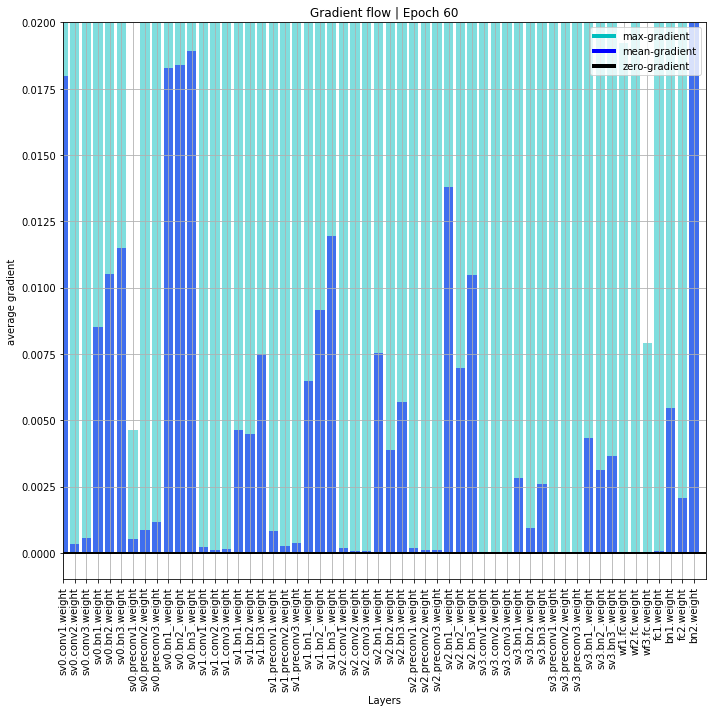

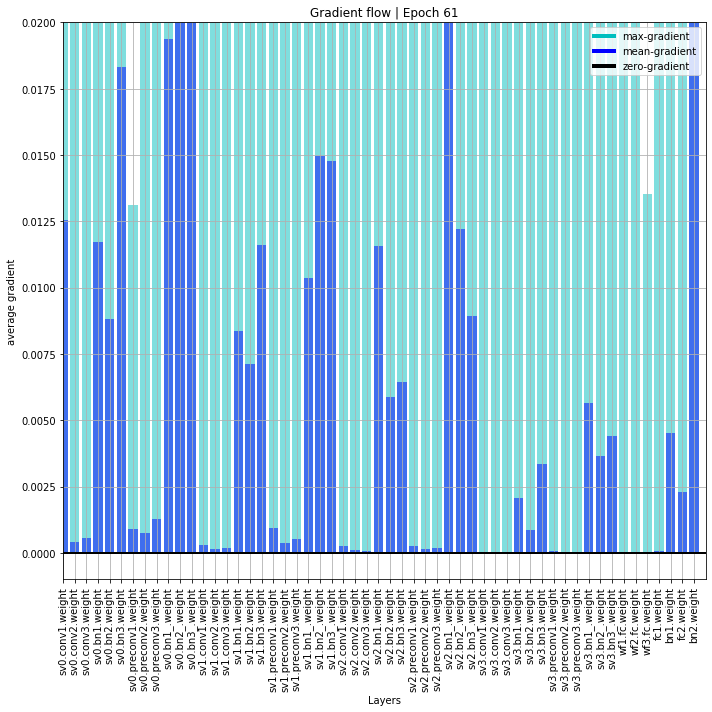

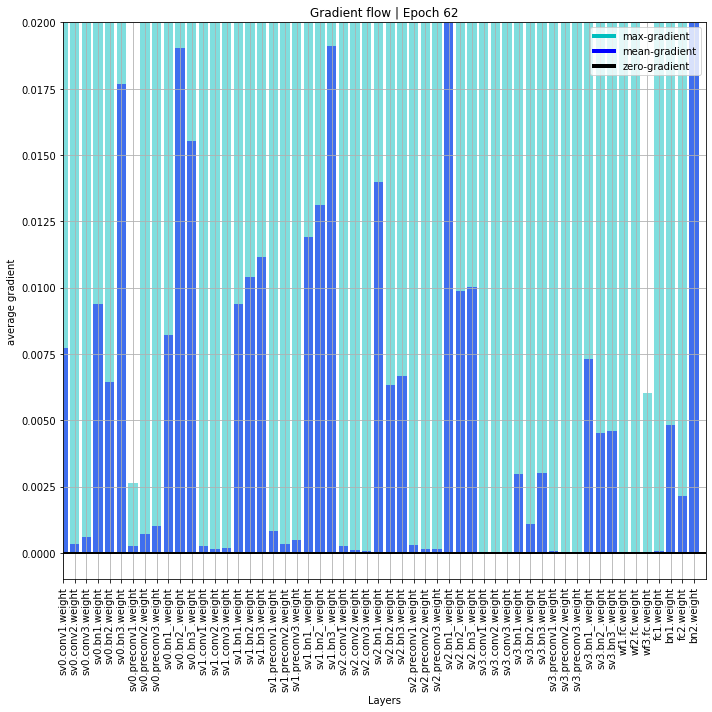

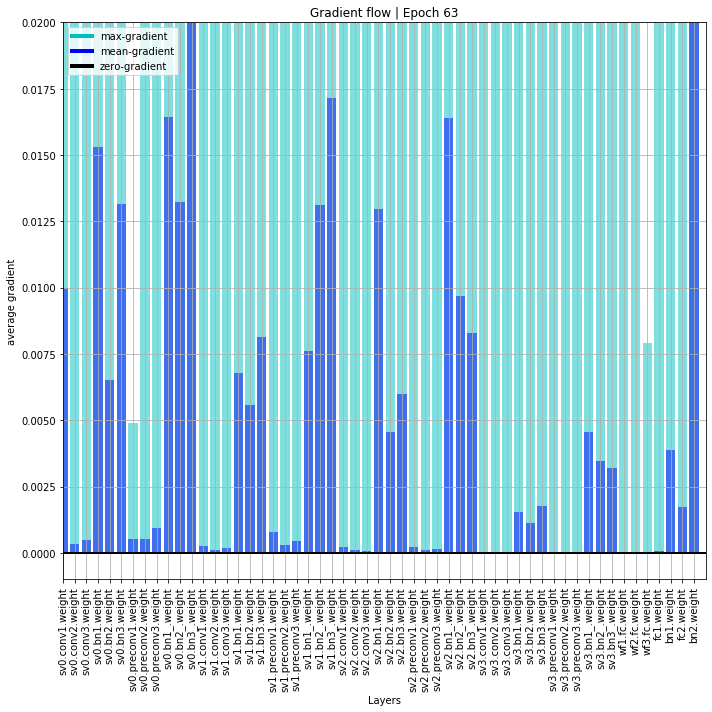

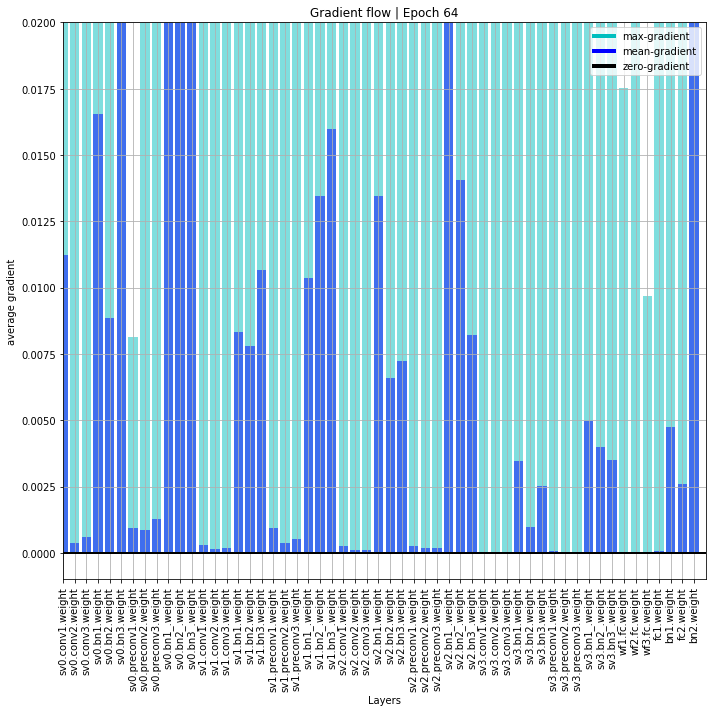

...

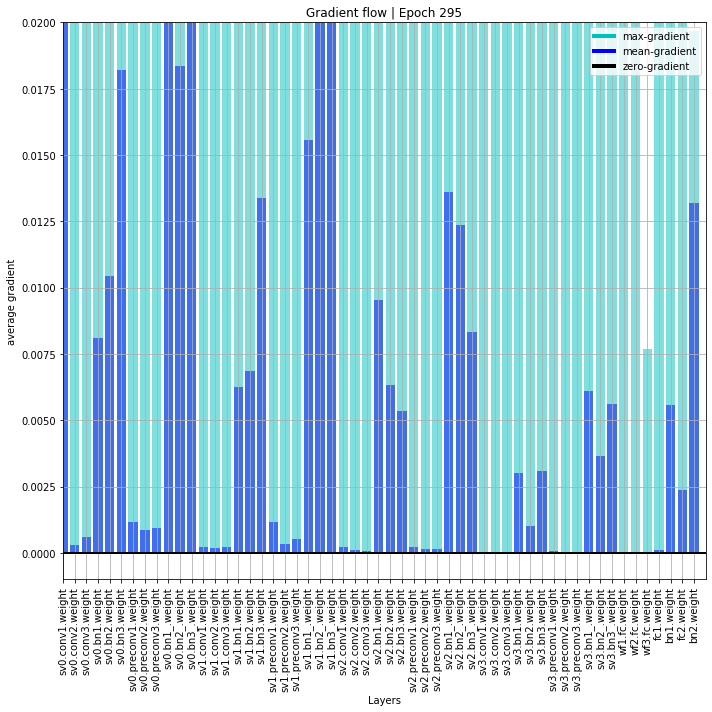

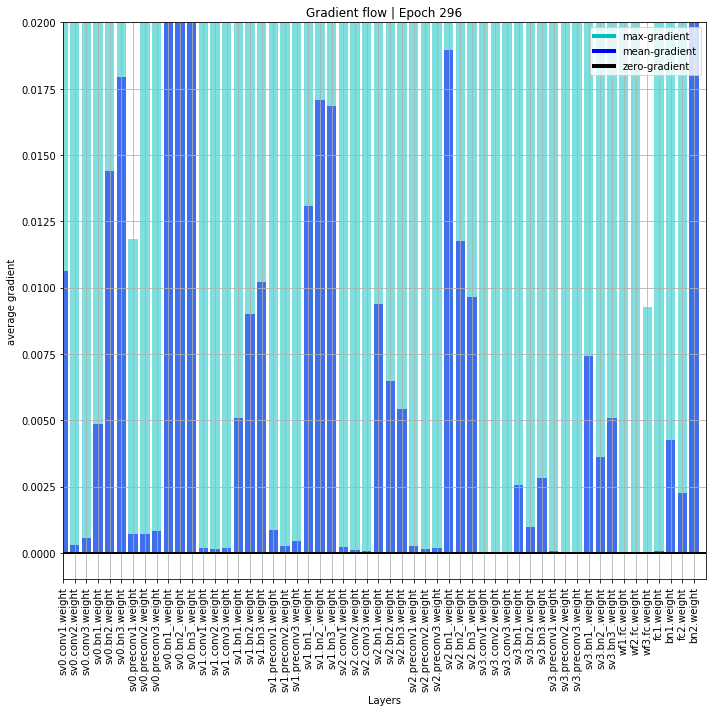

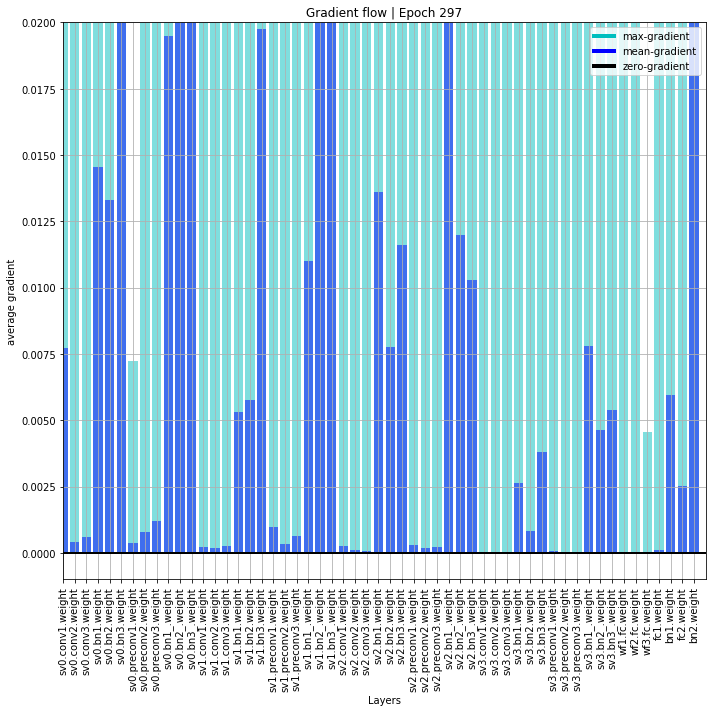

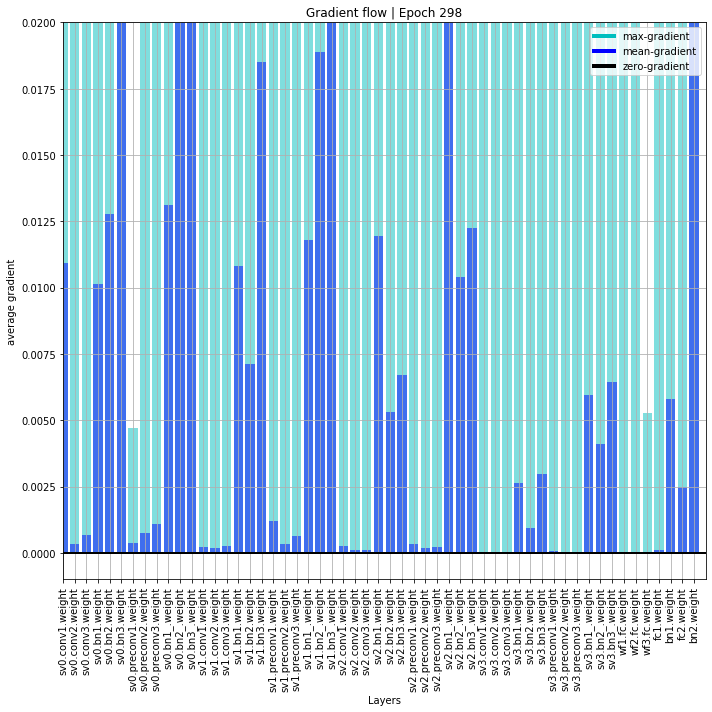

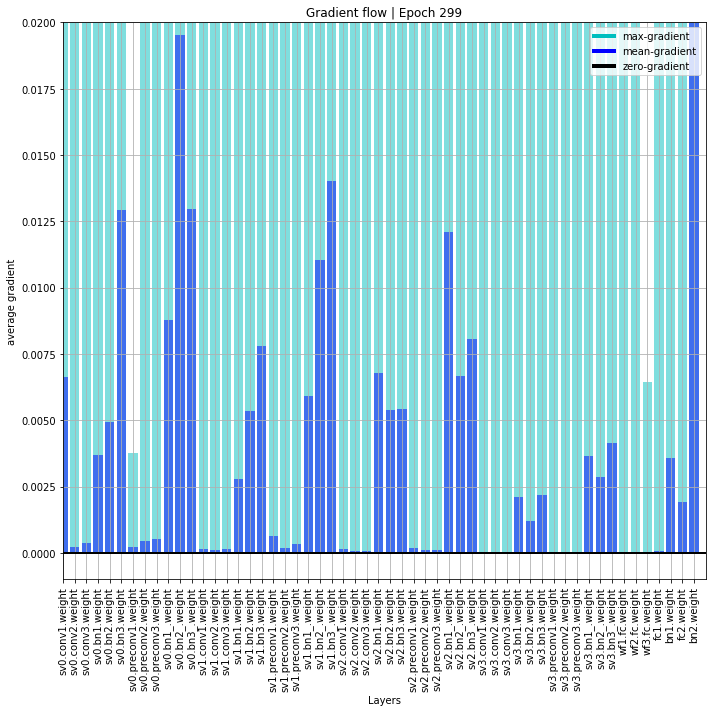

In [29]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet'
model_path = os.path.join(model_folder, model_name + '.pt')

# best_acc = 0.0
# curloss = 0.0
hist2 = []

for epoch in range(60, 300):  # loop over the dataset multiple times
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
        print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist2.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

([<matplotlib.lines.Line2D at 0x7f4074102f60>,
 0.575109649122807,
 1.1480238552679096)

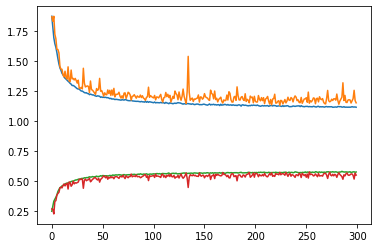

In [32]:
plt.plot(hist + hist2), best_acc, curloss

In [34]:
import imageio
images = []
for i in range(300):
    images.append(imageio.imread('/tf/data/Quan/fer2013/backtobasics/svgg7/svgg_resnet_gf_' + str(i) + '.png'))
imageio.mimsave('/tf/data/Quan/fer2013/backtobasics/svgg7/svgg_resnet_gf.gif', images)

Add one more fc in WeightFeature
Increase depth

## SVGG 7_4 with cleaned data

In [3]:
import torch
from torchvision import transforms, datasets

train_data_transform = transforms.Compose([
        
#         transforms.Lambda(lbp_transform),
#         transforms.Lambda(combine_lbp_hog),
#         transforms.ToPILImage(),
        # transforms.RandomSizedCrop(224),
        transforms.RandomHorizontalFlip(),
#         transforms.RandomVerticalFlip(),
        transforms.RandomRotation(degrees=20),
        transforms.Grayscale(num_output_channels=1),
        transforms.ToTensor(),
        transforms.Normalize((0.5,), (0.5,))
    ])

test_data_transform = transforms.Compose([
        transforms.Grayscale(num_output_channels=1),
        transforms.ToTensor(),
        transforms.Normalize((0.5,), (0.5,))
    ])

train_fer = datasets.ImageFolder(root='/tf/data/Quan/fer2013/cleaned_data/fer2013-clean/Training', transform=train_data_transform)
val_fer = datasets.ImageFolder(root='/tf/data/Quan/fer2013/cleaned_data/fer2013-clean/PublicTest', transform=test_data_transform)
test_fer = datasets.ImageFolder(root='/tf/data/Quan/fer2013/cleaned_data/fer2013-clean/PrivateTest/', transform=test_data_transform)

batch_size = 128
train_loader = torch.utils.data.DataLoader(train_fer,
                                             batch_size=batch_size, shuffle=True,
                                             num_workers=8)
val_loader = torch.utils.data.DataLoader(val_fer,
                                             batch_size=batch_size, shuffle=True,
                                             num_workers=8)
test_loader = torch.utils.data.DataLoader(test_fer,
                                             batch_size=batch_size, shuffle=True,
                                             num_workers=8)

In [4]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [5]:
class WeightFeature(nn.Module):
    def __init__(self, feature_depth):
        super(WeightFeature, self).__init__()

        self.fc1 = nn.Linear(feature_depth, feature_depth)
        self.bn1 = nn.BatchNorm1d(feature_depth)
        self.fc2 = nn.Linear(feature_depth, feature_depth)
        self.bn2 = nn.BatchNorm1d(feature_depth)
        self.fc = nn.Linear(feature_depth, feature_depth)
        self.bn = nn.BatchNorm1d(feature_depth)
        self.sigmoid = nn.Sigmoid()
        
        self.iconv = nn.Conv2d(feature_depth, feature_depth, kernel_size=1, stride=1, padding=0)
        self.ibn = nn.BatchNorm2d(feature_depth)
        
    def forward(self, x):
        x1_avg = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x1_avg = nn.Flatten()(x1_avg)
        x1_avg = self.fc1(x1_avg)
        x1_avg = self.bn1(x1_avg)
        
        x2_avg = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x2_avg = nn.Flatten()(x2_avg)
        x2_avg = self.fc2(x2_avg)
        x2_avg = self.bn2(x2_avg)
        
        cor = torch.matmul(x1_avg.unsqueeze(-1), x2_avg.unsqueeze(1)) # shape feature_depth x feature_depth
        cor = cor / math.sqrt(x1_avg.size(1))
        cor = cor.sum(1)
        cor = self.fc(cor)
        cor = self.bn(cor)
        cor = self.sigmoid(cor)
        cor = cor.unsqueeze(-1).unsqueeze(-1)

        x = self.iconv(x)
        x = self.ibn(x)
        x_out = (1 + cor) * x

        return x_out

In [6]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)
        self.sv4 = SVblock(512, 1024).to(self.device)

        self.wf0 = WeightFeature(64).to(self.device)
        self.wf1 = WeightFeature(128).to(self.device)
        self.wf2 = WeightFeature(256).to(self.device)
        self.wf3 = WeightFeature(512).to(self.device)
        self.wf4 = WeightFeature(1024).to(self.device)

        self.fc1 = nn.Linear(1024, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)
        x_wf0 = self.wf0(x0)

        x1 = self.sv1(x_wf0)
        x_wf1 = self.wf1(x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x3)
        
        x4 = self.sv4(x_wf3)
        x_wf4 = self.wf4(x4)

        x_wf4 = nn.AvgPool2d(kernel_size=(x_wf4.size(-2), x_wf4.size(-1)))(x_wf4)
    
        x = nn.Flatten()(x_wf4)

        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [7]:
from torch.optim import lr_scheduler

device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.004
# reduce_factor = 2
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=8, verbose=True)

cuda


In [8]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet7_4'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(100):

    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
#     plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
#                    savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')
        
    scheduler.step(avgvalloss)

print('Finished Training')

Epoch:  1
- Avg.loss: 1.730  | Avg.acc: 0.324
- Avg. val_loss: 1.604  | Avg. val_acc: 0.391
* Update optimal model
Epoch:  2


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type WeightFeature. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


- Avg.loss: 1.456  | Avg.acc: 0.436
- Avg. val_loss: 1.420  | Avg. val_acc: 0.465
* Update optimal model
Epoch:  3
- Avg.loss: 1.389  | Avg.acc: 0.466
- Avg. val_loss: 1.497  | Avg. val_acc: 0.439
Epoch:  4
- Avg.loss: 1.361  | Avg.acc: 0.478
- Avg. val_loss: 1.380  | Avg. val_acc: 0.455
Epoch:  5
- Avg.loss: 1.345  | Avg.acc: 0.480
- Avg. val_loss: 1.318  | Avg. val_acc: 0.489
* Update optimal model
Epoch:  6
- Avg.loss: 1.331  | Avg.acc: 0.487
- Avg. val_loss: 1.330  | Avg. val_acc: 0.482
Epoch:  7
- Avg.loss: 1.313  | Avg.acc: 0.498
- Avg. val_loss: 1.329  | Avg. val_acc: 0.490
* Update optimal model
Epoch:  8
- Avg.loss: 1.300  | Avg.acc: 0.503
- Avg. val_loss: 1.286  | Avg. val_acc: 0.513
* Update optimal model
Epoch:  9
- Avg.loss: 1.281  | Avg.acc: 0.512
- Avg. val_loss: 1.245  | Avg. val_acc: 0.524
* Update optimal model
Epoch:  10
- Avg.loss: 1.266  | Avg.acc: 0.518
- Avg. val_loss: 1.286  | Avg. val_acc: 0.510
Epoch:  11
- Avg.loss: 1.247  | Avg.acc: 0.525
- Avg. val_loss: 1.

- Avg.loss: 0.866  | Avg.acc: 0.675
- Avg. val_loss: 0.969  | Avg. val_acc: 0.643
* Update optimal model
Epoch:  84
- Avg.loss: 0.861  | Avg.acc: 0.676
- Avg. val_loss: 0.971  | Avg. val_acc: 0.647
* Update optimal model
Epoch:  85
- Avg.loss: 0.859  | Avg.acc: 0.680
- Avg. val_loss: 0.969  | Avg. val_acc: 0.649
* Update optimal model
Epoch:  86
- Avg.loss: 0.856  | Avg.acc: 0.677
- Avg. val_loss: 0.979  | Avg. val_acc: 0.638
Epoch:  87
- Avg.loss: 0.861  | Avg.acc: 0.677
- Avg. val_loss: 0.978  | Avg. val_acc: 0.638
Epoch:  88
- Avg.loss: 0.857  | Avg.acc: 0.677
- Avg. val_loss: 0.992  | Avg. val_acc: 0.635
Epoch:  89
- Avg.loss: 0.849  | Avg.acc: 0.680
- Avg. val_loss: 0.996  | Avg. val_acc: 0.638
Epoch:  90
- Avg.loss: 0.852  | Avg.acc: 0.679
- Avg. val_loss: 1.006  | Avg. val_acc: 0.635
Epoch:  91
- Avg.loss: 0.852  | Avg.acc: 0.679
- Avg. val_loss: 0.997  | Avg. val_acc: 0.629
Epoch:  92
- Avg.loss: 0.854  | Avg.acc: 0.679
- Avg. val_loss: 0.966  | Avg. val_acc: 0.642
Epoch:  93
-

([<matplotlib.lines.Line2D at 0x7fa8ce1c45c0>,
 0.6485745614035088,
 0.9692865871546561)

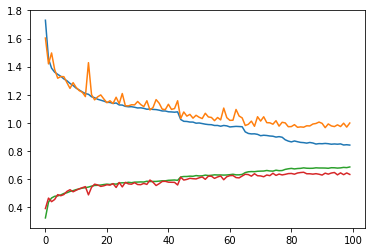

In [9]:
plt.plot(hist), best_acc, curloss

In [10]:
import pickle

pickle.dump(hist, open('/tf/data/Quan/fer2013/backtobasics/svgg7/svgg_resnet7_4_hist.hdf5', 'wb'))

In [12]:
test_model = torch.load('/tf/data/Quan/fer2013/backtobasics/svgg7/svgg_resnet7_4.pt')

test_model.eval()
running_valloss = 0.0
running_valacc = 0.0
for i,data in enumerate(test_loader):
    # get the inputs; data is a list of [inputs, labels]
    inputs, labels = data
    inputs = inputs.to(device)
    labels = labels.to(device)

    outputs = test_model(inputs)
    acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
    loss = criterion(outputs, labels)

    #         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    running_valloss += loss.item()
    running_valacc += acc

print('- Avg. val_loss: %.4f  | Avg. val_acc: %.4f' % (running_valloss / (i+1), running_valacc / (i+1)))

- Avg. val_loss: 0.9448  | Avg. val_acc: 0.6432


## SVGG 7_5

In [4]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [5]:
class WeightFeature(nn.Module):
    def __init__(self, feature_depth):
        super(WeightFeature, self).__init__()

        self.fc1 = nn.Linear(feature_depth, feature_depth)
        self.bn1 = nn.BatchNorm1d(feature_depth)
        self.fc2 = nn.Linear(feature_depth, feature_depth)
        self.bn2 = nn.BatchNorm1d(feature_depth)
#         self.fc = nn.Linear(feature_depth, feature_depth)
#         self.bn = nn.BatchNorm1d(feature_depth)
        self.softmax = nn.Softmax(dim=1)
        
        self.iconv = nn.Conv2d(feature_depth, feature_depth, kernel_size=1, stride=1, padding=0)
        self.ibn = nn.BatchNorm2d(feature_depth)
        
    def forward(self, x):
        x1_avg = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x1_avg = nn.Flatten()(x1_avg)
        x1_avg = self.fc1(x1_avg)
        x1_avg = self.bn1(x1_avg)
        
        x2_avg = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x2_avg = nn.Flatten()(x2_avg)
        x2_avg = self.fc2(x2_avg)
        x2_avg = self.bn2(x2_avg)
        
        cor = torch.matmul(x1_avg.unsqueeze(-1), x2_avg.unsqueeze(1)) # shape feature_depth x feature_depth
        cor = cor / math.sqrt(x1_avg.size(1))
        cor = cor.sum(1)
        cor = self.softmax(cor)
        cor = cor.unsqueeze(-1).unsqueeze(-1)

        x = self.iconv(x)
        x = self.ibn(x)
        
        x_out = (1 + cor) * x

        return x_out

In [6]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)
        self.sv4 = SVblock(512, 1024).to(self.device)

        self.wf0 = WeightFeature(64).to(self.device)
        self.wf1 = WeightFeature(128).to(self.device)
        self.wf2 = WeightFeature(256).to(self.device)
        self.wf3 = WeightFeature(512).to(self.device)
        self.wf4 = WeightFeature(1024).to(self.device)

        self.fc1 = nn.Linear(1024, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)
        x_wf0 = self.wf0(x0)

        x1 = self.sv1(x_wf0)
        x_wf1 = self.wf1(x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x3)
        
        x4 = self.sv4(x_wf3)
        x_wf4 = self.wf4(x4)

        x_wf4 = nn.AvgPool2d(kernel_size=(x_wf4.size(-2), x_wf4.size(-1)))(x_wf4)
    
        x = nn.Flatten()(x_wf4)

        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [7]:
from torch.optim import lr_scheduler

device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.004
# reduce_factor = 2
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=8, verbose=True)

cuda


In [8]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet7_5'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(100):

    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
#     plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
#                    savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')
        
    scheduler.step(avgvalloss)

print('Finished Training')

Epoch:  1
- Avg.loss: 1.768  | Avg.acc: 0.293
- Avg. val_loss: 1.562  | Avg. val_acc: 0.402
* Update optimal model
Epoch:  2


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type WeightFeature. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


- Avg.loss: 1.466  | Avg.acc: 0.439
- Avg. val_loss: 1.465  | Avg. val_acc: 0.431
* Update optimal model
Epoch:  3
- Avg.loss: 1.376  | Avg.acc: 0.469
- Avg. val_loss: 1.409  | Avg. val_acc: 0.469
* Update optimal model
Epoch:  4
- Avg.loss: 1.338  | Avg.acc: 0.490
- Avg. val_loss: 1.394  | Avg. val_acc: 0.459
Epoch:  5
- Avg.loss: 1.312  | Avg.acc: 0.499
- Avg. val_loss: 1.302  | Avg. val_acc: 0.488
* Update optimal model
Epoch:  6
- Avg.loss: 1.292  | Avg.acc: 0.507
- Avg. val_loss: 1.269  | Avg. val_acc: 0.509
* Update optimal model
Epoch:  7
- Avg.loss: 1.278  | Avg.acc: 0.513
- Avg. val_loss: 1.293  | Avg. val_acc: 0.520
* Update optimal model
Epoch:  8
- Avg.loss: 1.272  | Avg.acc: 0.516
- Avg. val_loss: 1.513  | Avg. val_acc: 0.458
Epoch:  9
- Avg.loss: 1.261  | Avg.acc: 0.521
- Avg. val_loss: 1.409  | Avg. val_acc: 0.467
Epoch:  10
- Avg.loss: 1.234  | Avg.acc: 0.530
- Avg. val_loss: 1.510  | Avg. val_acc: 0.443
Epoch:  11
- Avg.loss: 1.229  | Avg.acc: 0.531
- Avg. val_loss: 1.

- Avg.loss: 0.769  | Avg.acc: 0.716
- Avg. val_loss: 1.040  | Avg. val_acc: 0.639
Epoch:  84
- Avg.loss: 0.766  | Avg.acc: 0.717
- Avg. val_loss: 0.997  | Avg. val_acc: 0.650
Epoch    84: reducing learning rate of group 0 to 5.0000e-04.
Epoch:  85
- Avg.loss: 0.738  | Avg.acc: 0.727
- Avg. val_loss: 0.965  | Avg. val_acc: 0.666
* Update optimal model
Epoch:  86
- Avg.loss: 0.730  | Avg.acc: 0.731
- Avg. val_loss: 0.989  | Avg. val_acc: 0.644
Epoch:  87
- Avg.loss: 0.724  | Avg.acc: 0.732
- Avg. val_loss: 0.974  | Avg. val_acc: 0.649
Epoch:  88
- Avg.loss: 0.718  | Avg.acc: 0.734
- Avg. val_loss: 0.966  | Avg. val_acc: 0.662
Epoch:  89
- Avg.loss: 0.715  | Avg.acc: 0.736
- Avg. val_loss: 0.981  | Avg. val_acc: 0.661
Epoch:  90
- Avg.loss: 0.712  | Avg.acc: 0.740
- Avg. val_loss: 0.963  | Avg. val_acc: 0.660
Epoch:  91
- Avg.loss: 0.712  | Avg.acc: 0.737
- Avg. val_loss: 0.990  | Avg. val_acc: 0.645
Epoch:  92
- Avg.loss: 0.705  | Avg.acc: 0.740
- Avg. val_loss: 1.005  | Avg. val_acc: 0.

([<matplotlib.lines.Line2D at 0x7f7f4555f780>,
 0.6662176724137931,
 0.9651398329899229)

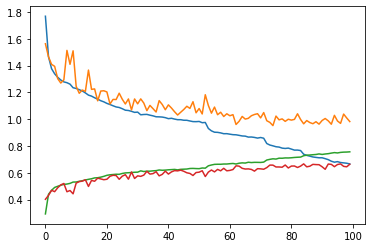

In [10]:
plt.plot(hist), best_acc, curloss

In [11]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet7_5'
model_path = os.path.join(model_folder, model_name + '.pt')


for epoch in range(100, 150):

    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
#     plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
#                    savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')
        
    scheduler.step(avgvalloss)

print('Finished Training')

Epoch:  101
- Avg.loss: 0.667  | Avg.acc: 0.753
- Avg. val_loss: 0.984  | Avg. val_acc: 0.664
Epoch:  102
- Avg.loss: 0.662  | Avg.acc: 0.761
- Avg. val_loss: 0.988  | Avg. val_acc: 0.664
Epoch   102: reducing learning rate of group 0 to 1.2500e-04.
Epoch:  103
- Avg.loss: 0.662  | Avg.acc: 0.757
- Avg. val_loss: 1.013  | Avg. val_acc: 0.644
Epoch:  104
- Avg.loss: 0.652  | Avg.acc: 0.762
- Avg. val_loss: 0.995  | Avg. val_acc: 0.649
Epoch:  105
- Avg.loss: 0.653  | Avg.acc: 0.763
- Avg. val_loss: 1.013  | Avg. val_acc: 0.643
Epoch:  106
- Avg.loss: 0.652  | Avg.acc: 0.761
- Avg. val_loss: 0.995  | Avg. val_acc: 0.648
Epoch:  107
- Avg.loss: 0.649  | Avg.acc: 0.761
- Avg. val_loss: 1.006  | Avg. val_acc: 0.647
Epoch:  108
- Avg.loss: 0.653  | Avg.acc: 0.763
- Avg. val_loss: 1.026  | Avg. val_acc: 0.646
Epoch:  109
- Avg.loss: 0.647  | Avg.acc: 0.762
- Avg. val_loss: 0.982  | Avg. val_acc: 0.669
* Update optimal model
Epoch:  110
- Avg.loss: 0.645  | Avg.acc: 0.764
- Avg. val_loss: 0.98

([<matplotlib.lines.Line2D at 0x7f7f44fdf1d0>,
 0.6697198275862069,
 1.0019045246058498)

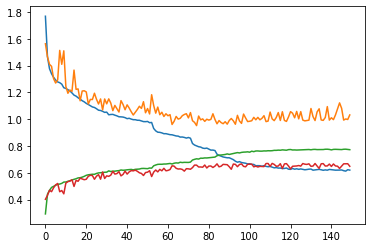

In [12]:
plt.plot(hist), best_acc, curloss

In [13]:
import pickle 

pickle.dump(hist, open('/tf/data/Quan/fer2013/backtobasics/svgg7/svgg_resnet7_5_hist.hdf5', 'wb'))

In [14]:
test_model = torch.load('/tf/data/Quan/fer2013/backtobasics/svgg7/svgg_resnet7_5.pt')

# EVALUATE
test_model.eval()
running_valloss = 0.0
running_valacc = 0.0
for i,data in enumerate(val_loader):
    # get the inputs; data is a list of [inputs, labels]
    inputs, labels = data
    inputs = inputs.to(device)
    labels = labels.to(device)

    outputs = test_model(inputs)
    acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
    loss = criterion(outputs, labels)

    #         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    running_valloss += loss.item()
    running_valacc += acc

print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

- Avg. val_loss: 1.015  | Avg. val_acc: 0.653


## SVGG 7_6 (Pending)

In [4]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [5]:
class WeightFeature(nn.Module):
    def __init__(self, feature_depth):
        super(WeightFeature, self).__init__()

        self.fc1 = nn.Linear(feature_depth, feature_depth)
        self.bn1 = nn.BatchNorm1d(feature_depth)
        self.fc2 = nn.Linear(feature_depth, feature_depth)
        self.bn2 = nn.BatchNorm1d(feature_depth)
        self.softmax = nn.Softmax(dim=1)
        
        self.iconv = nn.Conv2d(feature_depth, feature_depth, kernel_size=1, stride=1, padding=0)
        self.ibn = nn.BatchNorm2d(feature_depth)
        
        self.relu = nn.LeakyReLU()
        
    def forward(self, x):
        x1_avg = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x1_avg = nn.Flatten()(x1_avg)
        x1_avg = self.fc1(x1_avg)
        x1_avg = self.bn1(x1_avg)
        
        x2_avg = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x2_avg = nn.Flatten()(x2_avg)
        x2_avg = self.fc2(x2_avg)
        x2_avg = self.bn2(x2_avg)
        
        cor = torch.matmul(x1_avg.unsqueeze(-1), x2_avg.unsqueeze(1)) # shape feature_depth x feature_depth
#         cor = cor / math.sqrt(x1_avg.size(1))
        cor = cor.mean(1)
        cor = self.softmax(cor)
        cor = cor.unsqueeze(-1).unsqueeze(-1)

        x = self.iconv(x)
        x = self.ibn(x)
        
        x_out = (1 + cor) * x
        
        x_out = self.relu(x_out)

        return x_out

In [6]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)
        self.sv4 = SVblock(512, 1024).to(self.device)

        self.wf0 = WeightFeature(64).to(self.device)
        self.wf1 = WeightFeature(128).to(self.device)
        self.wf2 = WeightFeature(256).to(self.device)
        self.wf3 = WeightFeature(512).to(self.device)
        self.wf4 = WeightFeature(1024).to(self.device)

        self.fc1 = nn.Linear(1024, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)
        x_wf0 = self.wf0(x0)

        x1 = self.sv1(x_wf0)
        x_wf1 = self.wf1(x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x3)
        
        x4 = self.sv4(x_wf3)
        x_wf4 = self.wf4(x4)

        x_wf4 = nn.AvgPool2d(kernel_size=(x_wf4.size(-2), x_wf4.size(-1)))(x_wf4)
    
        x = nn.Flatten()(x_wf4)

        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [7]:
from torch.optim import lr_scheduler

device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.004
# reduce_factor = 2
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=8, verbose=True)

cuda


In [8]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet7_6'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(100):

    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
#     plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
#                    savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')
        
    scheduler.step(avgvalloss)

print('Finished Training')

Epoch:  1
- Avg.loss: 1.905  | Avg.acc: 0.216
- Avg. val_loss: 1.736  | Avg. val_acc: 0.316
* Update optimal model
Epoch:  2


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type WeightFeature. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


- Avg.loss: 1.637  | Avg.acc: 0.351
- Avg. val_loss: 1.554  | Avg. val_acc: 0.390
* Update optimal model
Epoch:  3
- Avg.loss: 1.431  | Avg.acc: 0.447
- Avg. val_loss: 1.482  | Avg. val_acc: 0.425
* Update optimal model
Epoch:  4
- Avg.loss: 1.356  | Avg.acc: 0.481
- Avg. val_loss: 1.365  | Avg. val_acc: 0.482
* Update optimal model
Epoch:  5
- Avg.loss: 1.317  | Avg.acc: 0.499
- Avg. val_loss: 1.330  | Avg. val_acc: 0.492
* Update optimal model
Epoch:  6
- Avg.loss: 1.289  | Avg.acc: 0.509
- Avg. val_loss: 1.360  | Avg. val_acc: 0.479
Epoch:  7
- Avg.loss: 1.268  | Avg.acc: 0.517
- Avg. val_loss: 1.310  | Avg. val_acc: 0.496
* Update optimal model
Epoch:  8
- Avg.loss: 1.254  | Avg.acc: 0.521
- Avg. val_loss: 1.307  | Avg. val_acc: 0.488
Epoch:  9
- Avg.loss: 1.240  | Avg.acc: 0.530
- Avg. val_loss: 1.274  | Avg. val_acc: 0.521
* Update optimal model
Epoch:  10
- Avg.loss: 1.229  | Avg.acc: 0.532
- Avg. val_loss: 1.201  | Avg. val_acc: 0.554
* Update optimal model
Epoch:  11
- Avg.los

KeyboardInterrupt: 

## SVGG 7_7

In [5]:
import torch
from torchvision import transforms, datasets

train_data_transform = transforms.Compose([
        
#         transforms.Lambda(lbp_transform),
#         transforms.Lambda(combine_lbp_hog),
#         transforms.ToPILImage(),
        # transforms.RandomSizedCrop(224),
        transforms.RandomHorizontalFlip(),
#         transforms.RandomVerticalFlip(),
        transforms.RandomRotation(degrees=20),
        transforms.Grayscale(num_output_channels=1),
        transforms.ToTensor(),
        transforms.Normalize((0.5,), (0.5,))
    ])

test_data_transform = transforms.Compose([
        transforms.Grayscale(num_output_channels=1),
        transforms.ToTensor(),
        transforms.Normalize((0.5,), (0.5,))
    ])

train_fer = datasets.ImageFolder(root='/tf/data/Quan/fer2013/cleaned_data/fer2013-clean/Training', transform=train_data_transform)
val_fer = datasets.ImageFolder(root='/tf/data/Quan/fer2013/cleaned_data/fer2013-clean/PublicTest', transform=test_data_transform)
test_fer = datasets.ImageFolder(root='/tf/data/Quan/fer2013/cleaned_data/fer2013-clean/PrivateTest/', transform=test_data_transform)

batch_size = 128
train_loader = torch.utils.data.DataLoader(train_fer,
                                             batch_size=batch_size, shuffle=True,
                                             num_workers=8)
val_loader = torch.utils.data.DataLoader(val_fer,
                                             batch_size=batch_size, shuffle=True,
                                             num_workers=8)
test_loader = torch.utils.data.DataLoader(test_fer,
                                             batch_size=batch_size, shuffle=True,
                                             num_workers=8)

In [4]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = x1 + x0_res
        x1 = self.relu(x1)
        
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = x2 + x1_res
        x2 = self.relu(x2)
        
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = x3 + x2_res
        x3 = self.relu(x3)

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [5]:
class WeightFeature(nn.Module):
    def __init__(self, feature_depth, emb_dim):
        super(WeightFeature, self).__init__()

        self.fc1 = nn.Linear(feature_depth, emb_dim)
        self.bn1 = nn.BatchNorm1d(emb_dim)
        self.fc2 = nn.Linear(feature_depth, emb_dim)
        self.bn2 = nn.BatchNorm1d(emb_dim)
        
        self.cor_fc = nn.Linear(emb_dim*emb_dim, feature_depth)
        self.cor_bn = nn.BatchNorm1d(feature_depth)
        self.softmax = nn.Softmax(dim=1)
        
        self.iconv = nn.Conv2d(feature_depth, feature_depth, kernel_size=1, stride=1, padding=0)
        self.ibn = nn.BatchNorm2d(feature_depth)
        
        self.relu = nn.LeakyReLU()
        
    def forward(self, x):
        x1_avg = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x1_avg = nn.Flatten()(x1_avg)
        x1_avg = self.fc1(x1_avg)
        x1_avg = self.bn1(x1_avg)
        
        x2_avg = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x2_avg = nn.Flatten()(x2_avg)
        x2_avg = self.fc2(x2_avg)
        x2_avg = self.bn2(x2_avg)
        
        cor = torch.matmul(x1_avg.unsqueeze(-1), x2_avg.unsqueeze(1)) # shape feature_depth x feature_depth
        cor = nn.Flatten()(cor)
        cor = self.cor_fc(cor)
        cor = self.cor_bn(cor)
        cor = self.softmax(cor)
        cor = cor.unsqueeze(-1).unsqueeze(-1)

        x = self.iconv(x)
        x = self.ibn(x)
        
        x_out = (1 + cor) * x
        
        x_out = self.relu(x_out)

        return x_out

In [6]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)
        self.sv4 = SVblock(512, 1024).to(self.device)

        self.wf0 = WeightFeature(64, emb_dim=16).to(self.device)
        self.wf1 = WeightFeature(128, emb_dim=32).to(self.device)
        self.wf2 = WeightFeature(256, emb_dim=64).to(self.device)
        self.wf3 = WeightFeature(512, emb_dim=128).to(self.device)
        self.wf4 = WeightFeature(1024, emb_dim=256).to(self.device)

        self.fc1 = nn.Linear(1024, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)
        x_wf0 = self.wf0(x0)

        x1 = self.sv1(x_wf0)
        x_wf1 = self.wf1(x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x3)
        
        x4 = self.sv4(x_wf3)
        x_wf4 = self.wf4(x4)

        x_wf4 = nn.AvgPool2d(kernel_size=(x_wf4.size(-2), x_wf4.size(-1)))(x_wf4)
    
        x = nn.Flatten()(x_wf4)

        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [7]:
from torch.optim import lr_scheduler

device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.004
# reduce_factor = 2
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=8, verbose=True)

cuda


In [8]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet7_7'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(100):

    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
#     plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
#                    savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')
        
    scheduler.step(avgvalloss)

print('Finished Training')

Epoch:  1
- Avg.loss: 1.880  | Avg.acc: 0.255
- Avg. val_loss: 1.756  | Avg. val_acc: 0.289


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type WeightFeature. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


* Update optimal model
Epoch:  2
- Avg.loss: 1.666  | Avg.acc: 0.327
- Avg. val_loss: 1.549  | Avg. val_acc: 0.391
* Update optimal model
Epoch:  3
- Avg.loss: 1.493  | Avg.acc: 0.402
- Avg. val_loss: 1.424  | Avg. val_acc: 0.445
* Update optimal model
Epoch:  4
- Avg.loss: 1.422  | Avg.acc: 0.431
- Avg. val_loss: 1.413  | Avg. val_acc: 0.443
Epoch:  5
- Avg.loss: 1.364  | Avg.acc: 0.469
- Avg. val_loss: 1.325  | Avg. val_acc: 0.482
* Update optimal model
Epoch:  6
- Avg.loss: 1.325  | Avg.acc: 0.484
- Avg. val_loss: 1.293  | Avg. val_acc: 0.502
* Update optimal model
Epoch:  7
- Avg.loss: 1.299  | Avg.acc: 0.497
- Avg. val_loss: 1.302  | Avg. val_acc: 0.496
Epoch:  8
- Avg.loss: 1.272  | Avg.acc: 0.508
- Avg. val_loss: 1.243  | Avg. val_acc: 0.527
* Update optimal model
Epoch:  9
- Avg.loss: 1.257  | Avg.acc: 0.518
- Avg. val_loss: 1.260  | Avg. val_acc: 0.517
Epoch:  10
- Avg.loss: 1.238  | Avg.acc: 0.526
- Avg. val_loss: 1.277  | Avg. val_acc: 0.512
Epoch:  11
- Avg.loss: 1.223  | A

- Avg. val_loss: 0.978  | Avg. val_acc: 0.635
Epoch:  84
- Avg.loss: 0.882  | Avg.acc: 0.668
- Avg. val_loss: 0.995  | Avg. val_acc: 0.619
Epoch:  85
- Avg.loss: 0.882  | Avg.acc: 0.670
- Avg. val_loss: 1.004  | Avg. val_acc: 0.625
Epoch:  86
- Avg.loss: 0.883  | Avg.acc: 0.669
- Avg. val_loss: 0.979  | Avg. val_acc: 0.634
Epoch    86: reducing learning rate of group 0 to 5.0000e-04.
Epoch:  87
- Avg.loss: 0.858  | Avg.acc: 0.678
- Avg. val_loss: 0.967  | Avg. val_acc: 0.638
Epoch:  88
- Avg.loss: 0.853  | Avg.acc: 0.681
- Avg. val_loss: 0.973  | Avg. val_acc: 0.641
* Update optimal model
Epoch:  89
- Avg.loss: 0.848  | Avg.acc: 0.683
- Avg. val_loss: 0.985  | Avg. val_acc: 0.634
Epoch:  90
- Avg.loss: 0.844  | Avg.acc: 0.687
- Avg. val_loss: 0.959  | Avg. val_acc: 0.646
* Update optimal model
Epoch:  91
- Avg.loss: 0.839  | Avg.acc: 0.690
- Avg. val_loss: 0.995  | Avg. val_acc: 0.625
Epoch:  92
- Avg.loss: 0.844  | Avg.acc: 0.688
- Avg. val_loss: 0.956  | Avg. val_acc: 0.653
* Update 

In [9]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet7_7'
model_path = os.path.join(model_folder, model_name + '.pt')

# best_acc = 0.0
# curloss = 0.0
# hist = []

for epoch in range(100, 150):

    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
#     plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
#                    savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')
        
    scheduler.step(avgvalloss)

print('Finished Training')

Epoch:  101
- Avg.loss: 0.831  | Avg.acc: 0.691
- Avg. val_loss: 0.992  | Avg. val_acc: 0.633
Epoch:  102
- Avg.loss: 0.826  | Avg.acc: 0.693
- Avg. val_loss: 0.955  | Avg. val_acc: 0.650
Epoch:  103
- Avg.loss: 0.826  | Avg.acc: 0.691
- Avg. val_loss: 0.998  | Avg. val_acc: 0.636
Epoch:  104
- Avg.loss: 0.820  | Avg.acc: 0.693
- Avg. val_loss: 0.969  | Avg. val_acc: 0.634
Epoch:  105
- Avg.loss: 0.816  | Avg.acc: 0.698
- Avg. val_loss: 0.975  | Avg. val_acc: 0.636
Epoch:  106
- Avg.loss: 0.819  | Avg.acc: 0.695
- Avg. val_loss: 0.974  | Avg. val_acc: 0.635
Epoch:  107
- Avg.loss: 0.819  | Avg.acc: 0.698
- Avg. val_loss: 0.978  | Avg. val_acc: 0.637
Epoch:  108
- Avg.loss: 0.815  | Avg.acc: 0.694
- Avg. val_loss: 0.994  | Avg. val_acc: 0.641
Epoch:  109
- Avg.loss: 0.824  | Avg.acc: 0.693
- Avg. val_loss: 0.984  | Avg. val_acc: 0.639
Epoch   109: reducing learning rate of group 0 to 2.5000e-04.
Epoch:  110
- Avg.loss: 0.804  | Avg.acc: 0.703
- Avg. val_loss: 0.963  | Avg. val_acc: 0.64

## SVGG 7_8 (Optimal)

In [6]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = x1 + x0_res
        x1 = self.relu(x1)
        
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = x2 + x1_res
        x2 = self.relu(x2)
        
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = x3 + x2_res
        x3 = self.relu(x3)

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [7]:
class WeightFeature(nn.Module):
    def __init__(self, feature_depth, emb_dim):
        super(WeightFeature, self).__init__()

        self.fc1 = nn.Linear(feature_depth, emb_dim)
        self.bn1 = nn.BatchNorm1d(emb_dim)
        self.fc2 = nn.Linear(feature_depth, emb_dim)
        self.bn2 = nn.BatchNorm1d(emb_dim)
        
        self.cor_fc = nn.Conv1d(1, 1, kernel_size=emb_dim, stride=emb_dim, padding=0)
        self.cor_bn = nn.BatchNorm1d(1)
        self.softmax = nn.Softmax(dim=1)
        
        self.iconv = nn.Conv2d(feature_depth, feature_depth, kernel_size=1, stride=1, padding=0)
        self.ibn = nn.BatchNorm2d(feature_depth)
        
        self.relu = nn.LeakyReLU()
        
    def forward(self, x):
        x1_avg = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x1_avg = nn.Flatten()(x1_avg)
        x1_avg = self.fc1(x1_avg)
        x1_avg = self.bn1(x1_avg)
        
        x2_avg = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x2_avg = nn.Flatten()(x2_avg)
        x2_avg = self.fc2(x2_avg)
        x2_avg = self.bn2(x2_avg)
        
        cor = torch.matmul(x1_avg.unsqueeze(-1), x2_avg.unsqueeze(1)) # shape feature_depth x feature_depth
        cor = nn.Flatten()(cor)
        cor = cor.unsqueeze(1)
        
        cor = self.cor_fc(cor)
        cor = self.cor_bn(cor)
        
        cor = cor.squeeze(1)
        
        cor = self.softmax(cor)
        cor = cor.unsqueeze(-1).unsqueeze(-1)

        x = self.iconv(x)
        x = self.ibn(x)
        
        x_out = (1 + cor) * x
        
        x_out = self.relu(x_out)

        return x_out

In [8]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)
        self.sv4 = SVblock(512, 1024).to(self.device)

        self.wf0 = WeightFeature(64, emb_dim=64).to(self.device)
        self.wf1 = WeightFeature(128, emb_dim=128).to(self.device)
        self.wf2 = WeightFeature(256, emb_dim=256).to(self.device)
        self.wf3 = WeightFeature(512, emb_dim=512).to(self.device)
        self.wf4 = WeightFeature(1024, emb_dim=1024).to(self.device)

        self.fc1 = nn.Linear(1024, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)
        x_wf0 = self.wf0(x0)

        x1 = self.sv1(x_wf0)
        x_wf1 = self.wf1(x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x3)
        
        x4 = self.sv4(x_wf3)
        x_wf4 = self.wf4(x4)

        x_wf4 = nn.AvgPool2d(kernel_size=(x_wf4.size(-2), x_wf4.size(-1)))(x_wf4)
    
        x = nn.Flatten()(x_wf4)

        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [9]:
from torch.optim import lr_scheduler

device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.004
# reduce_factor = 2
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
scheduler = lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=8, verbose=True)

cuda


In [10]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet7_8'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(100):

    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
#     plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
#                    savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')
        
    scheduler.step(avgvalloss)

print('Finished Training')

Epoch:  1
- Avg.loss: 1.843  | Avg.acc: 0.249
- Avg. val_loss: 1.726  | Avg. val_acc: 0.303
* Update optimal model
Epoch:  2


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type WeightFeature. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


- Avg.loss: 1.631  | Avg.acc: 0.352
- Avg. val_loss: 1.488  | Avg. val_acc: 0.416
* Update optimal model
Epoch:  3
- Avg.loss: 1.390  | Avg.acc: 0.462
- Avg. val_loss: 1.409  | Avg. val_acc: 0.462
* Update optimal model
Epoch:  4
- Avg.loss: 1.306  | Avg.acc: 0.498
- Avg. val_loss: 1.476  | Avg. val_acc: 0.447
Epoch:  5
- Avg.loss: 1.270  | Avg.acc: 0.516
- Avg. val_loss: 1.329  | Avg. val_acc: 0.464
* Update optimal model
Epoch:  6
- Avg.loss: 1.247  | Avg.acc: 0.527
- Avg. val_loss: 1.311  | Avg. val_acc: 0.499
* Update optimal model
Epoch:  7
- Avg.loss: 1.216  | Avg.acc: 0.539
- Avg. val_loss: 1.316  | Avg. val_acc: 0.508
* Update optimal model
Epoch:  8
- Avg.loss: 1.200  | Avg.acc: 0.546
- Avg. val_loss: 1.336  | Avg. val_acc: 0.516
* Update optimal model
Epoch:  9
- Avg.loss: 1.181  | Avg.acc: 0.552
- Avg. val_loss: 1.204  | Avg. val_acc: 0.547
* Update optimal model
Epoch:  10
- Avg.loss: 1.167  | Avg.acc: 0.558
- Avg. val_loss: 1.453  | Avg. val_acc: 0.467
Epoch:  11
- Avg.los

- Avg.loss: 0.591  | Avg.acc: 0.787
- Avg. val_loss: 0.973  | Avg. val_acc: 0.676
* Update optimal model
Epoch:  83
- Avg.loss: 0.584  | Avg.acc: 0.791
- Avg. val_loss: 1.092  | Avg. val_acc: 0.638
Epoch:  84
- Avg.loss: 0.580  | Avg.acc: 0.790
- Avg. val_loss: 1.066  | Avg. val_acc: 0.655
Epoch:  85
- Avg.loss: 0.575  | Avg.acc: 0.794
- Avg. val_loss: 1.099  | Avg. val_acc: 0.638
Epoch:  86
- Avg.loss: 0.573  | Avg.acc: 0.794
- Avg. val_loss: 1.013  | Avg. val_acc: 0.655
Epoch:  87
- Avg.loss: 0.569  | Avg.acc: 0.795
- Avg. val_loss: 1.041  | Avg. val_acc: 0.636
Epoch:  88
- Avg.loss: 0.572  | Avg.acc: 0.793
- Avg. val_loss: 0.988  | Avg. val_acc: 0.676
Epoch:  89
- Avg.loss: 0.564  | Avg.acc: 0.797
- Avg. val_loss: 1.015  | Avg. val_acc: 0.659
Epoch:  90
- Avg.loss: 0.560  | Avg.acc: 0.796
- Avg. val_loss: 1.047  | Avg. val_acc: 0.654
Epoch    90: reducing learning rate of group 0 to 6.2500e-05.
Epoch:  91
- Avg.loss: 0.553  | Avg.acc: 0.798
- Avg. val_loss: 1.006  | Avg. val_acc: 0.

([<matplotlib.lines.Line2D at 0x7f3f30c34d30>,
 0.6759159482758621,
 0.9731832907117647)

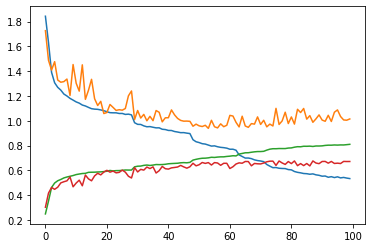

In [11]:
plt.plot(hist), best_acc, curloss

In [13]:
import pickle
pickle.dump(hist, open('/tf/data/Quan/fer2013/backtobasics/svgg7/svgg_resnet7_8_hist,hdf5', 'wb'))

In [ ]:
test_model = torch.load('/tf/data/Quan/fer2013/backtobasics/svgg7/')

## SVGG7-3

In [5]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [6]:
class WeightFeature(nn.Module):
    def __init__(self, feature_depth, target_depth):
        super(WeightFeature, self).__init__()

        self.target_depth = target_depth
        self.fc = nn.Linear(feature_depth*target_depth, target_depth)
        self.sigmoid = nn.Sigmoid()
        self.bn_out = nn.BatchNorm2d(target_depth)
        
    def forward(self, x1, x2):
        x1_avg = nn.AvgPool2d(kernel_size=(x1.size(-2), x1.size(-1)))(x1)
        x1_avg = nn.Flatten()(x1_avg)
        x2_avg = nn.AvgPool2d(kernel_size=(x2.size(-2), x2.size(-1)))(x2)
        x2_avg = nn.Flatten()(x2_avg)
        
        cor = torch.matmul(x1_avg.unsqueeze(-1), x2_avg.unsqueeze(1)) # shape feature_depth x target_depth
        cor = nn.Flatten()(cor)
        cor = self.fc(cor)
        cor = self.sigmoid(cor)
        cor = cor.unsqueeze(-1).unsqueeze(-1)

        x_out = (x2 * cor) / (x2.mean())
        x_out = nn.ReLU()(x_out)
        x_out = self.bn_out(x_out)

        return x_out

In [7]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)

        self.wf1 = WeightFeature(64, 128).to(self.device)
        self.wf2 = WeightFeature(128, 256).to(self.device)
        self.wf3 = WeightFeature(256, 512).to(self.device)

        self.fc1 = nn.Linear(512, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)

        x1 = self.sv1(x0)
        x_wf1 = self.wf1(x0, x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x1, x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x2, x3)

        x_wf3 = nn.AvgPool2d(kernel_size=(x_wf3.size(-2), x_wf3.size(-1)))(x_wf3)
    
        x = nn.Flatten()(x_wf3)

        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [8]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.005, weight_decay=1e-3)


cuda


Epoch:  1
- Avg.loss: 1.857  | Avg.acc: 0.238
- Avg. val_loss: 1.877  | Avg. val_acc: 0.235


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type WeightFeature. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


* Update optimal model
Epoch:  2
- Avg.loss: 1.793  | Avg.acc: 0.257
- Avg. val_loss: 1.815  | Avg. val_acc: 0.252
* Update optimal model
Epoch:  3
- Avg.loss: 1.780  | Avg.acc: 0.263
- Avg. val_loss: 1.837  | Avg. val_acc: 0.246
Epoch:  4
- Avg.loss: 1.762  | Avg.acc: 0.274
- Avg. val_loss: 1.772  | Avg. val_acc: 0.267
* Update optimal model
Epoch:  5
- Avg.loss: 1.751  | Avg.acc: 0.277
- Avg. val_loss: 1.776  | Avg. val_acc: 0.259
Epoch:  6
- Avg.loss: 1.735  | Avg.acc: 0.288
- Avg. val_loss: 1.881  | Avg. val_acc: 0.177
Epoch:  7
- Avg.loss: 1.724  | Avg.acc: 0.295
- Avg. val_loss: 1.798  | Avg. val_acc: 0.229
Epoch:  8
- Avg.loss: 1.701  | Avg.acc: 0.309
- Avg. val_loss: 1.819  | Avg. val_acc: 0.246
Epoch:  9
- Avg.loss: 1.680  | Avg.acc: 0.323
- Avg. val_loss: 1.670  | Avg. val_acc: 0.329
* Update optimal model
Epoch:  10
- Avg.loss: 1.651  | Avg.acc: 0.339
- Avg. val_loss: 9.221  | Avg. val_acc: 0.145
Epoch:  11
- Avg.loss: 1.638  | Avg.acc: 0.344
- Avg. val_loss: 2.030  | Avg. v

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


- Avg. val_loss: 9.135  | Avg. val_acc: 0.139
Epoch:  22
- Avg.loss: 1.548  | Avg.acc: 0.391
- Avg. val_loss: 1.692  | Avg. val_acc: 0.316
Epoch:  23
- Avg.loss: 1.542  | Avg.acc: 0.398
- Avg. val_loss: 1.744  | Avg. val_acc: 0.291
Epoch:  24
- Avg.loss: 1.537  | Avg.acc: 0.401
- Avg. val_loss: 2.099  | Avg. val_acc: 0.216
Epoch:  25
- Avg.loss: 1.533  | Avg.acc: 0.400
- Avg. val_loss: 247.053  | Avg. val_acc: 0.118
Epoch:  26
- Avg.loss: 1.523  | Avg.acc: 0.406
- Avg. val_loss: 1.766  | Avg. val_acc: 0.303
Epoch:  27


KeyboardInterrupt: 

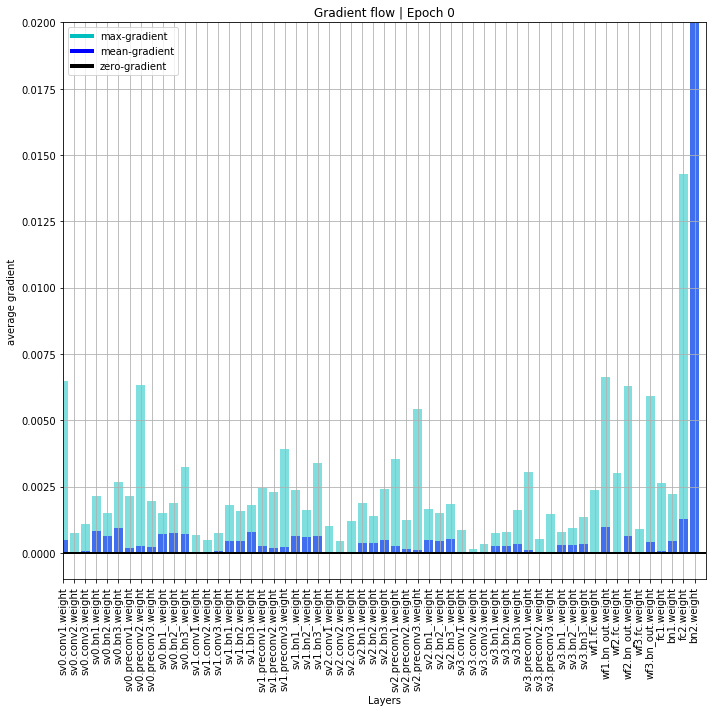

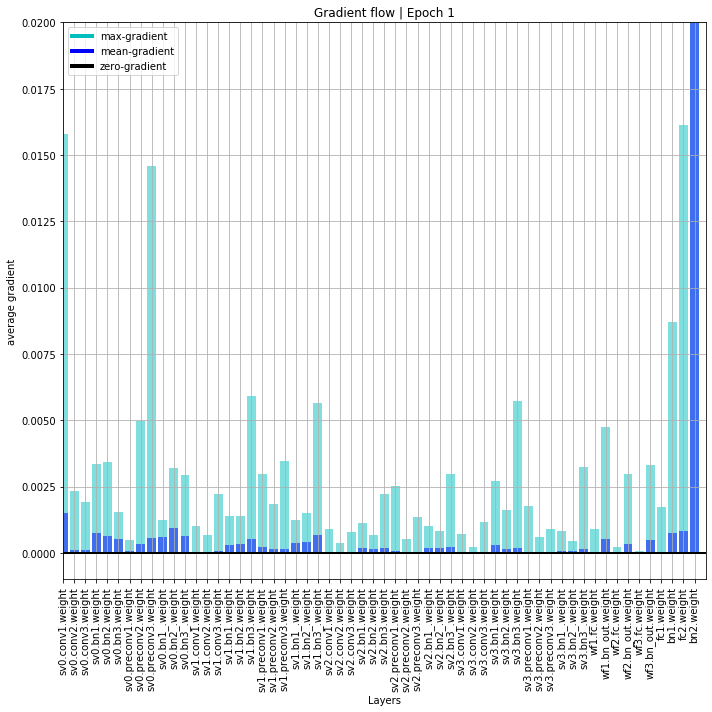

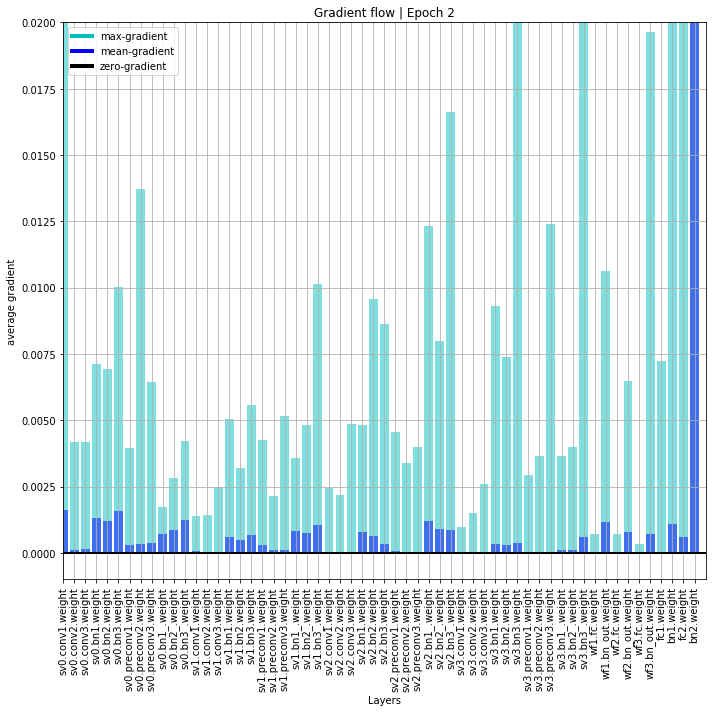

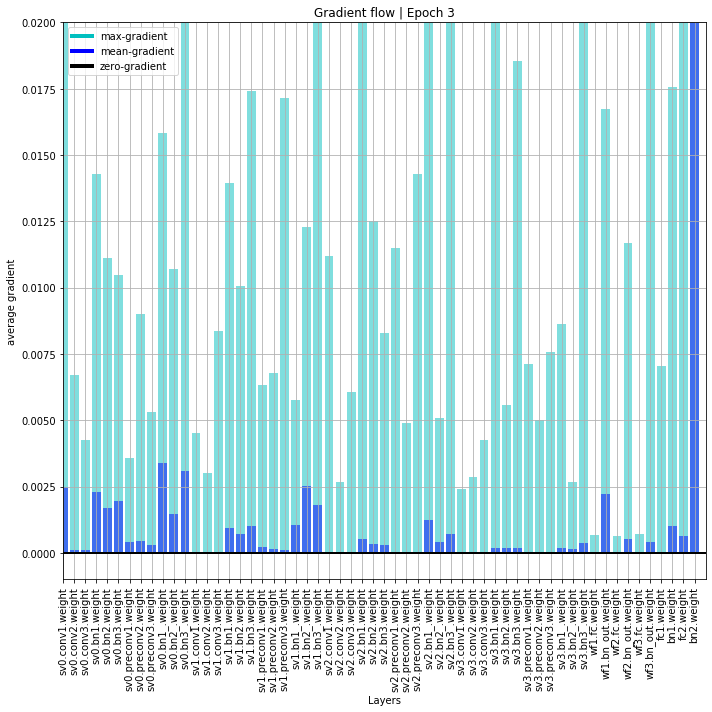

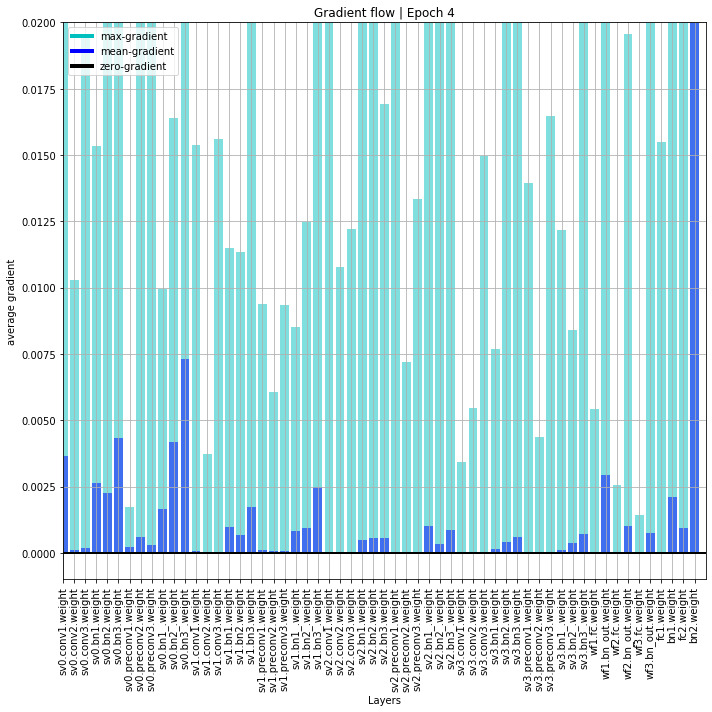

...

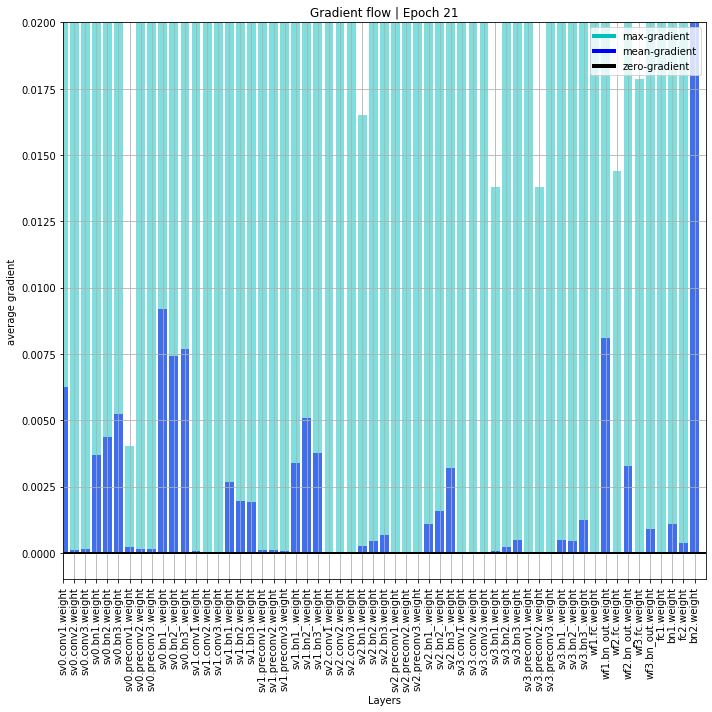

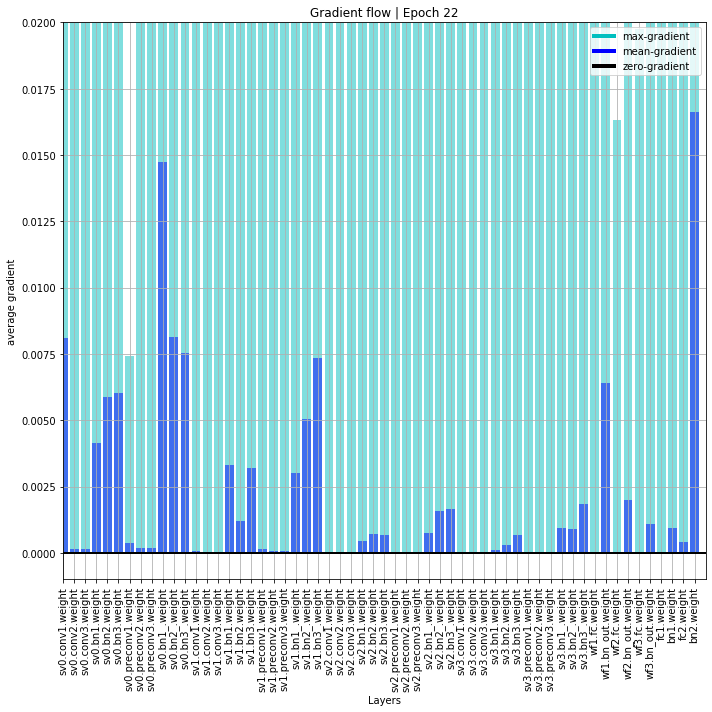

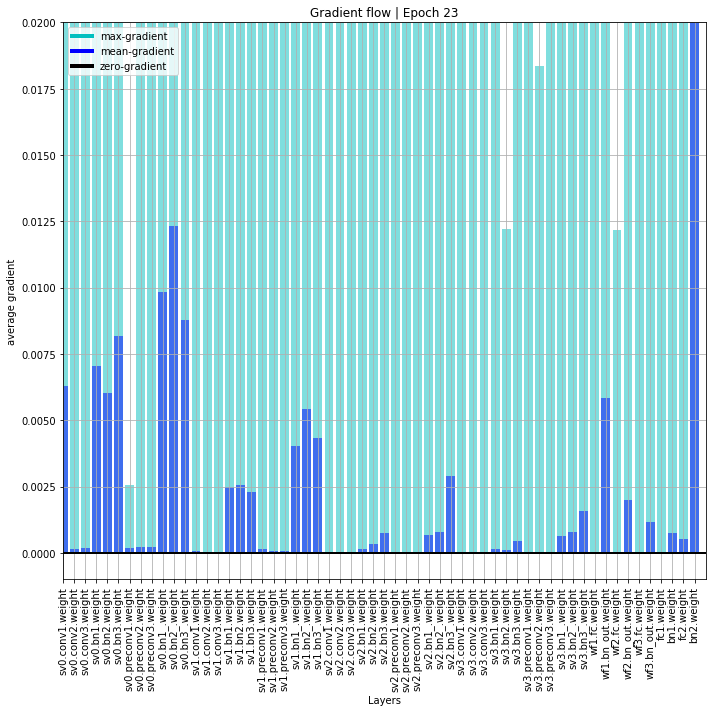

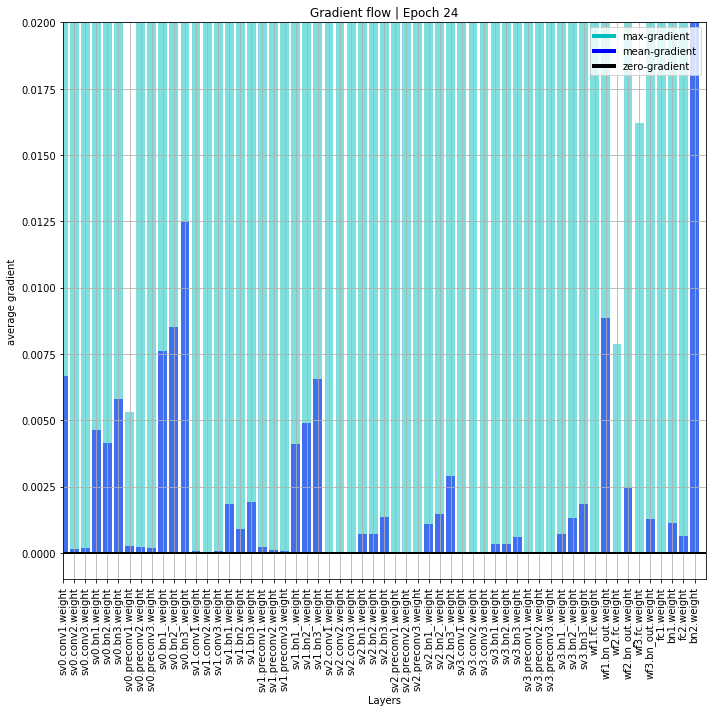

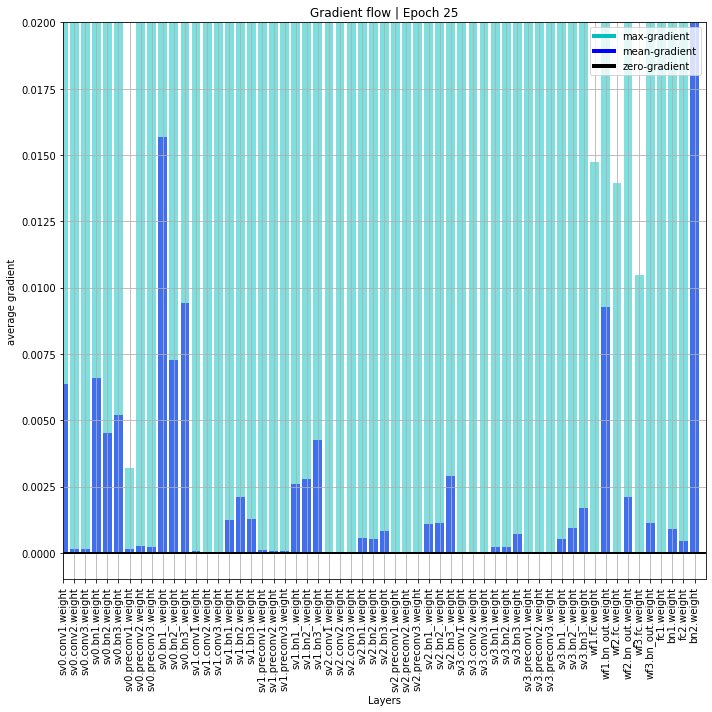

In [9]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet3'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(60):  # loop over the dataset multiple times
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

## SVGG7-2

In [5]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [6]:
class WeightFeature(nn.Module):
    def __init__(self, feature_depth, target_depth):
        super(WeightFeature, self).__init__()

        self.target_depth = target_depth
        self.fc1 = nn.Linear(feature_depth, feature_depth // 2)
        self.fc2 = nn.Linear(target_depth, target_depth // 2)
        self.fc = nn.Linear((feature_depth//2)*(target_depth//2), target_depth)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x1, x2):
        x1_avg = nn.AvgPool2d(kernel_size=(x1.size(-2), x1.size(-1)))(x1)
        x1_avg = nn.Flatten()(x1_avg)
        x1_avg = self.fc1(x1_avg)
        x2_avg = nn.AvgPool2d(kernel_size=(x2.size(-2), x2.size(-1)))(x2)
        x2_avg = nn.Flatten()(x2_avg)
        x2_avg = self.fc2(x2_avg)
        
        cor = torch.matmul(x1_avg.unsqueeze(-1), x2_avg.unsqueeze(1)) # shape feature_depth x target_depth
        cor = nn.Flatten()(cor)
        cor = self.fc(cor)
        cor = self.sigmoid(cor)
        cor = cor.unsqueeze(-1).unsqueeze(-1)

        x_out = x2 * cor

        return x_out

In [7]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)
        self.sv4 = SVblock(512, 1024).to(self.device)

        self.wf1 = WeightFeature(64, 128).to(self.device)
        self.wf2 = WeightFeature(128, 256).to(self.device)
        self.wf3 = WeightFeature(256, 512).to(self.device)
        self.wf4 = WeightFeature(512, 1024).to(self.device)

        self.fc1 = nn.Linear(1024, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)

        x1 = self.sv1(x0)
        x_wf1 = self.wf1(x0, x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x1, x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x2, x3)
        
        x4 = self.sv4(x_wf3)
        x_wf4 = self.wf4(x3, x4)

        x_wf4 = nn.AvgPool2d(kernel_size=(x_wf4.size(-2), x_wf4.size(-1)))(x_wf4)
    
        x = nn.Flatten()(x_wf4)

        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [8]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.005, weight_decay=1e-3)


cuda


Epoch:  1
	 - Step 1: loss: 2.498 acc: 0.125
	 - Step 2: loss: 2.359 acc: 0.219
	 - Step 3: loss: 2.177 acc: 0.203
	 - Step 4: loss: 2.124 acc: 0.188
	 - Step 5: loss: 2.167 acc: 0.156
	 - Step 6: loss: 2.069 acc: 0.109
	 - Step 7: loss: 1.938 acc: 0.219
	 - Step 8: loss: 1.918 acc: 0.250
	 - Step 9: loss: 1.946 acc: 0.188
	 - Step 10: loss: 2.051 acc: 0.156
	 - Step 11: loss: 1.892 acc: 0.297
	 - Step 12: loss: 1.948 acc: 0.219
	 - Step 13: loss: 1.956 acc: 0.188
	 - Step 14: loss: 2.107 acc: 0.188
	 - Step 15: loss: 1.951 acc: 0.188
	 - Step 16: loss: 1.956 acc: 0.156
	 - Step 17: loss: 2.004 acc: 0.188
	 - Step 18: loss: 1.957 acc: 0.141
	 - Step 19: loss: 1.969 acc: 0.188
	 - Step 20: loss: 1.935 acc: 0.188
	 - Step 21: loss: 1.913 acc: 0.219
	 - Step 22: loss: 1.886 acc: 0.250
	 - Step 23: loss: 1.937 acc: 0.156
	 - Step 24: loss: 1.931 acc: 0.203
	 - Step 25: loss: 1.931 acc: 0.188
	 - Step 26: loss: 1.915 acc: 0.250
	 - Step 27: loss: 1.933 acc: 0.156
	 - Step 28: loss: 1.899 ac

	 - Step 227: loss: 1.815 acc: 0.266
	 - Step 228: loss: 1.788 acc: 0.250
	 - Step 229: loss: 1.791 acc: 0.328
	 - Step 230: loss: 1.851 acc: 0.219
	 - Step 231: loss: 1.804 acc: 0.219
	 - Step 232: loss: 1.811 acc: 0.250
	 - Step 233: loss: 1.779 acc: 0.219
	 - Step 234: loss: 1.744 acc: 0.297
	 - Step 235: loss: 1.737 acc: 0.359
	 - Step 236: loss: 1.753 acc: 0.312
	 - Step 237: loss: 1.745 acc: 0.422
	 - Step 238: loss: 1.685 acc: 0.391
	 - Step 239: loss: 1.816 acc: 0.219
	 - Step 240: loss: 1.733 acc: 0.328
	 - Step 241: loss: 1.709 acc: 0.297
	 - Step 242: loss: 1.802 acc: 0.312
	 - Step 243: loss: 1.783 acc: 0.281
	 - Step 244: loss: 1.734 acc: 0.312
	 - Step 245: loss: 1.809 acc: 0.312
	 - Step 246: loss: 1.761 acc: 0.297
	 - Step 247: loss: 1.816 acc: 0.188
	 - Step 248: loss: 1.858 acc: 0.203
	 - Step 249: loss: 1.823 acc: 0.266
	 - Step 250: loss: 1.819 acc: 0.297
	 - Step 251: loss: 1.793 acc: 0.281
	 - Step 252: loss: 1.833 acc: 0.219
	 - Step 253: loss: 1.794 acc: 0.281
	

	 - Step 449: loss: 1.873 acc: 0.297
- Avg.loss: 1.834  | Avg.acc: 0.245
- Avg. val_loss: 1.796  | Avg. val_acc: 0.256


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type WeightFeature. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


* Update optimal model
Epoch:  2
	 - Step 1: loss: 1.748 acc: 0.312
	 - Step 2: loss: 1.764 acc: 0.297
	 - Step 3: loss: 1.790 acc: 0.203
	 - Step 4: loss: 1.720 acc: 0.266
	 - Step 5: loss: 1.792 acc: 0.266
	 - Step 6: loss: 1.777 acc: 0.266
	 - Step 7: loss: 1.897 acc: 0.141
	 - Step 8: loss: 1.831 acc: 0.203
	 - Step 9: loss: 1.805 acc: 0.281
	 - Step 10: loss: 1.785 acc: 0.281
	 - Step 11: loss: 1.886 acc: 0.203
	 - Step 12: loss: 1.853 acc: 0.219
	 - Step 13: loss: 1.821 acc: 0.266
	 - Step 14: loss: 1.811 acc: 0.234
	 - Step 15: loss: 1.720 acc: 0.281
	 - Step 16: loss: 1.823 acc: 0.234
	 - Step 17: loss: 1.779 acc: 0.328
	 - Step 18: loss: 1.781 acc: 0.266
	 - Step 19: loss: 1.785 acc: 0.250
	 - Step 20: loss: 1.726 acc: 0.297
	 - Step 21: loss: 1.807 acc: 0.234
	 - Step 22: loss: 1.774 acc: 0.219
	 - Step 23: loss: 1.766 acc: 0.234
	 - Step 24: loss: 1.778 acc: 0.250
	 - Step 25: loss: 1.830 acc: 0.141
	 - Step 26: loss: 1.885 acc: 0.203
	 - Step 27: loss: 1.694 acc: 0.359
	 - 

	 - Step 225: loss: 1.869 acc: 0.266
	 - Step 226: loss: 1.729 acc: 0.312
	 - Step 227: loss: 1.809 acc: 0.344
	 - Step 228: loss: 1.849 acc: 0.188
	 - Step 229: loss: 1.806 acc: 0.203
	 - Step 230: loss: 1.748 acc: 0.312
	 - Step 231: loss: 1.753 acc: 0.281
	 - Step 232: loss: 1.752 acc: 0.281
	 - Step 233: loss: 1.757 acc: 0.250
	 - Step 234: loss: 1.690 acc: 0.344
	 - Step 235: loss: 1.781 acc: 0.297
	 - Step 236: loss: 1.730 acc: 0.359
	 - Step 237: loss: 1.791 acc: 0.266
	 - Step 238: loss: 1.774 acc: 0.250
	 - Step 239: loss: 1.743 acc: 0.312
	 - Step 240: loss: 1.831 acc: 0.297
	 - Step 241: loss: 1.742 acc: 0.328
	 - Step 242: loss: 1.904 acc: 0.219
	 - Step 243: loss: 1.849 acc: 0.234
	 - Step 244: loss: 1.713 acc: 0.250
	 - Step 245: loss: 1.753 acc: 0.281
	 - Step 246: loss: 1.763 acc: 0.328
	 - Step 247: loss: 1.762 acc: 0.328
	 - Step 248: loss: 1.727 acc: 0.312
	 - Step 249: loss: 1.730 acc: 0.328
	 - Step 250: loss: 1.796 acc: 0.281
	 - Step 251: loss: 1.692 acc: 0.438
	

	 - Step 447: loss: 1.797 acc: 0.234
	 - Step 448: loss: 1.819 acc: 0.250
	 - Step 449: loss: 1.837 acc: 0.189
- Avg.loss: 1.783  | Avg.acc: 0.258
- Avg. val_loss: 1.779  | Avg. val_acc: 0.254
Epoch:  3
	 - Step 1: loss: 1.791 acc: 0.328
	 - Step 2: loss: 1.802 acc: 0.203
	 - Step 3: loss: 1.782 acc: 0.188
	 - Step 4: loss: 1.726 acc: 0.344
	 - Step 5: loss: 1.782 acc: 0.250
	 - Step 6: loss: 1.654 acc: 0.312
	 - Step 7: loss: 1.823 acc: 0.266
	 - Step 8: loss: 1.692 acc: 0.281
	 - Step 9: loss: 1.761 acc: 0.312
	 - Step 10: loss: 1.731 acc: 0.312
	 - Step 11: loss: 1.839 acc: 0.156
	 - Step 12: loss: 1.766 acc: 0.250
	 - Step 13: loss: 1.855 acc: 0.297
	 - Step 14: loss: 1.750 acc: 0.281
	 - Step 15: loss: 1.640 acc: 0.312
	 - Step 16: loss: 1.782 acc: 0.219
	 - Step 17: loss: 1.719 acc: 0.297
	 - Step 18: loss: 1.698 acc: 0.344
	 - Step 19: loss: 1.707 acc: 0.344
	 - Step 20: loss: 1.798 acc: 0.250
	 - Step 21: loss: 1.749 acc: 0.359
	 - Step 22: loss: 1.730 acc: 0.266
	 - Step 23: l

	 - Step 221: loss: 1.777 acc: 0.219
	 - Step 222: loss: 1.873 acc: 0.188
	 - Step 223: loss: 1.777 acc: 0.312
	 - Step 224: loss: 1.736 acc: 0.312
	 - Step 225: loss: 1.807 acc: 0.234
	 - Step 226: loss: 1.849 acc: 0.172
	 - Step 227: loss: 1.725 acc: 0.312
	 - Step 228: loss: 1.786 acc: 0.156
	 - Step 229: loss: 1.774 acc: 0.297
	 - Step 230: loss: 1.729 acc: 0.328
	 - Step 231: loss: 1.761 acc: 0.281
	 - Step 232: loss: 1.806 acc: 0.250
	 - Step 233: loss: 1.787 acc: 0.250
	 - Step 234: loss: 1.705 acc: 0.297
	 - Step 235: loss: 1.745 acc: 0.234
	 - Step 236: loss: 1.737 acc: 0.281
	 - Step 237: loss: 1.812 acc: 0.312
	 - Step 238: loss: 1.748 acc: 0.312
	 - Step 239: loss: 1.765 acc: 0.234
	 - Step 240: loss: 1.694 acc: 0.359
	 - Step 241: loss: 1.742 acc: 0.266
	 - Step 242: loss: 1.808 acc: 0.203
	 - Step 243: loss: 1.779 acc: 0.203
	 - Step 244: loss: 1.763 acc: 0.188
	 - Step 245: loss: 1.756 acc: 0.266
	 - Step 246: loss: 1.807 acc: 0.219
	 - Step 247: loss: 1.742 acc: 0.250
	

	 - Step 443: loss: 1.726 acc: 0.312
	 - Step 444: loss: 1.682 acc: 0.297
	 - Step 445: loss: 1.754 acc: 0.297
	 - Step 446: loss: 1.689 acc: 0.375
	 - Step 447: loss: 1.699 acc: 0.266
	 - Step 448: loss: 1.708 acc: 0.344
	 - Step 449: loss: 1.697 acc: 0.243
- Avg.loss: 1.765  | Avg.acc: 0.271
- Avg. val_loss: 1.770  | Avg. val_acc: 0.270
* Update optimal model
Epoch:  4
	 - Step 1: loss: 1.832 acc: 0.172
	 - Step 2: loss: 1.742 acc: 0.203
	 - Step 3: loss: 1.806 acc: 0.188
	 - Step 4: loss: 1.820 acc: 0.219
	 - Step 5: loss: 1.786 acc: 0.250
	 - Step 6: loss: 1.828 acc: 0.234
	 - Step 7: loss: 1.760 acc: 0.266
	 - Step 8: loss: 1.864 acc: 0.203
	 - Step 9: loss: 1.722 acc: 0.266
	 - Step 10: loss: 1.786 acc: 0.203
	 - Step 11: loss: 1.756 acc: 0.312
	 - Step 12: loss: 1.758 acc: 0.281
	 - Step 13: loss: 1.833 acc: 0.188
	 - Step 14: loss: 1.806 acc: 0.297
	 - Step 15: loss: 1.719 acc: 0.281
	 - Step 16: loss: 1.757 acc: 0.266
	 - Step 17: loss: 1.828 acc: 0.156
	 - Step 18: loss: 1.79

	 - Step 217: loss: 1.704 acc: 0.328
	 - Step 218: loss: 1.739 acc: 0.312
	 - Step 219: loss: 1.692 acc: 0.297
	 - Step 220: loss: 1.784 acc: 0.203
	 - Step 221: loss: 1.740 acc: 0.297
	 - Step 222: loss: 1.728 acc: 0.297
	 - Step 223: loss: 1.763 acc: 0.203
	 - Step 224: loss: 1.628 acc: 0.406
	 - Step 225: loss: 1.767 acc: 0.297
	 - Step 226: loss: 1.726 acc: 0.312
	 - Step 227: loss: 1.794 acc: 0.219
	 - Step 228: loss: 1.773 acc: 0.250
	 - Step 229: loss: 1.704 acc: 0.391
	 - Step 230: loss: 1.770 acc: 0.266
	 - Step 231: loss: 1.804 acc: 0.172
	 - Step 232: loss: 1.763 acc: 0.297
	 - Step 233: loss: 1.693 acc: 0.312
	 - Step 234: loss: 1.734 acc: 0.234
	 - Step 235: loss: 1.772 acc: 0.250
	 - Step 236: loss: 1.701 acc: 0.359
	 - Step 237: loss: 1.691 acc: 0.359
	 - Step 238: loss: 1.947 acc: 0.188
	 - Step 239: loss: 1.720 acc: 0.312
	 - Step 240: loss: 1.772 acc: 0.297
	 - Step 241: loss: 1.795 acc: 0.250
	 - Step 242: loss: 1.723 acc: 0.250
	 - Step 243: loss: 1.784 acc: 0.250
	

	 - Step 439: loss: 1.659 acc: 0.312
	 - Step 440: loss: 1.696 acc: 0.375
	 - Step 441: loss: 1.707 acc: 0.359
	 - Step 442: loss: 1.791 acc: 0.234
	 - Step 443: loss: 1.786 acc: 0.219
	 - Step 444: loss: 1.697 acc: 0.344
	 - Step 445: loss: 1.760 acc: 0.375
	 - Step 446: loss: 1.667 acc: 0.266
	 - Step 447: loss: 1.780 acc: 0.266
	 - Step 448: loss: 1.658 acc: 0.328
	 - Step 449: loss: 1.726 acc: 0.243
- Avg.loss: 1.751  | Avg.acc: 0.277
- Avg. val_loss: 1.854  | Avg. val_acc: 0.247
Epoch:  5
	 - Step 1: loss: 1.679 acc: 0.156
	 - Step 2: loss: 1.590 acc: 0.359
	 - Step 3: loss: 1.708 acc: 0.297
	 - Step 4: loss: 1.820 acc: 0.312
	 - Step 5: loss: 1.702 acc: 0.297
	 - Step 6: loss: 1.788 acc: 0.219
	 - Step 7: loss: 1.639 acc: 0.375
	 - Step 8: loss: 1.766 acc: 0.281
	 - Step 9: loss: 1.743 acc: 0.297
	 - Step 10: loss: 1.761 acc: 0.312
	 - Step 11: loss: 1.672 acc: 0.266
	 - Step 12: loss: 1.782 acc: 0.203
	 - Step 13: loss: 1.749 acc: 0.250
	 - Step 14: loss: 1.680 acc: 0.250
	 - St

	 - Step 213: loss: 1.697 acc: 0.250
	 - Step 214: loss: 1.731 acc: 0.234
	 - Step 215: loss: 1.713 acc: 0.266
	 - Step 216: loss: 1.757 acc: 0.297
	 - Step 217: loss: 1.810 acc: 0.219
	 - Step 218: loss: 1.664 acc: 0.344
	 - Step 219: loss: 1.883 acc: 0.203
	 - Step 220: loss: 1.703 acc: 0.328
	 - Step 221: loss: 1.776 acc: 0.234
	 - Step 222: loss: 1.744 acc: 0.250
	 - Step 223: loss: 1.673 acc: 0.281
	 - Step 224: loss: 1.728 acc: 0.234
	 - Step 225: loss: 1.609 acc: 0.375
	 - Step 226: loss: 1.732 acc: 0.219
	 - Step 227: loss: 1.703 acc: 0.359
	 - Step 228: loss: 1.715 acc: 0.344
	 - Step 229: loss: 1.665 acc: 0.281
	 - Step 230: loss: 1.615 acc: 0.375
	 - Step 231: loss: 1.670 acc: 0.312
	 - Step 232: loss: 1.767 acc: 0.359
	 - Step 233: loss: 1.691 acc: 0.359
	 - Step 234: loss: 1.692 acc: 0.328
	 - Step 235: loss: 1.839 acc: 0.266
	 - Step 236: loss: 1.729 acc: 0.234
	 - Step 237: loss: 1.617 acc: 0.438
	 - Step 238: loss: 1.727 acc: 0.266
	 - Step 239: loss: 1.708 acc: 0.312
	

	 - Step 435: loss: 1.607 acc: 0.391
	 - Step 436: loss: 1.759 acc: 0.297
	 - Step 437: loss: 1.748 acc: 0.312
	 - Step 438: loss: 1.692 acc: 0.375
	 - Step 439: loss: 1.840 acc: 0.188
	 - Step 440: loss: 1.740 acc: 0.219
	 - Step 441: loss: 1.861 acc: 0.172
	 - Step 442: loss: 1.698 acc: 0.266
	 - Step 443: loss: 1.713 acc: 0.359
	 - Step 444: loss: 1.612 acc: 0.422
	 - Step 445: loss: 1.700 acc: 0.297
	 - Step 446: loss: 1.579 acc: 0.422
	 - Step 447: loss: 1.749 acc: 0.266
	 - Step 448: loss: 1.658 acc: 0.266
	 - Step 449: loss: 1.740 acc: 0.297
- Avg.loss: 1.744  | Avg.acc: 0.280
- Avg. val_loss: 1.755  | Avg. val_acc: 0.280
* Update optimal model
Epoch:  6
	 - Step 1: loss: 1.748 acc: 0.266
	 - Step 2: loss: 1.841 acc: 0.266
	 - Step 3: loss: 1.770 acc: 0.375
	 - Step 4: loss: 1.742 acc: 0.250
	 - Step 5: loss: 1.706 acc: 0.234
	 - Step 6: loss: 1.652 acc: 0.359
	 - Step 7: loss: 1.599 acc: 0.328
	 - Step 8: loss: 1.714 acc: 0.344
	 - Step 9: loss: 1.772 acc: 0.266
	 - Step 10: lo

	 - Step 209: loss: 1.748 acc: 0.266
	 - Step 210: loss: 1.836 acc: 0.250
	 - Step 211: loss: 1.799 acc: 0.234
	 - Step 212: loss: 1.854 acc: 0.266
	 - Step 213: loss: 1.733 acc: 0.250
	 - Step 214: loss: 1.836 acc: 0.219
	 - Step 215: loss: 1.742 acc: 0.250
	 - Step 216: loss: 1.687 acc: 0.312
	 - Step 217: loss: 1.655 acc: 0.312
	 - Step 218: loss: 1.708 acc: 0.328
	 - Step 219: loss: 1.683 acc: 0.328
	 - Step 220: loss: 1.794 acc: 0.266
	 - Step 221: loss: 1.766 acc: 0.219
	 - Step 222: loss: 1.794 acc: 0.281
	 - Step 223: loss: 1.779 acc: 0.281
	 - Step 224: loss: 1.770 acc: 0.297
	 - Step 225: loss: 1.695 acc: 0.344
	 - Step 226: loss: 1.687 acc: 0.391
	 - Step 227: loss: 1.905 acc: 0.250
	 - Step 228: loss: 1.737 acc: 0.250
	 - Step 229: loss: 1.767 acc: 0.234
	 - Step 230: loss: 1.760 acc: 0.297
	 - Step 231: loss: 1.686 acc: 0.281
	 - Step 232: loss: 1.741 acc: 0.297
	 - Step 233: loss: 1.762 acc: 0.234
	 - Step 234: loss: 1.754 acc: 0.250
	 - Step 235: loss: 1.767 acc: 0.156
	

	 - Step 431: loss: 1.664 acc: 0.312
	 - Step 432: loss: 1.723 acc: 0.328
	 - Step 433: loss: 1.768 acc: 0.266
	 - Step 434: loss: 1.727 acc: 0.281
	 - Step 435: loss: 1.784 acc: 0.156
	 - Step 436: loss: 1.819 acc: 0.312
	 - Step 437: loss: 1.771 acc: 0.281
	 - Step 438: loss: 1.687 acc: 0.359
	 - Step 439: loss: 1.694 acc: 0.281
	 - Step 440: loss: 1.726 acc: 0.344
	 - Step 441: loss: 1.833 acc: 0.234
	 - Step 442: loss: 1.680 acc: 0.266
	 - Step 443: loss: 1.741 acc: 0.203
	 - Step 444: loss: 1.770 acc: 0.250
	 - Step 445: loss: 1.796 acc: 0.172
	 - Step 446: loss: 1.731 acc: 0.281
	 - Step 447: loss: 1.662 acc: 0.312
	 - Step 448: loss: 1.697 acc: 0.250
	 - Step 449: loss: 1.717 acc: 0.270
- Avg.loss: 1.738  | Avg.acc: 0.283
- Avg. val_loss: 2.292  | Avg. val_acc: 0.156
Epoch:  7
	 - Step 1: loss: 1.616 acc: 0.375
	 - Step 2: loss: 1.615 acc: 0.297
	 - Step 3: loss: 1.849 acc: 0.234
	 - Step 4: loss: 1.688 acc: 0.250
	 - Step 5: loss: 1.731 acc: 0.297
	 - Step 6: loss: 1.692 acc: 0

	 - Step 205: loss: 1.792 acc: 0.172
	 - Step 206: loss: 1.678 acc: 0.375
	 - Step 207: loss: 1.666 acc: 0.312
	 - Step 208: loss: 1.778 acc: 0.203
	 - Step 209: loss: 1.596 acc: 0.344
	 - Step 210: loss: 1.701 acc: 0.297
	 - Step 211: loss: 1.760 acc: 0.281
	 - Step 212: loss: 1.807 acc: 0.250
	 - Step 213: loss: 1.804 acc: 0.281
	 - Step 214: loss: 1.724 acc: 0.312
	 - Step 215: loss: 1.740 acc: 0.344
	 - Step 216: loss: 1.702 acc: 0.328
	 - Step 217: loss: 1.793 acc: 0.250
	 - Step 218: loss: 1.668 acc: 0.328
	 - Step 219: loss: 1.816 acc: 0.281
	 - Step 220: loss: 1.669 acc: 0.266
	 - Step 221: loss: 1.748 acc: 0.281
	 - Step 222: loss: 1.685 acc: 0.312
	 - Step 223: loss: 1.686 acc: 0.297
	 - Step 224: loss: 1.648 acc: 0.328
	 - Step 225: loss: 1.686 acc: 0.375
	 - Step 226: loss: 1.654 acc: 0.391
	 - Step 227: loss: 1.660 acc: 0.312
	 - Step 228: loss: 1.689 acc: 0.266
	 - Step 229: loss: 1.725 acc: 0.234
	 - Step 230: loss: 1.658 acc: 0.297
	 - Step 231: loss: 1.676 acc: 0.312
	

	 - Step 427: loss: 1.741 acc: 0.297
	 - Step 428: loss: 1.758 acc: 0.219
	 - Step 429: loss: 1.630 acc: 0.234
	 - Step 430: loss: 1.809 acc: 0.312
	 - Step 431: loss: 1.651 acc: 0.359
	 - Step 432: loss: 1.651 acc: 0.281
	 - Step 433: loss: 1.718 acc: 0.250
	 - Step 434: loss: 1.675 acc: 0.266
	 - Step 435: loss: 1.840 acc: 0.203
	 - Step 436: loss: 1.593 acc: 0.375
	 - Step 437: loss: 1.715 acc: 0.281
	 - Step 438: loss: 1.881 acc: 0.312
	 - Step 439: loss: 1.680 acc: 0.312
	 - Step 440: loss: 1.688 acc: 0.266
	 - Step 441: loss: 1.667 acc: 0.328
	 - Step 442: loss: 1.746 acc: 0.234
	 - Step 443: loss: 1.683 acc: 0.328
	 - Step 444: loss: 1.803 acc: 0.297
	 - Step 445: loss: 1.691 acc: 0.312
	 - Step 446: loss: 1.782 acc: 0.250
	 - Step 447: loss: 1.696 acc: 0.344
	 - Step 448: loss: 1.723 acc: 0.328
	 - Step 449: loss: 1.833 acc: 0.216
- Avg.loss: 1.718  | Avg.acc: 0.291
- Avg. val_loss: 1.726  | Avg. val_acc: 0.283
* Update optimal model
Epoch:  8
	 - Step 1: loss: 1.743 acc: 0.344

	 - Step 201: loss: 1.692 acc: 0.297
	 - Step 202: loss: 1.731 acc: 0.312
	 - Step 203: loss: 1.756 acc: 0.156
	 - Step 204: loss: 1.644 acc: 0.312
	 - Step 205: loss: 1.781 acc: 0.266
	 - Step 206: loss: 1.705 acc: 0.344
	 - Step 207: loss: 1.735 acc: 0.219
	 - Step 208: loss: 1.604 acc: 0.359
	 - Step 209: loss: 1.858 acc: 0.281
	 - Step 210: loss: 1.781 acc: 0.266
	 - Step 211: loss: 1.687 acc: 0.359
	 - Step 212: loss: 1.660 acc: 0.312
	 - Step 213: loss: 1.751 acc: 0.250
	 - Step 214: loss: 1.671 acc: 0.266
	 - Step 215: loss: 1.705 acc: 0.203
	 - Step 216: loss: 1.716 acc: 0.250
	 - Step 217: loss: 1.680 acc: 0.344
	 - Step 218: loss: 1.686 acc: 0.266
	 - Step 219: loss: 1.778 acc: 0.250
	 - Step 220: loss: 1.595 acc: 0.312
	 - Step 221: loss: 1.654 acc: 0.250
	 - Step 222: loss: 1.627 acc: 0.375
	 - Step 223: loss: 1.778 acc: 0.219
	 - Step 224: loss: 1.652 acc: 0.297
	 - Step 225: loss: 1.768 acc: 0.266
	 - Step 226: loss: 1.662 acc: 0.328
	 - Step 227: loss: 1.750 acc: 0.281
	

	 - Step 423: loss: 1.748 acc: 0.312
	 - Step 424: loss: 1.668 acc: 0.328
	 - Step 425: loss: 1.672 acc: 0.297
	 - Step 426: loss: 1.672 acc: 0.312
	 - Step 427: loss: 1.687 acc: 0.312
	 - Step 428: loss: 1.687 acc: 0.328
	 - Step 429: loss: 1.625 acc: 0.422
	 - Step 430: loss: 1.710 acc: 0.297
	 - Step 431: loss: 1.605 acc: 0.344
	 - Step 432: loss: 1.637 acc: 0.297
	 - Step 433: loss: 1.597 acc: 0.391
	 - Step 434: loss: 1.636 acc: 0.328
	 - Step 435: loss: 1.699 acc: 0.312
	 - Step 436: loss: 1.744 acc: 0.281
	 - Step 437: loss: 1.738 acc: 0.125
	 - Step 438: loss: 1.757 acc: 0.250
	 - Step 439: loss: 1.628 acc: 0.500
	 - Step 440: loss: 1.655 acc: 0.344
	 - Step 441: loss: 1.603 acc: 0.359
	 - Step 442: loss: 1.682 acc: 0.266
	 - Step 443: loss: 1.649 acc: 0.297
	 - Step 444: loss: 1.790 acc: 0.281
	 - Step 445: loss: 1.848 acc: 0.203
	 - Step 446: loss: 1.728 acc: 0.297
	 - Step 447: loss: 1.746 acc: 0.156
	 - Step 448: loss: 1.647 acc: 0.344
	 - Step 449: loss: 1.775 acc: 0.405
-

	 - Step 197: loss: 1.608 acc: 0.391
	 - Step 198: loss: 1.685 acc: 0.328
	 - Step 199: loss: 1.722 acc: 0.344
	 - Step 200: loss: 1.741 acc: 0.391
	 - Step 201: loss: 1.604 acc: 0.297
	 - Step 202: loss: 1.621 acc: 0.359
	 - Step 203: loss: 1.659 acc: 0.312
	 - Step 204: loss: 1.722 acc: 0.250
	 - Step 205: loss: 1.654 acc: 0.391
	 - Step 206: loss: 1.648 acc: 0.375
	 - Step 207: loss: 1.540 acc: 0.469
	 - Step 208: loss: 1.558 acc: 0.375
	 - Step 209: loss: 1.824 acc: 0.219
	 - Step 210: loss: 1.833 acc: 0.203
	 - Step 211: loss: 1.755 acc: 0.250
	 - Step 212: loss: 1.654 acc: 0.281
	 - Step 213: loss: 1.695 acc: 0.281
	 - Step 214: loss: 1.725 acc: 0.281
	 - Step 215: loss: 1.678 acc: 0.219
	 - Step 216: loss: 1.595 acc: 0.266
	 - Step 217: loss: 1.757 acc: 0.281
	 - Step 218: loss: 1.719 acc: 0.266
	 - Step 219: loss: 1.797 acc: 0.266
	 - Step 220: loss: 1.654 acc: 0.297
	 - Step 221: loss: 1.700 acc: 0.328
	 - Step 222: loss: 1.859 acc: 0.281
	 - Step 223: loss: 1.653 acc: 0.250
	

	 - Step 419: loss: 1.906 acc: 0.234
	 - Step 420: loss: 1.763 acc: 0.281
	 - Step 421: loss: 1.810 acc: 0.234
	 - Step 422: loss: 1.692 acc: 0.359
	 - Step 423: loss: 1.735 acc: 0.266
	 - Step 424: loss: 1.767 acc: 0.266
	 - Step 425: loss: 1.714 acc: 0.312
	 - Step 426: loss: 1.670 acc: 0.328
	 - Step 427: loss: 1.728 acc: 0.391
	 - Step 428: loss: 1.655 acc: 0.297
	 - Step 429: loss: 1.614 acc: 0.359
	 - Step 430: loss: 1.719 acc: 0.453
	 - Step 431: loss: 1.710 acc: 0.281
	 - Step 432: loss: 1.710 acc: 0.281
	 - Step 433: loss: 1.607 acc: 0.359
	 - Step 434: loss: 1.841 acc: 0.281
	 - Step 435: loss: 1.736 acc: 0.375
	 - Step 436: loss: 1.777 acc: 0.219
	 - Step 437: loss: 1.561 acc: 0.359
	 - Step 438: loss: 1.775 acc: 0.281
	 - Step 439: loss: 1.715 acc: 0.281
	 - Step 440: loss: 1.782 acc: 0.250
	 - Step 441: loss: 1.675 acc: 0.422
	 - Step 442: loss: 1.731 acc: 0.250
	 - Step 443: loss: 1.656 acc: 0.328
	 - Step 444: loss: 1.656 acc: 0.312
	 - Step 445: loss: 1.691 acc: 0.281
	

	 - Step 193: loss: 1.773 acc: 0.219
	 - Step 194: loss: 1.710 acc: 0.297
	 - Step 195: loss: 1.683 acc: 0.328
	 - Step 196: loss: 1.780 acc: 0.234
	 - Step 197: loss: 1.673 acc: 0.266
	 - Step 198: loss: 1.633 acc: 0.359
	 - Step 199: loss: 1.832 acc: 0.219
	 - Step 200: loss: 1.602 acc: 0.328
	 - Step 201: loss: 1.741 acc: 0.219
	 - Step 202: loss: 1.752 acc: 0.234
	 - Step 203: loss: 1.642 acc: 0.250
	 - Step 204: loss: 1.753 acc: 0.312
	 - Step 205: loss: 1.821 acc: 0.266
	 - Step 206: loss: 1.672 acc: 0.266
	 - Step 207: loss: 1.824 acc: 0.250
	 - Step 208: loss: 1.717 acc: 0.344
	 - Step 209: loss: 1.749 acc: 0.281
	 - Step 210: loss: 1.751 acc: 0.234
	 - Step 211: loss: 1.683 acc: 0.234
	 - Step 212: loss: 1.715 acc: 0.328
	 - Step 213: loss: 1.645 acc: 0.312
	 - Step 214: loss: 1.746 acc: 0.266
	 - Step 215: loss: 1.604 acc: 0.328
	 - Step 216: loss: 1.606 acc: 0.359
	 - Step 217: loss: 1.643 acc: 0.266
	 - Step 218: loss: 1.775 acc: 0.203
	 - Step 219: loss: 1.754 acc: 0.297
	

	 - Step 415: loss: 1.736 acc: 0.281
	 - Step 416: loss: 1.580 acc: 0.312
	 - Step 417: loss: 1.750 acc: 0.250
	 - Step 418: loss: 1.662 acc: 0.328
	 - Step 419: loss: 1.660 acc: 0.359
	 - Step 420: loss: 1.628 acc: 0.344
	 - Step 421: loss: 1.637 acc: 0.375
	 - Step 422: loss: 1.816 acc: 0.219
	 - Step 423: loss: 1.755 acc: 0.234
	 - Step 424: loss: 1.640 acc: 0.359
	 - Step 425: loss: 1.769 acc: 0.266
	 - Step 426: loss: 1.788 acc: 0.250
	 - Step 427: loss: 1.699 acc: 0.328
	 - Step 428: loss: 1.665 acc: 0.406
	 - Step 429: loss: 1.668 acc: 0.297
	 - Step 430: loss: 1.613 acc: 0.375
	 - Step 431: loss: 1.656 acc: 0.328
	 - Step 432: loss: 1.806 acc: 0.312
	 - Step 433: loss: 1.768 acc: 0.266
	 - Step 434: loss: 1.645 acc: 0.328
	 - Step 435: loss: 1.697 acc: 0.359
	 - Step 436: loss: 1.753 acc: 0.344
	 - Step 437: loss: 1.788 acc: 0.406
	 - Step 438: loss: 1.719 acc: 0.312
	 - Step 439: loss: 1.752 acc: 0.266
	 - Step 440: loss: 1.770 acc: 0.312
	 - Step 441: loss: 1.851 acc: 0.219
	

	 - Step 189: loss: 1.794 acc: 0.250
	 - Step 190: loss: 1.714 acc: 0.266
	 - Step 191: loss: 1.678 acc: 0.344
	 - Step 192: loss: 1.687 acc: 0.312
	 - Step 193: loss: 1.707 acc: 0.234
	 - Step 194: loss: 1.742 acc: 0.297
	 - Step 195: loss: 1.752 acc: 0.250
	 - Step 196: loss: 1.773 acc: 0.219
	 - Step 197: loss: 1.752 acc: 0.219
	 - Step 198: loss: 1.610 acc: 0.312
	 - Step 199: loss: 1.802 acc: 0.234
	 - Step 200: loss: 1.696 acc: 0.250
	 - Step 201: loss: 1.663 acc: 0.328
	 - Step 202: loss: 1.650 acc: 0.375
	 - Step 203: loss: 1.861 acc: 0.203
	 - Step 204: loss: 1.751 acc: 0.281
	 - Step 205: loss: 1.714 acc: 0.234
	 - Step 206: loss: 1.759 acc: 0.266
	 - Step 207: loss: 1.652 acc: 0.297
	 - Step 208: loss: 1.850 acc: 0.266
	 - Step 209: loss: 1.904 acc: 0.281
	 - Step 210: loss: 1.731 acc: 0.266
	 - Step 211: loss: 1.702 acc: 0.234
	 - Step 212: loss: 1.583 acc: 0.406
	 - Step 213: loss: 1.638 acc: 0.266
	 - Step 214: loss: 1.723 acc: 0.359
	 - Step 215: loss: 1.684 acc: 0.297
	

	 - Step 411: loss: 1.686 acc: 0.328
	 - Step 412: loss: 1.744 acc: 0.266
	 - Step 413: loss: 1.755 acc: 0.250
	 - Step 414: loss: 1.659 acc: 0.375
	 - Step 415: loss: 1.770 acc: 0.188
	 - Step 416: loss: 1.677 acc: 0.312
	 - Step 417: loss: 1.679 acc: 0.328
	 - Step 418: loss: 1.710 acc: 0.312
	 - Step 419: loss: 1.728 acc: 0.359
	 - Step 420: loss: 1.637 acc: 0.359
	 - Step 421: loss: 1.708 acc: 0.281
	 - Step 422: loss: 1.738 acc: 0.359
	 - Step 423: loss: 1.748 acc: 0.266
	 - Step 424: loss: 1.627 acc: 0.281
	 - Step 425: loss: 1.734 acc: 0.328
	 - Step 426: loss: 1.597 acc: 0.359
	 - Step 427: loss: 1.690 acc: 0.328
	 - Step 428: loss: 1.715 acc: 0.219
	 - Step 429: loss: 1.654 acc: 0.312
	 - Step 430: loss: 1.640 acc: 0.344
	 - Step 431: loss: 1.671 acc: 0.328
	 - Step 432: loss: 1.670 acc: 0.281
	 - Step 433: loss: 1.531 acc: 0.406
	 - Step 434: loss: 1.684 acc: 0.250
	 - Step 435: loss: 1.627 acc: 0.359
	 - Step 436: loss: 1.809 acc: 0.312
	 - Step 437: loss: 1.592 acc: 0.312
	

	 - Step 185: loss: 1.744 acc: 0.359
	 - Step 186: loss: 1.656 acc: 0.312
	 - Step 187: loss: 1.615 acc: 0.344
	 - Step 188: loss: 1.555 acc: 0.406
	 - Step 189: loss: 1.757 acc: 0.250
	 - Step 190: loss: 1.627 acc: 0.281
	 - Step 191: loss: 1.647 acc: 0.375
	 - Step 192: loss: 1.732 acc: 0.219
	 - Step 193: loss: 1.610 acc: 0.344
	 - Step 194: loss: 1.748 acc: 0.344
	 - Step 195: loss: 1.655 acc: 0.328
	 - Step 196: loss: 1.658 acc: 0.344
	 - Step 197: loss: 1.770 acc: 0.266
	 - Step 198: loss: 1.721 acc: 0.250
	 - Step 199: loss: 1.714 acc: 0.312
	 - Step 200: loss: 1.748 acc: 0.266
	 - Step 201: loss: 1.692 acc: 0.297
	 - Step 202: loss: 1.622 acc: 0.328
	 - Step 203: loss: 1.705 acc: 0.266
	 - Step 204: loss: 1.692 acc: 0.281
	 - Step 205: loss: 1.600 acc: 0.391
	 - Step 206: loss: 1.661 acc: 0.297
	 - Step 207: loss: 1.652 acc: 0.219
	 - Step 208: loss: 1.569 acc: 0.406
	 - Step 209: loss: 1.838 acc: 0.297
	 - Step 210: loss: 1.710 acc: 0.297
	 - Step 211: loss: 1.688 acc: 0.203
	

	 - Step 407: loss: 1.668 acc: 0.234
	 - Step 408: loss: 1.597 acc: 0.359
	 - Step 409: loss: 1.666 acc: 0.328
	 - Step 410: loss: 1.636 acc: 0.344
	 - Step 411: loss: 1.708 acc: 0.297
	 - Step 412: loss: 1.645 acc: 0.344
	 - Step 413: loss: 1.628 acc: 0.359
	 - Step 414: loss: 1.846 acc: 0.172
	 - Step 415: loss: 1.704 acc: 0.344
	 - Step 416: loss: 1.781 acc: 0.219
	 - Step 417: loss: 1.716 acc: 0.328
	 - Step 418: loss: 1.761 acc: 0.203
	 - Step 419: loss: 1.773 acc: 0.328
	 - Step 420: loss: 1.684 acc: 0.312
	 - Step 421: loss: 1.541 acc: 0.344
	 - Step 422: loss: 1.630 acc: 0.359
	 - Step 423: loss: 1.789 acc: 0.266
	 - Step 424: loss: 1.603 acc: 0.328
	 - Step 425: loss: 1.737 acc: 0.203
	 - Step 426: loss: 1.680 acc: 0.297
	 - Step 427: loss: 1.575 acc: 0.328
	 - Step 428: loss: 1.774 acc: 0.266
	 - Step 429: loss: 1.792 acc: 0.250
	 - Step 430: loss: 1.670 acc: 0.312
	 - Step 431: loss: 1.639 acc: 0.312
	 - Step 432: loss: 1.725 acc: 0.297
	 - Step 433: loss: 1.769 acc: 0.234
	

	 - Step 181: loss: 1.649 acc: 0.375
	 - Step 182: loss: 1.688 acc: 0.266
	 - Step 183: loss: 1.627 acc: 0.328
	 - Step 184: loss: 1.697 acc: 0.234
	 - Step 185: loss: 1.701 acc: 0.234
	 - Step 186: loss: 1.592 acc: 0.359
	 - Step 187: loss: 1.553 acc: 0.359
	 - Step 188: loss: 1.714 acc: 0.266
	 - Step 189: loss: 1.636 acc: 0.344
	 - Step 190: loss: 1.787 acc: 0.266
	 - Step 191: loss: 1.663 acc: 0.391
	 - Step 192: loss: 1.632 acc: 0.312
	 - Step 193: loss: 1.722 acc: 0.297
	 - Step 194: loss: 1.595 acc: 0.344
	 - Step 195: loss: 1.643 acc: 0.266
	 - Step 196: loss: 1.566 acc: 0.375
	 - Step 197: loss: 1.738 acc: 0.250
	 - Step 198: loss: 1.612 acc: 0.312
	 - Step 199: loss: 1.688 acc: 0.234
	 - Step 200: loss: 1.645 acc: 0.312
	 - Step 201: loss: 1.697 acc: 0.250
	 - Step 202: loss: 1.788 acc: 0.281
	 - Step 203: loss: 1.622 acc: 0.359
	 - Step 204: loss: 1.645 acc: 0.391
	 - Step 205: loss: 1.775 acc: 0.281
	 - Step 206: loss: 1.611 acc: 0.234
	 - Step 207: loss: 1.701 acc: 0.281
	

	 - Step 403: loss: 1.750 acc: 0.297
	 - Step 404: loss: 1.739 acc: 0.312
	 - Step 405: loss: 1.638 acc: 0.359
	 - Step 406: loss: 1.844 acc: 0.188
	 - Step 407: loss: 1.727 acc: 0.234
	 - Step 408: loss: 1.753 acc: 0.281
	 - Step 409: loss: 1.644 acc: 0.391
	 - Step 410: loss: 1.587 acc: 0.375
	 - Step 411: loss: 1.729 acc: 0.281
	 - Step 412: loss: 1.687 acc: 0.281
	 - Step 413: loss: 1.631 acc: 0.312
	 - Step 414: loss: 1.718 acc: 0.281
	 - Step 415: loss: 1.771 acc: 0.328
	 - Step 416: loss: 1.708 acc: 0.297
	 - Step 417: loss: 1.688 acc: 0.219
	 - Step 418: loss: 1.557 acc: 0.344
	 - Step 419: loss: 1.661 acc: 0.375
	 - Step 420: loss: 1.802 acc: 0.281
	 - Step 421: loss: 1.911 acc: 0.266
	 - Step 422: loss: 1.744 acc: 0.344
	 - Step 423: loss: 1.639 acc: 0.266
	 - Step 424: loss: 1.679 acc: 0.391
	 - Step 425: loss: 1.786 acc: 0.328
	 - Step 426: loss: 1.603 acc: 0.359
	 - Step 427: loss: 1.722 acc: 0.344
	 - Step 428: loss: 1.561 acc: 0.406
	 - Step 429: loss: 1.738 acc: 0.250
	

	 - Step 177: loss: 1.694 acc: 0.344
	 - Step 178: loss: 1.702 acc: 0.312
	 - Step 179: loss: 1.595 acc: 0.328
	 - Step 180: loss: 1.690 acc: 0.312
	 - Step 181: loss: 1.738 acc: 0.297
	 - Step 182: loss: 1.626 acc: 0.344
	 - Step 183: loss: 1.722 acc: 0.328
	 - Step 184: loss: 1.619 acc: 0.391
	 - Step 185: loss: 1.763 acc: 0.297
	 - Step 186: loss: 1.602 acc: 0.375
	 - Step 187: loss: 1.759 acc: 0.344
	 - Step 188: loss: 1.692 acc: 0.219
	 - Step 189: loss: 1.784 acc: 0.359
	 - Step 190: loss: 1.593 acc: 0.359
	 - Step 191: loss: 1.703 acc: 0.406
	 - Step 192: loss: 1.672 acc: 0.328
	 - Step 193: loss: 1.813 acc: 0.188
	 - Step 194: loss: 1.734 acc: 0.281
	 - Step 195: loss: 1.673 acc: 0.297
	 - Step 196: loss: 1.661 acc: 0.312
	 - Step 197: loss: 1.781 acc: 0.281
	 - Step 198: loss: 1.881 acc: 0.172
	 - Step 199: loss: 1.736 acc: 0.312
	 - Step 200: loss: 1.674 acc: 0.297
	 - Step 201: loss: 1.727 acc: 0.234
	 - Step 202: loss: 1.745 acc: 0.328
	 - Step 203: loss: 1.577 acc: 0.344
	

	 - Step 399: loss: 1.803 acc: 0.234
	 - Step 400: loss: 1.656 acc: 0.328
	 - Step 401: loss: 1.607 acc: 0.297
	 - Step 402: loss: 1.655 acc: 0.344
	 - Step 403: loss: 1.724 acc: 0.281
	 - Step 404: loss: 1.628 acc: 0.281
	 - Step 405: loss: 1.641 acc: 0.391
	 - Step 406: loss: 1.554 acc: 0.312
	 - Step 407: loss: 1.735 acc: 0.344
	 - Step 408: loss: 1.655 acc: 0.312
	 - Step 409: loss: 1.509 acc: 0.375
	 - Step 410: loss: 1.664 acc: 0.359
	 - Step 411: loss: 1.737 acc: 0.328
	 - Step 412: loss: 1.608 acc: 0.359
	 - Step 413: loss: 1.697 acc: 0.359
	 - Step 414: loss: 1.700 acc: 0.188
	 - Step 415: loss: 1.687 acc: 0.297
	 - Step 416: loss: 1.563 acc: 0.391
	 - Step 417: loss: 1.618 acc: 0.328
	 - Step 418: loss: 1.787 acc: 0.312
	 - Step 419: loss: 1.763 acc: 0.203
	 - Step 420: loss: 1.660 acc: 0.297
	 - Step 421: loss: 1.609 acc: 0.281
	 - Step 422: loss: 1.619 acc: 0.406
	 - Step 423: loss: 1.763 acc: 0.359
	 - Step 424: loss: 1.729 acc: 0.219
	 - Step 425: loss: 1.623 acc: 0.297
	

	 - Step 173: loss: 1.664 acc: 0.312
	 - Step 174: loss: 1.670 acc: 0.312
	 - Step 175: loss: 1.714 acc: 0.266
	 - Step 176: loss: 1.713 acc: 0.344
	 - Step 177: loss: 1.803 acc: 0.203
	 - Step 178: loss: 1.595 acc: 0.391
	 - Step 179: loss: 1.718 acc: 0.297
	 - Step 180: loss: 1.677 acc: 0.328
	 - Step 181: loss: 1.693 acc: 0.266
	 - Step 182: loss: 1.637 acc: 0.453
	 - Step 183: loss: 1.629 acc: 0.312
	 - Step 184: loss: 1.772 acc: 0.250
	 - Step 185: loss: 1.639 acc: 0.281
	 - Step 186: loss: 1.664 acc: 0.312
	 - Step 187: loss: 1.655 acc: 0.359
	 - Step 188: loss: 1.644 acc: 0.359
	 - Step 189: loss: 1.583 acc: 0.391
	 - Step 190: loss: 1.593 acc: 0.344
	 - Step 191: loss: 1.673 acc: 0.250
	 - Step 192: loss: 1.672 acc: 0.266
	 - Step 193: loss: 1.699 acc: 0.297
	 - Step 194: loss: 1.644 acc: 0.281
	 - Step 195: loss: 1.736 acc: 0.375
	 - Step 196: loss: 1.639 acc: 0.359
	 - Step 197: loss: 1.709 acc: 0.344
	 - Step 198: loss: 1.599 acc: 0.375
	 - Step 199: loss: 1.688 acc: 0.312
	

	 - Step 395: loss: 1.573 acc: 0.375
	 - Step 396: loss: 1.583 acc: 0.328
	 - Step 397: loss: 1.850 acc: 0.234
	 - Step 398: loss: 1.594 acc: 0.344
	 - Step 399: loss: 1.780 acc: 0.250
	 - Step 400: loss: 1.641 acc: 0.297
	 - Step 401: loss: 1.587 acc: 0.375
	 - Step 402: loss: 1.794 acc: 0.219
	 - Step 403: loss: 1.674 acc: 0.359
	 - Step 404: loss: 1.633 acc: 0.438
	 - Step 405: loss: 1.742 acc: 0.234
	 - Step 406: loss: 1.648 acc: 0.359
	 - Step 407: loss: 1.626 acc: 0.312
	 - Step 408: loss: 1.746 acc: 0.219
	 - Step 409: loss: 1.874 acc: 0.312
	 - Step 410: loss: 1.680 acc: 0.297
	 - Step 411: loss: 1.697 acc: 0.219
	 - Step 412: loss: 1.674 acc: 0.281
	 - Step 413: loss: 1.765 acc: 0.297
	 - Step 414: loss: 1.732 acc: 0.234
	 - Step 415: loss: 1.692 acc: 0.297
	 - Step 416: loss: 1.692 acc: 0.281
	 - Step 417: loss: 1.799 acc: 0.234
	 - Step 418: loss: 1.726 acc: 0.297
	 - Step 419: loss: 1.686 acc: 0.266
	 - Step 420: loss: 1.602 acc: 0.406
	 - Step 421: loss: 1.810 acc: 0.312
	

	 - Step 169: loss: 1.611 acc: 0.359
	 - Step 170: loss: 1.668 acc: 0.344
	 - Step 171: loss: 1.586 acc: 0.375
	 - Step 172: loss: 1.716 acc: 0.328
	 - Step 173: loss: 1.660 acc: 0.297
	 - Step 174: loss: 1.596 acc: 0.281
	 - Step 175: loss: 1.662 acc: 0.375
	 - Step 176: loss: 1.585 acc: 0.281
	 - Step 177: loss: 1.717 acc: 0.281
	 - Step 178: loss: 1.919 acc: 0.141
	 - Step 179: loss: 1.710 acc: 0.297
	 - Step 180: loss: 1.657 acc: 0.359
	 - Step 181: loss: 1.642 acc: 0.312
	 - Step 182: loss: 1.757 acc: 0.312
	 - Step 183: loss: 1.822 acc: 0.188
	 - Step 184: loss: 1.586 acc: 0.359
	 - Step 185: loss: 1.719 acc: 0.281
	 - Step 186: loss: 1.757 acc: 0.234
	 - Step 187: loss: 1.593 acc: 0.344
	 - Step 188: loss: 1.767 acc: 0.250
	 - Step 189: loss: 1.593 acc: 0.328
	 - Step 190: loss: 1.664 acc: 0.312
	 - Step 191: loss: 1.763 acc: 0.219
	 - Step 192: loss: 1.592 acc: 0.391
	 - Step 193: loss: 1.662 acc: 0.312
	 - Step 194: loss: 1.766 acc: 0.328
	 - Step 195: loss: 1.667 acc: 0.375
	

	 - Step 391: loss: 1.641 acc: 0.328
	 - Step 392: loss: 1.600 acc: 0.391
	 - Step 393: loss: 1.633 acc: 0.422
	 - Step 394: loss: 1.642 acc: 0.328
	 - Step 395: loss: 1.642 acc: 0.281
	 - Step 396: loss: 1.730 acc: 0.312
	 - Step 397: loss: 1.667 acc: 0.281
	 - Step 398: loss: 1.711 acc: 0.328
	 - Step 399: loss: 1.653 acc: 0.406
	 - Step 400: loss: 1.720 acc: 0.266
	 - Step 401: loss: 1.705 acc: 0.219
	 - Step 402: loss: 1.752 acc: 0.359
	 - Step 403: loss: 1.737 acc: 0.281
	 - Step 404: loss: 1.699 acc: 0.234
	 - Step 405: loss: 1.717 acc: 0.250
	 - Step 406: loss: 1.587 acc: 0.375
	 - Step 407: loss: 1.645 acc: 0.344
	 - Step 408: loss: 1.568 acc: 0.422
	 - Step 409: loss: 1.711 acc: 0.328
	 - Step 410: loss: 1.684 acc: 0.234
	 - Step 411: loss: 1.750 acc: 0.281
	 - Step 412: loss: 1.735 acc: 0.234
	 - Step 413: loss: 1.693 acc: 0.281
	 - Step 414: loss: 1.559 acc: 0.359
	 - Step 415: loss: 1.623 acc: 0.312
	 - Step 416: loss: 1.577 acc: 0.391
	 - Step 417: loss: 1.711 acc: 0.266
	

	 - Step 165: loss: 1.633 acc: 0.359
	 - Step 166: loss: 1.653 acc: 0.281
	 - Step 167: loss: 1.661 acc: 0.312
	 - Step 168: loss: 1.638 acc: 0.344
	 - Step 169: loss: 1.772 acc: 0.281
	 - Step 170: loss: 1.713 acc: 0.266
	 - Step 171: loss: 1.615 acc: 0.438
	 - Step 172: loss: 1.617 acc: 0.250
	 - Step 173: loss: 1.658 acc: 0.406
	 - Step 174: loss: 1.642 acc: 0.281
	 - Step 175: loss: 1.649 acc: 0.328
	 - Step 176: loss: 1.755 acc: 0.219
	 - Step 177: loss: 1.529 acc: 0.406
	 - Step 178: loss: 1.754 acc: 0.344
	 - Step 179: loss: 1.565 acc: 0.344
	 - Step 180: loss: 1.715 acc: 0.281
	 - Step 181: loss: 1.916 acc: 0.156
	 - Step 182: loss: 1.653 acc: 0.250
	 - Step 183: loss: 1.667 acc: 0.281
	 - Step 184: loss: 1.546 acc: 0.359
	 - Step 185: loss: 1.698 acc: 0.344
	 - Step 186: loss: 1.706 acc: 0.266
	 - Step 187: loss: 1.720 acc: 0.297
	 - Step 188: loss: 1.729 acc: 0.375
	 - Step 189: loss: 1.620 acc: 0.328
	 - Step 190: loss: 1.652 acc: 0.297
	 - Step 191: loss: 1.657 acc: 0.344
	

	 - Step 387: loss: 1.604 acc: 0.391
	 - Step 388: loss: 1.696 acc: 0.312
	 - Step 389: loss: 1.743 acc: 0.344
	 - Step 390: loss: 1.630 acc: 0.438
	 - Step 391: loss: 1.757 acc: 0.203
	 - Step 392: loss: 1.697 acc: 0.281
	 - Step 393: loss: 1.599 acc: 0.328
	 - Step 394: loss: 1.681 acc: 0.312
	 - Step 395: loss: 1.765 acc: 0.281
	 - Step 396: loss: 1.747 acc: 0.328
	 - Step 397: loss: 1.651 acc: 0.375
	 - Step 398: loss: 1.635 acc: 0.344
	 - Step 399: loss: 1.671 acc: 0.312
	 - Step 400: loss: 1.699 acc: 0.297
	 - Step 401: loss: 1.773 acc: 0.203
	 - Step 402: loss: 1.624 acc: 0.391
	 - Step 403: loss: 1.645 acc: 0.250
	 - Step 404: loss: 1.673 acc: 0.281
	 - Step 405: loss: 1.716 acc: 0.188
	 - Step 406: loss: 1.616 acc: 0.312
	 - Step 407: loss: 1.494 acc: 0.438
	 - Step 408: loss: 1.677 acc: 0.328
	 - Step 409: loss: 1.547 acc: 0.375
	 - Step 410: loss: 1.640 acc: 0.359
	 - Step 411: loss: 1.722 acc: 0.328
	 - Step 412: loss: 1.657 acc: 0.375
	 - Step 413: loss: 1.687 acc: 0.297
	

	 - Step 161: loss: 1.673 acc: 0.328
	 - Step 162: loss: 1.679 acc: 0.344
	 - Step 163: loss: 1.791 acc: 0.188
	 - Step 164: loss: 1.671 acc: 0.312
	 - Step 165: loss: 1.732 acc: 0.266
	 - Step 166: loss: 1.613 acc: 0.344
	 - Step 167: loss: 1.643 acc: 0.312
	 - Step 168: loss: 1.660 acc: 0.312
	 - Step 169: loss: 1.855 acc: 0.250
	 - Step 170: loss: 1.658 acc: 0.312
	 - Step 171: loss: 1.764 acc: 0.281
	 - Step 172: loss: 1.772 acc: 0.250
	 - Step 173: loss: 1.591 acc: 0.422
	 - Step 174: loss: 1.669 acc: 0.250
	 - Step 175: loss: 1.597 acc: 0.406
	 - Step 176: loss: 1.874 acc: 0.203
	 - Step 177: loss: 1.674 acc: 0.250
	 - Step 178: loss: 1.722 acc: 0.297
	 - Step 179: loss: 1.624 acc: 0.422
	 - Step 180: loss: 1.634 acc: 0.250
	 - Step 181: loss: 1.719 acc: 0.375
	 - Step 182: loss: 1.799 acc: 0.188
	 - Step 183: loss: 1.763 acc: 0.234
	 - Step 184: loss: 1.805 acc: 0.281
	 - Step 185: loss: 1.647 acc: 0.328
	 - Step 186: loss: 1.634 acc: 0.328
	 - Step 187: loss: 1.655 acc: 0.297
	

	 - Step 383: loss: 1.725 acc: 0.203
	 - Step 384: loss: 1.616 acc: 0.375
	 - Step 385: loss: 1.662 acc: 0.344
	 - Step 386: loss: 1.712 acc: 0.266
	 - Step 387: loss: 1.807 acc: 0.188
	 - Step 388: loss: 1.704 acc: 0.281
	 - Step 389: loss: 1.699 acc: 0.281
	 - Step 390: loss: 1.646 acc: 0.328
	 - Step 391: loss: 1.680 acc: 0.344
	 - Step 392: loss: 1.571 acc: 0.312
	 - Step 393: loss: 1.913 acc: 0.234
	 - Step 394: loss: 1.703 acc: 0.297
	 - Step 395: loss: 1.760 acc: 0.219
	 - Step 396: loss: 1.745 acc: 0.203
	 - Step 397: loss: 1.710 acc: 0.359
	 - Step 398: loss: 1.726 acc: 0.344
	 - Step 399: loss: 1.691 acc: 0.297
	 - Step 400: loss: 1.725 acc: 0.312
	 - Step 401: loss: 1.755 acc: 0.297
	 - Step 402: loss: 1.673 acc: 0.406
	 - Step 403: loss: 1.759 acc: 0.312
	 - Step 404: loss: 1.566 acc: 0.359
	 - Step 405: loss: 1.600 acc: 0.359
	 - Step 406: loss: 1.758 acc: 0.250
	 - Step 407: loss: 1.613 acc: 0.297
	 - Step 408: loss: 1.703 acc: 0.312
	 - Step 409: loss: 1.652 acc: 0.328
	

	 - Step 157: loss: 1.648 acc: 0.406
	 - Step 158: loss: 1.710 acc: 0.281
	 - Step 159: loss: 1.609 acc: 0.469
	 - Step 160: loss: 1.679 acc: 0.328
	 - Step 161: loss: 1.735 acc: 0.234
	 - Step 162: loss: 1.648 acc: 0.234
	 - Step 163: loss: 1.674 acc: 0.359
	 - Step 164: loss: 1.717 acc: 0.281
	 - Step 165: loss: 1.782 acc: 0.156
	 - Step 166: loss: 1.639 acc: 0.328
	 - Step 167: loss: 1.629 acc: 0.359
	 - Step 168: loss: 1.686 acc: 0.359
	 - Step 169: loss: 1.766 acc: 0.234
	 - Step 170: loss: 1.677 acc: 0.312
	 - Step 171: loss: 1.526 acc: 0.469
	 - Step 172: loss: 1.688 acc: 0.297
	 - Step 173: loss: 1.668 acc: 0.328
	 - Step 174: loss: 1.837 acc: 0.188
	 - Step 175: loss: 1.669 acc: 0.266
	 - Step 176: loss: 1.616 acc: 0.344
	 - Step 177: loss: 1.787 acc: 0.172
	 - Step 178: loss: 1.656 acc: 0.406
	 - Step 179: loss: 1.695 acc: 0.312
	 - Step 180: loss: 1.591 acc: 0.312
	 - Step 181: loss: 1.667 acc: 0.281
	 - Step 182: loss: 1.677 acc: 0.328
	 - Step 183: loss: 1.761 acc: 0.250
	

	 - Step 379: loss: 1.615 acc: 0.266
	 - Step 380: loss: 1.687 acc: 0.281
	 - Step 381: loss: 1.761 acc: 0.234
	 - Step 382: loss: 1.877 acc: 0.234
	 - Step 383: loss: 1.634 acc: 0.312
	 - Step 384: loss: 1.833 acc: 0.281
	 - Step 385: loss: 1.768 acc: 0.281
	 - Step 386: loss: 1.594 acc: 0.328
	 - Step 387: loss: 1.677 acc: 0.359
	 - Step 388: loss: 1.726 acc: 0.203
	 - Step 389: loss: 1.592 acc: 0.344
	 - Step 390: loss: 1.630 acc: 0.359
	 - Step 391: loss: 1.668 acc: 0.375
	 - Step 392: loss: 1.670 acc: 0.328
	 - Step 393: loss: 1.597 acc: 0.391
	 - Step 394: loss: 1.749 acc: 0.188
	 - Step 395: loss: 1.759 acc: 0.359
	 - Step 396: loss: 1.652 acc: 0.344
	 - Step 397: loss: 1.849 acc: 0.203
	 - Step 398: loss: 1.615 acc: 0.344
	 - Step 399: loss: 1.656 acc: 0.359
	 - Step 400: loss: 1.680 acc: 0.375
	 - Step 401: loss: 1.656 acc: 0.203
	 - Step 402: loss: 1.775 acc: 0.250
	 - Step 403: loss: 1.722 acc: 0.312
	 - Step 404: loss: 1.756 acc: 0.359
	 - Step 405: loss: 1.682 acc: 0.344
	

	 - Step 153: loss: 1.600 acc: 0.422
	 - Step 154: loss: 1.621 acc: 0.375
	 - Step 155: loss: 1.700 acc: 0.406
	 - Step 156: loss: 1.639 acc: 0.297
	 - Step 157: loss: 1.680 acc: 0.391
	 - Step 158: loss: 1.597 acc: 0.453
	 - Step 159: loss: 1.718 acc: 0.375
	 - Step 160: loss: 1.652 acc: 0.344
	 - Step 161: loss: 1.534 acc: 0.375
	 - Step 162: loss: 1.754 acc: 0.281
	 - Step 163: loss: 1.657 acc: 0.359
	 - Step 164: loss: 1.667 acc: 0.438
	 - Step 165: loss: 1.652 acc: 0.344
	 - Step 166: loss: 1.646 acc: 0.359
	 - Step 167: loss: 1.683 acc: 0.328
	 - Step 168: loss: 1.747 acc: 0.219
	 - Step 169: loss: 1.715 acc: 0.266
	 - Step 170: loss: 1.554 acc: 0.422
	 - Step 171: loss: 1.760 acc: 0.266
	 - Step 172: loss: 1.726 acc: 0.328
	 - Step 173: loss: 1.859 acc: 0.203
	 - Step 174: loss: 1.648 acc: 0.312
	 - Step 175: loss: 1.644 acc: 0.344
	 - Step 176: loss: 1.819 acc: 0.172
	 - Step 177: loss: 1.669 acc: 0.266
	 - Step 178: loss: 1.569 acc: 0.281
	 - Step 179: loss: 1.571 acc: 0.312
	

	 - Step 375: loss: 1.655 acc: 0.219
	 - Step 376: loss: 1.697 acc: 0.328
	 - Step 377: loss: 1.796 acc: 0.188
	 - Step 378: loss: 1.755 acc: 0.234
	 - Step 379: loss: 1.695 acc: 0.219
	 - Step 380: loss: 1.705 acc: 0.266
	 - Step 381: loss: 1.687 acc: 0.281
	 - Step 382: loss: 1.624 acc: 0.328
	 - Step 383: loss: 1.655 acc: 0.281
	 - Step 384: loss: 1.892 acc: 0.188
	 - Step 385: loss: 1.748 acc: 0.375
	 - Step 386: loss: 1.652 acc: 0.328
	 - Step 387: loss: 1.815 acc: 0.234
	 - Step 388: loss: 1.670 acc: 0.359
	 - Step 389: loss: 1.714 acc: 0.266
	 - Step 390: loss: 1.632 acc: 0.375
	 - Step 391: loss: 1.677 acc: 0.250
	 - Step 392: loss: 1.572 acc: 0.422
	 - Step 393: loss: 1.594 acc: 0.328
	 - Step 394: loss: 1.630 acc: 0.312
	 - Step 395: loss: 1.636 acc: 0.312
	 - Step 396: loss: 1.749 acc: 0.281
	 - Step 397: loss: 1.737 acc: 0.312
	 - Step 398: loss: 1.642 acc: 0.391
	 - Step 399: loss: 1.606 acc: 0.359
	 - Step 400: loss: 1.790 acc: 0.234
	 - Step 401: loss: 1.688 acc: 0.312
	

	 - Step 149: loss: 1.562 acc: 0.359
	 - Step 150: loss: 1.629 acc: 0.375
	 - Step 151: loss: 1.682 acc: 0.375
	 - Step 152: loss: 1.754 acc: 0.250
	 - Step 153: loss: 1.727 acc: 0.234
	 - Step 154: loss: 1.528 acc: 0.406
	 - Step 155: loss: 1.729 acc: 0.234
	 - Step 156: loss: 1.542 acc: 0.438
	 - Step 157: loss: 1.669 acc: 0.312
	 - Step 158: loss: 1.645 acc: 0.359
	 - Step 159: loss: 1.698 acc: 0.312
	 - Step 160: loss: 1.747 acc: 0.344
	 - Step 161: loss: 1.636 acc: 0.359
	 - Step 162: loss: 1.737 acc: 0.188
	 - Step 163: loss: 1.616 acc: 0.250
	 - Step 164: loss: 1.723 acc: 0.266
	 - Step 165: loss: 1.631 acc: 0.344
	 - Step 166: loss: 1.665 acc: 0.328
	 - Step 167: loss: 1.712 acc: 0.250
	 - Step 168: loss: 1.568 acc: 0.375
	 - Step 169: loss: 1.676 acc: 0.328
	 - Step 170: loss: 1.586 acc: 0.359
	 - Step 171: loss: 1.580 acc: 0.359
	 - Step 172: loss: 1.712 acc: 0.266
	 - Step 173: loss: 1.570 acc: 0.406
	 - Step 174: loss: 1.687 acc: 0.344
	 - Step 175: loss: 1.727 acc: 0.234
	

	 - Step 371: loss: 1.692 acc: 0.250
	 - Step 372: loss: 1.650 acc: 0.281
	 - Step 373: loss: 1.732 acc: 0.281
	 - Step 374: loss: 1.782 acc: 0.219
	 - Step 375: loss: 1.645 acc: 0.312
	 - Step 376: loss: 1.748 acc: 0.266
	 - Step 377: loss: 1.724 acc: 0.250
	 - Step 378: loss: 1.626 acc: 0.312
	 - Step 379: loss: 1.699 acc: 0.297
	 - Step 380: loss: 1.695 acc: 0.375
	 - Step 381: loss: 1.630 acc: 0.344
	 - Step 382: loss: 1.733 acc: 0.281
	 - Step 383: loss: 1.603 acc: 0.359
	 - Step 384: loss: 1.606 acc: 0.375
	 - Step 385: loss: 1.762 acc: 0.391
	 - Step 386: loss: 1.635 acc: 0.312
	 - Step 387: loss: 1.776 acc: 0.312
	 - Step 388: loss: 1.835 acc: 0.234
	 - Step 389: loss: 1.656 acc: 0.375
	 - Step 390: loss: 1.706 acc: 0.297
	 - Step 391: loss: 1.687 acc: 0.328
	 - Step 392: loss: 1.731 acc: 0.312
	 - Step 393: loss: 1.646 acc: 0.375
	 - Step 394: loss: 1.759 acc: 0.234
	 - Step 395: loss: 1.694 acc: 0.250
	 - Step 396: loss: 1.727 acc: 0.266
	 - Step 397: loss: 1.688 acc: 0.312
	

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


- Avg. val_loss: 1.796  | Avg. val_acc: 0.269
Epoch:  22
	 - Step 1: loss: 1.687 acc: 0.312
	 - Step 2: loss: 1.735 acc: 0.344
	 - Step 3: loss: 1.705 acc: 0.281
	 - Step 4: loss: 1.606 acc: 0.297
	 - Step 5: loss: 1.683 acc: 0.344
	 - Step 6: loss: 1.638 acc: 0.391
	 - Step 7: loss: 1.646 acc: 0.328
	 - Step 8: loss: 1.613 acc: 0.375
	 - Step 9: loss: 1.697 acc: 0.328
	 - Step 10: loss: 1.573 acc: 0.344
	 - Step 11: loss: 1.678 acc: 0.344
	 - Step 12: loss: 1.657 acc: 0.312
	 - Step 13: loss: 1.698 acc: 0.312
	 - Step 14: loss: 1.669 acc: 0.391
	 - Step 15: loss: 1.673 acc: 0.281
	 - Step 16: loss: 1.631 acc: 0.328
	 - Step 17: loss: 1.567 acc: 0.281
	 - Step 18: loss: 1.693 acc: 0.359
	 - Step 19: loss: 1.641 acc: 0.281
	 - Step 20: loss: 1.594 acc: 0.375
	 - Step 21: loss: 1.682 acc: 0.266
	 - Step 22: loss: 1.659 acc: 0.312
	 - Step 23: loss: 1.845 acc: 0.281
	 - Step 24: loss: 1.707 acc: 0.266
	 - Step 25: loss: 1.761 acc: 0.281
	 - Step 26: loss: 1.719 acc: 0.297
	 - Step 27: los

	 - Step 225: loss: 1.614 acc: 0.250
	 - Step 226: loss: 1.578 acc: 0.344
	 - Step 227: loss: 1.737 acc: 0.359
	 - Step 228: loss: 1.649 acc: 0.281
	 - Step 229: loss: 1.572 acc: 0.344
	 - Step 230: loss: 1.718 acc: 0.266
	 - Step 231: loss: 1.677 acc: 0.297
	 - Step 232: loss: 1.737 acc: 0.359
	 - Step 233: loss: 1.685 acc: 0.344
	 - Step 234: loss: 1.702 acc: 0.250
	 - Step 235: loss: 1.752 acc: 0.266
	 - Step 236: loss: 1.692 acc: 0.250
	 - Step 237: loss: 1.644 acc: 0.328
	 - Step 238: loss: 1.612 acc: 0.312
	 - Step 239: loss: 1.709 acc: 0.281
	 - Step 240: loss: 1.658 acc: 0.297
	 - Step 241: loss: 1.687 acc: 0.359
	 - Step 242: loss: 1.616 acc: 0.344
	 - Step 243: loss: 1.638 acc: 0.359
	 - Step 244: loss: 1.678 acc: 0.328
	 - Step 245: loss: 1.712 acc: 0.328
	 - Step 246: loss: 1.521 acc: 0.422
	 - Step 247: loss: 1.598 acc: 0.344
	 - Step 248: loss: 1.629 acc: 0.391
	 - Step 249: loss: 1.669 acc: 0.328
	 - Step 250: loss: 1.749 acc: 0.234
	 - Step 251: loss: 1.691 acc: 0.359
	

	 - Step 447: loss: 1.750 acc: 0.312
	 - Step 448: loss: 1.756 acc: 0.234
	 - Step 449: loss: 1.493 acc: 0.568
- Avg.loss: 1.677  | Avg.acc: 0.314
- Avg. val_loss: 1.761  | Avg. val_acc: 0.272
Epoch:  23
	 - Step 1: loss: 1.598 acc: 0.344
	 - Step 2: loss: 1.856 acc: 0.234
	 - Step 3: loss: 1.531 acc: 0.375
	 - Step 4: loss: 1.792 acc: 0.188
	 - Step 5: loss: 1.634 acc: 0.250
	 - Step 6: loss: 1.728 acc: 0.250
	 - Step 7: loss: 1.628 acc: 0.297
	 - Step 8: loss: 1.650 acc: 0.344
	 - Step 9: loss: 1.632 acc: 0.375
	 - Step 10: loss: 1.639 acc: 0.312
	 - Step 11: loss: 1.635 acc: 0.297
	 - Step 12: loss: 1.636 acc: 0.312
	 - Step 13: loss: 1.719 acc: 0.344
	 - Step 14: loss: 1.622 acc: 0.344
	 - Step 15: loss: 1.669 acc: 0.391
	 - Step 16: loss: 1.625 acc: 0.438
	 - Step 17: loss: 1.759 acc: 0.234
	 - Step 18: loss: 1.611 acc: 0.359
	 - Step 19: loss: 1.769 acc: 0.359
	 - Step 20: loss: 1.610 acc: 0.359
	 - Step 21: loss: 1.648 acc: 0.266
	 - Step 22: loss: 1.672 acc: 0.266
	 - Step 23: 

	 - Step 221: loss: 1.800 acc: 0.297
	 - Step 222: loss: 1.712 acc: 0.266
	 - Step 223: loss: 1.523 acc: 0.391
	 - Step 224: loss: 1.731 acc: 0.312
	 - Step 225: loss: 1.730 acc: 0.250
	 - Step 226: loss: 1.685 acc: 0.250
	 - Step 227: loss: 1.720 acc: 0.344
	 - Step 228: loss: 1.679 acc: 0.391
	 - Step 229: loss: 1.721 acc: 0.266
	 - Step 230: loss: 1.731 acc: 0.297
	 - Step 231: loss: 1.657 acc: 0.297
	 - Step 232: loss: 1.745 acc: 0.328
	 - Step 233: loss: 1.632 acc: 0.266
	 - Step 234: loss: 1.687 acc: 0.312
	 - Step 235: loss: 1.598 acc: 0.406
	 - Step 236: loss: 1.698 acc: 0.297
	 - Step 237: loss: 1.650 acc: 0.328
	 - Step 238: loss: 1.688 acc: 0.375
	 - Step 239: loss: 1.542 acc: 0.359
	 - Step 240: loss: 1.803 acc: 0.297
	 - Step 241: loss: 1.729 acc: 0.297
	 - Step 242: loss: 1.629 acc: 0.312
	 - Step 243: loss: 1.622 acc: 0.266
	 - Step 244: loss: 1.693 acc: 0.359
	 - Step 245: loss: 1.687 acc: 0.266
	 - Step 246: loss: 1.716 acc: 0.328
	 - Step 247: loss: 1.885 acc: 0.172
	

	 - Step 443: loss: 1.684 acc: 0.250
	 - Step 444: loss: 1.756 acc: 0.234
	 - Step 445: loss: 1.725 acc: 0.312
	 - Step 446: loss: 1.547 acc: 0.406
	 - Step 447: loss: 1.734 acc: 0.281
	 - Step 448: loss: 1.749 acc: 0.312
	 - Step 449: loss: 1.703 acc: 0.297
- Avg.loss: 1.678  | Avg.acc: 0.315
- Avg. val_loss: 1.787  | Avg. val_acc: 0.273
Epoch:  24
	 - Step 1: loss: 1.651 acc: 0.250
	 - Step 2: loss: 1.641 acc: 0.359
	 - Step 3: loss: 1.836 acc: 0.312
	 - Step 4: loss: 1.677 acc: 0.344
	 - Step 5: loss: 1.639 acc: 0.422
	 - Step 6: loss: 1.768 acc: 0.297
	 - Step 7: loss: 1.744 acc: 0.312
	 - Step 8: loss: 1.556 acc: 0.469
	 - Step 9: loss: 1.648 acc: 0.375
	 - Step 10: loss: 1.672 acc: 0.281
	 - Step 11: loss: 1.792 acc: 0.266
	 - Step 12: loss: 1.852 acc: 0.234
	 - Step 13: loss: 1.566 acc: 0.375
	 - Step 14: loss: 1.538 acc: 0.484
	 - Step 15: loss: 1.720 acc: 0.281
	 - Step 16: loss: 1.675 acc: 0.359
	 - Step 17: loss: 1.795 acc: 0.156
	 - Step 18: loss: 1.679 acc: 0.297
	 - Step 

	 - Step 217: loss: 1.738 acc: 0.281
	 - Step 218: loss: 1.644 acc: 0.234
	 - Step 219: loss: 1.702 acc: 0.328
	 - Step 220: loss: 1.702 acc: 0.312
	 - Step 221: loss: 1.575 acc: 0.438
	 - Step 222: loss: 1.609 acc: 0.359
	 - Step 223: loss: 1.654 acc: 0.312
	 - Step 224: loss: 1.699 acc: 0.297
	 - Step 225: loss: 1.629 acc: 0.375
	 - Step 226: loss: 1.720 acc: 0.297
	 - Step 227: loss: 1.606 acc: 0.266
	 - Step 228: loss: 1.762 acc: 0.297
	 - Step 229: loss: 1.681 acc: 0.281
	 - Step 230: loss: 1.692 acc: 0.344
	 - Step 231: loss: 1.578 acc: 0.438
	 - Step 232: loss: 1.558 acc: 0.406
	 - Step 233: loss: 1.729 acc: 0.250
	 - Step 234: loss: 1.563 acc: 0.359
	 - Step 235: loss: 1.658 acc: 0.359
	 - Step 236: loss: 1.714 acc: 0.266
	 - Step 237: loss: 1.706 acc: 0.281
	 - Step 238: loss: 1.675 acc: 0.328
	 - Step 239: loss: 1.616 acc: 0.375
	 - Step 240: loss: 1.581 acc: 0.328
	 - Step 241: loss: 1.589 acc: 0.406
	 - Step 242: loss: 1.842 acc: 0.234
	 - Step 243: loss: 1.702 acc: 0.234
	

	 - Step 439: loss: 1.578 acc: 0.359
	 - Step 440: loss: 1.813 acc: 0.188
	 - Step 441: loss: 1.711 acc: 0.359
	 - Step 442: loss: 1.593 acc: 0.391
	 - Step 443: loss: 1.501 acc: 0.406
	 - Step 444: loss: 1.648 acc: 0.359
	 - Step 445: loss: 1.734 acc: 0.188
	 - Step 446: loss: 1.736 acc: 0.312
	 - Step 447: loss: 1.596 acc: 0.344
	 - Step 448: loss: 1.778 acc: 0.250
	 - Step 449: loss: 1.642 acc: 0.297
- Avg.loss: 1.680  | Avg.acc: 0.313
- Avg. val_loss: 1.787  | Avg. val_acc: 0.271
Epoch:  25
	 - Step 1: loss: 1.654 acc: 0.312
	 - Step 2: loss: 1.635 acc: 0.297
	 - Step 3: loss: 1.523 acc: 0.406
	 - Step 4: loss: 1.579 acc: 0.406
	 - Step 5: loss: 1.679 acc: 0.250
	 - Step 6: loss: 1.647 acc: 0.328
	 - Step 7: loss: 1.645 acc: 0.312
	 - Step 8: loss: 1.700 acc: 0.281
	 - Step 9: loss: 1.698 acc: 0.250
	 - Step 10: loss: 1.658 acc: 0.375
	 - Step 11: loss: 1.836 acc: 0.312
	 - Step 12: loss: 1.792 acc: 0.219
	 - Step 13: loss: 1.687 acc: 0.312
	 - Step 14: loss: 1.862 acc: 0.250
	 - S

	 - Step 213: loss: 1.670 acc: 0.359
	 - Step 214: loss: 1.591 acc: 0.328
	 - Step 215: loss: 1.672 acc: 0.375
	 - Step 216: loss: 1.756 acc: 0.250
	 - Step 217: loss: 1.722 acc: 0.312
	 - Step 218: loss: 1.792 acc: 0.344
	 - Step 219: loss: 1.792 acc: 0.359
	 - Step 220: loss: 1.679 acc: 0.250
	 - Step 221: loss: 1.682 acc: 0.312
	 - Step 222: loss: 1.591 acc: 0.359
	 - Step 223: loss: 1.612 acc: 0.359
	 - Step 224: loss: 1.731 acc: 0.234
	 - Step 225: loss: 1.748 acc: 0.297
	 - Step 226: loss: 1.743 acc: 0.312
	 - Step 227: loss: 1.614 acc: 0.375
	 - Step 228: loss: 1.734 acc: 0.312
	 - Step 229: loss: 1.656 acc: 0.375
	 - Step 230: loss: 1.733 acc: 0.188
	 - Step 231: loss: 1.595 acc: 0.344
	 - Step 232: loss: 1.636 acc: 0.297
	 - Step 233: loss: 1.631 acc: 0.391
	 - Step 234: loss: 1.728 acc: 0.250
	 - Step 235: loss: 1.720 acc: 0.297
	 - Step 236: loss: 1.644 acc: 0.250
	 - Step 237: loss: 1.712 acc: 0.344
	 - Step 238: loss: 1.838 acc: 0.281
	 - Step 239: loss: 1.582 acc: 0.422
	

	 - Step 435: loss: 1.702 acc: 0.344
	 - Step 436: loss: 1.667 acc: 0.344
	 - Step 437: loss: 1.646 acc: 0.344
	 - Step 438: loss: 1.687 acc: 0.312
	 - Step 439: loss: 1.641 acc: 0.359
	 - Step 440: loss: 1.543 acc: 0.406
	 - Step 441: loss: 1.686 acc: 0.266
	 - Step 442: loss: 1.576 acc: 0.359
	 - Step 443: loss: 1.744 acc: 0.359
	 - Step 444: loss: 1.638 acc: 0.375
	 - Step 445: loss: 1.611 acc: 0.391
	 - Step 446: loss: 1.683 acc: 0.281
	 - Step 447: loss: 1.689 acc: 0.234
	 - Step 448: loss: 1.629 acc: 0.328
	 - Step 449: loss: 1.543 acc: 0.405
- Avg.loss: 1.681  | Avg.acc: 0.311
- Avg. val_loss: 1.855  | Avg. val_acc: 0.251
Epoch:  26
	 - Step 1: loss: 1.680 acc: 0.281
	 - Step 2: loss: 1.674 acc: 0.250
	 - Step 3: loss: 1.638 acc: 0.375
	 - Step 4: loss: 1.603 acc: 0.266
	 - Step 5: loss: 1.681 acc: 0.344
	 - Step 6: loss: 1.765 acc: 0.281
	 - Step 7: loss: 1.676 acc: 0.344
	 - Step 8: loss: 1.609 acc: 0.297
	 - Step 9: loss: 1.556 acc: 0.438
	 - Step 10: loss: 1.546 acc: 0.422
	

KeyboardInterrupt: 

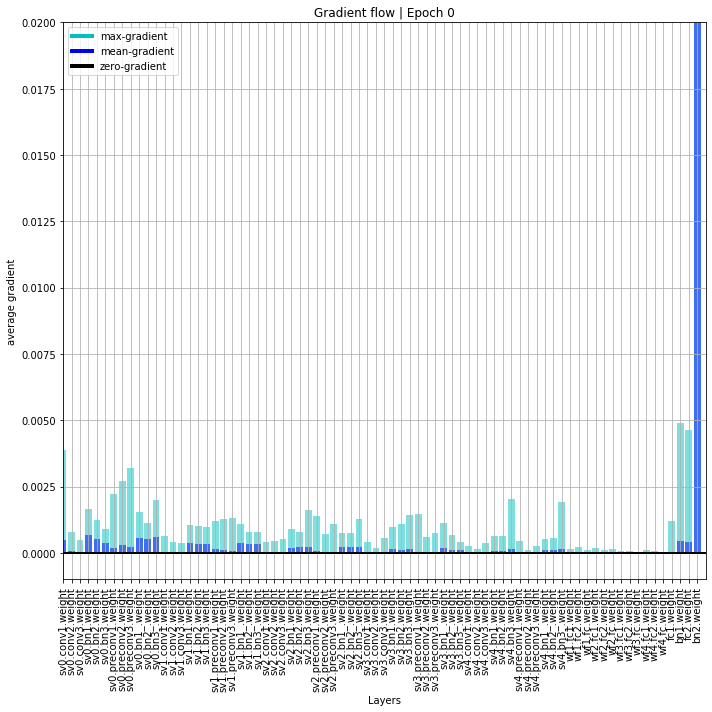

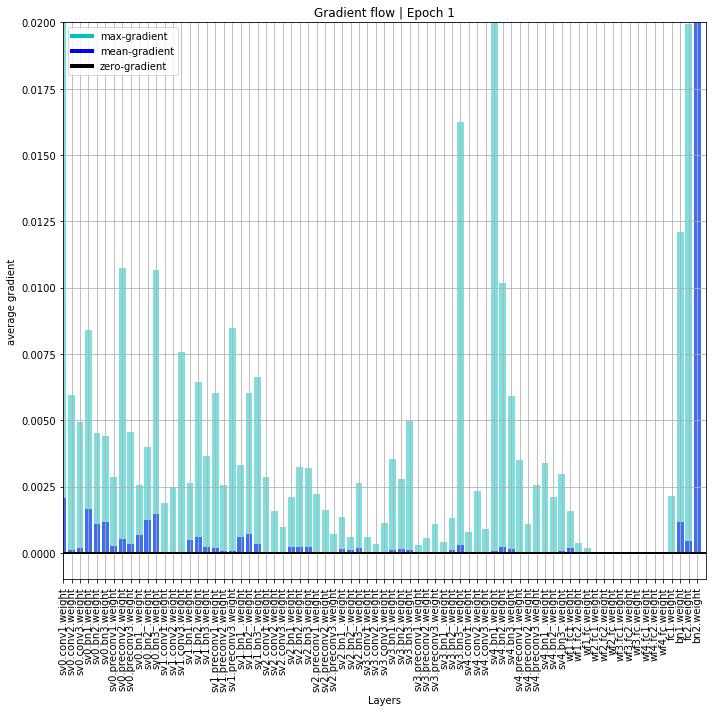

Error in callback <function flush_figures at 0x7f0072f01598> (for post_execute):


KeyboardInterrupt: 

In [9]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet2'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(300):  # loop over the dataset multiple times
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
        print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

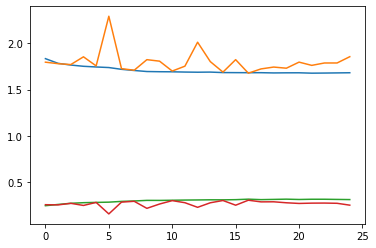

In [10]:
plt.plot(hist)

So bad, I will try another idea

In [2]:
import imageio
images = []
for i in range(25):
    images.append(imageio.imread('/tf/data/Quan/fer2013/backtobasics/svgg7/svgg_resnet2_gf_' + str(i) + '.png'))
imageio.mimsave('/tf/data/Quan/fer2013/backtobasics/svgg7/svgg_resnet2_gf.gif', images)

## SVGG8

In [5]:
class WeightFeature(nn.Module):
    def __init__(self, feature_depth, target_depth):
        super(WeightFeature, self).__init__()

        self.target_depth = target_depth
        self.fc1 = nn.Linear(feature_depth, target_depth)
        self.bn1 = nn.BatchNorm1d(target_depth)
        self.preconv = nn.Conv2d(target_depth, target_depth, kernel_size=1)
        self.preconv_bn = nn.BatchNorm2d(target_depth)
        self.sigmoid = nn.Sigmoid()
        self.bn_out = nn.BatchNorm2d(target_depth)
        
    def forward(self, x1, x2):
        x1 = nn.AvgPool2d(kernel_size=(x1.size(-2), x1.size(-1)))(x1)
        x1 = nn.Flatten()(x1)
#         x1 = self.sigmoid(x1)
        x1 = self.fc1(x1)
        x1 = self.bn1(x1)
        x1 = self.sigmoid(x1)
        x1 = x1.unsqueeze(-1).unsqueeze(-1)

        _x2 = self.preconv(x2)
        _x2 = self.preconv_bn(_x2)
        
        x = torch.mul(_x2,x1)
        x = x + x2
        x = self.bn_out(x)

        return x

In [6]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
        in_neurons: C_in
        nb_neurons: n_filters of conv2d
        '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv_bn1 = nn.BatchNorm2d(nb_neurons)
        
        self.wf1 = WeightFeature(nb_neurons, nb_neurons)
        self.wf2 = WeightFeature(nb_neurons, nb_neurons)
#         self.wf3 = WeightFeature(nb_neurons, nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)

    def forward(self, x):        
        
        x = self.preconv1(x)
        x = self.preconv_bn1(x)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x_wf1 = self.wf1(x1, x1)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
       
        _x2 = x2 + x_wf1
        
        x_wf2 = self.wf2(x2, x2)
        
        # 3rd
        x3 = self.conv3(_x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        _x3 = x3 + x_wf2
        
        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [7]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)

#         self.wf1 = WeightFeature(64, 128).to(self.device)
#         self.wf2 = WeightFeature(128, 256).to(self.device)
#         self.wf3 = WeightFeature(256, 512).to(self.device)

        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x = self.sv0(x)
        x = self.sv1(x)
        x = self.sv2(x)
        x = self.sv3(x)
        x = nn.AvgPool2d(kernel_size=(x.size(-2), x.size(-1)))(x)
        x = nn.Flatten()(x)

        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [8]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.005, weight_decay=1e-3)


cuda


Epoch:  1
	 - Step 1: loss: 2.409 acc: 0.094
	 - Step 2: loss: 2.204 acc: 0.078
	 - Step 3: loss: 2.111 acc: 0.109
	 - Step 4: loss: 2.040 acc: 0.125
	 - Step 5: loss: 1.998 acc: 0.094
	 - Step 6: loss: 1.976 acc: 0.109
	 - Step 7: loss: 2.121 acc: 0.109
	 - Step 8: loss: 1.975 acc: 0.094
	 - Step 9: loss: 1.898 acc: 0.219
	 - Step 10: loss: 1.936 acc: 0.109
	 - Step 11: loss: 1.966 acc: 0.094
	 - Step 12: loss: 1.938 acc: 0.125
	 - Step 13: loss: 1.908 acc: 0.172
	 - Step 14: loss: 1.929 acc: 0.094
	 - Step 15: loss: 2.102 acc: 0.078
	 - Step 16: loss: 1.890 acc: 0.203
	 - Step 17: loss: 1.956 acc: 0.156
	 - Step 18: loss: 1.928 acc: 0.078
	 - Step 19: loss: 1.944 acc: 0.141
	 - Step 20: loss: 1.903 acc: 0.094
	 - Step 21: loss: 1.911 acc: 0.156
	 - Step 22: loss: 1.921 acc: 0.234
	 - Step 23: loss: 1.881 acc: 0.203
	 - Step 24: loss: 1.941 acc: 0.234
	 - Step 25: loss: 1.995 acc: 0.250
	 - Step 26: loss: 1.913 acc: 0.203
	 - Step 27: loss: 1.864 acc: 0.141
	 - Step 28: loss: 1.887 ac

	 - Step 227: loss: 1.769 acc: 0.328
	 - Step 228: loss: 1.768 acc: 0.203
	 - Step 229: loss: 1.766 acc: 0.281
	 - Step 230: loss: 1.864 acc: 0.250
	 - Step 231: loss: 1.940 acc: 0.172
	 - Step 232: loss: 1.817 acc: 0.250
	 - Step 233: loss: 1.839 acc: 0.234
	 - Step 234: loss: 1.748 acc: 0.281
	 - Step 235: loss: 1.859 acc: 0.234
	 - Step 236: loss: 1.792 acc: 0.172
	 - Step 237: loss: 1.839 acc: 0.219
	 - Step 238: loss: 1.817 acc: 0.188
	 - Step 239: loss: 1.698 acc: 0.312
	 - Step 240: loss: 1.814 acc: 0.234
	 - Step 241: loss: 1.798 acc: 0.234
	 - Step 242: loss: 1.826 acc: 0.250
	 - Step 243: loss: 1.840 acc: 0.297
	 - Step 244: loss: 1.877 acc: 0.203
	 - Step 245: loss: 1.766 acc: 0.266
	 - Step 246: loss: 1.827 acc: 0.203
	 - Step 247: loss: 1.796 acc: 0.234
	 - Step 248: loss: 1.697 acc: 0.312
	 - Step 249: loss: 1.840 acc: 0.234
	 - Step 250: loss: 1.782 acc: 0.266
	 - Step 251: loss: 1.863 acc: 0.250
	 - Step 252: loss: 1.823 acc: 0.234
	 - Step 253: loss: 1.804 acc: 0.281
	

- Avg.loss: 1.835  | Avg.acc: 0.238
- Avg. val_loss: 1.818  | Avg. val_acc: 0.249


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type WeightFeature. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


* Update optimal model
Epoch:  2
	 - Step 1: loss: 1.771 acc: 0.312
	 - Step 2: loss: 1.860 acc: 0.250
	 - Step 3: loss: 1.778 acc: 0.328
	 - Step 4: loss: 1.797 acc: 0.344
	 - Step 5: loss: 1.785 acc: 0.250
	 - Step 6: loss: 1.827 acc: 0.250
	 - Step 7: loss: 1.741 acc: 0.266
	 - Step 8: loss: 1.728 acc: 0.344
	 - Step 9: loss: 1.868 acc: 0.219
	 - Step 10: loss: 1.764 acc: 0.266
	 - Step 11: loss: 1.764 acc: 0.281
	 - Step 12: loss: 1.861 acc: 0.188
	 - Step 13: loss: 1.801 acc: 0.281
	 - Step 14: loss: 1.803 acc: 0.250
	 - Step 15: loss: 1.780 acc: 0.297
	 - Step 16: loss: 1.719 acc: 0.359
	 - Step 17: loss: 1.862 acc: 0.266
	 - Step 18: loss: 1.839 acc: 0.156
	 - Step 19: loss: 1.778 acc: 0.234
	 - Step 20: loss: 1.836 acc: 0.219
	 - Step 21: loss: 1.781 acc: 0.312
	 - Step 22: loss: 1.799 acc: 0.266
	 - Step 23: loss: 1.760 acc: 0.328
	 - Step 24: loss: 1.741 acc: 0.312
	 - Step 25: loss: 1.766 acc: 0.250
	 - Step 26: loss: 1.851 acc: 0.141
	 - Step 27: loss: 1.749 acc: 0.312
	 - 

	 - Step 225: loss: 1.830 acc: 0.234
	 - Step 226: loss: 1.816 acc: 0.188
	 - Step 227: loss: 1.789 acc: 0.281
	 - Step 228: loss: 1.798 acc: 0.219
	 - Step 229: loss: 1.785 acc: 0.172
	 - Step 230: loss: 1.741 acc: 0.266
	 - Step 231: loss: 1.859 acc: 0.234
	 - Step 232: loss: 1.845 acc: 0.172
	 - Step 233: loss: 1.829 acc: 0.172
	 - Step 234: loss: 1.748 acc: 0.219
	 - Step 235: loss: 1.767 acc: 0.312
	 - Step 236: loss: 1.804 acc: 0.250
	 - Step 237: loss: 1.791 acc: 0.359
	 - Step 238: loss: 1.725 acc: 0.281
	 - Step 239: loss: 1.752 acc: 0.297
	 - Step 240: loss: 1.769 acc: 0.281
	 - Step 241: loss: 1.730 acc: 0.297
	 - Step 242: loss: 1.778 acc: 0.281
	 - Step 243: loss: 1.757 acc: 0.234
	 - Step 244: loss: 1.751 acc: 0.312
	 - Step 245: loss: 1.774 acc: 0.250
	 - Step 246: loss: 1.742 acc: 0.266
	 - Step 247: loss: 1.816 acc: 0.188
	 - Step 248: loss: 1.814 acc: 0.156
	 - Step 249: loss: 1.744 acc: 0.281
	 - Step 250: loss: 1.791 acc: 0.281
	 - Step 251: loss: 1.810 acc: 0.266
	

	 - Step 447: loss: 1.790 acc: 0.203
	 - Step 448: loss: 1.765 acc: 0.250
	 - Step 449: loss: 1.837 acc: 0.243
- Avg.loss: 1.792  | Avg.acc: 0.251
- Avg. val_loss: 1.831  | Avg. val_acc: 0.252
* Update optimal model
Epoch:  3
	 - Step 1: loss: 1.806 acc: 0.203
	 - Step 2: loss: 1.750 acc: 0.203
	 - Step 3: loss: 1.754 acc: 0.328
	 - Step 4: loss: 1.778 acc: 0.219
	 - Step 5: loss: 1.825 acc: 0.234
	 - Step 6: loss: 1.724 acc: 0.281
	 - Step 7: loss: 1.772 acc: 0.297
	 - Step 8: loss: 1.675 acc: 0.344
	 - Step 9: loss: 1.755 acc: 0.234
	 - Step 10: loss: 1.820 acc: 0.219
	 - Step 11: loss: 1.799 acc: 0.250
	 - Step 12: loss: 1.803 acc: 0.141
	 - Step 13: loss: 1.794 acc: 0.203
	 - Step 14: loss: 1.735 acc: 0.281
	 - Step 15: loss: 1.768 acc: 0.234
	 - Step 16: loss: 1.746 acc: 0.359
	 - Step 17: loss: 1.794 acc: 0.266
	 - Step 18: loss: 1.748 acc: 0.312
	 - Step 19: loss: 1.734 acc: 0.234
	 - Step 20: loss: 1.826 acc: 0.281
	 - Step 21: loss: 1.772 acc: 0.281
	 - Step 22: loss: 1.750 ac

	 - Step 221: loss: 1.743 acc: 0.312
	 - Step 222: loss: 1.919 acc: 0.188
	 - Step 223: loss: 1.673 acc: 0.391
	 - Step 224: loss: 1.729 acc: 0.219
	 - Step 225: loss: 1.753 acc: 0.297
	 - Step 226: loss: 1.812 acc: 0.266
	 - Step 227: loss: 1.903 acc: 0.250
	 - Step 228: loss: 1.794 acc: 0.203
	 - Step 229: loss: 1.897 acc: 0.234
	 - Step 230: loss: 1.838 acc: 0.266
	 - Step 231: loss: 1.748 acc: 0.234
	 - Step 232: loss: 1.778 acc: 0.281
	 - Step 233: loss: 1.841 acc: 0.156
	 - Step 234: loss: 1.764 acc: 0.234
	 - Step 235: loss: 1.808 acc: 0.281
	 - Step 236: loss: 1.702 acc: 0.344
	 - Step 237: loss: 1.863 acc: 0.234
	 - Step 238: loss: 1.820 acc: 0.172
	 - Step 239: loss: 1.786 acc: 0.250
	 - Step 240: loss: 1.856 acc: 0.234
	 - Step 241: loss: 1.793 acc: 0.219
	 - Step 242: loss: 1.807 acc: 0.234
	 - Step 243: loss: 1.796 acc: 0.234
	 - Step 244: loss: 1.690 acc: 0.344
	 - Step 245: loss: 1.834 acc: 0.141
	 - Step 246: loss: 1.795 acc: 0.250
	 - Step 247: loss: 1.874 acc: 0.172
	

	 - Step 443: loss: 1.874 acc: 0.328
	 - Step 444: loss: 1.799 acc: 0.297
	 - Step 445: loss: 1.724 acc: 0.219
	 - Step 446: loss: 1.718 acc: 0.328
	 - Step 447: loss: 1.767 acc: 0.250
	 - Step 448: loss: 1.839 acc: 0.266
	 - Step 449: loss: 1.770 acc: 0.270
- Avg.loss: 1.787  | Avg.acc: 0.251
- Avg. val_loss: 1.938  | Avg. val_acc: 0.249
Epoch:  4
	 - Step 1: loss: 1.798 acc: 0.297
	 - Step 2: loss: 1.855 acc: 0.266
	 - Step 3: loss: 1.787 acc: 0.219
	 - Step 4: loss: 1.913 acc: 0.141
	 - Step 5: loss: 1.780 acc: 0.234
	 - Step 6: loss: 1.716 acc: 0.250
	 - Step 7: loss: 1.818 acc: 0.281
	 - Step 8: loss: 1.771 acc: 0.281
	 - Step 9: loss: 1.795 acc: 0.266
	 - Step 10: loss: 1.771 acc: 0.219
	 - Step 11: loss: 1.736 acc: 0.328
	 - Step 12: loss: 1.693 acc: 0.312
	 - Step 13: loss: 1.680 acc: 0.375
	 - Step 14: loss: 1.850 acc: 0.234
	 - Step 15: loss: 1.781 acc: 0.250
	 - Step 16: loss: 1.808 acc: 0.203
	 - Step 17: loss: 1.769 acc: 0.188
	 - Step 18: loss: 1.852 acc: 0.188
	 - Step 1

	 - Step 217: loss: 1.794 acc: 0.281
	 - Step 218: loss: 1.794 acc: 0.312
	 - Step 219: loss: 1.720 acc: 0.203
	 - Step 220: loss: 1.844 acc: 0.203
	 - Step 221: loss: 1.728 acc: 0.250
	 - Step 222: loss: 1.736 acc: 0.250
	 - Step 223: loss: 1.750 acc: 0.203
	 - Step 224: loss: 1.790 acc: 0.219
	 - Step 225: loss: 1.749 acc: 0.219
	 - Step 226: loss: 1.733 acc: 0.188
	 - Step 227: loss: 1.824 acc: 0.234
	 - Step 228: loss: 1.789 acc: 0.250
	 - Step 229: loss: 1.804 acc: 0.281
	 - Step 230: loss: 1.761 acc: 0.312
	 - Step 231: loss: 1.797 acc: 0.234
	 - Step 232: loss: 1.837 acc: 0.234
	 - Step 233: loss: 1.814 acc: 0.203
	 - Step 234: loss: 1.810 acc: 0.203
	 - Step 235: loss: 1.827 acc: 0.297
	 - Step 236: loss: 1.859 acc: 0.219
	 - Step 237: loss: 1.814 acc: 0.297
	 - Step 238: loss: 1.732 acc: 0.250
	 - Step 239: loss: 1.754 acc: 0.250
	 - Step 240: loss: 1.896 acc: 0.234
	 - Step 241: loss: 1.728 acc: 0.297
	 - Step 242: loss: 1.803 acc: 0.234
	 - Step 243: loss: 1.806 acc: 0.219
	

	 - Step 439: loss: 1.780 acc: 0.250
	 - Step 440: loss: 1.814 acc: 0.297
	 - Step 441: loss: 1.818 acc: 0.297
	 - Step 442: loss: 1.812 acc: 0.234
	 - Step 443: loss: 1.852 acc: 0.172
	 - Step 444: loss: 1.789 acc: 0.250
	 - Step 445: loss: 1.699 acc: 0.344
	 - Step 446: loss: 1.750 acc: 0.297
	 - Step 447: loss: 1.784 acc: 0.156
	 - Step 448: loss: 1.831 acc: 0.203
	 - Step 449: loss: 1.798 acc: 0.324
- Avg.loss: 1.785  | Avg.acc: 0.252
- Avg. val_loss: 1.908  | Avg. val_acc: 0.167
Epoch:  5
	 - Step 1: loss: 1.817 acc: 0.141
	 - Step 2: loss: 1.779 acc: 0.172
	 - Step 3: loss: 1.797 acc: 0.312
	 - Step 4: loss: 1.790 acc: 0.281
	 - Step 5: loss: 1.772 acc: 0.203
	 - Step 6: loss: 1.751 acc: 0.328
	 - Step 7: loss: 1.774 acc: 0.281
	 - Step 8: loss: 1.780 acc: 0.359
	 - Step 9: loss: 1.770 acc: 0.203
	 - Step 10: loss: 1.919 acc: 0.234
	 - Step 11: loss: 1.750 acc: 0.219
	 - Step 12: loss: 1.797 acc: 0.266
	 - Step 13: loss: 1.854 acc: 0.234
	 - Step 14: loss: 1.754 acc: 0.281
	 - St

KeyboardInterrupt: 

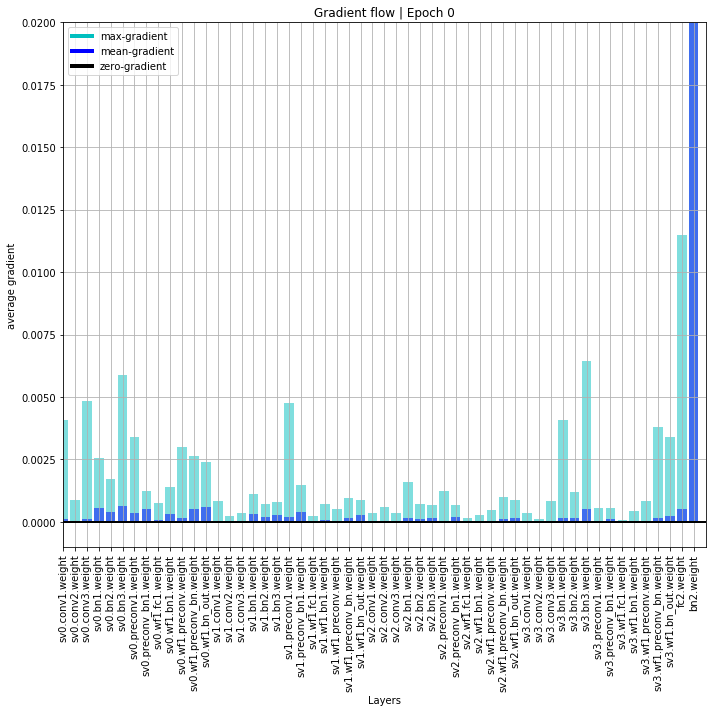

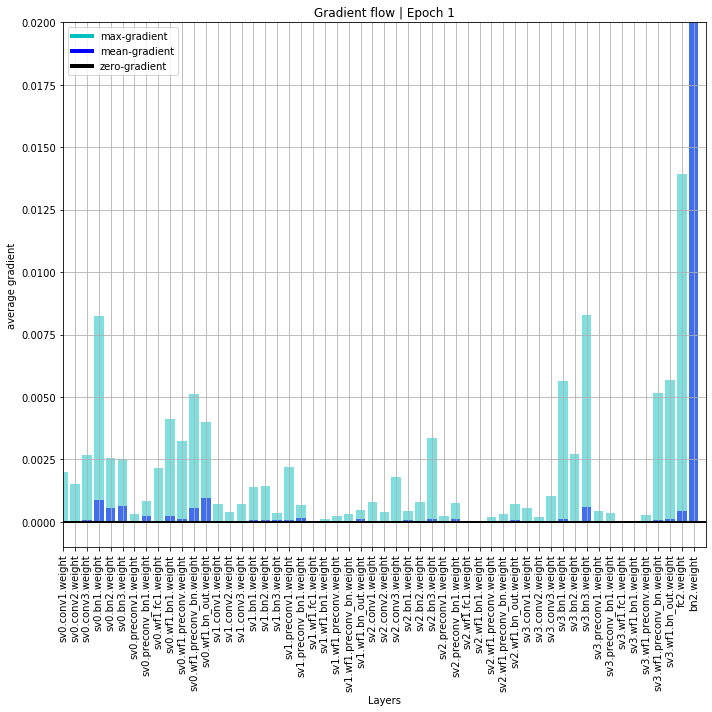

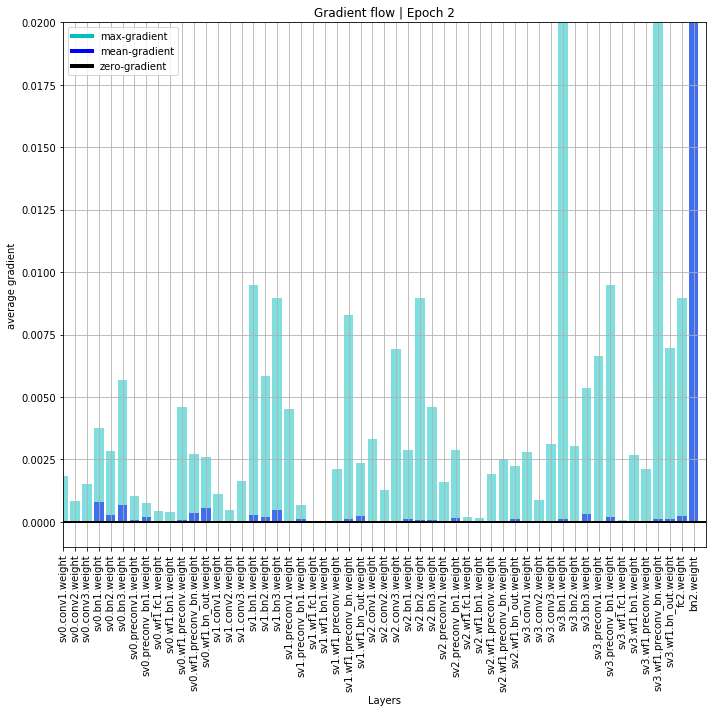

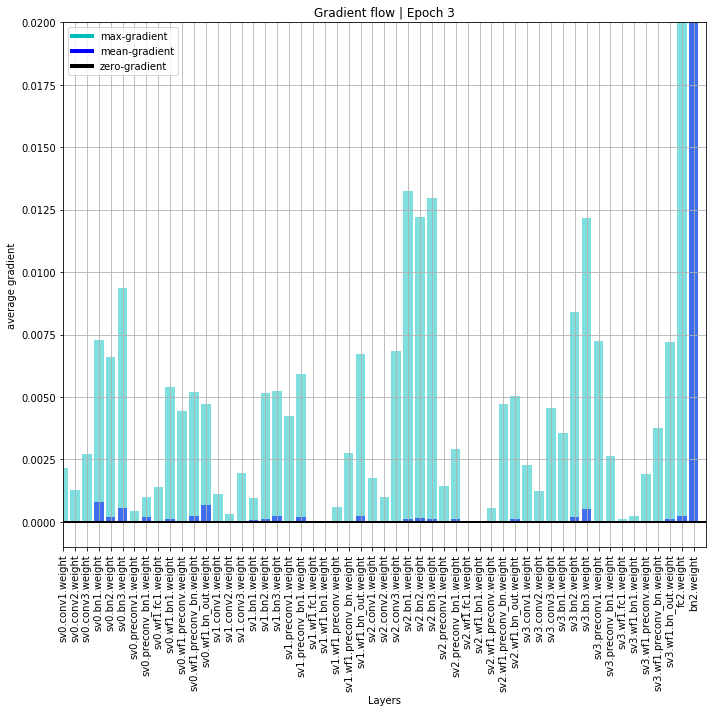

In [9]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg8/'
model_name = 'svgg_resnet'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(300):  # loop over the dataset multiple times
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
        print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

Back to SVGG7 but add more blokcs

## SVGG7-3

In [5]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [25]:
class WeightFeature(nn.Module):
    def __init__(self, feature_depth, target_depth):
        super(WeightFeature, self).__init__()

        self.target_depth = target_depth
        self.fc = nn.Linear(feature_depth*target_depth, target_depth)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x1, x2):
        x1_avg = nn.AvgPool2d(kernel_size=(x1.size(-2), x1.size(-1)))(x1)
        x1_avg = nn.Flatten()(x1_avg)
        x2_avg = nn.AvgPool2d(kernel_size=(x2.size(-2), x2.size(-1)))(x2)
        x2_avg = nn.Flatten()(x2_avg)
        
        cor = torch.matmul(x1_avg.unsqueeze(-1), x2_avg.unsqueeze(1)) # shape feature_depth x target_depth
        cor = nn.Flatten()(cor)
        cor = self.fc(cor)
        cor = self.sigmoid(cor)
        cor = cor.unsqueeze(-1).unsqueeze(-1)

        x_out = x2 * cor

        return x_out

In [26]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)
        self.sv4 = SVblock(256, 512).to(self.device)

        self.wf1 = WeightFeature(64, 128).to(self.device)
        self.wf2 = WeightFeature(128, 256).to(self.device)
        self.wf3 = WeightFeature(256, 512).to(self.device)
        self.wf4 = WeightFeature(512, 1024).to(self.device)

        self.fc1 = nn.Linear(1024, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)

        x1 = self.sv1(x0)
        x_wf1 = self.wf1(x0, x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x1, x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x2, x3)
        
        x4 = self.sv4(x_wf3)
        x_wf4 = self.wf4(x3, x4)

        x_wf4 = nn.AvgPool2d(kernel_size=(x_wf4.size(-2), x_wf4.size(-1)))(x_wf4)
    
        x = nn.Flatten()(x_wf4)

        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [27]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-3)


cuda


Epoch:  1
	 - Step 1: loss: 2.215 acc: 0.156
	 - Step 2: loss: 2.335 acc: 0.172
	 - Step 3: loss: 2.361 acc: 0.156
	 - Step 4: loss: 2.277 acc: 0.219
	 - Step 5: loss: 2.232 acc: 0.125
	 - Step 6: loss: 2.252 acc: 0.203
	 - Step 7: loss: 2.049 acc: 0.203
	 - Step 8: loss: 1.919 acc: 0.234
	 - Step 9: loss: 2.011 acc: 0.188
	 - Step 10: loss: 2.013 acc: 0.188
	 - Step 11: loss: 1.958 acc: 0.266
	 - Step 12: loss: 2.201 acc: 0.047
	 - Step 13: loss: 2.043 acc: 0.234
	 - Step 14: loss: 2.155 acc: 0.250
	 - Step 15: loss: 1.925 acc: 0.250
	 - Step 16: loss: 1.917 acc: 0.250
	 - Step 17: loss: 2.036 acc: 0.250
	 - Step 18: loss: 1.877 acc: 0.312
	 - Step 19: loss: 2.002 acc: 0.172
	 - Step 20: loss: 1.829 acc: 0.266
	 - Step 21: loss: 1.894 acc: 0.156
	 - Step 22: loss: 2.006 acc: 0.344
	 - Step 23: loss: 2.066 acc: 0.203
	 - Step 24: loss: 1.794 acc: 0.375
	 - Step 25: loss: 1.919 acc: 0.250
	 - Step 26: loss: 1.872 acc: 0.219
	 - Step 27: loss: 1.948 acc: 0.203
	 - Step 28: loss: 1.868 ac

	 - Step 227: loss: 1.805 acc: 0.297
	 - Step 228: loss: 1.770 acc: 0.328
	 - Step 229: loss: 1.836 acc: 0.250
	 - Step 230: loss: 1.785 acc: 0.344
	 - Step 231: loss: 1.826 acc: 0.234
	 - Step 232: loss: 1.851 acc: 0.297
	 - Step 233: loss: 1.794 acc: 0.312
	 - Step 234: loss: 1.916 acc: 0.297
	 - Step 235: loss: 1.793 acc: 0.312
	 - Step 236: loss: 1.930 acc: 0.156
	 - Step 237: loss: 1.783 acc: 0.266
	 - Step 238: loss: 1.855 acc: 0.234
	 - Step 239: loss: 1.881 acc: 0.234
	 - Step 240: loss: 1.831 acc: 0.281
	 - Step 241: loss: 1.820 acc: 0.359
	 - Step 242: loss: 1.802 acc: 0.250
	 - Step 243: loss: 1.794 acc: 0.359
	 - Step 244: loss: 1.857 acc: 0.297
	 - Step 245: loss: 1.930 acc: 0.172
	 - Step 246: loss: 1.822 acc: 0.312
	 - Step 247: loss: 1.860 acc: 0.266
	 - Step 248: loss: 1.740 acc: 0.391
	 - Step 249: loss: 1.888 acc: 0.312
	 - Step 250: loss: 1.819 acc: 0.281
	 - Step 251: loss: 1.867 acc: 0.219
	 - Step 252: loss: 1.788 acc: 0.312
	 - Step 253: loss: 1.841 acc: 0.266
	

	 - Step 449: loss: 2.034 acc: 0.216
- Avg.loss: 1.871  | Avg.acc: 0.248
- Avg. val_loss: 1.868  | Avg. val_acc: 0.267


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type WeightFeature. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


* Update optimal model
Epoch:  2
	 - Step 1: loss: 1.913 acc: 0.219
	 - Step 2: loss: 1.883 acc: 0.234
	 - Step 3: loss: 1.816 acc: 0.234
	 - Step 4: loss: 1.785 acc: 0.344
	 - Step 5: loss: 1.702 acc: 0.406
	 - Step 6: loss: 1.833 acc: 0.234
	 - Step 7: loss: 1.824 acc: 0.297
	 - Step 8: loss: 1.791 acc: 0.328
	 - Step 9: loss: 1.819 acc: 0.234
	 - Step 10: loss: 1.852 acc: 0.234
	 - Step 11: loss: 1.822 acc: 0.328
	 - Step 12: loss: 1.768 acc: 0.281
	 - Step 13: loss: 1.857 acc: 0.203
	 - Step 14: loss: 1.778 acc: 0.266
	 - Step 15: loss: 1.778 acc: 0.344
	 - Step 16: loss: 1.837 acc: 0.281
	 - Step 17: loss: 1.738 acc: 0.406
	 - Step 18: loss: 1.760 acc: 0.312
	 - Step 19: loss: 1.878 acc: 0.219
	 - Step 20: loss: 1.877 acc: 0.234
	 - Step 21: loss: 1.798 acc: 0.281
	 - Step 22: loss: 1.905 acc: 0.234
	 - Step 23: loss: 1.846 acc: 0.156
	 - Step 24: loss: 1.870 acc: 0.203
	 - Step 25: loss: 1.821 acc: 0.250
	 - Step 26: loss: 1.788 acc: 0.266
	 - Step 27: loss: 1.785 acc: 0.297
	 - 

	 - Step 225: loss: 1.774 acc: 0.312
	 - Step 226: loss: 1.812 acc: 0.188
	 - Step 227: loss: 1.781 acc: 0.281
	 - Step 228: loss: 1.682 acc: 0.391
	 - Step 229: loss: 1.772 acc: 0.297
	 - Step 230: loss: 1.874 acc: 0.250
	 - Step 231: loss: 1.777 acc: 0.297
	 - Step 232: loss: 1.816 acc: 0.203
	 - Step 233: loss: 1.787 acc: 0.250
	 - Step 234: loss: 1.846 acc: 0.250
	 - Step 235: loss: 1.842 acc: 0.203
	 - Step 236: loss: 1.847 acc: 0.250
	 - Step 237: loss: 1.742 acc: 0.344
	 - Step 238: loss: 1.802 acc: 0.266
	 - Step 239: loss: 1.835 acc: 0.234
	 - Step 240: loss: 1.727 acc: 0.344
	 - Step 241: loss: 1.760 acc: 0.250
	 - Step 242: loss: 1.783 acc: 0.281
	 - Step 243: loss: 1.794 acc: 0.297
	 - Step 244: loss: 1.758 acc: 0.297
	 - Step 245: loss: 1.773 acc: 0.297
	 - Step 246: loss: 1.738 acc: 0.359
	 - Step 247: loss: 1.848 acc: 0.219
	 - Step 248: loss: 1.801 acc: 0.203
	 - Step 249: loss: 1.828 acc: 0.266
	 - Step 250: loss: 1.744 acc: 0.297
	 - Step 251: loss: 1.788 acc: 0.250
	

	 - Step 447: loss: 1.691 acc: 0.422
	 - Step 448: loss: 1.659 acc: 0.359
	 - Step 449: loss: 1.591 acc: 0.432
- Avg.loss: 1.777  | Avg.acc: 0.290
- Avg. val_loss: 1.830  | Avg. val_acc: 0.265
Epoch:  3
	 - Step 1: loss: 1.876 acc: 0.234
	 - Step 2: loss: 1.704 acc: 0.297
	 - Step 3: loss: 1.816 acc: 0.312
	 - Step 4: loss: 1.713 acc: 0.266
	 - Step 5: loss: 1.702 acc: 0.297
	 - Step 6: loss: 1.731 acc: 0.328
	 - Step 7: loss: 1.767 acc: 0.344
	 - Step 8: loss: 1.760 acc: 0.297
	 - Step 9: loss: 1.724 acc: 0.344
	 - Step 10: loss: 1.678 acc: 0.391
	 - Step 11: loss: 1.716 acc: 0.281
	 - Step 12: loss: 1.719 acc: 0.281
	 - Step 13: loss: 1.804 acc: 0.281
	 - Step 14: loss: 1.625 acc: 0.344
	 - Step 15: loss: 1.703 acc: 0.391
	 - Step 16: loss: 1.832 acc: 0.312
	 - Step 17: loss: 1.559 acc: 0.453
	 - Step 18: loss: 1.591 acc: 0.422
	 - Step 19: loss: 1.717 acc: 0.328
	 - Step 20: loss: 1.704 acc: 0.375
	 - Step 21: loss: 1.679 acc: 0.312
	 - Step 22: loss: 1.751 acc: 0.250
	 - Step 23: l

	 - Step 221: loss: 1.787 acc: 0.297
	 - Step 222: loss: 1.608 acc: 0.406
	 - Step 223: loss: 1.864 acc: 0.219
	 - Step 224: loss: 1.590 acc: 0.422
	 - Step 225: loss: 1.841 acc: 0.219
	 - Step 226: loss: 1.572 acc: 0.422
	 - Step 227: loss: 1.798 acc: 0.328
	 - Step 228: loss: 1.679 acc: 0.328
	 - Step 229: loss: 1.716 acc: 0.312
	 - Step 230: loss: 1.733 acc: 0.219
	 - Step 231: loss: 1.720 acc: 0.234
	 - Step 232: loss: 1.667 acc: 0.375
	 - Step 233: loss: 1.675 acc: 0.344
	 - Step 234: loss: 1.640 acc: 0.375
	 - Step 235: loss: 1.582 acc: 0.391
	 - Step 236: loss: 1.758 acc: 0.328
	 - Step 237: loss: 1.698 acc: 0.297
	 - Step 238: loss: 1.583 acc: 0.359
	 - Step 239: loss: 1.636 acc: 0.453
	 - Step 240: loss: 1.639 acc: 0.344
	 - Step 241: loss: 1.635 acc: 0.359
	 - Step 242: loss: 1.748 acc: 0.312
	 - Step 243: loss: 1.766 acc: 0.250
	 - Step 244: loss: 1.673 acc: 0.281
	 - Step 245: loss: 1.723 acc: 0.359
	 - Step 246: loss: 1.722 acc: 0.344
	 - Step 247: loss: 1.564 acc: 0.344
	

	 - Step 443: loss: 1.797 acc: 0.266
	 - Step 444: loss: 1.761 acc: 0.328
	 - Step 445: loss: 1.600 acc: 0.391
	 - Step 446: loss: 1.586 acc: 0.438
	 - Step 447: loss: 1.756 acc: 0.375
	 - Step 448: loss: 1.430 acc: 0.516
	 - Step 449: loss: 1.708 acc: 0.297
- Avg.loss: 1.692  | Avg.acc: 0.332
- Avg. val_loss: 1.872  | Avg. val_acc: 0.226
Epoch:  4
	 - Step 1: loss: 1.626 acc: 0.359
	 - Step 2: loss: 1.592 acc: 0.359
	 - Step 3: loss: 1.616 acc: 0.328
	 - Step 4: loss: 1.510 acc: 0.391
	 - Step 5: loss: 1.451 acc: 0.484
	 - Step 6: loss: 1.646 acc: 0.375
	 - Step 7: loss: 1.616 acc: 0.375
	 - Step 8: loss: 1.775 acc: 0.297
	 - Step 9: loss: 1.538 acc: 0.453
	 - Step 10: loss: 1.828 acc: 0.234
	 - Step 11: loss: 1.624 acc: 0.391
	 - Step 12: loss: 1.928 acc: 0.203
	 - Step 13: loss: 1.835 acc: 0.234
	 - Step 14: loss: 1.627 acc: 0.328
	 - Step 15: loss: 1.836 acc: 0.203
	 - Step 16: loss: 1.687 acc: 0.344
	 - Step 17: loss: 1.607 acc: 0.359
	 - Step 18: loss: 1.734 acc: 0.250
	 - Step 1

	 - Step 217: loss: 1.583 acc: 0.375
	 - Step 218: loss: 1.676 acc: 0.281
	 - Step 219: loss: 1.715 acc: 0.344
	 - Step 220: loss: 1.748 acc: 0.266
	 - Step 221: loss: 1.673 acc: 0.391
	 - Step 222: loss: 1.553 acc: 0.328
	 - Step 223: loss: 1.678 acc: 0.312
	 - Step 224: loss: 1.598 acc: 0.406
	 - Step 225: loss: 1.606 acc: 0.328
	 - Step 226: loss: 1.753 acc: 0.328
	 - Step 227: loss: 1.486 acc: 0.453
	 - Step 228: loss: 1.605 acc: 0.328
	 - Step 229: loss: 1.719 acc: 0.359
	 - Step 230: loss: 1.593 acc: 0.391
	 - Step 231: loss: 1.642 acc: 0.266
	 - Step 232: loss: 1.690 acc: 0.359
	 - Step 233: loss: 1.754 acc: 0.281
	 - Step 234: loss: 1.717 acc: 0.266
	 - Step 235: loss: 1.548 acc: 0.375
	 - Step 236: loss: 1.547 acc: 0.312
	 - Step 237: loss: 1.570 acc: 0.344
	 - Step 238: loss: 1.648 acc: 0.406
	 - Step 239: loss: 1.586 acc: 0.391
	 - Step 240: loss: 1.741 acc: 0.312
	 - Step 241: loss: 1.649 acc: 0.391
	 - Step 242: loss: 1.639 acc: 0.344
	 - Step 243: loss: 1.449 acc: 0.469
	

	 - Step 439: loss: 1.562 acc: 0.391
	 - Step 440: loss: 1.720 acc: 0.328
	 - Step 441: loss: 1.707 acc: 0.328
	 - Step 442: loss: 1.857 acc: 0.219
	 - Step 443: loss: 1.659 acc: 0.328
	 - Step 444: loss: 1.661 acc: 0.359
	 - Step 445: loss: 1.594 acc: 0.359
	 - Step 446: loss: 1.666 acc: 0.281
	 - Step 447: loss: 1.637 acc: 0.328
	 - Step 448: loss: 1.579 acc: 0.359
	 - Step 449: loss: 1.614 acc: 0.351
- Avg.loss: 1.644  | Avg.acc: 0.348
- Avg. val_loss: 1.722  | Avg. val_acc: 0.330
* Update optimal model
Epoch:  5
	 - Step 1: loss: 1.528 acc: 0.406
	 - Step 2: loss: 1.628 acc: 0.312
	 - Step 3: loss: 1.579 acc: 0.266
	 - Step 4: loss: 1.575 acc: 0.375
	 - Step 5: loss: 1.665 acc: 0.359
	 - Step 6: loss: 1.597 acc: 0.422
	 - Step 7: loss: 1.752 acc: 0.328
	 - Step 8: loss: 1.734 acc: 0.344
	 - Step 9: loss: 1.653 acc: 0.375
	 - Step 10: loss: 1.610 acc: 0.359
	 - Step 11: loss: 1.614 acc: 0.391
	 - Step 12: loss: 1.454 acc: 0.422
	 - Step 13: loss: 1.579 acc: 0.422
	 - Step 14: loss: 

	 - Step 213: loss: 1.554 acc: 0.422
	 - Step 214: loss: 1.558 acc: 0.453
	 - Step 215: loss: 1.661 acc: 0.297
	 - Step 216: loss: 1.851 acc: 0.188
	 - Step 217: loss: 1.621 acc: 0.344
	 - Step 218: loss: 1.595 acc: 0.328
	 - Step 219: loss: 1.701 acc: 0.328
	 - Step 220: loss: 1.610 acc: 0.312
	 - Step 221: loss: 1.639 acc: 0.359
	 - Step 222: loss: 1.489 acc: 0.438
	 - Step 223: loss: 1.858 acc: 0.281
	 - Step 224: loss: 1.634 acc: 0.359
	 - Step 225: loss: 1.735 acc: 0.266
	 - Step 226: loss: 1.521 acc: 0.469
	 - Step 227: loss: 1.448 acc: 0.453
	 - Step 228: loss: 1.539 acc: 0.406
	 - Step 229: loss: 1.744 acc: 0.312
	 - Step 230: loss: 1.568 acc: 0.328
	 - Step 231: loss: 1.561 acc: 0.375
	 - Step 232: loss: 1.662 acc: 0.469
	 - Step 233: loss: 1.594 acc: 0.328
	 - Step 234: loss: 1.683 acc: 0.297
	 - Step 235: loss: 1.683 acc: 0.312
	 - Step 236: loss: 1.682 acc: 0.328
	 - Step 237: loss: 1.510 acc: 0.359
	 - Step 238: loss: 1.452 acc: 0.484
	 - Step 239: loss: 1.637 acc: 0.406
	

	 - Step 435: loss: 1.565 acc: 0.422
	 - Step 436: loss: 1.579 acc: 0.406
	 - Step 437: loss: 1.683 acc: 0.234
	 - Step 438: loss: 1.661 acc: 0.344
	 - Step 439: loss: 1.648 acc: 0.359
	 - Step 440: loss: 1.585 acc: 0.312
	 - Step 441: loss: 1.608 acc: 0.375
	 - Step 442: loss: 1.690 acc: 0.406
	 - Step 443: loss: 1.585 acc: 0.359
	 - Step 444: loss: 1.734 acc: 0.297
	 - Step 445: loss: 1.572 acc: 0.359
	 - Step 446: loss: 1.653 acc: 0.344
	 - Step 447: loss: 1.645 acc: 0.328
	 - Step 448: loss: 1.531 acc: 0.375
	 - Step 449: loss: 1.483 acc: 0.378
- Avg.loss: 1.614  | Avg.acc: 0.365
- Avg. val_loss: 1.685  | Avg. val_acc: 0.336
* Update optimal model
Epoch:  6
	 - Step 1: loss: 1.422 acc: 0.406
	 - Step 2: loss: 1.782 acc: 0.328
	 - Step 3: loss: 1.487 acc: 0.406
	 - Step 4: loss: 1.527 acc: 0.375
	 - Step 5: loss: 1.490 acc: 0.375
	 - Step 6: loss: 1.768 acc: 0.203
	 - Step 7: loss: 1.551 acc: 0.438
	 - Step 8: loss: 1.650 acc: 0.359
	 - Step 9: loss: 1.560 acc: 0.391
	 - Step 10: lo

	 - Step 209: loss: 1.374 acc: 0.516
	 - Step 210: loss: 1.704 acc: 0.312
	 - Step 211: loss: 1.513 acc: 0.422
	 - Step 212: loss: 1.502 acc: 0.469
	 - Step 213: loss: 1.637 acc: 0.344
	 - Step 214: loss: 1.526 acc: 0.375
	 - Step 215: loss: 1.498 acc: 0.422
	 - Step 216: loss: 1.556 acc: 0.391
	 - Step 217: loss: 1.441 acc: 0.484
	 - Step 218: loss: 1.546 acc: 0.328
	 - Step 219: loss: 1.406 acc: 0.453
	 - Step 220: loss: 1.525 acc: 0.391
	 - Step 221: loss: 1.765 acc: 0.266
	 - Step 222: loss: 1.684 acc: 0.391
	 - Step 223: loss: 1.491 acc: 0.391
	 - Step 224: loss: 1.605 acc: 0.375
	 - Step 225: loss: 1.449 acc: 0.469
	 - Step 226: loss: 1.562 acc: 0.344
	 - Step 227: loss: 1.482 acc: 0.359
	 - Step 228: loss: 1.497 acc: 0.484
	 - Step 229: loss: 1.583 acc: 0.359
	 - Step 230: loss: 1.556 acc: 0.391
	 - Step 231: loss: 1.440 acc: 0.422
	 - Step 232: loss: 1.532 acc: 0.406
	 - Step 233: loss: 1.519 acc: 0.391
	 - Step 234: loss: 1.553 acc: 0.359
	 - Step 235: loss: 1.639 acc: 0.375
	

	 - Step 431: loss: 1.786 acc: 0.234
	 - Step 432: loss: 1.768 acc: 0.266
	 - Step 433: loss: 1.555 acc: 0.422
	 - Step 434: loss: 1.525 acc: 0.453
	 - Step 435: loss: 1.571 acc: 0.406
	 - Step 436: loss: 1.527 acc: 0.391
	 - Step 437: loss: 1.475 acc: 0.406
	 - Step 438: loss: 1.620 acc: 0.359
	 - Step 439: loss: 1.435 acc: 0.422
	 - Step 440: loss: 1.487 acc: 0.422
	 - Step 441: loss: 1.508 acc: 0.297
	 - Step 442: loss: 1.400 acc: 0.484
	 - Step 443: loss: 1.708 acc: 0.344
	 - Step 444: loss: 1.522 acc: 0.328
	 - Step 445: loss: 1.556 acc: 0.312
	 - Step 446: loss: 1.515 acc: 0.406
	 - Step 447: loss: 1.547 acc: 0.328
	 - Step 448: loss: 1.544 acc: 0.359
	 - Step 449: loss: 1.444 acc: 0.486
- Avg.loss: 1.570  | Avg.acc: 0.384
- Avg. val_loss: 1.597  | Avg. val_acc: 0.382
* Update optimal model
Epoch:  7
	 - Step 1: loss: 1.497 acc: 0.484
	 - Step 2: loss: 1.619 acc: 0.359
	 - Step 3: loss: 1.564 acc: 0.453
	 - Step 4: loss: 1.374 acc: 0.547
	 - Step 5: loss: 1.482 acc: 0.422
	 - Ste

	 - Step 205: loss: 1.574 acc: 0.375
	 - Step 206: loss: 1.580 acc: 0.359
	 - Step 207: loss: 1.635 acc: 0.391
	 - Step 208: loss: 1.598 acc: 0.344
	 - Step 209: loss: 1.491 acc: 0.422
	 - Step 210: loss: 1.478 acc: 0.438
	 - Step 211: loss: 1.460 acc: 0.516
	 - Step 212: loss: 1.563 acc: 0.406
	 - Step 213: loss: 1.376 acc: 0.469
	 - Step 214: loss: 1.558 acc: 0.438
	 - Step 215: loss: 1.594 acc: 0.406
	 - Step 216: loss: 1.483 acc: 0.484
	 - Step 217: loss: 1.630 acc: 0.359
	 - Step 218: loss: 1.595 acc: 0.375
	 - Step 219: loss: 1.482 acc: 0.469
	 - Step 220: loss: 1.582 acc: 0.406
	 - Step 221: loss: 1.562 acc: 0.375
	 - Step 222: loss: 1.470 acc: 0.406
	 - Step 223: loss: 1.532 acc: 0.406
	 - Step 224: loss: 1.479 acc: 0.438
	 - Step 225: loss: 1.452 acc: 0.375
	 - Step 226: loss: 1.466 acc: 0.359
	 - Step 227: loss: 1.310 acc: 0.469
	 - Step 228: loss: 1.360 acc: 0.547
	 - Step 229: loss: 1.640 acc: 0.391
	 - Step 230: loss: 1.493 acc: 0.406
	 - Step 231: loss: 1.458 acc: 0.453
	

	 - Step 427: loss: 1.439 acc: 0.422
	 - Step 428: loss: 1.431 acc: 0.453
	 - Step 429: loss: 1.501 acc: 0.438
	 - Step 430: loss: 1.463 acc: 0.547
	 - Step 431: loss: 1.536 acc: 0.453
	 - Step 432: loss: 1.505 acc: 0.406
	 - Step 433: loss: 1.483 acc: 0.406
	 - Step 434: loss: 1.540 acc: 0.375
	 - Step 435: loss: 1.619 acc: 0.391
	 - Step 436: loss: 1.512 acc: 0.422
	 - Step 437: loss: 1.456 acc: 0.406
	 - Step 438: loss: 1.483 acc: 0.328
	 - Step 439: loss: 1.471 acc: 0.469
	 - Step 440: loss: 1.474 acc: 0.438
	 - Step 441: loss: 1.428 acc: 0.422
	 - Step 442: loss: 1.424 acc: 0.469
	 - Step 443: loss: 1.534 acc: 0.359
	 - Step 444: loss: 1.601 acc: 0.391
	 - Step 445: loss: 1.417 acc: 0.484
	 - Step 446: loss: 1.640 acc: 0.359
	 - Step 447: loss: 1.328 acc: 0.531
	 - Step 448: loss: 1.351 acc: 0.531
	 - Step 449: loss: 1.489 acc: 0.324
- Avg.loss: 1.519  | Avg.acc: 0.413
- Avg. val_loss: 1.595  | Avg. val_acc: 0.396
* Update optimal model
Epoch:  8
	 - Step 1: loss: 1.458 acc: 0.438

	 - Step 201: loss: 1.584 acc: 0.375
	 - Step 202: loss: 1.424 acc: 0.500
	 - Step 203: loss: 1.402 acc: 0.438
	 - Step 204: loss: 1.504 acc: 0.422
	 - Step 205: loss: 1.333 acc: 0.469
	 - Step 206: loss: 1.509 acc: 0.391
	 - Step 207: loss: 1.679 acc: 0.344
	 - Step 208: loss: 1.537 acc: 0.391
	 - Step 209: loss: 1.253 acc: 0.516
	 - Step 210: loss: 1.383 acc: 0.438
	 - Step 211: loss: 1.584 acc: 0.359
	 - Step 212: loss: 1.468 acc: 0.406
	 - Step 213: loss: 1.420 acc: 0.500
	 - Step 214: loss: 1.529 acc: 0.422
	 - Step 215: loss: 1.445 acc: 0.438
	 - Step 216: loss: 1.555 acc: 0.391
	 - Step 217: loss: 1.507 acc: 0.406
	 - Step 218: loss: 1.474 acc: 0.391
	 - Step 219: loss: 1.340 acc: 0.453
	 - Step 220: loss: 1.447 acc: 0.500
	 - Step 221: loss: 1.413 acc: 0.516
	 - Step 222: loss: 1.499 acc: 0.375
	 - Step 223: loss: 1.464 acc: 0.438
	 - Step 224: loss: 1.597 acc: 0.328
	 - Step 225: loss: 1.527 acc: 0.406
	 - Step 226: loss: 1.478 acc: 0.438
	 - Step 227: loss: 1.424 acc: 0.438
	

	 - Step 423: loss: 1.400 acc: 0.531
	 - Step 424: loss: 1.421 acc: 0.422
	 - Step 425: loss: 1.482 acc: 0.453
	 - Step 426: loss: 1.383 acc: 0.406
	 - Step 427: loss: 1.500 acc: 0.359
	 - Step 428: loss: 1.486 acc: 0.406
	 - Step 429: loss: 1.337 acc: 0.453
	 - Step 430: loss: 1.349 acc: 0.516
	 - Step 431: loss: 1.522 acc: 0.391
	 - Step 432: loss: 1.474 acc: 0.406
	 - Step 433: loss: 1.489 acc: 0.453
	 - Step 434: loss: 1.675 acc: 0.344
	 - Step 435: loss: 1.542 acc: 0.406
	 - Step 436: loss: 1.488 acc: 0.453
	 - Step 437: loss: 1.574 acc: 0.453
	 - Step 438: loss: 1.650 acc: 0.328
	 - Step 439: loss: 1.394 acc: 0.484
	 - Step 440: loss: 1.516 acc: 0.422
	 - Step 441: loss: 1.520 acc: 0.422
	 - Step 442: loss: 1.471 acc: 0.422
	 - Step 443: loss: 1.441 acc: 0.391
	 - Step 444: loss: 1.484 acc: 0.359
	 - Step 445: loss: 1.637 acc: 0.359
	 - Step 446: loss: 1.643 acc: 0.422
	 - Step 447: loss: 1.525 acc: 0.391
	 - Step 448: loss: 1.469 acc: 0.453
	 - Step 449: loss: 1.495 acc: 0.432
-

	 - Step 197: loss: 1.424 acc: 0.469
	 - Step 198: loss: 1.389 acc: 0.422
	 - Step 199: loss: 1.391 acc: 0.469
	 - Step 200: loss: 1.477 acc: 0.438
	 - Step 201: loss: 1.372 acc: 0.453
	 - Step 202: loss: 1.405 acc: 0.531
	 - Step 203: loss: 1.499 acc: 0.375
	 - Step 204: loss: 1.419 acc: 0.469
	 - Step 205: loss: 1.355 acc: 0.500
	 - Step 206: loss: 1.475 acc: 0.469
	 - Step 207: loss: 1.232 acc: 0.516
	 - Step 208: loss: 1.402 acc: 0.438
	 - Step 209: loss: 1.571 acc: 0.453
	 - Step 210: loss: 1.289 acc: 0.484
	 - Step 211: loss: 1.414 acc: 0.469
	 - Step 212: loss: 1.385 acc: 0.406
	 - Step 213: loss: 1.381 acc: 0.469
	 - Step 214: loss: 1.346 acc: 0.500
	 - Step 215: loss: 1.455 acc: 0.469
	 - Step 216: loss: 1.775 acc: 0.344
	 - Step 217: loss: 1.438 acc: 0.438
	 - Step 218: loss: 1.505 acc: 0.391
	 - Step 219: loss: 1.410 acc: 0.438
	 - Step 220: loss: 1.365 acc: 0.516
	 - Step 221: loss: 1.385 acc: 0.422
	 - Step 222: loss: 1.396 acc: 0.438
	 - Step 223: loss: 1.639 acc: 0.406
	

	 - Step 419: loss: 1.485 acc: 0.500
	 - Step 420: loss: 1.460 acc: 0.484
	 - Step 421: loss: 1.453 acc: 0.531
	 - Step 422: loss: 1.427 acc: 0.406
	 - Step 423: loss: 1.362 acc: 0.484
	 - Step 424: loss: 1.362 acc: 0.453
	 - Step 425: loss: 1.217 acc: 0.469
	 - Step 426: loss: 1.295 acc: 0.578
	 - Step 427: loss: 1.502 acc: 0.359
	 - Step 428: loss: 1.375 acc: 0.453
	 - Step 429: loss: 1.376 acc: 0.469
	 - Step 430: loss: 1.478 acc: 0.453
	 - Step 431: loss: 1.423 acc: 0.359
	 - Step 432: loss: 1.584 acc: 0.375
	 - Step 433: loss: 1.315 acc: 0.516
	 - Step 434: loss: 1.336 acc: 0.547
	 - Step 435: loss: 1.317 acc: 0.500
	 - Step 436: loss: 1.476 acc: 0.453
	 - Step 437: loss: 1.641 acc: 0.328
	 - Step 438: loss: 1.160 acc: 0.609
	 - Step 439: loss: 1.689 acc: 0.297
	 - Step 440: loss: 1.257 acc: 0.484
	 - Step 441: loss: 1.552 acc: 0.359
	 - Step 442: loss: 1.259 acc: 0.406
	 - Step 443: loss: 1.368 acc: 0.453
	 - Step 444: loss: 1.410 acc: 0.453
	 - Step 445: loss: 1.526 acc: 0.359
	

	 - Step 193: loss: 1.419 acc: 0.391
	 - Step 194: loss: 1.422 acc: 0.453
	 - Step 195: loss: 1.551 acc: 0.297
	 - Step 196: loss: 1.531 acc: 0.438
	 - Step 197: loss: 1.411 acc: 0.438
	 - Step 198: loss: 1.520 acc: 0.391
	 - Step 199: loss: 1.674 acc: 0.359
	 - Step 200: loss: 1.421 acc: 0.438
	 - Step 201: loss: 1.608 acc: 0.359
	 - Step 202: loss: 1.466 acc: 0.391
	 - Step 203: loss: 1.406 acc: 0.453
	 - Step 204: loss: 1.487 acc: 0.406
	 - Step 205: loss: 1.551 acc: 0.453
	 - Step 206: loss: 1.407 acc: 0.500
	 - Step 207: loss: 1.434 acc: 0.406
	 - Step 208: loss: 1.290 acc: 0.516
	 - Step 209: loss: 1.314 acc: 0.500
	 - Step 210: loss: 1.401 acc: 0.406
	 - Step 211: loss: 1.562 acc: 0.359
	 - Step 212: loss: 1.370 acc: 0.438
	 - Step 213: loss: 1.407 acc: 0.438
	 - Step 214: loss: 1.467 acc: 0.359
	 - Step 215: loss: 1.271 acc: 0.547
	 - Step 216: loss: 1.323 acc: 0.531
	 - Step 217: loss: 1.567 acc: 0.391
	 - Step 218: loss: 1.255 acc: 0.547
	 - Step 219: loss: 1.426 acc: 0.438
	

	 - Step 415: loss: 1.529 acc: 0.359
	 - Step 416: loss: 1.575 acc: 0.422
	 - Step 417: loss: 1.336 acc: 0.422
	 - Step 418: loss: 1.342 acc: 0.484
	 - Step 419: loss: 1.342 acc: 0.484
	 - Step 420: loss: 1.434 acc: 0.406
	 - Step 421: loss: 1.514 acc: 0.484
	 - Step 422: loss: 1.364 acc: 0.516
	 - Step 423: loss: 1.404 acc: 0.406
	 - Step 424: loss: 1.372 acc: 0.438
	 - Step 425: loss: 1.361 acc: 0.453
	 - Step 426: loss: 1.465 acc: 0.438
	 - Step 427: loss: 1.622 acc: 0.359
	 - Step 428: loss: 1.515 acc: 0.438
	 - Step 429: loss: 1.210 acc: 0.562
	 - Step 430: loss: 1.423 acc: 0.547
	 - Step 431: loss: 1.480 acc: 0.438
	 - Step 432: loss: 1.476 acc: 0.344
	 - Step 433: loss: 1.298 acc: 0.469
	 - Step 434: loss: 1.320 acc: 0.500
	 - Step 435: loss: 1.290 acc: 0.500
	 - Step 436: loss: 1.275 acc: 0.484
	 - Step 437: loss: 1.506 acc: 0.375
	 - Step 438: loss: 1.272 acc: 0.500
	 - Step 439: loss: 1.511 acc: 0.328
	 - Step 440: loss: 1.345 acc: 0.547
	 - Step 441: loss: 1.368 acc: 0.484
	

	 - Step 189: loss: 1.303 acc: 0.469
	 - Step 190: loss: 1.471 acc: 0.453
	 - Step 191: loss: 1.440 acc: 0.391
	 - Step 192: loss: 1.545 acc: 0.344
	 - Step 193: loss: 1.334 acc: 0.500
	 - Step 194: loss: 1.547 acc: 0.359
	 - Step 195: loss: 1.325 acc: 0.516
	 - Step 196: loss: 1.454 acc: 0.422
	 - Step 197: loss: 1.541 acc: 0.375
	 - Step 198: loss: 1.625 acc: 0.391
	 - Step 199: loss: 1.553 acc: 0.453
	 - Step 200: loss: 1.323 acc: 0.469
	 - Step 201: loss: 1.396 acc: 0.469
	 - Step 202: loss: 1.346 acc: 0.531
	 - Step 203: loss: 1.575 acc: 0.344
	 - Step 204: loss: 1.256 acc: 0.594
	 - Step 205: loss: 1.333 acc: 0.547
	 - Step 206: loss: 1.313 acc: 0.422
	 - Step 207: loss: 1.176 acc: 0.531
	 - Step 208: loss: 1.389 acc: 0.484
	 - Step 209: loss: 1.324 acc: 0.562
	 - Step 210: loss: 1.346 acc: 0.453
	 - Step 211: loss: 1.572 acc: 0.328
	 - Step 212: loss: 1.305 acc: 0.500
	 - Step 213: loss: 1.406 acc: 0.484
	 - Step 214: loss: 1.161 acc: 0.578
	 - Step 215: loss: 1.490 acc: 0.438
	

	 - Step 411: loss: 1.354 acc: 0.453
	 - Step 412: loss: 1.350 acc: 0.391
	 - Step 413: loss: 1.218 acc: 0.547
	 - Step 414: loss: 1.505 acc: 0.359
	 - Step 415: loss: 1.304 acc: 0.516
	 - Step 416: loss: 1.488 acc: 0.359
	 - Step 417: loss: 1.497 acc: 0.375
	 - Step 418: loss: 1.211 acc: 0.578
	 - Step 419: loss: 1.303 acc: 0.484
	 - Step 420: loss: 1.530 acc: 0.344
	 - Step 421: loss: 1.457 acc: 0.406
	 - Step 422: loss: 1.272 acc: 0.453
	 - Step 423: loss: 1.297 acc: 0.484
	 - Step 424: loss: 1.205 acc: 0.641
	 - Step 425: loss: 1.294 acc: 0.469
	 - Step 426: loss: 1.533 acc: 0.438
	 - Step 427: loss: 1.412 acc: 0.500
	 - Step 428: loss: 1.448 acc: 0.422
	 - Step 429: loss: 1.297 acc: 0.469
	 - Step 430: loss: 1.398 acc: 0.391
	 - Step 431: loss: 1.397 acc: 0.344
	 - Step 432: loss: 1.218 acc: 0.531
	 - Step 433: loss: 1.191 acc: 0.516
	 - Step 434: loss: 1.612 acc: 0.328
	 - Step 435: loss: 1.479 acc: 0.469
	 - Step 436: loss: 1.477 acc: 0.391
	 - Step 437: loss: 1.239 acc: 0.531
	

	 - Step 185: loss: 1.216 acc: 0.547
	 - Step 186: loss: 1.389 acc: 0.438
	 - Step 187: loss: 1.251 acc: 0.500
	 - Step 188: loss: 1.546 acc: 0.453
	 - Step 189: loss: 1.334 acc: 0.438
	 - Step 190: loss: 1.206 acc: 0.516
	 - Step 191: loss: 1.270 acc: 0.578
	 - Step 192: loss: 1.330 acc: 0.516
	 - Step 193: loss: 1.307 acc: 0.438
	 - Step 194: loss: 1.527 acc: 0.453
	 - Step 195: loss: 1.322 acc: 0.531
	 - Step 196: loss: 1.494 acc: 0.375
	 - Step 197: loss: 1.334 acc: 0.469
	 - Step 198: loss: 1.553 acc: 0.453
	 - Step 199: loss: 1.352 acc: 0.484
	 - Step 200: loss: 1.320 acc: 0.453
	 - Step 201: loss: 1.496 acc: 0.484
	 - Step 202: loss: 1.364 acc: 0.453
	 - Step 203: loss: 1.406 acc: 0.500
	 - Step 204: loss: 1.424 acc: 0.438
	 - Step 205: loss: 1.474 acc: 0.438
	 - Step 206: loss: 1.321 acc: 0.469
	 - Step 207: loss: 1.373 acc: 0.500
	 - Step 208: loss: 1.267 acc: 0.469
	 - Step 209: loss: 1.452 acc: 0.328
	 - Step 210: loss: 1.391 acc: 0.484
	 - Step 211: loss: 1.455 acc: 0.391
	

	 - Step 407: loss: 1.362 acc: 0.453
	 - Step 408: loss: 1.393 acc: 0.453
	 - Step 409: loss: 1.297 acc: 0.406
	 - Step 410: loss: 1.441 acc: 0.375
	 - Step 411: loss: 1.331 acc: 0.484
	 - Step 412: loss: 1.270 acc: 0.531
	 - Step 413: loss: 1.288 acc: 0.547
	 - Step 414: loss: 1.458 acc: 0.406
	 - Step 415: loss: 1.211 acc: 0.625
	 - Step 416: loss: 1.458 acc: 0.422
	 - Step 417: loss: 1.505 acc: 0.484
	 - Step 418: loss: 1.410 acc: 0.453
	 - Step 419: loss: 1.310 acc: 0.516
	 - Step 420: loss: 1.371 acc: 0.531
	 - Step 421: loss: 1.448 acc: 0.453
	 - Step 422: loss: 1.416 acc: 0.438
	 - Step 423: loss: 1.271 acc: 0.500
	 - Step 424: loss: 1.266 acc: 0.516
	 - Step 425: loss: 1.452 acc: 0.406
	 - Step 426: loss: 1.350 acc: 0.547
	 - Step 427: loss: 1.279 acc: 0.531
	 - Step 428: loss: 1.433 acc: 0.406
	 - Step 429: loss: 1.485 acc: 0.438
	 - Step 430: loss: 1.302 acc: 0.516
	 - Step 431: loss: 1.278 acc: 0.531
	 - Step 432: loss: 1.494 acc: 0.391
	 - Step 433: loss: 1.477 acc: 0.375
	

	 - Step 181: loss: 1.358 acc: 0.438
	 - Step 182: loss: 1.502 acc: 0.359
	 - Step 183: loss: 1.772 acc: 0.234
	 - Step 184: loss: 1.382 acc: 0.438
	 - Step 185: loss: 1.328 acc: 0.469
	 - Step 186: loss: 1.388 acc: 0.500
	 - Step 187: loss: 1.191 acc: 0.578
	 - Step 188: loss: 1.480 acc: 0.453
	 - Step 189: loss: 1.259 acc: 0.547
	 - Step 190: loss: 1.672 acc: 0.359
	 - Step 191: loss: 1.492 acc: 0.422
	 - Step 192: loss: 1.186 acc: 0.531
	 - Step 193: loss: 1.459 acc: 0.500
	 - Step 194: loss: 1.304 acc: 0.578
	 - Step 195: loss: 1.270 acc: 0.500
	 - Step 196: loss: 1.425 acc: 0.469
	 - Step 197: loss: 1.334 acc: 0.531
	 - Step 198: loss: 1.287 acc: 0.531
	 - Step 199: loss: 1.376 acc: 0.469
	 - Step 200: loss: 1.260 acc: 0.516
	 - Step 201: loss: 1.276 acc: 0.516
	 - Step 202: loss: 1.403 acc: 0.453
	 - Step 203: loss: 1.267 acc: 0.531
	 - Step 204: loss: 1.379 acc: 0.375
	 - Step 205: loss: 1.433 acc: 0.391
	 - Step 206: loss: 1.383 acc: 0.484
	 - Step 207: loss: 1.332 acc: 0.438
	

	 - Step 403: loss: 1.321 acc: 0.531
	 - Step 404: loss: 1.349 acc: 0.484
	 - Step 405: loss: 1.438 acc: 0.453
	 - Step 406: loss: 1.508 acc: 0.391
	 - Step 407: loss: 1.124 acc: 0.562
	 - Step 408: loss: 1.315 acc: 0.500
	 - Step 409: loss: 1.396 acc: 0.453
	 - Step 410: loss: 1.229 acc: 0.531
	 - Step 411: loss: 1.496 acc: 0.375
	 - Step 412: loss: 1.349 acc: 0.375
	 - Step 413: loss: 1.395 acc: 0.500
	 - Step 414: loss: 1.438 acc: 0.422
	 - Step 415: loss: 1.263 acc: 0.547
	 - Step 416: loss: 1.297 acc: 0.406
	 - Step 417: loss: 1.447 acc: 0.438
	 - Step 418: loss: 1.444 acc: 0.391
	 - Step 419: loss: 1.623 acc: 0.281
	 - Step 420: loss: 1.190 acc: 0.562
	 - Step 421: loss: 1.258 acc: 0.516
	 - Step 422: loss: 1.407 acc: 0.484
	 - Step 423: loss: 1.245 acc: 0.562
	 - Step 424: loss: 1.625 acc: 0.359
	 - Step 425: loss: 1.386 acc: 0.453
	 - Step 426: loss: 1.523 acc: 0.422
	 - Step 427: loss: 1.326 acc: 0.453
	 - Step 428: loss: 1.254 acc: 0.578
	 - Step 429: loss: 1.272 acc: 0.469
	

	 - Step 177: loss: 1.330 acc: 0.562
	 - Step 178: loss: 1.494 acc: 0.391
	 - Step 179: loss: 1.510 acc: 0.422
	 - Step 180: loss: 1.219 acc: 0.547
	 - Step 181: loss: 1.522 acc: 0.438
	 - Step 182: loss: 1.294 acc: 0.453
	 - Step 183: loss: 1.396 acc: 0.453
	 - Step 184: loss: 1.537 acc: 0.406
	 - Step 185: loss: 1.253 acc: 0.500
	 - Step 186: loss: 1.203 acc: 0.500
	 - Step 187: loss: 1.463 acc: 0.469
	 - Step 188: loss: 1.356 acc: 0.484
	 - Step 189: loss: 1.424 acc: 0.469
	 - Step 190: loss: 1.306 acc: 0.562
	 - Step 191: loss: 1.407 acc: 0.375
	 - Step 192: loss: 1.353 acc: 0.484
	 - Step 193: loss: 1.487 acc: 0.453
	 - Step 194: loss: 1.267 acc: 0.547
	 - Step 195: loss: 1.364 acc: 0.484
	 - Step 196: loss: 1.381 acc: 0.391
	 - Step 197: loss: 1.391 acc: 0.516
	 - Step 198: loss: 1.262 acc: 0.500
	 - Step 199: loss: 1.402 acc: 0.484
	 - Step 200: loss: 1.383 acc: 0.438
	 - Step 201: loss: 1.307 acc: 0.484
	 - Step 202: loss: 1.595 acc: 0.391
	 - Step 203: loss: 1.323 acc: 0.578
	

	 - Step 399: loss: 1.235 acc: 0.531
	 - Step 400: loss: 1.378 acc: 0.422
	 - Step 401: loss: 1.404 acc: 0.406
	 - Step 402: loss: 1.475 acc: 0.406
	 - Step 403: loss: 1.414 acc: 0.391
	 - Step 404: loss: 1.358 acc: 0.406
	 - Step 405: loss: 1.270 acc: 0.516
	 - Step 406: loss: 1.388 acc: 0.406
	 - Step 407: loss: 1.417 acc: 0.500
	 - Step 408: loss: 1.515 acc: 0.438
	 - Step 409: loss: 1.361 acc: 0.422
	 - Step 410: loss: 1.112 acc: 0.609
	 - Step 411: loss: 1.150 acc: 0.609
	 - Step 412: loss: 1.462 acc: 0.422
	 - Step 413: loss: 1.331 acc: 0.391
	 - Step 414: loss: 1.284 acc: 0.484
	 - Step 415: loss: 1.592 acc: 0.375
	 - Step 416: loss: 1.285 acc: 0.562
	 - Step 417: loss: 1.260 acc: 0.594
	 - Step 418: loss: 1.221 acc: 0.594
	 - Step 419: loss: 1.225 acc: 0.531
	 - Step 420: loss: 1.246 acc: 0.484
	 - Step 421: loss: 1.441 acc: 0.406
	 - Step 422: loss: 1.107 acc: 0.641
	 - Step 423: loss: 1.328 acc: 0.531
	 - Step 424: loss: 1.488 acc: 0.422
	 - Step 425: loss: 1.238 acc: 0.531
	

	 - Step 173: loss: 1.340 acc: 0.531
	 - Step 174: loss: 1.426 acc: 0.516
	 - Step 175: loss: 1.357 acc: 0.453
	 - Step 176: loss: 1.239 acc: 0.547
	 - Step 177: loss: 1.300 acc: 0.484
	 - Step 178: loss: 1.347 acc: 0.453
	 - Step 179: loss: 1.323 acc: 0.500
	 - Step 180: loss: 1.300 acc: 0.469
	 - Step 181: loss: 1.309 acc: 0.500
	 - Step 182: loss: 1.268 acc: 0.500
	 - Step 183: loss: 1.305 acc: 0.516
	 - Step 184: loss: 1.270 acc: 0.484
	 - Step 185: loss: 1.413 acc: 0.438
	 - Step 186: loss: 1.316 acc: 0.469
	 - Step 187: loss: 1.450 acc: 0.469
	 - Step 188: loss: 1.395 acc: 0.422
	 - Step 189: loss: 1.232 acc: 0.547
	 - Step 190: loss: 1.246 acc: 0.562
	 - Step 191: loss: 1.358 acc: 0.453
	 - Step 192: loss: 1.393 acc: 0.406
	 - Step 193: loss: 1.360 acc: 0.422
	 - Step 194: loss: 1.365 acc: 0.500
	 - Step 195: loss: 1.297 acc: 0.484
	 - Step 196: loss: 1.310 acc: 0.422
	 - Step 197: loss: 1.379 acc: 0.453
	 - Step 198: loss: 1.550 acc: 0.312
	 - Step 199: loss: 1.417 acc: 0.500
	

	 - Step 395: loss: 1.168 acc: 0.562
	 - Step 396: loss: 1.343 acc: 0.469
	 - Step 397: loss: 1.520 acc: 0.406
	 - Step 398: loss: 1.300 acc: 0.594
	 - Step 399: loss: 1.490 acc: 0.438
	 - Step 400: loss: 1.340 acc: 0.500
	 - Step 401: loss: 1.488 acc: 0.500
	 - Step 402: loss: 1.386 acc: 0.453
	 - Step 403: loss: 1.395 acc: 0.422
	 - Step 404: loss: 1.430 acc: 0.453
	 - Step 405: loss: 1.400 acc: 0.500
	 - Step 406: loss: 1.254 acc: 0.500
	 - Step 407: loss: 1.368 acc: 0.469
	 - Step 408: loss: 1.074 acc: 0.672
	 - Step 409: loss: 1.475 acc: 0.375
	 - Step 410: loss: 1.298 acc: 0.469
	 - Step 411: loss: 1.296 acc: 0.453
	 - Step 412: loss: 1.233 acc: 0.547
	 - Step 413: loss: 1.252 acc: 0.516
	 - Step 414: loss: 1.511 acc: 0.422
	 - Step 415: loss: 1.453 acc: 0.375
	 - Step 416: loss: 1.236 acc: 0.562
	 - Step 417: loss: 1.419 acc: 0.484
	 - Step 418: loss: 1.427 acc: 0.438
	 - Step 419: loss: 1.429 acc: 0.375
	 - Step 420: loss: 1.552 acc: 0.359
	 - Step 421: loss: 1.253 acc: 0.500
	

	 - Step 169: loss: 1.506 acc: 0.469
	 - Step 170: loss: 1.369 acc: 0.469
	 - Step 171: loss: 1.448 acc: 0.391
	 - Step 172: loss: 1.363 acc: 0.375
	 - Step 173: loss: 1.312 acc: 0.406
	 - Step 174: loss: 1.304 acc: 0.469
	 - Step 175: loss: 1.347 acc: 0.500
	 - Step 176: loss: 1.234 acc: 0.578
	 - Step 177: loss: 1.482 acc: 0.406
	 - Step 178: loss: 1.428 acc: 0.516
	 - Step 179: loss: 1.510 acc: 0.453
	 - Step 180: loss: 1.212 acc: 0.500
	 - Step 181: loss: 1.199 acc: 0.516
	 - Step 182: loss: 1.403 acc: 0.375
	 - Step 183: loss: 1.278 acc: 0.422
	 - Step 184: loss: 1.436 acc: 0.453
	 - Step 185: loss: 1.343 acc: 0.547
	 - Step 186: loss: 1.241 acc: 0.562
	 - Step 187: loss: 1.251 acc: 0.500
	 - Step 188: loss: 1.290 acc: 0.500
	 - Step 189: loss: 1.268 acc: 0.547
	 - Step 190: loss: 1.259 acc: 0.531
	 - Step 191: loss: 1.484 acc: 0.375
	 - Step 192: loss: 1.395 acc: 0.500
	 - Step 193: loss: 1.415 acc: 0.469
	 - Step 194: loss: 1.184 acc: 0.578
	 - Step 195: loss: 1.190 acc: 0.641
	

	 - Step 391: loss: 1.449 acc: 0.406
	 - Step 392: loss: 1.378 acc: 0.484
	 - Step 393: loss: 1.382 acc: 0.516
	 - Step 394: loss: 1.416 acc: 0.453
	 - Step 395: loss: 1.381 acc: 0.516
	 - Step 396: loss: 1.240 acc: 0.547
	 - Step 397: loss: 1.323 acc: 0.531
	 - Step 398: loss: 1.303 acc: 0.500
	 - Step 399: loss: 1.178 acc: 0.484
	 - Step 400: loss: 1.423 acc: 0.500
	 - Step 401: loss: 1.349 acc: 0.531
	 - Step 402: loss: 1.304 acc: 0.391
	 - Step 403: loss: 1.377 acc: 0.469
	 - Step 404: loss: 1.201 acc: 0.547
	 - Step 405: loss: 1.363 acc: 0.469
	 - Step 406: loss: 1.438 acc: 0.422
	 - Step 407: loss: 1.271 acc: 0.484
	 - Step 408: loss: 1.407 acc: 0.422
	 - Step 409: loss: 1.440 acc: 0.406
	 - Step 410: loss: 1.309 acc: 0.531
	 - Step 411: loss: 1.284 acc: 0.547
	 - Step 412: loss: 1.390 acc: 0.391
	 - Step 413: loss: 1.373 acc: 0.453
	 - Step 414: loss: 1.404 acc: 0.406
	 - Step 415: loss: 1.187 acc: 0.562
	 - Step 416: loss: 1.217 acc: 0.609
	 - Step 417: loss: 1.182 acc: 0.516
	

	 - Step 165: loss: 1.240 acc: 0.531
	 - Step 166: loss: 1.263 acc: 0.594
	 - Step 167: loss: 1.118 acc: 0.547
	 - Step 168: loss: 1.296 acc: 0.547
	 - Step 169: loss: 1.503 acc: 0.422
	 - Step 170: loss: 1.237 acc: 0.531
	 - Step 171: loss: 1.299 acc: 0.516
	 - Step 172: loss: 1.193 acc: 0.531
	 - Step 173: loss: 1.381 acc: 0.438
	 - Step 174: loss: 1.259 acc: 0.500
	 - Step 175: loss: 1.440 acc: 0.500
	 - Step 176: loss: 1.391 acc: 0.453
	 - Step 177: loss: 1.267 acc: 0.438
	 - Step 178: loss: 1.404 acc: 0.391
	 - Step 179: loss: 1.506 acc: 0.406
	 - Step 180: loss: 1.421 acc: 0.484
	 - Step 181: loss: 1.276 acc: 0.562
	 - Step 182: loss: 1.565 acc: 0.391
	 - Step 183: loss: 1.098 acc: 0.609
	 - Step 184: loss: 1.481 acc: 0.484
	 - Step 185: loss: 1.212 acc: 0.562
	 - Step 186: loss: 1.134 acc: 0.578
	 - Step 187: loss: 1.497 acc: 0.328
	 - Step 188: loss: 1.252 acc: 0.531
	 - Step 189: loss: 1.313 acc: 0.500
	 - Step 190: loss: 1.324 acc: 0.438
	 - Step 191: loss: 1.414 acc: 0.406
	

	 - Step 387: loss: 1.190 acc: 0.594
	 - Step 388: loss: 1.373 acc: 0.469
	 - Step 389: loss: 1.102 acc: 0.562
	 - Step 390: loss: 1.239 acc: 0.547
	 - Step 391: loss: 1.256 acc: 0.516
	 - Step 392: loss: 1.402 acc: 0.406
	 - Step 393: loss: 1.081 acc: 0.562
	 - Step 394: loss: 1.266 acc: 0.547
	 - Step 395: loss: 1.275 acc: 0.594
	 - Step 396: loss: 1.408 acc: 0.438
	 - Step 397: loss: 1.459 acc: 0.391
	 - Step 398: loss: 1.525 acc: 0.391
	 - Step 399: loss: 1.296 acc: 0.484
	 - Step 400: loss: 1.246 acc: 0.500
	 - Step 401: loss: 1.145 acc: 0.531
	 - Step 402: loss: 1.332 acc: 0.516
	 - Step 403: loss: 1.444 acc: 0.484
	 - Step 404: loss: 1.253 acc: 0.469
	 - Step 405: loss: 1.185 acc: 0.531
	 - Step 406: loss: 1.146 acc: 0.578
	 - Step 407: loss: 1.285 acc: 0.453
	 - Step 408: loss: 1.230 acc: 0.469
	 - Step 409: loss: 1.327 acc: 0.547
	 - Step 410: loss: 1.307 acc: 0.516
	 - Step 411: loss: 1.454 acc: 0.328
	 - Step 412: loss: 1.301 acc: 0.500
	 - Step 413: loss: 1.253 acc: 0.500
	

	 - Step 161: loss: 1.251 acc: 0.500
	 - Step 162: loss: 1.425 acc: 0.469
	 - Step 163: loss: 1.257 acc: 0.531
	 - Step 164: loss: 1.263 acc: 0.547
	 - Step 165: loss: 1.358 acc: 0.516
	 - Step 166: loss: 1.331 acc: 0.453
	 - Step 167: loss: 1.292 acc: 0.484
	 - Step 168: loss: 1.161 acc: 0.609
	 - Step 169: loss: 1.468 acc: 0.422
	 - Step 170: loss: 1.331 acc: 0.547
	 - Step 171: loss: 1.377 acc: 0.469
	 - Step 172: loss: 1.344 acc: 0.484
	 - Step 173: loss: 1.370 acc: 0.531
	 - Step 174: loss: 1.394 acc: 0.391
	 - Step 175: loss: 1.286 acc: 0.562
	 - Step 176: loss: 1.181 acc: 0.516
	 - Step 177: loss: 1.136 acc: 0.594
	 - Step 178: loss: 1.366 acc: 0.422
	 - Step 179: loss: 1.173 acc: 0.578
	 - Step 180: loss: 1.385 acc: 0.438
	 - Step 181: loss: 1.519 acc: 0.453
	 - Step 182: loss: 1.326 acc: 0.516
	 - Step 183: loss: 1.268 acc: 0.500
	 - Step 184: loss: 1.248 acc: 0.531
	 - Step 185: loss: 1.177 acc: 0.531
	 - Step 186: loss: 1.365 acc: 0.469
	 - Step 187: loss: 1.332 acc: 0.453
	

	 - Step 383: loss: 1.191 acc: 0.594
	 - Step 384: loss: 1.583 acc: 0.406
	 - Step 385: loss: 1.264 acc: 0.516
	 - Step 386: loss: 1.239 acc: 0.453
	 - Step 387: loss: 1.249 acc: 0.484
	 - Step 388: loss: 1.310 acc: 0.500
	 - Step 389: loss: 1.186 acc: 0.516
	 - Step 390: loss: 1.419 acc: 0.406
	 - Step 391: loss: 1.277 acc: 0.562
	 - Step 392: loss: 1.212 acc: 0.578
	 - Step 393: loss: 1.397 acc: 0.500
	 - Step 394: loss: 1.351 acc: 0.438
	 - Step 395: loss: 1.479 acc: 0.375
	 - Step 396: loss: 1.305 acc: 0.469
	 - Step 397: loss: 1.492 acc: 0.453
	 - Step 398: loss: 1.419 acc: 0.469
	 - Step 399: loss: 1.310 acc: 0.438
	 - Step 400: loss: 1.349 acc: 0.547
	 - Step 401: loss: 1.277 acc: 0.531
	 - Step 402: loss: 1.421 acc: 0.391
	 - Step 403: loss: 1.251 acc: 0.469
	 - Step 404: loss: 1.361 acc: 0.406
	 - Step 405: loss: 1.321 acc: 0.484
	 - Step 406: loss: 1.314 acc: 0.484
	 - Step 407: loss: 1.054 acc: 0.703
	 - Step 408: loss: 1.507 acc: 0.391
	 - Step 409: loss: 1.463 acc: 0.438
	

	 - Step 157: loss: 1.296 acc: 0.547
	 - Step 158: loss: 1.236 acc: 0.562
	 - Step 159: loss: 1.453 acc: 0.391
	 - Step 160: loss: 1.463 acc: 0.453
	 - Step 161: loss: 1.351 acc: 0.438
	 - Step 162: loss: 1.089 acc: 0.578
	 - Step 163: loss: 1.336 acc: 0.531
	 - Step 164: loss: 1.362 acc: 0.531
	 - Step 165: loss: 1.297 acc: 0.516
	 - Step 166: loss: 1.158 acc: 0.531
	 - Step 167: loss: 1.377 acc: 0.422
	 - Step 168: loss: 1.278 acc: 0.500
	 - Step 169: loss: 1.402 acc: 0.422
	 - Step 170: loss: 1.399 acc: 0.422
	 - Step 171: loss: 1.465 acc: 0.469
	 - Step 172: loss: 1.431 acc: 0.469
	 - Step 173: loss: 1.126 acc: 0.609
	 - Step 174: loss: 1.407 acc: 0.500
	 - Step 175: loss: 1.139 acc: 0.594
	 - Step 176: loss: 1.235 acc: 0.531
	 - Step 177: loss: 1.297 acc: 0.453
	 - Step 178: loss: 1.277 acc: 0.516
	 - Step 179: loss: 1.174 acc: 0.516
	 - Step 180: loss: 1.145 acc: 0.594
	 - Step 181: loss: 1.316 acc: 0.469
	 - Step 182: loss: 1.440 acc: 0.406
	 - Step 183: loss: 1.135 acc: 0.641
	

	 - Step 379: loss: 1.333 acc: 0.547
	 - Step 380: loss: 1.306 acc: 0.484
	 - Step 381: loss: 1.405 acc: 0.453
	 - Step 382: loss: 1.263 acc: 0.531
	 - Step 383: loss: 1.471 acc: 0.438
	 - Step 384: loss: 1.405 acc: 0.391
	 - Step 385: loss: 1.204 acc: 0.547
	 - Step 386: loss: 1.249 acc: 0.531
	 - Step 387: loss: 1.340 acc: 0.438
	 - Step 388: loss: 1.320 acc: 0.438
	 - Step 389: loss: 1.221 acc: 0.484
	 - Step 390: loss: 1.420 acc: 0.438
	 - Step 391: loss: 1.295 acc: 0.500
	 - Step 392: loss: 1.269 acc: 0.484
	 - Step 393: loss: 1.116 acc: 0.562
	 - Step 394: loss: 1.332 acc: 0.500
	 - Step 395: loss: 1.302 acc: 0.453
	 - Step 396: loss: 1.310 acc: 0.484
	 - Step 397: loss: 1.209 acc: 0.516
	 - Step 398: loss: 1.317 acc: 0.531
	 - Step 399: loss: 1.212 acc: 0.578
	 - Step 400: loss: 1.341 acc: 0.469
	 - Step 401: loss: 1.302 acc: 0.484
	 - Step 402: loss: 1.220 acc: 0.547
	 - Step 403: loss: 1.257 acc: 0.469
	 - Step 404: loss: 1.326 acc: 0.500
	 - Step 405: loss: 1.522 acc: 0.438
	

	 - Step 153: loss: 1.440 acc: 0.469
	 - Step 154: loss: 1.356 acc: 0.453
	 - Step 155: loss: 1.227 acc: 0.547
	 - Step 156: loss: 1.427 acc: 0.453
	 - Step 157: loss: 1.144 acc: 0.484
	 - Step 158: loss: 1.408 acc: 0.453
	 - Step 159: loss: 1.276 acc: 0.469
	 - Step 160: loss: 1.220 acc: 0.500
	 - Step 161: loss: 1.330 acc: 0.469
	 - Step 162: loss: 1.210 acc: 0.562
	 - Step 163: loss: 1.213 acc: 0.531
	 - Step 164: loss: 1.254 acc: 0.469
	 - Step 165: loss: 1.286 acc: 0.484
	 - Step 166: loss: 1.216 acc: 0.547
	 - Step 167: loss: 1.304 acc: 0.531
	 - Step 168: loss: 1.251 acc: 0.484
	 - Step 169: loss: 1.188 acc: 0.500
	 - Step 170: loss: 1.318 acc: 0.438
	 - Step 171: loss: 1.202 acc: 0.531
	 - Step 172: loss: 1.299 acc: 0.453
	 - Step 173: loss: 1.188 acc: 0.500
	 - Step 174: loss: 1.247 acc: 0.469
	 - Step 175: loss: 1.564 acc: 0.469
	 - Step 176: loss: 1.516 acc: 0.438
	 - Step 177: loss: 1.479 acc: 0.422
	 - Step 178: loss: 1.438 acc: 0.453
	 - Step 179: loss: 1.524 acc: 0.438
	

	 - Step 375: loss: 1.279 acc: 0.469
	 - Step 376: loss: 1.194 acc: 0.547
	 - Step 377: loss: 1.253 acc: 0.516
	 - Step 378: loss: 1.234 acc: 0.500
	 - Step 379: loss: 1.309 acc: 0.484
	 - Step 380: loss: 1.444 acc: 0.422
	 - Step 381: loss: 1.308 acc: 0.484
	 - Step 382: loss: 1.350 acc: 0.453
	 - Step 383: loss: 1.220 acc: 0.531
	 - Step 384: loss: 1.378 acc: 0.516
	 - Step 385: loss: 1.149 acc: 0.594
	 - Step 386: loss: 1.490 acc: 0.422
	 - Step 387: loss: 1.115 acc: 0.594
	 - Step 388: loss: 1.406 acc: 0.484
	 - Step 389: loss: 1.332 acc: 0.500
	 - Step 390: loss: 1.352 acc: 0.453
	 - Step 391: loss: 1.351 acc: 0.453
	 - Step 392: loss: 1.202 acc: 0.547
	 - Step 393: loss: 1.242 acc: 0.594
	 - Step 394: loss: 1.303 acc: 0.531
	 - Step 395: loss: 1.473 acc: 0.438
	 - Step 396: loss: 1.479 acc: 0.406
	 - Step 397: loss: 1.375 acc: 0.406
	 - Step 398: loss: 1.463 acc: 0.453
	 - Step 399: loss: 1.224 acc: 0.547
	 - Step 400: loss: 1.386 acc: 0.516
	 - Step 401: loss: 1.117 acc: 0.656
	

	 - Step 149: loss: 1.140 acc: 0.500
	 - Step 150: loss: 1.446 acc: 0.453
	 - Step 151: loss: 1.397 acc: 0.484
	 - Step 152: loss: 1.338 acc: 0.453
	 - Step 153: loss: 1.217 acc: 0.531
	 - Step 154: loss: 1.237 acc: 0.500
	 - Step 155: loss: 1.232 acc: 0.562
	 - Step 156: loss: 1.316 acc: 0.531
	 - Step 157: loss: 1.262 acc: 0.500
	 - Step 158: loss: 1.530 acc: 0.453
	 - Step 159: loss: 1.629 acc: 0.328
	 - Step 160: loss: 1.277 acc: 0.484
	 - Step 161: loss: 1.143 acc: 0.578
	 - Step 162: loss: 1.184 acc: 0.594
	 - Step 163: loss: 1.347 acc: 0.453
	 - Step 164: loss: 1.337 acc: 0.406
	 - Step 165: loss: 1.340 acc: 0.500
	 - Step 166: loss: 1.230 acc: 0.594
	 - Step 167: loss: 1.314 acc: 0.469
	 - Step 168: loss: 1.415 acc: 0.422
	 - Step 169: loss: 1.126 acc: 0.609
	 - Step 170: loss: 1.200 acc: 0.484
	 - Step 171: loss: 1.275 acc: 0.531
	 - Step 172: loss: 1.097 acc: 0.594
	 - Step 173: loss: 1.355 acc: 0.453
	 - Step 174: loss: 1.158 acc: 0.594
	 - Step 175: loss: 1.140 acc: 0.594
	

	 - Step 371: loss: 1.228 acc: 0.547
	 - Step 372: loss: 1.252 acc: 0.500
	 - Step 373: loss: 1.371 acc: 0.375
	 - Step 374: loss: 1.412 acc: 0.438
	 - Step 375: loss: 1.124 acc: 0.562
	 - Step 376: loss: 1.308 acc: 0.453
	 - Step 377: loss: 1.367 acc: 0.453
	 - Step 378: loss: 1.141 acc: 0.547
	 - Step 379: loss: 1.335 acc: 0.516
	 - Step 380: loss: 1.320 acc: 0.516
	 - Step 381: loss: 1.370 acc: 0.438
	 - Step 382: loss: 1.327 acc: 0.484
	 - Step 383: loss: 1.115 acc: 0.578
	 - Step 384: loss: 1.263 acc: 0.453
	 - Step 385: loss: 1.463 acc: 0.422
	 - Step 386: loss: 1.279 acc: 0.531
	 - Step 387: loss: 1.210 acc: 0.562
	 - Step 388: loss: 1.162 acc: 0.516
	 - Step 389: loss: 1.390 acc: 0.406
	 - Step 390: loss: 1.338 acc: 0.484
	 - Step 391: loss: 1.200 acc: 0.562
	 - Step 392: loss: 1.348 acc: 0.500
	 - Step 393: loss: 1.286 acc: 0.500
	 - Step 394: loss: 1.454 acc: 0.484
	 - Step 395: loss: 1.509 acc: 0.391
	 - Step 396: loss: 1.292 acc: 0.516
	 - Step 397: loss: 1.403 acc: 0.484
	

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


- Avg. val_loss: 1.350  | Avg. val_acc: 0.469
Epoch:  22
	 - Step 1: loss: 1.322 acc: 0.438
	 - Step 2: loss: 1.328 acc: 0.438
	 - Step 3: loss: 1.256 acc: 0.484
	 - Step 4: loss: 1.230 acc: 0.609
	 - Step 5: loss: 1.187 acc: 0.500
	 - Step 6: loss: 1.339 acc: 0.469
	 - Step 7: loss: 1.286 acc: 0.578
	 - Step 8: loss: 1.380 acc: 0.453
	 - Step 9: loss: 1.134 acc: 0.562
	 - Step 10: loss: 1.337 acc: 0.516
	 - Step 11: loss: 1.330 acc: 0.484
	 - Step 12: loss: 1.168 acc: 0.516
	 - Step 13: loss: 1.335 acc: 0.500
	 - Step 14: loss: 1.181 acc: 0.469
	 - Step 15: loss: 1.505 acc: 0.422
	 - Step 16: loss: 1.343 acc: 0.547
	 - Step 17: loss: 1.447 acc: 0.438
	 - Step 18: loss: 1.273 acc: 0.469
	 - Step 19: loss: 1.454 acc: 0.422
	 - Step 20: loss: 1.464 acc: 0.438
	 - Step 21: loss: 1.474 acc: 0.469
	 - Step 22: loss: 1.433 acc: 0.406
	 - Step 23: loss: 1.257 acc: 0.484
	 - Step 24: loss: 1.412 acc: 0.484
	 - Step 25: loss: 1.179 acc: 0.562
	 - Step 26: loss: 1.390 acc: 0.453
	 - Step 27: los

	 - Step 225: loss: 1.471 acc: 0.422
	 - Step 226: loss: 1.232 acc: 0.531
	 - Step 227: loss: 1.388 acc: 0.453
	 - Step 228: loss: 1.353 acc: 0.500
	 - Step 229: loss: 1.165 acc: 0.516
	 - Step 230: loss: 1.060 acc: 0.578
	 - Step 231: loss: 1.340 acc: 0.484
	 - Step 232: loss: 1.047 acc: 0.609
	 - Step 233: loss: 1.502 acc: 0.406
	 - Step 234: loss: 1.295 acc: 0.500
	 - Step 235: loss: 1.304 acc: 0.500
	 - Step 236: loss: 1.451 acc: 0.453
	 - Step 237: loss: 1.231 acc: 0.531
	 - Step 238: loss: 1.381 acc: 0.453
	 - Step 239: loss: 1.407 acc: 0.438
	 - Step 240: loss: 1.495 acc: 0.438
	 - Step 241: loss: 1.358 acc: 0.453
	 - Step 242: loss: 1.265 acc: 0.516
	 - Step 243: loss: 1.278 acc: 0.516
	 - Step 244: loss: 1.196 acc: 0.484
	 - Step 245: loss: 1.529 acc: 0.375
	 - Step 246: loss: 1.309 acc: 0.547
	 - Step 247: loss: 1.228 acc: 0.547
	 - Step 248: loss: 1.204 acc: 0.469
	 - Step 249: loss: 1.503 acc: 0.391
	 - Step 250: loss: 1.300 acc: 0.484
	 - Step 251: loss: 1.370 acc: 0.469
	

	 - Step 447: loss: 1.167 acc: 0.562
	 - Step 448: loss: 1.272 acc: 0.578
	 - Step 449: loss: 1.318 acc: 0.432
- Avg.loss: 1.295  | Avg.acc: 0.500
- Avg. val_loss: 1.354  | Avg. val_acc: 0.498
* Update optimal model
Epoch:  23
	 - Step 1: loss: 1.297 acc: 0.547
	 - Step 2: loss: 1.324 acc: 0.469
	 - Step 3: loss: 1.041 acc: 0.578
	 - Step 4: loss: 1.254 acc: 0.422
	 - Step 5: loss: 1.346 acc: 0.484
	 - Step 6: loss: 1.227 acc: 0.547
	 - Step 7: loss: 1.424 acc: 0.422
	 - Step 8: loss: 1.168 acc: 0.562
	 - Step 9: loss: 1.152 acc: 0.562
	 - Step 10: loss: 1.254 acc: 0.453
	 - Step 11: loss: 1.057 acc: 0.656
	 - Step 12: loss: 1.263 acc: 0.500
	 - Step 13: loss: 1.547 acc: 0.375
	 - Step 14: loss: 1.156 acc: 0.500
	 - Step 15: loss: 1.382 acc: 0.438
	 - Step 16: loss: 1.463 acc: 0.438
	 - Step 17: loss: 1.391 acc: 0.422
	 - Step 18: loss: 1.304 acc: 0.516
	 - Step 19: loss: 1.361 acc: 0.516
	 - Step 20: loss: 1.295 acc: 0.500
	 - Step 21: loss: 1.233 acc: 0.594
	 - Step 22: loss: 1.239 a

	 - Step 221: loss: 1.185 acc: 0.531
	 - Step 222: loss: 1.236 acc: 0.594
	 - Step 223: loss: 1.404 acc: 0.422
	 - Step 224: loss: 1.265 acc: 0.500
	 - Step 225: loss: 1.162 acc: 0.531
	 - Step 226: loss: 1.266 acc: 0.484
	 - Step 227: loss: 1.439 acc: 0.422
	 - Step 228: loss: 1.260 acc: 0.484
	 - Step 229: loss: 1.314 acc: 0.516
	 - Step 230: loss: 1.224 acc: 0.594
	 - Step 231: loss: 1.057 acc: 0.562
	 - Step 232: loss: 1.163 acc: 0.609
	 - Step 233: loss: 1.377 acc: 0.516
	 - Step 234: loss: 1.283 acc: 0.438
	 - Step 235: loss: 1.214 acc: 0.500
	 - Step 236: loss: 1.302 acc: 0.484
	 - Step 237: loss: 1.307 acc: 0.438
	 - Step 238: loss: 1.343 acc: 0.547
	 - Step 239: loss: 1.314 acc: 0.484
	 - Step 240: loss: 1.230 acc: 0.453
	 - Step 241: loss: 1.390 acc: 0.562
	 - Step 242: loss: 1.360 acc: 0.500
	 - Step 243: loss: 1.309 acc: 0.438
	 - Step 244: loss: 1.096 acc: 0.562
	 - Step 245: loss: 1.116 acc: 0.625
	 - Step 246: loss: 1.391 acc: 0.500
	 - Step 247: loss: 1.200 acc: 0.562
	

	 - Step 443: loss: 1.402 acc: 0.500
	 - Step 444: loss: 1.282 acc: 0.531
	 - Step 445: loss: 1.387 acc: 0.453
	 - Step 446: loss: 1.361 acc: 0.438
	 - Step 447: loss: 1.154 acc: 0.516
	 - Step 448: loss: 1.278 acc: 0.516
	 - Step 449: loss: 1.152 acc: 0.622
- Avg.loss: 1.290  | Avg.acc: 0.502
- Avg. val_loss: 1.341  | Avg. val_acc: 0.476
Epoch:  24
	 - Step 1: loss: 1.299 acc: 0.484
	 - Step 2: loss: 1.164 acc: 0.547
	 - Step 3: loss: 1.228 acc: 0.469
	 - Step 4: loss: 1.473 acc: 0.312
	 - Step 5: loss: 1.388 acc: 0.562
	 - Step 6: loss: 1.234 acc: 0.422
	 - Step 7: loss: 1.344 acc: 0.391
	 - Step 8: loss: 1.357 acc: 0.438
	 - Step 9: loss: 1.276 acc: 0.484
	 - Step 10: loss: 1.388 acc: 0.438
	 - Step 11: loss: 1.184 acc: 0.609
	 - Step 12: loss: 1.537 acc: 0.453
	 - Step 13: loss: 1.425 acc: 0.484
	 - Step 14: loss: 1.343 acc: 0.406
	 - Step 15: loss: 1.241 acc: 0.516
	 - Step 16: loss: 1.152 acc: 0.594
	 - Step 17: loss: 1.329 acc: 0.500
	 - Step 18: loss: 1.423 acc: 0.453
	 - Step 

	 - Step 217: loss: 1.379 acc: 0.453
	 - Step 218: loss: 1.221 acc: 0.516
	 - Step 219: loss: 1.075 acc: 0.578
	 - Step 220: loss: 1.285 acc: 0.484
	 - Step 221: loss: 1.298 acc: 0.453
	 - Step 222: loss: 1.312 acc: 0.469
	 - Step 223: loss: 1.332 acc: 0.500
	 - Step 224: loss: 1.263 acc: 0.531
	 - Step 225: loss: 1.366 acc: 0.516
	 - Step 226: loss: 1.246 acc: 0.469
	 - Step 227: loss: 1.277 acc: 0.516
	 - Step 228: loss: 1.170 acc: 0.578
	 - Step 229: loss: 1.256 acc: 0.484
	 - Step 230: loss: 1.395 acc: 0.453
	 - Step 231: loss: 1.282 acc: 0.484
	 - Step 232: loss: 1.285 acc: 0.531
	 - Step 233: loss: 1.193 acc: 0.531
	 - Step 234: loss: 1.394 acc: 0.453
	 - Step 235: loss: 1.263 acc: 0.500
	 - Step 236: loss: 1.342 acc: 0.469
	 - Step 237: loss: 1.304 acc: 0.469
	 - Step 238: loss: 1.596 acc: 0.453
	 - Step 239: loss: 1.224 acc: 0.531
	 - Step 240: loss: 1.329 acc: 0.438
	 - Step 241: loss: 1.317 acc: 0.516
	 - Step 242: loss: 1.461 acc: 0.391
	 - Step 243: loss: 1.411 acc: 0.453
	

	 - Step 439: loss: 1.211 acc: 0.516
	 - Step 440: loss: 1.290 acc: 0.516
	 - Step 441: loss: 1.214 acc: 0.641
	 - Step 442: loss: 1.436 acc: 0.469
	 - Step 443: loss: 1.289 acc: 0.438
	 - Step 444: loss: 1.307 acc: 0.547
	 - Step 445: loss: 1.406 acc: 0.406
	 - Step 446: loss: 1.377 acc: 0.438
	 - Step 447: loss: 1.269 acc: 0.562
	 - Step 448: loss: 1.354 acc: 0.438
	 - Step 449: loss: 1.233 acc: 0.541
- Avg.loss: 1.283  | Avg.acc: 0.508
- Avg. val_loss: 1.355  | Avg. val_acc: 0.486
Epoch:  25
	 - Step 1: loss: 1.537 acc: 0.406
	 - Step 2: loss: 1.306 acc: 0.484
	 - Step 3: loss: 1.165 acc: 0.594
	 - Step 4: loss: 1.423 acc: 0.484
	 - Step 5: loss: 1.513 acc: 0.469
	 - Step 6: loss: 1.349 acc: 0.422
	 - Step 7: loss: 1.500 acc: 0.469
	 - Step 8: loss: 1.373 acc: 0.500
	 - Step 9: loss: 1.212 acc: 0.469
	 - Step 10: loss: 1.195 acc: 0.594
	 - Step 11: loss: 1.331 acc: 0.562
	 - Step 12: loss: 1.280 acc: 0.453
	 - Step 13: loss: 1.196 acc: 0.578
	 - Step 14: loss: 1.270 acc: 0.516
	 - S

	 - Step 213: loss: 1.277 acc: 0.578
	 - Step 214: loss: 1.307 acc: 0.500
	 - Step 215: loss: 1.322 acc: 0.438
	 - Step 216: loss: 1.247 acc: 0.547
	 - Step 217: loss: 1.288 acc: 0.469
	 - Step 218: loss: 1.250 acc: 0.469
	 - Step 219: loss: 1.050 acc: 0.625
	 - Step 220: loss: 1.354 acc: 0.453
	 - Step 221: loss: 1.377 acc: 0.422
	 - Step 222: loss: 1.383 acc: 0.453
	 - Step 223: loss: 1.201 acc: 0.516
	 - Step 224: loss: 1.199 acc: 0.484
	 - Step 225: loss: 1.320 acc: 0.453
	 - Step 226: loss: 1.160 acc: 0.578
	 - Step 227: loss: 1.214 acc: 0.578
	 - Step 228: loss: 1.160 acc: 0.562
	 - Step 229: loss: 1.074 acc: 0.562
	 - Step 230: loss: 1.287 acc: 0.547
	 - Step 231: loss: 1.339 acc: 0.484
	 - Step 232: loss: 1.146 acc: 0.594
	 - Step 233: loss: 1.046 acc: 0.641
	 - Step 234: loss: 1.266 acc: 0.516
	 - Step 235: loss: 1.248 acc: 0.531
	 - Step 236: loss: 1.371 acc: 0.469
	 - Step 237: loss: 1.348 acc: 0.516
	 - Step 238: loss: 1.260 acc: 0.500
	 - Step 239: loss: 1.228 acc: 0.500
	

	 - Step 435: loss: 1.200 acc: 0.594
	 - Step 436: loss: 1.261 acc: 0.500
	 - Step 437: loss: 1.309 acc: 0.438
	 - Step 438: loss: 1.144 acc: 0.484
	 - Step 439: loss: 1.196 acc: 0.531
	 - Step 440: loss: 1.041 acc: 0.609
	 - Step 441: loss: 1.296 acc: 0.438
	 - Step 442: loss: 1.297 acc: 0.422
	 - Step 443: loss: 1.240 acc: 0.594
	 - Step 444: loss: 1.217 acc: 0.500
	 - Step 445: loss: 1.348 acc: 0.438
	 - Step 446: loss: 1.357 acc: 0.516
	 - Step 447: loss: 1.295 acc: 0.500
	 - Step 448: loss: 1.379 acc: 0.516
	 - Step 449: loss: 1.368 acc: 0.459
- Avg.loss: 1.277  | Avg.acc: 0.509
- Avg. val_loss: 1.336  | Avg. val_acc: 0.483
Epoch:  26
	 - Step 1: loss: 1.071 acc: 0.578
	 - Step 2: loss: 1.251 acc: 0.516
	 - Step 3: loss: 1.202 acc: 0.516
	 - Step 4: loss: 1.395 acc: 0.500
	 - Step 5: loss: 1.336 acc: 0.531
	 - Step 6: loss: 1.383 acc: 0.438
	 - Step 7: loss: 1.156 acc: 0.594
	 - Step 8: loss: 1.213 acc: 0.531
	 - Step 9: loss: 1.220 acc: 0.438
	 - Step 10: loss: 1.148 acc: 0.531
	

	 - Step 209: loss: 1.156 acc: 0.547
	 - Step 210: loss: 1.418 acc: 0.438
	 - Step 211: loss: 1.315 acc: 0.484
	 - Step 212: loss: 1.192 acc: 0.438
	 - Step 213: loss: 1.180 acc: 0.562
	 - Step 214: loss: 1.407 acc: 0.406
	 - Step 215: loss: 1.364 acc: 0.438
	 - Step 216: loss: 1.311 acc: 0.500
	 - Step 217: loss: 1.121 acc: 0.609
	 - Step 218: loss: 1.122 acc: 0.531
	 - Step 219: loss: 1.075 acc: 0.625
	 - Step 220: loss: 1.263 acc: 0.406
	 - Step 221: loss: 1.310 acc: 0.516
	 - Step 222: loss: 1.485 acc: 0.422
	 - Step 223: loss: 1.375 acc: 0.500
	 - Step 224: loss: 1.264 acc: 0.484
	 - Step 225: loss: 1.426 acc: 0.453
	 - Step 226: loss: 1.147 acc: 0.625
	 - Step 227: loss: 1.233 acc: 0.547
	 - Step 228: loss: 1.237 acc: 0.516
	 - Step 229: loss: 1.169 acc: 0.578
	 - Step 230: loss: 1.286 acc: 0.547
	 - Step 231: loss: 1.298 acc: 0.484
	 - Step 232: loss: 1.252 acc: 0.531
	 - Step 233: loss: 1.165 acc: 0.594
	 - Step 234: loss: 1.336 acc: 0.438
	 - Step 235: loss: 1.232 acc: 0.484
	

	 - Step 431: loss: 1.262 acc: 0.500
	 - Step 432: loss: 1.107 acc: 0.578
	 - Step 433: loss: 1.147 acc: 0.547
	 - Step 434: loss: 1.217 acc: 0.438
	 - Step 435: loss: 1.211 acc: 0.547
	 - Step 436: loss: 1.215 acc: 0.500
	 - Step 437: loss: 1.324 acc: 0.531
	 - Step 438: loss: 1.202 acc: 0.562
	 - Step 439: loss: 1.202 acc: 0.625
	 - Step 440: loss: 1.257 acc: 0.469
	 - Step 441: loss: 1.357 acc: 0.469
	 - Step 442: loss: 1.248 acc: 0.562
	 - Step 443: loss: 1.382 acc: 0.469
	 - Step 444: loss: 1.008 acc: 0.672
	 - Step 445: loss: 1.482 acc: 0.469
	 - Step 446: loss: 1.280 acc: 0.531
	 - Step 447: loss: 1.082 acc: 0.562
	 - Step 448: loss: 1.324 acc: 0.531
	 - Step 449: loss: 1.253 acc: 0.486
- Avg.loss: 1.268  | Avg.acc: 0.510
- Avg. val_loss: 1.315  | Avg. val_acc: 0.487
Epoch:  27
	 - Step 1: loss: 1.224 acc: 0.516
	 - Step 2: loss: 1.354 acc: 0.469
	 - Step 3: loss: 1.345 acc: 0.438
	 - Step 4: loss: 1.665 acc: 0.328
	 - Step 5: loss: 1.210 acc: 0.609
	 - Step 6: loss: 1.272 acc: 

	 - Step 205: loss: 1.377 acc: 0.516
	 - Step 206: loss: 1.185 acc: 0.453
	 - Step 207: loss: 1.326 acc: 0.484
	 - Step 208: loss: 1.316 acc: 0.547
	 - Step 209: loss: 1.331 acc: 0.484
	 - Step 210: loss: 1.280 acc: 0.453
	 - Step 211: loss: 1.178 acc: 0.500
	 - Step 212: loss: 1.213 acc: 0.531
	 - Step 213: loss: 1.207 acc: 0.578
	 - Step 214: loss: 1.207 acc: 0.625
	 - Step 215: loss: 1.415 acc: 0.453
	 - Step 216: loss: 1.056 acc: 0.641
	 - Step 217: loss: 1.389 acc: 0.500
	 - Step 218: loss: 1.296 acc: 0.469
	 - Step 219: loss: 1.142 acc: 0.578
	 - Step 220: loss: 1.153 acc: 0.562
	 - Step 221: loss: 1.097 acc: 0.625
	 - Step 222: loss: 1.326 acc: 0.453
	 - Step 223: loss: 1.311 acc: 0.500
	 - Step 224: loss: 1.377 acc: 0.469
	 - Step 225: loss: 1.429 acc: 0.500
	 - Step 226: loss: 1.123 acc: 0.578
	 - Step 227: loss: 1.170 acc: 0.578
	 - Step 228: loss: 1.311 acc: 0.438
	 - Step 229: loss: 1.091 acc: 0.594
	 - Step 230: loss: 1.039 acc: 0.656
	 - Step 231: loss: 1.269 acc: 0.453
	

	 - Step 427: loss: 1.097 acc: 0.578
	 - Step 428: loss: 1.278 acc: 0.469
	 - Step 429: loss: 1.188 acc: 0.531
	 - Step 430: loss: 1.166 acc: 0.547
	 - Step 431: loss: 1.121 acc: 0.562
	 - Step 432: loss: 1.380 acc: 0.531
	 - Step 433: loss: 1.288 acc: 0.500
	 - Step 434: loss: 1.341 acc: 0.484
	 - Step 435: loss: 1.348 acc: 0.469
	 - Step 436: loss: 1.250 acc: 0.609
	 - Step 437: loss: 1.202 acc: 0.562
	 - Step 438: loss: 1.128 acc: 0.547
	 - Step 439: loss: 1.158 acc: 0.531
	 - Step 440: loss: 1.262 acc: 0.500
	 - Step 441: loss: 1.388 acc: 0.500
	 - Step 442: loss: 1.103 acc: 0.609
	 - Step 443: loss: 1.283 acc: 0.531
	 - Step 444: loss: 1.203 acc: 0.562
	 - Step 445: loss: 1.128 acc: 0.609
	 - Step 446: loss: 1.221 acc: 0.500
	 - Step 447: loss: 1.306 acc: 0.453
	 - Step 448: loss: 1.336 acc: 0.438
	 - Step 449: loss: 1.702 acc: 0.351
- Avg.loss: 1.266  | Avg.acc: 0.515
- Avg. val_loss: 1.340  | Avg. val_acc: 0.492
Epoch:  28
	 - Step 1: loss: 1.214 acc: 0.578
	 - Step 2: loss: 1.2

	 - Step 201: loss: 1.233 acc: 0.516
	 - Step 202: loss: 1.149 acc: 0.688
	 - Step 203: loss: 1.097 acc: 0.547
	 - Step 204: loss: 1.226 acc: 0.516
	 - Step 205: loss: 1.133 acc: 0.625
	 - Step 206: loss: 1.243 acc: 0.547
	 - Step 207: loss: 1.337 acc: 0.562
	 - Step 208: loss: 1.296 acc: 0.453
	 - Step 209: loss: 1.484 acc: 0.484
	 - Step 210: loss: 1.344 acc: 0.469
	 - Step 211: loss: 1.381 acc: 0.469
	 - Step 212: loss: 1.361 acc: 0.484
	 - Step 213: loss: 1.357 acc: 0.453
	 - Step 214: loss: 1.183 acc: 0.484
	 - Step 215: loss: 1.225 acc: 0.531
	 - Step 216: loss: 1.495 acc: 0.344
	 - Step 217: loss: 1.263 acc: 0.531
	 - Step 218: loss: 1.230 acc: 0.578
	 - Step 219: loss: 1.267 acc: 0.516
	 - Step 220: loss: 1.609 acc: 0.422
	 - Step 221: loss: 1.455 acc: 0.422
	 - Step 222: loss: 1.067 acc: 0.672
	 - Step 223: loss: 1.327 acc: 0.469
	 - Step 224: loss: 1.332 acc: 0.531
	 - Step 225: loss: 1.160 acc: 0.594
	 - Step 226: loss: 1.171 acc: 0.609
	 - Step 227: loss: 1.126 acc: 0.531
	

	 - Step 423: loss: 1.343 acc: 0.438
	 - Step 424: loss: 1.372 acc: 0.531
	 - Step 425: loss: 1.192 acc: 0.578
	 - Step 426: loss: 1.287 acc: 0.547
	 - Step 427: loss: 1.386 acc: 0.500
	 - Step 428: loss: 1.545 acc: 0.438
	 - Step 429: loss: 1.422 acc: 0.406
	 - Step 430: loss: 1.173 acc: 0.594
	 - Step 431: loss: 1.308 acc: 0.578
	 - Step 432: loss: 1.332 acc: 0.516
	 - Step 433: loss: 1.025 acc: 0.625
	 - Step 434: loss: 1.461 acc: 0.438
	 - Step 435: loss: 1.345 acc: 0.500
	 - Step 436: loss: 1.299 acc: 0.500
	 - Step 437: loss: 1.140 acc: 0.547
	 - Step 438: loss: 1.171 acc: 0.531
	 - Step 439: loss: 1.216 acc: 0.562
	 - Step 440: loss: 1.217 acc: 0.609
	 - Step 441: loss: 1.234 acc: 0.609
	 - Step 442: loss: 1.195 acc: 0.578
	 - Step 443: loss: 1.159 acc: 0.562
	 - Step 444: loss: 1.245 acc: 0.562
	 - Step 445: loss: 1.124 acc: 0.625
	 - Step 446: loss: 1.106 acc: 0.609
	 - Step 447: loss: 1.342 acc: 0.484
	 - Step 448: loss: 1.464 acc: 0.406
	 - Step 449: loss: 1.089 acc: 0.649
-

	 - Step 197: loss: 1.295 acc: 0.484
	 - Step 198: loss: 1.311 acc: 0.484
	 - Step 199: loss: 1.395 acc: 0.453
	 - Step 200: loss: 1.183 acc: 0.562
	 - Step 201: loss: 1.465 acc: 0.391
	 - Step 202: loss: 1.320 acc: 0.516
	 - Step 203: loss: 1.229 acc: 0.516
	 - Step 204: loss: 1.196 acc: 0.594
	 - Step 205: loss: 1.087 acc: 0.594
	 - Step 206: loss: 1.360 acc: 0.406
	 - Step 207: loss: 1.298 acc: 0.531
	 - Step 208: loss: 1.436 acc: 0.422
	 - Step 209: loss: 1.175 acc: 0.594
	 - Step 210: loss: 1.243 acc: 0.562
	 - Step 211: loss: 1.118 acc: 0.562
	 - Step 212: loss: 1.165 acc: 0.547
	 - Step 213: loss: 1.404 acc: 0.453
	 - Step 214: loss: 1.206 acc: 0.516
	 - Step 215: loss: 1.152 acc: 0.578
	 - Step 216: loss: 1.276 acc: 0.453
	 - Step 217: loss: 1.349 acc: 0.469
	 - Step 218: loss: 1.045 acc: 0.609
	 - Step 219: loss: 1.212 acc: 0.578
	 - Step 220: loss: 1.299 acc: 0.531
	 - Step 221: loss: 1.342 acc: 0.469
	 - Step 222: loss: 1.198 acc: 0.469
	 - Step 223: loss: 1.191 acc: 0.484
	

	 - Step 419: loss: 1.091 acc: 0.578
	 - Step 420: loss: 1.117 acc: 0.562
	 - Step 421: loss: 1.252 acc: 0.578
	 - Step 422: loss: 1.136 acc: 0.609
	 - Step 423: loss: 1.391 acc: 0.469
	 - Step 424: loss: 1.353 acc: 0.422
	 - Step 425: loss: 1.070 acc: 0.656
	 - Step 426: loss: 1.208 acc: 0.484
	 - Step 427: loss: 1.236 acc: 0.562
	 - Step 428: loss: 1.173 acc: 0.594
	 - Step 429: loss: 1.423 acc: 0.469
	 - Step 430: loss: 1.459 acc: 0.469
	 - Step 431: loss: 1.330 acc: 0.531
	 - Step 432: loss: 1.522 acc: 0.344
	 - Step 433: loss: 1.325 acc: 0.484
	 - Step 434: loss: 1.243 acc: 0.531
	 - Step 435: loss: 1.275 acc: 0.469
	 - Step 436: loss: 1.352 acc: 0.453
	 - Step 437: loss: 1.321 acc: 0.484
	 - Step 438: loss: 1.395 acc: 0.484
	 - Step 439: loss: 1.248 acc: 0.484
	 - Step 440: loss: 1.380 acc: 0.438
	 - Step 441: loss: 1.198 acc: 0.531
	 - Step 442: loss: 1.253 acc: 0.531
	 - Step 443: loss: 1.200 acc: 0.609
	 - Step 444: loss: 1.261 acc: 0.484
	 - Step 445: loss: 1.034 acc: 0.609
	

	 - Step 193: loss: 1.235 acc: 0.500
	 - Step 194: loss: 1.315 acc: 0.516
	 - Step 195: loss: 1.412 acc: 0.500
	 - Step 196: loss: 1.347 acc: 0.516
	 - Step 197: loss: 1.323 acc: 0.438
	 - Step 198: loss: 1.127 acc: 0.609
	 - Step 199: loss: 1.203 acc: 0.562
	 - Step 200: loss: 1.201 acc: 0.547
	 - Step 201: loss: 1.217 acc: 0.531
	 - Step 202: loss: 1.166 acc: 0.516
	 - Step 203: loss: 1.237 acc: 0.406
	 - Step 204: loss: 1.316 acc: 0.484
	 - Step 205: loss: 1.168 acc: 0.562
	 - Step 206: loss: 1.267 acc: 0.500
	 - Step 207: loss: 1.053 acc: 0.609
	 - Step 208: loss: 1.275 acc: 0.484
	 - Step 209: loss: 1.168 acc: 0.531
	 - Step 210: loss: 1.343 acc: 0.531
	 - Step 211: loss: 1.146 acc: 0.562
	 - Step 212: loss: 1.357 acc: 0.484
	 - Step 213: loss: 1.268 acc: 0.516
	 - Step 214: loss: 1.102 acc: 0.609
	 - Step 215: loss: 1.105 acc: 0.562
	 - Step 216: loss: 1.310 acc: 0.516
	 - Step 217: loss: 1.271 acc: 0.516
	 - Step 218: loss: 1.242 acc: 0.531
	 - Step 219: loss: 1.124 acc: 0.484
	

	 - Step 415: loss: 1.279 acc: 0.500
	 - Step 416: loss: 1.171 acc: 0.531
	 - Step 417: loss: 1.382 acc: 0.484
	 - Step 418: loss: 1.127 acc: 0.609
	 - Step 419: loss: 1.373 acc: 0.453
	 - Step 420: loss: 1.258 acc: 0.484
	 - Step 421: loss: 1.045 acc: 0.641
	 - Step 422: loss: 1.065 acc: 0.641
	 - Step 423: loss: 1.171 acc: 0.484
	 - Step 424: loss: 1.393 acc: 0.453
	 - Step 425: loss: 1.213 acc: 0.500
	 - Step 426: loss: 1.274 acc: 0.453
	 - Step 427: loss: 1.123 acc: 0.562
	 - Step 428: loss: 1.279 acc: 0.500
	 - Step 429: loss: 1.482 acc: 0.500
	 - Step 430: loss: 1.007 acc: 0.625
	 - Step 431: loss: 1.307 acc: 0.500
	 - Step 432: loss: 1.327 acc: 0.422
	 - Step 433: loss: 1.341 acc: 0.422
	 - Step 434: loss: 1.348 acc: 0.438
	 - Step 435: loss: 1.135 acc: 0.609
	 - Step 436: loss: 1.268 acc: 0.562
	 - Step 437: loss: 1.184 acc: 0.562
	 - Step 438: loss: 1.093 acc: 0.578
	 - Step 439: loss: 1.256 acc: 0.484
	 - Step 440: loss: 1.099 acc: 0.531
	 - Step 441: loss: 1.352 acc: 0.453
	

	 - Step 189: loss: 1.124 acc: 0.578
	 - Step 190: loss: 1.180 acc: 0.531
	 - Step 191: loss: 1.249 acc: 0.547
	 - Step 192: loss: 1.262 acc: 0.547
	 - Step 193: loss: 1.365 acc: 0.453
	 - Step 194: loss: 1.189 acc: 0.516
	 - Step 195: loss: 1.452 acc: 0.453
	 - Step 196: loss: 1.306 acc: 0.469
	 - Step 197: loss: 1.234 acc: 0.562
	 - Step 198: loss: 1.312 acc: 0.469
	 - Step 199: loss: 1.284 acc: 0.562
	 - Step 200: loss: 1.237 acc: 0.500
	 - Step 201: loss: 1.236 acc: 0.453
	 - Step 202: loss: 1.297 acc: 0.484
	 - Step 203: loss: 1.284 acc: 0.625
	 - Step 204: loss: 1.195 acc: 0.531
	 - Step 205: loss: 1.069 acc: 0.547
	 - Step 206: loss: 1.161 acc: 0.547
	 - Step 207: loss: 1.110 acc: 0.625
	 - Step 208: loss: 1.240 acc: 0.531
	 - Step 209: loss: 1.155 acc: 0.531
	 - Step 210: loss: 1.670 acc: 0.375
	 - Step 211: loss: 1.461 acc: 0.422
	 - Step 212: loss: 1.177 acc: 0.578
	 - Step 213: loss: 1.269 acc: 0.547
	 - Step 214: loss: 1.373 acc: 0.484
	 - Step 215: loss: 1.373 acc: 0.531
	

	 - Step 411: loss: 1.313 acc: 0.516
	 - Step 412: loss: 1.374 acc: 0.594
	 - Step 413: loss: 1.266 acc: 0.484
	 - Step 414: loss: 1.188 acc: 0.516
	 - Step 415: loss: 1.227 acc: 0.516
	 - Step 416: loss: 1.115 acc: 0.594
	 - Step 417: loss: 1.218 acc: 0.547
	 - Step 418: loss: 1.208 acc: 0.500
	 - Step 419: loss: 1.070 acc: 0.578
	 - Step 420: loss: 1.253 acc: 0.531
	 - Step 421: loss: 1.362 acc: 0.438
	 - Step 422: loss: 1.064 acc: 0.562
	 - Step 423: loss: 1.169 acc: 0.594
	 - Step 424: loss: 1.249 acc: 0.469
	 - Step 425: loss: 1.258 acc: 0.484
	 - Step 426: loss: 1.299 acc: 0.484
	 - Step 427: loss: 1.432 acc: 0.406
	 - Step 428: loss: 1.140 acc: 0.609
	 - Step 429: loss: 1.306 acc: 0.422
	 - Step 430: loss: 1.134 acc: 0.578
	 - Step 431: loss: 1.367 acc: 0.453
	 - Step 432: loss: 1.306 acc: 0.562
	 - Step 433: loss: 1.239 acc: 0.609
	 - Step 434: loss: 1.252 acc: 0.469
	 - Step 435: loss: 1.667 acc: 0.359
	 - Step 436: loss: 1.415 acc: 0.422
	 - Step 437: loss: 1.124 acc: 0.594
	

	 - Step 185: loss: 1.400 acc: 0.484
	 - Step 186: loss: 1.255 acc: 0.531
	 - Step 187: loss: 1.307 acc: 0.469
	 - Step 188: loss: 1.237 acc: 0.578
	 - Step 189: loss: 1.245 acc: 0.469
	 - Step 190: loss: 1.424 acc: 0.484
	 - Step 191: loss: 1.178 acc: 0.562
	 - Step 192: loss: 1.184 acc: 0.516
	 - Step 193: loss: 1.259 acc: 0.438
	 - Step 194: loss: 1.133 acc: 0.453
	 - Step 195: loss: 1.114 acc: 0.594
	 - Step 196: loss: 1.305 acc: 0.469
	 - Step 197: loss: 1.453 acc: 0.469
	 - Step 198: loss: 1.328 acc: 0.453
	 - Step 199: loss: 1.221 acc: 0.516
	 - Step 200: loss: 1.125 acc: 0.562
	 - Step 201: loss: 1.347 acc: 0.516
	 - Step 202: loss: 1.227 acc: 0.516
	 - Step 203: loss: 1.097 acc: 0.641
	 - Step 204: loss: 1.199 acc: 0.547
	 - Step 205: loss: 1.228 acc: 0.531
	 - Step 206: loss: 1.419 acc: 0.469
	 - Step 207: loss: 1.272 acc: 0.484
	 - Step 208: loss: 1.563 acc: 0.469
	 - Step 209: loss: 1.122 acc: 0.656
	 - Step 210: loss: 1.217 acc: 0.484
	 - Step 211: loss: 1.319 acc: 0.438
	

	 - Step 407: loss: 1.302 acc: 0.516
	 - Step 408: loss: 1.249 acc: 0.609
	 - Step 409: loss: 1.173 acc: 0.562
	 - Step 410: loss: 1.461 acc: 0.406
	 - Step 411: loss: 1.412 acc: 0.484
	 - Step 412: loss: 1.209 acc: 0.484
	 - Step 413: loss: 1.318 acc: 0.453
	 - Step 414: loss: 1.248 acc: 0.500
	 - Step 415: loss: 1.196 acc: 0.547
	 - Step 416: loss: 1.121 acc: 0.625
	 - Step 417: loss: 1.216 acc: 0.516
	 - Step 418: loss: 1.276 acc: 0.516
	 - Step 419: loss: 1.138 acc: 0.531
	 - Step 420: loss: 1.326 acc: 0.500
	 - Step 421: loss: 1.327 acc: 0.469
	 - Step 422: loss: 1.126 acc: 0.547
	 - Step 423: loss: 1.293 acc: 0.531
	 - Step 424: loss: 1.319 acc: 0.547
	 - Step 425: loss: 1.023 acc: 0.641
	 - Step 426: loss: 1.203 acc: 0.516
	 - Step 427: loss: 1.419 acc: 0.406
	 - Step 428: loss: 1.128 acc: 0.609
	 - Step 429: loss: 1.225 acc: 0.578
	 - Step 430: loss: 1.328 acc: 0.516
	 - Step 431: loss: 1.319 acc: 0.438
	 - Step 432: loss: 1.138 acc: 0.562
	 - Step 433: loss: 1.257 acc: 0.531
	

	 - Step 181: loss: 1.245 acc: 0.562
	 - Step 182: loss: 1.421 acc: 0.469
	 - Step 183: loss: 1.235 acc: 0.500
	 - Step 184: loss: 1.160 acc: 0.531
	 - Step 185: loss: 1.249 acc: 0.500
	 - Step 186: loss: 1.202 acc: 0.516
	 - Step 187: loss: 1.345 acc: 0.469
	 - Step 188: loss: 1.115 acc: 0.562
	 - Step 189: loss: 1.123 acc: 0.547
	 - Step 190: loss: 1.167 acc: 0.578
	 - Step 191: loss: 1.180 acc: 0.547
	 - Step 192: loss: 1.138 acc: 0.516
	 - Step 193: loss: 1.356 acc: 0.531
	 - Step 194: loss: 1.307 acc: 0.453
	 - Step 195: loss: 1.233 acc: 0.547
	 - Step 196: loss: 1.130 acc: 0.594
	 - Step 197: loss: 1.232 acc: 0.594
	 - Step 198: loss: 1.426 acc: 0.469
	 - Step 199: loss: 1.047 acc: 0.625
	 - Step 200: loss: 1.195 acc: 0.531
	 - Step 201: loss: 1.117 acc: 0.594
	 - Step 202: loss: 1.412 acc: 0.453
	 - Step 203: loss: 1.122 acc: 0.594
	 - Step 204: loss: 1.295 acc: 0.562
	 - Step 205: loss: 1.346 acc: 0.438
	 - Step 206: loss: 1.099 acc: 0.609
	 - Step 207: loss: 1.195 acc: 0.484
	

	 - Step 403: loss: 1.228 acc: 0.562
	 - Step 404: loss: 1.179 acc: 0.500
	 - Step 405: loss: 1.107 acc: 0.562
	 - Step 406: loss: 1.056 acc: 0.609
	 - Step 407: loss: 1.185 acc: 0.562
	 - Step 408: loss: 1.206 acc: 0.578
	 - Step 409: loss: 1.299 acc: 0.500
	 - Step 410: loss: 1.524 acc: 0.438
	 - Step 411: loss: 1.265 acc: 0.516
	 - Step 412: loss: 1.517 acc: 0.391
	 - Step 413: loss: 1.354 acc: 0.578
	 - Step 414: loss: 1.386 acc: 0.453
	 - Step 415: loss: 1.184 acc: 0.500
	 - Step 416: loss: 1.313 acc: 0.516
	 - Step 417: loss: 1.225 acc: 0.484
	 - Step 418: loss: 1.309 acc: 0.547
	 - Step 419: loss: 1.127 acc: 0.594
	 - Step 420: loss: 1.087 acc: 0.562
	 - Step 421: loss: 1.199 acc: 0.516
	 - Step 422: loss: 1.051 acc: 0.562
	 - Step 423: loss: 1.430 acc: 0.484
	 - Step 424: loss: 1.167 acc: 0.562
	 - Step 425: loss: 1.297 acc: 0.516
	 - Step 426: loss: 1.190 acc: 0.516
	 - Step 427: loss: 1.323 acc: 0.469
	 - Step 428: loss: 1.095 acc: 0.625
	 - Step 429: loss: 1.404 acc: 0.469
	

	 - Step 177: loss: 1.477 acc: 0.500
	 - Step 178: loss: 1.310 acc: 0.531
	 - Step 179: loss: 1.427 acc: 0.391
	 - Step 180: loss: 1.083 acc: 0.625
	 - Step 181: loss: 1.157 acc: 0.438
	 - Step 182: loss: 1.304 acc: 0.469
	 - Step 183: loss: 1.165 acc: 0.469
	 - Step 184: loss: 1.022 acc: 0.562
	 - Step 185: loss: 1.387 acc: 0.391
	 - Step 186: loss: 1.096 acc: 0.578
	 - Step 187: loss: 1.146 acc: 0.547
	 - Step 188: loss: 1.146 acc: 0.578
	 - Step 189: loss: 1.194 acc: 0.531
	 - Step 190: loss: 1.199 acc: 0.562
	 - Step 191: loss: 1.330 acc: 0.500
	 - Step 192: loss: 1.193 acc: 0.516
	 - Step 193: loss: 1.195 acc: 0.469
	 - Step 194: loss: 1.363 acc: 0.484
	 - Step 195: loss: 1.363 acc: 0.484
	 - Step 196: loss: 1.212 acc: 0.531
	 - Step 197: loss: 1.063 acc: 0.531
	 - Step 198: loss: 1.294 acc: 0.531
	 - Step 199: loss: 1.212 acc: 0.531
	 - Step 200: loss: 1.456 acc: 0.438
	 - Step 201: loss: 1.327 acc: 0.438
	 - Step 202: loss: 1.219 acc: 0.562
	 - Step 203: loss: 1.309 acc: 0.500
	

	 - Step 399: loss: 1.614 acc: 0.438
	 - Step 400: loss: 1.157 acc: 0.625
	 - Step 401: loss: 1.037 acc: 0.641
	 - Step 402: loss: 1.203 acc: 0.547
	 - Step 403: loss: 1.321 acc: 0.422
	 - Step 404: loss: 1.137 acc: 0.562
	 - Step 405: loss: 1.306 acc: 0.500
	 - Step 406: loss: 1.205 acc: 0.531
	 - Step 407: loss: 1.314 acc: 0.469
	 - Step 408: loss: 1.263 acc: 0.594
	 - Step 409: loss: 1.271 acc: 0.469
	 - Step 410: loss: 1.373 acc: 0.500
	 - Step 411: loss: 1.092 acc: 0.609
	 - Step 412: loss: 1.150 acc: 0.594
	 - Step 413: loss: 1.332 acc: 0.516
	 - Step 414: loss: 1.149 acc: 0.594
	 - Step 415: loss: 1.373 acc: 0.469
	 - Step 416: loss: 1.238 acc: 0.531
	 - Step 417: loss: 1.297 acc: 0.500
	 - Step 418: loss: 1.114 acc: 0.609
	 - Step 419: loss: 1.246 acc: 0.516
	 - Step 420: loss: 1.191 acc: 0.594
	 - Step 421: loss: 1.201 acc: 0.516
	 - Step 422: loss: 1.281 acc: 0.531
	 - Step 423: loss: 1.290 acc: 0.562
	 - Step 424: loss: 1.221 acc: 0.547
	 - Step 425: loss: 1.082 acc: 0.656
	

	 - Step 173: loss: 1.257 acc: 0.500
	 - Step 174: loss: 1.317 acc: 0.469
	 - Step 175: loss: 1.015 acc: 0.703
	 - Step 176: loss: 1.326 acc: 0.500
	 - Step 177: loss: 1.183 acc: 0.547
	 - Step 178: loss: 1.192 acc: 0.500
	 - Step 179: loss: 1.272 acc: 0.484
	 - Step 180: loss: 1.278 acc: 0.516
	 - Step 181: loss: 1.350 acc: 0.516
	 - Step 182: loss: 1.397 acc: 0.422
	 - Step 183: loss: 1.181 acc: 0.547
	 - Step 184: loss: 1.246 acc: 0.484
	 - Step 185: loss: 1.404 acc: 0.406
	 - Step 186: loss: 1.025 acc: 0.594
	 - Step 187: loss: 1.244 acc: 0.516
	 - Step 188: loss: 1.375 acc: 0.500
	 - Step 189: loss: 1.392 acc: 0.531
	 - Step 190: loss: 1.568 acc: 0.422
	 - Step 191: loss: 1.312 acc: 0.516
	 - Step 192: loss: 1.139 acc: 0.562
	 - Step 193: loss: 1.085 acc: 0.594
	 - Step 194: loss: 1.199 acc: 0.594
	 - Step 195: loss: 1.392 acc: 0.422
	 - Step 196: loss: 1.169 acc: 0.578
	 - Step 197: loss: 1.249 acc: 0.547
	 - Step 198: loss: 1.180 acc: 0.531
	 - Step 199: loss: 1.163 acc: 0.516
	

	 - Step 395: loss: 1.220 acc: 0.562
	 - Step 396: loss: 1.379 acc: 0.484
	 - Step 397: loss: 1.224 acc: 0.516
	 - Step 398: loss: 1.157 acc: 0.547
	 - Step 399: loss: 1.418 acc: 0.406
	 - Step 400: loss: 1.383 acc: 0.438
	 - Step 401: loss: 1.181 acc: 0.594
	 - Step 402: loss: 1.239 acc: 0.484
	 - Step 403: loss: 1.222 acc: 0.484
	 - Step 404: loss: 1.084 acc: 0.547
	 - Step 405: loss: 1.306 acc: 0.531
	 - Step 406: loss: 1.220 acc: 0.594
	 - Step 407: loss: 1.314 acc: 0.531
	 - Step 408: loss: 1.290 acc: 0.484
	 - Step 409: loss: 1.151 acc: 0.578
	 - Step 410: loss: 1.143 acc: 0.594
	 - Step 411: loss: 1.431 acc: 0.391
	 - Step 412: loss: 1.112 acc: 0.578
	 - Step 413: loss: 1.260 acc: 0.391
	 - Step 414: loss: 1.014 acc: 0.594
	 - Step 415: loss: 1.118 acc: 0.562
	 - Step 416: loss: 1.058 acc: 0.656
	 - Step 417: loss: 1.284 acc: 0.500
	 - Step 418: loss: 1.148 acc: 0.562
	 - Step 419: loss: 1.453 acc: 0.391
	 - Step 420: loss: 1.132 acc: 0.547
	 - Step 421: loss: 1.085 acc: 0.547
	

	 - Step 169: loss: 1.272 acc: 0.500
	 - Step 170: loss: 1.318 acc: 0.438
	 - Step 171: loss: 1.472 acc: 0.422
	 - Step 172: loss: 1.276 acc: 0.500
	 - Step 173: loss: 1.176 acc: 0.547
	 - Step 174: loss: 1.242 acc: 0.531
	 - Step 175: loss: 1.136 acc: 0.625
	 - Step 176: loss: 1.238 acc: 0.484
	 - Step 177: loss: 1.325 acc: 0.406
	 - Step 178: loss: 1.303 acc: 0.516
	 - Step 179: loss: 1.310 acc: 0.516
	 - Step 180: loss: 1.150 acc: 0.531
	 - Step 181: loss: 1.170 acc: 0.500
	 - Step 182: loss: 1.347 acc: 0.469
	 - Step 183: loss: 1.246 acc: 0.438
	 - Step 184: loss: 1.100 acc: 0.562
	 - Step 185: loss: 1.015 acc: 0.609
	 - Step 186: loss: 1.221 acc: 0.578
	 - Step 187: loss: 1.189 acc: 0.531
	 - Step 188: loss: 1.146 acc: 0.578
	 - Step 189: loss: 1.245 acc: 0.531
	 - Step 190: loss: 1.081 acc: 0.625
	 - Step 191: loss: 1.400 acc: 0.469
	 - Step 192: loss: 1.185 acc: 0.547
	 - Step 193: loss: 1.319 acc: 0.391
	 - Step 194: loss: 1.252 acc: 0.484
	 - Step 195: loss: 1.128 acc: 0.562
	

	 - Step 391: loss: 1.240 acc: 0.516
	 - Step 392: loss: 1.247 acc: 0.516
	 - Step 393: loss: 1.374 acc: 0.453
	 - Step 394: loss: 1.263 acc: 0.594
	 - Step 395: loss: 1.251 acc: 0.500
	 - Step 396: loss: 1.108 acc: 0.547
	 - Step 397: loss: 1.239 acc: 0.453
	 - Step 398: loss: 1.410 acc: 0.484
	 - Step 399: loss: 1.309 acc: 0.516
	 - Step 400: loss: 1.079 acc: 0.609
	 - Step 401: loss: 1.285 acc: 0.453
	 - Step 402: loss: 1.365 acc: 0.438
	 - Step 403: loss: 1.309 acc: 0.516
	 - Step 404: loss: 1.244 acc: 0.547
	 - Step 405: loss: 1.337 acc: 0.453
	 - Step 406: loss: 1.283 acc: 0.547
	 - Step 407: loss: 1.110 acc: 0.609
	 - Step 408: loss: 1.145 acc: 0.500
	 - Step 409: loss: 1.214 acc: 0.609
	 - Step 410: loss: 1.169 acc: 0.516
	 - Step 411: loss: 1.302 acc: 0.516
	 - Step 412: loss: 1.002 acc: 0.656
	 - Step 413: loss: 1.280 acc: 0.547
	 - Step 414: loss: 1.111 acc: 0.609
	 - Step 415: loss: 1.230 acc: 0.500
	 - Step 416: loss: 1.277 acc: 0.469
	 - Step 417: loss: 1.053 acc: 0.531
	

	 - Step 165: loss: 1.404 acc: 0.453
	 - Step 166: loss: 1.204 acc: 0.516
	 - Step 167: loss: 1.335 acc: 0.438
	 - Step 168: loss: 1.179 acc: 0.531
	 - Step 169: loss: 1.088 acc: 0.562
	 - Step 170: loss: 1.135 acc: 0.656
	 - Step 171: loss: 1.140 acc: 0.531
	 - Step 172: loss: 1.105 acc: 0.578
	 - Step 173: loss: 1.079 acc: 0.578
	 - Step 174: loss: 1.288 acc: 0.484
	 - Step 175: loss: 1.348 acc: 0.469
	 - Step 176: loss: 1.336 acc: 0.438
	 - Step 177: loss: 1.223 acc: 0.547
	 - Step 178: loss: 1.175 acc: 0.516
	 - Step 179: loss: 1.233 acc: 0.500
	 - Step 180: loss: 1.176 acc: 0.500
	 - Step 181: loss: 1.268 acc: 0.469
	 - Step 182: loss: 1.113 acc: 0.578
	 - Step 183: loss: 1.083 acc: 0.594
	 - Step 184: loss: 1.227 acc: 0.500
	 - Step 185: loss: 1.203 acc: 0.516
	 - Step 186: loss: 1.194 acc: 0.594
	 - Step 187: loss: 0.988 acc: 0.625
	 - Step 188: loss: 1.387 acc: 0.469
	 - Step 189: loss: 1.234 acc: 0.609
	 - Step 190: loss: 1.190 acc: 0.531
	 - Step 191: loss: 1.272 acc: 0.516
	

	 - Step 387: loss: 1.250 acc: 0.562
	 - Step 388: loss: 0.997 acc: 0.625
	 - Step 389: loss: 1.336 acc: 0.469
	 - Step 390: loss: 1.315 acc: 0.469
	 - Step 391: loss: 1.189 acc: 0.547
	 - Step 392: loss: 1.197 acc: 0.531
	 - Step 393: loss: 0.995 acc: 0.672
	 - Step 394: loss: 1.149 acc: 0.562
	 - Step 395: loss: 1.224 acc: 0.484
	 - Step 396: loss: 1.244 acc: 0.547
	 - Step 397: loss: 1.304 acc: 0.484
	 - Step 398: loss: 1.183 acc: 0.562
	 - Step 399: loss: 1.287 acc: 0.453
	 - Step 400: loss: 1.199 acc: 0.547
	 - Step 401: loss: 1.212 acc: 0.484
	 - Step 402: loss: 1.107 acc: 0.578
	 - Step 403: loss: 1.223 acc: 0.547
	 - Step 404: loss: 1.094 acc: 0.609
	 - Step 405: loss: 1.042 acc: 0.578
	 - Step 406: loss: 1.221 acc: 0.500
	 - Step 407: loss: 1.124 acc: 0.625
	 - Step 408: loss: 1.155 acc: 0.609
	 - Step 409: loss: 1.402 acc: 0.484
	 - Step 410: loss: 1.282 acc: 0.500
	 - Step 411: loss: 1.017 acc: 0.641
	 - Step 412: loss: 1.569 acc: 0.500
	 - Step 413: loss: 1.290 acc: 0.469
	

	 - Step 161: loss: 1.012 acc: 0.547
	 - Step 162: loss: 1.344 acc: 0.453
	 - Step 163: loss: 1.367 acc: 0.469
	 - Step 164: loss: 1.038 acc: 0.656
	 - Step 165: loss: 1.472 acc: 0.422
	 - Step 166: loss: 1.029 acc: 0.594
	 - Step 167: loss: 1.180 acc: 0.625
	 - Step 168: loss: 1.351 acc: 0.500
	 - Step 169: loss: 1.247 acc: 0.516
	 - Step 170: loss: 1.100 acc: 0.672
	 - Step 171: loss: 1.233 acc: 0.547
	 - Step 172: loss: 1.350 acc: 0.562
	 - Step 173: loss: 1.209 acc: 0.547
	 - Step 174: loss: 1.156 acc: 0.516
	 - Step 175: loss: 1.220 acc: 0.531
	 - Step 176: loss: 1.413 acc: 0.438
	 - Step 177: loss: 1.141 acc: 0.578
	 - Step 178: loss: 1.472 acc: 0.391
	 - Step 179: loss: 1.187 acc: 0.625
	 - Step 180: loss: 1.311 acc: 0.578
	 - Step 181: loss: 1.276 acc: 0.547
	 - Step 182: loss: 1.315 acc: 0.484
	 - Step 183: loss: 1.289 acc: 0.484
	 - Step 184: loss: 1.267 acc: 0.547
	 - Step 185: loss: 1.243 acc: 0.547
	 - Step 186: loss: 1.246 acc: 0.516
	 - Step 187: loss: 1.169 acc: 0.547
	

	 - Step 383: loss: 1.316 acc: 0.516
	 - Step 384: loss: 1.205 acc: 0.469
	 - Step 385: loss: 1.267 acc: 0.547
	 - Step 386: loss: 1.053 acc: 0.625
	 - Step 387: loss: 1.184 acc: 0.547
	 - Step 388: loss: 1.278 acc: 0.469
	 - Step 389: loss: 1.185 acc: 0.516
	 - Step 390: loss: 1.308 acc: 0.516
	 - Step 391: loss: 1.395 acc: 0.453
	 - Step 392: loss: 1.071 acc: 0.547
	 - Step 393: loss: 1.199 acc: 0.516
	 - Step 394: loss: 1.052 acc: 0.594
	 - Step 395: loss: 1.269 acc: 0.453
	 - Step 396: loss: 0.994 acc: 0.672
	 - Step 397: loss: 1.156 acc: 0.578
	 - Step 398: loss: 1.236 acc: 0.547
	 - Step 399: loss: 1.199 acc: 0.547
	 - Step 400: loss: 1.371 acc: 0.500
	 - Step 401: loss: 1.146 acc: 0.547
	 - Step 402: loss: 1.315 acc: 0.453
	 - Step 403: loss: 1.114 acc: 0.594
	 - Step 404: loss: 1.056 acc: 0.562
	 - Step 405: loss: 1.270 acc: 0.516
	 - Step 406: loss: 1.322 acc: 0.531
	 - Step 407: loss: 1.316 acc: 0.516
	 - Step 408: loss: 1.403 acc: 0.422
	 - Step 409: loss: 1.092 acc: 0.578
	

	 - Step 157: loss: 1.262 acc: 0.422
	 - Step 158: loss: 1.211 acc: 0.562
	 - Step 159: loss: 1.444 acc: 0.438
	 - Step 160: loss: 1.307 acc: 0.547
	 - Step 161: loss: 1.401 acc: 0.469
	 - Step 162: loss: 1.107 acc: 0.625
	 - Step 163: loss: 1.218 acc: 0.578
	 - Step 164: loss: 1.281 acc: 0.531
	 - Step 165: loss: 1.153 acc: 0.547
	 - Step 166: loss: 1.277 acc: 0.469
	 - Step 167: loss: 0.987 acc: 0.703
	 - Step 168: loss: 1.250 acc: 0.516
	 - Step 169: loss: 1.163 acc: 0.578
	 - Step 170: loss: 1.131 acc: 0.578
	 - Step 171: loss: 1.393 acc: 0.484
	 - Step 172: loss: 1.242 acc: 0.531
	 - Step 173: loss: 1.093 acc: 0.594
	 - Step 174: loss: 1.270 acc: 0.484
	 - Step 175: loss: 1.112 acc: 0.578
	 - Step 176: loss: 0.991 acc: 0.609
	 - Step 177: loss: 1.281 acc: 0.500
	 - Step 178: loss: 1.257 acc: 0.547
	 - Step 179: loss: 1.277 acc: 0.438
	 - Step 180: loss: 1.195 acc: 0.547
	 - Step 181: loss: 1.445 acc: 0.406
	 - Step 182: loss: 1.279 acc: 0.500
	 - Step 183: loss: 1.236 acc: 0.594
	

	 - Step 379: loss: 1.219 acc: 0.469
	 - Step 380: loss: 1.107 acc: 0.641
	 - Step 381: loss: 1.114 acc: 0.484
	 - Step 382: loss: 1.357 acc: 0.359
	 - Step 383: loss: 1.112 acc: 0.578
	 - Step 384: loss: 1.287 acc: 0.484
	 - Step 385: loss: 1.230 acc: 0.516
	 - Step 386: loss: 1.139 acc: 0.641
	 - Step 387: loss: 1.079 acc: 0.609
	 - Step 388: loss: 1.255 acc: 0.578
	 - Step 389: loss: 1.455 acc: 0.375
	 - Step 390: loss: 1.044 acc: 0.656
	 - Step 391: loss: 1.091 acc: 0.578
	 - Step 392: loss: 1.315 acc: 0.453
	 - Step 393: loss: 1.315 acc: 0.547
	 - Step 394: loss: 1.211 acc: 0.578
	 - Step 395: loss: 1.253 acc: 0.422
	 - Step 396: loss: 1.172 acc: 0.547
	 - Step 397: loss: 1.106 acc: 0.547
	 - Step 398: loss: 1.297 acc: 0.500
	 - Step 399: loss: 1.084 acc: 0.609
	 - Step 400: loss: 1.227 acc: 0.484
	 - Step 401: loss: 1.127 acc: 0.562
	 - Step 402: loss: 1.145 acc: 0.594
	 - Step 403: loss: 1.005 acc: 0.656
	 - Step 404: loss: 1.205 acc: 0.578
	 - Step 405: loss: 1.233 acc: 0.547
	

	 - Step 153: loss: 1.337 acc: 0.484
	 - Step 154: loss: 1.180 acc: 0.531
	 - Step 155: loss: 1.182 acc: 0.516
	 - Step 156: loss: 1.126 acc: 0.547
	 - Step 157: loss: 1.209 acc: 0.562
	 - Step 158: loss: 1.148 acc: 0.562
	 - Step 159: loss: 1.126 acc: 0.656
	 - Step 160: loss: 1.057 acc: 0.625
	 - Step 161: loss: 1.191 acc: 0.516
	 - Step 162: loss: 1.114 acc: 0.609
	 - Step 163: loss: 1.357 acc: 0.531
	 - Step 164: loss: 1.142 acc: 0.609
	 - Step 165: loss: 1.232 acc: 0.484
	 - Step 166: loss: 1.399 acc: 0.500
	 - Step 167: loss: 1.254 acc: 0.562
	 - Step 168: loss: 1.291 acc: 0.500
	 - Step 169: loss: 1.199 acc: 0.469
	 - Step 170: loss: 1.117 acc: 0.531
	 - Step 171: loss: 0.958 acc: 0.703
	 - Step 172: loss: 1.269 acc: 0.516
	 - Step 173: loss: 1.169 acc: 0.562
	 - Step 174: loss: 1.090 acc: 0.594
	 - Step 175: loss: 1.372 acc: 0.438
	 - Step 176: loss: 1.195 acc: 0.594
	 - Step 177: loss: 1.212 acc: 0.531
	 - Step 178: loss: 1.291 acc: 0.531
	 - Step 179: loss: 1.213 acc: 0.562
	

	 - Step 375: loss: 1.012 acc: 0.656
	 - Step 376: loss: 1.141 acc: 0.562
	 - Step 377: loss: 1.006 acc: 0.625
	 - Step 378: loss: 1.072 acc: 0.656
	 - Step 379: loss: 1.212 acc: 0.562
	 - Step 380: loss: 1.163 acc: 0.547
	 - Step 381: loss: 1.463 acc: 0.422
	 - Step 382: loss: 1.180 acc: 0.562
	 - Step 383: loss: 1.482 acc: 0.422
	 - Step 384: loss: 1.300 acc: 0.453
	 - Step 385: loss: 1.034 acc: 0.609
	 - Step 386: loss: 1.229 acc: 0.562
	 - Step 387: loss: 1.226 acc: 0.469
	 - Step 388: loss: 1.246 acc: 0.500
	 - Step 389: loss: 1.146 acc: 0.609
	 - Step 390: loss: 1.095 acc: 0.594
	 - Step 391: loss: 1.297 acc: 0.562
	 - Step 392: loss: 1.138 acc: 0.500
	 - Step 393: loss: 1.385 acc: 0.500
	 - Step 394: loss: 1.312 acc: 0.484
	 - Step 395: loss: 1.375 acc: 0.422
	 - Step 396: loss: 1.141 acc: 0.531
	 - Step 397: loss: 1.194 acc: 0.578
	 - Step 398: loss: 1.414 acc: 0.469
	 - Step 399: loss: 1.032 acc: 0.562
	 - Step 400: loss: 1.348 acc: 0.438
	 - Step 401: loss: 1.433 acc: 0.547
	

	 - Step 149: loss: 1.295 acc: 0.469
	 - Step 150: loss: 1.389 acc: 0.531
	 - Step 151: loss: 1.198 acc: 0.562
	 - Step 152: loss: 1.240 acc: 0.578
	 - Step 153: loss: 1.428 acc: 0.422
	 - Step 154: loss: 1.186 acc: 0.594
	 - Step 155: loss: 1.324 acc: 0.469
	 - Step 156: loss: 1.120 acc: 0.547
	 - Step 157: loss: 1.116 acc: 0.562
	 - Step 158: loss: 1.623 acc: 0.359
	 - Step 159: loss: 1.182 acc: 0.516
	 - Step 160: loss: 0.974 acc: 0.609
	 - Step 161: loss: 1.501 acc: 0.469
	 - Step 162: loss: 1.208 acc: 0.562
	 - Step 163: loss: 1.180 acc: 0.547
	 - Step 164: loss: 1.218 acc: 0.531
	 - Step 165: loss: 1.345 acc: 0.484
	 - Step 166: loss: 1.338 acc: 0.516
	 - Step 167: loss: 1.288 acc: 0.500
	 - Step 168: loss: 1.307 acc: 0.484
	 - Step 169: loss: 1.374 acc: 0.516
	 - Step 170: loss: 1.045 acc: 0.609
	 - Step 171: loss: 1.246 acc: 0.547
	 - Step 172: loss: 1.244 acc: 0.516
	 - Step 173: loss: 1.231 acc: 0.531
	 - Step 174: loss: 1.251 acc: 0.516
	 - Step 175: loss: 1.398 acc: 0.500
	

	 - Step 371: loss: 1.281 acc: 0.500
	 - Step 372: loss: 1.594 acc: 0.422
	 - Step 373: loss: 1.052 acc: 0.562
	 - Step 374: loss: 1.105 acc: 0.578
	 - Step 375: loss: 1.314 acc: 0.438
	 - Step 376: loss: 1.019 acc: 0.625
	 - Step 377: loss: 1.375 acc: 0.516
	 - Step 378: loss: 1.287 acc: 0.406
	 - Step 379: loss: 1.429 acc: 0.438
	 - Step 380: loss: 1.194 acc: 0.562
	 - Step 381: loss: 1.093 acc: 0.594
	 - Step 382: loss: 1.159 acc: 0.547
	 - Step 383: loss: 1.012 acc: 0.547
	 - Step 384: loss: 1.344 acc: 0.453
	 - Step 385: loss: 1.165 acc: 0.547
	 - Step 386: loss: 1.071 acc: 0.672
	 - Step 387: loss: 1.040 acc: 0.625
	 - Step 388: loss: 1.023 acc: 0.625
	 - Step 389: loss: 1.154 acc: 0.578
	 - Step 390: loss: 1.014 acc: 0.609
	 - Step 391: loss: 1.301 acc: 0.594
	 - Step 392: loss: 1.152 acc: 0.594
	 - Step 393: loss: 1.014 acc: 0.625
	 - Step 394: loss: 1.201 acc: 0.547
	 - Step 395: loss: 1.414 acc: 0.484
	 - Step 396: loss: 1.050 acc: 0.609
	 - Step 397: loss: 1.224 acc: 0.500
	

	 - Step 145: loss: 1.238 acc: 0.516
	 - Step 146: loss: 1.320 acc: 0.547
	 - Step 147: loss: 1.198 acc: 0.562
	 - Step 148: loss: 1.277 acc: 0.500
	 - Step 149: loss: 1.157 acc: 0.531
	 - Step 150: loss: 1.381 acc: 0.469
	 - Step 151: loss: 1.015 acc: 0.703
	 - Step 152: loss: 1.249 acc: 0.500
	 - Step 153: loss: 1.424 acc: 0.484
	 - Step 154: loss: 1.165 acc: 0.578
	 - Step 155: loss: 1.084 acc: 0.594
	 - Step 156: loss: 1.079 acc: 0.578
	 - Step 157: loss: 1.226 acc: 0.516
	 - Step 158: loss: 1.234 acc: 0.562
	 - Step 159: loss: 1.124 acc: 0.656
	 - Step 160: loss: 1.041 acc: 0.625
	 - Step 161: loss: 1.312 acc: 0.484
	 - Step 162: loss: 1.324 acc: 0.484
	 - Step 163: loss: 1.164 acc: 0.547
	 - Step 164: loss: 1.322 acc: 0.516
	 - Step 165: loss: 1.203 acc: 0.562
	 - Step 166: loss: 1.417 acc: 0.500
	 - Step 167: loss: 1.128 acc: 0.562
	 - Step 168: loss: 1.244 acc: 0.484
	 - Step 169: loss: 1.134 acc: 0.594
	 - Step 170: loss: 1.107 acc: 0.625
	 - Step 171: loss: 0.899 acc: 0.766
	

	 - Step 367: loss: 1.182 acc: 0.516
	 - Step 368: loss: 1.210 acc: 0.578
	 - Step 369: loss: 1.331 acc: 0.453
	 - Step 370: loss: 1.410 acc: 0.453
	 - Step 371: loss: 1.164 acc: 0.578
	 - Step 372: loss: 1.234 acc: 0.578
	 - Step 373: loss: 1.255 acc: 0.500
	 - Step 374: loss: 1.182 acc: 0.547
	 - Step 375: loss: 1.109 acc: 0.594
	 - Step 376: loss: 1.229 acc: 0.578
	 - Step 377: loss: 1.190 acc: 0.516
	 - Step 378: loss: 1.301 acc: 0.562
	 - Step 379: loss: 0.987 acc: 0.656
	 - Step 380: loss: 1.285 acc: 0.469
	 - Step 381: loss: 1.275 acc: 0.516
	 - Step 382: loss: 1.406 acc: 0.469
	 - Step 383: loss: 1.281 acc: 0.516
	 - Step 384: loss: 1.059 acc: 0.609
	 - Step 385: loss: 1.440 acc: 0.547
	 - Step 386: loss: 1.291 acc: 0.453
	 - Step 387: loss: 1.268 acc: 0.500
	 - Step 388: loss: 1.118 acc: 0.531
	 - Step 389: loss: 1.330 acc: 0.609
	 - Step 390: loss: 1.274 acc: 0.516
	 - Step 391: loss: 1.179 acc: 0.562
	 - Step 392: loss: 1.187 acc: 0.547
	 - Step 393: loss: 1.333 acc: 0.531
	

	 - Step 141: loss: 1.381 acc: 0.484
	 - Step 142: loss: 1.090 acc: 0.594
	 - Step 143: loss: 1.062 acc: 0.625
	 - Step 144: loss: 1.358 acc: 0.484
	 - Step 145: loss: 1.268 acc: 0.469
	 - Step 146: loss: 1.005 acc: 0.609
	 - Step 147: loss: 0.999 acc: 0.609
	 - Step 148: loss: 1.494 acc: 0.359
	 - Step 149: loss: 1.221 acc: 0.531
	 - Step 150: loss: 1.248 acc: 0.562
	 - Step 151: loss: 1.442 acc: 0.422
	 - Step 152: loss: 1.067 acc: 0.547
	 - Step 153: loss: 1.154 acc: 0.578
	 - Step 154: loss: 1.090 acc: 0.547
	 - Step 155: loss: 1.023 acc: 0.594
	 - Step 156: loss: 1.016 acc: 0.625
	 - Step 157: loss: 1.064 acc: 0.625
	 - Step 158: loss: 1.047 acc: 0.609
	 - Step 159: loss: 1.131 acc: 0.594
	 - Step 160: loss: 1.225 acc: 0.562
	 - Step 161: loss: 1.264 acc: 0.500
	 - Step 162: loss: 1.201 acc: 0.516
	 - Step 163: loss: 1.211 acc: 0.562
	 - Step 164: loss: 1.115 acc: 0.516
	 - Step 165: loss: 1.063 acc: 0.562
	 - Step 166: loss: 1.320 acc: 0.453
	 - Step 167: loss: 1.255 acc: 0.484
	

	 - Step 363: loss: 1.188 acc: 0.531
	 - Step 364: loss: 0.995 acc: 0.656
	 - Step 365: loss: 0.992 acc: 0.625
	 - Step 366: loss: 1.182 acc: 0.578
	 - Step 367: loss: 1.143 acc: 0.562
	 - Step 368: loss: 1.186 acc: 0.562
	 - Step 369: loss: 1.163 acc: 0.531
	 - Step 370: loss: 1.298 acc: 0.406
	 - Step 371: loss: 1.286 acc: 0.438
	 - Step 372: loss: 1.238 acc: 0.562
	 - Step 373: loss: 1.289 acc: 0.484
	 - Step 374: loss: 1.153 acc: 0.594
	 - Step 375: loss: 1.160 acc: 0.578
	 - Step 376: loss: 1.251 acc: 0.531
	 - Step 377: loss: 1.204 acc: 0.625
	 - Step 378: loss: 1.113 acc: 0.594
	 - Step 379: loss: 1.248 acc: 0.531
	 - Step 380: loss: 1.439 acc: 0.438
	 - Step 381: loss: 1.181 acc: 0.484
	 - Step 382: loss: 1.304 acc: 0.500
	 - Step 383: loss: 1.170 acc: 0.609
	 - Step 384: loss: 1.057 acc: 0.594
	 - Step 385: loss: 1.129 acc: 0.562
	 - Step 386: loss: 1.253 acc: 0.500
	 - Step 387: loss: 1.215 acc: 0.516
	 - Step 388: loss: 1.233 acc: 0.531
	 - Step 389: loss: 1.276 acc: 0.484
	

	 - Step 137: loss: 1.191 acc: 0.547
	 - Step 138: loss: 1.489 acc: 0.391
	 - Step 139: loss: 1.204 acc: 0.594
	 - Step 140: loss: 1.282 acc: 0.484
	 - Step 141: loss: 0.983 acc: 0.656
	 - Step 142: loss: 1.567 acc: 0.391
	 - Step 143: loss: 1.481 acc: 0.453
	 - Step 144: loss: 1.354 acc: 0.438
	 - Step 145: loss: 1.217 acc: 0.531
	 - Step 146: loss: 1.202 acc: 0.531
	 - Step 147: loss: 1.279 acc: 0.562
	 - Step 148: loss: 1.320 acc: 0.531
	 - Step 149: loss: 0.998 acc: 0.625
	 - Step 150: loss: 1.122 acc: 0.578
	 - Step 151: loss: 1.094 acc: 0.578
	 - Step 152: loss: 1.222 acc: 0.484
	 - Step 153: loss: 1.163 acc: 0.531
	 - Step 154: loss: 1.247 acc: 0.500
	 - Step 155: loss: 1.029 acc: 0.641
	 - Step 156: loss: 1.014 acc: 0.625
	 - Step 157: loss: 1.267 acc: 0.500
	 - Step 158: loss: 1.336 acc: 0.438
	 - Step 159: loss: 1.173 acc: 0.609
	 - Step 160: loss: 1.178 acc: 0.531
	 - Step 161: loss: 1.293 acc: 0.484
	 - Step 162: loss: 1.225 acc: 0.609
	 - Step 163: loss: 1.222 acc: 0.516
	

	 - Step 359: loss: 1.175 acc: 0.531
	 - Step 360: loss: 0.966 acc: 0.609
	 - Step 361: loss: 1.276 acc: 0.562
	 - Step 362: loss: 1.164 acc: 0.609
	 - Step 363: loss: 1.349 acc: 0.406
	 - Step 364: loss: 1.070 acc: 0.688
	 - Step 365: loss: 1.200 acc: 0.547
	 - Step 366: loss: 1.295 acc: 0.531
	 - Step 367: loss: 1.098 acc: 0.625
	 - Step 368: loss: 1.007 acc: 0.516
	 - Step 369: loss: 1.227 acc: 0.453
	 - Step 370: loss: 1.050 acc: 0.594
	 - Step 371: loss: 1.219 acc: 0.547
	 - Step 372: loss: 1.206 acc: 0.547
	 - Step 373: loss: 1.192 acc: 0.500
	 - Step 374: loss: 1.076 acc: 0.594
	 - Step 375: loss: 1.119 acc: 0.547
	 - Step 376: loss: 1.400 acc: 0.484
	 - Step 377: loss: 1.147 acc: 0.562
	 - Step 378: loss: 0.997 acc: 0.594
	 - Step 379: loss: 1.165 acc: 0.562
	 - Step 380: loss: 1.012 acc: 0.594
	 - Step 381: loss: 1.248 acc: 0.547
	 - Step 382: loss: 1.032 acc: 0.703
	 - Step 383: loss: 1.324 acc: 0.531
	 - Step 384: loss: 1.175 acc: 0.516
	 - Step 385: loss: 1.155 acc: 0.547
	

	 - Step 133: loss: 1.158 acc: 0.562
	 - Step 134: loss: 1.156 acc: 0.578
	 - Step 135: loss: 1.291 acc: 0.562
	 - Step 136: loss: 1.221 acc: 0.578
	 - Step 137: loss: 1.134 acc: 0.625
	 - Step 138: loss: 1.110 acc: 0.516
	 - Step 139: loss: 1.146 acc: 0.641
	 - Step 140: loss: 1.306 acc: 0.469
	 - Step 141: loss: 1.419 acc: 0.484
	 - Step 142: loss: 1.247 acc: 0.547
	 - Step 143: loss: 1.129 acc: 0.594
	 - Step 144: loss: 1.260 acc: 0.516
	 - Step 145: loss: 1.311 acc: 0.469
	 - Step 146: loss: 1.318 acc: 0.516
	 - Step 147: loss: 1.248 acc: 0.562
	 - Step 148: loss: 1.318 acc: 0.438
	 - Step 149: loss: 1.178 acc: 0.578
	 - Step 150: loss: 1.215 acc: 0.469
	 - Step 151: loss: 1.193 acc: 0.516
	 - Step 152: loss: 1.109 acc: 0.547
	 - Step 153: loss: 1.026 acc: 0.594
	 - Step 154: loss: 1.430 acc: 0.516
	 - Step 155: loss: 1.089 acc: 0.578
	 - Step 156: loss: 1.120 acc: 0.609
	 - Step 157: loss: 1.203 acc: 0.547
	 - Step 158: loss: 1.265 acc: 0.484
	 - Step 159: loss: 1.379 acc: 0.484
	

	 - Step 355: loss: 1.035 acc: 0.625
	 - Step 356: loss: 1.233 acc: 0.516
	 - Step 357: loss: 1.262 acc: 0.484
	 - Step 358: loss: 1.210 acc: 0.484
	 - Step 359: loss: 1.172 acc: 0.562
	 - Step 360: loss: 1.100 acc: 0.656
	 - Step 361: loss: 1.100 acc: 0.562
	 - Step 362: loss: 1.139 acc: 0.625
	 - Step 363: loss: 1.305 acc: 0.406
	 - Step 364: loss: 1.190 acc: 0.547
	 - Step 365: loss: 1.089 acc: 0.609
	 - Step 366: loss: 1.092 acc: 0.578
	 - Step 367: loss: 1.153 acc: 0.484
	 - Step 368: loss: 1.232 acc: 0.500
	 - Step 369: loss: 1.024 acc: 0.609
	 - Step 370: loss: 1.188 acc: 0.531
	 - Step 371: loss: 1.181 acc: 0.547
	 - Step 372: loss: 1.126 acc: 0.547
	 - Step 373: loss: 1.173 acc: 0.484
	 - Step 374: loss: 1.217 acc: 0.578
	 - Step 375: loss: 1.339 acc: 0.516
	 - Step 376: loss: 1.055 acc: 0.656
	 - Step 377: loss: 1.097 acc: 0.625
	 - Step 378: loss: 1.251 acc: 0.484
	 - Step 379: loss: 1.061 acc: 0.594
	 - Step 380: loss: 1.297 acc: 0.453
	 - Step 381: loss: 1.160 acc: 0.562
	

	 - Step 129: loss: 1.181 acc: 0.547
	 - Step 130: loss: 1.346 acc: 0.469
	 - Step 131: loss: 1.255 acc: 0.484
	 - Step 132: loss: 1.219 acc: 0.578
	 - Step 133: loss: 1.327 acc: 0.469
	 - Step 134: loss: 1.208 acc: 0.562
	 - Step 135: loss: 1.237 acc: 0.516
	 - Step 136: loss: 1.199 acc: 0.609
	 - Step 137: loss: 1.397 acc: 0.469
	 - Step 138: loss: 1.213 acc: 0.516
	 - Step 139: loss: 1.360 acc: 0.500
	 - Step 140: loss: 1.091 acc: 0.625
	 - Step 141: loss: 1.072 acc: 0.594
	 - Step 142: loss: 1.054 acc: 0.594
	 - Step 143: loss: 1.148 acc: 0.547
	 - Step 144: loss: 1.305 acc: 0.500
	 - Step 145: loss: 1.210 acc: 0.531
	 - Step 146: loss: 1.320 acc: 0.500
	 - Step 147: loss: 1.402 acc: 0.484
	 - Step 148: loss: 1.207 acc: 0.578
	 - Step 149: loss: 1.110 acc: 0.578
	 - Step 150: loss: 1.268 acc: 0.500
	 - Step 151: loss: 1.089 acc: 0.516
	 - Step 152: loss: 1.265 acc: 0.484
	 - Step 153: loss: 1.308 acc: 0.578
	 - Step 154: loss: 1.069 acc: 0.656
	 - Step 155: loss: 1.239 acc: 0.469
	

	 - Step 351: loss: 1.119 acc: 0.609
	 - Step 352: loss: 1.086 acc: 0.547
	 - Step 353: loss: 1.521 acc: 0.422
	 - Step 354: loss: 1.227 acc: 0.422
	 - Step 355: loss: 1.153 acc: 0.516
	 - Step 356: loss: 1.113 acc: 0.609
	 - Step 357: loss: 1.187 acc: 0.516
	 - Step 358: loss: 1.324 acc: 0.484
	 - Step 359: loss: 1.079 acc: 0.625
	 - Step 360: loss: 1.056 acc: 0.625
	 - Step 361: loss: 1.226 acc: 0.500
	 - Step 362: loss: 1.233 acc: 0.531
	 - Step 363: loss: 1.022 acc: 0.609
	 - Step 364: loss: 1.124 acc: 0.531
	 - Step 365: loss: 1.099 acc: 0.594
	 - Step 366: loss: 1.248 acc: 0.578
	 - Step 367: loss: 1.217 acc: 0.547
	 - Step 368: loss: 1.200 acc: 0.547
	 - Step 369: loss: 1.184 acc: 0.609
	 - Step 370: loss: 1.284 acc: 0.594
	 - Step 371: loss: 1.068 acc: 0.625
	 - Step 372: loss: 1.240 acc: 0.531
	 - Step 373: loss: 1.072 acc: 0.609
	 - Step 374: loss: 1.269 acc: 0.609
	 - Step 375: loss: 1.072 acc: 0.641
	 - Step 376: loss: 1.137 acc: 0.547
	 - Step 377: loss: 1.274 acc: 0.484
	

	 - Step 125: loss: 1.258 acc: 0.453
	 - Step 126: loss: 1.149 acc: 0.516
	 - Step 127: loss: 1.088 acc: 0.578
	 - Step 128: loss: 1.082 acc: 0.641
	 - Step 129: loss: 1.305 acc: 0.500
	 - Step 130: loss: 1.389 acc: 0.469
	 - Step 131: loss: 1.111 acc: 0.578
	 - Step 132: loss: 1.155 acc: 0.562
	 - Step 133: loss: 1.171 acc: 0.609
	 - Step 134: loss: 1.340 acc: 0.516
	 - Step 135: loss: 1.458 acc: 0.422
	 - Step 136: loss: 1.342 acc: 0.406
	 - Step 137: loss: 1.217 acc: 0.547
	 - Step 138: loss: 1.233 acc: 0.594
	 - Step 139: loss: 1.226 acc: 0.531
	 - Step 140: loss: 1.157 acc: 0.594
	 - Step 141: loss: 1.285 acc: 0.531
	 - Step 142: loss: 1.016 acc: 0.656
	 - Step 143: loss: 1.210 acc: 0.609
	 - Step 144: loss: 1.179 acc: 0.547
	 - Step 145: loss: 1.226 acc: 0.531
	 - Step 146: loss: 1.337 acc: 0.484
	 - Step 147: loss: 1.140 acc: 0.547
	 - Step 148: loss: 1.165 acc: 0.516
	 - Step 149: loss: 0.980 acc: 0.703
	 - Step 150: loss: 1.269 acc: 0.531
	 - Step 151: loss: 1.247 acc: 0.578
	

	 - Step 347: loss: 1.132 acc: 0.531
	 - Step 348: loss: 1.141 acc: 0.562
	 - Step 349: loss: 1.266 acc: 0.562
	 - Step 350: loss: 1.340 acc: 0.531
	 - Step 351: loss: 1.220 acc: 0.516
	 - Step 352: loss: 1.280 acc: 0.531
	 - Step 353: loss: 1.137 acc: 0.578
	 - Step 354: loss: 1.175 acc: 0.516
	 - Step 355: loss: 1.282 acc: 0.469
	 - Step 356: loss: 1.121 acc: 0.547
	 - Step 357: loss: 1.063 acc: 0.609
	 - Step 358: loss: 1.381 acc: 0.500
	 - Step 359: loss: 1.263 acc: 0.500
	 - Step 360: loss: 1.319 acc: 0.484
	 - Step 361: loss: 1.367 acc: 0.391
	 - Step 362: loss: 1.139 acc: 0.609
	 - Step 363: loss: 1.265 acc: 0.562
	 - Step 364: loss: 1.097 acc: 0.625
	 - Step 365: loss: 1.255 acc: 0.516
	 - Step 366: loss: 1.032 acc: 0.625
	 - Step 367: loss: 1.154 acc: 0.547
	 - Step 368: loss: 1.228 acc: 0.594
	 - Step 369: loss: 1.281 acc: 0.484
	 - Step 370: loss: 1.143 acc: 0.547
	 - Step 371: loss: 1.143 acc: 0.531
	 - Step 372: loss: 1.114 acc: 0.547
	 - Step 373: loss: 1.215 acc: 0.516
	

	 - Step 121: loss: 1.065 acc: 0.641
	 - Step 122: loss: 1.140 acc: 0.562
	 - Step 123: loss: 1.431 acc: 0.406
	 - Step 124: loss: 1.161 acc: 0.531
	 - Step 125: loss: 1.236 acc: 0.562
	 - Step 126: loss: 1.214 acc: 0.547
	 - Step 127: loss: 1.102 acc: 0.656
	 - Step 128: loss: 1.033 acc: 0.672
	 - Step 129: loss: 1.089 acc: 0.562
	 - Step 130: loss: 1.171 acc: 0.469
	 - Step 131: loss: 1.019 acc: 0.578
	 - Step 132: loss: 1.082 acc: 0.578
	 - Step 133: loss: 1.308 acc: 0.500
	 - Step 134: loss: 1.136 acc: 0.594
	 - Step 135: loss: 1.350 acc: 0.438
	 - Step 136: loss: 1.342 acc: 0.531
	 - Step 137: loss: 1.329 acc: 0.438
	 - Step 138: loss: 1.243 acc: 0.438
	 - Step 139: loss: 1.009 acc: 0.609
	 - Step 140: loss: 1.507 acc: 0.391
	 - Step 141: loss: 1.182 acc: 0.516
	 - Step 142: loss: 1.163 acc: 0.500
	 - Step 143: loss: 1.253 acc: 0.547
	 - Step 144: loss: 1.141 acc: 0.562
	 - Step 145: loss: 1.490 acc: 0.438
	 - Step 146: loss: 1.244 acc: 0.500
	 - Step 147: loss: 1.140 acc: 0.609
	

	 - Step 343: loss: 1.268 acc: 0.516
	 - Step 344: loss: 0.990 acc: 0.609
	 - Step 345: loss: 1.293 acc: 0.531
	 - Step 346: loss: 1.065 acc: 0.609
	 - Step 347: loss: 1.239 acc: 0.531
	 - Step 348: loss: 1.296 acc: 0.438
	 - Step 349: loss: 1.088 acc: 0.594
	 - Step 350: loss: 0.977 acc: 0.656
	 - Step 351: loss: 1.234 acc: 0.547
	 - Step 352: loss: 0.938 acc: 0.703
	 - Step 353: loss: 1.367 acc: 0.406
	 - Step 354: loss: 1.195 acc: 0.562
	 - Step 355: loss: 1.270 acc: 0.531
	 - Step 356: loss: 1.209 acc: 0.562
	 - Step 357: loss: 1.218 acc: 0.453
	 - Step 358: loss: 1.312 acc: 0.484
	 - Step 359: loss: 1.298 acc: 0.500
	 - Step 360: loss: 1.346 acc: 0.391
	 - Step 361: loss: 1.011 acc: 0.609
	 - Step 362: loss: 1.249 acc: 0.484
	 - Step 363: loss: 1.082 acc: 0.547
	 - Step 364: loss: 1.347 acc: 0.500
	 - Step 365: loss: 1.167 acc: 0.484
	 - Step 366: loss: 1.184 acc: 0.500
	 - Step 367: loss: 1.049 acc: 0.562
	 - Step 368: loss: 1.125 acc: 0.578
	 - Step 369: loss: 1.180 acc: 0.531
	

	 - Step 117: loss: 1.288 acc: 0.609
	 - Step 118: loss: 1.171 acc: 0.500
	 - Step 119: loss: 1.309 acc: 0.547
	 - Step 120: loss: 1.184 acc: 0.516
	 - Step 121: loss: 1.284 acc: 0.516
	 - Step 122: loss: 1.289 acc: 0.453
	 - Step 123: loss: 1.372 acc: 0.453
	 - Step 124: loss: 1.247 acc: 0.516
	 - Step 125: loss: 1.332 acc: 0.438
	 - Step 126: loss: 0.987 acc: 0.641
	 - Step 127: loss: 1.004 acc: 0.625
	 - Step 128: loss: 1.482 acc: 0.375
	 - Step 129: loss: 1.083 acc: 0.547
	 - Step 130: loss: 1.168 acc: 0.562
	 - Step 131: loss: 1.201 acc: 0.625
	 - Step 132: loss: 1.196 acc: 0.516
	 - Step 133: loss: 1.301 acc: 0.484
	 - Step 134: loss: 1.249 acc: 0.562
	 - Step 135: loss: 1.196 acc: 0.453
	 - Step 136: loss: 1.251 acc: 0.484
	 - Step 137: loss: 1.221 acc: 0.500
	 - Step 138: loss: 1.406 acc: 0.453
	 - Step 139: loss: 1.106 acc: 0.578
	 - Step 140: loss: 1.201 acc: 0.562
	 - Step 141: loss: 1.139 acc: 0.562
	 - Step 142: loss: 1.048 acc: 0.641
	 - Step 143: loss: 1.169 acc: 0.594
	

	 - Step 339: loss: 0.973 acc: 0.672
	 - Step 340: loss: 1.153 acc: 0.531
	 - Step 341: loss: 1.228 acc: 0.531
	 - Step 342: loss: 1.164 acc: 0.484
	 - Step 343: loss: 1.131 acc: 0.641
	 - Step 344: loss: 1.244 acc: 0.484
	 - Step 345: loss: 1.222 acc: 0.547
	 - Step 346: loss: 1.103 acc: 0.562
	 - Step 347: loss: 1.115 acc: 0.594
	 - Step 348: loss: 1.276 acc: 0.484
	 - Step 349: loss: 1.235 acc: 0.594
	 - Step 350: loss: 1.223 acc: 0.562
	 - Step 351: loss: 1.342 acc: 0.484
	 - Step 352: loss: 1.222 acc: 0.516
	 - Step 353: loss: 1.053 acc: 0.656
	 - Step 354: loss: 1.172 acc: 0.500
	 - Step 355: loss: 1.223 acc: 0.500
	 - Step 356: loss: 1.215 acc: 0.562
	 - Step 357: loss: 1.154 acc: 0.484
	 - Step 358: loss: 1.128 acc: 0.562
	 - Step 359: loss: 1.090 acc: 0.531
	 - Step 360: loss: 1.342 acc: 0.516
	 - Step 361: loss: 1.349 acc: 0.531
	 - Step 362: loss: 1.233 acc: 0.562
	 - Step 363: loss: 1.194 acc: 0.500
	 - Step 364: loss: 1.283 acc: 0.484
	 - Step 365: loss: 1.293 acc: 0.484
	

	 - Step 113: loss: 1.096 acc: 0.578
	 - Step 114: loss: 1.093 acc: 0.625
	 - Step 115: loss: 1.057 acc: 0.641
	 - Step 116: loss: 1.208 acc: 0.484
	 - Step 117: loss: 1.014 acc: 0.641
	 - Step 118: loss: 1.220 acc: 0.438
	 - Step 119: loss: 1.242 acc: 0.531
	 - Step 120: loss: 1.397 acc: 0.453
	 - Step 121: loss: 1.209 acc: 0.531
	 - Step 122: loss: 1.104 acc: 0.609
	 - Step 123: loss: 1.186 acc: 0.562
	 - Step 124: loss: 1.159 acc: 0.594
	 - Step 125: loss: 1.280 acc: 0.531
	 - Step 126: loss: 1.136 acc: 0.609
	 - Step 127: loss: 1.153 acc: 0.594
	 - Step 128: loss: 1.250 acc: 0.484
	 - Step 129: loss: 1.265 acc: 0.469
	 - Step 130: loss: 1.331 acc: 0.453
	 - Step 131: loss: 1.178 acc: 0.547
	 - Step 132: loss: 1.114 acc: 0.625
	 - Step 133: loss: 1.324 acc: 0.516
	 - Step 134: loss: 1.168 acc: 0.594
	 - Step 135: loss: 1.561 acc: 0.438
	 - Step 136: loss: 1.138 acc: 0.641
	 - Step 137: loss: 1.207 acc: 0.500
	 - Step 138: loss: 1.169 acc: 0.609
	 - Step 139: loss: 1.255 acc: 0.531
	

	 - Step 335: loss: 1.135 acc: 0.609
	 - Step 336: loss: 1.369 acc: 0.406
	 - Step 337: loss: 1.342 acc: 0.422
	 - Step 338: loss: 1.072 acc: 0.594
	 - Step 339: loss: 1.012 acc: 0.703
	 - Step 340: loss: 1.093 acc: 0.500
	 - Step 341: loss: 1.217 acc: 0.609
	 - Step 342: loss: 1.187 acc: 0.469
	 - Step 343: loss: 1.229 acc: 0.500
	 - Step 344: loss: 1.192 acc: 0.516
	 - Step 345: loss: 1.174 acc: 0.516
	 - Step 346: loss: 1.289 acc: 0.516
	 - Step 347: loss: 1.138 acc: 0.531
	 - Step 348: loss: 1.284 acc: 0.469
	 - Step 349: loss: 1.310 acc: 0.500
	 - Step 350: loss: 1.271 acc: 0.500
	 - Step 351: loss: 1.273 acc: 0.484
	 - Step 352: loss: 1.146 acc: 0.562
	 - Step 353: loss: 1.074 acc: 0.562
	 - Step 354: loss: 1.099 acc: 0.609
	 - Step 355: loss: 1.044 acc: 0.562
	 - Step 356: loss: 1.153 acc: 0.562
	 - Step 357: loss: 1.134 acc: 0.562
	 - Step 358: loss: 1.440 acc: 0.484
	 - Step 359: loss: 1.294 acc: 0.453
	 - Step 360: loss: 1.386 acc: 0.484
	 - Step 361: loss: 1.202 acc: 0.484
	

	 - Step 109: loss: 1.020 acc: 0.594
	 - Step 110: loss: 1.479 acc: 0.422
	 - Step 111: loss: 1.320 acc: 0.516
	 - Step 112: loss: 1.485 acc: 0.406
	 - Step 113: loss: 1.066 acc: 0.625
	 - Step 114: loss: 1.120 acc: 0.656
	 - Step 115: loss: 1.140 acc: 0.531
	 - Step 116: loss: 1.226 acc: 0.562
	 - Step 117: loss: 1.357 acc: 0.516
	 - Step 118: loss: 1.176 acc: 0.562
	 - Step 119: loss: 1.044 acc: 0.594
	 - Step 120: loss: 1.233 acc: 0.516
	 - Step 121: loss: 1.140 acc: 0.578
	 - Step 122: loss: 1.138 acc: 0.562
	 - Step 123: loss: 1.250 acc: 0.547
	 - Step 124: loss: 1.376 acc: 0.453
	 - Step 125: loss: 1.257 acc: 0.547
	 - Step 126: loss: 1.175 acc: 0.516
	 - Step 127: loss: 1.373 acc: 0.547
	 - Step 128: loss: 1.229 acc: 0.500
	 - Step 129: loss: 1.409 acc: 0.500
	 - Step 130: loss: 1.237 acc: 0.547
	 - Step 131: loss: 1.098 acc: 0.625
	 - Step 132: loss: 1.220 acc: 0.547
	 - Step 133: loss: 1.178 acc: 0.594
	 - Step 134: loss: 1.228 acc: 0.516
	 - Step 135: loss: 1.168 acc: 0.438
	

	 - Step 331: loss: 1.227 acc: 0.562
	 - Step 332: loss: 1.207 acc: 0.469
	 - Step 333: loss: 1.165 acc: 0.594
	 - Step 334: loss: 1.091 acc: 0.609
	 - Step 335: loss: 1.216 acc: 0.562
	 - Step 336: loss: 1.255 acc: 0.547
	 - Step 337: loss: 1.204 acc: 0.609
	 - Step 338: loss: 1.254 acc: 0.547
	 - Step 339: loss: 1.180 acc: 0.547
	 - Step 340: loss: 1.202 acc: 0.578
	 - Step 341: loss: 1.049 acc: 0.594
	 - Step 342: loss: 1.163 acc: 0.609
	 - Step 343: loss: 1.165 acc: 0.594
	 - Step 344: loss: 1.276 acc: 0.531
	 - Step 345: loss: 1.048 acc: 0.672
	 - Step 346: loss: 1.285 acc: 0.453
	 - Step 347: loss: 1.197 acc: 0.562
	 - Step 348: loss: 1.254 acc: 0.547
	 - Step 349: loss: 1.352 acc: 0.422
	 - Step 350: loss: 1.294 acc: 0.453
	 - Step 351: loss: 1.470 acc: 0.453
	 - Step 352: loss: 1.205 acc: 0.531
	 - Step 353: loss: 1.285 acc: 0.531
	 - Step 354: loss: 1.074 acc: 0.609
	 - Step 355: loss: 1.097 acc: 0.562
	 - Step 356: loss: 1.265 acc: 0.500
	 - Step 357: loss: 1.276 acc: 0.609
	

	 - Step 105: loss: 1.052 acc: 0.625
	 - Step 106: loss: 1.306 acc: 0.531
	 - Step 107: loss: 1.265 acc: 0.500
	 - Step 108: loss: 1.228 acc: 0.500
	 - Step 109: loss: 1.074 acc: 0.578
	 - Step 110: loss: 1.071 acc: 0.609
	 - Step 111: loss: 1.134 acc: 0.531
	 - Step 112: loss: 1.259 acc: 0.562
	 - Step 113: loss: 1.246 acc: 0.531
	 - Step 114: loss: 1.105 acc: 0.562
	 - Step 115: loss: 1.152 acc: 0.562
	 - Step 116: loss: 1.009 acc: 0.672
	 - Step 117: loss: 1.194 acc: 0.594
	 - Step 118: loss: 1.305 acc: 0.578
	 - Step 119: loss: 1.115 acc: 0.578
	 - Step 120: loss: 1.233 acc: 0.484
	 - Step 121: loss: 1.183 acc: 0.562
	 - Step 122: loss: 1.044 acc: 0.609
	 - Step 123: loss: 1.234 acc: 0.500
	 - Step 124: loss: 1.111 acc: 0.625
	 - Step 125: loss: 1.073 acc: 0.625
	 - Step 126: loss: 1.418 acc: 0.469
	 - Step 127: loss: 1.060 acc: 0.594
	 - Step 128: loss: 1.177 acc: 0.562
	 - Step 129: loss: 1.161 acc: 0.516
	 - Step 130: loss: 1.278 acc: 0.516
	 - Step 131: loss: 1.217 acc: 0.547
	

	 - Step 327: loss: 1.190 acc: 0.578
	 - Step 328: loss: 1.174 acc: 0.516
	 - Step 329: loss: 1.290 acc: 0.547
	 - Step 330: loss: 1.094 acc: 0.609
	 - Step 331: loss: 0.973 acc: 0.625
	 - Step 332: loss: 1.260 acc: 0.516
	 - Step 333: loss: 1.315 acc: 0.547
	 - Step 334: loss: 1.194 acc: 0.578
	 - Step 335: loss: 1.240 acc: 0.516
	 - Step 336: loss: 0.991 acc: 0.625
	 - Step 337: loss: 1.233 acc: 0.531
	 - Step 338: loss: 1.231 acc: 0.406
	 - Step 339: loss: 1.237 acc: 0.484
	 - Step 340: loss: 1.338 acc: 0.453
	 - Step 341: loss: 1.124 acc: 0.594
	 - Step 342: loss: 1.488 acc: 0.484
	 - Step 343: loss: 1.170 acc: 0.484
	 - Step 344: loss: 1.151 acc: 0.578
	 - Step 345: loss: 1.201 acc: 0.609
	 - Step 346: loss: 1.058 acc: 0.625
	 - Step 347: loss: 1.217 acc: 0.422
	 - Step 348: loss: 1.186 acc: 0.516
	 - Step 349: loss: 1.196 acc: 0.547
	 - Step 350: loss: 1.051 acc: 0.609
	 - Step 351: loss: 1.357 acc: 0.359
	 - Step 352: loss: 1.025 acc: 0.672
	 - Step 353: loss: 1.219 acc: 0.547
	

	 - Step 101: loss: 1.067 acc: 0.594
	 - Step 102: loss: 1.212 acc: 0.578
	 - Step 103: loss: 1.145 acc: 0.547
	 - Step 104: loss: 1.247 acc: 0.531
	 - Step 105: loss: 1.225 acc: 0.516
	 - Step 106: loss: 1.216 acc: 0.469
	 - Step 107: loss: 1.226 acc: 0.516
	 - Step 108: loss: 1.066 acc: 0.672
	 - Step 109: loss: 1.290 acc: 0.547
	 - Step 110: loss: 1.294 acc: 0.484
	 - Step 111: loss: 1.288 acc: 0.500
	 - Step 112: loss: 1.233 acc: 0.500
	 - Step 113: loss: 1.133 acc: 0.547
	 - Step 114: loss: 1.056 acc: 0.594
	 - Step 115: loss: 1.294 acc: 0.484
	 - Step 116: loss: 1.181 acc: 0.516
	 - Step 117: loss: 1.065 acc: 0.562
	 - Step 118: loss: 1.167 acc: 0.625
	 - Step 119: loss: 1.342 acc: 0.500
	 - Step 120: loss: 1.073 acc: 0.578
	 - Step 121: loss: 1.176 acc: 0.578
	 - Step 122: loss: 1.363 acc: 0.453
	 - Step 123: loss: 1.160 acc: 0.516
	 - Step 124: loss: 1.017 acc: 0.625
	 - Step 125: loss: 1.325 acc: 0.516
	 - Step 126: loss: 1.174 acc: 0.500
	 - Step 127: loss: 1.164 acc: 0.531
	

	 - Step 323: loss: 1.216 acc: 0.594
	 - Step 324: loss: 1.157 acc: 0.594
	 - Step 325: loss: 1.305 acc: 0.438
	 - Step 326: loss: 1.257 acc: 0.516
	 - Step 327: loss: 1.218 acc: 0.500
	 - Step 328: loss: 1.262 acc: 0.438
	 - Step 329: loss: 1.215 acc: 0.531
	 - Step 330: loss: 0.978 acc: 0.609
	 - Step 331: loss: 1.184 acc: 0.531
	 - Step 332: loss: 1.096 acc: 0.656
	 - Step 333: loss: 1.341 acc: 0.500
	 - Step 334: loss: 1.285 acc: 0.469
	 - Step 335: loss: 1.211 acc: 0.500
	 - Step 336: loss: 1.295 acc: 0.453
	 - Step 337: loss: 1.081 acc: 0.578
	 - Step 338: loss: 1.230 acc: 0.484
	 - Step 339: loss: 1.179 acc: 0.562
	 - Step 340: loss: 1.174 acc: 0.562
	 - Step 341: loss: 1.151 acc: 0.562
	 - Step 342: loss: 1.043 acc: 0.578
	 - Step 343: loss: 1.003 acc: 0.641
	 - Step 344: loss: 1.270 acc: 0.516
	 - Step 345: loss: 1.302 acc: 0.500
	 - Step 346: loss: 1.162 acc: 0.641
	 - Step 347: loss: 1.195 acc: 0.531
	 - Step 348: loss: 1.348 acc: 0.469
	 - Step 349: loss: 1.228 acc: 0.562
	

	 - Step 97: loss: 0.977 acc: 0.656
	 - Step 98: loss: 1.354 acc: 0.484
	 - Step 99: loss: 1.331 acc: 0.438
	 - Step 100: loss: 1.004 acc: 0.594
	 - Step 101: loss: 1.418 acc: 0.484
	 - Step 102: loss: 1.281 acc: 0.438
	 - Step 103: loss: 1.336 acc: 0.438
	 - Step 104: loss: 1.212 acc: 0.500
	 - Step 105: loss: 1.256 acc: 0.484
	 - Step 106: loss: 1.184 acc: 0.547
	 - Step 107: loss: 1.171 acc: 0.578
	 - Step 108: loss: 0.995 acc: 0.656
	 - Step 109: loss: 1.167 acc: 0.531
	 - Step 110: loss: 1.176 acc: 0.500
	 - Step 111: loss: 1.084 acc: 0.625
	 - Step 112: loss: 1.107 acc: 0.594
	 - Step 113: loss: 1.221 acc: 0.500
	 - Step 114: loss: 1.173 acc: 0.469
	 - Step 115: loss: 1.232 acc: 0.484
	 - Step 116: loss: 1.057 acc: 0.625
	 - Step 117: loss: 1.194 acc: 0.547
	 - Step 118: loss: 1.272 acc: 0.500
	 - Step 119: loss: 1.350 acc: 0.453
	 - Step 120: loss: 1.259 acc: 0.469
	 - Step 121: loss: 1.247 acc: 0.469
	 - Step 122: loss: 1.239 acc: 0.500
	 - Step 123: loss: 1.150 acc: 0.547
	 - 

	 - Step 319: loss: 1.233 acc: 0.500
	 - Step 320: loss: 1.081 acc: 0.641
	 - Step 321: loss: 1.472 acc: 0.438
	 - Step 322: loss: 1.324 acc: 0.500
	 - Step 323: loss: 1.431 acc: 0.453
	 - Step 324: loss: 0.938 acc: 0.641
	 - Step 325: loss: 1.400 acc: 0.438
	 - Step 326: loss: 1.179 acc: 0.500
	 - Step 327: loss: 1.090 acc: 0.500
	 - Step 328: loss: 1.048 acc: 0.594
	 - Step 329: loss: 1.239 acc: 0.531
	 - Step 330: loss: 1.329 acc: 0.500
	 - Step 331: loss: 1.113 acc: 0.562
	 - Step 332: loss: 1.293 acc: 0.516
	 - Step 333: loss: 1.207 acc: 0.516
	 - Step 334: loss: 1.041 acc: 0.609
	 - Step 335: loss: 1.084 acc: 0.578
	 - Step 336: loss: 1.071 acc: 0.516
	 - Step 337: loss: 1.191 acc: 0.547
	 - Step 338: loss: 1.259 acc: 0.516
	 - Step 339: loss: 1.242 acc: 0.531
	 - Step 340: loss: 1.154 acc: 0.547
	 - Step 341: loss: 1.202 acc: 0.547
	 - Step 342: loss: 1.205 acc: 0.531
	 - Step 343: loss: 1.126 acc: 0.641
	 - Step 344: loss: 1.194 acc: 0.500
	 - Step 345: loss: 1.120 acc: 0.562
	

	 - Step 93: loss: 1.205 acc: 0.500
	 - Step 94: loss: 1.056 acc: 0.609
	 - Step 95: loss: 1.230 acc: 0.516
	 - Step 96: loss: 1.117 acc: 0.516
	 - Step 97: loss: 1.297 acc: 0.578
	 - Step 98: loss: 1.021 acc: 0.625
	 - Step 99: loss: 1.302 acc: 0.516
	 - Step 100: loss: 1.106 acc: 0.562
	 - Step 101: loss: 1.070 acc: 0.609
	 - Step 102: loss: 1.183 acc: 0.547
	 - Step 103: loss: 1.389 acc: 0.438
	 - Step 104: loss: 1.234 acc: 0.562
	 - Step 105: loss: 1.265 acc: 0.500
	 - Step 106: loss: 1.192 acc: 0.531
	 - Step 107: loss: 1.164 acc: 0.531
	 - Step 108: loss: 1.388 acc: 0.469
	 - Step 109: loss: 1.159 acc: 0.469
	 - Step 110: loss: 1.001 acc: 0.625
	 - Step 111: loss: 1.176 acc: 0.453
	 - Step 112: loss: 1.281 acc: 0.484
	 - Step 113: loss: 1.089 acc: 0.625
	 - Step 114: loss: 1.228 acc: 0.578
	 - Step 115: loss: 0.986 acc: 0.594
	 - Step 116: loss: 1.260 acc: 0.484
	 - Step 117: loss: 0.938 acc: 0.672
	 - Step 118: loss: 1.225 acc: 0.531
	 - Step 119: loss: 1.194 acc: 0.594
	 - Step

	 - Step 315: loss: 1.323 acc: 0.500
	 - Step 316: loss: 1.259 acc: 0.500
	 - Step 317: loss: 1.129 acc: 0.594
	 - Step 318: loss: 1.528 acc: 0.391
	 - Step 319: loss: 1.163 acc: 0.500
	 - Step 320: loss: 1.216 acc: 0.484
	 - Step 321: loss: 1.018 acc: 0.562
	 - Step 322: loss: 1.154 acc: 0.547
	 - Step 323: loss: 1.322 acc: 0.484
	 - Step 324: loss: 1.089 acc: 0.578
	 - Step 325: loss: 0.999 acc: 0.609
	 - Step 326: loss: 1.335 acc: 0.500
	 - Step 327: loss: 1.134 acc: 0.578
	 - Step 328: loss: 1.234 acc: 0.516
	 - Step 329: loss: 1.132 acc: 0.609
	 - Step 330: loss: 0.933 acc: 0.719
	 - Step 331: loss: 1.162 acc: 0.516
	 - Step 332: loss: 1.091 acc: 0.531
	 - Step 333: loss: 1.150 acc: 0.578
	 - Step 334: loss: 1.293 acc: 0.500
	 - Step 335: loss: 1.148 acc: 0.562
	 - Step 336: loss: 1.025 acc: 0.641
	 - Step 337: loss: 1.409 acc: 0.406
	 - Step 338: loss: 1.224 acc: 0.531
	 - Step 339: loss: 1.142 acc: 0.516
	 - Step 340: loss: 1.222 acc: 0.531
	 - Step 341: loss: 1.050 acc: 0.672
	

	 - Step 89: loss: 1.156 acc: 0.531
	 - Step 90: loss: 1.180 acc: 0.562
	 - Step 91: loss: 1.138 acc: 0.562
	 - Step 92: loss: 1.328 acc: 0.391
	 - Step 93: loss: 1.144 acc: 0.547
	 - Step 94: loss: 1.197 acc: 0.531
	 - Step 95: loss: 1.314 acc: 0.438
	 - Step 96: loss: 1.196 acc: 0.547
	 - Step 97: loss: 1.321 acc: 0.453
	 - Step 98: loss: 1.274 acc: 0.516
	 - Step 99: loss: 1.278 acc: 0.578
	 - Step 100: loss: 1.211 acc: 0.578
	 - Step 101: loss: 1.173 acc: 0.578
	 - Step 102: loss: 1.117 acc: 0.500
	 - Step 103: loss: 1.373 acc: 0.484
	 - Step 104: loss: 1.143 acc: 0.562
	 - Step 105: loss: 1.143 acc: 0.562
	 - Step 106: loss: 1.284 acc: 0.516
	 - Step 107: loss: 1.010 acc: 0.609
	 - Step 108: loss: 1.097 acc: 0.625
	 - Step 109: loss: 1.105 acc: 0.562
	 - Step 110: loss: 1.126 acc: 0.656
	 - Step 111: loss: 1.057 acc: 0.594
	 - Step 112: loss: 1.286 acc: 0.484
	 - Step 113: loss: 1.229 acc: 0.578
	 - Step 114: loss: 1.093 acc: 0.594
	 - Step 115: loss: 1.113 acc: 0.578
	 - Step 116

	 - Step 311: loss: 1.183 acc: 0.578
	 - Step 312: loss: 1.164 acc: 0.562
	 - Step 313: loss: 1.219 acc: 0.547
	 - Step 314: loss: 1.337 acc: 0.422
	 - Step 315: loss: 1.284 acc: 0.516
	 - Step 316: loss: 1.298 acc: 0.516
	 - Step 317: loss: 1.124 acc: 0.531
	 - Step 318: loss: 1.105 acc: 0.562
	 - Step 319: loss: 1.354 acc: 0.453
	 - Step 320: loss: 1.395 acc: 0.484
	 - Step 321: loss: 1.370 acc: 0.516
	 - Step 322: loss: 1.211 acc: 0.562
	 - Step 323: loss: 1.041 acc: 0.656
	 - Step 324: loss: 1.287 acc: 0.500
	 - Step 325: loss: 1.087 acc: 0.578
	 - Step 326: loss: 1.211 acc: 0.531
	 - Step 327: loss: 1.192 acc: 0.516
	 - Step 328: loss: 1.325 acc: 0.438
	 - Step 329: loss: 1.062 acc: 0.656
	 - Step 330: loss: 1.179 acc: 0.578
	 - Step 331: loss: 1.037 acc: 0.547
	 - Step 332: loss: 1.179 acc: 0.594
	 - Step 333: loss: 1.198 acc: 0.578
	 - Step 334: loss: 1.283 acc: 0.516
	 - Step 335: loss: 1.571 acc: 0.406
	 - Step 336: loss: 1.240 acc: 0.516
	 - Step 337: loss: 1.382 acc: 0.422
	

	 - Step 85: loss: 1.271 acc: 0.484
	 - Step 86: loss: 1.238 acc: 0.484
	 - Step 87: loss: 1.150 acc: 0.531
	 - Step 88: loss: 0.988 acc: 0.641
	 - Step 89: loss: 1.210 acc: 0.531
	 - Step 90: loss: 1.171 acc: 0.562
	 - Step 91: loss: 1.141 acc: 0.531
	 - Step 92: loss: 1.420 acc: 0.375
	 - Step 93: loss: 1.227 acc: 0.500
	 - Step 94: loss: 1.090 acc: 0.594
	 - Step 95: loss: 1.217 acc: 0.516
	 - Step 96: loss: 1.222 acc: 0.547
	 - Step 97: loss: 1.201 acc: 0.547
	 - Step 98: loss: 1.166 acc: 0.562
	 - Step 99: loss: 1.318 acc: 0.453
	 - Step 100: loss: 1.222 acc: 0.547
	 - Step 101: loss: 1.075 acc: 0.578
	 - Step 102: loss: 1.223 acc: 0.547
	 - Step 103: loss: 1.196 acc: 0.562
	 - Step 104: loss: 1.355 acc: 0.453
	 - Step 105: loss: 1.086 acc: 0.625
	 - Step 106: loss: 1.075 acc: 0.531
	 - Step 107: loss: 1.308 acc: 0.484
	 - Step 108: loss: 1.240 acc: 0.531
	 - Step 109: loss: 1.052 acc: 0.672
	 - Step 110: loss: 1.165 acc: 0.609
	 - Step 111: loss: 1.234 acc: 0.562
	 - Step 112: lo

	 - Step 307: loss: 1.308 acc: 0.516
	 - Step 308: loss: 1.032 acc: 0.625
	 - Step 309: loss: 1.064 acc: 0.641
	 - Step 310: loss: 1.287 acc: 0.484
	 - Step 311: loss: 1.103 acc: 0.609
	 - Step 312: loss: 1.270 acc: 0.500
	 - Step 313: loss: 1.202 acc: 0.484
	 - Step 314: loss: 1.203 acc: 0.531
	 - Step 315: loss: 1.134 acc: 0.594
	 - Step 316: loss: 1.288 acc: 0.516
	 - Step 317: loss: 1.275 acc: 0.484
	 - Step 318: loss: 1.231 acc: 0.500
	 - Step 319: loss: 1.357 acc: 0.484
	 - Step 320: loss: 1.115 acc: 0.547
	 - Step 321: loss: 1.444 acc: 0.516
	 - Step 322: loss: 1.088 acc: 0.594
	 - Step 323: loss: 1.402 acc: 0.438
	 - Step 324: loss: 1.037 acc: 0.547
	 - Step 325: loss: 1.224 acc: 0.422
	 - Step 326: loss: 1.280 acc: 0.484
	 - Step 327: loss: 1.371 acc: 0.438
	 - Step 328: loss: 0.940 acc: 0.688
	 - Step 329: loss: 1.156 acc: 0.562
	 - Step 330: loss: 1.191 acc: 0.547
	 - Step 331: loss: 0.962 acc: 0.578
	 - Step 332: loss: 1.018 acc: 0.656
	 - Step 333: loss: 1.489 acc: 0.422
	

	 - Step 81: loss: 1.215 acc: 0.531
	 - Step 82: loss: 1.169 acc: 0.547
	 - Step 83: loss: 1.151 acc: 0.594
	 - Step 84: loss: 1.563 acc: 0.391
	 - Step 85: loss: 1.179 acc: 0.547
	 - Step 86: loss: 1.350 acc: 0.500
	 - Step 87: loss: 1.383 acc: 0.469
	 - Step 88: loss: 1.109 acc: 0.609
	 - Step 89: loss: 1.088 acc: 0.594
	 - Step 90: loss: 1.320 acc: 0.516
	 - Step 91: loss: 1.220 acc: 0.500
	 - Step 92: loss: 1.286 acc: 0.469
	 - Step 93: loss: 1.196 acc: 0.531
	 - Step 94: loss: 1.115 acc: 0.625
	 - Step 95: loss: 1.216 acc: 0.609
	 - Step 96: loss: 1.106 acc: 0.578
	 - Step 97: loss: 1.104 acc: 0.531
	 - Step 98: loss: 1.267 acc: 0.500
	 - Step 99: loss: 1.107 acc: 0.547
	 - Step 100: loss: 1.160 acc: 0.562
	 - Step 101: loss: 1.125 acc: 0.547
	 - Step 102: loss: 1.162 acc: 0.594
	 - Step 103: loss: 1.159 acc: 0.641
	 - Step 104: loss: 1.346 acc: 0.500
	 - Step 105: loss: 1.090 acc: 0.578
	 - Step 106: loss: 1.096 acc: 0.531
	 - Step 107: loss: 1.206 acc: 0.516
	 - Step 108: loss: 

	 - Step 303: loss: 1.011 acc: 0.656
	 - Step 304: loss: 1.246 acc: 0.500
	 - Step 305: loss: 1.128 acc: 0.547
	 - Step 306: loss: 1.426 acc: 0.469
	 - Step 307: loss: 1.319 acc: 0.531
	 - Step 308: loss: 1.249 acc: 0.594
	 - Step 309: loss: 1.565 acc: 0.422
	 - Step 310: loss: 1.186 acc: 0.531
	 - Step 311: loss: 1.317 acc: 0.547
	 - Step 312: loss: 1.391 acc: 0.406
	 - Step 313: loss: 1.298 acc: 0.516
	 - Step 314: loss: 1.167 acc: 0.594
	 - Step 315: loss: 1.349 acc: 0.562
	 - Step 316: loss: 1.297 acc: 0.438
	 - Step 317: loss: 1.176 acc: 0.562
	 - Step 318: loss: 1.081 acc: 0.594
	 - Step 319: loss: 0.956 acc: 0.641
	 - Step 320: loss: 0.907 acc: 0.672
	 - Step 321: loss: 1.076 acc: 0.594
	 - Step 322: loss: 1.197 acc: 0.484
	 - Step 323: loss: 0.950 acc: 0.578
	 - Step 324: loss: 1.488 acc: 0.469
	 - Step 325: loss: 1.278 acc: 0.484
	 - Step 326: loss: 1.298 acc: 0.516
	 - Step 327: loss: 1.368 acc: 0.500
	 - Step 328: loss: 1.058 acc: 0.609
	 - Step 329: loss: 1.144 acc: 0.531
	

	 - Step 77: loss: 1.037 acc: 0.594
	 - Step 78: loss: 1.377 acc: 0.484
	 - Step 79: loss: 0.965 acc: 0.625
	 - Step 80: loss: 1.178 acc: 0.531
	 - Step 81: loss: 1.015 acc: 0.609
	 - Step 82: loss: 1.346 acc: 0.531
	 - Step 83: loss: 1.145 acc: 0.578
	 - Step 84: loss: 1.028 acc: 0.656
	 - Step 85: loss: 1.353 acc: 0.422
	 - Step 86: loss: 1.395 acc: 0.438
	 - Step 87: loss: 1.161 acc: 0.531
	 - Step 88: loss: 0.983 acc: 0.656
	 - Step 89: loss: 1.070 acc: 0.594
	 - Step 90: loss: 1.247 acc: 0.453
	 - Step 91: loss: 1.117 acc: 0.500
	 - Step 92: loss: 1.156 acc: 0.516
	 - Step 93: loss: 1.069 acc: 0.625
	 - Step 94: loss: 1.097 acc: 0.609
	 - Step 95: loss: 1.166 acc: 0.703
	 - Step 96: loss: 1.185 acc: 0.578
	 - Step 97: loss: 0.913 acc: 0.719
	 - Step 98: loss: 1.384 acc: 0.422
	 - Step 99: loss: 1.099 acc: 0.547
	 - Step 100: loss: 1.168 acc: 0.500
	 - Step 101: loss: 1.298 acc: 0.547
	 - Step 102: loss: 1.089 acc: 0.547
	 - Step 103: loss: 1.344 acc: 0.438
	 - Step 104: loss: 1.35

	 - Step 301: loss: 1.057 acc: 0.594
	 - Step 302: loss: 1.079 acc: 0.562
	 - Step 303: loss: 1.251 acc: 0.516
	 - Step 304: loss: 1.231 acc: 0.516
	 - Step 305: loss: 1.234 acc: 0.469
	 - Step 306: loss: 1.229 acc: 0.516
	 - Step 307: loss: 1.137 acc: 0.609
	 - Step 308: loss: 1.195 acc: 0.609
	 - Step 309: loss: 1.142 acc: 0.609
	 - Step 310: loss: 1.220 acc: 0.484
	 - Step 311: loss: 1.343 acc: 0.500
	 - Step 312: loss: 1.090 acc: 0.609
	 - Step 313: loss: 1.084 acc: 0.500
	 - Step 314: loss: 1.148 acc: 0.547
	 - Step 315: loss: 1.233 acc: 0.469
	 - Step 316: loss: 1.090 acc: 0.625
	 - Step 317: loss: 1.154 acc: 0.516
	 - Step 318: loss: 1.245 acc: 0.594
	 - Step 319: loss: 1.072 acc: 0.719
	 - Step 320: loss: 1.172 acc: 0.609
	 - Step 321: loss: 1.159 acc: 0.531
	 - Step 322: loss: 1.157 acc: 0.516
	 - Step 323: loss: 1.512 acc: 0.391
	 - Step 324: loss: 1.183 acc: 0.516
	 - Step 325: loss: 1.193 acc: 0.500
	 - Step 326: loss: 1.271 acc: 0.547
	 - Step 327: loss: 1.340 acc: 0.422
	

	 - Step 75: loss: 1.113 acc: 0.578
	 - Step 76: loss: 1.136 acc: 0.625
	 - Step 77: loss: 1.236 acc: 0.562
	 - Step 78: loss: 1.125 acc: 0.547
	 - Step 79: loss: 0.960 acc: 0.672
	 - Step 80: loss: 1.120 acc: 0.547
	 - Step 81: loss: 1.154 acc: 0.578
	 - Step 82: loss: 1.184 acc: 0.547
	 - Step 83: loss: 1.106 acc: 0.594
	 - Step 84: loss: 1.188 acc: 0.484
	 - Step 85: loss: 1.207 acc: 0.594
	 - Step 86: loss: 1.098 acc: 0.516
	 - Step 87: loss: 1.077 acc: 0.594
	 - Step 88: loss: 1.139 acc: 0.594
	 - Step 89: loss: 1.268 acc: 0.469
	 - Step 90: loss: 1.318 acc: 0.500
	 - Step 91: loss: 1.190 acc: 0.578
	 - Step 92: loss: 1.072 acc: 0.594
	 - Step 93: loss: 1.028 acc: 0.578
	 - Step 94: loss: 1.203 acc: 0.516
	 - Step 95: loss: 1.407 acc: 0.453
	 - Step 96: loss: 1.087 acc: 0.547
	 - Step 97: loss: 0.970 acc: 0.641
	 - Step 98: loss: 1.346 acc: 0.422
	 - Step 99: loss: 1.135 acc: 0.562
	 - Step 100: loss: 1.239 acc: 0.484
	 - Step 101: loss: 1.226 acc: 0.531
	 - Step 102: loss: 1.113 

	 - Step 299: loss: 1.211 acc: 0.500
	 - Step 300: loss: 1.201 acc: 0.547
	 - Step 301: loss: 1.153 acc: 0.562
	 - Step 302: loss: 1.406 acc: 0.406
	 - Step 303: loss: 1.320 acc: 0.578
	 - Step 304: loss: 0.987 acc: 0.625
	 - Step 305: loss: 1.149 acc: 0.531
	 - Step 306: loss: 1.460 acc: 0.438
	 - Step 307: loss: 1.334 acc: 0.438
	 - Step 308: loss: 1.309 acc: 0.500
	 - Step 309: loss: 1.307 acc: 0.484
	 - Step 310: loss: 1.155 acc: 0.562
	 - Step 311: loss: 1.256 acc: 0.578
	 - Step 312: loss: 1.029 acc: 0.625
	 - Step 313: loss: 1.212 acc: 0.547
	 - Step 314: loss: 1.439 acc: 0.469
	 - Step 315: loss: 1.262 acc: 0.516
	 - Step 316: loss: 1.240 acc: 0.531
	 - Step 317: loss: 1.309 acc: 0.500
	 - Step 318: loss: 1.005 acc: 0.609
	 - Step 319: loss: 1.055 acc: 0.547
	 - Step 320: loss: 1.361 acc: 0.500
	 - Step 321: loss: 1.205 acc: 0.453
	 - Step 322: loss: 1.164 acc: 0.547
	 - Step 323: loss: 1.162 acc: 0.609
	 - Step 324: loss: 1.076 acc: 0.562
	 - Step 325: loss: 1.205 acc: 0.547
	

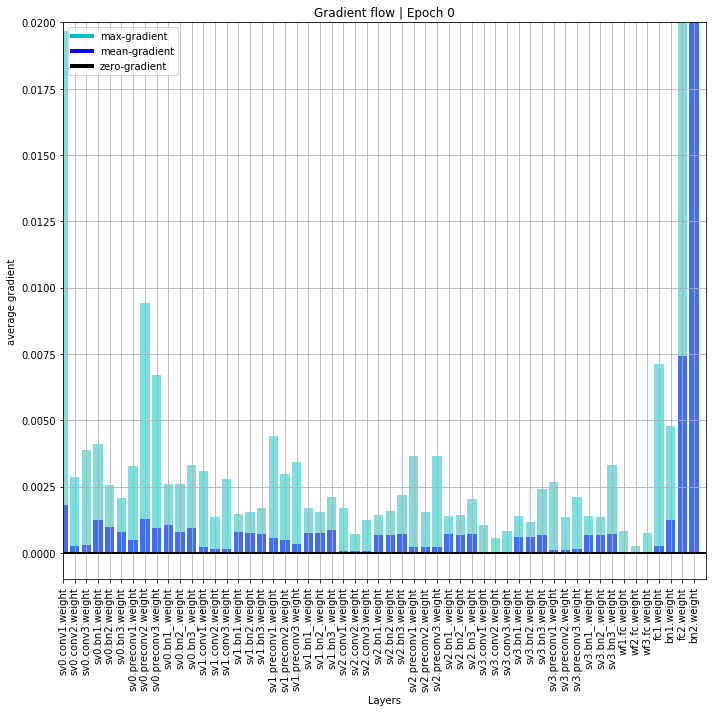

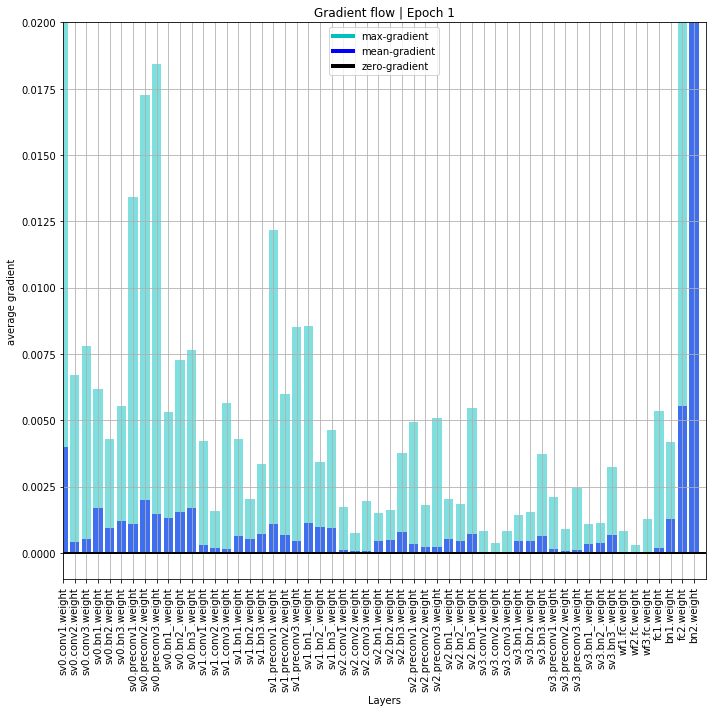

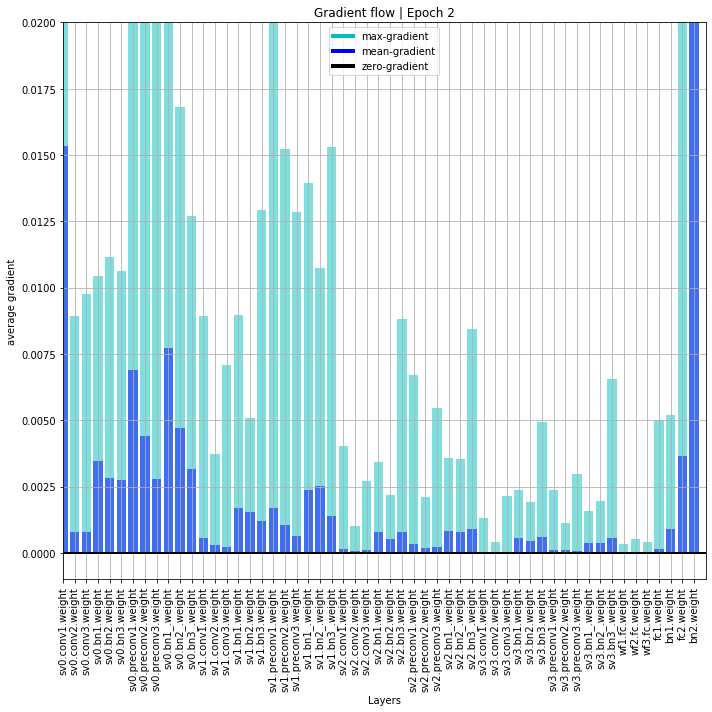

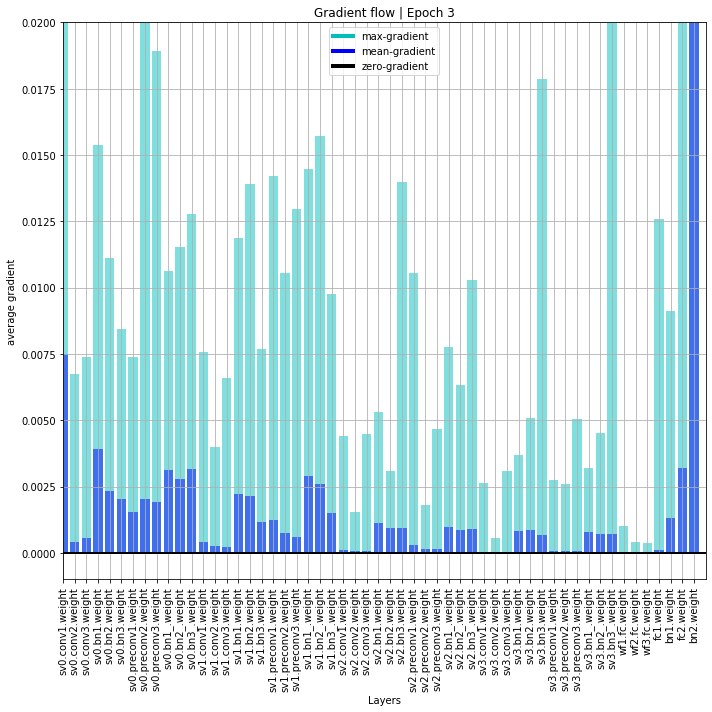

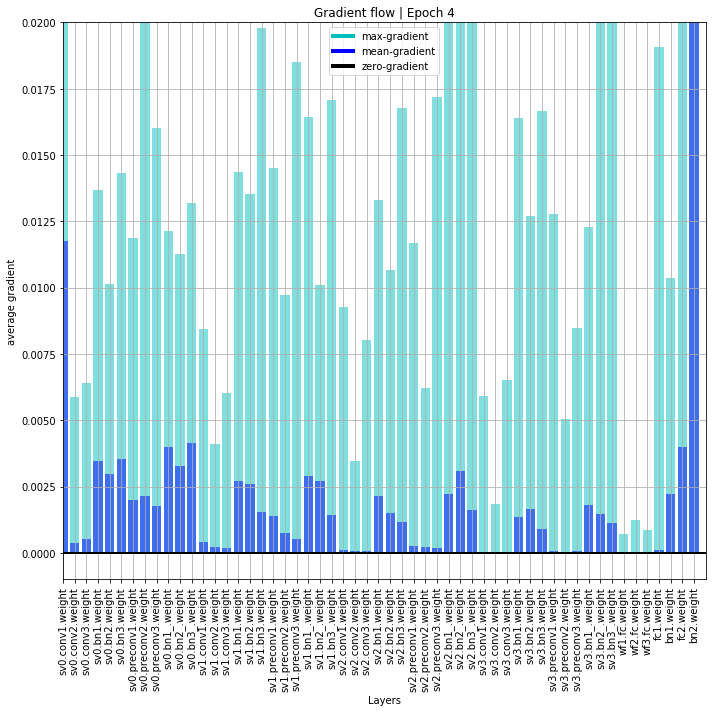

...

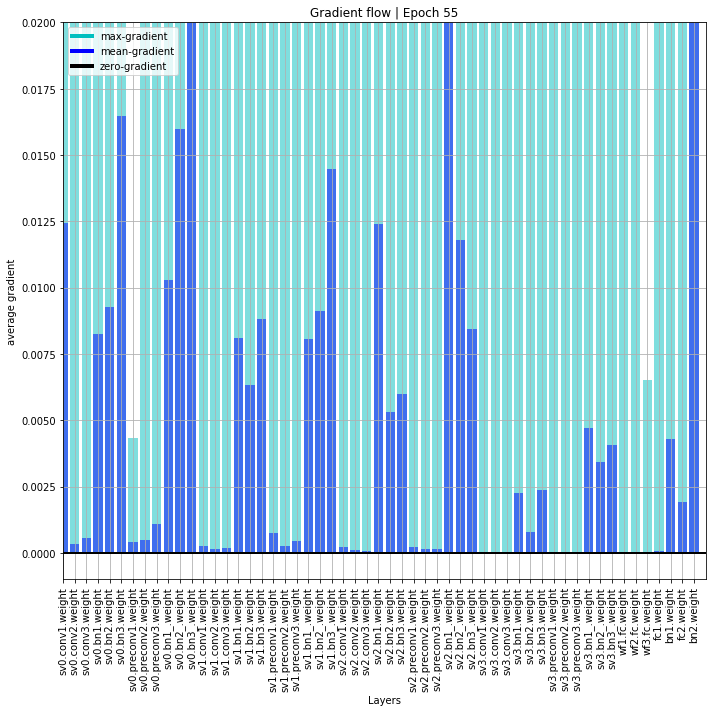

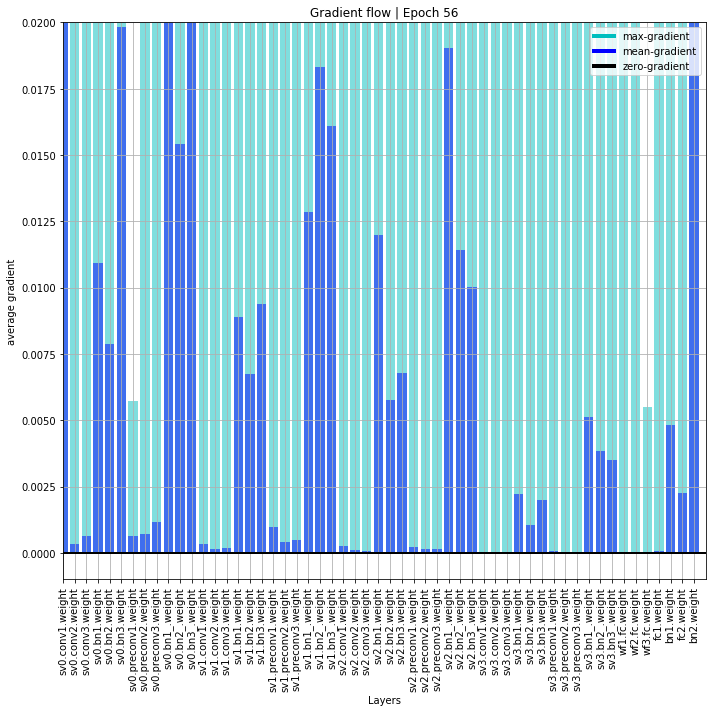

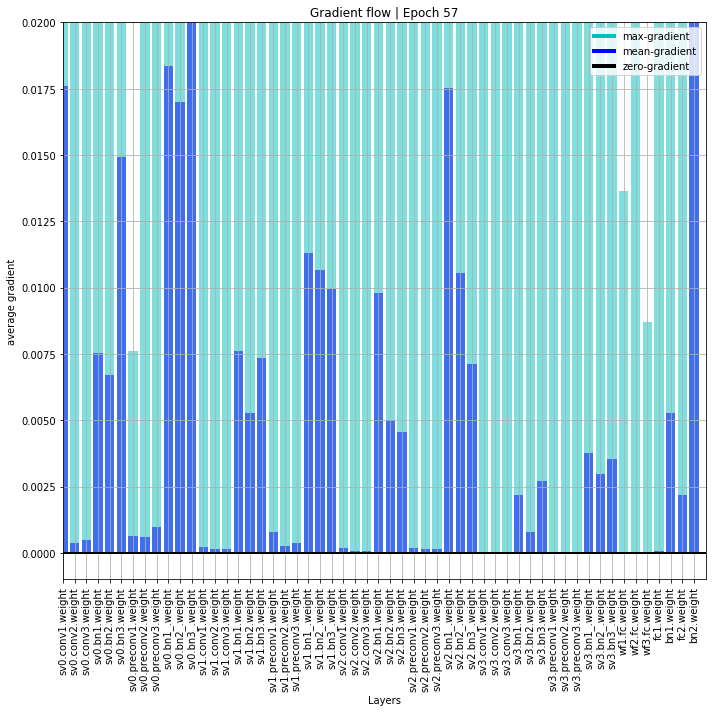

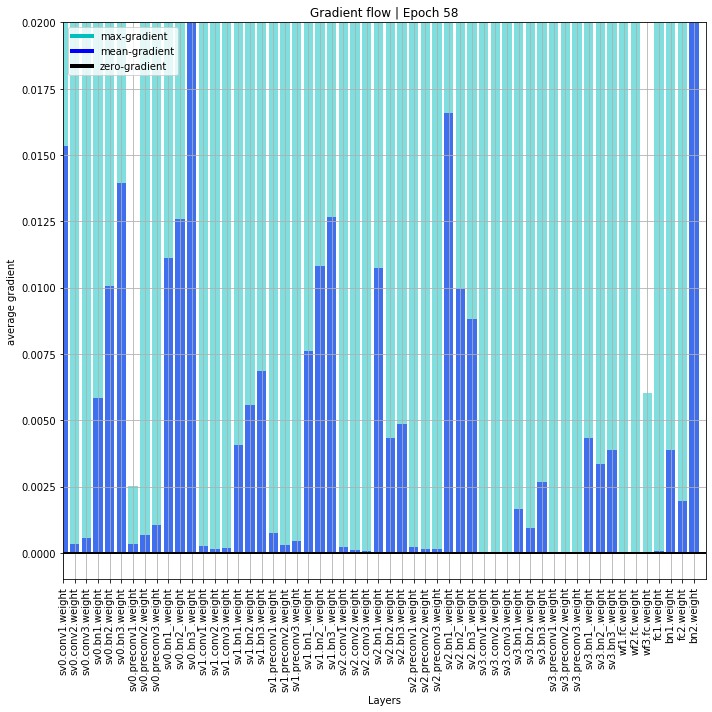

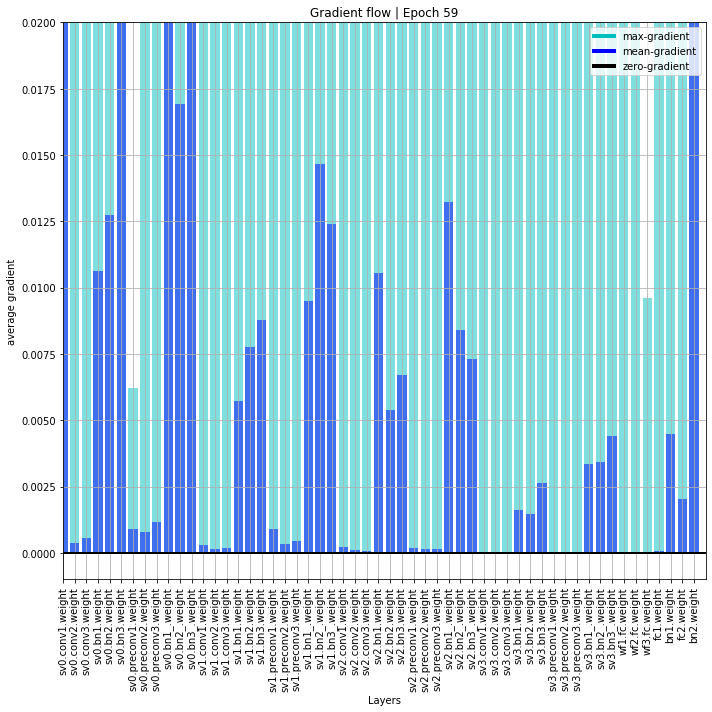

In [28]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/svgg7/'
model_name = 'svgg_resnet'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(60):  # loop over the dataset multiple times
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
        print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

## Attention

In [6]:
class Attention(nn.Module):
    
    def __init__(self, feature_depth, target_depth, emb_dim):
        super(Attention, self).__init__()
        self.emb_dim = emb_dim
        self.iconv1 = nn.Conv2d(feature_depth, emb_dim, kernel_size=1)
        self.iconv2 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv3 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv_out = nn.Conv2d(emb_dim, target_depth, kernel_size=1)
        self.bn_out = nn.BatchNorm2d(target_depth)
        
        # ensure the init stage is the indentical mapping
#         nn.init.zeros_(self.iconv_out.weight)
#         nn.init.zeros_(self.iconv_out.bias)
#         nn.init.zeros_(self.bn_out.weight)
#         nn.init.zeros_(self.bn_out.bias)
        
    def forward(self, x1, x2):
        x1_emb = self.iconv1(x1)
        _x1 = nn.Flatten(-2)(x1_emb)
        
        x2_emb = self.iconv2(x2)
        _x2 = nn.Flatten(-2)(x2_emb)
        
        x3_emb = self.iconv3(x2)
        _x3 = nn.Flatten(-2)(x3_emb)
        
        QK = torch.matmul(_x1, _x2.permute(0,2,1))
        QK = QK / math.sqrt(self.emb_dim)
#         QK = nn.Softmax()(QK)
        
        x_out = torch.matmul(QK, _x3)
        x_out = x_out.reshape(x3_emb.size())
        
        x_out = self.iconv_out(x_out)
        x_out = self.bn_out(x_out)
        
        x_out = x_out + x2 #residual
        
        return x_out

In [7]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [8]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)

        self.wf0 = Attention(64, 64, emb_dim=32).to(self.device)
        self.wf1 = Attention(128, 128, emb_dim=64).to(self.device)
        self.wf2 = Attention(256, 256, emb_dim=128).to(self.device)
        self.wf3 = Attention(512, 512, emb_dim=256).to(self.device)

        self.fc1 = nn.Linear(512, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)

        x1 = self.sv1(x0)
        x_wf1 = self.wf1(x1, x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x2, x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x3, x3)

        x_wf3 = nn.AvgPool2d(kernel_size=(x_wf3.size(-2), x_wf3.size(-1)))(x_wf3)
    
        x = nn.Flatten()(x_wf3)

        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [9]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-4)


cuda


Epoch:  1
- Avg.loss: 1.898  | Avg.acc: 0.243
- Avg. val_loss: 1.856  | Avg. val_acc: 0.250


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type Attention. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


* Update optimal model
Epoch:  2
- Avg.loss: 1.795  | Avg.acc: 0.290
- Avg. val_loss: 1.801  | Avg. val_acc: 0.298
* Update optimal model
Epoch:  3
- Avg.loss: 1.643  | Avg.acc: 0.367
- Avg. val_loss: 1.633  | Avg. val_acc: 0.376
* Update optimal model
Epoch:  4
- Avg.loss: 1.528  | Avg.acc: 0.416
- Avg. val_loss: 1.506  | Avg. val_acc: 0.428
* Update optimal model
Epoch:  5
- Avg.loss: 1.446  | Avg.acc: 0.449
- Avg. val_loss: 1.512  | Avg. val_acc: 0.422
Epoch:  6
- Avg.loss: 1.390  | Avg.acc: 0.471
- Avg. val_loss: 1.532  | Avg. val_acc: 0.413
Epoch:  7
- Avg.loss: 1.359  | Avg.acc: 0.483
- Avg. val_loss: 1.456  | Avg. val_acc: 0.447
* Update optimal model
Epoch:  8
- Avg.loss: 1.331  | Avg.acc: 0.496
- Avg. val_loss: 1.384  | Avg. val_acc: 0.481
* Update optimal model
Epoch:  9
- Avg.loss: 1.312  | Avg.acc: 0.499
- Avg. val_loss: 1.352  | Avg. val_acc: 0.489
* Update optimal model
Epoch:  10
- Avg.loss: 1.295  | Avg.acc: 0.508
- Avg. val_loss: 1.316  | Avg. val_acc: 0.494
* Update o

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


- Avg. val_loss: 1.273  | Avg. val_acc: 0.519
Epoch:  22
- Avg.loss: 1.166  | Avg.acc: 0.557
- Avg. val_loss: 1.286  | Avg. val_acc: 0.515
Epoch:  23
- Avg.loss: 1.158  | Avg.acc: 0.557
- Avg. val_loss: 1.216  | Avg. val_acc: 0.528
* Update optimal model
Epoch:  24
- Avg.loss: 1.153  | Avg.acc: 0.563
- Avg. val_loss: 1.231  | Avg. val_acc: 0.534
* Update optimal model
Epoch:  25
- Avg.loss: 1.145  | Avg.acc: 0.564
- Avg. val_loss: 1.249  | Avg. val_acc: 0.516
Epoch:  26


KeyboardInterrupt: 

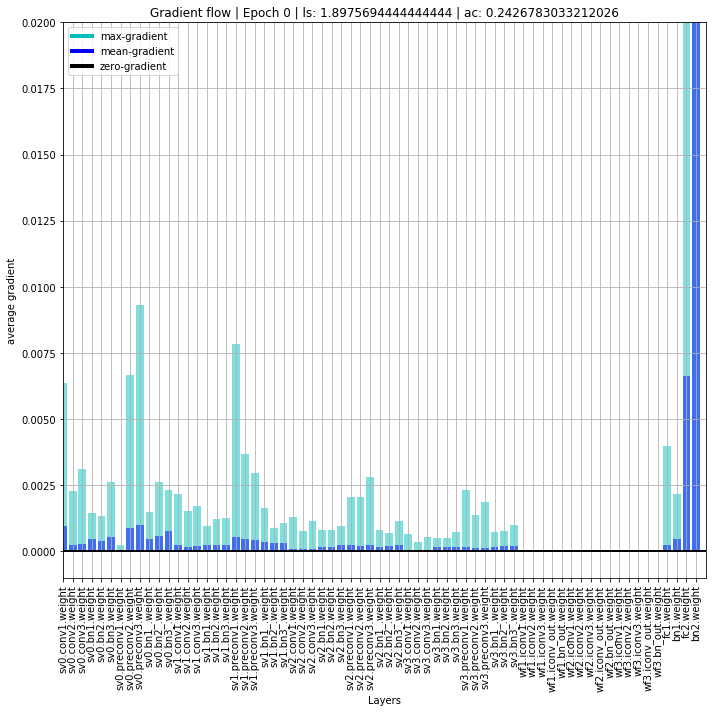

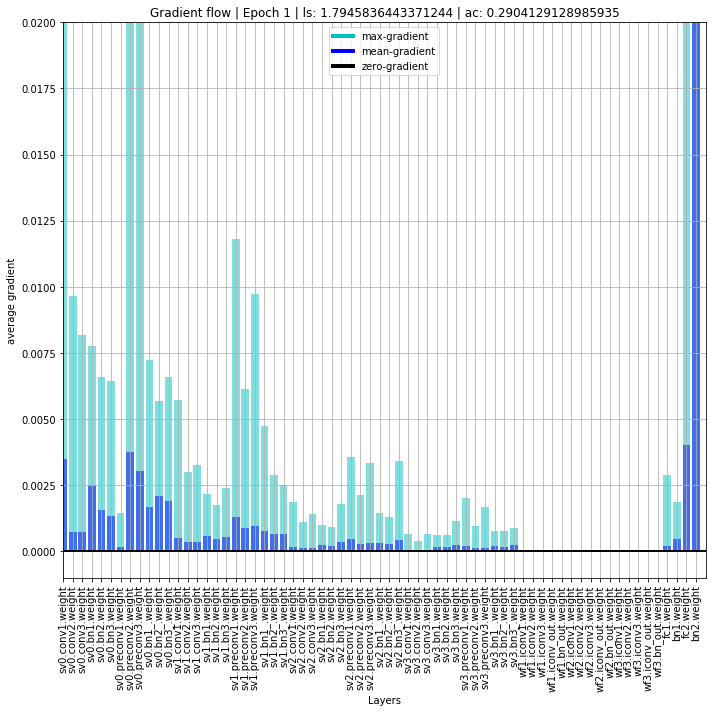

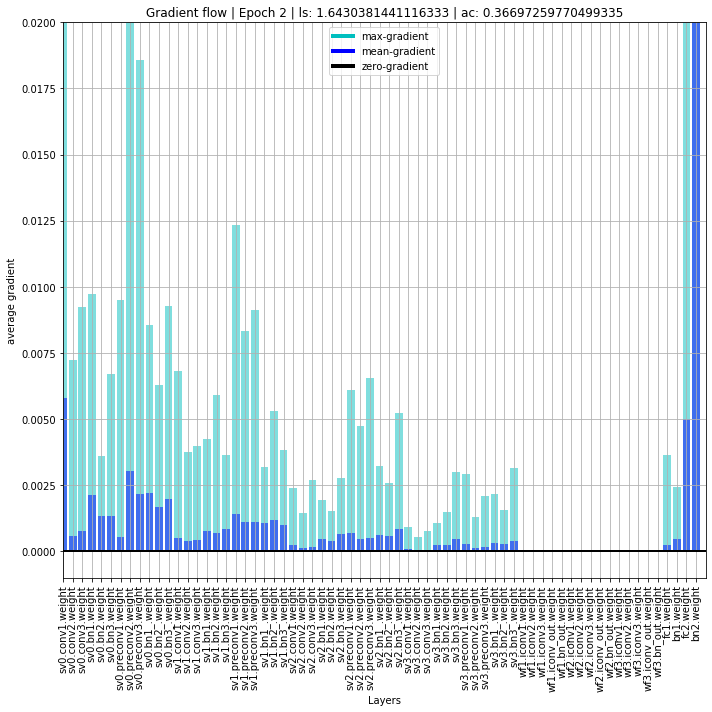

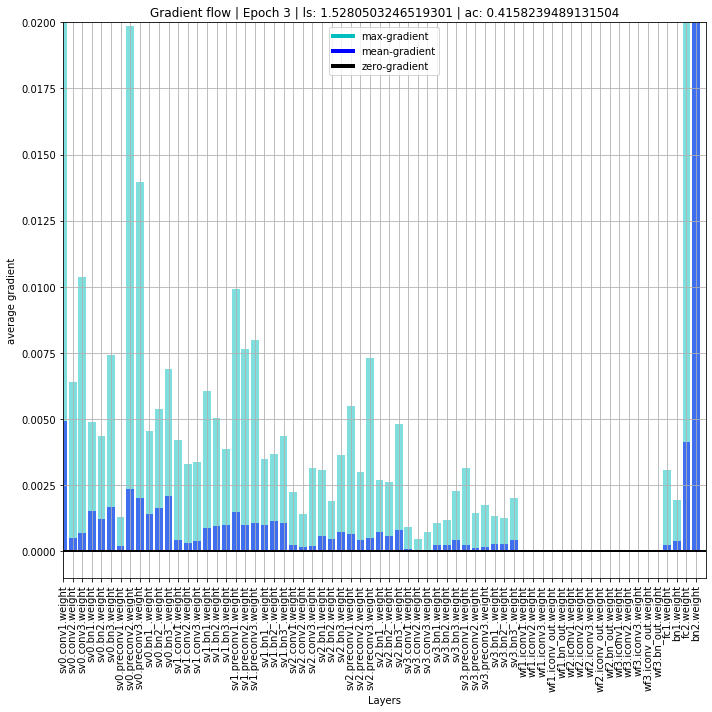

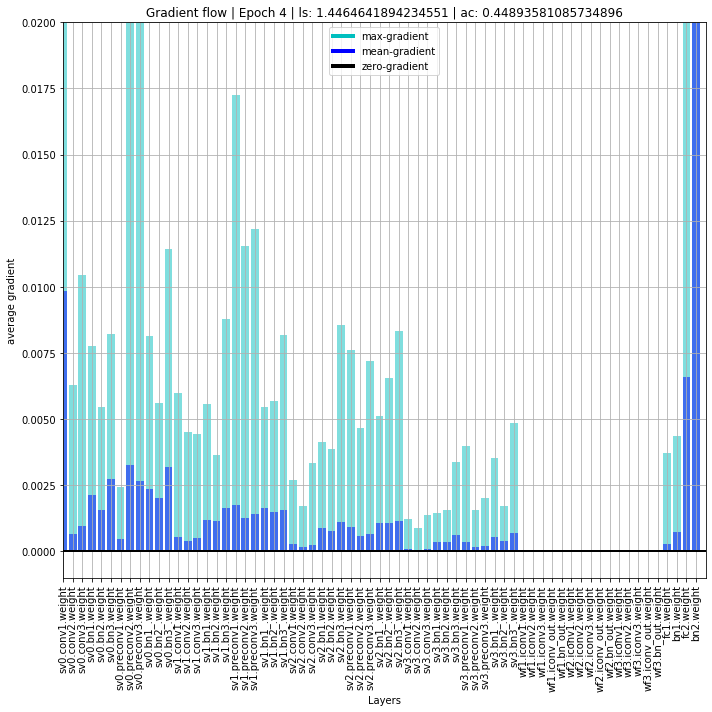

In [ ]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/attention/'
model_name = 'svgg_resnet'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(60):  # loop over the dataset multiple times
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

Epoch:  1
- Avg.loss: 1.894  | Avg.acc: 0.234
- Avg. val_loss: 3.401  | Avg. val_acc: 0.199
* Update optimal model
Epoch:  2


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type Attention. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


- Avg.loss: 1.820  | Avg.acc: 0.272
- Avg. val_loss: 1.831  | Avg. val_acc: 0.254
* Update optimal model
Epoch:  3
- Avg.loss: 1.752  | Avg.acc: 0.303
- Avg. val_loss: 2.646  | Avg. val_acc: 0.251
Epoch:  4
- Avg.loss: 1.671  | Avg.acc: 0.341
- Avg. val_loss: 1.736  | Avg. val_acc: 0.346
* Update optimal model
Epoch:  5
- Avg.loss: 1.572  | Avg.acc: 0.393
- Avg. val_loss: 3.638  | Avg. val_acc: 0.351
* Update optimal model
Epoch:  6
- Avg.loss: 1.484  | Avg.acc: 0.428
- Avg. val_loss: 1.547  | Avg. val_acc: 0.428
* Update optimal model
Epoch:  7
- Avg.loss: 1.428  | Avg.acc: 0.453
- Avg. val_loss: 1.454  | Avg. val_acc: 0.441
* Update optimal model
Epoch:  8
- Avg.loss: 1.381  | Avg.acc: 0.472
- Avg. val_loss: 1.407  | Avg. val_acc: 0.459
* Update optimal model
Epoch:  9
- Avg.loss: 1.360  | Avg.acc: 0.481
- Avg. val_loss: 1.375  | Avg. val_acc: 0.477
* Update optimal model
Epoch:  10
- Avg.loss: 1.329  | Avg.acc: 0.492
- Avg. val_loss: 1.384  | Avg. val_acc: 0.473
Epoch:  11
- Avg.los

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


- Avg. val_loss: 1.339  | Avg. val_acc: 0.507
Epoch:  22
- Avg.loss: 1.181  | Avg.acc: 0.549
- Avg. val_loss: 1.248  | Avg. val_acc: 0.525
Epoch:  23
- Avg.loss: 1.168  | Avg.acc: 0.555
- Avg. val_loss: 1.293  | Avg. val_acc: 0.526
Epoch:  24
- Avg.loss: 1.159  | Avg.acc: 0.558
- Avg. val_loss: 1.211  | Avg. val_acc: 0.543
* Update optimal model
Epoch:  25
- Avg.loss: 1.149  | Avg.acc: 0.563
- Avg. val_loss: 1.204  | Avg. val_acc: 0.544
* Update optimal model
Epoch:  26
- Avg.loss: 1.141  | Avg.acc: 0.566
- Avg. val_loss: 1.183  | Avg. val_acc: 0.539
Epoch:  27
- Avg.loss: 1.131  | Avg.acc: 0.569
- Avg. val_loss: 1.252  | Avg. val_acc: 0.512
Epoch:  28
- Avg.loss: 1.128  | Avg.acc: 0.569
- Avg. val_loss: 1.171  | Avg. val_acc: 0.563
* Update optimal model
Epoch:  29
- Avg.loss: 1.120  | Avg.acc: 0.572
- Avg. val_loss: 1.244  | Avg. val_acc: 0.529
Epoch:  30
- Avg.loss: 1.113  | Avg.acc: 0.576
- Avg. val_loss: 1.232  | Avg. val_acc: 0.534
Epoch:  31
- Avg.loss: 1.103  | Avg.acc: 0.584
-

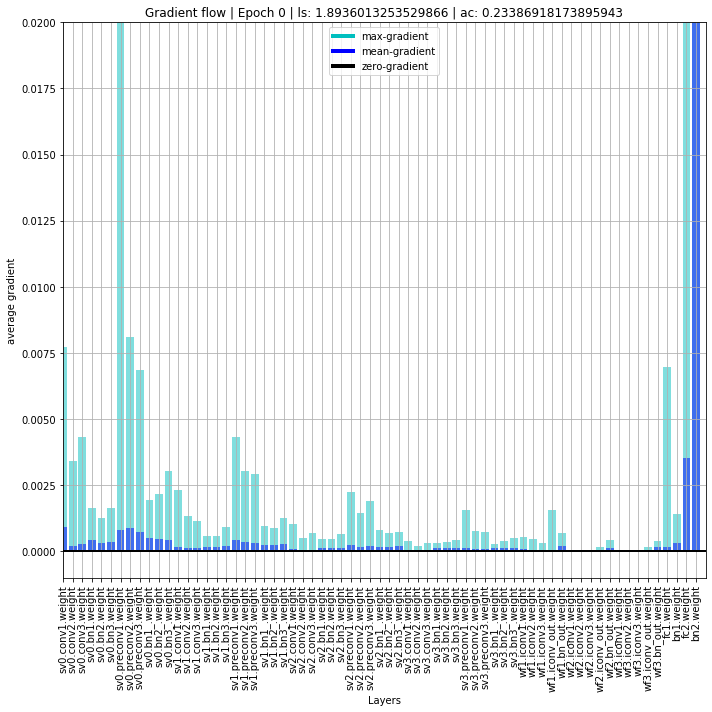

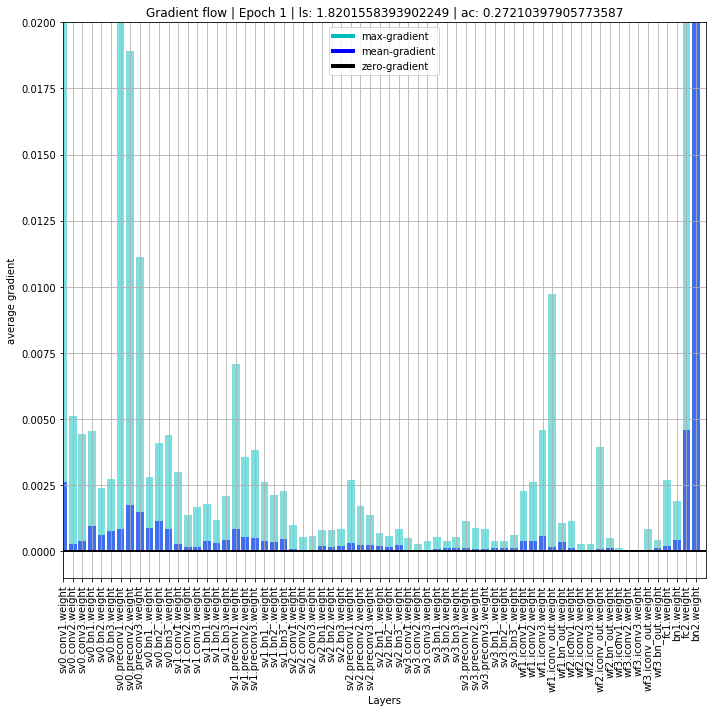

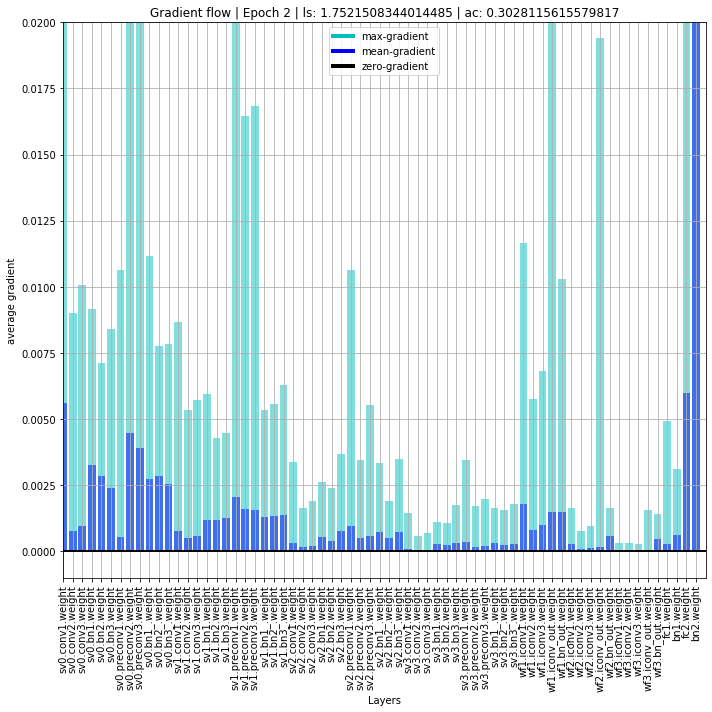

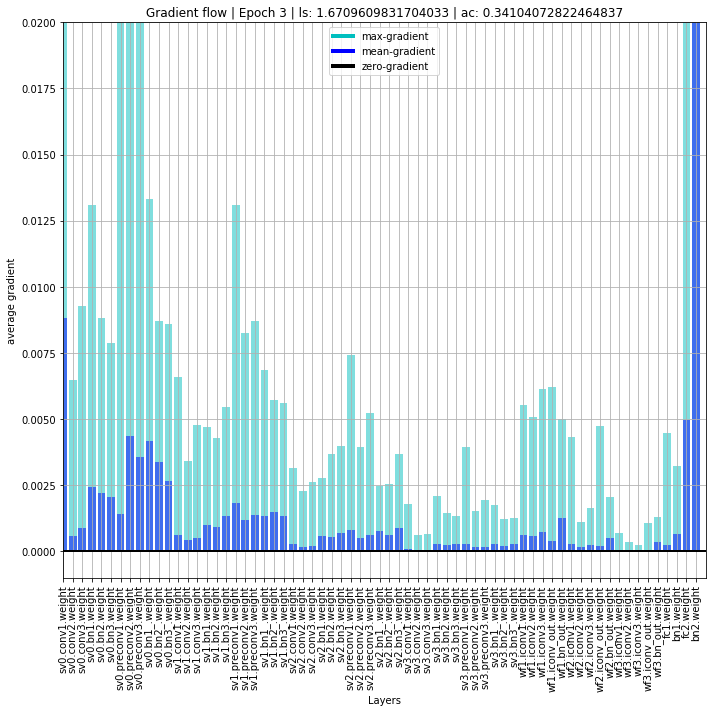

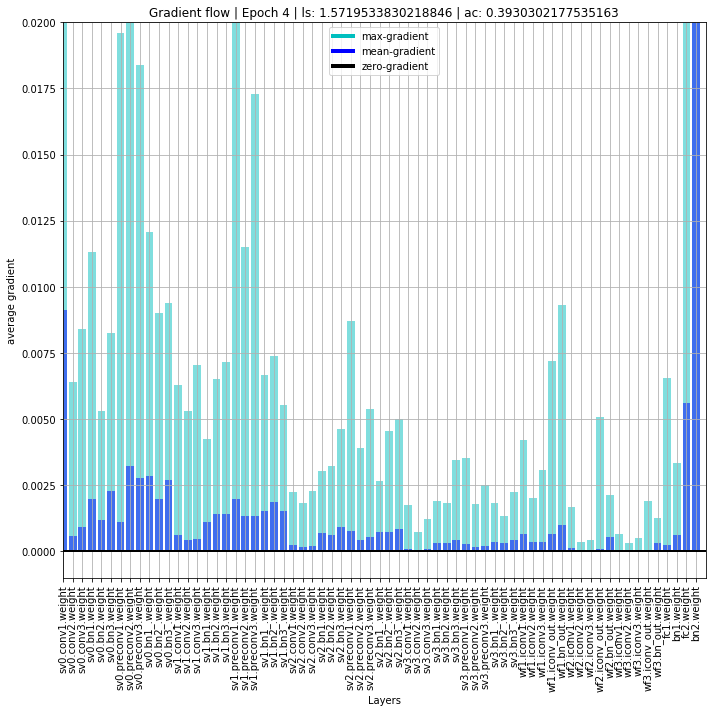

...

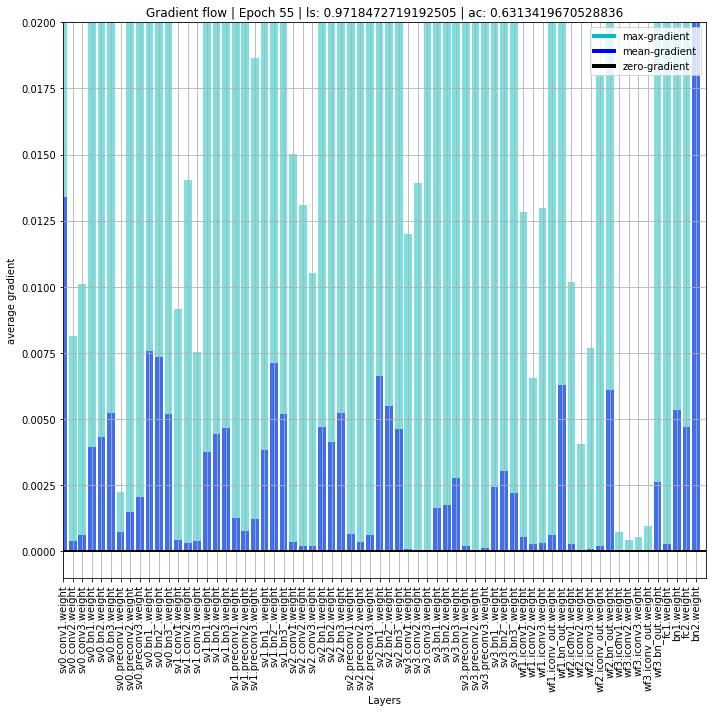

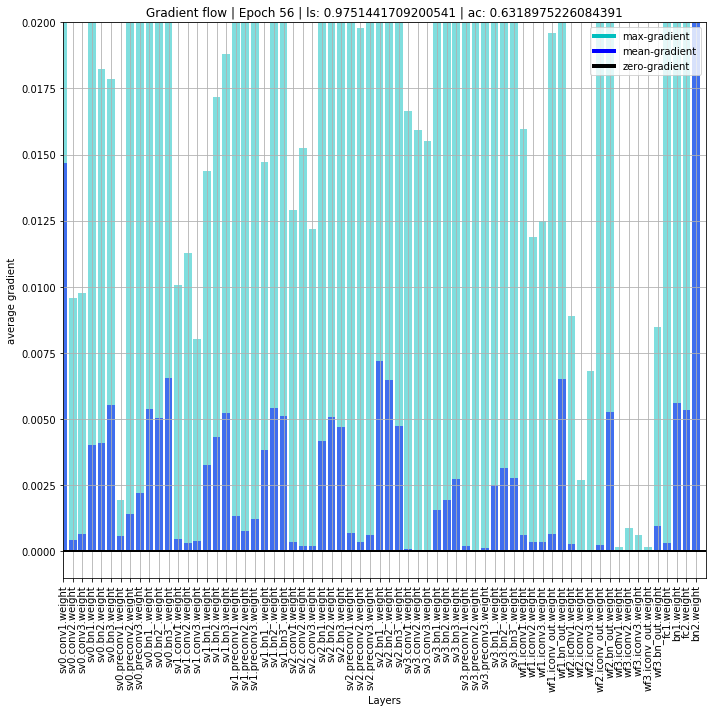

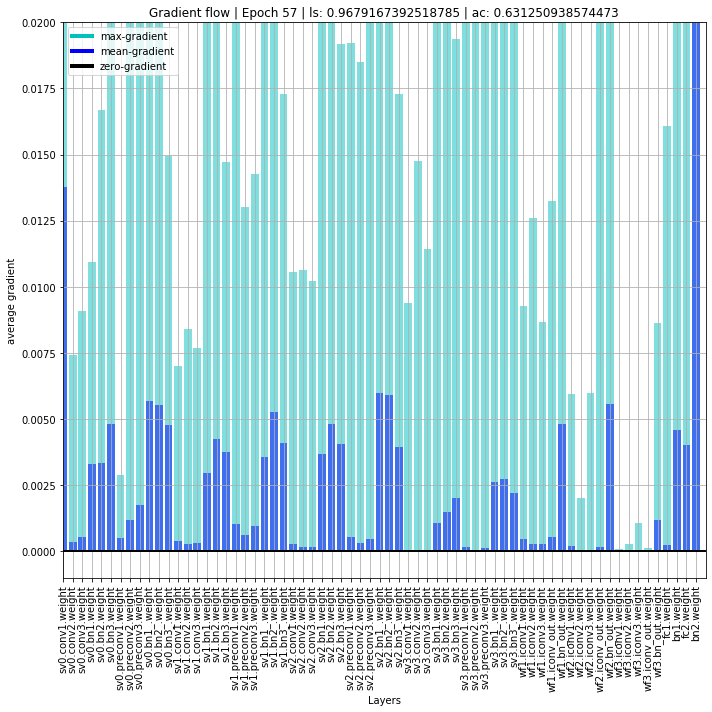

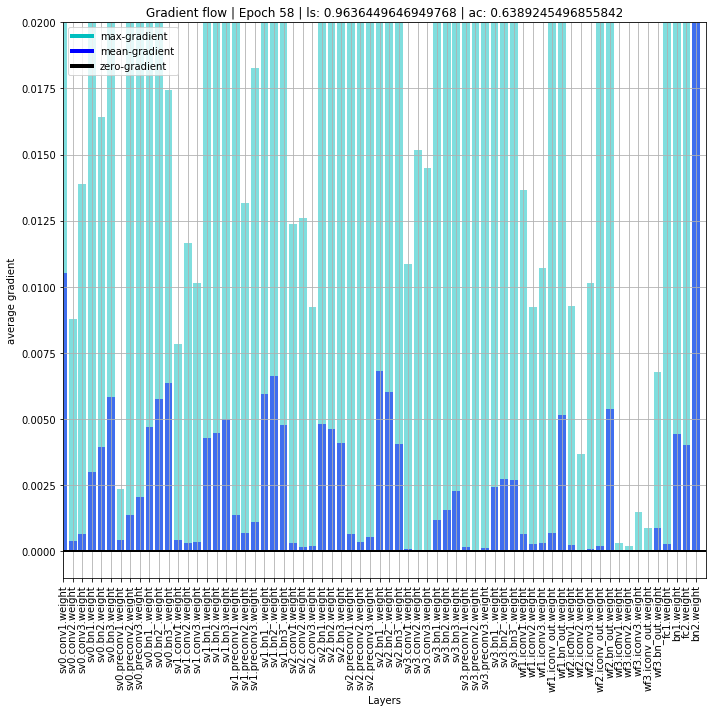

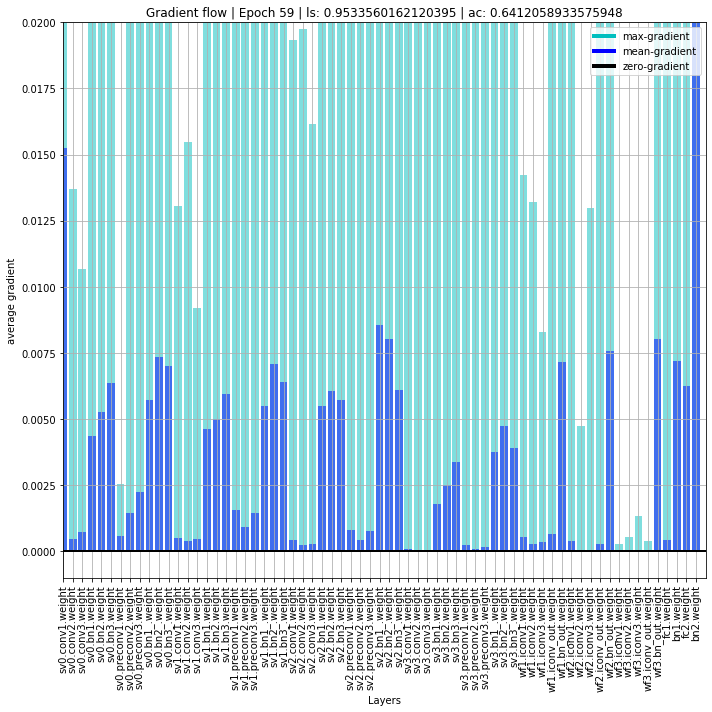

In [10]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/attention/'
model_name = 'svgg_resnet2'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(60):  # loop over the dataset multiple times
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(named_parameters=model.named_parameters(), epoch=epoch,
                   loss=avgloss, acc=avgacc,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

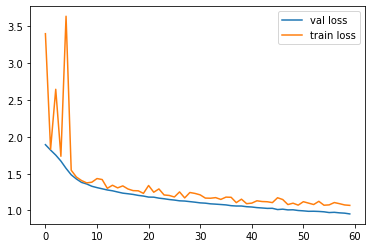

In [15]:
plt.plot([k[0] for k in hist], label='val loss')
plt.plot([k[1] for k in hist], label='train loss')
plt.legend()

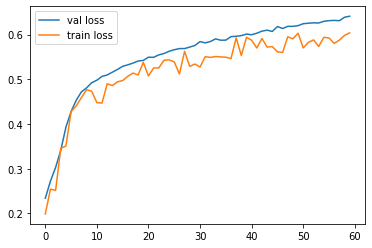

In [16]:
plt.plot([k[2] for k in hist], label='val loss')
plt.plot([k[3] for k in hist], label='train loss')
plt.legend()

In [17]:
model

SVGG(
  (sv0): SVblock(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (preconv1): Conv2d(1, 64, kernel_size=(1, 1), stride=(1, 1))
    (preconv2): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    (preconv3): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    (bn1_): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2_): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn3_): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=

In [ ]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/attention/'
model_name = 'svgg_resnet2'
model_path = os.path.join(model_folder, model_name + '.pt')

# best_acc = 0.0
# curloss = 0.0
hist2 = []

for epoch in range(60, 400):  # loop over the dataset multiple times
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(named_parameters=model.named_parameters(), epoch=epoch,
                   loss=avgloss, acc=avgacc,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist2.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

Epoch:  61
- Avg.loss: 0.956  | Avg.acc: 0.636
- Avg. val_loss: 1.096  | Avg. val_acc: 0.579
Epoch:  62
- Avg.loss: 0.953  | Avg.acc: 0.638
- Avg. val_loss: 1.075  | Avg. val_acc: 0.610
* Update optimal model
Epoch:  63
- Avg.loss: 0.953  | Avg.acc: 0.639
- Avg. val_loss: 1.183  | Avg. val_acc: 0.554
Epoch:  64
- Avg.loss: 0.947  | Avg.acc: 0.643
- Avg. val_loss: 1.082  | Avg. val_acc: 0.589
Epoch:  65
- Avg.loss: 0.940  | Avg.acc: 0.645
- Avg. val_loss: 1.104  | Avg. val_acc: 0.585
Epoch:  66
- Avg.loss: 0.935  | Avg.acc: 0.647
- Avg. val_loss: 1.083  | Avg. val_acc: 0.600
Epoch:  67
- Avg.loss: 0.929  | Avg.acc: 0.651
- Avg. val_loss: 1.094  | Avg. val_acc: 0.593
Epoch:  68
- Avg.loss: 0.933  | Avg.acc: 0.647
- Avg. val_loss: 1.065  | Avg. val_acc: 0.617
* Update optimal model
Epoch:  69
- Avg.loss: 0.925  | Avg.acc: 0.651
- Avg. val_loss: 1.055  | Avg. val_acc: 0.605
Epoch:  70
- Avg.loss: 0.925  | Avg.acc: 0.650
- Avg. val_loss: 1.057  | Avg. val_acc: 0.603
Epoch:  71
- Avg.loss: 0

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


- Avg. val_loss: 1.046  | Avg. val_acc: 0.603
Epoch:  82
- Avg.loss: 0.875  | Avg.acc: 0.669
- Avg. val_loss: 1.079  | Avg. val_acc: 0.602
Epoch:  83
- Avg.loss: 0.880  | Avg.acc: 0.667
- Avg. val_loss: 1.084  | Avg. val_acc: 0.591
Epoch:  84
- Avg.loss: 0.870  | Avg.acc: 0.673
- Avg. val_loss: 1.061  | Avg. val_acc: 0.612
Epoch:  85
- Avg.loss: 0.866  | Avg.acc: 0.673
- Avg. val_loss: 1.043  | Avg. val_acc: 0.615
Epoch:  86
- Avg.loss: 0.862  | Avg.acc: 0.674
- Avg. val_loss: 1.116  | Avg. val_acc: 0.584
Epoch:  87
- Avg.loss: 0.861  | Avg.acc: 0.676
- Avg. val_loss: 1.065  | Avg. val_acc: 0.607
Epoch:  88


([<matplotlib.lines.Line2D at 0x7fb6cc3fb358>,
 0.6419719827586207,
 1.32493787592855)

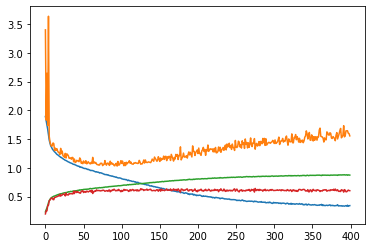

In [21]:
plt.plot(hist+hist2), best_acc, curloss

In [23]:
import imageio
images = []
for i in range(400):
    images.append(imageio.imread('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet2_gf_' + str(i) + '.png'))
imageio.mimsave('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet2_gf.gif', images)

## Attention 4 blocks

In [5]:
class Attention(nn.Module):
    
    def __init__(self, feature_depth, target_depth, emb_dim):
        super(Attention, self).__init__()
        self.emb_dim = emb_dim
        self.iconv1 = nn.Conv2d(feature_depth, emb_dim, kernel_size=1)
        self.iconv2 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv3 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv_out = nn.Conv2d(emb_dim, target_depth, kernel_size=1)
        self.bn_out = nn.BatchNorm2d(target_depth)
        
        # ensure the init stage is the indentical mapping
#         nn.init.zeros_(self.iconv_out.weight)
#         nn.init.zeros_(self.iconv_out.bias)
#         nn.init.zeros_(self.bn_out.weight)
#         nn.init.zeros_(self.bn_out.bias)
        
    def forward(self, x1, x2):
        x1_emb = self.iconv1(x1)
        _x1 = nn.Flatten(-2)(x1_emb)
        
        x2_emb = self.iconv2(x2)
        _x2 = nn.Flatten(-2)(x2_emb)
        
        x3_emb = self.iconv3(x2)
        _x3 = nn.Flatten(-2)(x3_emb)
        
        QK = torch.matmul(_x1, _x2.permute(0,2,1))
        QK = QK / math.sqrt(self.emb_dim)
#         QK = nn.Softmax()(QK)
        
        x_out = torch.matmul(QK, _x3)
        x_out = x_out.reshape(x3_emb.size())
        
        x_out = self.iconv_out(x_out)
        x_out = self.bn_out(x_out)
        
        x_out = x_out + x2 #residual
        
        return x_out

In [5]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [7]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)
        self.sv4 = SVblock(512, 1024).to(self.device)

        self.wf0 = Attention(64, 64, emb_dim=32).to(self.device)
        self.wf1 = Attention(128, 128, emb_dim=64).to(self.device)
        self.wf2 = Attention(256, 256, emb_dim=128).to(self.device)
        self.wf3 = Attention(512, 512, emb_dim=256).to(self.device)
        self.wf4 = Attention(1024, 1024, emb_dim=512).to(self.device)
        
        self.iconv_out = nn.Conv2d(1024, 1024, kernel_size=1)
        self.bn_out = nn.BatchNorm2d(1024)

        self.fc0 = nn.Linear(1024, 1024)
        self.bn0 = nn.BatchNorm1d(1024)
        self.fc1 = nn.Linear(1024, 512)
        self.bn1 = nn.BatchNorm1d(512)
        self.fc2 = nn.Linear(512, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)

        x1 = self.sv1(x0)
        x_wf1 = self.wf1(x1, x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x2, x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x3, x3)

        x4 = self.sv4(x_wf3)
        x_wf4 = self.wf4(x4, x4)
        
        x_wf4 = self.iconv_out(x_wf4)
        x_wf4 = self.bn_out(x_wf4)

        x_wf4 = nn.AvgPool2d(kernel_size=(x_wf4.size(-2), x_wf4.size(-1)))(x_wf4)
    
        x = nn.Flatten()(x_wf4)

        x = self.fc0(x)
        x = self.bn0(x)
        x = nn.LeakyReLU()(x)
        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [11]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.008
reduce_factor = 5
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)


cuda


In [ ]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/attention/'
model_name = 'svgg_resnet3'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(300):  # loop over the dataset multiple times
    
    
    
    if (epoch % 60) == 0 and epoch != 0:
        learning_rate /= reduce_factor
        print('Decrese learning rate to: ', learning_rate)
        optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

Epoch:  1
- Avg.loss: 1.860  | Avg.acc: 0.246
- Avg. val_loss: 86.871  | Avg. val_acc: 0.251


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type Attention. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


* Update optimal model
Epoch:  2
- Avg.loss: 1.786  | Avg.acc: 0.259
- Avg. val_loss: 1.778  | Avg. val_acc: 0.254
* Update optimal model
Epoch:  3
- Avg.loss: 1.776  | Avg.acc: 0.264
- Avg. val_loss: 1.765  | Avg. val_acc: 0.264
* Update optimal model
Epoch:  4
- Avg.loss: 1.753  | Avg.acc: 0.278
- Avg. val_loss: 192895740355307.375  | Avg. val_acc: 0.215
Epoch:  5
- Avg.loss: 1.732  | Avg.acc: 0.292
- Avg. val_loss: 1.853  | Avg. val_acc: 0.247
Epoch:  6
- Avg.loss: 1.708  | Avg.acc: 0.301
- Avg. val_loss: 1.817  | Avg. val_acc: 0.247
Epoch:  7
- Avg.loss: 1.691  | Avg.acc: 0.311
- Avg. val_loss: 1.685  | Avg. val_acc: 0.305
* Update optimal model
Epoch:  8
- Avg.loss: 1.672  | Avg.acc: 0.326
- Avg. val_loss: 1.691  | Avg. val_acc: 0.320
* Update optimal model
Epoch:  9
- Avg.loss: 1.562  | Avg.acc: 0.388
- Avg. val_loss: 1.640  | Avg. val_acc: 0.348
* Update optimal model
Epoch:  12
- Avg.loss: 1.531  | Avg.acc: 0.399
- Avg. val_loss: 1.586  | Avg. val_acc: 0.372
* Update optimal mo

In [11]:
best_acc, curloss

(0.6100215521352045, 1.0482155495676502)

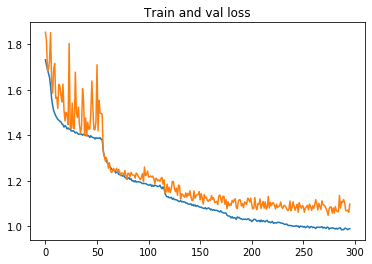

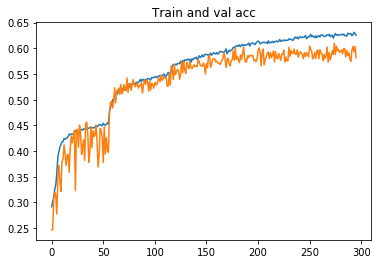

In [23]:
plt.plot([k[0] for k in hist[4:]])
plt.plot([k[1] for k in hist[4:]])
plt.title('Train and val loss')
plt.show()

plt.plot([k[2] for k in hist[4:]])
plt.plot([k[3] for k in hist[4:]])
plt.title('Train and val acc')
plt.show()

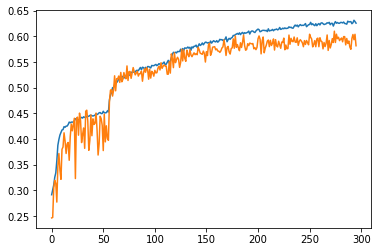

In [14]:
# EVALUATE
test_model = torch.load('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet3.pt')
test_model.eval()

running_valloss = 0.0
running_valacc = 0.0
for i,data in enumerate(train_loader):
    # get the inputs; data is a list of [inputs, labels]
    inputs, labels = data
    inputs = inputs.to(device)
    labels = labels.to(device)

    outputs = test_model(inputs)
    acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
    loss = criterion(outputs, labels)

    running_valloss += loss.item()
    running_valacc += acc

print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

- Avg. val_loss: 0.978  | Avg. val_acc: 0.629


In [ ]:
import imageio
images = []
for i in range(300):
    images.append(imageio.imread('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet3_gf_' + str(i) + '.png'))
imageio.mimsave('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet3_gf.gif', images)

## Attention 4 blocks correction

In [8]:
class Attention(nn.Module):
    
    def __init__(self, feature_depth, target_depth, emb_dim):
        super(Attention, self).__init__()
        self.emb_dim = emb_dim
        self.iconv1 = nn.Conv2d(feature_depth, emb_dim, kernel_size=1)
        self.iconv2 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv3 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv_out = nn.Conv2d(emb_dim, target_depth, kernel_size=1)
        self.bn_out = nn.BatchNorm2d(target_depth)
        
        # ensure the init stage is the indentical mapping
#         nn.init.zeros_(self.iconv_out.weight)
#         nn.init.zeros_(self.iconv_out.bias)
#         nn.init.zeros_(self.bn_out.weight)
#         nn.init.zeros_(self.bn_out.bias)
        
    def forward(self, x1, x2):
        x1_emb = self.iconv1(x1)
        _x1 = nn.Flatten(-2)(x1_emb)
        
        x2_emb = self.iconv2(x2)
        _x2 = nn.Flatten(-2)(x2_emb)
        
        x3_emb = self.iconv3(x2)
        _x3 = nn.Flatten(-2)(x3_emb)
        
        QK = torch.matmul(_x1, _x2.permute(0,2,1))
        QK = QK / math.sqrt(_x1.size(2))
    
#         QK = nn.Softmax()(QK)
        
        x_out = torch.matmul(QK, _x3)
        x_out = x_out.reshape(x3_emb.size())
        
        x_out = self.iconv_out(x_out)
        x_out = self.bn_out(x_out)
        x_out = nn.LeakyReLU()(x_out)
        
        x_out = x_out + x2 #residual
        
        return x_out

In [7]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [8]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)
        self.sv4 = SVblock(512, 1024).to(self.device)

        self.wf0 = Attention(64, 64, emb_dim=32).to(self.device)
        self.wf1 = Attention(128, 128, emb_dim=64).to(self.device)
        self.wf2 = Attention(256, 256, emb_dim=128).to(self.device)
        self.wf3 = Attention(512, 512, emb_dim=256).to(self.device)
        self.wf4 = Attention(1024, 1024, emb_dim=512).to(self.device)
        
        self.iconv_out = nn.Conv2d(1024, 1024, kernel_size=1)
        self.bn_out = nn.BatchNorm2d(1024)

        self.fc0 = nn.Linear(2560, 2560)
        self.bn0 = nn.BatchNorm1d(2560)
        self.fc1 = nn.Linear(2560, 1024)
        self.bn1 = nn.BatchNorm1d(1024)
        self.fc2 = nn.Linear(1024, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)
        x_wf0 = self.wf0(x0, x0)

        x1 = self.sv1(x_wf0)
        x_wf1 = self.wf1(x1, x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x2, x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x3, x3)

        x4 = self.sv4(x_wf3)
        x_wf4 = self.wf4(x4, x4)
        
        x_wf4 = self.iconv_out(x_wf4)
        x_wf4 = self.bn_out(x_wf4)

        x_wf4 = nn.AvgPool2d(kernel_size=(x_wf4.size(-2), x_wf4.size(-1)))(x_wf4)
        x_wf4 = nn.Flatten()(x_wf4)
        # additional output from sv3 and sv4
        x_sub_3 = nn.AvgPool2d(kernel_size=(x3.size(-2), x3.size(-1)))(x3)
        x_sub_3 = nn.Flatten()(x_sub_3)
        x_sub_4 = nn.AvgPool2d(kernel_size=(x4.size(-2), x4.size(-1)))(x4)
        x_sub_4 = nn.Flatten()(x_sub_4)
        
        x = torch.cat([x_wf4, x_sub_3, x_sub_4], dim=1)

        x = self.fc0(x)
        x = self.bn0(x)
        x = nn.LeakyReLU()(x)
        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [13]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.008
reduce_factor = 5
optimizer = optim.SGD(model.parameters(), lr=learning_rate, weight_decay=1e-4)


cuda


In [9]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/attention/'
model_name = 'svgg_resnet4'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(300):  # loop over the dataset multiple times
    
    
    
    if (epoch % 60) == 0 and epoch != 0:
        learning_rate /= reduce_factor
        print('Decrese learning rate to: ', learning_rate)
        optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

Epoch:  1
- Avg.loss: 1.905  | Avg.acc: 0.239
- Avg. val_loss: 104048.874  | Avg. val_acc: 0.270


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type Attention. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


* Update optimal model
Epoch:  2
- Avg.loss: 1.834  | Avg.acc: 0.277
- Avg. val_loss: 1.803  | Avg. val_acc: 0.284
* Update optimal model
Epoch:  3
- Avg.loss: 1.752  | Avg.acc: 0.318
- Avg. val_loss: 8941222.927  | Avg. val_acc: 0.330
* Update optimal model
Epoch:  4
- Avg.loss: 1.682  | Avg.acc: 0.351
- Avg. val_loss: 2230332752863.619  | Avg. val_acc: 0.340
* Update optimal model
Epoch:  5
- Avg.loss: 1.622  | Avg.acc: 0.378
- Avg. val_loss: 14.228  | Avg. val_acc: 0.310
Epoch:  6
- Avg.loss: 1.569  | Avg.acc: 0.398
- Avg. val_loss: 430683.787  | Avg. val_acc: 0.387
* Update optimal model
Epoch:  7
- Avg.loss: 1.525  | Avg.acc: 0.416
- Avg. val_loss: 123.530  | Avg. val_acc: 0.405
* Update optimal model
Epoch:  8
- Avg.loss: 1.496  | Avg.acc: 0.429
- Avg. val_loss: 46895145.174  | Avg. val_acc: 0.428
* Update optimal model
Epoch:  9
- Avg.loss: 1.455  | Avg.acc: 0.447
- Avg. val_loss: 18742.544  | Avg. val_acc: 0.438
* Update optimal model
Epoch:  10
- Avg.loss: 1.419  | Avg.acc: 0.

- Avg.loss: 1.351  | Avg.acc: 0.480
- Avg. val_loss: 1.383  | Avg. val_acc: 0.476
Epoch:  81
- Avg.loss: 1.326  | Avg.acc: 0.488
- Avg. val_loss: 1.376  | Avg. val_acc: 0.479
Epoch:  82
- Avg.loss: 1.308  | Avg.acc: 0.498
- Avg. val_loss: 1.306  | Avg. val_acc: 0.506
Epoch:  83
- Avg.loss: 1.289  | Avg.acc: 0.506
- Avg. val_loss: 1.332  | Avg. val_acc: 0.482
Epoch:  84
- Avg.loss: 1.274  | Avg.acc: 0.508
- Avg. val_loss: 1.340  | Avg. val_acc: 0.495
Epoch:  85
- Avg.loss: 1.265  | Avg.acc: 0.514
- Avg. val_loss: 1.281  | Avg. val_acc: 0.506
Epoch:  86
- Avg.loss: 1.246  | Avg.acc: 0.523
- Avg. val_loss: 1.306  | Avg. val_acc: 0.494
Epoch:  87
- Avg.loss: 1.239  | Avg.acc: 0.524
- Avg. val_loss: 1.332  | Avg. val_acc: 0.472
Epoch:  88
- Avg.loss: 1.228  | Avg.acc: 0.531
- Avg. val_loss: 1.244  | Avg. val_acc: 0.522
Epoch:  89
- Avg.loss: 1.213  | Avg.acc: 0.537
- Avg. val_loss: 1.245  | Avg. val_acc: 0.519
Epoch:  90
- Avg.loss: 1.205  | Avg.acc: 0.536
- Avg. val_loss: 1.243  | Avg. val

- Avg. val_loss: 1.044  | Avg. val_acc: 0.616
Epoch:  166
- Avg.loss: 0.854  | Avg.acc: 0.676
- Avg. val_loss: 1.026  | Avg. val_acc: 0.615
Epoch:  167
- Avg.loss: 0.845  | Avg.acc: 0.682
- Avg. val_loss: 1.039  | Avg. val_acc: 0.616
Epoch:  168
- Avg.loss: 0.852  | Avg.acc: 0.679
- Avg. val_loss: 1.011  | Avg. val_acc: 0.620
Epoch:  169
- Avg.loss: 0.844  | Avg.acc: 0.684
- Avg. val_loss: 1.034  | Avg. val_acc: 0.607
Epoch:  170
- Avg.loss: 0.845  | Avg.acc: 0.683
- Avg. val_loss: 1.049  | Avg. val_acc: 0.608
Epoch:  171
- Avg.loss: 0.846  | Avg.acc: 0.680
- Avg. val_loss: 1.021  | Avg. val_acc: 0.626
Epoch:  172
- Avg.loss: 0.840  | Avg.acc: 0.685
- Avg. val_loss: 1.035  | Avg. val_acc: 0.626
Epoch:  173
- Avg.loss: 0.841  | Avg.acc: 0.682
- Avg. val_loss: 1.014  | Avg. val_acc: 0.624
Epoch:  174
- Avg.loss: 0.834  | Avg.acc: 0.686
- Avg. val_loss: 1.034  | Avg. val_acc: 0.614
Epoch:  175
- Avg.loss: 0.837  | Avg.acc: 0.683
- Avg. val_loss: 1.030  | Avg. val_acc: 0.623
Epoch:  176
- 

- Avg.loss: 0.704  | Avg.acc: 0.739
- Avg. val_loss: 1.042  | Avg. val_acc: 0.630
Epoch:  252
- Avg.loss: 0.706  | Avg.acc: 0.738
- Avg. val_loss: 1.038  | Avg. val_acc: 0.622
Epoch:  253
- Avg.loss: 0.709  | Avg.acc: 0.737
- Avg. val_loss: 1.013  | Avg. val_acc: 0.640
Epoch:  254
- Avg.loss: 0.699  | Avg.acc: 0.741
- Avg. val_loss: 1.034  | Avg. val_acc: 0.641
Epoch:  255
- Avg.loss: 0.702  | Avg.acc: 0.739
- Avg. val_loss: 1.049  | Avg. val_acc: 0.624
Epoch:  256
- Avg.loss: 0.706  | Avg.acc: 0.737
- Avg. val_loss: 1.121  | Avg. val_acc: 0.621
Epoch:  257
- Avg.loss: 0.700  | Avg.acc: 0.740
- Avg. val_loss: 1.045  | Avg. val_acc: 0.633
Epoch:  258
- Avg.loss: 0.703  | Avg.acc: 0.738
- Avg. val_loss: 1.080  | Avg. val_acc: 0.615
Epoch:  259
- Avg.loss: 0.702  | Avg.acc: 0.739
- Avg. val_loss: 1.047  | Avg. val_acc: 0.624
Epoch:  260
- Avg.loss: 0.703  | Avg.acc: 0.738
- Avg. val_loss: 1.062  | Avg. val_acc: 0.615
Epoch:  261
- Avg.loss: 0.695  | Avg.acc: 0.741
- Avg. val_loss: 1.034  

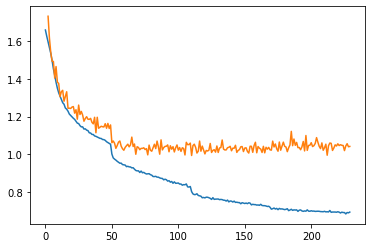

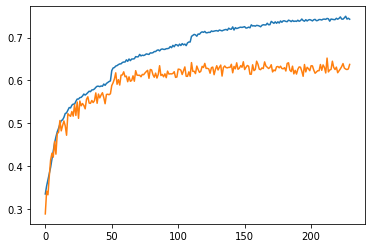

In [25]:
plt.plot([k[0] for k in hist[70:]])
plt.plot([k[1] for k in hist[70:]])
plt.show()

plt.plot([k[2] for k in hist[70:]])
plt.plot([k[3] for k in hist[70:]])
plt.show()


In [16]:
best_acc, curloss

(0.6522090517241379, 0.994035456714959)

### SGG4_2

In [5]:
class Attention(nn.Module):
    
    def __init__(self, feature_depth, target_depth, emb_dim):
        super(Attention, self).__init__()
        self.emb_dim = emb_dim
        self.iconv1 = nn.Conv2d(feature_depth, emb_dim, kernel_size=1)
        self.iconv2 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv3 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv_out = nn.Conv2d(emb_dim, target_depth, kernel_size=1)
        self.bn_out = nn.BatchNorm2d(target_depth)
        
        # ensure the init stage is the indentical mapping
#         nn.init.zeros_(self.iconv_out.weight)
#         nn.init.zeros_(self.iconv_out.bias)
#         nn.init.zeros_(self.bn_out.weight)
#         nn.init.zeros_(self.bn_out.bias)
        
    def forward(self, x1, x2):
        x1_emb = self.iconv1(x1)
        x1_emb = nn.Sigmoid()(x1_emb)
        _x1 = nn.Flatten(-2)(x1_emb)
        
        x2_emb = self.iconv2(x2)
        x2_emb = nn.Sigmoid()(x2_emb)
        _x2 = nn.Flatten(-2)(x2_emb)
        
        x3_emb = self.iconv3(x2)
        _x3 = nn.Flatten(-2)(x3_emb)
        
        QK = torch.matmul(_x1, _x2.permute(0,2,1))
        QK = QK / math.sqrt(_x1.size(2))
    
#         QK = nn.Softmax()(QK)
        
        x_out = torch.matmul(QK, _x3)
        x_out = x_out.reshape(x3_emb.size())
        
        x_out = self.iconv_out(x_out)
        x_out = self.bn_out(x_out)
        x_out = nn.LeakyReLU()(x_out)
        
        x_out = x_out + x2 #residual
        
        return x_out

In [6]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv_out = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        self.bn_out = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res
        x3 = self.preconv_out(x3)
        x3 = self.bn_out(x3)

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [7]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)
        self.sv4 = SVblock(512, 1024).to(self.device)

        self.wf0 = Attention(64, 64, emb_dim=32).to(self.device)
        self.wf1 = Attention(128, 128, emb_dim=64).to(self.device)
        self.wf2 = Attention(256, 256, emb_dim=128).to(self.device)
        self.wf3 = Attention(512, 512, emb_dim=256).to(self.device)
        self.wf4 = Attention(1024, 1024, emb_dim=512).to(self.device)
        
        self.iconv_out = nn.Conv2d(1024, 1024, kernel_size=1)
        self.bn_out = nn.BatchNorm2d(1024)
        
        self.fc_sub3 = nn.Linear(512, 512)
        self.bn_sub3 = nn.BatchNorm1d(512)
        self.fc_sub4 = nn.Linear(1024, 1024)
        self.bn_sub4 = nn.BatchNorm1d(1024)

        self.fc0 = nn.Linear(2560, 2560)
        self.bn0 = nn.BatchNorm1d(2560)
        self.fc1 = nn.Linear(2560, 1024)
        self.bn1 = nn.BatchNorm1d(1024)
        self.fc2 = nn.Linear(1024, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)
        x_wf0 = self.wf0(x0, x0)

        x1 = self.sv1(x_wf0)
        x_wf1 = self.wf1(x1, x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x2, x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x3, x3)

        x4 = self.sv4(x_wf3)
        x_wf4 = self.wf4(x4, x4)
        
        x_wf4 = self.iconv_out(x_wf4)
        x_wf4 = self.bn_out(x_wf4)

        x_wf4 = nn.AvgPool2d(kernel_size=(x_wf4.size(-2), x_wf4.size(-1)))(x_wf4)
        x_wf4 = nn.Flatten()(x_wf4)
        # additional output from sv3 and sv4
        x_sub_3 = nn.AvgPool2d(kernel_size=(x3.size(-2), x3.size(-1)))(x3)
        x_sub_3 = nn.Flatten()(x_sub_3)
        x_sub_3 = self.fc_sub3(x_sub_3)
        x_sub_3 = self.bn_sub3(x_sub_3)
        x_sub_3 = nn.LeakyReLU()(x_sub_3)
        x_sub_4 = nn.AvgPool2d(kernel_size=(x4.size(-2), x4.size(-1)))(x4)
        x_sub_4 = nn.Flatten()(x_sub_4)
        x_sub_4 = self.fc_sub4(x_sub_4)
        x_sub_4 = self.bn_sub4(x_sub_4)
        x_sub_4 = nn.LeakyReLU()(x_sub_4)
        
        x = torch.cat([x_wf4, x_sub_3, x_sub_4], dim=1)

        x = self.fc0(x)
        x = self.bn0(x)
        x = nn.LeakyReLU()(x)
        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [8]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.008
reduce_factor = 2
optimizer = optim.SGD(model.parameters(), lr=learning_rate, weight_decay=1e-4)


cuda


In [9]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/attention/'
model_name = 'svgg_resnet4_2'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(300):  # loop over the dataset multiple times
    
    
    
    if (epoch % 30) == 0 and epoch != 0 and learning_rate > 1e-6:
        learning_rate /= reduce_factor
        print('Decrese learning rate to: ', learning_rate)
        optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

Epoch:  1
- Avg.loss: 1.903  | Avg.acc: 0.240
- Avg. val_loss: 1.833  | Avg. val_acc: 0.275


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type Attention. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


* Update optimal model
Epoch:  2
- Avg.loss: 1.765  | Avg.acc: 0.304
- Avg. val_loss: 1.969  | Avg. val_acc: 0.294
* Update optimal model
Epoch:  3
- Avg.loss: 1.674  | Avg.acc: 0.350
- Avg. val_loss: 1.692  | Avg. val_acc: 0.362
* Update optimal model
Epoch:  4
- Avg.loss: 1.587  | Avg.acc: 0.389
- Avg. val_loss: 1.649  | Avg. val_acc: 0.366
* Update optimal model
Epoch:  5
- Avg.loss: 1.524  | Avg.acc: 0.413
- Avg. val_loss: 1.538  | Avg. val_acc: 0.394
* Update optimal model
Epoch:  6
- Avg.loss: 1.461  | Avg.acc: 0.441
- Avg. val_loss: 1.501  | Avg. val_acc: 0.437
* Update optimal model
Epoch:  7
- Avg.loss: 1.413  | Avg.acc: 0.456
- Avg. val_loss: 1.470  | Avg. val_acc: 0.445
* Update optimal model
Epoch:  8
- Avg.loss: 1.378  | Avg.acc: 0.472
- Avg. val_loss: 1.448  | Avg. val_acc: 0.447
* Update optimal model
Epoch:  9
- Avg.loss: 1.335  | Avg.acc: 0.489
- Avg. val_loss: 1.389  | Avg. val_acc: 0.474
* Update optimal model
Epoch:  10
- Avg.loss: 1.305  | Avg.acc: 0.503
- Avg. val

- Avg. val_loss: 1.455  | Avg. val_acc: 0.444
Epoch:  85
- Avg.loss: 1.372  | Avg.acc: 0.469
- Avg. val_loss: 1.522  | Avg. val_acc: 0.416
Epoch:  86
- Avg.loss: 1.371  | Avg.acc: 0.468
- Avg. val_loss: 1.398  | Avg. val_acc: 0.454
Epoch:  87
- Avg.loss: 1.369  | Avg.acc: 0.467
- Avg. val_loss: 1.395  | Avg. val_acc: 0.460
Epoch:  88
- Avg.loss: 1.363  | Avg.acc: 0.470
- Avg. val_loss: 1.384  | Avg. val_acc: 0.457
Epoch:  89
- Avg.loss: 1.361  | Avg.acc: 0.471
- Avg. val_loss: 1.404  | Avg. val_acc: 0.464
Epoch:  90
- Avg.loss: 1.355  | Avg.acc: 0.474
- Avg. val_loss: 1.393  | Avg. val_acc: 0.473
Decrese learning rate to:  0.001
Epoch:  91
- Avg.loss: 1.335  | Avg.acc: 0.478
- Avg. val_loss: 1.320  | Avg. val_acc: 0.494
Epoch:  92
- Avg.loss: 1.331  | Avg.acc: 0.484
- Avg. val_loss: 1.323  | Avg. val_acc: 0.503
Epoch:  93
- Avg.loss: 1.327  | Avg.acc: 0.484
- Avg. val_loss: 1.301  | Avg. val_acc: 0.500
Epoch:  94
- Avg.loss: 1.323  | Avg.acc: 0.488
- Avg. val_loss: 1.345  | Avg. val_ac

- Avg.loss: 1.225  | Avg.acc: 0.524
- Avg. val_loss: 1.228  | Avg. val_acc: 0.534
Epoch:  172
- Avg.loss: 1.220  | Avg.acc: 0.526
- Avg. val_loss: 1.201  | Avg. val_acc: 0.538
Epoch:  173
- Avg.loss: 1.222  | Avg.acc: 0.525
- Avg. val_loss: 1.212  | Avg. val_acc: 0.531
Epoch:  174
- Avg.loss: 1.222  | Avg.acc: 0.525
- Avg. val_loss: 1.223  | Avg. val_acc: 0.539
Epoch:  175
- Avg.loss: 1.223  | Avg.acc: 0.524
- Avg. val_loss: 1.203  | Avg. val_acc: 0.544
Epoch:  176
- Avg.loss: 1.218  | Avg.acc: 0.529
- Avg. val_loss: 1.227  | Avg. val_acc: 0.531
Epoch:  177
- Avg.loss: 1.217  | Avg.acc: 0.525
- Avg. val_loss: 1.210  | Avg. val_acc: 0.532
Epoch:  178
- Avg.loss: 1.220  | Avg.acc: 0.525
- Avg. val_loss: 1.207  | Avg. val_acc: 0.540
Epoch:  179
- Avg.loss: 1.216  | Avg.acc: 0.525
- Avg. val_loss: 1.213  | Avg. val_acc: 0.536
Epoch:  180
- Avg.loss: 1.222  | Avg.acc: 0.525
- Avg. val_loss: 1.217  | Avg. val_acc: 0.534
Decrese learning rate to:  0.000125
Epoch:  181
- Avg.loss: 1.213  | Avg

- Avg.loss: 1.188  | Avg.acc: 0.540
- Avg. val_loss: 1.174  | Avg. val_acc: 0.557
Epoch:  258
- Avg.loss: 1.187  | Avg.acc: 0.541
- Avg. val_loss: 1.176  | Avg. val_acc: 0.554
Epoch:  259
- Avg.loss: 1.186  | Avg.acc: 0.539
- Avg. val_loss: 1.194  | Avg. val_acc: 0.544
Epoch:  260
- Avg.loss: 1.191  | Avg.acc: 0.540
- Avg. val_loss: 1.179  | Avg. val_acc: 0.556
Epoch:  261
- Avg.loss: 1.186  | Avg.acc: 0.542
- Avg. val_loss: 1.172  | Avg. val_acc: 0.557
Epoch:  262
- Avg.loss: 1.189  | Avg.acc: 0.539
- Avg. val_loss: 1.192  | Avg. val_acc: 0.551
Epoch:  263
- Avg.loss: 1.190  | Avg.acc: 0.541
- Avg. val_loss: 1.184  | Avg. val_acc: 0.555
Epoch:  264
- Avg.loss: 1.185  | Avg.acc: 0.541
- Avg. val_loss: 1.193  | Avg. val_acc: 0.548
Epoch:  265
- Avg.loss: 1.182  | Avg.acc: 0.539
- Avg. val_loss: 1.183  | Avg. val_acc: 0.550
Epoch:  266
- Avg.loss: 1.185  | Avg.acc: 0.541
- Avg. val_loss: 1.179  | Avg. val_acc: 0.559
Epoch:  267
- Avg.loss: 1.187  | Avg.acc: 0.543
- Avg. val_loss: 1.172  

([<matplotlib.lines.Line2D at 0x7f4c33c25320>,
 0.5767543859649122,
 1.13971353622905)

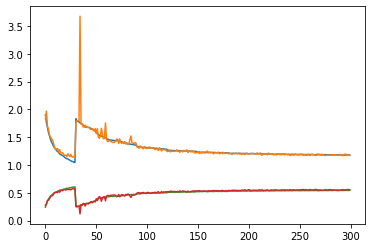

In [11]:
plt.plot(hist), best_acc, curloss

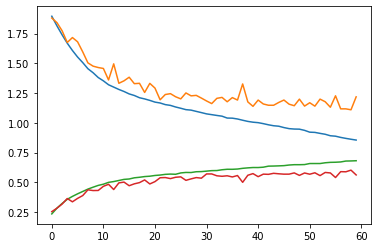

In [10]:
plt.plot(hist)

In [22]:
test_model = torch.load('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet4.pt')

# EVALUATE
model.eval()
running_valloss = 0.0
running_valacc = 0.0
for i,data in enumerate(test_loader):
    # get the inputs; data is a list of [inputs, labels]
    inputs, labels = data
    inputs = inputs.to(device)
    labels = labels.to(device)

    outputs = test_model(inputs)
    acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
    loss = criterion(outputs, labels)

    running_valloss += loss.item()
    running_valacc += acc

print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

- Avg. val_loss: 1.016  | Avg. val_acc: 0.634


In [27]:
import imageio
images = []
for i in range(300):
    images.append(imageio.imread('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet4_gf_' + str(i) + '.png'))
imageio.mimsave('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet4_gf.gif', images)

## Add sigmoid

In [6]:
class Attention(nn.Module):
    
    def __init__(self, feature_depth, target_depth, emb_dim):
        super(Attention, self).__init__()
        self.emb_dim = emb_dim
        self.iconv1 = nn.Conv2d(feature_depth, emb_dim, kernel_size=1)
        self.iconv2 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv3 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv_out = nn.Conv2d(emb_dim, target_depth, kernel_size=1)
        self.bn_out = nn.BatchNorm2d(target_depth)
        
        # ensure the init stage is the indentical mapping
#         nn.init.zeros_(self.iconv_out.weight)
#         nn.init.zeros_(self.iconv_out.bias)
#         nn.init.zeros_(self.bn_out.weight)
#         nn.init.zeros_(self.bn_out.bias)
        
    def forward(self, x1, x2):
        x1_emb = self.iconv1(x1)
        _x1 = nn.Flatten(-2)(x1_emb)
        
        x2_emb = self.iconv2(x2)
        _x2 = nn.Flatten(-2)(x2_emb)
        
        x3_emb = self.iconv3(x2)
        _x3 = nn.Flatten(-2)(x3_emb)
        
        QK = torch.matmul(_x1, _x2.permute(0,2,1))
        QK = QK / math.sqrt(_x1.size(2))
    
        QK = nn.Sigmoid()(QK)
        
        x_out = torch.matmul(QK, _x3)
        x_out = x_out.reshape(x3_emb.size())
        
        x_out = self.iconv_out(x_out)
        x_out = self.bn_out(x_out)
        x_out = nn.LeakyReLU()(x_out)
        
        x_out = x_out + x2 #residual
        
        return x_out

In [9]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.008
reduce_factor = 5
optimizer = optim.SGD(model.parameters(), lr=learning_rate, weight_decay=1e-4)


cuda


In [ ]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/attention/'
model_name = 'svgg_resnet5'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(300):  # loop over the dataset multiple times
    
    
    
    if (epoch % 60) == 0 and epoch != 0:
        learning_rate /= reduce_factor
        print('Decrese learning rate to: ', learning_rate)
        optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

Epoch:  1
- Avg.loss: 1.895  | Avg.acc: 0.238
- Avg. val_loss: 1.888  | Avg. val_acc: 0.238
* Update optimal model
Epoch:  2


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type Attention. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


- Avg.loss: 1.812  | Avg.acc: 0.282
- Avg. val_loss: 1.821  | Avg. val_acc: 0.278
* Update optimal model
Epoch:  3
- Avg.loss: 1.746  | Avg.acc: 0.318
- Avg. val_loss: 1.825  | Avg. val_acc: 0.280
* Update optimal model
Epoch:  4


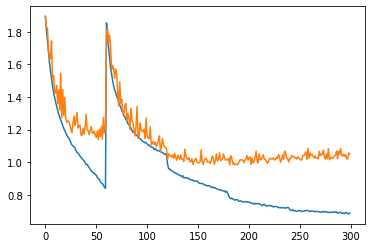

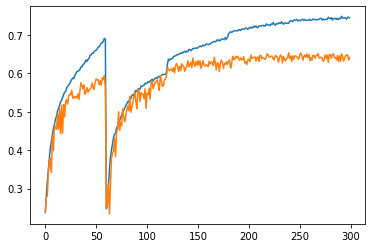

In [12]:
plt.plot([k[0] for k in hist])
plt.plot([k[1] for k in hist])
plt.show()

plt.plot([k[2] for k in hist])
plt.plot([k[3] for k in hist])
plt.show()


In [13]:
best_acc, curloss

(0.6540948275862069, 1.0007134449893031)

In [14]:
import imageio
images = []
for i in range(300):
    images.append(imageio.imread('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet5_gf_' + str(i) + '.png'))
imageio.mimsave('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet5_gf.gif', images)

### SVGG_resnet_5_2 train using Adam and more epochs

In [9]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.01
reduce_factor = 10
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)


cuda


In [10]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/attention/'
model_name = 'svgg_resnet5_2'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(600):  # loop over the dataset multiple times
    
    
    
    if (epoch % 40) == 0 and epoch != 0:
        learning_rate /= reduce_factor
        print('Decrese learning rate to: ', learning_rate)
        optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

Epoch:  1
- Avg.loss: 1.859  | Avg.acc: 0.247
- Avg. val_loss: 1.785  | Avg. val_acc: 0.258
* Update optimal model
Epoch:  2


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type Attention. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


- Avg.loss: 1.774  | Avg.acc: 0.263
- Avg. val_loss: 1.827  | Avg. val_acc: 0.262
* Update optimal model
Epoch:  3
- Avg.loss: 1.751  | Avg.acc: 0.274
- Avg. val_loss: 1.793  | Avg. val_acc: 0.265
* Update optimal model
Epoch:  4
- Avg.loss: 1.703  | Avg.acc: 0.310
- Avg. val_loss: 1.734  | Avg. val_acc: 0.312
* Update optimal model
Epoch:  5
- Avg.loss: 1.659  | Avg.acc: 0.335
- Avg. val_loss: 1.683  | Avg. val_acc: 0.294
Epoch:  6
- Avg.loss: 1.617  | Avg.acc: 0.359
- Avg. val_loss: 2.342  | Avg. val_acc: 0.314
* Update optimal model
Epoch:  7
- Avg.loss: 1.588  | Avg.acc: 0.377
- Avg. val_loss: 1.773  | Avg. val_acc: 0.326
* Update optimal model
Epoch:  8
- Avg.loss: 1.557  | Avg.acc: 0.390
- Avg. val_loss: 1.694  | Avg. val_acc: 0.349
* Update optimal model
Epoch:  9
- Avg.loss: 1.541  | Avg.acc: 0.398
- Avg. val_loss: 1.684  | Avg. val_acc: 0.340
Epoch:  10
- Avg.loss: 1.514  | Avg.acc: 0.412
- Avg. val_loss: 1.589  | Avg. val_acc: 0.385
* Update optimal model
Epoch:  11
- Avg.los

- Avg. val_loss: 1.106  | Avg. val_acc: 0.580
Epoch:  84
- Avg.loss: 1.107  | Avg.acc: 0.575
- Avg. val_loss: 1.099  | Avg. val_acc: 0.576
Epoch:  85
- Avg.loss: 1.106  | Avg.acc: 0.580
- Avg. val_loss: 1.132  | Avg. val_acc: 0.573
Epoch:  86
- Avg.loss: 1.106  | Avg.acc: 0.576
- Avg. val_loss: 1.128  | Avg. val_acc: 0.567
Epoch:  87
- Avg.loss: 1.101  | Avg.acc: 0.582
- Avg. val_loss: 1.124  | Avg. val_acc: 0.570
Epoch:  88
- Avg.loss: 1.102  | Avg.acc: 0.579
- Avg. val_loss: 1.109  | Avg. val_acc: 0.580
Epoch:  89
- Avg.loss: 1.096  | Avg.acc: 0.582
- Avg. val_loss: 1.118  | Avg. val_acc: 0.576
Epoch:  90
- Avg.loss: 1.104  | Avg.acc: 0.579
- Avg. val_loss: 1.132  | Avg. val_acc: 0.574
Epoch:  91
- Avg.loss: 1.099  | Avg.acc: 0.580
- Avg. val_loss: 1.103  | Avg. val_acc: 0.583
Epoch:  92
- Avg.loss: 1.097  | Avg.acc: 0.580
- Avg. val_loss: 1.131  | Avg. val_acc: 0.569
Epoch:  93
- Avg.loss: 1.095  | Avg.acc: 0.579
- Avg. val_loss: 1.098  | Avg. val_acc: 0.587
* Update optimal model
E

- Avg. val_loss: 1.101  | Avg. val_acc: 0.585
Epoch:  169
- Avg.loss: 1.058  | Avg.acc: 0.596
- Avg. val_loss: 1.110  | Avg. val_acc: 0.585
Epoch:  170
- Avg.loss: 1.059  | Avg.acc: 0.593
- Avg. val_loss: 1.094  | Avg. val_acc: 0.587
Epoch:  171
- Avg.loss: 1.057  | Avg.acc: 0.594
- Avg. val_loss: 1.102  | Avg. val_acc: 0.586
Epoch:  172
- Avg.loss: 1.057  | Avg.acc: 0.594
- Avg. val_loss: 1.087  | Avg. val_acc: 0.586
Epoch:  173
- Avg.loss: 1.056  | Avg.acc: 0.599
- Avg. val_loss: 1.090  | Avg. val_acc: 0.593
Epoch:  174
- Avg.loss: 1.056  | Avg.acc: 0.597
- Avg. val_loss: 1.096  | Avg. val_acc: 0.582
Epoch:  175
- Avg.loss: 1.057  | Avg.acc: 0.599
- Avg. val_loss: 1.083  | Avg. val_acc: 0.593
Epoch:  176
- Avg.loss: 1.056  | Avg.acc: 0.596
- Avg. val_loss: 1.083  | Avg. val_acc: 0.591
Epoch:  177
- Avg.loss: 1.058  | Avg.acc: 0.594
- Avg. val_loss: 1.078  | Avg. val_acc: 0.592
Epoch:  178
- Avg.loss: 1.056  | Avg.acc: 0.600
- Avg. val_loss: 1.121  | Avg. val_acc: 0.578
Epoch:  179
- 

- Avg. val_loss: 1.110  | Avg. val_acc: 0.573
Epoch:  256
- Avg.loss: 1.053  | Avg.acc: 0.598
- Avg. val_loss: 1.098  | Avg. val_acc: 0.579
Epoch:  257
- Avg.loss: 1.060  | Avg.acc: 0.597
- Avg. val_loss: 1.089  | Avg. val_acc: 0.589
Epoch:  258
- Avg.loss: 1.054  | Avg.acc: 0.598
- Avg. val_loss: 1.120  | Avg. val_acc: 0.571
Epoch:  259
- Avg.loss: 1.053  | Avg.acc: 0.597
- Avg. val_loss: 1.079  | Avg. val_acc: 0.595
Epoch:  260
- Avg.loss: 1.051  | Avg.acc: 0.600
- Avg. val_loss: 1.073  | Avg. val_acc: 0.591
Epoch:  261
- Avg.loss: 1.051  | Avg.acc: 0.599
- Avg. val_loss: 1.097  | Avg. val_acc: 0.591
Epoch:  262
- Avg.loss: 1.047  | Avg.acc: 0.600
- Avg. val_loss: 1.082  | Avg. val_acc: 0.593
Epoch:  263
- Avg.loss: 1.055  | Avg.acc: 0.599
- Avg. val_loss: 1.093  | Avg. val_acc: 0.585
Epoch:  264
- Avg.loss: 1.053  | Avg.acc: 0.597
- Avg. val_loss: 1.102  | Avg. val_acc: 0.579
Epoch:  265
- Avg.loss: 1.056  | Avg.acc: 0.597
- Avg. val_loss: 1.116  | Avg. val_acc: 0.585
Epoch:  266
- 

- Avg. val_loss: 1.089  | Avg. val_acc: 0.594
Epoch:  342
- Avg.loss: 1.058  | Avg.acc: 0.598
- Avg. val_loss: 1.105  | Avg. val_acc: 0.586
Epoch:  343
- Avg.loss: 1.056  | Avg.acc: 0.596
- Avg. val_loss: 1.108  | Avg. val_acc: 0.577
Epoch:  344
- Avg.loss: 1.059  | Avg.acc: 0.598
- Avg. val_loss: 1.099  | Avg. val_acc: 0.579
Epoch:  345
- Avg.loss: 1.054  | Avg.acc: 0.596
- Avg. val_loss: 1.097  | Avg. val_acc: 0.585
Epoch:  346
- Avg.loss: 1.055  | Avg.acc: 0.599
- Avg. val_loss: 1.094  | Avg. val_acc: 0.582
Epoch:  347
- Avg.loss: 1.060  | Avg.acc: 0.597
- Avg. val_loss: 1.088  | Avg. val_acc: 0.583
Epoch:  348
- Avg.loss: 1.057  | Avg.acc: 0.595
- Avg. val_loss: 1.096  | Avg. val_acc: 0.593
Epoch:  349
- Avg.loss: 1.055  | Avg.acc: 0.594
- Avg. val_loss: 1.066  | Avg. val_acc: 0.593
Epoch:  350
- Avg.loss: 1.059  | Avg.acc: 0.596
- Avg. val_loss: 1.089  | Avg. val_acc: 0.588
Epoch:  351
- Avg.loss: 1.054  | Avg.acc: 0.599
- Avg. val_loss: 1.100  | Avg. val_acc: 0.586
Epoch:  352
- 

KeyboardInterrupt: 

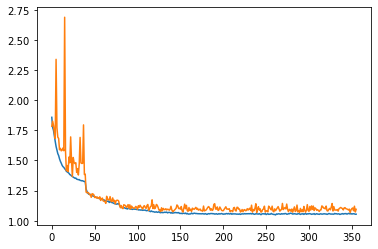

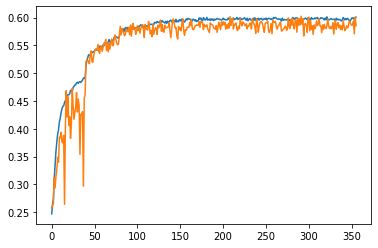

In [12]:
plt.plot([k[0] for k in hist])
plt.plot([k[1] for k in hist])
plt.show()

plt.plot([k[2] for k in hist])
plt.plot([k[3] for k in hist])
plt.show()

In [13]:
best_acc, curloss

(0.6023706896551724, 1.0745561657280758)

In [14]:
import imageio
images = []
for i in range(356):
    images.append(imageio.imread('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet5_2_gf_' + str(i) + '.png'))
imageio.mimsave('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet5_2_gf.gif', images)

### Add sigmoid, reduce to 3 block with 2 additional output, use adam and learning rate decay

In [6]:
class SVblock(nn.Module):
    def __init__(self, in_neurons, nb_neurons, kernel_size=(3,3), batch_norm=True, activation='relu', **kwargs):
        '''
    in_neurons: C_in
    nb_neurons: n_filters of conv2d
    '''
        super(SVblock, self).__init__()

        self.index = kwargs['index'] if 'index' in kwargs else None
        self.conv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        self.conv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=kernel_size, padding=1, stride=1)
        
        self.bn1 = nn.BatchNorm2d(nb_neurons)
        self.bn2 = nn.BatchNorm2d(nb_neurons)
        self.bn3 = nn.BatchNorm2d(nb_neurons)
        
        self.preconv1 = nn.Conv2d(in_neurons, nb_neurons, kernel_size=1)
        self.preconv2 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.preconv3 = nn.Conv2d(nb_neurons, nb_neurons, kernel_size=1)
        self.bn1_ = nn.BatchNorm2d(nb_neurons)
        self.bn2_ = nn.BatchNorm2d(nb_neurons)
        self.bn3_ = nn.BatchNorm2d(nb_neurons)
        
        self.relu = nn.LeakyReLU()
        self.maxpool = nn.MaxPool2d(kernel_size=(2,2), stride=2)
     


    def forward(self, x):        
        
        x0_res = self.preconv1(x)
        x0_res = self.bn1_(x0_res)
        
        # 1st
        x1 = self.conv1(x)
        x1 = self.bn1(x1)
        x1 = self.relu(x1)
        
        x1 = x1 + x0_res
        x1_res = self.preconv2(x1)
        x1_res = self.bn2_(x1_res)

        # 2nd
        x2 = self.conv2(x1)
        x2 = self.bn2(x2)
        x2 = self.relu(x2)
        
        x2 = x2 + x1_res
        x2_res = self.preconv3(x2)
        x2_res = self.bn3_(x2_res)
        
        # 3rd
        x3 = self.conv3(x2)
        x3 = self.bn3(x3)
        x3 = self.relu(x3)
        
        x3 = x3 + x2_res

        # maxpooling
        x_out = self.maxpool(x3)

        return x_out

In [7]:
class Attention(nn.Module):
    
    def __init__(self, feature_depth, target_depth, emb_dim):
        super(Attention, self).__init__()
        self.emb_dim = emb_dim
        self.iconv1 = nn.Conv2d(feature_depth, emb_dim, kernel_size=1)
        self.iconv2 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv3 = nn.Conv2d(target_depth, emb_dim, kernel_size=1)
        self.iconv_out = nn.Conv2d(emb_dim, target_depth, kernel_size=1)
        self.bn_out = nn.BatchNorm2d(target_depth)
        
        # ensure the init stage is the indentical mapping
#         nn.init.zeros_(self.iconv_out.weight)
#         nn.init.zeros_(self.iconv_out.bias)
#         nn.init.zeros_(self.bn_out.weight)
#         nn.init.zeros_(self.bn_out.bias)
        
    def forward(self, x1, x2):
        x1_emb = self.iconv1(x1)
        _x1 = nn.Flatten(-2)(x1_emb)
        
        x2_emb = self.iconv2(x2)
        _x2 = nn.Flatten(-2)(x2_emb)
        
        x3_emb = self.iconv3(x2)
        _x3 = nn.Flatten(-2)(x3_emb)
        
        QK = torch.matmul(_x1, _x2.permute(0,2,1))
        QK = QK / math.sqrt(_x1.size(2))
    
        QK = nn.Sigmoid()(QK)
        
        x_out = torch.matmul(QK, _x3)
        x_out = x_out.reshape(x3_emb.size())
        
        x_out = self.iconv_out(x_out)
        x_out = self.bn_out(x_out)
        x_out = nn.LeakyReLU()(x_out)
        
        x_out = x_out + x2 #residual
        
        return x_out

In [8]:
class SVGG(nn.Module):
    
    def __init__(self, **kwargs):
        super(SVGG, self).__init__()

        self.device = torch.device('cpu') if not 'device' in kwargs else kwargs['device']

        self.sv0 = SVblock(1, 64).to(self.device)
        self.sv1 = SVblock(64, 128).to(self.device)
        self.sv2 = SVblock(128, 256).to(self.device)
        self.sv3 = SVblock(256, 512).to(self.device)

        self.wf0 = Attention(64, 64, emb_dim=32).to(self.device)
        self.wf1 = Attention(128, 128, emb_dim=64).to(self.device)
        self.wf2 = Attention(256, 256, emb_dim=128).to(self.device)
        self.wf3 = Attention(512, 512, emb_dim=256).to(self.device)
        
        self.iconv_out = nn.Conv2d(512, 512, kernel_size=1)
        self.bn_out = nn.BatchNorm2d(512)

        self.fc0 = nn.Linear(1280, 1280)
        self.bn0 = nn.BatchNorm1d(1280)
        self.fc1 = nn.Linear(1280, 1024)
        self.bn1 = nn.BatchNorm1d(1024)
        self.fc2 = nn.Linear(1024, 7)
        self.bn2 = nn.BatchNorm1d(7)
        
    
    def forward(self, x):
        x0 = self.sv0(x)
        x_wf0 = self.wf0(x0, x0)

        x1 = self.sv1(x_wf0)
        x_wf1 = self.wf1(x1, x1)

        x2 = self.sv2(x_wf1)
        x_wf2 = self.wf2(x2, x2)

        x3 = self.sv3(x_wf2)
        x_wf3 = self.wf3(x3, x3)
        
        x_wf3 = self.iconv_out(x_wf3)
        x_wf3 = self.bn_out(x_wf3)

        x_wf3 = nn.AvgPool2d(kernel_size=(x_wf3.size(-2), x_wf3.size(-1)))(x_wf3)
        x_wf3 = nn.Flatten()(x_wf3)
        # additional output from sv3 and sv2
        x_sub_2 = nn.AvgPool2d(kernel_size=(x2.size(-2), x2.size(-1)))(x2)
        x_sub_2 = nn.Flatten()(x_sub_2)
        x_sub_3 = nn.AvgPool2d(kernel_size=(x3.size(-2), x3.size(-1)))(x3)
        x_sub_3 = nn.Flatten()(x_sub_3)
        
        x = torch.cat([x_wf3, x_sub_2, x_sub_3], dim=1)

        x = self.fc0(x)
        x = self.bn0(x)
        x = nn.LeakyReLU()(x)
        x = self.fc1(x)
        x = self.bn1(x)
        x = nn.LeakyReLU()(x)
        x = self.fc2(x)
        x = self.bn2(x)

        return x

In [9]:
device = torch.device('cuda')
print(device)

model = SVGG(device=device)

criterion = nn.CrossEntropyLoss()

learning_rate = 0.008
reduce_factor = 5
optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)


cuda


In [ ]:
model = model.to(device)

model_folder = '/tf/data/Quan/fer2013/backtobasics/attention/'
model_name = 'svgg_resnet6'
model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
hist = []

for epoch in range(300):  # loop over the dataset multiple times
    
    
    
    if (epoch % 60) == 0 and epoch != 0:
        learning_rate /= reduce_factor
        print('Decrese learning rate to: ', learning_rate)
        optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
    plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
                   savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

    hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
    if best_acc < (running_valacc / (i+1)):
        best_acc = (running_valacc / (i+1))
        curloss = (running_valloss / (i+1))
        torch.save(model, model_path)
        print('* Update optimal model')

print('Finished Training')

Epoch:  1
- Avg.loss: 1.849  | Avg.acc: 0.250
- Avg. val_loss: 1.807  | Avg. val_acc: 0.261
* Update optimal model
Epoch:  2


/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVGG. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type SVblock. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "
/usr/local/lib/python3.6/dist-packages/torch/serialization.py:360: UserWarning: Couldn't retrieve source code for container of type Attention. It won't be checked for correctness upon loading.
  "type " + obj.__name__ + ". It won't be checked "


- Avg.loss: 1.778  | Avg.acc: 0.261
- Avg. val_loss: 1.800  | Avg. val_acc: 0.262
* Update optimal model
Epoch:  3
- Avg.loss: 1.768  | Avg.acc: 0.260
- Avg. val_loss: 1.801  | Avg. val_acc: 0.260
Epoch:  4
- Avg.loss: 1.748  | Avg.acc: 0.277
- Avg. val_loss: 1.878  | Avg. val_acc: 0.208
Epoch:  5
- Avg.loss: 1.714  | Avg.acc: 0.302
- Avg. val_loss: 1.796  | Avg. val_acc: 0.254
Epoch:  6
- Avg.loss: 1.673  | Avg.acc: 0.326
- Avg. val_loss: 2.167  | Avg. val_acc: 0.258
Epoch:  7
- Avg.loss: 1.632  | Avg.acc: 0.347
- Avg. val_loss: 3.748  | Avg. val_acc: 0.138
Epoch:  8
- Avg.loss: 1.602  | Avg.acc: 0.366
- Avg. val_loss: 1.652  | Avg. val_acc: 0.362
* Update optimal model
Epoch:  9
- Avg.loss: 1.565  | Avg.acc: 0.386
- Avg. val_loss: 2.028  | Avg. val_acc: 0.251
Epoch:  10
- Avg.loss: 1.534  | Avg.acc: 0.397
- Avg. val_loss: 1.572  | Avg. val_acc: 0.398
* Update optimal model
Epoch:  11
- Avg.loss: 1.509  | Avg.acc: 0.409
- Avg. val_loss: 1.792  | Avg. val_acc: 0.315
Epoch:  12
- Avg.lo

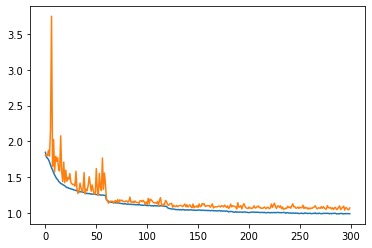

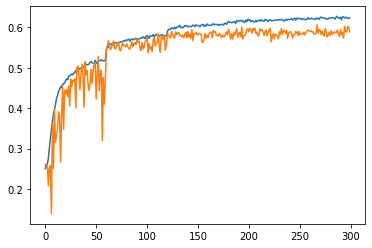

In [12]:
plt.plot([k[0] for k in hist])
plt.plot([k[1] for k in hist])
plt.show()

plt.plot([k[2] for k in hist])
plt.plot([k[3] for k in hist])
plt.show()


In [13]:
best_acc, curloss

(0.6058728448275862, 1.059031172045346)

In [15]:
import imageio
images = []
for i in range(300):
    images.append(imageio.imread('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet6_gf_' + str(i) + '.png'))
imageio.mimsave('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet6_gf.gif', images)

In [16]:
model = torch.load('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet6.pt')
model = model.cpu()
model.eval()

SVGG(
  (sv0): SVblock(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (preconv1): Conv2d(1, 64, kernel_size=(1, 1), stride=(1, 1))
    (preconv2): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    (preconv3): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    (bn1_): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2_): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn3_): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=

In [17]:
model.sv3.conv3.register_forward_hook(get_activation('sv3'))
model.sv3.conv3.register_backward_hook(get_gradient('sv3'))

model.wf3.register_forward_hook(get_activation('wf3'))
model.wf3.register_backward_hook(get_gradient('wf3'))

# model.wf3.register_forward_hook(get_activation('wf3'))
# model.wf3.register_backward_hook(get_gradient('wf3'))

model.sv2.conv3.register_forward_hook(get_activation('sv2'))
model.sv2.conv3.register_backward_hook(get_gradient('sv2'))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for

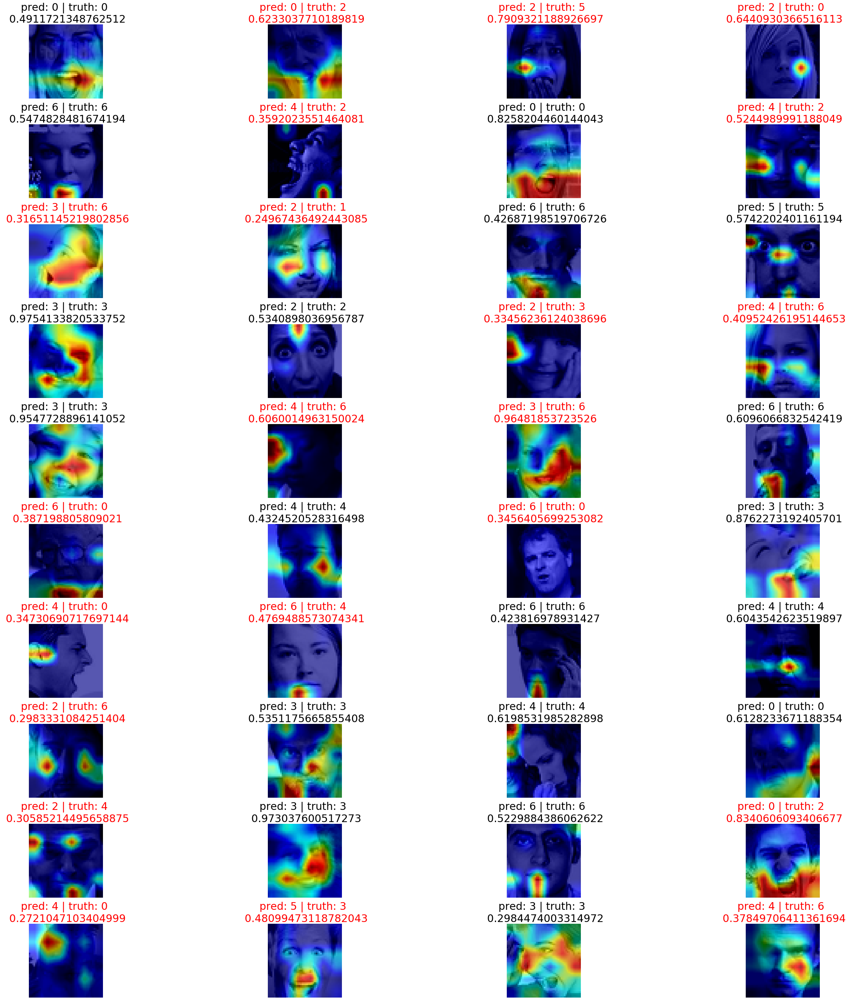

In [20]:
%matplotlib inline


# rows = len(labels) // 4 + 1
rows = 10
cols = 4
fig, axs = plt.subplots(rows, cols, figsize=(40,40))

id = 0

for i in range(rows):
    for j in range(cols):
        try:
            map, pred, prob = attention(model, images[id], None, 'sv3', False)
            
            axs[i,j].imshow(map[:,:,[2,1,0]])
            if pred == int(labels[id]):
                color = 'black'
            else:
                color = 'red'
            axs[i,j].set_title('pred: ' + str(pred) + ' | truth: ' + str(int(labels[id])) + ' \n ' + str(prob), size=30, color=color)
            axs[i,j].axis('off')
            id = id + 1
        except:
            break

plt.tight_layout()
plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in true_divide
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the val

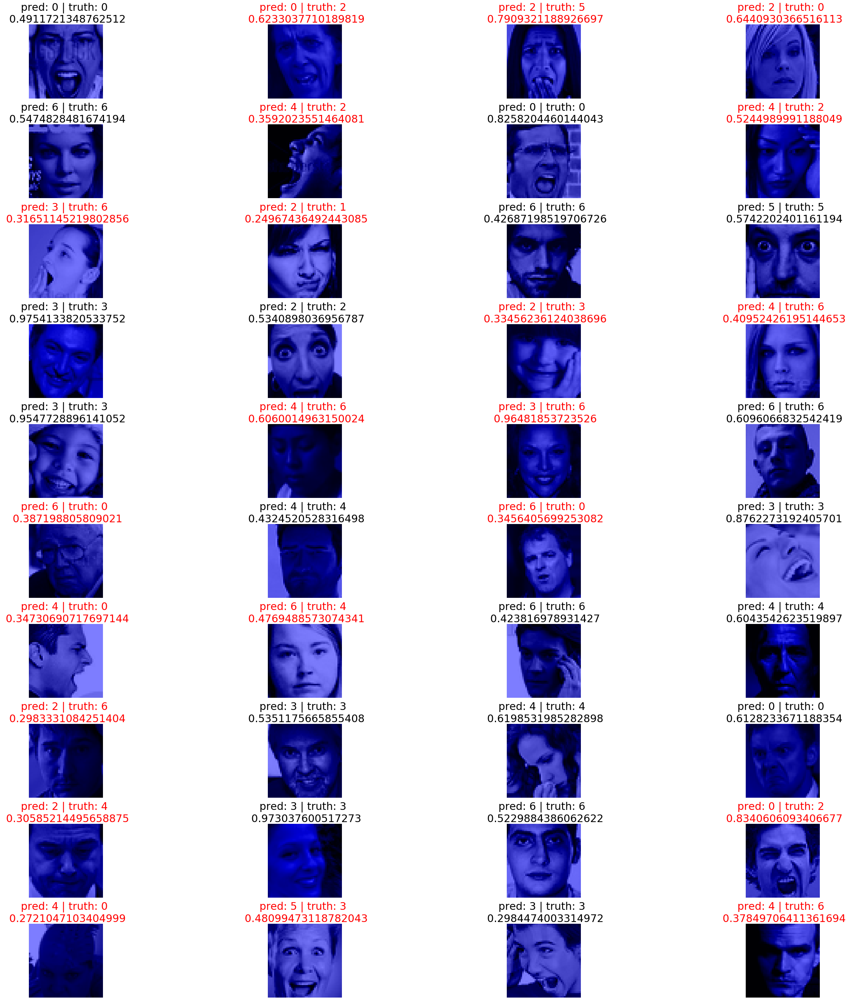

In [21]:
%matplotlib inline


# rows = len(labels) // 4 + 1
rows = 10
cols = 4
fig, axs = plt.subplots(rows, cols, figsize=(40,40))

id = 0

for i in range(rows):
    for j in range(cols):
        try:
            map, pred, prob = attention(model, images[id], None, 'wf3', False)
            
            axs[i,j].imshow(map[:,:,[2,1,0]])
            if pred == int(labels[id]):
                color = 'black'
            else:
                color = 'red'
            axs[i,j].set_title('pred: ' + str(pred) + ' | truth: ' + str(int(labels[id])) + ' \n ' + str(prob), size=30, color=color)
            axs[i,j].axis('off')
            id = id + 1
        except:
            break

plt.tight_layout()
plt.show()

## Heatmap

In [14]:
import cv2

def attention(model, img, lb=None, layer_name='last_conv', visual_heatmap=True):
    model.eval()
    output = model(img.unsqueeze(0))
    prob = nn.Softmax()(output.detach())
    prob = float(prob.max(1)[0][0])
    
    
    pred_lb = int(output.argmax(1)[0])
    
#     lb = pred_lb if lb is None else lb
    output[:,pred_lb].backward()

    # get gradient
    grads = gradients[layer_name][0]
    
    # !!! 2 options
#     pooled_grads = torch.mean(grads, dim=[0, 2, 3])
    pooled_grads = torch.nn.functional.adaptive_avg_pool2d(grads, (1, 1))

    # get activation
    features = activation[layer_name]

    # weight the channels by corresponding gradients
    for i in range(features.size(1)):
        features[:, i, :, :] *= pooled_grads[0,i,:,:]
   
    heatmap = features.detach().numpy()
    heatmap = np.mean(heatmap, axis=1).squeeze()
    
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    
 
    img = img.numpy()[0]
    img = np.stack((img,)*3, axis=-1)
    
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0])) # Adjust the size of the heat map to be the same as the original image
    heatmap = np.uint8(255 * heatmap) # Convert the heat map to RGB format
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET) # Apply the heat map to the original image
    superimposed_img = heatmap * 0.008 + img # here 0.4 is the heat map intensity factor
        
    superimposed_img /= np.max(superimposed_img)
    
        
    return superimposed_img, pred_lb, prob
#         cv2.imwrite(save_path, superimposed_img)

In [15]:
activation = {}
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook

gradients = {}
def get_gradient(name):
    def hook(model, in_grad, out_grad):
        gradients[name] = out_grad
        
    return hook

In [31]:
model = torch.load('/tf/data/Quan/fer2013/backtobasics/attention/svgg_resnet5.pt')
model = model.cpu()
model.eval()



SVGG(
  (sv0): SVblock(
    (conv1): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (conv3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (preconv1): Conv2d(1, 64, kernel_size=(1, 1), stride=(1, 1))
    (preconv2): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    (preconv3): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
    (bn1_): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn2_): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (bn3_): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=

In [41]:
model.sv4.conv3.register_forward_hook(get_activation('sv4'))
model.sv4.conv3.register_backward_hook(get_gradient('sv4'))

model.wf4.register_forward_hook(get_activation('wf4'))
model.wf4.register_backward_hook(get_gradient('wf4'))

model.wf3.register_forward_hook(get_activation('wf3'))
model.wf3.register_backward_hook(get_gradient('wf3'))

model.sv3.conv3.register_forward_hook(get_activation('sv3'))
model.sv3.conv3.register_backward_hook(get_gradient('sv3'))

In [19]:
images, labels = next(iter(test_loader))[:40]

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in true_divide
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the val

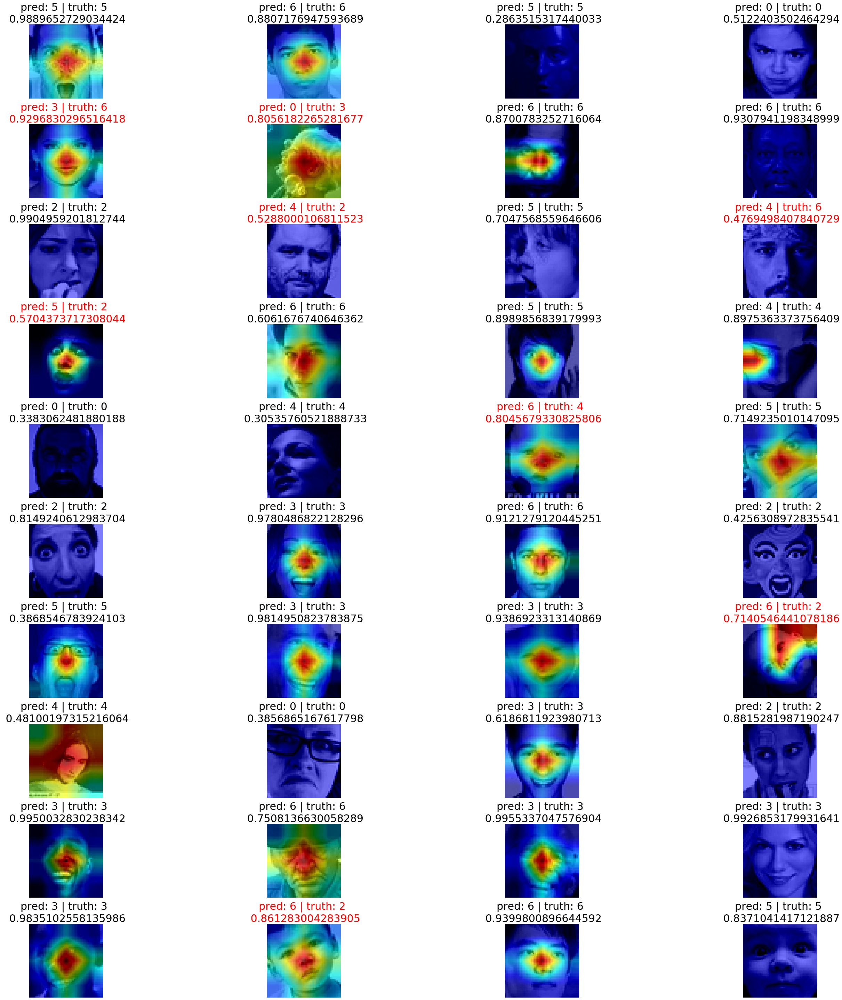

In [34]:
%matplotlib inline


# rows = len(labels) // 4 + 1
rows = 10
cols = 4
fig, axs = plt.subplots(rows, cols, figsize=(40,40))

id = 0

for i in range(rows):
    for j in range(cols):
        try:
            map, pred, prob = attention(model, images[id], None, 'sv4', False)
            
            axs[i,j].imshow(map[:,:,[2,1,0]])
            if pred == int(labels[id]):
                color = 'black'
            else:
                color = 'red'
            axs[i,j].set_title('pred: ' + str(pred) + ' | truth: ' + str(int(labels[id])) + ' \n ' + str(prob), size=30, color=color)
            axs[i,j].axis('off')
            id = id + 1
        except:
            break

plt.tight_layout()
plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for

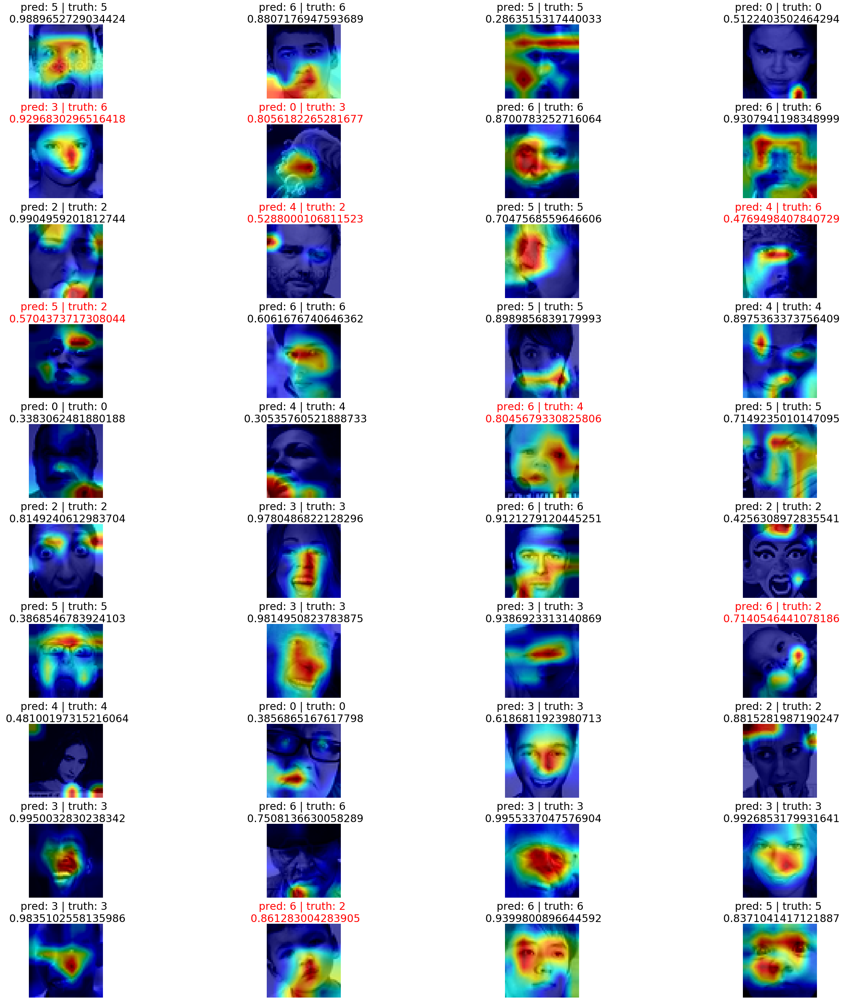

In [35]:
%matplotlib inline


# rows = len(labels) // 4 + 1
rows = 10
cols = 4
fig, axs = plt.subplots(rows, cols, figsize=(40,40))

id = 0

for i in range(rows):
    for j in range(cols):
        try:
            map, pred, prob = attention(model, images[id], None, 'sv3', False)
            
            axs[i,j].imshow(map[:,:,[2,1,0]])
            if pred == int(labels[id]):
                color = 'black'
            else:
                color = 'red'
            axs[i,j].set_title('pred: ' + str(pred) + ' | truth: ' + str(int(labels[id])) + ' \n ' + str(prob), size=30, color=color)
            axs[i,j].axis('off')
            id = id + 1
        except:
            break

plt.tight_layout()
plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in true_divide
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the val

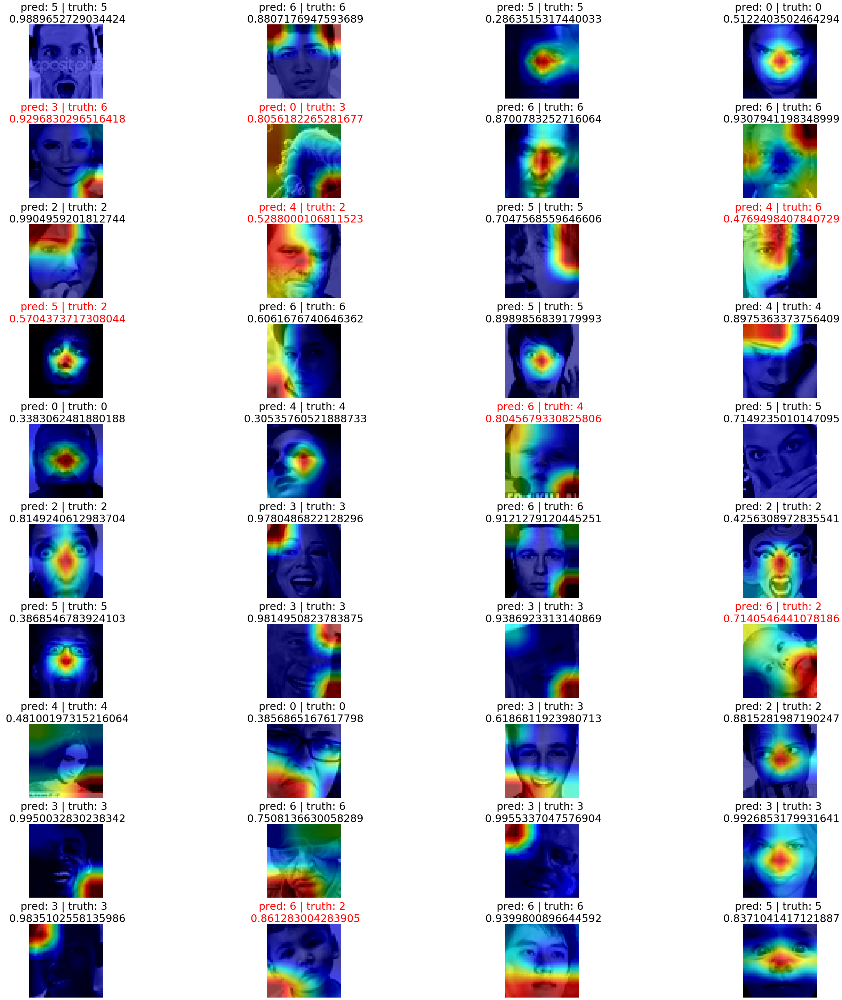

In [42]:
%matplotlib inline


# rows = len(labels) // 4 + 1
rows = 10
cols = 4
fig, axs = plt.subplots(rows, cols, figsize=(40,40))

id = 0

for i in range(rows):
    for j in range(cols):
        try:
            map, pred, prob = attention(model, images[id], None, 'wf3', False)
            
            axs[i,j].imshow(map[:,:,[2,1,0]])
            if pred == int(labels[id]):
                color = 'black'
            else:
                color = 'red'
            axs[i,j].set_title('pred: ' + str(pred) + ' | truth: ' + str(int(labels[id])) + ' \n ' + str(prob), size=30, color=color)
            axs[i,j].axis('off')
            id = id + 1
        except:
            break

plt.tight_layout()
plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:33: RuntimeWarning: invalid value encountered in double_scalars
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the 

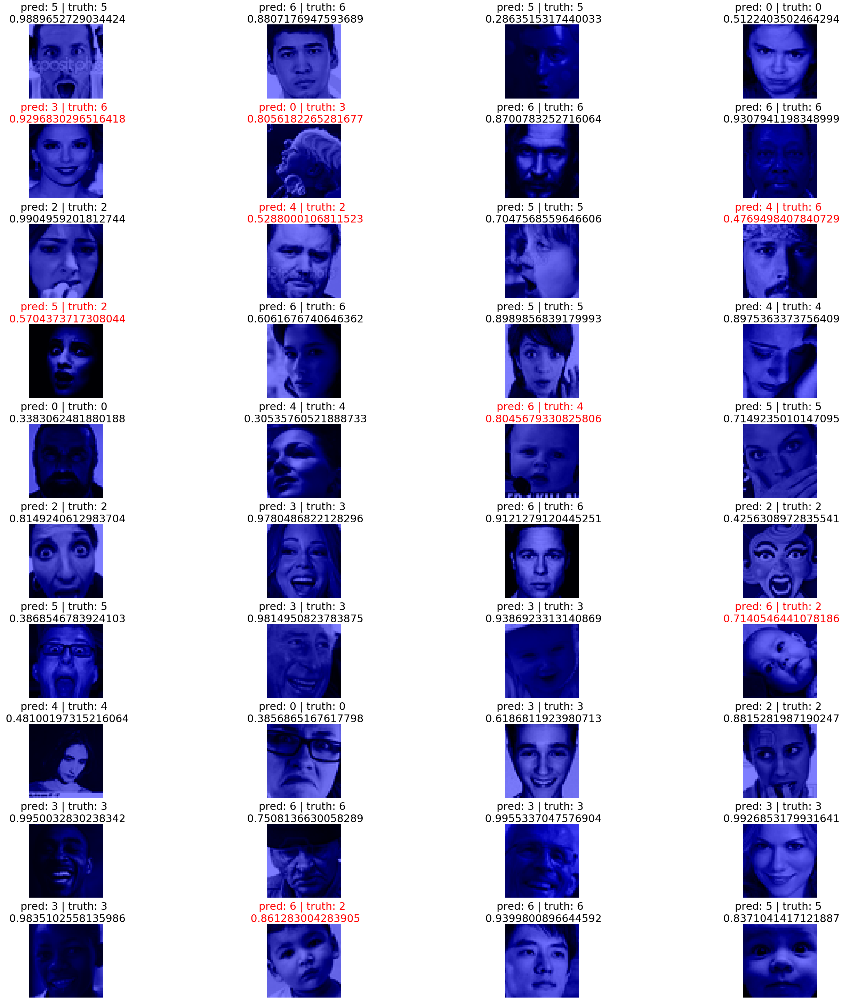

In [43]:
%matplotlib inline


# rows = len(labels) // 4 + 1
rows = 10
cols = 4
fig, axs = plt.subplots(rows, cols, figsize=(40,40))

id = 0

for i in range(rows):
    for j in range(cols):
        try:
            map, pred, prob = attention(model, images[id], None, 'wf4', False)
            
            axs[i,j].imshow(map[:,:,[2,1,0]])
            if pred == int(labels[id]):
                color = 'black'
            else:
                color = 'red'
            axs[i,j].set_title('pred: ' + str(pred) + ' | truth: ' + str(int(labels[id])) + ' \n ' + str(prob), size=30, color=color)
            axs[i,j].axis('off')
            id = id + 1
        except:
            break

plt.tight_layout()
plt.show()

The visualization of heatmap may indicate that 'wf4' seems to be useless, since it is unable to pay attention to any feature

## Finding reason why some first epochs val_loss is too high

In [30]:
fall_batches = []
fall_losses = []

model = model.to(device)

# model_folder = '/tf/data/Quan/fer2013/backtobasics/attention/'
# model_name = 'svgg_resnet4'
# model_path = os.path.join(model_folder, model_name + '.pt')

best_acc = 0.0
curloss = 0.0
# hist = []

for epoch in range(300):  # loop over the dataset multiple times
    
    
    
    if (epoch % 60) == 0 and epoch != 0:
        learning_rate /= reduce_factor
        print('Decrese learning rate to: ', learning_rate)
        optimizer = optim.Adam(model.parameters(), lr=learning_rate, weight_decay=1e-4)
    
    print('Epoch: ', epoch + 1)
    running_loss = 0.0
    running_acc = 0.0

    # TRAIN
    model.train()
    for i, data in enumerate(train_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        loss.backward()
        
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        running_acc += acc
#         print('\t - Step %d: loss: %.3f acc: %.3f' % (i+1, loss.item(), acc))

    print('- Avg.loss: %.3f  | Avg.acc: %.3f' % (running_loss / (i+1), running_acc / (i+1)))
    avgloss = running_loss / (i+1)
    avgacc = running_acc / (i+1)
    
    # print gradient flow figure
#     plot_grad_flow(model.named_parameters(), epoch, avgloss, avgacc,
#                    savepath=os.path.join(model_folder, model_name + '_gf' + '_' + str(epoch) + '.png'))

    # EVALUATE
    model.eval()
    running_valloss = 0.0
    running_valacc = 0.0
    for i,data in enumerate(val_loader):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        acc = float((torch.argmax(outputs, dim=1) == labels).float().sum()/labels.size(0))
        loss = criterion(outputs, labels)
        
        if loss > 100.:
            print('\t * step ', i, ' large loss: ', loss)
            fall_batches.append(data)
            fall_losses.append(outputs)

        running_valloss += loss.item()
        running_valacc += acc

    print('- Avg. val_loss: %.3f  | Avg. val_acc: %.3f' % (running_valloss / (i+1), running_valacc / (i+1)))

    avgvalloss = running_valloss / (i+1)
    avgvalcc = running_valacc / (i+1)

#     hist.append([avgloss, avgvalloss, avgacc, avgvalcc])
    
#     if best_acc < (running_valacc / (i+1)):
#         best_acc = (running_valacc / (i+1))
#         curloss = (running_valloss / (i+1))
#         torch.save(model, model_path)
#         print('* Update optimal model')

print('Finished Training')

Epoch:  1
- Avg.loss: 1.833  | Avg.acc: 0.278
	 * step  3  large loss:  tensor(2.2326e+21, device='cuda:0', grad_fn=<NllLossBackward>)


RuntimeError: CUDA out of memory. Tried to allocate 72.00 MiB (GPU 0; 7.79 GiB total capacity; 6.76 GiB already allocated; 29.25 MiB free; 6.89 GiB reserved in total by PyTorch)

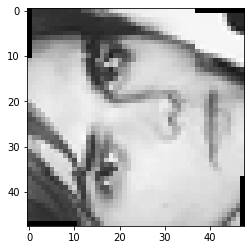

In [28]:
plt.imshow(fall_batches[0][0][-5,0,:,:], cmap='gray')

In [29]:
fall_losses[0]

tensor(3.2480e+19, device='cuda:0', grad_fn=<NllLossBackward>)